#

SyntaxError: invalid syntax (591846361.py, line 1)

In [1]:
import torch
import torch.nn as nn

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import csv
import os
import time
import tensorflow as tf
import keras
import numpy as np
import pandas as pd
from keras import layers
from numpy.random import seed
from sklearn import ensemble
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, make_scorer
from sklearn.model_selection import GridSearchCV
from keras.layers import Input
from keras.models import Model
from keras.regularizers import l1, l2, l1_l2
from keras.wrappers.scikit_learn import KerasRegressor
from matplotlib import pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.svm import LinearSVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import ElasticNet, ElasticNetCV
from sklearn.ensemble import BaggingRegressor, AdaBoostRegressor, GradientBoostingRegressor
from plotly.graph_objects import *
from plotly.offline import init_notebook_mode
import joblib
import xgboost as xgb
import pandas as pd
import datetime
import numpy as np
from torch.utils.data import TensorDataset, DataLoader, random_split, Dataset
import torch
from sklearn.preprocessing import minmax_scale
import random
# import lightgbm as lgb


In [3]:
class config:
    seed = 42
    device = "cuda:0" 

In [4]:
#torch seed 고정
def seed_everything_torch(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)  # type: ignore
    torch.backends.cudnn.deterministic = True  # type: ignore
    torch.backends.cudnn.benchmark = False  # type: ignore

In [5]:
#tensorflow seed 고정
def seed_everything_tf(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    tf.random.set_seed(seed)

In [647]:
seed_everything_tf(config.seed)
seed_everything_torch(config.seed)

In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import json

In [15]:
#energy_data = pd.read_csv("./Energy/data/energy.csv")

In [585]:
#데이터 불러오기
fcst_data_hk = pd.read_csv("./data/hk1_fcst_data_wind.csv")
fcst_data_ss = pd.read_csv("./data/ss_fcst_data_wind.csv")

In [586]:
fcst_data_hk

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk1_numberofturbineinuse,hk1,hk2_numberofturbineinuse,hk2
0,2014,1,1,2,12.1,43.0,8.1,285.0,0.0,0.0,0.0,0.0,1.5,1.0,2.000000,2481.300000,4.000000,8287.740000
1,2014,1,1,3,10.6,50.0,8.0,285.0,0.0,0.0,0.0,0.0,1.0,1.0,2.166667,2376.850000,4.000000,7438.154667
2,2014,1,1,4,10.2,50.0,8.2,278.0,0.0,0.0,0.0,0.0,1.0,1.0,2.944444,1693.833333,4.000000,3426.450000
3,2014,1,1,5,8.4,50.0,6.9,281.0,0.0,0.0,0.0,0.0,1.0,1.0,3.000000,1550.994444,4.000000,2950.589000
4,2014,1,1,6,8.0,50.0,6.4,298.0,0.0,0.0,0.0,0.0,1.0,1.0,3.000000,1214.227778,4.000000,2195.714667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11682,2017,12,31,4,6.0,50.0,6.9,330.0,0.0,0.0,30.0,NaN,1.0,3.0,3.000000,3070.516667,3.000000,4801.813667
11683,2017,12,31,5,5.0,55.0,6.4,334.0,0.0,0.0,30.0,NaN,1.0,3.0,3.000000,3964.450000,3.000000,6480.021000
11684,2017,12,31,6,6.0,50.0,7.3,347.0,0.0,0.0,20.0,NaN,1.0,3.0,3.000000,3679.100000,2.444444,4828.718667
11685,2017,12,31,7,5.0,55.0,7.3,358.0,0.0,0.0,20.0,NaN,1.0,3.0,3.000000,2830.772222,2.000000,2839.131333


In [587]:
#hk1과 hk2 분리
fcst_data_hk1=fcst_data_hk.drop(['hk2_numberofturbineinuse','hk2'],axis = 1)
fcst_data_hk2=fcst_data_hk.drop(['hk1_numberofturbineinuse','hk1'],axis = 1)

In [588]:
fcst_data_hk1.tail()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk1_numberofturbineinuse,hk1
11682,2017,12,31,4,6.0,50.0,6.9,330.0,0.0,0.0,30.0,NaN,1.0,3.0,3.0,3070.516667
11683,2017,12,31,5,5.0,55.0,6.4,334.0,0.0,0.0,30.0,NaN,1.0,3.0,3.0,3964.450000
11684,2017,12,31,6,6.0,50.0,7.3,347.0,0.0,0.0,20.0,NaN,1.0,3.0,3.0,3679.100000
11685,2017,12,31,7,5.0,55.0,7.3,358.0,0.0,0.0,20.0,NaN,1.0,3.0,3.0,2830.772222
11686,2018,1,1,0,5.0,55.0,6.8,3.0,0.0,0.0,20.0,NaN,1.0,3.0,3.0,2648.337500


In [589]:
fcst_data_hk2.tail()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk2_numberofturbineinuse,hk2
11682,2017,12,31,4,6.0,50.0,6.9,330.0,0.0,0.0,30.0,NaN,1.0,3.0,3.000000,4801.813667
11683,2017,12,31,5,5.0,55.0,6.4,334.0,0.0,0.0,30.0,NaN,1.0,3.0,3.000000,6480.021000
11684,2017,12,31,6,6.0,50.0,7.3,347.0,0.0,0.0,20.0,NaN,1.0,3.0,2.444444,4828.718667
11685,2017,12,31,7,5.0,55.0,7.3,358.0,0.0,0.0,20.0,NaN,1.0,3.0,2.000000,2839.131333
11686,2018,1,1,0,5.0,55.0,6.8,3.0,0.0,0.0,20.0,NaN,1.0,3.0,2.000000,2733.496500


In [590]:
fcst_data_hk2.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk2_numberofturbineinuse,hk2
count,11687.000000,11687.000000,11687.000000,11687.000000,11606.000000,11597.000000,11587.000000,11587.000000,11118.000000,11118.000000,11587.000000,11413.000000,9403.000000,11339.000000,11687.000000,11687.000000
mean,2015.500813,6.523402,15.730898,3.500214,16.042986,72.281538,5.824899,164.934150,0.962583,0.008095,24.324847,0.175151,0.856386,2.877238,3.249584,3444.485948
std,1.117890,3.448620,8.799790,2.291367,7.727808,13.084186,3.371300,129.594839,3.410539,0.089611,19.471489,0.470742,0.585224,0.951511,1.666427,4041.037777
min,2014.000000,1.000000,1.000000,0.000000,-4.400000,34.000000,0.100000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,2015.000000,4.000000,8.000000,2.000000,9.500000,61.000000,3.400000,38.000000,0.000000,0.000000,10.000000,0.000000,0.500000,2.000000,2.055556,278.502333
50%,2016.000000,7.000000,16.000000,4.000000,16.299999,73.000000,5.000000,147.000000,0.000000,0.000000,20.000000,0.000000,0.500000,3.000000,3.944444,1656.499667
75%,2016.000000,10.000000,23.000000,5.500000,22.400000,84.000000,7.400000,311.500000,0.000000,0.000000,30.000000,0.000000,1.000000,4.000000,4.833333,5485.536000
max,2018.000000,12.000000,31.000000,7.000000,33.299999,100.000000,29.299999,360.000000,70.000000,1.000000,92.000000,3.000000,4.500000,4.000000,5.000000,15005.540670


In [591]:
fcst_data_ss.tail()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,ss_numberofturbineinuse,ss
11682,2017,12,31,4,6.0,65.0,6.4,337.0,0.0,0.0,20.0,NaN,0.5,3.0,10.0,8257.814000
11683,2017,12,31,5,6.0,65.0,5.7,341.0,0.0,0.0,20.0,NaN,0.5,3.0,10.0,11685.699330
11684,2017,12,31,6,6.0,60.0,5.9,348.0,0.0,0.0,20.0,NaN,0.5,3.0,10.0,9262.301667
11685,2017,12,31,7,5.0,60.0,6.3,348.0,0.0,0.0,20.0,NaN,0.5,3.0,10.0,6464.907333
11686,2018,1,1,0,5.0,55.0,5.7,353.0,0.0,0.0,20.0,NaN,0.5,3.0,10.0,5493.858000


<function matplotlib.pyplot.show(close=None, block=None)>

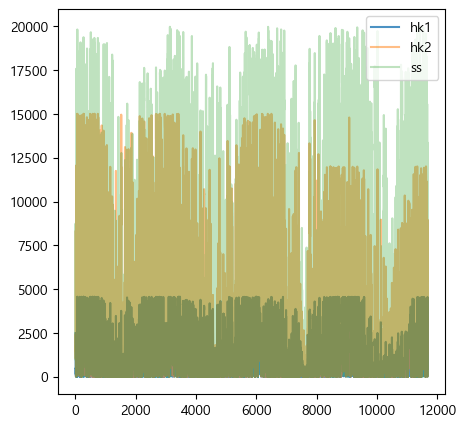

In [592]:
start = 0
end = 0


plt.plot(fcst_data_hk1['hk1'][:],alpha = 0.8,label = 'hk1')
plt.plot(fcst_data_hk2['hk2'][:],alpha = 0.5, label = 'hk2')
plt.plot(fcst_data_ss['ss'][:],alpha = 0.3, label = 'ss')
plt.legend()
plt.show

In [593]:
columns = fcst_data_hk1.columns

In [594]:
columns

Index(['tgt_Y', 'tgt_M', 'tgt_D', 'tgt_tz', 'temperature', 'humidity',
       'windspeed', 'winddirection', '6hrain', '6hsnow', 'rainprobability',
       'raintype', 'seawave', 'skystatus', 'hk1_numberofturbineinuse', 'hk1'],
      dtype='object')

In [595]:
# 2018년 데이터 제거
fcst_data_hk1 = fcst_data_hk1.drop(fcst_data_hk1.tail(1).index)
fcst_data_hk2 = fcst_data_hk2.drop(fcst_data_hk2.tail(1).index)
fcst_data_ss = fcst_data_ss.drop(fcst_data_ss.tail(1).index)

In [596]:
#feature 추가
def add_feature(dataset):
    dataset["n_winddirection"] = np.abs(dataset["windspeed"])
    dataset["n_winddirection"] = -np.sin(dataset["n_winddirection"])

    dataset["s_winddirection"] = np.abs(dataset["windspeed"])
    dataset["s_winddirection"] = -np.cos(dataset["s_winddirection"])

    dataset["windrelationship"] = dataset["windspeed"] ** 3

    dataset["tgt_season"] = (dataset.tgt_M%12 + 3)//3
    
    return dataset
    

In [597]:
fcst_data_hk1 = add_feature(fcst_data_hk1)

In [598]:
fcst_data_hk2 = add_feature(fcst_data_hk2)

In [599]:
fcst_data_ss = add_feature(fcst_data_ss)

In [600]:
fcst_data_hk1_w = fcst_data_hk1.loc[:,['tgt_Y','tgt_M','tgt_D','tgt_tz','tgt_season','temperature','humidity','windspeed','winddirection','n_winddirection','s_winddirection','windrelationship','hk1_numberofturbineinuse','hk1']]

In [601]:
fcst_data_hk2_w = fcst_data_hk2.loc[:,['tgt_Y','tgt_M','tgt_D','tgt_tz','tgt_season','temperature','humidity','windspeed','winddirection','n_winddirection','s_winddirection','windrelationship','hk2_numberofturbineinuse','hk2']]

In [602]:
fcst_data_ss_w = fcst_data_ss.loc[:,['tgt_Y','tgt_M','tgt_D','tgt_tz','tgt_season','temperature','humidity','windspeed','winddirection','n_winddirection','s_winddirection','windrelationship','ss_numberofturbineinuse','ss']]

In [603]:
fcst_data_hk1_w

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
0,2014,1,1,2,1,12.1,43.0,8.1,285.0,-0.969890,0.243544,531.441,2.000000,2481.300000
1,2014,1,1,3,1,10.6,50.0,8.0,285.0,-0.989358,0.145500,512.000,2.166667,2376.850000
2,2014,1,1,4,1,10.2,50.0,8.2,278.0,-0.940731,0.339155,551.368,2.944444,1693.833333
3,2014,1,1,5,1,8.4,50.0,6.9,281.0,-0.578440,-0.815725,328.509,3.000000,1550.994444
4,2014,1,1,6,1,8.0,50.0,6.4,298.0,-0.116549,-0.993185,262.144,3.000000,1214.227778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11681,2017,12,31,3,1,6.0,50.0,7.8,333.0,-0.998543,-0.053955,474.552,3.000000,3815.338889
11682,2017,12,31,4,1,6.0,50.0,6.9,330.0,-0.578440,-0.815725,328.509,3.000000,3070.516667
11683,2017,12,31,5,1,5.0,55.0,6.4,334.0,-0.116549,-0.993185,262.144,3.000000,3964.450000
11684,2017,12,31,6,1,6.0,50.0,7.3,347.0,-0.850437,-0.526078,389.017,3.000000,3679.100000


In [604]:
fcst_data_hk2_w

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk2_numberofturbineinuse,hk2
0,2014,1,1,2,1,12.1,43.0,8.1,285.0,-0.969890,0.243544,531.441,4.000000,8287.740000
1,2014,1,1,3,1,10.6,50.0,8.0,285.0,-0.989358,0.145500,512.000,4.000000,7438.154667
2,2014,1,1,4,1,10.2,50.0,8.2,278.0,-0.940731,0.339155,551.368,4.000000,3426.450000
3,2014,1,1,5,1,8.4,50.0,6.9,281.0,-0.578440,-0.815725,328.509,4.000000,2950.589000
4,2014,1,1,6,1,8.0,50.0,6.4,298.0,-0.116549,-0.993185,262.144,4.000000,2195.714667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11681,2017,12,31,3,1,6.0,50.0,7.8,333.0,-0.998543,-0.053955,474.552,3.000000,6404.991333
11682,2017,12,31,4,1,6.0,50.0,6.9,330.0,-0.578440,-0.815725,328.509,3.000000,4801.813667
11683,2017,12,31,5,1,5.0,55.0,6.4,334.0,-0.116549,-0.993185,262.144,3.000000,6480.021000
11684,2017,12,31,6,1,6.0,50.0,7.3,347.0,-0.850437,-0.526078,389.017,2.444444,4828.718667


In [605]:
fcst_data_ss_w

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,ss_numberofturbineinuse,ss
0,2014,1,1,2,1,12.1,45.0,3.2,290.0,0.058374,0.998295,32.768,8.555556,1191.784333
1,2014,1,1,3,1,10.0,50.0,3.5,288.0,0.350783,0.936457,42.875,10.000000,3379.547333
2,2014,1,1,4,1,5.7,51.0,2.4,301.0,-0.675463,0.737394,13.824,10.000000,8741.903000
3,2014,1,1,5,1,4.7,56.0,2.5,315.0,-0.598472,0.801144,15.625,10.000000,5691.668000
4,2014,1,1,6,1,3.9,56.0,3.0,316.0,-0.141120,0.989992,27.000,8.333333,956.983333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11681,2017,12,31,3,1,7.0,60.0,6.8,333.0,-0.494113,-0.869397,314.432,10.000000,8737.075000
11682,2017,12,31,4,1,6.0,65.0,6.4,337.0,-0.116549,-0.993185,262.144,10.000000,8257.814000
11683,2017,12,31,5,1,6.0,65.0,5.7,341.0,0.550686,-0.834713,185.193,10.000000,11685.699330
11684,2017,12,31,6,1,6.0,60.0,5.9,348.0,0.373877,-0.927478,205.379,10.000000,9262.301667


In [913]:
"""def data_split(dataset):
    dataset = dataset.dropna(axis = 0)
    
    train_dataset = dataset[dataset['tgt_Y'] != 2017]
    test_dataset = dataset[dataset['tgt_Y'] == 2017]
    train_dataset = train_dataset.drop(['tgt_Y'],axis =1)
    test_dataset= test_dataset.drop(['tgt_Y'],axis=1)

    train_x = train_dataset.drop(dataset.columns[-1],axis=1)
    #train_x = train_dataset.iloc[:,6]
    train_y = train_dataset.iloc[:,-1]
    test_x = test_dataset.drop(dataset.columns[-1],axis=1)
    #test_x = test_dataset.iloc[:,6]
    test_y = test_dataset.iloc[:,-1]   
    
    #train_x[train_x.columns] = minmax_scale(train_x[train_x.columns])
    #test_x[test_x.columns] = minmax_scale(test_x[test_x.columns])
    
    return train_x, train_y, test_x, test_y"""

"def data_split(dataset):\n    dataset = dataset.dropna(axis = 0)\n    \n    train_dataset = dataset[dataset['tgt_Y'] != 2017]\n    test_dataset = dataset[dataset['tgt_Y'] == 2017]\n    train_dataset = train_dataset.drop(['tgt_Y'],axis =1)\n    test_dataset= test_dataset.drop(['tgt_Y'],axis=1)\n\n    train_x = train_dataset.drop(dataset.columns[-1],axis=1)\n    #train_x = train_dataset.iloc[:,6]\n    train_y = train_dataset.iloc[:,-1]\n    test_x = test_dataset.drop(dataset.columns[-1],axis=1)\n    #test_x = test_dataset.iloc[:,6]\n    test_y = test_dataset.iloc[:,-1]   \n    \n    #train_x[train_x.columns] = minmax_scale(train_x[train_x.columns])\n    #test_x[test_x.columns] = minmax_scale(test_x[test_x.columns])\n    \n    return train_x, train_y, test_x, test_y"

In [914]:
'''def data_window(X_data,y_data,hist_length = 3, out_length = 1):
    
    X = []
    y = []
    X_data =pd.concat([X_data,y_data],axis=1)
    in_start = 0
    for _ in range(hist_length, len(X_data)):
        in_end = in_start + hist_length
        out_end = in_end + out_length
        
        if out_end <= len(X_data):
            _X = X_data[in_start : in_end]
            _X = _X.to_numpy().tolist()
            X.append(_X)
            
            _y = y_data[in_end : out_end]
            _y = _y.to_numpy().tolist()
            y.append(_y)
        in_start += out_length 
    
    return TensorDataset(torch.tensor(X).float()),TensorDataset(torch.tensor(y).float())# np.array(X), np.array(y)'''

'def data_window(X_data,y_data,hist_length = 3, out_length = 1):\n    \n    X = []\n    y = []\n    X_data =pd.concat([X_data,y_data],axis=1)\n    in_start = 0\n    for _ in range(hist_length, len(X_data)):\n        in_end = in_start + hist_length\n        out_end = in_end + out_length\n        \n        if out_end <= len(X_data):\n            _X = X_data[in_start : in_end]\n            _X = _X.to_numpy().tolist()\n            X.append(_X)\n            \n            _y = y_data[in_end : out_end]\n            _y = _y.to_numpy().tolist()\n            y.append(_y)\n        in_start += out_length \n    \n    return TensorDataset(torch.tensor(X).float()),TensorDataset(torch.tensor(y).float())# np.array(X), np.array(y)'

In [915]:
'''train_x_1, train_y_1, test_x_1,test_y_1 = data_split(fcst_data_hk1_w)'''

'train_x_1, train_y_1, test_x_1,test_y_1 = data_split(fcst_data_hk1_w)'

In [916]:
'''train_x_2, train_y_2, test_x_2,test_y_2 = data_split(fcst_data_hk2)'''

'train_x_2, train_y_2, test_x_2,test_y_2 = data_split(fcst_data_hk2)'

In [917]:
'''train_data_x, train_data_y = data_window(train_x_1,train_y_1, 14,1)'''

'train_data_x, train_data_y = data_window(train_x_1,train_y_1, 14,1)'

In [918]:
'''test_data_x, test_data_y = data_window(test_x_1,test_y_1, 14,1)'''

'test_data_x, test_data_y = data_window(test_x_1,test_y_1, 14,1)'

In [919]:
'''def split_series(series, n_past, n_future):
  X, y = list(), list()
  for window_start in range(len(series)):
    past_end = window_start + n_past
    future_end = past_end + n_future
    if future_end > len(series):
      break
    past, future = series[window_start:past_end, :], series[past_end:future_end, :]
    X.append(past)
    y.append(future)
  return np.array(X), np.array(y)'''

'def split_series(series, n_past, n_future):\n  X, y = list(), list()\n  for window_start in range(len(series)):\n    past_end = window_start + n_past\n    future_end = past_end + n_future\n    if future_end > len(series):\n      break\n    past, future = series[window_start:past_end, :], series[past_end:future_end, :]\n    X.append(past)\n    y.append(future)\n  return np.array(X), np.array(y)'

In [920]:
'''X_train, y_train = split_series(train_1.values,n_past, n_future)
train_data_x = X_train.reshape((X_train.shape[0], X_train.shape[1],n_features))
train_data_y = y_train.reshape((y_train.shape[0], y_train.shape[1], n_features))
X_test, y_test = split_series(test_1.values,n_past, n_future)
test_data_x = X_test.reshape((X_test.shape[0], X_test.shape[1],n_features))
test_data_y = y_test.reshape((y_test.shape[0], y_test.shape[1], n_features))'''

'X_train, y_train = split_series(train_1.values,n_past, n_future)\ntrain_data_x = X_train.reshape((X_train.shape[0], X_train.shape[1],n_features))\ntrain_data_y = y_train.reshape((y_train.shape[0], y_train.shape[1], n_features))\nX_test, y_test = split_series(test_1.values,n_past, n_future)\ntest_data_x = X_test.reshape((X_test.shape[0], X_test.shape[1],n_features))\ntest_data_y = y_test.reshape((y_test.shape[0], y_test.shape[1], n_features))'

In [921]:
#windspeed 랑 만 가지고 해보기

In [606]:
fcst_data_hk1_w

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
0,2014,1,1,2,1,12.1,43.0,8.1,285.0,-0.969890,0.243544,531.441,2.000000,2481.300000
1,2014,1,1,3,1,10.6,50.0,8.0,285.0,-0.989358,0.145500,512.000,2.166667,2376.850000
2,2014,1,1,4,1,10.2,50.0,8.2,278.0,-0.940731,0.339155,551.368,2.944444,1693.833333
3,2014,1,1,5,1,8.4,50.0,6.9,281.0,-0.578440,-0.815725,328.509,3.000000,1550.994444
4,2014,1,1,6,1,8.0,50.0,6.4,298.0,-0.116549,-0.993185,262.144,3.000000,1214.227778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11681,2017,12,31,3,1,6.0,50.0,7.8,333.0,-0.998543,-0.053955,474.552,3.000000,3815.338889
11682,2017,12,31,4,1,6.0,50.0,6.9,330.0,-0.578440,-0.815725,328.509,3.000000,3070.516667
11683,2017,12,31,5,1,5.0,55.0,6.4,334.0,-0.116549,-0.993185,262.144,3.000000,3964.450000
11684,2017,12,31,6,1,6.0,50.0,7.3,347.0,-0.850437,-0.526078,389.017,3.000000,3679.100000


In [607]:
fcst_data_hk1_w_nt = fcst_data_hk1_w.copy()
fcst_data_hk2_w_nt = fcst_data_hk2_w.copy()
fcst_data_ss_w_nt = fcst_data_ss_w.copy()

In [608]:
fcst_data_hk1_w_nt['hk1/n'] = fcst_data_hk1_w_nt['hk1'] / np.where(fcst_data_hk1_w_nt['hk1_numberofturbineinuse'] == 0, 1, fcst_data_hk1_w_nt['hk1_numberofturbineinuse'])
fcst_data_hk1_w_nt = fcst_data_hk1_w_nt.drop(['hk1','hk1_numberofturbineinuse'],axis =1)

In [609]:
fcst_data_hk2_w_nt['hk2/n'] = fcst_data_hk2_w_nt['hk2']/np.where(fcst_data_hk2_w_nt['hk2_numberofturbineinuse'] ==0,1,fcst_data_hk2_w_nt['hk2_numberofturbineinuse'])
fcst_data_hk2_w_nt = fcst_data_hk2_w_nt.drop(['hk2','hk2_numberofturbineinuse'],axis =1)

In [610]:
fcst_data_ss_w_nt['ss/n'] = fcst_data_ss_w_nt['ss']/np.where(fcst_data_ss_w_nt['ss_numberofturbineinuse']==0,1,fcst_data_ss_w_nt['ss_numberofturbineinuse'])
fcst_data_ss_w_nt = fcst_data_ss_w_nt.drop(['ss','ss_numberofturbineinuse'],axis =1)

In [611]:
fcst_data_hk1_w.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,11686.000000,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11596.000000,11586.000000,11586.000000,11586.000000,11586.000000,11586.000000,11686.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,2.503337,16.043938,72.283029,5.824814,164.948127,0.067104,0.111440,445.412181,1.788531,1203.170268
std,1.117699,3.448389,8.799111,2.291236,1.114627,7.727461,13.083765,3.371433,129.591698,0.704267,0.697976,947.043530,1.152097,1427.249969
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-4.400000,34.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2015.000000,4.000000,8.000000,2.000000,2.000000,9.500000,61.000000,3.400000,38.000000,-0.644218,-0.554374,39.304000,0.611111,31.525000
50%,2016.000000,7.000000,16.000000,4.000000,3.000000,16.299999,73.000000,5.000000,147.000000,0.157746,0.210796,125.000000,2.000000,527.391667
75%,2016.000000,10.000000,23.000000,5.750000,3.000000,22.400000,84.000000,7.400000,311.750000,0.756802,0.790968,405.224000,3.000000,2096.770834
max,2017.000000,12.000000,31.000000,7.000000,4.000000,33.299999,100.000000,29.299999,360.000000,0.999990,0.999968,25153.754425,3.000000,4567.250000


In [612]:
fcst_data_hk1_w[fcst_data_hk1_w['hk1_numberofturbineinuse']==0].describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,1701.000000,1701.000000,1701.000000,1701.000000,1701.000000,1677.000000,1674.000000,1674.000000,1674.000000,1674.000000,1674.000000,1674.000000,1701.0,1701.0
mean,2015.586714,6.737801,16.456202,3.462081,2.776014,19.650388,76.095579,3.888769,150.745520,-0.066575,0.329440,172.014110,0.0,0.0
std,1.127324,2.601025,8.608477,2.426666,0.863529,6.187882,11.553837,2.531243,116.872478,0.708984,0.620410,571.728162,0.0,0.0
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-2.200000,40.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.0,0.0
25%,2015.000000,5.000000,9.000000,1.000000,2.000000,15.000000,70.000000,2.300000,43.000000,-0.745705,-0.087499,12.167000,0.0,0.0
50%,2016.000000,6.000000,17.000000,3.000000,3.000000,20.299999,77.000000,3.350000,118.500000,-0.141120,0.504846,37.620500,0.0,0.0
75%,2017.000000,8.000000,24.000000,6.000000,3.000000,24.000000,85.000000,4.675000,247.000000,0.611858,0.856889,102.201250,0.0,0.0
max,2017.000000,12.000000,31.000000,7.000000,4.000000,33.000000,100.000000,20.700001,360.000000,0.999990,0.999968,8869.744285,0.0,0.0


In [613]:
fcst_data_hk1_w.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,11686.000000,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11596.000000,11586.000000,11586.000000,11586.000000,11586.000000,11586.000000,11686.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,2.503337,16.043938,72.283029,5.824814,164.948127,0.067104,0.111440,445.412181,1.788531,1203.170268
std,1.117699,3.448389,8.799111,2.291236,1.114627,7.727461,13.083765,3.371433,129.591698,0.704267,0.697976,947.043530,1.152097,1427.249969
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-4.400000,34.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2015.000000,4.000000,8.000000,2.000000,2.000000,9.500000,61.000000,3.400000,38.000000,-0.644218,-0.554374,39.304000,0.611111,31.525000
50%,2016.000000,7.000000,16.000000,4.000000,3.000000,16.299999,73.000000,5.000000,147.000000,0.157746,0.210796,125.000000,2.000000,527.391667
75%,2016.000000,10.000000,23.000000,5.750000,3.000000,22.400000,84.000000,7.400000,311.750000,0.756802,0.790968,405.224000,3.000000,2096.770834
max,2017.000000,12.000000,31.000000,7.000000,4.000000,33.299999,100.000000,29.299999,360.000000,0.999990,0.999968,25153.754425,3.000000,4567.250000


In [614]:
fcst_data_hk1_w_nt.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1/n
count,11686.000000,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11596.000000,11586.000000,11586.000000,11586.000000,11586.000000,11586.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,2.503337,16.043938,72.283029,5.824814,164.948127,0.067104,0.111440,445.412181,471.196578
std,1.117699,3.448389,8.799111,2.291236,1.114627,7.727461,13.083765,3.371433,129.591698,0.704267,0.697976,947.043530,514.524614
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-4.400000,34.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000
25%,2015.000000,4.000000,8.000000,2.000000,2.000000,9.500000,61.000000,3.400000,38.000000,-0.644218,-0.554374,39.304000,43.930179
50%,2016.000000,7.000000,16.000000,4.000000,3.000000,16.299999,73.000000,5.000000,147.000000,0.157746,0.210796,125.000000,230.095513
75%,2016.000000,10.000000,23.000000,5.750000,3.000000,22.400000,84.000000,7.400000,311.750000,0.756802,0.790968,405.224000,836.373693
max,2017.000000,12.000000,31.000000,7.000000,4.000000,33.299999,100.000000,29.299999,360.000000,0.999990,0.999968,25153.754425,1522.416667


In [615]:
fcst_data_hk1_w = fcst_data_hk1_w.dropna()
train_hk1= fcst_data_hk1_w[(fcst_data_hk1_w['tgt_Y'] != 2017) & (fcst_data_hk1_w['tgt_Y'] != 2016)]
val_hk1 = fcst_data_hk1_w[fcst_data_hk1_w['tgt_Y'] == 2016]
test_hk1= fcst_data_hk1_w[fcst_data_hk1_w['tgt_Y'] == 2017]

In [616]:
# 발전량 / 터빈 수
fcst_data_hk1_w_nt = fcst_data_hk1_w_nt.dropna()
train_hk1_nt= fcst_data_hk1_w_nt[(fcst_data_hk1_w_nt['tgt_Y'] != 2017) & (fcst_data_hk1_w_nt['tgt_Y'] != 2016)]
val_hk1_nt = fcst_data_hk1_w_nt[fcst_data_hk1_w_nt['tgt_Y'] == 2016]
test_hk1_nt= fcst_data_hk1_w_nt[fcst_data_hk1_w_nt['tgt_Y'] == 2017]

In [617]:
fcst_data_hk2_w = fcst_data_hk2_w.dropna()
train_hk2 = fcst_data_hk2_w[(fcst_data_hk2_w['tgt_Y'] != 2017) & (fcst_data_hk2_w['tgt_Y'] != 2016)]
val_hk2 = fcst_data_hk2_w[fcst_data_hk2_w['tgt_Y'] == 2016]
test_hk2 = fcst_data_hk2_w[fcst_data_hk2_w['tgt_Y'] == 2017]


In [618]:
# 발전량 / 터빈 수
fcst_data_hk2_w_nt = fcst_data_hk2_w_nt.dropna()
train_hk2_nt = fcst_data_hk2_w_nt[(fcst_data_hk2_w_nt['tgt_Y'] != 2017) & (fcst_data_hk2_w_nt['tgt_Y'] != 2016)]
val_hk2_nt = fcst_data_hk2_w_nt[fcst_data_hk2_w_nt['tgt_Y'] == 2016]
test_hk2_nt = fcst_data_hk2_w_nt[fcst_data_hk2_w_nt['tgt_Y'] == 2017]


In [619]:
fcst_data_ss_w = fcst_data_ss_w.dropna()
train_ss = fcst_data_ss_w[(fcst_data_ss_w['tgt_Y'] != 2017) & (fcst_data_ss_w['tgt_Y'] != 2016)]
val_ss = fcst_data_ss_w[fcst_data_ss_w['tgt_Y'] == 2016]
test_ss = fcst_data_ss_w[fcst_data_ss_w['tgt_Y'] == 2017]


In [620]:
from sklearn.preprocessing import MinMaxScaler

def minmax_scaler(train,val,test):
    # train 데이터를 numpy 배열로 변환하여 스케일러 학습
    train_array = train.values
    train_features = train_array[:, 1:-1]
    scaler = MinMaxScaler()
    scaler.fit(train_features)
    
    # train, val, test에 스케일링 적용
    scaled_train_features = scaler.transform(train_features)
    scaled_val_features = scaler.transform(val.values[:, 1:-1])
    scaled_test_features = scaler.transform(test.values[:, 1:-1])
    
    # 스케일링된 features와 마지막 열을 합쳐서 최종 결과 생성
    scaled_train_array = np.hstack((scaled_train_features, train_array[:, -1].reshape(-1, 1)))
    scaled_val_array = np.hstack((scaled_val_features, val.values[:, -1].reshape(-1, 1)))
    scaled_test_array = np.hstack((scaled_test_features, test.values[:, -1].reshape(-1, 1)))
    
    # numpy 배열을 DataFrame으로 변환
    scaled_train = pd.DataFrame(scaled_train_array, columns=train.columns[1:])
    scaled_val = pd.DataFrame(scaled_val_array, columns=val.columns[1:])
    scaled_test = pd.DataFrame(scaled_test_array, columns=test.columns[1:])
    
    return scaled_train, scaled_val, scaled_test




In [626]:
train_hk1.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000
mean,2014.491460,6.550889,15.627222,3.501743,2.509759,15.797734,71.964448,5.954096,165.699547,0.093182,0.114319,464.425260,1.908098,1269.230157
std,0.499971,3.472285,8.731819,2.291639,1.121979,7.296471,12.882074,3.377190,129.156067,0.699240,0.699630,989.271840,1.154516,1450.374851
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-0.300000,34.000000,0.200000,0.000000,-0.999574,-0.999859,0.008000,0.000000,0.000000
25%,2014.000000,3.000000,8.000000,2.000000,1.000000,9.600000,61.000000,3.600000,42.000000,-0.584917,-0.554374,46.656000,0.777778,44.386111
50%,2014.000000,7.000000,16.000000,4.000000,3.000000,16.200001,72.000000,5.100000,144.000000,0.174327,0.210796,132.651000,2.277778,610.516667
75%,2015.000000,10.000000,23.000000,6.000000,4.000000,21.975000,83.000000,7.600000,311.000000,0.767686,0.790968,438.976000,3.000000,2229.587500
max,2015.000000,12.000000,31.000000,7.000000,4.000000,32.599998,100.000000,29.299999,360.000000,0.999990,0.999968,25153.754425,3.000000,4567.250000


In [629]:
val_hk1.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,2928.0,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000
mean,2016.0,6.513661,15.756831,3.500000,2.500000,16.557411,72.020492,6.343921,160.481557,0.117854,0.109772,566.287129,1.761517,1191.725106
std,0.0,3.451823,8.813035,2.291679,1.115778,8.001556,12.546310,3.642761,129.337262,0.690630,0.705283,1082.407678,1.150769,1423.451768
min,2016.0,1.000000,1.000000,0.000000,1.000000,-4.400000,35.000000,0.500000,0.000000,-0.999574,-0.999859,0.125000,0.000000,0.000000
25%,2016.0,4.000000,8.000000,1.750000,2.000000,10.075000,61.000000,3.700000,36.750000,-0.515501,-0.568290,50.653000,0.555556,23.440278
50%,2016.0,7.000000,16.000000,3.500000,2.500000,16.799999,73.000000,5.300000,129.500000,0.255541,0.210796,148.877000,2.000000,510.980556
75%,2016.0,10.000000,23.000000,5.250000,3.000000,23.200001,84.000000,8.000000,309.250000,0.767686,0.801144,512.000000,2.944444,2136.205556
max,2016.0,12.000000,31.000000,7.000000,4.000000,33.299999,99.000000,21.900000,360.000000,0.999990,0.999968,10503.459000,3.000000,4563.877778


In [627]:
test_hk1.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk1_numberofturbineinuse,hk1
count,2920.0,2920.000000,2920.000000,2920.00000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000
mean,2017.0,6.526027,15.720548,3.50000,2.504110,15.988596,73.137329,5.050240,167.950342,-0.035029,0.107457,286.844066,1.594768,1112.264072
std,0.0,3.448442,8.797754,2.29168,1.114535,8.249392,13.940311,2.913126,130.625325,0.717577,0.687494,648.701652,1.114413,1390.222827
min,2017.0,1.000000,1.000000,0.00000,1.000000,1.000000,35.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2017.0,4.000000,8.000000,1.75000,2.000000,9.000000,60.000000,2.800000,32.000000,-0.745705,-0.554374,21.952000,0.500000,22.341667
50%,2017.0,7.000000,16.000000,3.50000,3.000000,16.000000,75.000000,4.600000,171.500000,-0.070707,0.210796,97.336000,1.777778,441.602778
75%,2017.0,10.000000,23.000000,5.25000,3.000000,23.000000,85.000000,6.700000,314.000000,0.699875,0.790968,300.763000,2.888889,1816.290278
max,2017.0,12.000000,31.000000,7.00000,4.000000,33.000000,100.000000,20.900000,360.000000,0.999990,0.999693,9129.329000,3.000000,4562.127778


In [624]:
train_hk2.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk2_numberofturbineinuse,hk2
count,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000,5738.000000
mean,2014.491460,6.550889,15.627222,3.501743,2.509759,15.797734,71.964448,5.954096,165.699547,0.093182,0.114319,464.425260,3.516827,3743.866861
std,0.499971,3.472285,8.731819,2.291639,1.121979,7.296471,12.882074,3.377190,129.156067,0.699240,0.699630,989.271840,1.727003,4329.034207
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-0.300000,34.000000,0.200000,0.000000,-0.999574,-0.999859,0.008000,0.000000,0.000000
25%,2014.000000,3.000000,8.000000,2.000000,1.000000,9.600000,61.000000,3.600000,42.000000,-0.584917,-0.554374,46.656000,2.222222,317.183083
50%,2014.000000,7.000000,16.000000,4.000000,3.000000,16.200001,72.000000,5.100000,144.000000,0.174327,0.210796,132.651000,4.166667,1829.473667
75%,2015.000000,10.000000,23.000000,6.000000,4.000000,21.975000,83.000000,7.600000,311.000000,0.767686,0.790968,438.976000,5.000000,5958.915583
max,2015.000000,12.000000,31.000000,7.000000,4.000000,32.599998,100.000000,29.299999,360.000000,0.999990,0.999968,25153.754425,5.000000,15005.540670


In [623]:
val_hk2.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk2_numberofturbineinuse,hk2
count,2928.0,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000,2928.000000
mean,2016.0,6.513661,15.756831,3.500000,2.500000,16.557411,72.020492,6.343921,160.481557,0.117854,0.109772,566.287129,3.237325,3466.486951
std,0.0,3.451823,8.813035,2.291679,1.115778,8.001556,12.546310,3.642761,129.337262,0.690630,0.705283,1082.407678,1.688400,4121.889874
min,2016.0,1.000000,1.000000,0.000000,1.000000,-4.400000,35.000000,0.500000,0.000000,-0.999574,-0.999859,0.125000,0.000000,0.000000
25%,2016.0,4.000000,8.000000,1.750000,2.000000,10.075000,61.000000,3.700000,36.750000,-0.515501,-0.568290,50.653000,2.222222,227.418750
50%,2016.0,7.000000,16.000000,3.500000,2.500000,16.799999,73.000000,5.300000,129.500000,0.255541,0.210796,148.877000,4.000000,1505.476333
75%,2016.0,10.000000,23.000000,5.250000,3.000000,23.200001,84.000000,8.000000,309.250000,0.767686,0.801144,512.000000,4.777778,5763.085667
max,2016.0,12.000000,31.000000,7.000000,4.000000,33.299999,99.000000,21.900000,360.000000,0.999990,0.999968,10503.459000,5.000000,15003.613670


In [625]:
test_hk2.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,hk2_numberofturbineinuse,hk2
count,2920.0,2920.000000,2920.000000,2920.00000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000
mean,2017.0,6.526027,15.720548,3.50000,2.504110,15.988596,73.137329,5.050240,167.950342,-0.035029,0.107457,286.844066,2.745225,2912.514977
std,0.0,3.448442,8.797754,2.29168,1.114535,8.249392,13.940311,2.913126,130.625325,0.717577,0.687494,648.701652,1.371506,3280.792073
min,2017.0,1.000000,1.000000,0.00000,1.000000,1.000000,35.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2017.0,4.000000,8.000000,1.75000,2.000000,9.000000,60.000000,2.800000,32.000000,-0.745705,-0.554374,21.952000,2.000000,284.020750
50%,2017.0,7.000000,16.000000,3.50000,3.000000,16.000000,75.000000,4.600000,171.500000,-0.070707,0.210796,97.336000,3.000000,1533.522000
75%,2017.0,10.000000,23.000000,5.25000,3.000000,23.000000,85.000000,6.700000,314.000000,0.699875,0.790968,300.763000,4.000000,4742.190167
max,2017.0,12.000000,31.000000,7.00000,4.000000,33.000000,100.000000,20.900000,360.000000,0.999990,0.999693,9129.329000,5.000000,14793.648670


In [630]:
train_ss.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,ss_numberofturbineinuse,ss
count,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000,5759.000000
mean,2014.493315,6.452856,15.577010,3.500434,2.525265,15.712971,72.110436,3.624501,203.949991,-0.021358,0.383962,120.378598,7.545156,4930.396309
std,0.499999,3.410264,8.755444,2.291449,1.107779,7.422999,13.984459,2.073697,121.508628,0.701194,0.600493,490.471133,3.118645,5236.181032
min,2014.000000,1.000000,1.000000,0.000000,1.000000,-2.100000,14.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2014.000000,4.000000,8.000000,2.000000,2.000000,9.300000,63.000000,2.300000,73.000000,-0.745705,0.029200,12.167000,6.722222,651.050500
50%,2014.000000,6.000000,16.000000,4.000000,3.000000,16.600000,74.000000,3.200000,223.000000,-0.041581,0.574824,32.768000,9.000000,2910.347000
75%,2015.000000,9.000000,23.000000,5.500000,4.000000,22.000000,84.000000,4.300000,323.000000,0.756802,0.936457,79.507000,10.000000,7756.664833
max,2015.000000,12.000000,31.000000,7.000000,4.000000,32.500000,100.000000,20.799999,360.000000,0.999923,0.999968,8998.910702,10.000000,19971.227670


In [631]:
val_ss.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,ss_numberofturbineinuse,ss
count,2926.0,2926.00000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000,2926.000000
mean,2016.0,6.51743,15.766917,3.502051,2.501025,16.586876,72.698565,3.915243,203.693096,0.027851,0.310396,127.007533,7.883212,5201.417422
std,0.0,3.44999,8.807593,2.291082,1.115470,8.088203,12.466326,2.087991,120.614943,0.707711,0.634297,365.095360,3.167042,5634.583155
min,2016.0,1.00000,1.000000,0.000000,1.000000,-4.500000,34.000000,0.100000,0.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2016.0,4.00000,8.000000,2.000000,2.000000,9.925000,65.000000,2.500000,78.000000,-0.675463,-0.169967,15.625000,7.000000,743.626917
50%,2016.0,7.00000,16.000000,4.000000,3.000000,17.200001,74.000000,3.600000,215.000000,0.058374,0.504846,46.656000,9.666667,2768.943000
75%,2016.0,10.00000,23.000000,5.750000,3.000000,23.200001,83.000000,4.800000,323.000000,0.756802,0.896758,110.592000,10.000000,8408.043750
max,2016.0,12.00000,31.000000,7.000000,4.000000,33.200001,94.000000,21.100000,360.000000,0.999990,0.999693,9393.931000,10.000000,19967.577330


In [632]:
test_ss.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,tgt_season,temperature,humidity,windspeed,winddirection,n_winddirection,s_winddirection,windrelationship,ss_numberofturbineinuse,ss
count,2920.0,2920.000000,2920.000000,2920.00000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000,2920.000000
mean,2017.0,6.526027,15.720548,3.50000,2.504110,16.384247,71.366438,4.165034,225.100342,-0.056773,0.210472,161.288934,7.760217,5477.222193
std,0.0,3.448442,8.797754,2.29168,1.114535,7.899512,12.887740,2.403965,118.444879,0.708739,0.671188,348.267014,3.247505,5627.712840
min,2017.0,1.000000,1.000000,0.00000,1.000000,1.000000,20.000000,0.100000,1.000000,-0.999574,-0.999859,0.001000,0.000000,0.000000
25%,2017.0,4.000000,8.000000,1.75000,2.000000,10.000000,60.000000,2.500000,107.750000,-0.755111,-0.377978,15.625000,7.055556,766.076333
50%,2017.0,7.000000,16.000000,3.50000,3.000000,17.000000,70.000000,3.700000,284.500000,-0.132787,0.362247,50.653000,9.166667,3271.203000
75%,2017.0,10.000000,23.000000,5.25000,3.000000,23.000000,80.000000,5.400000,329.000000,0.631267,0.848100,157.464000,10.000000,9119.275500
max,2017.0,12.000000,31.000000,7.00000,4.000000,32.000000,95.000000,17.299999,360.000000,0.999990,0.999693,5177.716102,10.000000,19962.237670


In [633]:
train_hk1,val_hk1,test_hk1 = minmax_scaler(train_hk1,val_hk1,test_hk1)

In [634]:
train_hk2,val_hk2,test_hk2 = minmax_scaler(train_hk2,val_hk2,test_hk2)

In [635]:
train_ss,val_ss,test_ss = minmax_scaler(train_ss,val_ss,test_ss)

In [636]:
# 발전량 / 터빈 수
fcst_data_ss_w_nt = fcst_data_ss_w_nt.dropna()
train_ss_nt = fcst_data_ss_w_nt[(fcst_data_ss_w_nt['tgt_Y'] != 2017) & (fcst_data_ss_w_nt['tgt_Y'] != 2016)]
val_ss_nt = fcst_data_ss_w_nt[fcst_data_ss_w_nt['tgt_Y'] == 2016]
test_ss_nt = fcst_data_ss_w_nt[fcst_data_ss_w_nt['tgt_Y'] == 2017]


In [637]:
fcst_data_hk1_w.shape , fcst_data_hk1_w_nt.shape

((11586, 14), (11586, 13))

In [638]:
fcst_data_hk2_w.shape , fcst_data_hk2_w_nt.shape

((11586, 14), (11586, 13))

In [639]:
fcst_data_ss_w.shape, fcst_data_ss_w_nt.shape

((11605, 14), (11605, 13))

In [640]:
train_hk1.shape, val_hk1.shape, test_hk1.shape

((5738, 13), (2928, 13), (2920, 13))

In [641]:
train_hk2.shape, val_hk2.shape,test_hk2.shape

((5738, 13), (2928, 13), (2920, 13))

In [642]:
train_ss.shape, val_ss.shape, test_ss.shape

((5759, 13), (2926, 13), (2920, 13))

In [809]:
#train_1_pr = train_1.loc[:,['windspeed','windrelationship','n_winddirection','s_winddirection','hk1']]

In [810]:
#test_1_pr = test_1.loc[:,['windspeed','windrelationship','n_winddirection','s_winddirection','hk1']]

In [769]:
#trainX = train_1_pr.drop(['hk1'],axis=1).to_numpy().reshape(-1,4,1)
#trainY = train_1_pr['hk1'].to_numpy().reshape(-1,1)

In [ ]:
# testX = test_1_pr.drop(['hk1'],axis=1).to_numpy().reshape(-1,4,1)
# testY = test_1_pr['hk1'].to_numpy().reshape(-1,1)

In [33]:
n_future = 1 
n_past = 15

In [50]:
def data_window(data,n_past,n_future,isTrain):
    data_x = []
    data_y = []

    if isTrain == True:
        for i in range(n_past+7,len(data)-n_future):
            data_x.append(data.values[i-n_past-1:i+1,0:data.shape[1]-1])
            data_y.append(np.expand_dims(data.values[i-1:i,-1],axis = 1).tolist())
    else :
        for i in range(n_past, len(data)-n_future):
            data_x.append(data.values[i-n_past:i+n_future+1,0:data.shape[1]-1])
            data_y.append(np.expand_dims(data.values[i:i+n_future,-1],axis = 1).tolist())
        
    return np.array(data_x),np.array(data_y)
        


In [51]:
def data_window_multi(data,n_past,n_future,isTrain):
    data_x = []
    data_y = []
    if isTrain == True:
        for i in range(n_past+7,len(data)-n_future+1,n_future):
            data_x.append(data.values[i-n_past-1:i+n_future,0:data.shape[1]-1])
            data_y.append(np.expand_dims(data.values[i:i+n_future,-1],axis = 1).tolist())
    else:
        for i in range(n_past,len(data)-n_future+1,n_future):
            data_x.append(data.values[i-n_past:i+n_future+1,0:data.shape[1]-1])
            data_y.append(np.expand_dims(data.values[i:i+n_future,-1],axis = 1).tolist())

        
    return np.array(data_x),np.array(data_y)
        


In [52]:
def data_window_multi(data, n_past, n_future, isTrain):
    data_x = []
    data_y = []
    if isTrain == True:
        for i in range(n_past+7, len(data)-n_future+1, n_future):
            data_x.append(data.values[i-n_past-1:i+n_future, 0:data.shape[1]-1].tolist())
            data_y.append(np.expand_dims(data.values[i:i+n_future, -1], axis=1).tolist())
    else:
        for i in range(n_past, len(data)-n_future, n_future):
            data_x.append(data.values[i-n_past:i+n_future+1, 0:data.shape[1]-1].tolist())
            data_y.append(np.expand_dims(data.values[i:i+n_future, -1], axis=1).tolist())

    return np.array(data_x), np.array(data_y)

In [53]:
past_lengths = [22, 30, 38]  # 여러 길이를 원하는대로 추가 가능

In [54]:
past_lengths_m = [15,23,31]

In [55]:
# 과거 데이터 길이의 리스트를 정의

# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths:
    # train 데이터 생성
    trainX_hk1_name = f"trainX_hk1_{past_length}"
    trainY_hk1_name = f"trainY_hk1_{past_length}"
    globals()[trainX_hk1_name], globals()[trainY_hk1_name] = data_window(train_hk1, past_length, 1, True)
    
    # valid 데이터 생성
    validX_hk1_name = f"validX_hk1_{past_length}"
    validY_hk1_name = f"validY_hk1_{past_length}"
    globals()[validX_hk1_name], globals()[validY_hk1_name] = data_window(val_hk1, past_length, 1, False)
    
    # test 데이터 생성
    testX_hk1_name = f"testX_hk1_{past_length}"
    testY_hk1_name = f"testY_hk1_{past_length}"
    globals()[testX_hk1_name], globals()[testY_hk1_name] = data_window(test_hk1, past_length, 1, False)


In [56]:
# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths:
    # train 데이터 생성
    trainX_hk2_name = f"trainX_hk2_{past_length}"
    trainY_hk2_name = f"trainY_hk2_{past_length}"
    globals()[trainX_hk2_name], globals()[trainY_hk2_name] = data_window(train_hk2, past_length, 1, True)
    
    # valid 데이터 생성
    validX_hk2_name = f"validX_hk2_{past_length}"
    validY_hk2_name = f"validY_hk2_{past_length}"
    globals()[validX_hk2_name], globals()[validY_hk2_name] = data_window(val_hk2, past_length, 1, False)
    
    # test 데이터 생성
    testX_hk2_name = f"testX_hk2_{past_length}"
    testY_hk2_name = f"testY_hk2_{past_length}"
    globals()[testX_hk2_name], globals()[testY_hk2_name] = data_window(test_hk2, past_length, 1, False)


In [57]:
# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths:
    # train 데이터 생성
    trainX_ss_name = f"trainX_ss_{past_length}"
    trainY_ss_name = f"trainY_ss_{past_length}"
    globals()[trainX_ss_name], globals()[trainY_ss_name] = data_window(train_ss, past_length, 1, True)
    
    # valid 데이터 생성
    validX_ss_name = f"validX_ss_{past_length}"
    validY_ss_name = f"validY_ss_{past_length}"
    globals()[validX_ss_name], globals()[validY_ss_name] = data_window(val_ss, past_length, 1, False)
    
    # test 데이터 생성
    testX_ss_name = f"testX_ss_{past_length}"
    testY_ss_name = f"testY_ss_{past_length}"
    globals()[testX_ss_name], globals()[testY_ss_name] = data_window(test_ss, past_length, 1, False)


In [58]:
# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths_m:
    # train 데이터 생성
    trainX_hk1_name = f"trainX_hk1_{past_length}_m"
    trainY_hk1_name = f"trainY_hk1_{past_length}_m"
    globals()[trainX_hk1_name], globals()[trainY_hk1_name] = data_window_multi(train_hk1, past_length, 8, True)
    
    # valid 데이터 생성
    validX_hk1_name = f"validX_hk1_{past_length}_m"
    validY_hk1_name = f"validY_hk1_{past_length}_m"
    globals()[validX_hk1_name], globals()[validY_hk1_name] = data_window_multi(val_hk1, past_length, 8, False)
    
    # test 데이터 생성
    testX_hk1_name = f"testX_hk1_{past_length}_m"
    testY_hk1_name = f"testY_hk1_{past_length}_m"
    globals()[testX_hk1_name], globals()[testY_hk1_name] = data_window_multi(test_hk1, past_length, 8, False)


In [59]:
# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths_m:
    # train 데이터 생성
    trainX_hk2_name = f"trainX_hk2_{past_length}_m"
    trainY_hk2_name = f"trainY_hk2_{past_length}_m"
    globals()[trainX_hk2_name], globals()[trainY_hk2_name] = data_window_multi(train_hk2, past_length, 8, True)
    
    # valid 데이터 생성
    validX_hk2_name = f"validX_hk2_{past_length}_m"
    validY_hk2_name = f"validY_hk2_{past_length}_m"
    globals()[validX_hk2_name], globals()[validY_hk2_name] = data_window_multi(val_hk2, past_length, 8, False)
    
    # test 데이터 생성
    testX_hk2_name = f"testX_hk2_{past_length}_m"
    testY_hk2_name = f"testY_hk2_{past_length}_m"
    globals()[testX_hk2_name], globals()[testY_hk2_name] = data_window_multi(test_hk2, past_length, 8, False)


In [60]:
# 변수명을 변경하고 여러 과거 데이터를 받는 for 루프
for past_length in past_lengths_m:
    # train 데이터 생성
    trainX_ss_name = f"trainX_ss_{past_length}_m"
    trainY_ss_name = f"trainY_ss_{past_length}_m"
    globals()[trainX_ss_name], globals()[trainY_ss_name] = data_window_multi(train_ss,past_length,8,True)
    
    # valid 데이터 생성
    validX_ss_name = f"validX_ss_{past_length}_m"
    validY_ss_name = f"validY_ss_{past_length}_m"
    globals()[validX_ss_name], globals()[validY_ss_name] = data_window_multi(val_ss,past_length,8,False)
    
    # test 데이터 생성
    testX_ss_name = f"testX_ss_{past_length}_m"
    testY_ss_name = f"testY_ss_{past_length}_m"
    globals()[testX_ss_name], globals()[testY_ss_name] = data_window_multi(test_ss,past_length,8,False)


In [61]:
trainX_hk1_15_m.shape, trainX_hk2_23_m.shape, trainX_ss_31_m.shape

((714, 24, 12), (713, 32, 12), (715, 40, 12))

In [62]:
trainX_hk1_15_m.shape, trainX_hk2_23_m.shape, trainX_ss_31_m.shape

((714, 24, 12), (713, 32, 12), (715, 40, 12))

In [65]:
print(trainX_hk1_22.shape)
print(trainY_hk1_22.shape)
print(validX_hk1_22.shape)
print(validY_hk1_22.shape)
print(testX_hk1_22.shape)
print(testY_hk1_22.shape)

(5709, 24, 12)
(5709, 1, 1)
(2905, 24, 12)
(2905, 1, 1)
(2897, 24, 12)
(2897, 1, 1)


In [66]:
print(trainX_hk1_22.shape)
print(trainX_hk1_30.shape)
print(trainX_hk1_38.shape)

(5709, 24, 12)
(5701, 32, 12)
(5693, 40, 12)


In [67]:
print(trainX_hk2_22.shape)
print(trainX_hk2_30.shape)
print(trainX_hk2_38.shape)

(5709, 24, 12)
(5701, 32, 12)
(5693, 40, 12)


In [1497]:
print(trainX_ss_22.shape)
print(trainX_ss_30.shape)
print(trainX_ss_38.shape)

(5729, 24, 12)
(5721, 32, 12)
(5713, 40, 12)


In [1506]:
trainX_hk1,trainY_hk1 = data_window(train_hk1,22,1,True)
validX_hk1,validY_hk1 = data_window(val_hk1,22,1,False)
testX_hk1,testY_hk1 = data_window(test_hk1,22,1,False)

In [1652]:
trainX_hk1_m,trainY_hk1_m = data_window_multi(train_hk1,23,8,True)
validX_hk1_m,validY_hk1_m = data_window_multi(val_hk1,15,8,False)
testX_hk1_m,testY_hk1_m = data_window_multi(test_hk1,15,8,False)

In [1613]:
trainX_hk2,trainY_hk2 = data_window(train_hk2,15,1,True)
validX_hk2,validY_hk2 = data_window(val_hk2,15,1,False)
testX_hk2,testY_hk2 = data_window(test_hk2,15,1,False)

In [962]:
trainX_hk2_m,trainY_hk2_m = data_window_multi(train_hk2,15,8,True)
validX_hk2_m,validY_hk2_m = data_window_multi(val_hk2,15,8,False)
testX_hk2_m,testY_hk2_m = data_window_multi(test_hk2,15,8,False)

In [1508]:
trainX_ss,trainY_ss = data_window(train_ss,22,1,True)
validX_ss,validY_ss = data_window(val_ss,22,1,False)
testX_ss,testY_ss = data_window(test_ss,22,1,False)

In [964]:
trainX_ss_m,trainY_ss_m = data_window_multi(train_ss,15,8,True)
validX_ss_m,validY_ss_m = data_window_multi(val_ss,15,8,False)
testX_ss_m,testY_ss_m = data_window_multi(test_ss,15,8,False)

In [68]:
print(trainX_hk1.shape)
print(trainY_hk1.shape)
print(validX_hk1.shape)
print(validY_hk1.shape)
print(testX_hk1.shape)
print(testY_hk1.shape)

NameError: name 'trainX_hk1' is not defined

In [69]:
print(trainX_hk1_m.shape)
print(trainY_hk1_m.shape)
print(validX_hk1_m.shape)
print(validY_hk1_m.shape)
print(testX_hk1_m.shape)
print(testY_hk1_m.shape)

NameError: name 'trainX_hk1_m' is not defined

In [1614]:
print(trainX_hk2.shape)
print(trainY_hk2.shape)
print(validX_hk2.shape)
print(validY_hk2.shape)
print(testX_hk2.shape)
print(testY_hk2.shape)

(5715, 17, 12)
(5715, 1, 1)
(2912, 17, 12)
(2912, 1, 1)
(2904, 17, 12)
(2904, 1, 1)


In [1512]:
print(trainX_hk2_m.shape)
print(trainY_hk2_m.shape)
print(validX_hk2_m.shape)
print(validY_hk2_m.shape)
print(testX_hk2_m.shape)
print(testY_hk2_m.shape)

(714, 24, 12)
(714, 8, 1)
(364, 24, 12)
(364, 8, 1)
(363, 24, 12)
(363, 8, 1)


In [1513]:
print(trainX_ss.shape)
print(trainY_ss.shape)
print(validX_ss.shape)
print(validY_ss.shape)
print(testX_ss.shape)
print(testY_ss.shape)

(5729, 24, 12)
(5729, 1, 1)
(2903, 24, 12)
(2903, 1, 1)
(2897, 24, 12)
(2897, 1, 1)


In [1514]:
print(trainX_ss_m.shape)
print(trainY_ss_m.shape)
print(validX_ss_m.shape)
print(validY_ss_m.shape)
print(testX_ss_m.shape)
print(testY_ss_m.shape)

(717, 24, 12)
(717, 8, 1)
(363, 24, 12)
(363, 8, 1)
(363, 24, 12)
(363, 8, 1)


In [817]:
'''
trainX_hk1 = []
trainY_hk1 = []

for i in range(n_past, len(train_hk1) - n_future +1):
   trainX_hk1.append(train_hk1.values[i - n_past:i, 0:train_hk1.shape[1]])
   trainY_hk1.append(np.expand_dims(train_hk1.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
trainX_hk1, trainY_hk1 = np.array(trainX_hk1), np.array(trainY_hk1)
print(trainX_hk1.shape)
print(trainY_hk1.shape)

testX_hk1 = []
testY_hk1 = []

for i in range(n_past, len(test_hk1) - n_future +1):
   testX_hk1.append(test_hk1.values[i - n_past:i, 0:test_hk1.shape[1]])
   testY_hk1.append(np.expand_dims(test_hk1.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
    
testX_hk1, testY_hk1 = np.array(testX_hk1),np.array(testY_hk1)
print(testX_hk1.shape)
print(testY_hk1.shape)'''

'\ntrainX_hk1 = []\ntrainY_hk1 = []\n\nfor i in range(n_past, len(train_hk1) - n_future +1):\n   trainX_hk1.append(train_hk1.values[i - n_past:i, 0:train_hk1.shape[1]])\n   trainY_hk1.append(np.expand_dims(train_hk1.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())\n    \ntrainX_hk1, trainY_hk1 = np.array(trainX_hk1), np.array(trainY_hk1)\nprint(trainX_hk1.shape)\nprint(trainY_hk1.shape)\n\ntestX_hk1 = []\ntestY_hk1 = []\n\nfor i in range(n_past, len(test_hk1) - n_future +1):\n   testX_hk1.append(test_hk1.values[i - n_past:i, 0:test_hk1.shape[1]])\n   testY_hk1.append(np.expand_dims(test_hk1.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())\n    \n    \ntestX_hk1, testY_hk1 = np.array(testX_hk1),np.array(testY_hk1)\nprint(testX_hk1.shape)\nprint(testY_hk1.shape)'

In [1482]:
'''
trainX_hk2 = []
trainY_hk2 = []

for i in range(n_past, len(train_hk2) - n_future +1):
   trainX_hk2.append(train_hk2.values[i - n_past:i, 0:train_hk2.shape[1]])
   trainY_hk2.append(np.expand_dims(train_hk2.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
trainX_hk2, trainY_hk2 = np.array(trainX_hk2), np.array(trainY_hk2)
print(trainX_hk2.shape)
print(trainY_hk2.shape)

testX_hk2 = []
testY_hk2 = []

for i in range(n_past, len(test_hk2) - n_future +1):
   testX_hk2.append(test_hk2.values[i - n_past:i, 0:test_hk2.shape[1]])
   testY_hk2.append(np.expand_dims(test_hk2.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
    
testX_hk2, testY_hk2 = np.array(testX_hk1),np.array(testY_hk1)
print(testX_hk2.shape)
print(testY_hk2.shape)'''

(8651, 15, 13)
(8651, 1, 1)
(2905, 15, 13)
(2905, 1, 1)


In [1485]:
'''trainX_ss = []
trainY_ss = []

for i in range(n_past, len(train_ss) - n_future +1):
   trainX_ss.append(train_ss.values[i - n_past:i, 0:train_ss.shape[1]])
   trainY_ss.append(np.expand_dims(train_ss.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
trainX_ss, trainY_ss = np.array(trainX_ss), np.array(trainY_ss)
print(trainX_ss.shape)
print(trainY_ss.shape)

testX_ss = []
testY_ss = []

for i in range(n_past, len(test_ss) - n_future +1):
   testX_ss.append(test_ss.values[i - n_past:i, 0:test_ss.shape[1]])
   testY_ss.append(np.expand_dims(test_ss.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())
    
    
testX_ss, testY_ss = np.array(testX_ss),np.array(testY_ss)
print(testX_ss.shape)
print(testY_ss.shape)'''

(8670, 15, 13)
(8670, 1, 1)
(2905, 15, 13)
(2905, 1, 1)


In [1307]:
# testX = []
# testY = []
# n_future = 1 
# n_past = 15
# for i in range(n_past, len(test_1_pr) - n_future +1):
#    testX.append(test_1_pr.values[i - n_past:i, 0:train_1_pr.shape[1]])
#    testY.append(np.expand_dims(test_1_pr.values[i + n_future - 1:i + n_future, -1],axis=1).tolist())

In [1311]:
# testX, testY = np.array(testX),np.array(testY)

In [1301]:
# print(testX.shape)
# print(testY.shape)

(2905, 15, 5)
(2905, 1, 1)


In [70]:
import sklearn
import pandas as pd
import numpy as np
%matplotlib inline
#import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Bidirectional
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Dropout, Flatten
#from keras.callbacks import EarlyStopping
import keras

In [71]:
trainX_hk1.shape, testX_hk1.shape , trainY_hk1.shape, testY_hk1.shape

NameError: name 'trainX_hk1' is not defined

In [973]:
trainX_hk2.shape, testX_hk2.shape , trainY_hk2.shape, testY_hk2.shape

((5715, 17, 12), (2904, 17, 12), (5715, 1, 1), (2904, 1, 1))

In [974]:
trainX_ss.shape, testX_ss.shape , trainY_ss.shape, testY_ss.shape

((5736, 17, 12), (2904, 17, 12), (5736, 1, 1), (2904, 1, 1))

In [975]:
trainX_hk1_m.shape, testX_hk1_m.shape , trainY_hk1_m.shape, testY_hk1_m.shape

((714, 24, 12), (363, 24, 12), (714, 8, 1), (363, 8, 1))

In [976]:
trainX_hk2_m.shape, testX_hk2_m.shape , trainY_hk2_m.shape, testY_hk2_m.shape

((714, 24, 12), (363, 24, 12), (714, 8, 1), (363, 8, 1))

In [977]:
trainX_ss_m.shape, testX_ss_m.shape , trainY_ss_m.shape, testY_ss_m.shape

((717, 24, 12), (363, 24, 12), (717, 8, 1), (363, 8, 1))

In [425]:
callbacks = [keras.callbacks.EarlyStopping(monitor='val_loss',
                                           patience=200, restore_best_weights=True),
             keras.callbacks.ModelCheckpoint(filepath='best_model/best_model.h5',
                                             monitor='val_loss',
                                             save_best_only=True)]

In [1437]:
# 과거 데이터 길이의 리스트를 정의
past_lengths = [22, 30, 38]  # 여러 길이를 원하는대로 추가 가능

In [73]:
trainX_hk1_22.shape

(5709, 24, 12)

In [74]:
trainX_hk1_30.shape

(5701, 32, 12)

# HK1 one-step

In [672]:
fcst_data_hk1.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk1_numberofturbineinuse,hk1,n_winddirection,s_winddirection,windrelationship,tgt_season
count,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11596.000000,11586.000000,11586.000000,11117.00000,11117.000000,11586.000000,11413.000000,9402.000000,11338.000000,11686.000000,11686.000000,11586.000000,11586.000000,11586.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,16.043938,72.283029,5.824814,164.948127,0.96267,0.008096,24.325220,0.175151,0.856371,2.877227,1.788531,1203.170268,0.067104,0.111440,445.412181,2.503337
std,1.117699,3.448389,8.799111,2.291236,7.727461,13.083765,3.371433,129.591698,3.41068,0.089615,19.472288,0.470742,0.585253,0.951552,1.152097,1427.249969,0.704267,0.697976,947.043530,1.114627
min,2014.000000,1.000000,1.000000,0.000000,-4.400000,34.000000,0.100000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-0.999574,-0.999859,0.001000,1.000000
25%,2015.000000,4.000000,8.000000,2.000000,9.500000,61.000000,3.400000,38.000000,0.00000,0.000000,10.000000,0.000000,0.500000,2.000000,0.611111,31.525000,-0.644218,-0.554374,39.304000,2.000000
50%,2016.000000,7.000000,16.000000,4.000000,16.299999,73.000000,5.000000,147.000000,0.00000,0.000000,20.000000,0.000000,0.500000,3.000000,2.000000,527.391667,0.157746,0.210796,125.000000,3.000000
75%,2016.000000,10.000000,23.000000,5.750000,22.400000,84.000000,7.400000,311.750000,0.00000,0.000000,30.000000,0.000000,1.000000,4.000000,3.000000,2096.770834,0.756802,0.790968,405.224000,3.000000
max,2017.000000,12.000000,31.000000,7.000000,33.299999,100.000000,29.299999,360.000000,70.00000,1.000000,92.000000,3.000000,4.500000,4.000000,3.000000,4567.250000,0.999990,0.999968,25153.754425,4.000000


In [673]:
fcst_data_hk2.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,hk2_numberofturbineinuse,hk2,n_winddirection,s_winddirection,windrelationship,tgt_season
count,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11596.000000,11586.000000,11586.000000,11117.00000,11117.000000,11586.000000,11413.000000,9402.000000,11338.000000,11686.000000,11686.000000,11586.000000,11586.000000,11586.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,16.043938,72.283029,5.824814,164.948127,0.96267,0.008096,24.325220,0.175151,0.856371,2.877227,3.249691,3444.546789,0.067104,0.111440,445.412181,2.503337
std,1.117699,3.448389,8.799111,2.291236,7.727461,13.083765,3.371433,129.591698,3.41068,0.089615,19.472288,0.470742,0.585253,0.951552,1.666458,4041.205336,0.704267,0.697976,947.043530,1.114627
min,2014.000000,1.000000,1.000000,0.000000,-4.400000,34.000000,0.100000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-0.999574,-0.999859,0.001000,1.000000
25%,2015.000000,4.000000,8.000000,2.000000,9.500000,61.000000,3.400000,38.000000,0.00000,0.000000,10.000000,0.000000,0.500000,2.000000,2.055556,278.439500,-0.644218,-0.554374,39.304000,2.000000
50%,2016.000000,7.000000,16.000000,4.000000,16.299999,73.000000,5.000000,147.000000,0.00000,0.000000,20.000000,0.000000,0.500000,3.000000,3.944444,1655.809500,0.157746,0.210796,125.000000,3.000000
75%,2016.000000,10.000000,23.000000,5.750000,22.400000,84.000000,7.400000,311.750000,0.00000,0.000000,30.000000,0.000000,1.000000,4.000000,4.833333,5486.000500,0.756802,0.790968,405.224000,3.000000
max,2017.000000,12.000000,31.000000,7.000000,33.299999,100.000000,29.299999,360.000000,70.00000,1.000000,92.000000,3.000000,4.500000,4.000000,5.000000,15005.540670,0.999990,0.999968,25153.754425,4.000000


In [674]:
fcst_data_ss.describe()

,tgt_Y,tgt_M,tgt_D,tgt_tz,temperature,humidity,windspeed,winddirection,6hrain,6hsnow,rainprobability,raintype,seawave,skystatus,ss_numberofturbineinuse,ss,n_winddirection,s_winddirection,windrelationship,tgt_season
count,11686.000000,11686.000000,11686.000000,11686.000000,11605.000000,11605.000000,11605.000000,11605.000000,11117.000000,11117.000000,11605.000000,11432.000000,9421.000000,11357.000000,11686.000000,11686.000000,11605.000000,11605.000000,11605.000000,11686.000000
mean,2015.500599,6.523875,15.732158,3.500513,16.102215,72.071521,3.833813,209.206980,1.524062,0.012863,25.145799,0.197166,0.786965,2.879810,7.695776,5147.935334,-0.017862,0.321761,132.343651,2.503337
std,1.117699,3.448389,8.799111,2.291236,7.725503,13.349938,2.176579,120.860557,5.071288,0.164598,20.372702,0.481264,0.545292,0.958405,3.161015,5449.013742,0.705331,0.631455,428.681500,1.114627
min,2014.000000,1.000000,1.000000,0.000000,-4.500000,14.000000,0.100000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-0.999574,-0.999859,0.001000,1.000000
25%,2015.000000,4.000000,8.000000,2.000000,9.600000,64.000000,2.400000,79.000000,0.000000,0.000000,10.000000,0.000000,0.500000,2.000000,6.888889,702.902500,-0.745705,-0.169967,13.824000,2.000000
50%,2016.000000,7.000000,16.000000,4.000000,17.000000,73.000000,3.400000,233.000000,0.000000,0.000000,20.000000,0.000000,0.500000,3.000000,9.000000,2976.626666,-0.041581,0.504846,39.304000,3.000000
75%,2016.000000,10.000000,23.000000,5.750000,22.400000,83.000000,4.700000,325.000000,0.000000,0.000000,30.000000,0.000000,1.000000,4.000000,10.000000,8269.749833,0.705540,0.896758,103.823000,3.000000
max,2017.000000,12.000000,31.000000,7.000000,33.200001,100.000000,21.100000,360.000000,70.000000,5.000000,90.000000,3.000000,6.100000,4.000000,10.000000,19971.227670,0.999990,0.999968,9393.931000,4.000000


현재  22 학습중
Epoch 1/1000
90/90 [==============================] - 4s 23ms/step - loss: 1197.9747 - val_loss: 1111.7180
Epoch 2/1000
90/90 [==============================] - 2s 22ms/step - loss: 1099.5111 - val_loss: 1051.4122
Epoch 3/1000
90/90 [==============================] - 2s 26ms/step - loss: 1053.5726 - val_loss: 1026.0450
Epoch 4/1000
90/90 [==============================] - 2s 17ms/step - loss: 1019.9422 - val_loss: 996.7831
Epoch 5/1000
90/90 [==============================] - 2s 18ms/step - loss: 1015.7783 - val_loss: 991.6302
Epoch 6/1000
90/90 [==============================] - 2s 18ms/step - loss: 987.7092 - val_loss: 995.6816
Epoch 7/1000
90/90 [==============================] - 2s 19ms/step - loss: 985.9714 - val_loss: 985.2556
Epoch 8/1000
90/90 [==============================] - 2s 17ms/step - loss: 983.1844 - val_loss: 1003.8929
Epoch 9/1000
90/90 [==============================] - 2s 18ms/step - loss: 969.5573 - val_loss: 980.0820
Epoch 10/1000
90/90 [==============

90/90 [==============================] - 2s 17ms/step - loss: 563.9914 - val_loss: 1011.5555
Epoch 78/1000
90/90 [==============================] - 2s 17ms/step - loss: 545.4956 - val_loss: 1015.4937
Epoch 79/1000
90/90 [==============================] - 2s 17ms/step - loss: 540.0931 - val_loss: 1008.0464
Epoch 80/1000
90/90 [==============================] - 2s 17ms/step - loss: 542.7557 - val_loss: 988.5366
Epoch 81/1000
90/90 [==============================] - 2s 17ms/step - loss: 560.5681 - val_loss: 1012.8839
Epoch 82/1000
90/90 [==============================] - 2s 23ms/step - loss: 532.7811 - val_loss: 1018.1183
Epoch 83/1000
90/90 [==============================] - 2s 18ms/step - loss: 538.9227 - val_loss: 992.7916
Epoch 84/1000
90/90 [==============================] - 2s 17ms/step - loss: 535.7872 - val_loss: 1003.5334
Epoch 85/1000
90/90 [==============================] - 2s 18ms/step - loss: 513.1673 - val_loss: 1006.5382
Epoch 86/1000
90/90 [==============================] 

90/90 [==============================] - 2s 18ms/step - loss: 1000.4698 - val_loss: 979.5845
Epoch 154/1000
90/90 [==============================] - 2s 18ms/step - loss: 991.5526 - val_loss: 966.2661
Epoch 155/1000
90/90 [==============================] - 2s 18ms/step - loss: 993.4490 - val_loss: 1016.9608
Epoch 156/1000
90/90 [==============================] - 2s 18ms/step - loss: 979.2417 - val_loss: 975.2292
Epoch 157/1000
90/90 [==============================] - 2s 18ms/step - loss: 979.7203 - val_loss: 981.5618
Epoch 158/1000
90/90 [==============================] - 2s 21ms/step - loss: 970.9551 - val_loss: 974.1477
Epoch 159/1000
90/90 [==============================] - 2s 22ms/step - loss: 969.0605 - val_loss: 978.7509
Epoch 160/1000
90/90 [==============================] - 2s 18ms/step - loss: 966.2698 - val_loss: 976.7782
Epoch 161/1000
90/90 [==============================] - 2s 18ms/step - loss: 962.7167 - val_loss: 985.2107
Epoch 162/1000
90/90 [============================

90/90 [==============================] - 2s 18ms/step - loss: 976.2968 - val_loss: 979.9624
Epoch 230/1000
90/90 [==============================] - 2s 18ms/step - loss: 967.6549 - val_loss: 907.0445
Epoch 231/1000
90/90 [==============================] - 2s 18ms/step - loss: 938.6623 - val_loss: 864.0774
Epoch 232/1000
90/90 [==============================] - 2s 20ms/step - loss: 907.8429 - val_loss: 850.1211
Epoch 233/1000
90/90 [==============================] - 2s 21ms/step - loss: 947.5105 - val_loss: 890.3059
Epoch 234/1000
90/90 [==============================] - 2s 22ms/step - loss: 904.4154 - val_loss: 833.9429
Epoch 235/1000
90/90 [==============================] - 2s 18ms/step - loss: 898.0413 - val_loss: 823.3487
Epoch 236/1000
90/90 [==============================] - 2s 18ms/step - loss: 914.0586 - val_loss: 834.7940
Epoch 237/1000
90/90 [==============================] - 2s 18ms/step - loss: 890.8267 - val_loss: 853.5486
Epoch 238/1000
90/90 [==============================

90/90 [==============================] - 2s 18ms/step - loss: 531.4280 - val_loss: 461.3060
Epoch 306/1000
90/90 [==============================] - 2s 19ms/step - loss: 532.1258 - val_loss: 449.0880
Epoch 307/1000
90/90 [==============================] - 2s 20ms/step - loss: 528.9346 - val_loss: 444.7672
Epoch 308/1000
90/90 [==============================] - 2s 24ms/step - loss: 523.5900 - val_loss: 450.9337
Epoch 309/1000
90/90 [==============================] - 2s 19ms/step - loss: 514.7385 - val_loss: 436.8975
Epoch 310/1000
90/90 [==============================] - 2s 18ms/step - loss: 509.4105 - val_loss: 448.3908
Epoch 311/1000
90/90 [==============================] - 2s 19ms/step - loss: 507.5105 - val_loss: 457.6459
Epoch 312/1000
90/90 [==============================] - 2s 19ms/step - loss: 547.2650 - val_loss: 476.3147
Epoch 313/1000
90/90 [==============================] - 2s 19ms/step - loss: 533.0469 - val_loss: 445.8661
Epoch 314/1000
90/90 [==============================

90/90 [==============================] - 2s 21ms/step - loss: 418.8603 - val_loss: 498.8760
Epoch 382/1000
90/90 [==============================] - 2s 19ms/step - loss: 418.6395 - val_loss: 465.9145
Epoch 383/1000
90/90 [==============================] - 2s 19ms/step - loss: 436.1908 - val_loss: 497.3893
Epoch 384/1000
90/90 [==============================] - 2s 19ms/step - loss: 419.3685 - val_loss: 490.2244
Epoch 385/1000
90/90 [==============================] - 2s 19ms/step - loss: 409.6806 - val_loss: 494.7257
Epoch 386/1000
90/90 [==============================] - 2s 19ms/step - loss: 403.9884 - val_loss: 512.3142
Epoch 387/1000
90/90 [==============================] - 2s 19ms/step - loss: 405.1764 - val_loss: 485.7381
Epoch 388/1000
90/90 [==============================] - 2s 19ms/step - loss: 403.3242 - val_loss: 476.7003
Epoch 389/1000
90/90 [==============================] - 2s 24ms/step - loss: 405.7183 - val_loss: 483.2018
Epoch 390/1000
90/90 [==============================

90/90 [==============================] - 2s 20ms/step - loss: 328.0776 - val_loss: 480.8654
Epoch 458/1000
90/90 [==============================] - 2s 20ms/step - loss: 380.9136 - val_loss: 482.8994
Epoch 459/1000
90/90 [==============================] - 2s 24ms/step - loss: 1065.8098 - val_loss: 979.6186
Epoch 460/1000
90/90 [==============================] - 2s 22ms/step - loss: 883.2324 - val_loss: 749.1343
Epoch 461/1000
90/90 [==============================] - 2s 20ms/step - loss: 778.3304 - val_loss: 673.3862
Epoch 462/1000
90/90 [==============================] - 2s 20ms/step - loss: 726.9957 - val_loss: 657.3398
Epoch 463/1000
90/90 [==============================] - 2s 20ms/step - loss: 836.6511 - val_loss: 737.4699
Epoch 464/1000
90/90 [==============================] - 2s 20ms/step - loss: 812.5850 - val_loss: 820.3633
Epoch 465/1000
90/90 [==============================] - 2s 20ms/step - loss: 857.0654 - val_loss: 864.6313
Epoch 466/1000
90/90 [=============================

Epoch 24/1000
90/90 [==============================] - 2s 21ms/step - loss: 900.0026 - val_loss: 1019.9496
Epoch 25/1000
90/90 [==============================] - 2s 25ms/step - loss: 884.4987 - val_loss: 1055.5090
Epoch 26/1000
90/90 [==============================] - 2s 24ms/step - loss: 894.9272 - val_loss: 1000.6224
Epoch 27/1000
90/90 [==============================] - 2s 21ms/step - loss: 884.8658 - val_loss: 1014.1011
Epoch 28/1000
90/90 [==============================] - 2s 21ms/step - loss: 878.1425 - val_loss: 1009.9337
Epoch 29/1000
90/90 [==============================] - 2s 21ms/step - loss: 864.1369 - val_loss: 1047.7249
Epoch 30/1000
90/90 [==============================] - 2s 21ms/step - loss: 842.0351 - val_loss: 1033.6215
Epoch 31/1000
90/90 [==============================] - 2s 21ms/step - loss: 852.5640 - val_loss: 1077.7408
Epoch 32/1000
90/90 [==============================] - 2s 21ms/step - loss: 847.9928 - val_loss: 1034.8615
Epoch 33/1000
90/90 [================

Epoch 100/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9801 - val_loss: 1200.6041
Epoch 101/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9801 - val_loss: 1200.6041
Epoch 102/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 103/1000
90/90 [==============================] - 2s 27ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 104/1000
90/90 [==============================] - 2s 24ms/step - loss: 1270.9801 - val_loss: 1200.6041
Epoch 105/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 106/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9801 - val_loss: 1200.6041
Epoch 107/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9800 - val_loss: 1200.6041
Epoch 108/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 109/1000
90/9

90/90 [==============================] - 2s 24ms/step - loss: 1270.9801 - val_loss: 1200.6041
Epoch 176/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9799 - val_loss: 1200.6041
Epoch 177/1000
90/90 [==============================] - 3s 28ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 178/1000
90/90 [==============================] - 2s 24ms/step - loss: 1270.9800 - val_loss: 1200.6041
Epoch 179/1000
90/90 [==============================] - 2s 23ms/step - loss: 1270.9799 - val_loss: 1200.6041
Epoch 180/1000
90/90 [==============================] - 2s 25ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 181/1000
90/90 [==============================] - 2s 24ms/step - loss: 1270.9796 - val_loss: 1200.6041
Epoch 182/1000
90/90 [==============================] - 2s 24ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 183/1000
90/90 [==============================] - 2s 24ms/step - loss: 1270.9802 - val_loss: 1200.6041
Epoch 184/1000
90/90 [============

89/89 [==============================] - 2s 24ms/step - loss: 882.5718 - val_loss: 1050.3744
Epoch 46/1000
89/89 [==============================] - 2s 25ms/step - loss: 833.8323 - val_loss: 1077.7122
Epoch 47/1000
89/89 [==============================] - 2s 24ms/step - loss: 829.3223 - val_loss: 1029.4331
Epoch 48/1000
89/89 [==============================] - 2s 26ms/step - loss: 809.1568 - val_loss: 1013.2231
Epoch 49/1000
89/89 [==============================] - 3s 29ms/step - loss: 805.6483 - val_loss: 1076.4817
Epoch 50/1000
89/89 [==============================] - 2s 25ms/step - loss: 797.7749 - val_loss: 1068.1505
Epoch 51/1000
89/89 [==============================] - 2s 25ms/step - loss: 782.0226 - val_loss: 1051.7216
Epoch 52/1000
89/89 [==============================] - 2s 25ms/step - loss: 807.9722 - val_loss: 1061.9066
Epoch 53/1000
89/89 [==============================] - 2s 25ms/step - loss: 939.1189 - val_loss: 1100.1250
Epoch 54/1000
89/89 [==============================

89/89 [==============================] - 3s 29ms/step - loss: 1271.5663 - val_loss: 1197.6140
Epoch 122/1000
89/89 [==============================] - 2s 27ms/step - loss: 1271.5663 - val_loss: 1197.6140
Epoch 123/1000
89/89 [==============================] - 2s 27ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 124/1000
89/89 [==============================] - 2s 27ms/step - loss: 1271.5659 - val_loss: 1197.6140
Epoch 125/1000
89/89 [==============================] - 2s 28ms/step - loss: 1271.5664 - val_loss: 1197.6140
Epoch 126/1000
89/89 [==============================] - 2s 28ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 127/1000
89/89 [==============================] - 3s 32ms/step - loss: 1271.5663 - val_loss: 1197.6140
Epoch 128/1000
89/89 [==============================] - 2s 27ms/step - loss: 1271.5665 - val_loss: 1197.6140
Epoch 129/1000
89/89 [==============================] - 2s 27ms/step - loss: 1271.5664 - val_loss: 1197.6140
Epoch 130/1000
89/89 [============

89/89 [==============================] - 3s 29ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 197/1000
89/89 [==============================] - 3s 29ms/step - loss: 1271.5663 - val_loss: 1197.6140
Epoch 198/1000
89/89 [==============================] - 3s 30ms/step - loss: 1271.5664 - val_loss: 1197.6140
Epoch 199/1000
89/89 [==============================] - 3s 29ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 200/1000
89/89 [==============================] - 3s 32ms/step - loss: 1271.5658 - val_loss: 1197.6140
Epoch 201/1000
89/89 [==============================] - 3s 31ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 202/1000
89/89 [==============================] - 3s 29ms/step - loss: 1271.5664 - val_loss: 1197.6140
Epoch 203/1000
89/89 [==============================] - 3s 29ms/step - loss: 1271.5662 - val_loss: 1197.6140
Epoch 204/1000
89/89 [==============================] - 3s 29ms/step - loss: 1271.5659 - val_loss: 1197.6140
Epoch 205/1000
89/89 [============

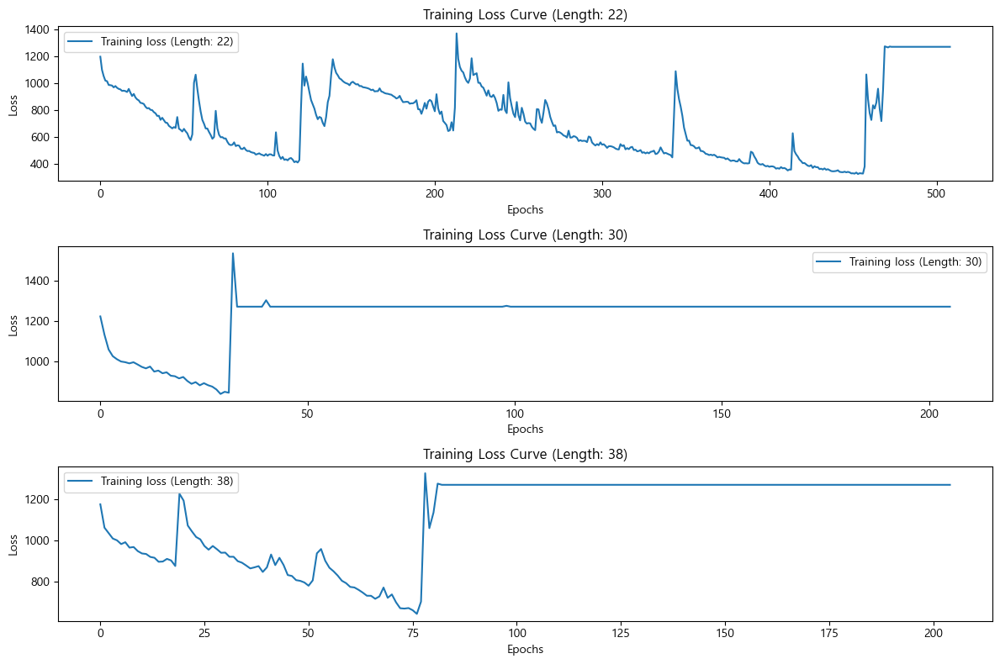

In [426]:
plt.figure(figsize=(12, 8))
seed_everything_tf(config.seed)

for idx, past_length in enumerate(past_lengths, 1):
    # model 정의

    model_name = f"model_hk1_lstm_{past_length}"
    input_shape_var = f"trainX_hk1_{past_length}"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(1, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_hk1_lstm_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_hk1_{past_length}"],
                                                        globals()[f"trainY_hk1_{past_length}"],
                                                        validation_data=(globals()[f"validX_hk1_{past_length}"],
                                                                        globals()[f"validY_hk1_{past_length}"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


In [432]:
prediction_hk1hk_22 = model_hk1_lstm_22.predict(testX_hk1_22) 
for _ in zip(prediction_hk1_22,testY_hk1_22):
    print(_)

91/91 [==============================] - 1s 4ms/step
(array([1096.9437], dtype=float32), array([[489.1555556]]))
(array([761.9144], dtype=float32), array([[307.5888889]]))
(array([607.36316], dtype=float32), array([[279.3888889]]))
(array([967.6914], dtype=float32), array([[1166.844444]]))
(array([1211.52], dtype=float32), array([[741.9055556]]))
(array([1388.6127], dtype=float32), array([[662.1166667]]))
(array([1451.6027], dtype=float32), array([[1486.611111]]))
(array([1684.0502], dtype=float32), array([[1089.488889]]))
(array([1664.6813], dtype=float32), array([[651.7666667]]))
(array([1874.2338], dtype=float32), array([[320.9833333]]))
(array([2147.4387], dtype=float32), array([[1276.266667]]))
(array([1890.1283], dtype=float32), array([[1380.35]]))
(array([1838.0419], dtype=float32), array([[1811.633333]]))
(array([610.6554], dtype=float32), array([[525.2055556]]))
(array([0.], dtype=float32), array([[61.07777778]]))
(array([247.42249], dtype=float32), array([[424.3833333]]))
(ar

(array([2541.6743], dtype=float32), array([[1463.855556]]))
(array([1919.3007], dtype=float32), array([[1251.083333]]))
(array([1409.0878], dtype=float32), array([[704.7944444]]))
(array([1510.754], dtype=float32), array([[639.4666667]]))
(array([965.57904], dtype=float32), array([[807.2055556]]))
(array([673.1985], dtype=float32), array([[1225.133333]]))
(array([537.15234], dtype=float32), array([[1986.088889]]))
(array([564.4404], dtype=float32), array([[1409.461111]]))
(array([553.19244], dtype=float32), array([[1089.644444]]))
(array([583.7696], dtype=float32), array([[559.2388889]]))
(array([637.48816], dtype=float32), array([[480.5277778]]))
(array([672.516], dtype=float32), array([[86.92777778]]))
(array([565.59094], dtype=float32), array([[164.2777778]]))
(array([592.34656], dtype=float32), array([[156.2888889]]))
(array([631.8047], dtype=float32), array([[134.7833333]]))
(array([746.907], dtype=float32), array([[1101.016667]]))
(array([964.21545], dtype=float32), array([[1177.

(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[40.89444444]]))
(array([0.], dtype=float32), array([[45.47777778]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[3.57222222]]))
(array([0.], dtype=float32), array([[18.67222222]]))
(array([0.], dtype=float32), array([[20.75555556]]))
(array([0.], dtype=float32), array([[12.25555556]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[3.46666667]]))
(array([0.], dtype=float32), array([[55.37222222]]))
(array([0.], dtype=float32), array([[8.85]]))
(array([0.], dtype=float32), array([[1.81111111]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]

In [433]:
print(model_score_test(validY_hk1_22.reshape(-1,1),model_hk1_lstm_22.predict(validX_hk1_22)))

91/91 [==============================] - 0s 5ms/step
R2 score: 0.7611263017980655
MAE Loss:  436.8975178154668
(0.7611263017980655, 436.8975178154668)


R2 score: 0.5560821142432708
MAE Loss:  570.3737159861279
(0.5560821142432708, 570.3737159861279)


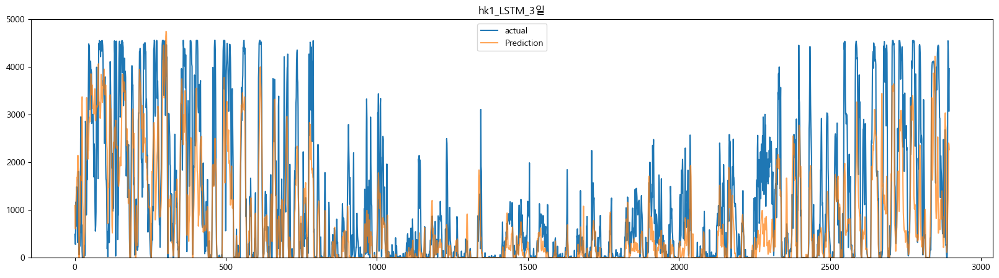

In [435]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_3일')
plt.plot(testY_hk1_22[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_22[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_22.reshape(-1,1),prediction_hk1_22))

In [436]:
prediction_hk1_30 = model_hk1_lstm_30.predict(testX_hk1_30) 
for _ in zip(prediction_hk1_30,testY_hk1_30):
    print(_)

91/91 [==============================] - 1s 6ms/step
(array([1569.1475], dtype=float32), array([[651.7666667]]))
(array([1732.9742], dtype=float32), array([[320.9833333]]))
(array([1950.3904], dtype=float32), array([[1276.266667]]))
(array([2248.4585], dtype=float32), array([[1380.35]]))
(array([2386.8042], dtype=float32), array([[1811.633333]]))
(array([2436.0159], dtype=float32), array([[525.2055556]]))
(array([2499.446], dtype=float32), array([[61.07777778]]))
(array([2470.6094], dtype=float32), array([[424.3833333]]))
(array([2366.0503], dtype=float32), array([[285.8166667]]))
(array([2434.249], dtype=float32), array([[241.95]]))
(array([2309.3052], dtype=float32), array([[396.9055556]]))
(array([2363.1519], dtype=float32), array([[2501.316667]]))
(array([2680.5664], dtype=float32), array([[2956.338889]]))
(array([2972.103], dtype=float32), array([[1561.238889]]))
(array([3207.8691], dtype=float32), array([[522.9055556]]))
(array([3433.2231], dtype=float32), array([[687.0166667]]))

(array([272.1013], dtype=float32), array([[13.58888889]]))
(array([250.89055], dtype=float32), array([[476.1722222]]))
(array([205.82472], dtype=float32), array([[506.3388889]]))
(array([173.47473], dtype=float32), array([[265.4555556]]))
(array([144.93164], dtype=float32), array([[156.2666667]]))
(array([146.8301], dtype=float32), array([[247.4277778]]))
(array([154.70096], dtype=float32), array([[129.1611111]]))
(array([166.06166], dtype=float32), array([[412.6611111]]))
(array([176.86502], dtype=float32), array([[45.98333333]]))
(array([177.23643], dtype=float32), array([[142.1277778]]))
(array([169.63399], dtype=float32), array([[362.2222222]]))
(array([160.61937], dtype=float32), array([[327.45]]))
(array([158.45497], dtype=float32), array([[64.41666667]]))
(array([163.07721], dtype=float32), array([[622.2055556]]))
(array([170.09108], dtype=float32), array([[389.3277778]]))
(array([175.64264], dtype=float32), array([[46.68333333]]))
(array([182.5862], dtype=float32), array([[17.4

(array([249.5809], dtype=float32), array([[639.7944444]]))
(array([255.44038], dtype=float32), array([[184.2722222]]))
(array([258.39563], dtype=float32), array([[19.21666667]]))
(array([260.3782], dtype=float32), array([[81.13333333]]))
(array([259.35587], dtype=float32), array([[99.4]]))
(array([257.4382], dtype=float32), array([[885.0111111]]))
(array([256.48743], dtype=float32), array([[1128.755556]]))
(array([257.80963], dtype=float32), array([[1303.511111]]))
(array([260.8122], dtype=float32), array([[981.3277778]]))
(array([264.6901], dtype=float32), array([[899.1944444]]))
(array([268.91016], dtype=float32), array([[699.7388889]]))
(array([271.36777], dtype=float32), array([[261.3277778]]))
(array([269.68698], dtype=float32), array([[157.6333333]]))
(array([265.3836], dtype=float32), array([[47.43333333]]))
(array([263.10822], dtype=float32), array([[20.12222222]]))
(array([262.00757], dtype=float32), array([[0.]]))
(array([262.70377], dtype=float32), array([[0.]]))
(array([262

(array([2746.5308], dtype=float32), array([[3520.127778]]))
(array([2539.0608], dtype=float32), array([[4014.566667]]))
(array([2325.8462], dtype=float32), array([[4296.6]]))
(array([2054.087], dtype=float32), array([[4425.177778]]))
(array([1869.7119], dtype=float32), array([[4451.827778]]))
(array([1619.4513], dtype=float32), array([[4456.5]]))
(array([1300.4894], dtype=float32), array([[4422.127778]]))
(array([1108.6521], dtype=float32), array([[3773.422222]]))
(array([1079.4995], dtype=float32), array([[3509.466667]]))
(array([1086.2323], dtype=float32), array([[2935.533333]]))
(array([1125.0491], dtype=float32), array([[2925.494444]]))
(array([1132.666], dtype=float32), array([[1618.55]]))
(array([1084.6018], dtype=float32), array([[1260.133333]]))
(array([1066.8949], dtype=float32), array([[2139.744444]]))
(array([1193.2339], dtype=float32), array([[1879.844444]]))
(array([1291.683], dtype=float32), array([[1757.861111]]))
(array([1492.6302], dtype=float32), array([[1584.4]]))
(a

In [437]:
print(model_score_test(validY_hk1_30.reshape(-1,1),model_hk1_lstm_30.predict(validX_hk1_30)))

91/91 [==============================] - 1s 6ms/step
R2 score: 0.06807426535363748
MAE Loss:  973.4755459787675
(0.06807426535363748, 973.4755459787675)


R2 score: 0.20667736338620601
MAE Loss:  853.1299711705977
(0.20667736338620601, 853.1299711705977)


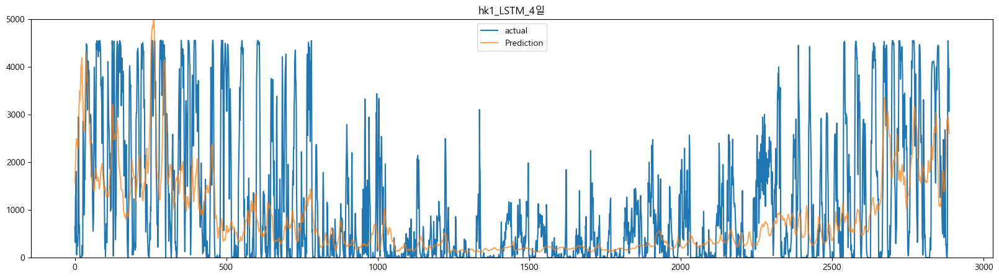

In [438]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_4일')
plt.plot(testY_hk1_30[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_30[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_30.reshape(-1,1),prediction_hk1_30))

In [95]:
prediction_hk1_38 = model_hk1_lstm_38.predict(testX_hk1_38) 
for _ in zip(prediction_hk1_38,testY_hk1_38):
    print(_)

91/91 [==============================] - 1s 6ms/step
(array([0.], dtype=float32), array([[285.8166667]]))
(array([0.], dtype=float32), array([[241.95]]))
(array([0.], dtype=float32), array([[396.9055556]]))
(array([0.], dtype=float32), array([[2501.316667]]))
(array([0.], dtype=float32), array([[2956.338889]]))
(array([0.], dtype=float32), array([[1561.238889]]))
(array([0.], dtype=float32), array([[522.9055556]]))
(array([0.], dtype=float32), array([[687.0166667]]))
(array([0.], dtype=float32), array([[131.5166667]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[18.47222222]]))
(array([0.], dtype=float32), array([[9.17777778]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[85.06666667]]))
(array([0.], dtype=float32), array([[261.7944444]]))
(array([0.], dtype=float32), array([[40.23888889]]))
(array([0.], dtype=float32), array(

(array([0.], dtype=float32), array([[43.53333333]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[86.41666667]]))
(array([0.], dtype=float32), array([[159.]]))
(array([0.], dtype=float32), array([[546.5222222]]))
(array([0.], dtype=float32), array([[74.77222222]]))
(array([0.], dtype=float32), array([[26.43888889]]))
(array([0.], dtype=float32), array([[126.9888889]]))
(array([0.], dtype=float32), array([[380.7222222]]))
(array([0.], dtype=float32), array([[123.5888889]]))
(array([0.], dtype=float32), array([[349.8222222]]))
(array([0.], dtype=float32), array([[16.28333333]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[1314.155556]]))
(array([0.], dtype=float32), array([[2074.811111]]))
(array([0.], dtype=float32), array([[1963.344444]]))
(array([0.], dtype=float32), array([[2144.683333]]))
(array([0.], dtype=float32), array([[1771.827778]]))
(array([0.], dtype=float32), array([[1030.977778]]))
(array([0.], dtype

(array([0.], dtype=float32), array([[547.2777778]]))
(array([0.], dtype=float32), array([[231.7444444]]))
(array([0.], dtype=float32), array([[21.57777778]]))
(array([0.], dtype=float32), array([[123.7722222]]))
(array([0.], dtype=float32), array([[8.81111111]]))
(array([0.], dtype=float32), array([[925.8388889]]))
(array([0.], dtype=float32), array([[377.8055556]]))
(array([0.], dtype=float32), array([[155.3277778]]))
(array([0.], dtype=float32), array([[19.65555556]]))
(array([0.], dtype=float32), array([[2942.3]]))
(array([0.], dtype=float32), array([[4511.216667]]))
(array([0.], dtype=float32), array([[4364.105556]]))
(array([0.], dtype=float32), array([[4539.522222]]))
(array([0.], dtype=float32), array([[4532.772222]]))
(array([0.], dtype=float32), array([[3329.705556]]))
(array([0.], dtype=float32), array([[3023.405556]]))
(array([0.], dtype=float32), array([[3035.644444]]))
(array([0.], dtype=float32), array([[2804.961111]]))
(array([0.], dtype=float32), array([[3010.711111]]))

In [439]:
print(model_score_test(validY_hk1_38.reshape(-1,1),model_hk1_lstm_38.predict(validX_hk1_38)))

91/91 [==============================] - 1s 7ms/step
R2 score: 0.06597582993441564
MAE Loss:  986.1697141295527
(0.06597582993441564, 986.1697141295527)


R2 score: -0.6407703710396051
MAE Loss:  1117.4145609142358
(-0.6407703710396051, 1117.4145609142358)


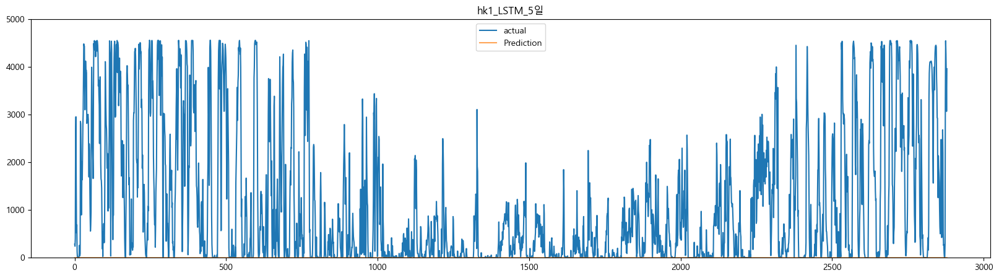

In [441]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_5일')
plt.plot(testY_hk1_38[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_38[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_38.reshape(-1,1),prediction_hk1_38))

# 3일

In [1516]:

seed_everything_tf(config.seed)
model_hk1_lstm = Sequential()
model_hk1_lstm.add(LSTM(64, activation='relu', input_shape=(trainX_hk1.shape[1], trainX_hk1.shape[2]),return_sequences=True))
                          #return_sequences=True))
model_hk1_lstm.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_hk1_lstm.add(Dropout(0.2))
model_hk1_lstm.add(Flatten())
model_hk1_lstm.add(Dense(trainY_hk1.shape[1], activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))

model_hk1_lstm.compile(optimizer='adam', loss='mae')

Epoch 1/1000
29/29 [==============================] - 3s 37ms/step - loss: 1255.3276 - val_loss: 1119.1569
Epoch 2/1000
29/29 [==============================] - 1s 25ms/step - loss: 1132.7998 - val_loss: 1054.7346
Epoch 3/1000
29/29 [==============================] - 1s 25ms/step - loss: 1076.0184 - val_loss: 1039.3032
Epoch 4/1000
29/29 [==============================] - 1s 25ms/step - loss: 1056.3357 - val_loss: 1029.6016
Epoch 5/1000
29/29 [==============================] - 1s 25ms/step - loss: 1028.4464 - val_loss: 1002.6232
Epoch 6/1000
29/29 [==============================] - 1s 29ms/step - loss: 1007.8386 - val_loss: 1020.1854
Epoch 7/1000
29/29 [==============================] - 1s 31ms/step - loss: 1020.7137 - val_loss: 1018.1414
Epoch 8/1000
29/29 [==============================] - 1s 34ms/step - loss: 1022.9556 - val_loss: 992.5731
Epoch 9/1000
29/29 [==============================] - 1s 28ms/step - loss: 993.8328 - val_loss: 986.9988
Epoch 10/1000
29/29 [===================

29/29 [==============================] - 1s 27ms/step - loss: 2208.2781 - val_loss: 1112.8348
Epoch 155/1000
29/29 [==============================] - 1s 27ms/step - loss: 1164.1686 - val_loss: 1122.4926
Epoch 156/1000
29/29 [==============================] - 1s 27ms/step - loss: 1151.3479 - val_loss: 1036.5133
Epoch 157/1000
29/29 [==============================] - 1s 27ms/step - loss: 1067.1730 - val_loss: 1024.1108
Epoch 158/1000
29/29 [==============================] - 1s 27ms/step - loss: 1045.4989 - val_loss: 1022.6729
Epoch 159/1000
29/29 [==============================] - 1s 27ms/step - loss: 1040.4075 - val_loss: 1023.3589
Epoch 160/1000
29/29 [==============================] - 1s 27ms/step - loss: 1036.1418 - val_loss: 1013.1609
Epoch 161/1000
29/29 [==============================] - 1s 27ms/step - loss: 1033.5072 - val_loss: 1019.9360
Epoch 162/1000
29/29 [==============================] - 1s 27ms/step - loss: 1029.5537 - val_loss: 1024.4803
Epoch 163/1000
29/29 [============

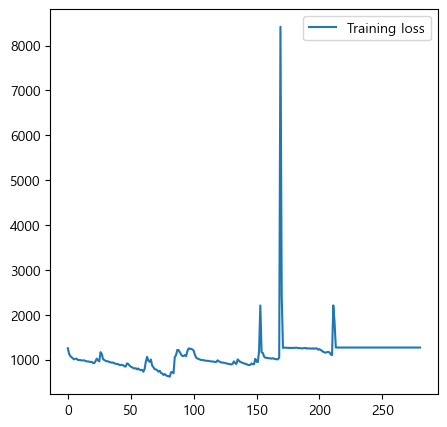

In [1517]:

history_hk1_lstm = model_hk1_lstm.fit(trainX_hk1, trainY_hk1,validation_data = (validX_hk1,validY_hk1) ,epochs=1000, batch_size=200,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk1_lstm.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [1518]:
prediction_hk1 = model_hk1_lstm.predict(testX_hk1) 
for _ in zip(prediction_hk1,testY_hk1):
    print(_)

91/91 [==============================] - 1s 4ms/step
(array([1713.81], dtype=float32), array([[489.1555556]]))
(array([1373.6085], dtype=float32), array([[307.5888889]]))
(array([1372.5035], dtype=float32), array([[279.3888889]]))
(array([1995.4617], dtype=float32), array([[1166.844444]]))
(array([2245.4656], dtype=float32), array([[741.9055556]]))
(array([2179.216], dtype=float32), array([[662.1166667]]))
(array([2334.6077], dtype=float32), array([[1486.611111]]))
(array([2549.4683], dtype=float32), array([[1089.488889]]))
(array([2364.0564], dtype=float32), array([[651.7666667]]))
(array([2727.3926], dtype=float32), array([[320.9833333]]))
(array([2588.7917], dtype=float32), array([[1276.266667]]))
(array([2211.702], dtype=float32), array([[1380.35]]))
(array([2230.5925], dtype=float32), array([[1811.633333]]))
(array([1706.9774], dtype=float32), array([[525.2055556]]))
(array([873.1839], dtype=float32), array([[61.07777778]]))
(array([0.], dtype=float32), array([[424.3833333]]))
(ar

(array([1557.1799], dtype=float32), array([[892.2166667]]))
(array([1297.1637], dtype=float32), array([[243.5888889]]))
(array([1094.9232], dtype=float32), array([[980.6222222]]))
(array([1125.7925], dtype=float32), array([[1642.111111]]))
(array([1223.3267], dtype=float32), array([[728.7222222]]))
(array([1211.6624], dtype=float32), array([[177.1277778]]))
(array([364.38293], dtype=float32), array([[34.05555556]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[298.3]]))
(array([46.179573], dtype=float32), array([[352.6722222]]))
(array([596.9292], dtype=float32), array([[87.52777778]]))
(array([892.571], dtype=float32), array([[16.8]]))
(array([0.], dtype=float32), array([[6.32777778]]))
(array([0.], dtype=float32), array([[62.47222222]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[64.68888889]]))
(array([0.], dtype=float32), 

(array([1026.8046], dtype=float32), array([[1437.172222]]))
(array([1145.7285], dtype=float32), array([[327.7111111]]))
(array([666.55835], dtype=float32), array([[71.82777778]]))
(array([485.518], dtype=float32), array([[667.2388889]]))
(array([239.6749], dtype=float32), array([[93.13333333]]))
(array([596.1898], dtype=float32), array([[2518.777778]]))
(array([1246.3354], dtype=float32), array([[3329.516667]]))
(array([1263.5226], dtype=float32), array([[2910.094444]]))
(array([1009.68396], dtype=float32), array([[579.2555556]]))
(array([750.4397], dtype=float32), array([[109.2388889]]))
(array([591.05536], dtype=float32), array([[554.7055556]]))
(array([656.1376], dtype=float32), array([[1485.]]))
(array([518.2728], dtype=float32), array([[60.41111111]]))
(array([685.7064], dtype=float32), array([[1069.311111]]))
(array([959.60596], dtype=float32), array([[1628.066667]]))
(array([1192.6432], dtype=float32), array([[697.75]]))
(array([640.26556], dtype=float32), array([[75.91666667]])

(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([28.94661], dtype=float32), array([[3.56666667]]))
(array([181.4902], dtype=float32), array([[153.6111111]]))
(array([300.33936], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[1.61666667]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[1.04444444]]))
(array([0.], dtype=float32), array([[2.24444444]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[461.0666667]]))
(array([590.1312], dtype=float32), array([[388.5833333]]))
(array([1110.4995], dtype=float32), array([[604.5555556]]))
(array([1259.157], d

(array([263.7571], dtype=float32), array([[0.]]))
(array([226.37985], dtype=float32), array([[0.]]))
(array([262.61182], dtype=float32), array([[0.]]))
(array([291.1305], dtype=float32), array([[0.]]))
(array([286.6795], dtype=float32), array([[0.]]))
(array([282.5196], dtype=float32), array([[0.]]))
(array([331.2531], dtype=float32), array([[0.]]))
(array([361.20984], dtype=float32), array([[0.]]))
(array([363.54816], dtype=float32), array([[0.]]))
(array([329.43942], dtype=float32), array([[0.]]))
(array([261.39868], dtype=float32), array([[0.]]))
(array([307.42242], dtype=float32), array([[39.61666667]]))
(array([550.58923], dtype=float32), array([[323.0166667]]))
(array([542.50916], dtype=float32), array([[4.97777778]]))
(array([356.13635], dtype=float32), array([[7.53333333]]))
(array([91.1104], dtype=float32), array([[0.]]))
(array([65.1185], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[1.03888889]]))
(array([0.], dtype=float32), array([[18.48888889]]))
(ar

(array([2159.7668], dtype=float32), array([[1398.683333]]))
(array([2276.6194], dtype=float32), array([[2171.022222]]))
(array([2314.3977], dtype=float32), array([[1534.666667]]))
(array([2521.4104], dtype=float32), array([[2374.922222]]))
(array([2579.7256], dtype=float32), array([[3465.983333]]))
(array([1690.3284], dtype=float32), array([[3325.666667]]))
(array([1612.7103], dtype=float32), array([[3864.183333]]))
(array([1560.8948], dtype=float32), array([[3378.683333]]))
(array([1480.507], dtype=float32), array([[4002.188889]]))
(array([1463.2109], dtype=float32), array([[3538.361111]]))
(array([1518.9108], dtype=float32), array([[2668.744444]]))
(array([1539.3064], dtype=float32), array([[1452.5]]))
(array([1539.7406], dtype=float32), array([[3068.983333]]))
(array([1604.6735], dtype=float32), array([[3570.861111]]))
(array([1741.7382], dtype=float32), array([[1574.894444]]))
(array([1766.8896], dtype=float32), array([[110.9833333]]))
(array([1658.318], dtype=float32), array([[22.

(array([4430.3774], dtype=float32), array([[4124.422222]]))
(array([5022.991], dtype=float32), array([[4099.983333]]))
(array([5003.972], dtype=float32), array([[4053.055556]]))
(array([4837.5044], dtype=float32), array([[3940.494444]]))
(array([4386.0386], dtype=float32), array([[3548.766667]]))
(array([4748.608], dtype=float32), array([[3429.477778]]))
(array([4240.518], dtype=float32), array([[2076.772222]]))
(array([3516.8354], dtype=float32), array([[1566.744444]]))
(array([3029.5127], dtype=float32), array([[3170.038889]]))
(array([2975.89], dtype=float32), array([[3812.788889]]))
(array([3070.2395], dtype=float32), array([[3998.216667]]))
(array([3073.0696], dtype=float32), array([[3520.127778]]))
(array([2804.7917], dtype=float32), array([[4014.566667]]))
(array([2620.5505], dtype=float32), array([[4296.6]]))
(array([1909.1956], dtype=float32), array([[4425.177778]]))
(array([1575.6201], dtype=float32), array([[4451.827778]]))
(array([1426.9019], dtype=float32), array([[4456.5]

In [1519]:
print(model_score_test(validY_hk1.reshape(-1,1),model_hk1_lstm.predict(validX_hk1)))

91/91 [==============================] - 0s 4ms/step
R2 score: 0.5653279708579715
MAE Loss:  585.2505253947552
(0.5653279708579715, 585.2505253947552)


R2 score: 0.6380971472394897
MAE Loss:  536.4536709136646
(0.6380971472394897, 536.4536709136646)


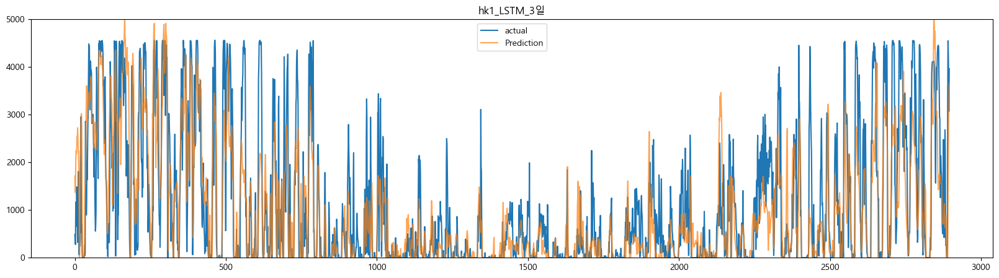

In [1520]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_3일')
plt.plot(testY_hk1[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1.reshape(-1,1),prediction_hk1))

In [681]:
time_lag_plt = [] 

In [688]:
time_lag_plt.append(model_score_test(testY_hk1_22.reshape(-1,1),prediction_hk1_22)[1])

R2 score: 0.5560821142432708
MAE Loss:  570.3737159861279


Epoch 1/1000
29/29 [==============================] - 3s 40ms/step - loss: 1255.3276 - val_loss: 1119.1569
Epoch 2/1000
29/29 [==============================] - 1s 29ms/step - loss: 1132.7998 - val_loss: 1054.7346
Epoch 3/1000
29/29 [==============================] - 1s 25ms/step - loss: 1076.0184 - val_loss: 1039.3032
Epoch 4/1000
29/29 [==============================] - 1s 24ms/step - loss: 1056.3357 - val_loss: 1029.6016
Epoch 5/1000
29/29 [==============================] - 1s 24ms/step - loss: 1028.4464 - val_loss: 1002.6232
Epoch 6/1000
29/29 [==============================] - 1s 24ms/step - loss: 1007.8386 - val_loss: 1020.1854
Epoch 7/1000
29/29 [==============================] - 1s 24ms/step - loss: 1020.7137 - val_loss: 1018.1414
Epoch 8/1000
29/29 [==============================] - 1s 24ms/step - loss: 1022.9556 - val_loss: 992.5731
Epoch 9/1000
29/29 [==============================] - 1s 23ms/step - loss: 993.8328 - val_loss: 986.9988
Epoch 10/1000
29/29 [===================

29/29 [==============================] - 1s 27ms/step - loss: 2208.2781 - val_loss: 1112.8348
Epoch 155/1000
29/29 [==============================] - 1s 27ms/step - loss: 1164.1686 - val_loss: 1122.4926
Epoch 156/1000
29/29 [==============================] - 1s 27ms/step - loss: 1151.3479 - val_loss: 1036.5133
Epoch 157/1000
29/29 [==============================] - 1s 27ms/step - loss: 1067.1730 - val_loss: 1024.1108
Epoch 158/1000
29/29 [==============================] - 1s 27ms/step - loss: 1045.4989 - val_loss: 1022.6729
Epoch 159/1000
29/29 [==============================] - 1s 27ms/step - loss: 1040.4075 - val_loss: 1023.3589
Epoch 160/1000
29/29 [==============================] - 1s 26ms/step - loss: 1036.1418 - val_loss: 1013.1609
Epoch 161/1000
29/29 [==============================] - 1s 27ms/step - loss: 1033.5072 - val_loss: 1019.9360
Epoch 162/1000
29/29 [==============================] - 1s 27ms/step - loss: 1029.5537 - val_loss: 1024.4803
Epoch 163/1000
29/29 [============

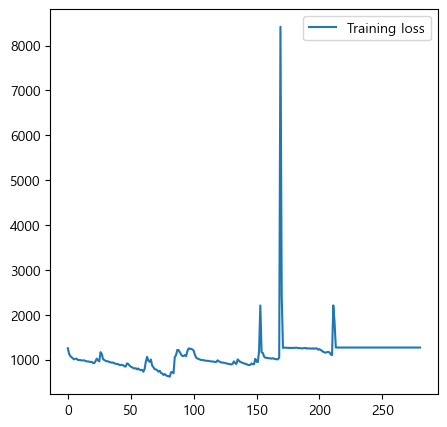

In [1488]:

history_hk1_lstm_22 = model_hk1_lstm_22.fit(trainX_hk1_22, trainY_hk1_22,validation_data = (validX_hk1_22,validY_hk1_22) ,epochs=1000, batch_size=200,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk1_lstm_22.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [1489]:
prediction_hk1_22 = model_hk1_lstm_22.predict(testX_hk1_22) 
for _ in zip(prediction_hk1_22,testY_hk1_22):
    print(_)

91/91 [==============================] - 1s 4ms/step
(array([1713.81], dtype=float32), array([[489.1555556]]))
(array([1373.6085], dtype=float32), array([[307.5888889]]))
(array([1372.5035], dtype=float32), array([[279.3888889]]))
(array([1995.4617], dtype=float32), array([[1166.844444]]))
(array([2245.4656], dtype=float32), array([[741.9055556]]))
(array([2179.216], dtype=float32), array([[662.1166667]]))
(array([2334.6077], dtype=float32), array([[1486.611111]]))
(array([2549.4683], dtype=float32), array([[1089.488889]]))
(array([2364.0564], dtype=float32), array([[651.7666667]]))
(array([2727.3926], dtype=float32), array([[320.9833333]]))
(array([2588.7917], dtype=float32), array([[1276.266667]]))
(array([2211.702], dtype=float32), array([[1380.35]]))
(array([2230.5925], dtype=float32), array([[1811.633333]]))
(array([1706.9774], dtype=float32), array([[525.2055556]]))
(array([873.1839], dtype=float32), array([[61.07777778]]))
(array([0.], dtype=float32), array([[424.3833333]]))
(ar

(array([2427.017], dtype=float32), array([[4222.1]]))
(array([2103.6252], dtype=float32), array([[2477.855556]]))
(array([2243.448], dtype=float32), array([[567.2388889]]))
(array([2024.1907], dtype=float32), array([[583.8277778]]))
(array([2440.4958], dtype=float32), array([[3826.05]]))
(array([2613.6816], dtype=float32), array([[4041.65]]))
(array([2766.3782], dtype=float32), array([[4170.105556]]))
(array([2939.716], dtype=float32), array([[4498.127778]]))
(array([3459.5205], dtype=float32), array([[4479.722222]]))
(array([3724.3079], dtype=float32), array([[4360.827778]]))
(array([3808.985], dtype=float32), array([[3905.638889]]))
(array([3955.7107], dtype=float32), array([[3475.85]]))
(array([4207.808], dtype=float32), array([[3071.433333]]))
(array([2661.9773], dtype=float32), array([[3076.738889]]))
(array([2388.594], dtype=float32), array([[3821.95]]))
(array([2328.5845], dtype=float32), array([[4179.233333]]))
(array([2480.629], dtype=float32), array([[4478.333333]]))
(array([

(array([735.90735], dtype=float32), array([[834.15]]))
(array([1251.3867], dtype=float32), array([[584.2277778]]))
(array([1074.843], dtype=float32), array([[20.19444444]]))
(array([124.02167], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[2.37222222]]))
(array([0.], dtype=float32), array([[128.6666667]]))
(array([27.623161], dtype=float32), array([[71.38888889]]))
(array([0.], dtype=float32), array([[0.76666667]]))
(array([0.], dtype=float32), array([[2.12222222]]))
(array([0.], dtype=float32), array([[14.91666667]]))
(array([0.], dtype=float32), array([[56.88333333]]))
(array([0.], dtype=float32), array([[19.22222222]]))
(array([0.], dtype=float32), array([[37.69444444]]))
(array([0.], dtype=float32), array([[34.66111111]]))
(array([0.], dtype=float32), array([[18.28333333]]))
(array([0.], dtype=float32), array([[28.68333333]]))
(array([65.76524], dtype=float32), array([[274.8611111]]))
(array([309.40735], dtype=float32), array([[85.7]]))
(array([164.83864], dty

(array([11.983626], dtype=float32), array([[20.12222222]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.91111111]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[36.77222222]]))
(array([0.], dtype=float32), array([[426.1444444]]))
(array([65.22288], dtype=float32), array([[313.0388889]]))
(array([215.84192], dtype=float32), array([[220.6666667]]))
(array([0.], dtype=float32), array([[22.35]]))
(array([0.], dtype=float32), array([[133.4]]))
(array([0.], dtype=float32), array([[319.2388889]]))
(array([208.35167], dtype=float32), array([[240.95]]))
(array([359.83447], dtype=float32), array([[91.97222222]]))
(array([455.77026], dtype=float32), array([[128.4444444]]))
(array([1447.769], dtype=float32), array([[122.3222222]]))
(array([1974.0383], dtype=float32), array([[582.0055556]]))
(array([2438.1973], dtype=float32), array([[15

(array([948.9958], dtype=float32), array([[2249.644444]]))
(array([1083.7803], dtype=float32), array([[3007.816667]]))
(array([1171.4755], dtype=float32), array([[1935.261111]]))
(array([1160.6833], dtype=float32), array([[2785.088889]]))
(array([1110.2178], dtype=float32), array([[1078.833333]]))
(array([1064.0063], dtype=float32), array([[1750.333333]]))
(array([1066.3624], dtype=float32), array([[1595.961111]]))
(array([1047.5205], dtype=float32), array([[2202.538889]]))
(array([1001.4947], dtype=float32), array([[1829.572222]]))
(array([985.8618], dtype=float32), array([[2066.061111]]))
(array([878.01465], dtype=float32), array([[1996.361111]]))
(array([549.1875], dtype=float32), array([[1548.816667]]))
(array([154.65022], dtype=float32), array([[2071.583333]]))
(array([347.85748], dtype=float32), array([[2008.733333]]))
(array([529.94055], dtype=float32), array([[1692.733333]]))
(array([967.51245], dtype=float32), array([[2253.305556]]))
(array([777.2569], dtype=float32), array([[

(array([1560.9634], dtype=float32), array([[2487.822222]]))
(array([942.33636], dtype=float32), array([[1505.827778]]))
(array([854.7245], dtype=float32), array([[455.2111111]]))
(array([942.3605], dtype=float32), array([[364.0222222]]))
(array([572.05634], dtype=float32), array([[59.06111111]]))
(array([124.50623], dtype=float32), array([[255.8722222]]))
(array([261.56885], dtype=float32), array([[3316.283333]]))
(array([460.20676], dtype=float32), array([[2392.516667]]))
(array([688.2196], dtype=float32), array([[1764.361111]]))
(array([780.9581], dtype=float32), array([[989.6]]))
(array([1198.8855], dtype=float32), array([[405.6944444]]))
(array([1548.0657], dtype=float32), array([[482.9888889]]))
(array([1450.9869], dtype=float32), array([[192.9388889]]))
(array([1395.8132], dtype=float32), array([[81.29444444]]))
(array([235.32437], dtype=float32), array([[0.18333333]]))
(array([0.], dtype=float32), array([[0.53333333]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dt

In [1490]:
print(model_score_test(validY_hk1_22.reshape(-1,1),model_hk1_lstm_22.predict(validX_hk1_22)))

91/91 [==============================] - 0s 4ms/step
R2 score: 0.5653279708579715
MAE Loss:  585.2505253947552
(0.5653279708579715, 585.2505253947552)


R2 score: 0.6380971472394897
MAE Loss:  536.4536709136646
(0.6380971472394897, 536.4536709136646)


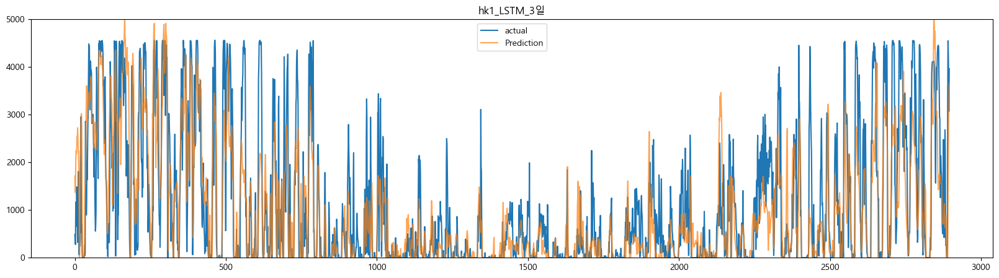

In [1491]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_3일')
plt.plot(testY_hk1_22[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_22[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_22.reshape(-1,1),prediction_hk1_22))

# 4일

Epoch 1/1000
29/29 [==============================] - 3s 42ms/step - loss: 1247.5969 - val_loss: 1143.3698
Epoch 2/1000
29/29 [==============================] - 1s 30ms/step - loss: 1213.0524 - val_loss: 1131.2263
Epoch 3/1000
29/29 [==============================] - 1s 31ms/step - loss: 1188.7216 - val_loss: 1181.8037
Epoch 4/1000
29/29 [==============================] - 1s 34ms/step - loss: 1263.9464 - val_loss: 1200.6044
Epoch 5/1000
29/29 [==============================] - 1s 33ms/step - loss: 1270.8193 - val_loss: 1200.6044
Epoch 6/1000
29/29 [==============================] - 1s 31ms/step - loss: 1270.6237 - val_loss: 1200.6044
Epoch 7/1000
29/29 [==============================] - 1s 31ms/step - loss: 1270.6055 - val_loss: 1200.6044
Epoch 8/1000
29/29 [==============================] - 1s 31ms/step - loss: 1270.6196 - val_loss: 1200.6044
Epoch 9/1000
29/29 [==============================] - 1s 32ms/step - loss: 1270.5387 - val_loss: 1200.6044
Epoch 10/1000
29/29 [================

29/29 [==============================] - 1s 35ms/step - loss: 727.8196 - val_loss: 1116.4402
Epoch 154/1000
29/29 [==============================] - 1s 34ms/step - loss: 726.6337 - val_loss: 1159.9791
Epoch 155/1000
29/29 [==============================] - 1s 34ms/step - loss: 705.2029 - val_loss: 1204.5809
Epoch 156/1000
29/29 [==============================] - 1s 34ms/step - loss: 716.8260 - val_loss: 1200.2594
Epoch 157/1000
29/29 [==============================] - 1s 36ms/step - loss: 708.8549 - val_loss: 1136.9648
Epoch 158/1000
29/29 [==============================] - 1s 38ms/step - loss: 707.0436 - val_loss: 1228.4855
Epoch 159/1000
29/29 [==============================] - 1s 38ms/step - loss: 689.4483 - val_loss: 1280.5068
Epoch 160/1000
29/29 [==============================] - 1s 36ms/step - loss: 683.8815 - val_loss: 1240.7417
Epoch 161/1000
29/29 [==============================] - 1s 37ms/step - loss: 670.9653 - val_loss: 1181.6448
Epoch 162/1000
29/29 [=====================

Epoch 229/1000
29/29 [==============================] - 1s 36ms/step - loss: 459.1073 - val_loss: 1220.0099
Epoch 230/1000
29/29 [==============================] - 1s 36ms/step - loss: 464.0094 - val_loss: 1183.2896
Epoch 231/1000
29/29 [==============================] - 1s 36ms/step - loss: 449.0544 - val_loss: 1221.4749
Epoch 232/1000
29/29 [==============================] - 1s 36ms/step - loss: 491.4185 - val_loss: 1255.3490
Epoch 233/1000
29/29 [==============================] - 1s 37ms/step - loss: 453.0474 - val_loss: 1211.0522
Epoch 234/1000
29/29 [==============================] - 1s 37ms/step - loss: 430.3301 - val_loss: 1182.3029
Epoch 235/1000
29/29 [==============================] - 1s 36ms/step - loss: 439.5412 - val_loss: 1184.6217
Epoch 236/1000
29/29 [==============================] - 1s 37ms/step - loss: 466.1313 - val_loss: 1201.9056
Epoch 237/1000
29/29 [==============================] - 1s 36ms/step - loss: 442.1308 - val_loss: 1219.4492
Epoch 238/1000
29/29 [======

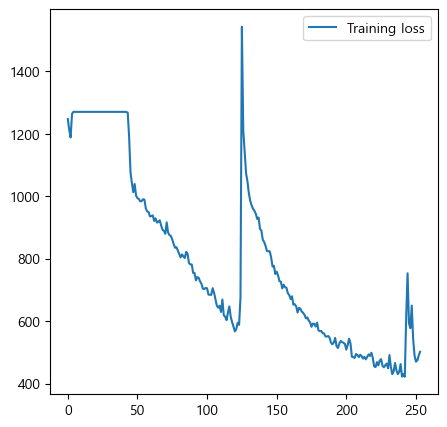

In [1478]:
history_hk1_lstm_30 = model_hk1_lstm_30.fit(trainX_hk1_30, trainY_hk1_30,validation_data = (validX_hk1_30,validY_hk1_30) ,epochs=1000, batch_size=200,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk1_lstm_30.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

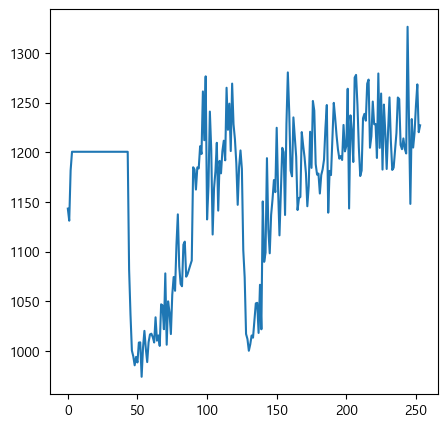

In [1479]:
plt.plot(history_hk1_lstm_30.history['val_loss'], label='Validation loss')


In [1480]:
prediction_hk1_30 = model_hk1_lstm_30.predict(testX_hk1_30) 
for _ in zip(prediction_hk1_30,testY_hk1_30):
    print(_)

91/91 [==============================] - 1s 4ms/step
(array([1402.0084], dtype=float32), array([[651.7666667]]))
(array([1629.125], dtype=float32), array([[320.9833333]]))
(array([1848.0698], dtype=float32), array([[1276.266667]]))
(array([2115.559], dtype=float32), array([[1380.35]]))
(array([2323.7583], dtype=float32), array([[1811.633333]]))
(array([2479.1057], dtype=float32), array([[525.2055556]]))
(array([2628.1626], dtype=float32), array([[61.07777778]]))
(array([2688.3027], dtype=float32), array([[424.3833333]]))
(array([2710.877], dtype=float32), array([[285.8166667]]))
(array([3012.5464], dtype=float32), array([[241.95]]))
(array([3108.5762], dtype=float32), array([[396.9055556]]))
(array([3034.9453], dtype=float32), array([[2501.316667]]))
(array([3163.7046], dtype=float32), array([[2956.338889]]))
(array([3464.462], dtype=float32), array([[1561.238889]]))
(array([3665.6182], dtype=float32), array([[522.9055556]]))
(array([3660.2659], dtype=float32), array([[687.0166667]]))


(array([1981.1312], dtype=float32), array([[3100.572222]]))
(array([1774.9607], dtype=float32), array([[3607.533333]]))
(array([1557.5568], dtype=float32), array([[3716.633333]]))
(array([1630.6621], dtype=float32), array([[2020.761111]]))
(array([1637.6218], dtype=float32), array([[1505.961111]]))
(array([1682.0793], dtype=float32), array([[1463.855556]]))
(array([1713.5579], dtype=float32), array([[1251.083333]]))
(array([1653.3586], dtype=float32), array([[704.7944444]]))
(array([1668.9055], dtype=float32), array([[639.4666667]]))
(array([1622.5079], dtype=float32), array([[807.2055556]]))
(array([1561.6412], dtype=float32), array([[1225.133333]]))
(array([1647.802], dtype=float32), array([[1986.088889]]))
(array([1591.5042], dtype=float32), array([[1409.461111]]))
(array([1678.6354], dtype=float32), array([[1089.644444]]))
(array([1634.9053], dtype=float32), array([[559.2388889]]))
(array([1422.3882], dtype=float32), array([[480.5277778]]))
(array([1340.3108], dtype=float32), array

(array([678.4065], dtype=float32), array([[56.88333333]]))
(array([740.7214], dtype=float32), array([[19.22222222]]))
(array([697.15875], dtype=float32), array([[37.69444444]]))
(array([601.6418], dtype=float32), array([[34.66111111]]))
(array([496.41458], dtype=float32), array([[18.28333333]]))
(array([526.7676], dtype=float32), array([[28.68333333]]))
(array([568.9534], dtype=float32), array([[274.8611111]]))
(array([548.32513], dtype=float32), array([[85.7]]))
(array([497.40967], dtype=float32), array([[4.40555556]]))
(array([427.83087], dtype=float32), array([[0.]]))
(array([382.68268], dtype=float32), array([[133.2555556]]))
(array([336.8061], dtype=float32), array([[94.11666667]]))
(array([308.5744], dtype=float32), array([[0.37222222]]))
(array([299.67065], dtype=float32), array([[0.]]))
(array([316.23944], dtype=float32), array([[0.]]))
(array([340.94623], dtype=float32), array([[2.43333333]]))
(array([340.7691], dtype=float32), array([[5.21111111]]))
(array([342.7371], dtype=f

(array([245.55962], dtype=float32), array([[274.6444444]]))
(array([250.05312], dtype=float32), array([[227.5833333]]))
(array([293.20947], dtype=float32), array([[122.8666667]]))
(array([309.17184], dtype=float32), array([[0.]]))
(array([323.9853], dtype=float32), array([[6.44444444]]))
(array([406.37335], dtype=float32), array([[337.8833333]]))
(array([410.63773], dtype=float32), array([[250.1333333]]))
(array([396.01434], dtype=float32), array([[149.2777778]]))
(array([389.46017], dtype=float32), array([[358.9333333]]))
(array([383.4939], dtype=float32), array([[334.4222222]]))
(array([389.9369], dtype=float32), array([[262.1833333]]))
(array([399.35522], dtype=float32), array([[543.8888889]]))
(array([378.44818], dtype=float32), array([[378.7833333]]))
(array([337.6828], dtype=float32), array([[431.4111111]]))
(array([314.74545], dtype=float32), array([[721.9722222]]))
(array([308.39893], dtype=float32), array([[593.5388889]]))
(array([275.1691], dtype=float32), array([[756.5055556

(array([359.974], dtype=float32), array([[764.15]]))
(array([376.1551], dtype=float32), array([[2302.25]]))
(array([412.3541], dtype=float32), array([[2583.355556]]))
(array([464.73358], dtype=float32), array([[2444.55]]))
(array([496.69952], dtype=float32), array([[2450.744444]]))
(array([531.9034], dtype=float32), array([[2429.561111]]))
(array([608.5369], dtype=float32), array([[794.8277778]]))
(array([590.4636], dtype=float32), array([[0.]]))
(array([552.79694], dtype=float32), array([[84.59444444]]))
(array([565.02704], dtype=float32), array([[32.01111111]]))
(array([577.75354], dtype=float32), array([[958.8333333]]))
(array([581.49786], dtype=float32), array([[1643.944444]]))
(array([548.3462], dtype=float32), array([[1909.722222]]))
(array([538.6682], dtype=float32), array([[1524.238889]]))
(array([518.7021], dtype=float32), array([[1539.538889]]))
(array([478.69604], dtype=float32), array([[2487.477778]]))
(array([432.85574], dtype=float32), array([[1700.977778]]))
(array([372.

(array([466.93585], dtype=float32), array([[874.0611111]]))
(array([458.41965], dtype=float32), array([[999.1833333]]))
(array([457.76495], dtype=float32), array([[388.1055556]]))
(array([446.95905], dtype=float32), array([[0.]]))
(array([434.65714], dtype=float32), array([[0.]]))
(array([422.11792], dtype=float32), array([[6.32222222]]))
(array([377.3015], dtype=float32), array([[0.]]))
(array([360.3386], dtype=float32), array([[0.]]))
(array([378.677], dtype=float32), array([[0.]]))
(array([369.09406], dtype=float32), array([[6.78333333]]))
(array([383.72577], dtype=float32), array([[1.2]]))
(array([451.7079], dtype=float32), array([[4.02222222]]))
(array([559.7769], dtype=float32), array([[1.32777778]]))
(array([675.6232], dtype=float32), array([[0.]]))
(array([648.15436], dtype=float32), array([[0.]]))
(array([679.78894], dtype=float32), array([[0.]]))
(array([726.64105], dtype=float32), array([[0.]]))
(array([772.8145], dtype=float32), array([[4.77222222]]))
(array([676.28314], dt

In [1481]:
print(model_score_test(validY_hk1_30.reshape(-1,1),model_hk1_lstm_30.predict(validX_hk1_30)))

91/91 [==============================] - 0s 5ms/step
R2 score: 0.04278958374319963
MAE Loss:  974.0661566679713
(0.04278958374319963, 974.0661566679713)


R2 score: 0.19568193230441655
MAE Loss:  865.7138091458378
(0.19568193230441655, 865.7138091458378)


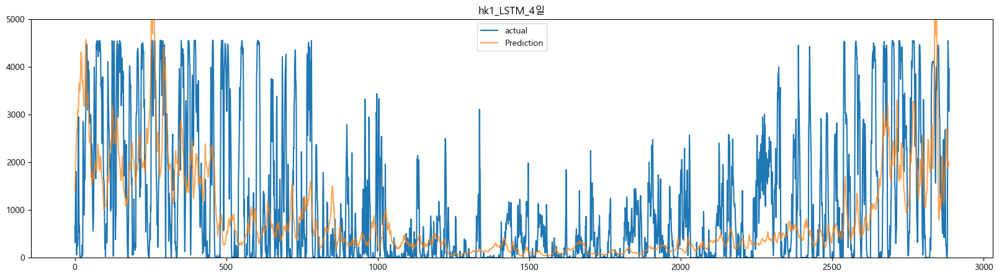

In [1482]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_4일')
plt.plot(testY_hk1_30[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_30[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_30.reshape(-1,1),prediction_hk1_30))

# 5일

Epoch 1/1000
29/29 [==============================] - 2s 47ms/step - loss: 1463.8467 - val_loss: 1024.2900
Epoch 2/1000
29/29 [==============================] - 1s 42ms/step - loss: 1062.3549 - val_loss: 1023.4179
Epoch 3/1000
29/29 [==============================] - 1s 43ms/step - loss: 1058.8110 - val_loss: 1022.3761
Epoch 4/1000
29/29 [==============================] - 1s 45ms/step - loss: 1055.8771 - val_loss: 1016.0212
Epoch 5/1000
29/29 [==============================] - 1s 44ms/step - loss: 1049.0052 - val_loss: 1016.2532
Epoch 6/1000
29/29 [==============================] - 1s 44ms/step - loss: 1040.6160 - val_loss: 1014.2079
Epoch 7/1000
29/29 [==============================] - 1s 43ms/step - loss: 1036.0646 - val_loss: 1008.4880
Epoch 8/1000
29/29 [==============================] - 1s 45ms/step - loss: 1022.8241 - val_loss: 1006.1318
Epoch 9/1000
29/29 [==============================] - 1s 44ms/step - loss: 1018.5542 - val_loss: 991.5930
Epoch 10/1000
29/29 [=================

29/29 [==============================] - 1s 44ms/step - loss: 779.8950 - val_loss: 1060.6479
Epoch 78/1000
29/29 [==============================] - 1s 44ms/step - loss: 770.5417 - val_loss: 1133.3500
Epoch 79/1000
29/29 [==============================] - 1s 43ms/step - loss: 784.5179 - val_loss: 1051.9844
Epoch 80/1000
29/29 [==============================] - 1s 43ms/step - loss: 768.5461 - val_loss: 1051.4071
Epoch 81/1000
29/29 [==============================] - 1s 49ms/step - loss: 770.2432 - val_loss: 1107.8207
Epoch 82/1000
29/29 [==============================] - 2s 60ms/step - loss: 759.4496 - val_loss: 1069.7662
Epoch 83/1000
29/29 [==============================] - 1s 45ms/step - loss: 812.0842 - val_loss: 1067.6503
Epoch 84/1000
29/29 [==============================] - 1s 43ms/step - loss: 804.9908 - val_loss: 1063.6259
Epoch 85/1000
29/29 [==============================] - 1s 49ms/step - loss: 759.0488 - val_loss: 1233.5479
Epoch 86/1000
29/29 [==============================

29/29 [==============================] - 1s 47ms/step - loss: 1226.0367 - val_loss: 1116.4198
Epoch 154/1000
29/29 [==============================] - 2s 69ms/step - loss: 1138.0295 - val_loss: 1059.1010
Epoch 155/1000
29/29 [==============================] - 1s 45ms/step - loss: 1066.0323 - val_loss: 1014.2753
Epoch 156/1000
29/29 [==============================] - 1s 46ms/step - loss: 1040.6705 - val_loss: 1015.1586
Epoch 157/1000
29/29 [==============================] - 1s 45ms/step - loss: 1029.1208 - val_loss: 1001.7264
Epoch 158/1000
29/29 [==============================] - 1s 45ms/step - loss: 1025.2365 - val_loss: 1004.8958
Epoch 159/1000
29/29 [==============================] - 1s 47ms/step - loss: 1027.1355 - val_loss: 997.0051
Epoch 160/1000
29/29 [==============================] - 1s 46ms/step - loss: 1009.5728 - val_loss: 1002.1046
Epoch 161/1000
29/29 [==============================] - 1s 46ms/step - loss: 1004.3978 - val_loss: 994.3638
Epoch 162/1000
29/29 [==============

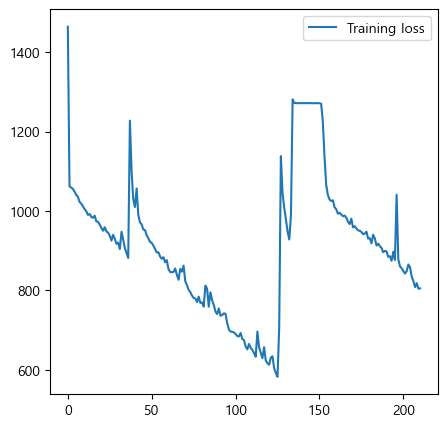

In [499]:
history_hk1_lstm_38 = model_hk1_lstm_38.fit(trainX_hk1_38, trainY_hk1_38,validation_data = (validX_hk1_38,validY_hk1_38) ,epochs=1000, batch_size=200,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk1_lstm_38.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [500]:
prediction_hk1_38 = model_hk1_lstm_38.predict(testX_hk1_38) 
for _ in zip(prediction_hk1_38,testY_hk1_38):
    print(_)

91/91 [==============================] - 1s 7ms/step
(array([1884.2178], dtype=float32), array([[285.8166667]]))
(array([1957.5823], dtype=float32), array([[241.95]]))
(array([2021.3002], dtype=float32), array([[396.9055556]]))
(array([2183.8674], dtype=float32), array([[2501.316667]]))
(array([2129.5422], dtype=float32), array([[2956.338889]]))
(array([2047.3196], dtype=float32), array([[1561.238889]]))
(array([1939.742], dtype=float32), array([[522.9055556]]))
(array([1790.8048], dtype=float32), array([[687.0166667]]))
(array([1643.4075], dtype=float32), array([[131.5166667]]))
(array([1657.2494], dtype=float32), array([[0.]]))
(array([1643.0958], dtype=float32), array([[0.]]))
(array([1697.7845], dtype=float32), array([[0.]]))
(array([1825.8906], dtype=float32), array([[18.47222222]]))
(array([1894.8557], dtype=float32), array([[9.17777778]]))
(array([1917.4386], dtype=float32), array([[0.]]))
(array([1951.54], dtype=float32), array([[85.06666667]]))
(array([1933.1553], dtype=float3

(array([1976.9304], dtype=float32), array([[34.05555556]]))
(array([1944.3625], dtype=float32), array([[0.]]))
(array([1954.6245], dtype=float32), array([[298.3]]))
(array([1941.5339], dtype=float32), array([[352.6722222]]))
(array([1756.9126], dtype=float32), array([[87.52777778]]))
(array([1527.1342], dtype=float32), array([[16.8]]))
(array([1355.649], dtype=float32), array([[6.32777778]]))
(array([1345.5576], dtype=float32), array([[62.47222222]]))
(array([1371.9015], dtype=float32), array([[0.]]))
(array([1443.4104], dtype=float32), array([[0.]]))
(array([1491.7979], dtype=float32), array([[0.]]))
(array([1523.2391], dtype=float32), array([[64.68888889]]))
(array([1517.2252], dtype=float32), array([[562.5833333]]))
(array([1446.4835], dtype=float32), array([[1557.766667]]))
(array([1382.783], dtype=float32), array([[1990.527778]]))
(array([1476.8346], dtype=float32), array([[3992.922222]]))
(array([1578.7324], dtype=float32), array([[3039.494444]]))
(array([1697.3721], dtype=float3

(array([41.16441], dtype=float32), array([[22.47222222]]))
(array([57.17742], dtype=float32), array([[0.]]))
(array([81.47176], dtype=float32), array([[0.]]))
(array([94.56276], dtype=float32), array([[0.]]))
(array([98.4573], dtype=float32), array([[0.]]))
(array([98.669685], dtype=float32), array([[0.13888889]]))
(array([85.12372], dtype=float32), array([[31.66111111]]))
(array([115.873474], dtype=float32), array([[5.82222222]]))
(array([158.07774], dtype=float32), array([[92.33333333]]))
(array([200.14555], dtype=float32), array([[1.56666667]]))
(array([196.88377], dtype=float32), array([[9.76111111]]))
(array([175.33334], dtype=float32), array([[178.8722222]]))
(array([163.10452], dtype=float32), array([[391.0944444]]))
(array([121.89551], dtype=float32), array([[115.2666667]]))
(array([83.71327], dtype=float32), array([[360.9055556]]))
(array([98.386765], dtype=float32), array([[217.3111111]]))
(array([111.207], dtype=float32), array([[360.0333333]]))
(array([120.24666], dtype=flo

(array([422.55966], dtype=float32), array([[1239.944444]]))
(array([406.51392], dtype=float32), array([[1956.277778]]))
(array([425.5176], dtype=float32), array([[2386.]]))
(array([455.0758], dtype=float32), array([[1756.933333]]))
(array([508.00235], dtype=float32), array([[1585.222222]]))
(array([505.22864], dtype=float32), array([[2219.377778]]))
(array([526.22235], dtype=float32), array([[2563.711111]]))
(array([537.922], dtype=float32), array([[1402.961111]]))
(array([519.5194], dtype=float32), array([[2951.572222]]))
(array([533.68915], dtype=float32), array([[2513.622222]]))
(array([600.4371], dtype=float32), array([[2298.705556]]))
(array([604.36346], dtype=float32), array([[1324.05]]))
(array([636.9678], dtype=float32), array([[1507.927778]]))
(array([629.54803], dtype=float32), array([[2249.644444]]))
(array([631.3154], dtype=float32), array([[3007.816667]]))
(array([617.4416], dtype=float32), array([[1935.261111]]))
(array([584.2628], dtype=float32), array([[2785.088889]]))


(array([695.22565], dtype=float32), array([[10.86111111]]))
(array([666.3474], dtype=float32), array([[40.67222222]]))
(array([639.56714], dtype=float32), array([[1295.661111]]))
(array([640.63324], dtype=float32), array([[2094.144444]]))
(array([651.37933], dtype=float32), array([[2549.105556]]))
(array([647.0174], dtype=float32), array([[2598.333333]]))
(array([612.15283], dtype=float32), array([[2497.227778]]))
(array([555.12823], dtype=float32), array([[1998.622222]]))
(array([547.71704], dtype=float32), array([[1619.966667]]))
(array([574.2457], dtype=float32), array([[1186.705556]]))
(array([619.4264], dtype=float32), array([[2372.944444]]))
(array([674.94714], dtype=float32), array([[2825.044444]]))
(array([745.621], dtype=float32), array([[1483.311111]]))
(array([790.7284], dtype=float32), array([[685.8444444]]))
(array([810.16144], dtype=float32), array([[1212.777778]]))
(array([815.7222], dtype=float32), array([[881.8166667]]))
(array([833.29736], dtype=float32), array([[633.

In [501]:
print(model_score_test(validY_hk1_38.reshape(-1,1),model_hk1_lstm_38.predict(validX_hk1_38)))

91/91 [==============================] - 1s 7ms/step
R2 score: 0.00811684579875116
MAE Loss:  988.6565656936658
(0.00811684579875116, 988.6565656936658)


R2 score: 0.18537702725807814
MAE Loss:  878.4223702663361
(0.18537702725807814, 878.4223702663361)


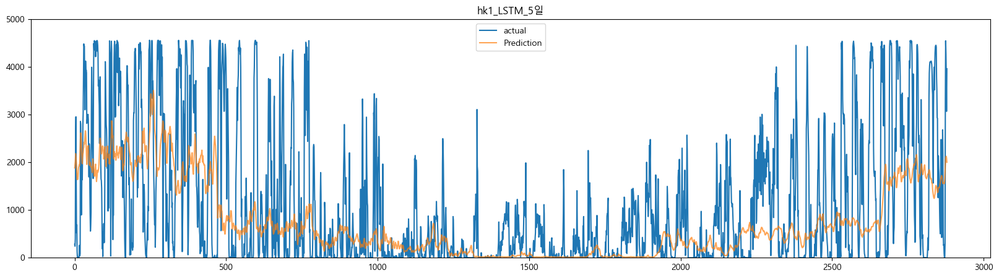

In [502]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_5일')
plt.plot(testY_hk1_38[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_38[n:m],alpha=0.7, label = 'Prediction')
plt.ylim(0,5000)
plt.legend()
print(model_score_test(testY_hk1_38.reshape(-1,1),prediction_hk1_38))

# hk1 multi

현재  15 학습중
Epoch 1/1000
12/12 [==============================] - 3s 124ms/step - loss: 1270.0005 - val_loss: 1195.9177
Epoch 2/1000
12/12 [==============================] - 0s 18ms/step - loss: 1242.3599 - val_loss: 1145.6550
Epoch 3/1000
12/12 [==============================] - 0s 18ms/step - loss: 1208.9666 - val_loss: 1145.9089
Epoch 4/1000
12/12 [==============================] - 0s 18ms/step - loss: 1189.3876 - val_loss: 1091.2267
Epoch 5/1000
12/12 [==============================] - 0s 18ms/step - loss: 1150.0598 - val_loss: 1073.6355
Epoch 6/1000
12/12 [==============================] - 0s 18ms/step - loss: 1114.3787 - val_loss: 1063.1211
Epoch 7/1000
12/12 [==============================] - 0s 19ms/step - loss: 1082.6199 - val_loss: 1067.2234
Epoch 8/1000
12/12 [==============================] - 0s 18ms/step - loss: 1110.5095 - val_loss: 1038.0297
Epoch 9/1000
12/12 [==============================] - 0s 18ms/step - loss: 1086.7324 - val_loss: 1040.0525
Epoch 10/1000
12/12 [====

Epoch 78/1000
12/12 [==============================] - 0s 17ms/step - loss: 946.6536 - val_loss: 944.9715
Epoch 79/1000
12/12 [==============================] - 0s 17ms/step - loss: 918.1312 - val_loss: 886.0292
Epoch 80/1000
12/12 [==============================] - 0s 17ms/step - loss: 863.4919 - val_loss: 846.6062
Epoch 81/1000
12/12 [==============================] - 0s 17ms/step - loss: 830.2454 - val_loss: 819.4105
Epoch 82/1000
12/12 [==============================] - 0s 17ms/step - loss: 845.3495 - val_loss: 883.9227
Epoch 83/1000
12/12 [==============================] - 0s 17ms/step - loss: 887.3497 - val_loss: 878.7421
Epoch 84/1000
12/12 [==============================] - 0s 17ms/step - loss: 896.7733 - val_loss: 956.0020
Epoch 85/1000
12/12 [==============================] - 0s 17ms/step - loss: 896.9514 - val_loss: 938.0651
Epoch 86/1000
12/12 [==============================] - 0s 17ms/step - loss: 881.2979 - val_loss: 921.2954
Epoch 87/1000
12/12 [=========================

12/12 [==============================] - 0s 17ms/step - loss: 1114.3945 - val_loss: 1043.1604
Epoch 155/1000
12/12 [==============================] - 0s 17ms/step - loss: 1151.8643 - val_loss: 1074.4413
Epoch 156/1000
12/12 [==============================] - 0s 17ms/step - loss: 1124.6926 - val_loss: 1077.3059
Epoch 157/1000
12/12 [==============================] - 0s 17ms/step - loss: 1123.9624 - val_loss: 1081.1245
Epoch 158/1000
12/12 [==============================] - 0s 17ms/step - loss: 1119.3761 - val_loss: 1078.9614
Epoch 159/1000
12/12 [==============================] - 0s 17ms/step - loss: 1118.9668 - val_loss: 1076.3276
Epoch 160/1000
12/12 [==============================] - 0s 17ms/step - loss: 1119.8616 - val_loss: 1080.3445
Epoch 161/1000
12/12 [==============================] - 0s 17ms/step - loss: 1120.3727 - val_loss: 1070.8025
Epoch 162/1000
12/12 [==============================] - 0s 17ms/step - loss: 1114.3596 - val_loss: 1067.6021
Epoch 163/1000
12/12 [============

12/12 [==============================] - 0s 17ms/step - loss: 973.4741 - val_loss: 1004.2596
Epoch 230/1000
12/12 [==============================] - 0s 17ms/step - loss: 995.4579 - val_loss: 1021.5349
Epoch 231/1000
12/12 [==============================] - 0s 17ms/step - loss: 990.6392 - val_loss: 995.9837
Epoch 232/1000
12/12 [==============================] - 0s 17ms/step - loss: 972.2726 - val_loss: 993.6866
Epoch 233/1000
12/12 [==============================] - 0s 17ms/step - loss: 984.7988 - val_loss: 999.0365
Epoch 234/1000
12/12 [==============================] - 0s 17ms/step - loss: 979.0638 - val_loss: 998.0023
Epoch 235/1000
12/12 [==============================] - 0s 17ms/step - loss: 967.5073 - val_loss: 1006.8348
Epoch 236/1000
12/12 [==============================] - 0s 17ms/step - loss: 971.5483 - val_loss: 999.5395
Epoch 237/1000
12/12 [==============================] - 0s 17ms/step - loss: 978.9844 - val_loss: 1052.7307
Epoch 238/1000
12/12 [==========================

12/12 [==============================] - 0s 17ms/step - loss: 916.9510 - val_loss: 1003.8167
Epoch 306/1000
12/12 [==============================] - 0s 18ms/step - loss: 937.2773 - val_loss: 1006.9132
Epoch 307/1000
12/12 [==============================] - 0s 18ms/step - loss: 973.7774 - val_loss: 1138.9862
Epoch 308/1000
12/12 [==============================] - 0s 18ms/step - loss: 1198.0583 - val_loss: 1197.7638
Epoch 309/1000
12/12 [==============================] - 0s 17ms/step - loss: 1273.2805 - val_loss: 1197.4706
Epoch 310/1000
12/12 [==============================] - 0s 17ms/step - loss: 1270.2756 - val_loss: 1197.4706
Epoch 311/1000
12/12 [==============================] - 0s 17ms/step - loss: 1270.2756 - val_loss: 1197.4706
Epoch 312/1000
12/12 [==============================] - 0s 18ms/step - loss: 1270.2755 - val_loss: 1197.4706
Epoch 313/1000
12/12 [==============================] - 0s 18ms/step - loss: 1270.2755 - val_loss: 1197.4706
Epoch 314/1000
12/12 [===============

Epoch 43/1000
12/12 [==============================] - 0s 21ms/step - loss: 954.9698 - val_loss: 1006.0640
Epoch 44/1000
12/12 [==============================] - 0s 22ms/step - loss: 949.1161 - val_loss: 1009.5432
Epoch 45/1000
12/12 [==============================] - 0s 21ms/step - loss: 945.3171 - val_loss: 1032.4681
Epoch 46/1000
12/12 [==============================] - 0s 22ms/step - loss: 1184.1044 - val_loss: 988.7770
Epoch 47/1000
12/12 [==============================] - 0s 21ms/step - loss: 1004.5389 - val_loss: 997.5928
Epoch 48/1000
12/12 [==============================] - 0s 21ms/step - loss: 989.4458 - val_loss: 983.4123
Epoch 49/1000
12/12 [==============================] - 0s 21ms/step - loss: 982.6857 - val_loss: 993.4562
Epoch 50/1000
12/12 [==============================] - 0s 22ms/step - loss: 979.4655 - val_loss: 993.2819
Epoch 51/1000
12/12 [==============================] - 0s 22ms/step - loss: 972.9797 - val_loss: 1009.8793
Epoch 52/1000
12/12 [===================

12/12 [==============================] - 0s 22ms/step - loss: 923.6453 - val_loss: 1055.9398
Epoch 120/1000
12/12 [==============================] - 0s 22ms/step - loss: 889.7935 - val_loss: 1017.4440
Epoch 121/1000
12/12 [==============================] - 0s 21ms/step - loss: 883.3785 - val_loss: 1012.5737
Epoch 122/1000
12/12 [==============================] - 0s 21ms/step - loss: 872.1292 - val_loss: 1003.6874
Epoch 123/1000
12/12 [==============================] - 0s 22ms/step - loss: 870.9308 - val_loss: 1005.0657
Epoch 124/1000
12/12 [==============================] - 0s 21ms/step - loss: 864.3370 - val_loss: 1001.4197
Epoch 125/1000
12/12 [==============================] - 0s 21ms/step - loss: 911.5200 - val_loss: 1022.1786
Epoch 126/1000
12/12 [==============================] - 0s 21ms/step - loss: 894.9767 - val_loss: 995.8672
Epoch 127/1000
12/12 [==============================] - 0s 21ms/step - loss: 875.5842 - val_loss: 1020.7680
Epoch 128/1000
12/12 [======================

Epoch 195/1000
12/12 [==============================] - 0s 27ms/step - loss: 855.8653 - val_loss: 1057.7700
Epoch 196/1000
12/12 [==============================] - 0s 27ms/step - loss: 859.0868 - val_loss: 1021.3685
Epoch 197/1000
12/12 [==============================] - 0s 22ms/step - loss: 850.5935 - val_loss: 1017.0681
Epoch 198/1000
12/12 [==============================] - 0s 22ms/step - loss: 839.2412 - val_loss: 1016.4509
Epoch 199/1000
12/12 [==============================] - 0s 22ms/step - loss: 833.7880 - val_loss: 1047.9733
Epoch 200/1000
12/12 [==============================] - 0s 22ms/step - loss: 844.3521 - val_loss: 1036.0206
Epoch 201/1000
12/12 [==============================] - 0s 22ms/step - loss: 861.3467 - val_loss: 1091.3403
Epoch 202/1000
12/12 [==============================] - 0s 22ms/step - loss: 839.8577 - val_loss: 1026.4590
Epoch 203/1000
12/12 [==============================] - 0s 22ms/step - loss: 846.4449 - val_loss: 1088.0159
Epoch 204/1000
12/12 [======

12/12 [==============================] - 0s 22ms/step - loss: 1211.0469 - val_loss: 1146.9785
Epoch 271/1000
12/12 [==============================] - 0s 22ms/step - loss: 1147.2919 - val_loss: 1106.0731
Epoch 272/1000
12/12 [==============================] - 0s 22ms/step - loss: 1123.3958 - val_loss: 1083.0706
Epoch 273/1000
12/12 [==============================] - 0s 22ms/step - loss: 1097.6952 - val_loss: 1074.6295
Epoch 274/1000
12/12 [==============================] - 0s 22ms/step - loss: 1088.1621 - val_loss: 1076.4158
Epoch 275/1000
12/12 [==============================] - 0s 22ms/step - loss: 1090.1702 - val_loss: 1073.5133
Epoch 276/1000
12/12 [==============================] - 0s 22ms/step - loss: 1087.6459 - val_loss: 1068.1439
Epoch 277/1000
12/12 [==============================] - 0s 22ms/step - loss: 1068.1357 - val_loss: 1054.0168
Epoch 278/1000
12/12 [==============================] - 0s 22ms/step - loss: 1063.0514 - val_loss: 1047.9446
Epoch 279/1000
12/12 [============

12/12 [==============================] - 0s 22ms/step - loss: 1108.4037 - val_loss: 1078.2358
Epoch 346/1000
12/12 [==============================] - 0s 22ms/step - loss: 1100.8606 - val_loss: 1078.6338
Epoch 347/1000
12/12 [==============================] - 0s 22ms/step - loss: 1099.0830 - val_loss: 1070.1771
Epoch 348/1000
12/12 [==============================] - 0s 22ms/step - loss: 1085.0961 - val_loss: 1061.6631
Epoch 349/1000
12/12 [==============================] - 0s 22ms/step - loss: 1072.0536 - val_loss: 1052.5417
Epoch 350/1000
12/12 [==============================] - 0s 22ms/step - loss: 1051.3518 - val_loss: 1043.7524
Epoch 351/1000
12/12 [==============================] - 0s 22ms/step - loss: 1035.0062 - val_loss: 1036.8339
Epoch 352/1000
12/12 [==============================] - 0s 21ms/step - loss: 1017.9029 - val_loss: 1036.5422
Epoch 353/1000
12/12 [==============================] - 0s 21ms/step - loss: 1009.8999 - val_loss: 1040.5051
Epoch 354/1000
12/12 [============

Epoch 421/1000
12/12 [==============================] - 0s 22ms/step - loss: 961.6332 - val_loss: 1018.5002
Epoch 422/1000
12/12 [==============================] - 0s 22ms/step - loss: 1029.8356 - val_loss: 1143.2495
Epoch 423/1000
12/12 [==============================] - 0s 23ms/step - loss: 1055.3132 - val_loss: 1002.1558
Epoch 424/1000
12/12 [==============================] - 0s 27ms/step - loss: 1004.2813 - val_loss: 1010.6091
Epoch 425/1000
12/12 [==============================] - 0s 25ms/step - loss: 996.6368 - val_loss: 1001.8523
Epoch 426/1000
12/12 [==============================] - 0s 28ms/step - loss: 986.9938 - val_loss: 997.5890
Epoch 427/1000
12/12 [==============================] - 0s 26ms/step - loss: 975.2211 - val_loss: 1001.4879
Epoch 428/1000
12/12 [==============================] - 0s 26ms/step - loss: 972.8296 - val_loss: 1015.4300
Epoch 429/1000
12/12 [==============================] - 0s 28ms/step - loss: 968.7056 - val_loss: 1007.6082
Epoch 430/1000
12/12 [====

Epoch 65/1000
12/12 [==============================] - 0s 28ms/step - loss: 1114.0474 - val_loss: 1064.8115
Epoch 66/1000
12/12 [==============================] - 0s 25ms/step - loss: 1157.3571 - val_loss: 2210.7305
Epoch 67/1000
12/12 [==============================] - 0s 28ms/step - loss: 2272.5842 - val_loss: 1200.4365
Epoch 68/1000
12/12 [==============================] - 0s 26ms/step - loss: 1269.1554 - val_loss: 1200.4263
Epoch 69/1000
12/12 [==============================] - 0s 26ms/step - loss: 1269.3964 - val_loss: 1200.3641
Epoch 70/1000
12/12 [==============================] - 0s 26ms/step - loss: 1269.3220 - val_loss: 1200.2887
Epoch 71/1000
12/12 [==============================] - 0s 28ms/step - loss: 1269.2413 - val_loss: 1200.2545
Epoch 72/1000
12/12 [==============================] - 0s 26ms/step - loss: 1269.2236 - val_loss: 1200.2413
Epoch 73/1000
12/12 [==============================] - 0s 26ms/step - loss: 1269.2159 - val_loss: 1200.2357
Epoch 74/1000
12/12 [=======

12/12 [==============================] - 0s 27ms/step - loss: 1078.1395 - val_loss: 1050.0197
Epoch 141/1000
12/12 [==============================] - 0s 26ms/step - loss: 1075.9532 - val_loss: 1057.7054
Epoch 142/1000
12/12 [==============================] - 0s 25ms/step - loss: 1173.6865 - val_loss: 1063.9540
Epoch 143/1000
12/12 [==============================] - 0s 27ms/step - loss: 1141.6995 - val_loss: 1132.7961
Epoch 144/1000
12/12 [==============================] - 0s 25ms/step - loss: 1203.8351 - val_loss: 1143.6429
Epoch 145/1000
12/12 [==============================] - 0s 27ms/step - loss: 1201.7461 - val_loss: 1133.3777
Epoch 146/1000
12/12 [==============================] - 0s 27ms/step - loss: 1179.1085 - val_loss: 1094.7252
Epoch 147/1000
12/12 [==============================] - 0s 26ms/step - loss: 1127.6991 - val_loss: 1130.1571
Epoch 148/1000
12/12 [==============================] - 0s 28ms/step - loss: 1143.7994 - val_loss: 1155.1791
Epoch 149/1000
12/12 [============

12/12 [==============================] - 0s 25ms/step - loss: 1059.8242 - val_loss: 1065.0691
Epoch 216/1000
12/12 [==============================] - 0s 25ms/step - loss: 1058.0073 - val_loss: 1053.9924
Epoch 217/1000
12/12 [==============================] - 0s 25ms/step - loss: 1060.1519 - val_loss: 1053.7336
Epoch 218/1000
12/12 [==============================] - 0s 25ms/step - loss: 1053.2787 - val_loss: 1052.9087
Epoch 219/1000
12/12 [==============================] - 0s 27ms/step - loss: 1057.7415 - val_loss: 1060.5063
Epoch 220/1000
12/12 [==============================] - 0s 27ms/step - loss: 1070.7673 - val_loss: 1068.2662
Epoch 221/1000
12/12 [==============================] - 0s 25ms/step - loss: 1067.9655 - val_loss: 1066.3568
Epoch 222/1000
12/12 [==============================] - 0s 28ms/step - loss: 1056.6724 - val_loss: 1066.4996
Epoch 223/1000
12/12 [==============================] - 0s 26ms/step - loss: 1060.6025 - val_loss: 1057.5782
Epoch 224/1000
12/12 [============

12/12 [==============================] - 0s 26ms/step - loss: 1073.3123 - val_loss: 1054.4955
Epoch 291/1000
12/12 [==============================] - 0s 25ms/step - loss: 1071.0632 - val_loss: 1052.0023
Epoch 292/1000
12/12 [==============================] - 0s 26ms/step - loss: 1068.0128 - val_loss: 1045.8796
Epoch 293/1000
12/12 [==============================] - 0s 25ms/step - loss: 1063.5591 - val_loss: 1050.1151
Epoch 294/1000
12/12 [==============================] - 0s 25ms/step - loss: 1068.2948 - val_loss: 1045.4255
Epoch 295/1000
12/12 [==============================] - 0s 26ms/step - loss: 1060.1746 - val_loss: 1041.0134
Epoch 296/1000
12/12 [==============================] - 0s 31ms/step - loss: 1054.7197 - val_loss: 1041.0614
Epoch 297/1000
12/12 [==============================] - 0s 32ms/step - loss: 1054.0417 - val_loss: 1041.8710
Epoch 298/1000
12/12 [==============================] - 0s 25ms/step - loss: 1048.5302 - val_loss: 1038.5746
Epoch 299/1000
12/12 [============

12/12 [==============================] - 0s 26ms/step - loss: 1010.1699 - val_loss: 1030.7263
Epoch 366/1000
12/12 [==============================] - 0s 25ms/step - loss: 1013.5206 - val_loss: 1031.7491
Epoch 367/1000
12/12 [==============================] - 0s 26ms/step - loss: 1017.7025 - val_loss: 1028.8640
Epoch 368/1000
12/12 [==============================] - 0s 26ms/step - loss: 1014.8536 - val_loss: 1033.9618
Epoch 369/1000
12/12 [==============================] - 0s 27ms/step - loss: 1024.2275 - val_loss: 1031.6290
Epoch 370/1000
12/12 [==============================] - 0s 26ms/step - loss: 1009.3240 - val_loss: 1034.0128
Epoch 371/1000
12/12 [==============================] - 0s 25ms/step - loss: 1014.1292 - val_loss: 1027.2802
Epoch 372/1000
12/12 [==============================] - 0s 31ms/step - loss: 1010.8998 - val_loss: 1025.9558
Epoch 373/1000
12/12 [==============================] - 0s 26ms/step - loss: 1004.6825 - val_loss: 1026.8273
Epoch 374/1000
12/12 [============

12/12 [==============================] - 0s 26ms/step - loss: 1144.2023 - val_loss: 1135.1396
Epoch 441/1000
12/12 [==============================] - 0s 27ms/step - loss: 1144.2465 - val_loss: 1132.6820
Epoch 442/1000
12/12 [==============================] - 0s 26ms/step - loss: 1131.4598 - val_loss: 1135.0795
Epoch 443/1000
12/12 [==============================] - 0s 27ms/step - loss: 1118.1278 - val_loss: 1117.8016
Epoch 444/1000
12/12 [==============================] - 0s 26ms/step - loss: 1115.9806 - val_loss: 1133.5505
Epoch 445/1000
12/12 [==============================] - 0s 28ms/step - loss: 1101.9993 - val_loss: 1124.3358
Epoch 446/1000
12/12 [==============================] - 0s 28ms/step - loss: 1086.3026 - val_loss: 1117.2333
Epoch 447/1000
12/12 [==============================] - 0s 26ms/step - loss: 1089.2954 - val_loss: 1098.4285
Epoch 448/1000
12/12 [==============================] - 0s 26ms/step - loss: 1089.5059 - val_loss: 1103.1296
Epoch 449/1000
12/12 [============

12/12 [==============================] - 0s 28ms/step - loss: 993.8235 - val_loss: 1018.4738
Epoch 516/1000
12/12 [==============================] - 0s 27ms/step - loss: 995.4527 - val_loss: 1014.8083
Epoch 517/1000
12/12 [==============================] - 0s 27ms/step - loss: 997.6674 - val_loss: 1015.4168
Epoch 518/1000
12/12 [==============================] - 0s 31ms/step - loss: 995.4391 - val_loss: 1027.4260
Epoch 519/1000
12/12 [==============================] - 0s 34ms/step - loss: 996.6015 - val_loss: 1015.0255
Epoch 520/1000
12/12 [==============================] - 0s 33ms/step - loss: 1035.1989 - val_loss: 1100.3553
Epoch 521/1000
12/12 [==============================] - 0s 42ms/step - loss: 1142.9219 - val_loss: 1104.2947
Epoch 522/1000
12/12 [==============================] - 0s 32ms/step - loss: 1119.7212 - val_loss: 1089.1794
Epoch 523/1000
12/12 [==============================] - 0s 35ms/step - loss: 1096.6647 - val_loss: 1080.1272
Epoch 524/1000
12/12 [=================

12/12 [==============================] - 0s 29ms/step - loss: 1059.9327 - val_loss: 1044.6096
Epoch 591/1000
12/12 [==============================] - 0s 26ms/step - loss: 1039.3330 - val_loss: 1024.7589
Epoch 592/1000
12/12 [==============================] - 0s 26ms/step - loss: 1026.3088 - val_loss: 1013.5283
Epoch 593/1000
12/12 [==============================] - 0s 27ms/step - loss: 1017.5774 - val_loss: 1024.4236
Epoch 594/1000
12/12 [==============================] - 0s 27ms/step - loss: 1019.9661 - val_loss: 1018.1569
Epoch 595/1000
12/12 [==============================] - 0s 27ms/step - loss: 1004.1871 - val_loss: 1024.9624
Epoch 596/1000
12/12 [==============================] - 0s 26ms/step - loss: 1007.0527 - val_loss: 1022.8165
Epoch 597/1000
12/12 [==============================] - 0s 27ms/step - loss: 994.5149 - val_loss: 1021.7581
Epoch 598/1000
12/12 [==============================] - 0s 26ms/step - loss: 1027.4094 - val_loss: 1025.7034
Epoch 599/1000
12/12 [=============

Epoch 666/1000
12/12 [==============================] - 0s 28ms/step - loss: 949.2615 - val_loss: 1013.1402
Epoch 667/1000
12/12 [==============================] - 0s 29ms/step - loss: 952.7051 - val_loss: 1020.2038
Epoch 668/1000
12/12 [==============================] - 0s 29ms/step - loss: 953.9437 - val_loss: 1007.2268
Epoch 669/1000
12/12 [==============================] - 0s 28ms/step - loss: 957.5131 - val_loss: 1013.2215
Epoch 670/1000
12/12 [==============================] - 0s 29ms/step - loss: 946.0789 - val_loss: 1042.3724
Epoch 671/1000
12/12 [==============================] - 0s 28ms/step - loss: 950.0763 - val_loss: 1016.1046
Epoch 672/1000
12/12 [==============================] - 0s 29ms/step - loss: 952.0054 - val_loss: 1032.7041
Epoch 673/1000
12/12 [==============================] - 0s 29ms/step - loss: 946.4311 - val_loss: 1018.1899
Epoch 674/1000
12/12 [==============================] - 0s 40ms/step - loss: 945.9385 - val_loss: 1018.2502
Epoch 675/1000
12/12 [======

Epoch 742/1000
12/12 [==============================] - 0s 28ms/step - loss: 928.5320 - val_loss: 1014.1187
Epoch 743/1000
12/12 [==============================] - 0s 30ms/step - loss: 932.1072 - val_loss: 1033.8379
Epoch 744/1000
12/12 [==============================] - 0s 29ms/step - loss: 925.1652 - val_loss: 1019.2543
Epoch 745/1000
12/12 [==============================] - 0s 28ms/step - loss: 922.5707 - val_loss: 1015.1948
Epoch 746/1000
12/12 [==============================] - 0s 33ms/step - loss: 920.0312 - val_loss: 1017.8033
Epoch 747/1000
12/12 [==============================] - 0s 33ms/step - loss: 914.9690 - val_loss: 1032.2289
Epoch 748/1000
12/12 [==============================] - 0s 34ms/step - loss: 913.0845 - val_loss: 1008.9990
Epoch 749/1000
12/12 [==============================] - 0s 34ms/step - loss: 921.8058 - val_loss: 1020.4381
Epoch 750/1000
12/12 [==============================] - 0s 38ms/step - loss: 919.2112 - val_loss: 1020.6440
Epoch 751/1000
12/12 [======

12/12 [==============================] - 0s 28ms/step - loss: 984.8179 - val_loss: 1060.1174
Epoch 818/1000
12/12 [==============================] - 0s 27ms/step - loss: 982.2187 - val_loss: 1065.2430
Epoch 819/1000
12/12 [==============================] - 0s 27ms/step - loss: 1097.5369 - val_loss: 1155.9462
Epoch 820/1000
12/12 [==============================] - 0s 28ms/step - loss: 1191.2245 - val_loss: 1151.9983
Epoch 821/1000
12/12 [==============================] - 0s 29ms/step - loss: 1183.6478 - val_loss: 1138.6101
Epoch 822/1000
12/12 [==============================] - 0s 28ms/step - loss: 1162.3975 - val_loss: 1134.3142
Epoch 823/1000
12/12 [==============================] - 0s 28ms/step - loss: 1128.2271 - val_loss: 1111.4254
Epoch 824/1000
12/12 [==============================] - 0s 29ms/step - loss: 1089.2218 - val_loss: 1106.1106
Epoch 825/1000
12/12 [==============================] - 0s 28ms/step - loss: 1056.6039 - val_loss: 1092.4170
Epoch 826/1000
12/12 [==============

Epoch 893/1000
12/12 [==============================] - 0s 28ms/step - loss: 1204.7677 - val_loss: 1143.4863
Epoch 894/1000
12/12 [==============================] - 0s 31ms/step - loss: 1203.9227 - val_loss: 1128.8280
Epoch 895/1000
12/12 [==============================] - 0s 28ms/step - loss: 1186.1559 - val_loss: 1115.5328
Epoch 896/1000
12/12 [==============================] - 0s 28ms/step - loss: 1185.2223 - val_loss: 1122.0992
Epoch 897/1000
12/12 [==============================] - 0s 29ms/step - loss: 1198.2625 - val_loss: 1119.8990
Epoch 898/1000
12/12 [==============================] - 0s 29ms/step - loss: 1182.8959 - val_loss: 1115.7898
Epoch 899/1000
12/12 [==============================] - 0s 29ms/step - loss: 1170.2495 - val_loss: 1105.5801
Epoch 900/1000
12/12 [==============================] - 0s 29ms/step - loss: 1155.6823 - val_loss: 1096.1036
Epoch 901/1000
12/12 [==============================] - 0s 28ms/step - loss: 1172.1451 - val_loss: 1095.1597
Epoch 902/1000
12/1

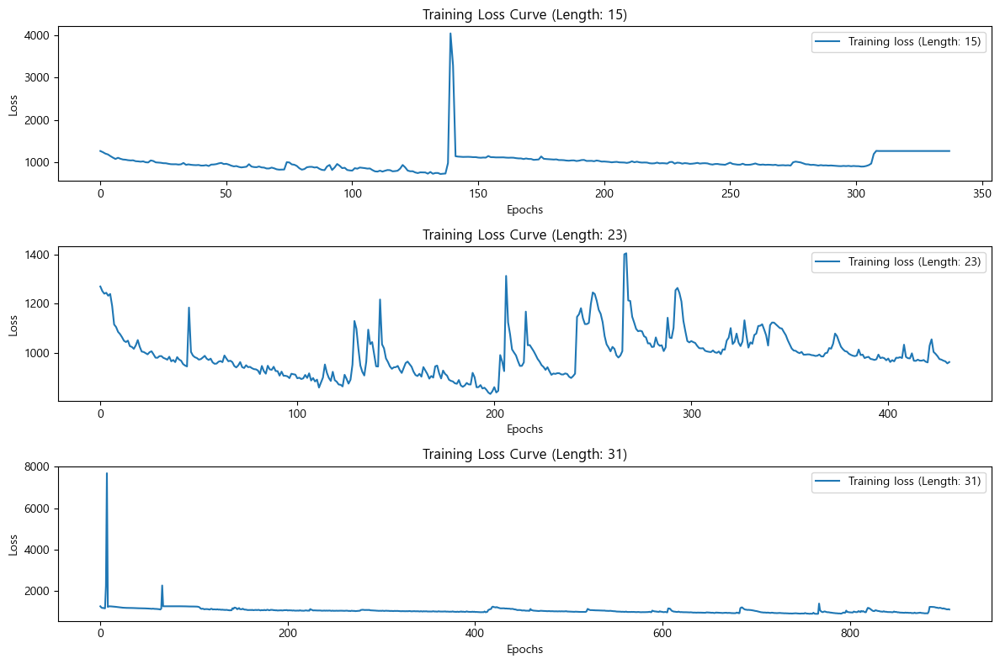

In [427]:
plt.figure(figsize=(12, 8))
seed_everything_tf(config.seed)

for idx, past_length in enumerate(past_lengths_m, 1):
    # model 정의
    model_name = f"model_hk1_L_multi_{past_length}"
    input_shape_var = f"trainX_hk1_{past_length}_m"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(8, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_hk1_L_multi_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_hk1_{past_length}_m"],
                                                        globals()[f"trainY_hk1_{past_length}_m"],
                                                        validation_data=(globals()[f"validX_hk1_{past_length}_m"],
                                                                        globals()[f"validY_hk1_{past_length}_m"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


R2 score: 0.4205530149532478
MAE Loss:  689.0196401497896
R2 score: 0.15004705920065775
MAE Loss:  870.2957403756963
R2 score: 0.13401126301503452
MAE Loss:  917.4348458056838
[689.0196401497896, 870.2957403756963, 917.4348458056838]


In [444]:
prediction_hk1_15_m = model_hk1_L_multi_15.predict(testX_hk1_15_m) 
testY_hk1_15_m_re = testY_hk1_15_m.reshape(testY_hk1_15_m.shape[0]*8,1,1)
prediction_hk1_15_m_re = prediction_hk1_15_m.reshape(testY_hk1_15_m.shape[0]*8,1)

for _ in zip(prediction_hk1_15_m_re,testY_hk1_15_m_re):
    print(_)

12/12 [==============================] - 0s 4ms/step
(array([2046.1345], dtype=float32), array([[1393.033333]]))
(array([1946.1421], dtype=float32), array([[1355.555556]]))
(array([1940.454], dtype=float32), array([[1758.755556]]))
(array([1863.0419], dtype=float32), array([[2251.755556]]))
(array([1831.8027], dtype=float32), array([[2202.522222]]))
(array([1777.5769], dtype=float32), array([[1494.588889]]))
(array([1874.3049], dtype=float32), array([[1038.177778]]))
(array([1511.8073], dtype=float32), array([[489.1555556]]))
(array([1176.2347], dtype=float32), array([[307.5888889]]))
(array([1232.4407], dtype=float32), array([[279.3888889]]))
(array([1286.308], dtype=float32), array([[1166.844444]]))
(array([1301.3179], dtype=float32), array([[741.9055556]]))
(array([1310.8737], dtype=float32), array([[662.1166667]]))
(array([1364.6431], dtype=float32), array([[1486.611111]]))
(array([1357.6158], dtype=float32), array([[1089.488889]]))
(array([1182.1832], dtype=float32), array([[651.7

(array([15.590686], dtype=float32), array([[192.2111111]]))
(array([59.32207], dtype=float32), array([[76.25]]))
(array([39.827984], dtype=float32), array([[3.56666667]]))
(array([38.062756], dtype=float32), array([[0.]]))
(array([11.555266], dtype=float32), array([[0.]]))
(array([29.494743], dtype=float32), array([[0.]]))
(array([34.2222], dtype=float32), array([[0.]]))
(array([7.548469], dtype=float32), array([[2.48333333]]))
(array([21.784475], dtype=float32), array([[0.]]))
(array([63.676205], dtype=float32), array([[0.]]))
(array([44.16278], dtype=float32), array([[0.60555556]]))
(array([41.74994], dtype=float32), array([[0.]]))
(array([26.89336], dtype=float32), array([[0.]]))
(array([45.20196], dtype=float32), array([[0.]]))
(array([46.482307], dtype=float32), array([[0.]]))
(array([15.026376], dtype=float32), array([[0.]]))
(array([31.511217], dtype=float32), array([[0.]]))
(array([71.949], dtype=float32), array([[0.]]))
(array([52.84711], dtype=float32), array([[0.]]))
(array(

(array([94.418495], dtype=float32), array([[461.0666667]]))
(array([66.86017], dtype=float32), array([[388.5833333]]))
(array([65.50818], dtype=float32), array([[604.5555556]]))
(array([228.39159], dtype=float32), array([[130.8888889]]))
(array([240.19852], dtype=float32), array([[350.4333333]]))
(array([228.92409], dtype=float32), array([[200.7166667]]))
(array([150.1028], dtype=float32), array([[74.28888889]]))
(array([147.375], dtype=float32), array([[460.1666667]]))
(array([180.81598], dtype=float32), array([[476.7722222]]))
(array([160.14372], dtype=float32), array([[99.29444444]]))
(array([134.80829], dtype=float32), array([[122.3333333]]))
(array([84.64111], dtype=float32), array([[485.0777778]]))
(array([99.77422], dtype=float32), array([[1406.527778]]))
(array([97.45214], dtype=float32), array([[675.9166667]]))
(array([52.340416], dtype=float32), array([[261.8111111]]))
(array([60.431637], dtype=float32), array([[229.5722222]]))
(array([106.17176], dtype=float32), array([[179.

In [445]:
print(model_score_test(validY_hk1_15_m.reshape(-1,1),model_hk1_L_multi_15.predict(validX_hk1_15_m).reshape(validY_hk1_15_m.shape[0]*8,1)))

12/12 [==============================] - 0s 5ms/step
R2 score: 0.36731524118918446
MAE Loss:  752.1770733168491
(0.36731524118918446, 752.1770733168491)


R2 score: 0.4205530149532478
MAE Loss:  689.0196401497896
(0.4205530149532478, 689.0196401497896)


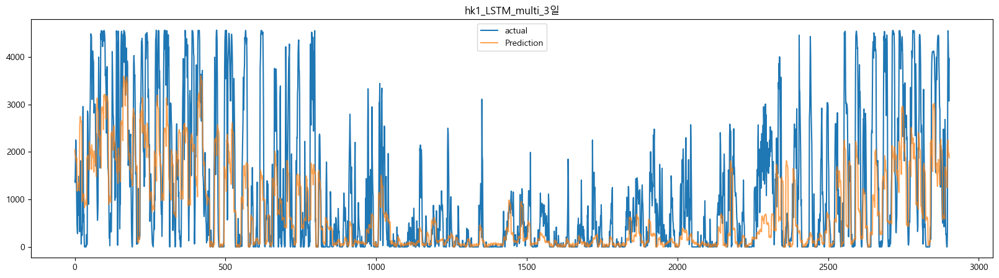

In [446]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_multi_3일')

plt.plot(testY_hk1_15_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_15_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk1_15_m_re.reshape(-1,1),prediction_hk1_15_m_re))

In [447]:
prediction_hk1_23_m = model_hk1_L_multi_23.predict(testX_hk1_23_m) 
testY_hk1_23_m_re = testY_hk1_23_m.reshape(testY_hk1_23_m.shape[0]*8,1,1)
prediction_hk1_23_m_re = prediction_hk1_23_m.reshape(testY_hk1_23_m.shape[0]*8,1)

for _ in zip(prediction_hk1_23_m_re,testY_hk1_23_m_re):
    print(_)

12/12 [==============================] - 0s 5ms/step
(array([1389.9075], dtype=float32), array([[307.5888889]]))
(array([1582.0397], dtype=float32), array([[279.3888889]]))
(array([1659.1742], dtype=float32), array([[1166.844444]]))
(array([1625.8516], dtype=float32), array([[741.9055556]]))
(array([1709.5104], dtype=float32), array([[662.1166667]]))
(array([1736.6642], dtype=float32), array([[1486.611111]]))
(array([1590.1589], dtype=float32), array([[1089.488889]]))
(array([1369.9685], dtype=float32), array([[651.7666667]]))
(array([1076.992], dtype=float32), array([[320.9833333]]))
(array([1220.9222], dtype=float32), array([[1276.266667]]))
(array([1270.551], dtype=float32), array([[1380.35]]))
(array([1245.018], dtype=float32), array([[1811.633333]]))
(array([1303.9532], dtype=float32), array([[525.2055556]]))
(array([1330.8042], dtype=float32), array([[61.07777778]]))
(array([1219.3145], dtype=float32), array([[424.3833333]]))
(array([1043.5363], dtype=float32), array([[285.816666

(array([335.30072], dtype=float32), array([[0.]]))
(array([296.1203], dtype=float32), array([[0.]]))
(array([222.70264], dtype=float32), array([[0.]]))
(array([253.55113], dtype=float32), array([[0.]]))
(array([289.57925], dtype=float32), array([[0.]]))
(array([274.97086], dtype=float32), array([[604.7111111]]))
(array([269.18073], dtype=float32), array([[84.91666667]]))
(array([270.3622], dtype=float32), array([[90.25555556]]))
(array([265.27936], dtype=float32), array([[1960.55]]))
(array([229.13882], dtype=float32), array([[2498.516667]]))
(array([171.75122], dtype=float32), array([[2395.855556]]))
(array([284.74658], dtype=float32), array([[1965.744444]]))
(array([321.21347], dtype=float32), array([[1350.505556]]))
(array([307.42844], dtype=float32), array([[410.0166667]]))
(array([299.48013], dtype=float32), array([[4.12222222]]))
(array([300.6463], dtype=float32), array([[169.9722222]]))
(array([291.90192], dtype=float32), array([[227.7]]))
(array([259.0899], dtype=float32), arra

(array([165.2568], dtype=float32), array([[4.26666667]]))
(array([319.1472], dtype=float32), array([[0.]]))
(array([363.11642], dtype=float32), array([[0.]]))
(array([329.8807], dtype=float32), array([[0.]]))
(array([317.08786], dtype=float32), array([[7.98333333]]))
(array([314.87256], dtype=float32), array([[0.]]))
(array([307.5467], dtype=float32), array([[0.]]))
(array([276.78143], dtype=float32), array([[0.]]))
(array([207.32957], dtype=float32), array([[0.79444444]]))
(array([856.9121], dtype=float32), array([[27.86666667]]))
(array([1008.41], dtype=float32), array([[94.1]]))
(array([961.1477], dtype=float32), array([[289.2388889]]))
(array([944.90454], dtype=float32), array([[48.85555556]]))
(array([983.19525], dtype=float32), array([[583.5777778]]))
(array([1006.53723], dtype=float32), array([[135.0888889]]))
(array([920.1125], dtype=float32), array([[72.73333333]]))
(array([748.32434], dtype=float32), array([[37.68888889]]))
(array([202.19978], dtype=float32), array([[471.4]])

(array([1488.3793], dtype=float32), array([[4292.616667]]))
(array([1703.7355], dtype=float32), array([[2790.5]]))
(array([1782.3529], dtype=float32), array([[561.4111111]]))
(array([1744.7844], dtype=float32), array([[117.6055556]]))
(array([1848.7336], dtype=float32), array([[5.51111111]]))
(array([1871.1057], dtype=float32), array([[30.24444444]]))
(array([1717.0885], dtype=float32), array([[145.45]]))
(array([1472.8478], dtype=float32), array([[26.65]]))
(array([2575.383], dtype=float32), array([[5.43333333]]))
(array([2906.4043], dtype=float32), array([[91.88333333]]))
(array([3086.065], dtype=float32), array([[673.4722222]]))
(array([3008.2622], dtype=float32), array([[59.92222222]]))
(array([3192.9792], dtype=float32), array([[261.2722222]]))
(array([3227.345], dtype=float32), array([[682.8722222]]))
(array([2971.795], dtype=float32), array([[1250.661111]]))
(array([2609.6838], dtype=float32), array([[1522.366667]]))
(array([2257.7898], dtype=float32), array([[2980.605556]]))
(a

In [448]:
print(model_score_test(validY_hk1_23_m.reshape(-1,1),model_hk1_L_multi_23.predict(validX_hk1_23_m).reshape(validY_hk1_23_m.shape[0]*8,1)))

12/12 [==============================] - 0s 5ms/step
R2 score: 0.016759331276361977
MAE Loss:  966.9755208026902
(0.016759331276361977, 966.9755208026902)


R2 score: 0.15004705920065775
MAE Loss:  870.2957403756963
(0.15004705920065775, 870.2957403756963)


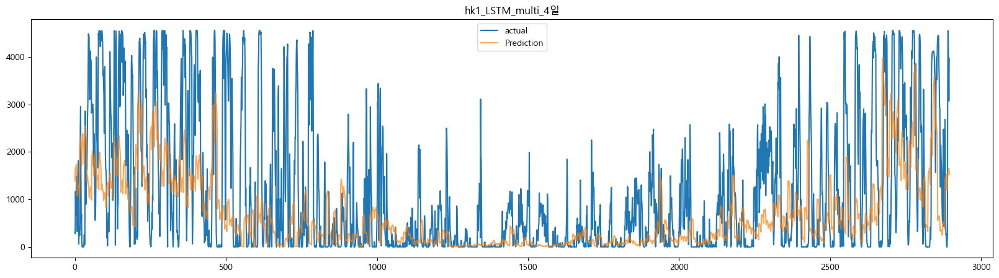

In [449]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_multi_4일')

plt.plot(testY_hk1_23_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_23_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk1_23_m_re.reshape(-1,1),prediction_hk1_23_m_re))

In [450]:
prediction_hk1_31_m = model_hk1_L_multi_31.predict(testX_hk1_31_m) 
testY_hk1_31_m_re = testY_hk1_31_m.reshape(testY_hk1_31_m.shape[0]*8,1,1)
prediction_hk1_31_m_re = prediction_hk1_31_m.reshape(testY_hk1_31_m.shape[0]*8,1)

for _ in zip(prediction_hk1_31_m_re,testY_hk1_31_m_re):
    print(_)

12/12 [==============================] - 1s 9ms/step
(array([1627.5403], dtype=float32), array([[320.9833333]]))
(array([1787.3248], dtype=float32), array([[1276.266667]]))
(array([1951.0115], dtype=float32), array([[1380.35]]))
(array([1906.8678], dtype=float32), array([[1811.633333]]))
(array([1820.2084], dtype=float32), array([[525.2055556]]))
(array([1916.1909], dtype=float32), array([[61.07777778]]))
(array([1936.5552], dtype=float32), array([[424.3833333]]))
(array([1764.7957], dtype=float32), array([[285.8166667]]))
(array([2008.146], dtype=float32), array([[241.95]]))
(array([2111.6975], dtype=float32), array([[396.9055556]]))
(array([2204.662], dtype=float32), array([[2501.316667]]))
(array([2193.1091], dtype=float32), array([[2956.338889]]))
(array([2063.7256], dtype=float32), array([[1561.238889]]))
(array([2157.4092], dtype=float32), array([[522.9055556]]))
(array([2088.3206], dtype=float32), array([[687.0166667]]))
(array([1803.7448], dtype=float32), array([[131.5166667]])

(array([512.226], dtype=float32), array([[0.]]))
(array([571.9053], dtype=float32), array([[483.9833333]]))
(array([517.0467], dtype=float32), array([[59.17777778]]))
(array([445.3428], dtype=float32), array([[153.8]]))
(array([515.43854], dtype=float32), array([[322.1388889]]))
(array([556.4872], dtype=float32), array([[1692.4]]))
(array([550.112], dtype=float32), array([[2200.833333]]))
(array([519.9256], dtype=float32), array([[739.4555556]]))
(array([482.24323], dtype=float32), array([[0.]]))
(array([537.96173], dtype=float32), array([[5.76666667]]))
(array([488.22144], dtype=float32), array([[0.]]))
(array([421.37503], dtype=float32), array([[18.68888889]]))
(array([460.45154], dtype=float32), array([[29.50555556]]))
(array([492.67603], dtype=float32), array([[138.3722222]]))
(array([473.1975], dtype=float32), array([[225.2833333]]))
(array([467.91205], dtype=float32), array([[211.0333333]]))
(array([452.45786], dtype=float32), array([[619.6666667]]))
(array([480.47815], dtype=flo

(array([863.9497], dtype=float32), array([[0.]]))
(array([860.03986], dtype=float32), array([[0.]]))
(array([900.38586], dtype=float32), array([[37.56666667]]))
(array([855.2421], dtype=float32), array([[248.2666667]]))
(array([720.08295], dtype=float32), array([[39.68333333]]))
(array([517.2928], dtype=float32), array([[80.72222222]]))
(array([654.0793], dtype=float32), array([[60.58888889]]))
(array([679.5191], dtype=float32), array([[67.25]]))
(array([603.86365], dtype=float32), array([[0.]]))
(array([605.13995], dtype=float32), array([[10.32777778]]))
(array([633.58997], dtype=float32), array([[0.]]))
(array([584.69275], dtype=float32), array([[43.51111111]]))
(array([481.98898], dtype=float32), array([[208.1722222]]))
(array([562.588], dtype=float32), array([[641.35]]))
(array([662.4707], dtype=float32), array([[188.1055556]]))
(array([651.80035], dtype=float32), array([[365.55]]))
(array([608.59247], dtype=float32), array([[972.2]]))
(array([599.1298], dtype=float32), array([[538

(array([1071.5896], dtype=float32), array([[213.9333333]]))
(array([1147.3055], dtype=float32), array([[471.8833333]]))
(array([1174.7742], dtype=float32), array([[1849.783333]]))
(array([1126.4674], dtype=float32), array([[2169.777778]]))
(array([1049.81], dtype=float32), array([[1625.611111]]))
(array([1152.018], dtype=float32), array([[1381.35]]))
(array([1103.4108], dtype=float32), array([[1562.955556]]))
(array([973.8611], dtype=float32), array([[1703.966667]]))
(array([891.7284], dtype=float32), array([[805.6888889]]))
(array([947.9573], dtype=float32), array([[188.2888889]]))
(array([947.1834], dtype=float32), array([[156.0722222]]))
(array([901.17175], dtype=float32), array([[268.2611111]]))
(array([830.9201], dtype=float32), array([[5.57222222]]))
(array([915.0156], dtype=float32), array([[0.]]))
(array([838.4614], dtype=float32), array([[0.]]))
(array([717.3175], dtype=float32), array([[80.35]]))
(array([1112.9968], dtype=float32), array([[0.]]))
(array([1174.1288], dtype=flo

(array([1010.39746], dtype=float32), array([[2456.455556]]))
(array([982.1118], dtype=float32), array([[2811.727778]]))
(array([997.4273], dtype=float32), array([[4442.438889]]))
(array([994.04175], dtype=float32), array([[4472.977778]]))
(array([1038.207], dtype=float32), array([[4437.95]]))
(array([900.39624], dtype=float32), array([[4267.755556]]))
(array([800.269], dtype=float32), array([[3825.605556]]))
(array([969.22894], dtype=float32), array([[2740.]]))
(array([1076.3395], dtype=float32), array([[2411.522222]]))
(array([1045.0796], dtype=float32), array([[2568.033333]]))
(array([1063.7216], dtype=float32), array([[2487.822222]]))
(array([1058.8721], dtype=float32), array([[1505.827778]]))
(array([1106.9365], dtype=float32), array([[455.2111111]]))
(array([961.92], dtype=float32), array([[364.0222222]]))
(array([860.81793], dtype=float32), array([[59.06111111]]))
(array([871.51685], dtype=float32), array([[255.8722222]]))
(array([973.5736], dtype=float32), array([[3316.283333]])

In [451]:
print(model_score_test(validY_hk1_31_m.reshape(-1,1),model_hk1_L_multi_31.predict(validX_hk1_31_m).reshape(validY_hk1_31_m.shape[0]*8,1)))

12/12 [==============================] - 0s 7ms/step
R2 score: 0.07875656843977386
MAE Loss:  984.066135290778
(0.07875656843977386, 984.066135290778)


R2 score: 0.13401126301503452
MAE Loss:  917.4348458056838
(0.13401126301503452, 917.4348458056838)


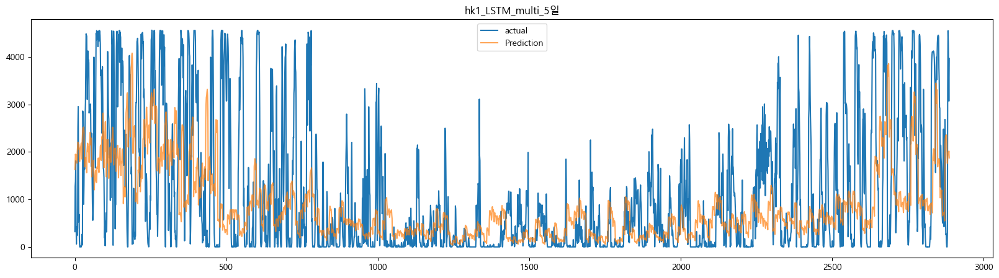

In [452]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_multi_5일')

plt.plot(testY_hk1_31_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_31_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk1_31_m_re.reshape(-1,1),prediction_hk1_31_m_re))

# 3일 

In [1059]:
seed_everything_tf(config.seed)
model_hk1_L_multi = Sequential()
model_hk1_L_multi.add(LSTM(64, activation='relu', input_shape=(trainX_hk1_m.shape[1], trainX_hk1_m.shape[2]),return_sequences=True))
                             #return_sequences=True))
model_hk1_L_multi.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_hk1_L_multi.add(Dropout(0.2))
model_hk1_L_multi.add(Flatten())
model_hk1_L_multi.add(Dense(trainY_hk1_m.shape[1], activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))

model_hk1_L_multi.compile(optimizer='adam', loss='mae')

Epoch 1/1000
8/8 [==============================] - 3s 71ms/step - loss: 1270.1608 - val_loss: 1197.0432
Epoch 2/1000
8/8 [==============================] - 0s 21ms/step - loss: 1268.6682 - val_loss: 1187.5759
Epoch 3/1000
8/8 [==============================] - 0s 21ms/step - loss: 1224.0237 - val_loss: 1121.5823
Epoch 4/1000
8/8 [==============================] - 0s 20ms/step - loss: 1183.1373 - val_loss: 1101.0201
Epoch 5/1000
8/8 [==============================] - 0s 19ms/step - loss: 1149.1569 - val_loss: 1073.2820
Epoch 6/1000
8/8 [==============================] - 0s 18ms/step - loss: 1108.7612 - val_loss: 1073.9889
Epoch 7/1000
8/8 [==============================] - 0s 20ms/step - loss: 1124.8273 - val_loss: 1048.0032
Epoch 8/1000
8/8 [==============================] - 0s 21ms/step - loss: 1070.8024 - val_loss: 1034.9763
Epoch 9/1000
8/8 [==============================] - 0s 20ms/step - loss: 1077.9058 - val_loss: 1033.2921
Epoch 10/1000
8/8 [==============================] - 0s

8/8 [==============================] - 0s 20ms/step - loss: 958.7625 - val_loss: 996.3282
Epoch 157/1000
8/8 [==============================] - 0s 21ms/step - loss: 954.8064 - val_loss: 1045.1544
Epoch 158/1000
8/8 [==============================] - 0s 29ms/step - loss: 1028.6564 - val_loss: 990.5920
Epoch 159/1000
8/8 [==============================] - 0s 22ms/step - loss: 1094.3864 - val_loss: 1571.3248
Epoch 160/1000
8/8 [==============================] - 0s 22ms/step - loss: 1198.7952 - val_loss: 1041.7583
Epoch 161/1000
8/8 [==============================] - 0s 24ms/step - loss: 1079.0481 - val_loss: 1033.8260
Epoch 162/1000
8/8 [==============================] - 0s 25ms/step - loss: 1080.1609 - val_loss: 1043.6737
Epoch 163/1000
8/8 [==============================] - 0s 23ms/step - loss: 1090.9985 - val_loss: 1040.8696
Epoch 164/1000
8/8 [==============================] - 0s 23ms/step - loss: 1071.3004 - val_loss: 1032.8029
Epoch 165/1000
8/8 [==============================] - 0s

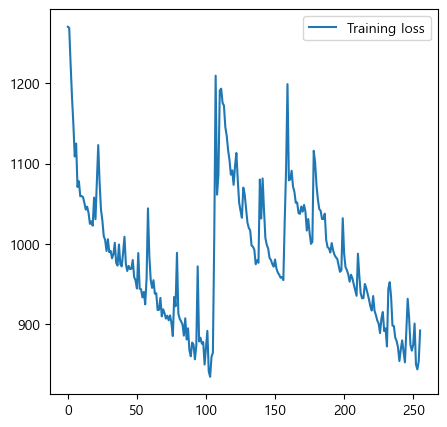

In [1060]:
history_hk1_L_multi = model_hk1_L_multi.fit(trainX_hk1_m, trainY_hk1_m,validation_data = (validX_hk1_m,validY_hk1_m) ,epochs=1000, batch_size=100,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk1_L_multi.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [1061]:
prediction_hk1_m = model_hk1_L_multi.predict(testX_hk1_m) 
testY_hk1_m_re = testY_hk1_m.reshape(testY_hk1_m.shape[0]*8,1,1)
prediction_hk1_m_re = prediction_hk1_m.reshape(testY_hk1_m.shape[0]*8,1)

for _ in zip(prediction_hk1_m_re,testY_hk1_m_re):
    print(_)

12/12 [==============================] - 0s 5ms/step
(array([1867.7083], dtype=float32), array([[1393.033333]]))
(array([1980.4014], dtype=float32), array([[1355.555556]]))
(array([1995.9536], dtype=float32), array([[1758.755556]]))
(array([1949.2057], dtype=float32), array([[2251.755556]]))
(array([1959.1002], dtype=float32), array([[2202.522222]]))
(array([1967.2782], dtype=float32), array([[1494.588889]]))
(array([2006.5532], dtype=float32), array([[1038.177778]]))
(array([1660.4534], dtype=float32), array([[489.1555556]]))
(array([2586.1755], dtype=float32), array([[307.5888889]]))
(array([2725.0657], dtype=float32), array([[279.3888889]]))
(array([2733.913], dtype=float32), array([[1166.844444]]))
(array([2682.205], dtype=float32), array([[741.9055556]]))
(array([2684.536], dtype=float32), array([[662.1166667]]))
(array([2676.2068], dtype=float32), array([[1486.611111]]))
(array([2756.5176], dtype=float32), array([[1089.488889]]))
(array([2276.7742], dtype=float32), array([[651.76

(array([457.7181], dtype=float32), array([[17.46111111]]))
(array([485.11517], dtype=float32), array([[439.2166667]]))
(array([496.3562], dtype=float32), array([[813.9555556]]))
(array([467.48514], dtype=float32), array([[496.7666667]]))
(array([378.61423], dtype=float32), array([[20.96666667]]))
(array([430.51608], dtype=float32), array([[155.95]]))
(array([459.38464], dtype=float32), array([[0.28333333]]))
(array([461.7942], dtype=float32), array([[0.]]))
(array([442.87143], dtype=float32), array([[43.53333333]]))
(array([461.12985], dtype=float32), array([[0.]]))
(array([461.33252], dtype=float32), array([[86.41666667]]))
(array([434.0715], dtype=float32), array([[159.]]))
(array([357.67654], dtype=float32), array([[546.5222222]]))
(array([221.02255], dtype=float32), array([[74.77222222]]))
(array([241.2758], dtype=float32), array([[26.43888889]]))
(array([250.82059], dtype=float32), array([[126.9888889]]))
(array([238.20087], dtype=float32), array([[380.7222222]]))
(array([248.1536

(array([2205.135], dtype=float32), array([[4459.35]]))
(array([2216.322], dtype=float32), array([[4391.566667]]))
(array([2216.7063], dtype=float32), array([[4169.333333]]))
(array([2265.8618], dtype=float32), array([[4197.15]]))
(array([1886.9995], dtype=float32), array([[3310.538889]]))
(array([690.0839], dtype=float32), array([[1939.238889]]))
(array([755.1853], dtype=float32), array([[1743.477778]]))
(array([751.72064], dtype=float32), array([[3024.527778]]))
(array([702.689], dtype=float32), array([[3359.116667]]))
(array([726.57983], dtype=float32), array([[3835.633333]]))
(array([751.45703], dtype=float32), array([[2942.666667]]))
(array([736.9019], dtype=float32), array([[3270.572222]]))
(array([608.0574], dtype=float32), array([[2870.716667]]))
(array([688.5613], dtype=float32), array([[1350.994444]]))
(array([742.338], dtype=float32), array([[369.3722222]]))
(array([756.18317], dtype=float32), array([[74.01111111]]))
(array([698.8429], dtype=float32), array([[0.26111111]]))
(

(array([1761.6366], dtype=float32), array([[2340.822222]]))
(array([1797.4791], dtype=float32), array([[2984.45]]))
(array([1495.2622], dtype=float32), array([[3854.861111]]))
(array([3274.9897], dtype=float32), array([[3335.3]]))
(array([3458.7803], dtype=float32), array([[2374.605556]]))
(array([3468.686], dtype=float32), array([[1534.383333]]))
(array([3408.2117], dtype=float32), array([[888.9555556]]))
(array([3415.8918], dtype=float32), array([[654.6]]))
(array([3396.401], dtype=float32), array([[324.3166667]]))
(array([3502.5469], dtype=float32), array([[413.3166667]]))
(array([2906.5005], dtype=float32), array([[2087.861111]]))
(array([3239.1106], dtype=float32), array([[1862.583333]]))
(array([3443.7642], dtype=float32), array([[2456.455556]]))
(array([3446.1775], dtype=float32), array([[2811.727778]]))
(array([3364.5835], dtype=float32), array([[4442.438889]]))
(array([3401.1917], dtype=float32), array([[4472.977778]]))
(array([3393.3582], dtype=float32), array([[4437.95]]))
(

In [1062]:
print(model_score_test(validY_hk1_m.reshape(-1,1),model_hk1_L_multi.predict(validX_hk1_m).reshape(validY_hk1_m.shape[0]*8,1)))

12/12 [==============================] - 0s 5ms/step
R2 score: 0.19900024181210785
MAE Loss:  857.9649906425985
(0.19900024181210785, 857.9649906425985)


R2 score: 0.2884111768645916
MAE Loss:  793.6029731581964
(0.2884111768645916, 793.6029731581964)


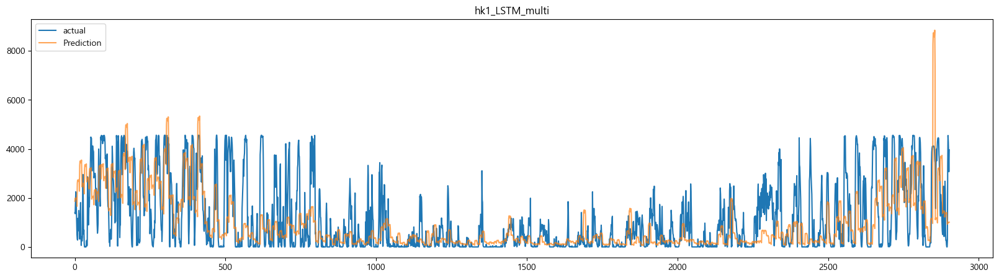

In [1063]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk1_LSTM_multi')

plt.plot(testY_hk1_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk1_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk1_m_re.reshape(-1,1),prediction_hk1_m_re))

# HK2 -onestep

In [1498]:
seed_everything_tf(config.seed)
for past_length in past_lengths:
    # model 정의
    model_name = f"model_hk2_lstm_{past_length}"
    input_shape_var = f"trainX_hk_{past_length}"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(1, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')

# 3일

In [668]:
past_lengths = [22,30,28]

현재  30 학습중
Epoch 1/1000
90/90 [==============================] - 5s 29ms/step - loss: 3341.9214 - val_loss: 3044.9783
Epoch 2/1000
90/90 [==============================] - 2s 23ms/step - loss: 3055.3513 - val_loss: 3020.3337
Epoch 3/1000
90/90 [==============================] - 2s 21ms/step - loss: 2965.8003 - val_loss: 2856.4106
Epoch 4/1000
90/90 [==============================] - 2s 21ms/step - loss: 2905.0625 - val_loss: 2809.3406
Epoch 5/1000
90/90 [==============================] - 2s 21ms/step - loss: 2834.8428 - val_loss: 2828.3188
Epoch 6/1000
90/90 [==============================] - 2s 21ms/step - loss: 2937.5654 - val_loss: 2798.5046
Epoch 7/1000
90/90 [==============================] - 2s 23ms/step - loss: 2821.6536 - val_loss: 2794.4482
Epoch 8/1000
90/90 [==============================] - 2s 22ms/step - loss: 2840.9941 - val_loss: 2779.9509
Epoch 9/1000
90/90 [==============================] - 3s 31ms/step - loss: 2811.2498 - val_loss: 2763.8696
Epoch 10/1000
90/90 [=====

Epoch 77/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 78/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 79/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 80/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 81/1000
90/90 [==============================] - 2s 22ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 82/1000
90/90 [==============================] - 2s 24ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 83/1000
90/90 [==============================] - 2s 26ms/step - loss: 3738.0901 - val_loss: 3493.0786
Epoch 84/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 85/1000
90/90 [==============================] - 2s 21ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 86/1000
90/90 [=======

90/90 [==============================] - 3s 29ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 153/1000
90/90 [==============================] - 2s 22ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 154/1000
90/90 [==============================] - 2s 22ms/step - loss: 3738.0894 - val_loss: 3493.0786
Epoch 155/1000
90/90 [==============================] - 2s 22ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 156/1000
90/90 [==============================] - 2s 23ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 157/1000
90/90 [==============================] - 2s 23ms/step - loss: 3738.0876 - val_loss: 3493.0786
Epoch 158/1000
90/90 [==============================] - 2s 22ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 159/1000
90/90 [==============================] - 2s 26ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 160/1000
90/90 [==============================] - 2s 27ms/step - loss: 3738.0876 - val_loss: 3493.0786
Epoch 161/1000
90/90 [============

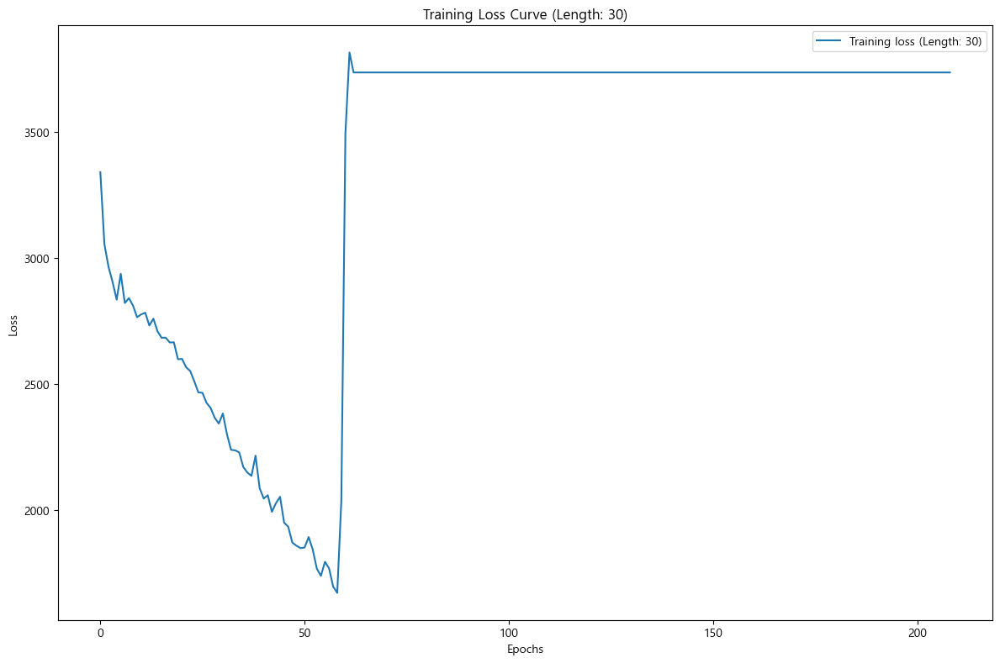

In [667]:
seed_everything_tf(config.seed)
plt.figure(figsize=(12, 8))

for idx, past_length in enumerate(past_lengths, 1):
    # model 정의
    
    model_name = f"model_hk2_lstm_{past_length}"
    input_shape_var = f"trainX_hk2_{past_length}"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(1, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_hk2_lstm_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_hk2_{past_length}"],
                                                        globals()[f"trainY_hk2_{past_length}"],
                                                        validation_data=(globals()[f"validX_hk2_{past_length}"],
                                                                        globals()[f"validY_hk2_{past_length}"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


In [645]:
prediction_hk2_22 = model_hk2_lstm_22.predict(testX_hk2_22) 
for _ in zip(prediction_hk2_22,testY_hk2_22):
    print(_)

91/91 [==============================] - 1s 4ms/step
(array([8252.582], dtype=float32), array([[815.8056667]]))
(array([5439.419], dtype=float32), array([[614.3186667]]))
(array([3265.128], dtype=float32), array([[422.0606667]]))
(array([2899.2795], dtype=float32), array([[1092.855667]]))
(array([2660.4497], dtype=float32), array([[1295.659667]]))
(array([2273.1077], dtype=float32), array([[1305.494]]))
(array([2273.8354], dtype=float32), array([[2220.099]]))
(array([2011.3573], dtype=float32), array([[1574.221333]]))
(array([1531.2667], dtype=float32), array([[1022.135667]]))
(array([7073.9336], dtype=float32), array([[746.5416667]]))
(array([10461.653], dtype=float32), array([[2212.598]]))
(array([10225.095], dtype=float32), array([[2452.279]]))
(array([11930.382], dtype=float32), array([[2941.931667]]))
(array([10738.628], dtype=float32), array([[875.1216667]]))
(array([7638.8115], dtype=float32), array([[250.0353333]]))
(array([6788.7285], dtype=float32), array([[1479.893]]))
(arra

(array([686.7402], dtype=float32), array([[1659.705333]]))
(array([950.67523], dtype=float32), array([[562.3826667]]))
(array([811.9927], dtype=float32), array([[331.8006667]]))
(array([841.0059], dtype=float32), array([[1286.750667]]))
(array([880.6484], dtype=float32), array([[2230.282667]]))
(array([964.21497], dtype=float32), array([[1548.49]]))
(array([881.3176], dtype=float32), array([[183.0613333]]))
(array([893.8089], dtype=float32), array([[867.5596667]]))
(array([887.60754], dtype=float32), array([[55.352]]))
(array([1022.3498], dtype=float32), array([[0.]]))
(array([1313.4386], dtype=float32), array([[367.4486667]]))
(array([1152.3162], dtype=float32), array([[26.78833333]]))
(array([1052.4901], dtype=float32), array([[348.2783333]]))
(array([815.54425], dtype=float32), array([[555.6]]))
(array([521.15924], dtype=float32), array([[1768.326667]]))
(array([409.40015], dtype=float32), array([[483.7113333]]))
(array([428.41162], dtype=float32), array([[328.7426667]]))
(array([54

(array([35.808563], dtype=float32), array([[31.234]]))
(array([52.316006], dtype=float32), array([[0.]]))
(array([127.77094], dtype=float32), array([[0.]]))
(array([471.30707], dtype=float32), array([[0.]]))
(array([1064.6296], dtype=float32), array([[0.]]))
(array([1335.899], dtype=float32), array([[0.]]))
(array([1799.1703], dtype=float32), array([[252.039]]))
(array([2738.584], dtype=float32), array([[355.2996667]]))
(array([2240.4575], dtype=float32), array([[58.18133333]]))
(array([1655.1018], dtype=float32), array([[8.42966667]]))
(array([1333.433], dtype=float32), array([[15.396]]))
(array([1680.0651], dtype=float32), array([[0.]]))
(array([802.6312], dtype=float32), array([[17.32933333]]))
(array([466.4005], dtype=float32), array([[0.]]))
(array([724.6076], dtype=float32), array([[212.133]]))
(array([286.08163], dtype=float32), array([[524.295]]))
(array([798.37726], dtype=float32), array([[0.]]))
(array([769.65436], dtype=float32), array([[0.]]))
(array([1206.7028], dtype=floa

(array([1687.4684], dtype=float32), array([[1493.765]]))
(array([1811.2277], dtype=float32), array([[1671.417]]))
(array([1226.6187], dtype=float32), array([[658.5113333]]))
(array([565.09064], dtype=float32), array([[427.1286667]]))
(array([299.29413], dtype=float32), array([[224.9673333]]))
(array([104.23256], dtype=float32), array([[182.948]]))
(array([109.09558], dtype=float32), array([[358.194]]))
(array([91.57273], dtype=float32), array([[157.5043333]]))
(array([175.6998], dtype=float32), array([[35.63666667]]))
(array([461.13617], dtype=float32), array([[0.]]))
(array([384.32166], dtype=float32), array([[0.]]))
(array([326.3164], dtype=float32), array([[31.96166667]]))
(array([320.62463], dtype=float32), array([[0.]]))
(array([408.70746], dtype=float32), array([[89.24766667]]))
(array([939.28235], dtype=float32), array([[0.]]))
(array([887.5473], dtype=float32), array([[250.728]]))
(array([1156.5612], dtype=float32), array([[413.4053333]]))
(array([954.1761], dtype=float32), arr

In [646]:
print(model_score_test(validY_hk2_22.reshape(-1,1),model_hk2_lstm_22.predict(validX_hk2_22)))

91/91 [==============================] - 0s 4ms/step
R2 score: 0.10902856660062821
MAE Loss:  2590.494370968345
(0.10902856660062821, 2590.494370968345)


R2 score: -0.10273317332208753
MAE Loss:  2382.390720386411
(-0.10273317332208753, 2382.390720386411)


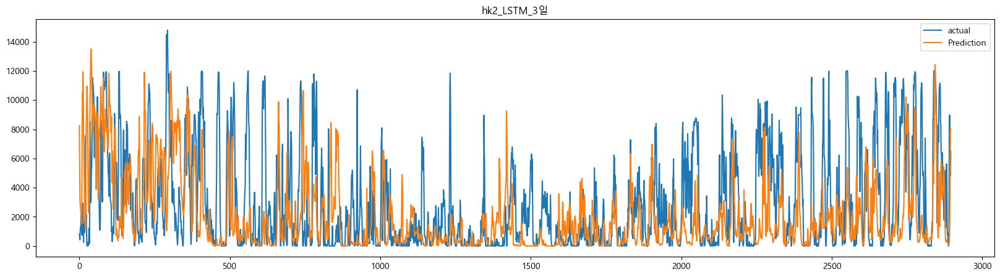

In [647]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_3일')

plt.plot(testY_hk2_22[n:m].reshape(-1,1),label = 'actual')
plt.plot(prediction_hk2_22[n:m], label = 'Prediction')
# plt.ylim(0,4500)
plt.legend()
print(model_score_test(testY_hk2_22.reshape(-1,1),prediction_hk2_22))

In [669]:
prediction_hk2_30 = model_hk2_lstm_30.predict(testX_hk2_30) 
for _ in zip(prediction_hk2_30,testY_hk2_30):
    print(_)

91/91 [==============================] - 1s 5ms/step
(array([3672.6409], dtype=float32), array([[1022.135667]]))
(array([3962.724], dtype=float32), array([[746.5416667]]))
(array([4525.301], dtype=float32), array([[2212.598]]))
(array([5141.972], dtype=float32), array([[2452.279]]))
(array([5731.7163], dtype=float32), array([[2941.931667]]))
(array([6189.7446], dtype=float32), array([[875.1216667]]))
(array([6606.3394], dtype=float32), array([[250.0353333]]))
(array([6597.841], dtype=float32), array([[1479.893]]))
(array([6087.7847], dtype=float32), array([[1217.027333]]))
(array([6989.4897], dtype=float32), array([[927.0866667]]))
(array([7952.108], dtype=float32), array([[1577.488333]]))
(array([8030.3257], dtype=float32), array([[6235.204333]]))
(array([8307.144], dtype=float32), array([[7556.409333]]))
(array([8588.2295], dtype=float32), array([[4068.469667]]))
(array([8576.941], dtype=float32), array([[1769.049333]]))
(array([8126.0845], dtype=float32), array([[2132.917667]]))
(ar

(array([3637.4822], dtype=float32), array([[731.6663333]]))
(array([3765.598], dtype=float32), array([[116.5946667]]))
(array([3902.2095], dtype=float32), array([[394.7226667]]))
(array([3856.926], dtype=float32), array([[1634.598]]))
(array([3879.4258], dtype=float32), array([[6103.233]]))
(array([3585.3438], dtype=float32), array([[7630.196333]]))
(array([3306.304], dtype=float32), array([[5752.228]]))
(array([3456.111], dtype=float32), array([[5486.465]]))
(array([3602.1184], dtype=float32), array([[5698.384333]]))
(array([3684.8894], dtype=float32), array([[5984.758]]))
(array([3724.0525], dtype=float32), array([[6248.043667]]))
(array([3696.1404], dtype=float32), array([[8316.321333]]))
(array([3463.952], dtype=float32), array([[9002.177667]]))
(array([3159.4856], dtype=float32), array([[9005.87]]))
(array([2924.5383], dtype=float32), array([[9001.857]]))
(array([3013.403], dtype=float32), array([[8636.174667]]))
(array([3248.9387], dtype=float32), array([[7952.044]]))
(array([348

(array([748.54376], dtype=float32), array([[252.039]]))
(array([754.36505], dtype=float32), array([[355.2996667]]))
(array([823.1308], dtype=float32), array([[58.18133333]]))
(array([919.12994], dtype=float32), array([[8.42966667]]))
(array([1001.34143], dtype=float32), array([[15.396]]))
(array([1046.7656], dtype=float32), array([[0.]]))
(array([990.9198], dtype=float32), array([[17.32933333]]))
(array([930.02203], dtype=float32), array([[0.]]))
(array([899.67395], dtype=float32), array([[212.133]]))
(array([872.6789], dtype=float32), array([[524.295]]))
(array([840.715], dtype=float32), array([[0.]]))
(array([799.821], dtype=float32), array([[0.]]))
(array([775.09186], dtype=float32), array([[0.]]))
(array([768.67], dtype=float32), array([[0.05466667]]))
(array([769.966], dtype=float32), array([[173.1013333]]))
(array([760.1663], dtype=float32), array([[486.975]]))
(array([754.3128], dtype=float32), array([[373.6976667]]))
(array([758.451], dtype=float32), array([[410.33]]))
(array([

(array([732.88116], dtype=float32), array([[3699.124]]))
(array([783.5091], dtype=float32), array([[2877.600667]]))
(array([743.3506], dtype=float32), array([[585.9956667]]))
(array([783.7994], dtype=float32), array([[69.65666667]]))
(array([862.2753], dtype=float32), array([[299.5336667]]))
(array([984.4073], dtype=float32), array([[2.20033333]]))
(array([977.58624], dtype=float32), array([[0.]]))
(array([968.66595], dtype=float32), array([[61.178]]))
(array([963.1804], dtype=float32), array([[53.88333333]]))
(array([955.5312], dtype=float32), array([[72.116]]))
(array([905.4064], dtype=float32), array([[0.]]))
(array([913.0788], dtype=float32), array([[0.]]))
(array([938.972], dtype=float32), array([[0.]]))
(array([938.7704], dtype=float32), array([[421.4843333]]))
(array([901.8378], dtype=float32), array([[8.764]]))
(array([858.1443], dtype=float32), array([[0.]]))
(array([822.44385], dtype=float32), array([[0.]]))
(array([833.5091], dtype=float32), array([[4.29266667]]))
(array([78

(array([3836.7957], dtype=float32), array([[9188.382333]]))
(array([3725.56], dtype=float32), array([[9733.095667]]))
(array([3477.78], dtype=float32), array([[7483.927667]]))
(array([3518.8594], dtype=float32), array([[7764.033333]]))
(array([3578.7317], dtype=float32), array([[5334.528667]]))
(array([3590.1362], dtype=float32), array([[3209.375333]]))
(array([3537.7712], dtype=float32), array([[1136.823333]]))
(array([3583.307], dtype=float32), array([[506.0063333]]))
(array([3600.4785], dtype=float32), array([[429.2556667]]))
(array([3848.5496], dtype=float32), array([[632.7203333]]))
(array([4187.244], dtype=float32), array([[1392.473]]))
(array([4649.2134], dtype=float32), array([[1598.799]]))
(array([5086.841], dtype=float32), array([[1382.723333]]))
(array([5537.048], dtype=float32), array([[2446.142]]))
(array([5613.984], dtype=float32), array([[5129.949333]]))
(array([5732.655], dtype=float32), array([[7542.255333]]))
(array([5793.19], dtype=float32), array([[4818.156]]))
(arr

In [670]:
print(model_score_test(validY_hk2_30.reshape(-1,1),model_hk2_lstm_30.predict(validX_hk2_30)))

91/91 [==============================] - 0s 5ms/step
R2 score: 0.09777188183016683
MAE Loss:  2763.869811807393
(0.09777188183016683, 2763.869811807393)


R2 score: 0.07595949842396532
MAE Loss:  2320.8899460476623
(0.07595949842396532, 2320.8899460476623)


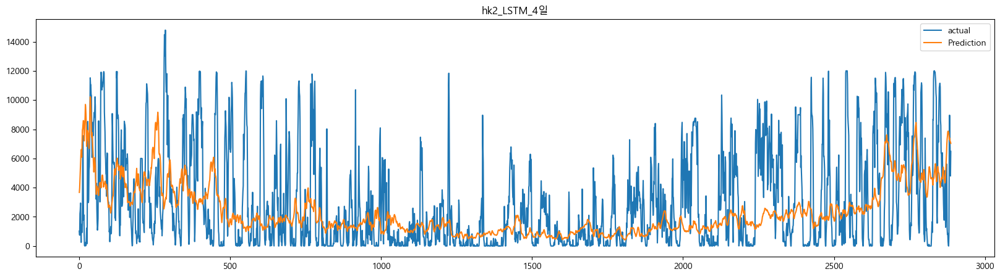

In [671]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_4일')

plt.plot(testY_hk2_30[n:m].reshape(-1,1),label = 'actual')
plt.plot(prediction_hk2_30[n:m], label = 'Prediction')
# plt.ylim(0,4500)
plt.legend()
print(model_score_test(testY_hk2_30.reshape(-1,1),prediction_hk2_30))

In [651]:
prediction_hk2_38 = model_hk2_lstm_38.predict(testX_hk2_38) 
for _ in zip(prediction_hk2_38,testY_hk2_38):
    print(_)

91/91 [==============================] - 1s 6ms/step
(array([4243.796], dtype=float32), array([[1217.027333]]))
(array([4376.826], dtype=float32), array([[927.0866667]]))
(array([4348.2573], dtype=float32), array([[1577.488333]]))
(array([4492.264], dtype=float32), array([[6235.204333]]))
(array([4461.154], dtype=float32), array([[7556.409333]]))
(array([4219.055], dtype=float32), array([[4068.469667]]))
(array([3589.0852], dtype=float32), array([[1769.049333]]))
(array([3466.9534], dtype=float32), array([[2132.917667]]))
(array([3459.738], dtype=float32), array([[827.5123333]]))
(array([3825.4758], dtype=float32), array([[34.78066667]]))
(array([4146.601], dtype=float32), array([[10.52966667]]))
(array([4424.3467], dtype=float32), array([[0.]]))
(array([4189.793], dtype=float32), array([[228.3656667]]))
(array([3883.5076], dtype=float32), array([[108.9233333]]))
(array([3696.6575], dtype=float32), array([[27.59433333]]))
(array([3055.5278], dtype=float32), array([[368.4503333]]))
(arr

(array([603.83624], dtype=float32), array([[31.234]]))
(array([549.8325], dtype=float32), array([[0.]]))
(array([514.8784], dtype=float32), array([[0.]]))
(array([460.4519], dtype=float32), array([[0.]]))
(array([428.99384], dtype=float32), array([[0.]]))
(array([412.83618], dtype=float32), array([[0.]]))
(array([440.4145], dtype=float32), array([[252.039]]))
(array([442.98862], dtype=float32), array([[355.2996667]]))
(array([464.98923], dtype=float32), array([[58.18133333]]))
(array([482.0874], dtype=float32), array([[8.42966667]]))
(array([499.80222], dtype=float32), array([[15.396]]))
(array([507.21332], dtype=float32), array([[0.]]))
(array([554.0924], dtype=float32), array([[17.32933333]]))
(array([609.8749], dtype=float32), array([[0.]]))
(array([672.8735], dtype=float32), array([[212.133]]))
(array([748.6432], dtype=float32), array([[524.295]]))
(array([818.9466], dtype=float32), array([[0.]]))
(array([880.89514], dtype=float32), array([[0.]]))
(array([915.25183], dtype=float32)

(array([129.96138], dtype=float32), array([[46.93133333]]))
(array([137.55899], dtype=float32), array([[121.7323333]]))
(array([144.80933], dtype=float32), array([[46.56266667]]))
(array([154.48633], dtype=float32), array([[131.637]]))
(array([162.34833], dtype=float32), array([[122.0863333]]))
(array([164.40546], dtype=float32), array([[90.95166667]]))
(array([166.38754], dtype=float32), array([[470.3086667]]))
(array([183.7922], dtype=float32), array([[567.9796667]]))
(array([203.95374], dtype=float32), array([[352.9216667]]))
(array([227.67352], dtype=float32), array([[305.1636667]]))
(array([254.56277], dtype=float32), array([[720.7523333]]))
(array([274.9322], dtype=float32), array([[2099.025667]]))
(array([294.7068], dtype=float32), array([[3699.124]]))
(array([317.87573], dtype=float32), array([[2877.600667]]))
(array([333.22025], dtype=float32), array([[585.9956667]]))
(array([383.01526], dtype=float32), array([[69.65666667]]))
(array([442.76007], dtype=float32), array([[299.53

(array([1062.3486], dtype=float32), array([[427.1286667]]))
(array([1054.8226], dtype=float32), array([[224.9673333]]))
(array([1043.8811], dtype=float32), array([[182.948]]))
(array([1010.83716], dtype=float32), array([[358.194]]))
(array([972.7274], dtype=float32), array([[157.5043333]]))
(array([946.57947], dtype=float32), array([[35.63666667]]))
(array([946.9882], dtype=float32), array([[0.]]))
(array([966.8805], dtype=float32), array([[0.]]))
(array([1020.44916], dtype=float32), array([[31.96166667]]))
(array([1063.1262], dtype=float32), array([[0.]]))
(array([1111.2715], dtype=float32), array([[89.24766667]]))
(array([1146.3745], dtype=float32), array([[0.]]))
(array([1227.1487], dtype=float32), array([[250.728]]))
(array([1288.6101], dtype=float32), array([[413.4053333]]))
(array([1281.6257], dtype=float32), array([[966.2206667]]))
(array([1307.4583], dtype=float32), array([[2111.827]]))
(array([1396.611], dtype=float32), array([[2186.263667]]))
(array([1505.0347], dtype=float32

(array([2907.7498], dtype=float32), array([[11402.17567]]))
(array([3350.4375], dtype=float32), array([[11469.93267]]))
(array([3635.1775], dtype=float32), array([[10826.479]]))
(array([3675.261], dtype=float32), array([[9190.806667]]))
(array([3346.4814], dtype=float32), array([[8344.007]]))
(array([2788.4988], dtype=float32), array([[5873.388667]]))
(array([2297.0872], dtype=float32), array([[7095.809]]))
(array([2140.7952], dtype=float32), array([[8794.556333]]))
(array([2205.4968], dtype=float32), array([[6321.199]]))
(array([2126.9548], dtype=float32), array([[3697.351]]))
(array([1967.3154], dtype=float32), array([[4968.102]]))
(array([1734.1113], dtype=float32), array([[7785.548333]]))
(array([1471.8812], dtype=float32), array([[6604.873]]))
(array([1335.5684], dtype=float32), array([[8850.741333]]))
(array([1260.3826], dtype=float32), array([[8951.581333]]))
(array([1160.7029], dtype=float32), array([[9188.382333]]))
(array([1142.7627], dtype=float32), array([[9733.095667]]))
(

In [652]:
print(model_score_test(validY_hk2_38.reshape(-1,1),model_hk2_lstm_38.predict(validX_hk2_38)))

91/91 [==============================] - 1s 6ms/step
R2 score: -0.07493424707744634
MAE Loss:  2873.520183153141
(-0.07493424707744634, 2873.520183153141)


R2 score: -0.046044033681649665
MAE Loss:  2370.046117597308
(-0.046044033681649665, 2370.046117597308)


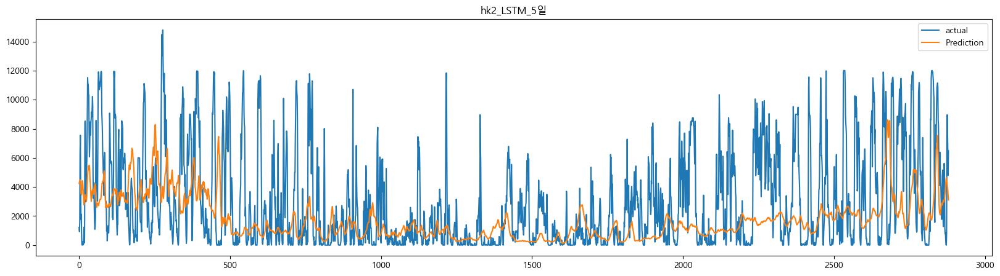

In [653]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_5일')

plt.plot(testY_hk2_38[n:m].reshape(-1,1),label = 'actual')
plt.plot(prediction_hk2_38[n:m], label = 'Prediction')
# plt.ylim(0,4500)
plt.legend()
print(model_score_test(testY_hk2_38.reshape(-1,1),prediction_hk2_38))

In [654]:
seed_everything_tf(config.seed)
model_hk2_lstm = Sequential()
model_hk2_lstm.add(LSTM(64, activation='relu', input_shape=(trainX_hk2_30.shape[1], trainX_hk2_30.shape[2]),return_sequences=True))
                          #return_sequences=True))
model_hk2_lstm.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_hk2_lstm.add(Dropout(0.2))
model_hk2_lstm.add(Flatten())
model_hk2_lstm.add(Dense(1, activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))
model_hk2_lstm.compile(optimizer='adam', loss='mae')

Epoch 1/1000
90/90 [==============================] - 4s 28ms/step - loss: 3341.9214 - val_loss: 3044.9783
Epoch 2/1000
90/90 [==============================] - 3s 29ms/step - loss: 3055.3513 - val_loss: 3020.3337
Epoch 3/1000
90/90 [==============================] - 2s 22ms/step - loss: 2965.8003 - val_loss: 2856.4106
Epoch 4/1000
90/90 [==============================] - 2s 22ms/step - loss: 2905.0625 - val_loss: 2809.3406
Epoch 5/1000
90/90 [==============================] - 2s 23ms/step - loss: 2834.8428 - val_loss: 2828.3188
Epoch 6/1000
90/90 [==============================] - 2s 22ms/step - loss: 2937.5654 - val_loss: 2798.5046
Epoch 7/1000
90/90 [==============================] - 2s 22ms/step - loss: 2821.6536 - val_loss: 2794.4482
Epoch 8/1000
90/90 [==============================] - 2s 22ms/step - loss: 2840.9941 - val_loss: 2779.9509
Epoch 9/1000
90/90 [==============================] - 2s 25ms/step - loss: 2811.2498 - val_loss: 2763.8696
Epoch 10/1000
90/90 [================

Epoch 77/1000
90/90 [==============================] - 2s 24ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 78/1000
90/90 [==============================] - 2s 24ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 79/1000
90/90 [==============================] - 2s 24ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 80/1000
90/90 [==============================] - 2s 23ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 81/1000
90/90 [==============================] - 2s 24ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 82/1000
90/90 [==============================] - 2s 26ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 83/1000
90/90 [==============================] - 3s 32ms/step - loss: 3738.0901 - val_loss: 3493.0786
Epoch 84/1000
90/90 [==============================] - 2s 23ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 85/1000
90/90 [==============================] - 2s 23ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 86/1000
90/90 [=======

90/90 [==============================] - 2s 25ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 153/1000
90/90 [==============================] - 2s 25ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 154/1000
90/90 [==============================] - 2s 28ms/step - loss: 3738.0894 - val_loss: 3493.0786
Epoch 155/1000
90/90 [==============================] - 2s 27ms/step - loss: 3738.0884 - val_loss: 3493.0786
Epoch 156/1000
90/90 [==============================] - 2s 26ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 157/1000
90/90 [==============================] - 2s 25ms/step - loss: 3738.0876 - val_loss: 3493.0786
Epoch 158/1000
90/90 [==============================] - 2s 25ms/step - loss: 3738.0891 - val_loss: 3493.0786
Epoch 159/1000
90/90 [==============================] - 2s 25ms/step - loss: 3738.0889 - val_loss: 3493.0786
Epoch 160/1000
90/90 [==============================] - 2s 25ms/step - loss: 3738.0876 - val_loss: 3493.0786
Epoch 161/1000
90/90 [============

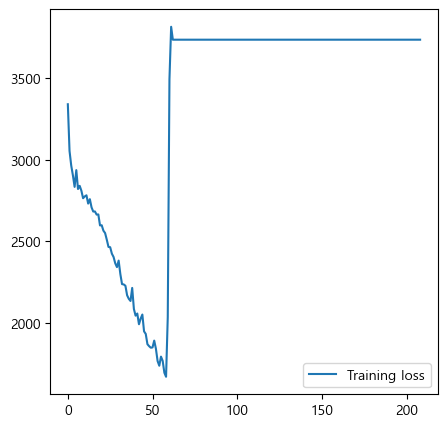

In [656]:
seed_everything_tf(config.seed)

history_hk2_lstm = model_hk2_lstm.fit(trainX_hk2_30, trainY_hk2_30,validation_data = (validX_hk2_30,validY_hk2_30) ,epochs=1000, batch_size=64,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk2_lstm.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [662]:
prediction_hk2 = model_hk2_lstm.predict(testX_hk2_30) 
for _ in zip(prediction_hk2,testY_hk2_30):
    print(_)

91/91 [==============================] - 1s 6ms/step
(array([3672.6409], dtype=float32), array([[1022.135667]]))
(array([3962.724], dtype=float32), array([[746.5416667]]))
(array([4525.301], dtype=float32), array([[2212.598]]))
(array([5141.972], dtype=float32), array([[2452.279]]))
(array([5731.7163], dtype=float32), array([[2941.931667]]))
(array([6189.7446], dtype=float32), array([[875.1216667]]))
(array([6606.3394], dtype=float32), array([[250.0353333]]))
(array([6597.841], dtype=float32), array([[1479.893]]))
(array([6087.7847], dtype=float32), array([[1217.027333]]))
(array([6989.4897], dtype=float32), array([[927.0866667]]))
(array([7952.108], dtype=float32), array([[1577.488333]]))
(array([8030.3257], dtype=float32), array([[6235.204333]]))
(array([8307.144], dtype=float32), array([[7556.409333]]))
(array([8588.2295], dtype=float32), array([[4068.469667]]))
(array([8576.941], dtype=float32), array([[1769.049333]]))
(array([8126.0845], dtype=float32), array([[2132.917667]]))
(ar

(array([2974.203], dtype=float32), array([[8125.186]]))
(array([2882.9329], dtype=float32), array([[8536.664667]]))
(array([3147.382], dtype=float32), array([[4242.259667]]))
(array([3282.7766], dtype=float32), array([[2868.808]]))
(array([3299.9736], dtype=float32), array([[2724.564]]))
(array([3361.3052], dtype=float32), array([[2329.556333]]))
(array([3405.9636], dtype=float32), array([[1466.293333]]))
(array([3415.4985], dtype=float32), array([[1520.296333]]))
(array([3367.9573], dtype=float32), array([[1980.04]]))
(array([3217.22], dtype=float32), array([[2571.335333]]))
(array([3380.2927], dtype=float32), array([[3956.478333]]))
(array([3492.3855], dtype=float32), array([[2759.486333]]))
(array([3687.4731], dtype=float32), array([[2346.667667]]))
(array([3600.055], dtype=float32), array([[1351.532333]]))
(array([3508.7256], dtype=float32), array([[1197.066]]))
(array([3539.9714], dtype=float32), array([[488.3056667]]))
(array([3372.6216], dtype=float32), array([[579.3896667]]))
(

(array([1121.3625], dtype=float32), array([[2716.447333]]))
(array([1159.908], dtype=float32), array([[1362.586]]))
(array([1125.2932], dtype=float32), array([[1426.854]]))
(array([1147.9805], dtype=float32), array([[793.3823333]]))
(array([1186.892], dtype=float32), array([[0.]]))
(array([1249.2545], dtype=float32), array([[77.95066667]]))
(array([1319.2302], dtype=float32), array([[1497.25]]))
(array([1286.6396], dtype=float32), array([[1401.976333]]))
(array([1252.041], dtype=float32), array([[1148.394333]]))
(array([1293.5366], dtype=float32), array([[1687.222333]]))
(array([1328.7439], dtype=float32), array([[1741.039333]]))
(array([1352.7452], dtype=float32), array([[1458.883]]))
(array([1352.7605], dtype=float32), array([[2806.035]]))
(array([1340.8843], dtype=float32), array([[1898.729333]]))
(array([1341.6294], dtype=float32), array([[2316.753]]))
(array([1296.2498], dtype=float32), array([[3406.968]]))
(array([1251.1895], dtype=float32), array([[2993.003]]))
(array([1264.6815

In [659]:
print(model_score_test(validY_hk2_30.reshape(-1,1),model_hk2_lstm.predict(validX_hk2_30)))

91/91 [==============================] - 1s 10ms/step
R2 score: 0.09777188183016683
MAE Loss:  2763.869811807393
(0.09777188183016683, 2763.869811807393)


R2 score: 0.07595949842396532
MAE Loss:  2320.8899460476623
(0.07595949842396532, 2320.8899460476623)


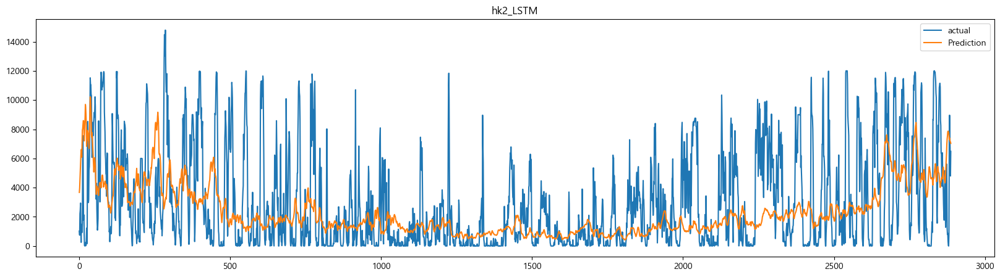

In [664]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM')

plt.plot(testY_hk2_30[n:m].reshape(-1,1),label = 'actual')
plt.plot(prediction_hk2[n:m], label = 'Prediction')
# plt.ylim(0,4500)
plt.legend()
print(model_score_test(testY_hk2_30.reshape(-1,1),prediction_hk2))

# Hk2 -multi

In [1649]:
trainX_hk2_15_m.shape

(714, 24, 12)

In [1650]:
trainX_hk2_23_m.shape

(714, 24, 12)

In [1651]:
trainX_hk2_31_m.shape

(714, 24, 12)

현재  15 학습중
Epoch 1/1000
12/12 [==============================] - 3s 50ms/step - loss: 3747.4973 - val_loss: 3480.4263
Epoch 2/1000
12/12 [==============================] - 0s 19ms/step - loss: 3664.9814 - val_loss: 3215.1416
Epoch 3/1000
12/12 [==============================] - 0s 19ms/step - loss: 3394.7720 - val_loss: 3132.3311
Epoch 4/1000
12/12 [==============================] - 0s 19ms/step - loss: 3264.1885 - val_loss: 3018.5640
Epoch 5/1000
12/12 [==============================] - 0s 25ms/step - loss: 3138.9265 - val_loss: 2981.1116
Epoch 6/1000
12/12 [==============================] - 0s 25ms/step - loss: 3179.6619 - val_loss: 3217.8523
Epoch 7/1000
12/12 [==============================] - 0s 25ms/step - loss: 3097.0095 - val_loss: 3007.2061
Epoch 8/1000
12/12 [==============================] - 0s 27ms/step - loss: 3107.8855 - val_loss: 2948.4790
Epoch 9/1000
12/12 [==============================] - 0s 27ms/step - loss: 3093.0269 - val_loss: 2972.3826
Epoch 10/1000
12/12 [=====

Epoch 77/1000
12/12 [==============================] - 0s 24ms/step - loss: 2565.4531 - val_loss: 3026.9873
Epoch 78/1000
12/12 [==============================] - 0s 23ms/step - loss: 2594.7837 - val_loss: 2983.9958
Epoch 79/1000
12/12 [==============================] - 0s 21ms/step - loss: 2561.2227 - val_loss: 2947.6882
Epoch 80/1000
12/12 [==============================] - 0s 23ms/step - loss: 2550.8835 - val_loss: 2918.2949
Epoch 81/1000
12/12 [==============================] - 0s 23ms/step - loss: 2564.6257 - val_loss: 2871.1277
Epoch 82/1000
12/12 [==============================] - 0s 19ms/step - loss: 2601.9338 - val_loss: 2871.8435
Epoch 83/1000
12/12 [==============================] - 0s 19ms/step - loss: 2546.4055 - val_loss: 3067.2075
Epoch 84/1000
12/12 [==============================] - 0s 19ms/step - loss: 2551.7837 - val_loss: 3049.0945
Epoch 85/1000
12/12 [==============================] - 0s 19ms/step - loss: 2531.0627 - val_loss: 2924.4155
Epoch 86/1000
12/12 [=======

12/12 [==============================] - 0s 19ms/step - loss: 2421.7349 - val_loss: 3073.3311
Epoch 153/1000
12/12 [==============================] - 0s 19ms/step - loss: 2417.2075 - val_loss: 2891.8806
Epoch 154/1000
12/12 [==============================] - 0s 19ms/step - loss: 2442.6665 - val_loss: 2854.8550
Epoch 155/1000
12/12 [==============================] - 0s 19ms/step - loss: 2363.5728 - val_loss: 2921.0928
Epoch 156/1000
12/12 [==============================] - 0s 19ms/step - loss: 2330.6929 - val_loss: 2864.0420
Epoch 157/1000
12/12 [==============================] - 0s 20ms/step - loss: 2310.2219 - val_loss: 2943.2334
Epoch 158/1000
12/12 [==============================] - 0s 19ms/step - loss: 2289.8801 - val_loss: 2821.3069
Epoch 159/1000
12/12 [==============================] - 0s 19ms/step - loss: 2331.0100 - val_loss: 2945.4922
Epoch 160/1000
12/12 [==============================] - 0s 19ms/step - loss: 2301.4827 - val_loss: 2961.1064
Epoch 161/1000
12/12 [============

12/12 [==============================] - 0s 19ms/step - loss: 2098.1238 - val_loss: 2793.6975
Epoch 228/1000
12/12 [==============================] - 0s 19ms/step - loss: 2033.6746 - val_loss: 2807.0752
Epoch 229/1000
12/12 [==============================] - 0s 19ms/step - loss: 2068.5144 - val_loss: 2925.0979
Epoch 230/1000
12/12 [==============================] - 0s 19ms/step - loss: 2038.0138 - val_loss: 2889.3818
Epoch 231/1000
12/12 [==============================] - 0s 19ms/step - loss: 2018.8872 - val_loss: 2801.8896
Epoch 232/1000
12/12 [==============================] - 0s 20ms/step - loss: 2135.7373 - val_loss: 2936.7498
Epoch 233/1000
12/12 [==============================] - 0s 19ms/step - loss: 2180.4026 - val_loss: 2764.7502
Epoch 234/1000
12/12 [==============================] - 0s 19ms/step - loss: 2057.9224 - val_loss: 2998.7920
Epoch 235/1000
12/12 [==============================] - 0s 19ms/step - loss: 2082.8477 - val_loss: 2731.3242
Epoch 236/1000
12/12 [============

12/12 [==============================] - 0s 20ms/step - loss: 1866.4441 - val_loss: 2722.4858
Epoch 303/1000
12/12 [==============================] - 0s 19ms/step - loss: 1851.9358 - val_loss: 2817.0278
Epoch 304/1000
12/12 [==============================] - 0s 19ms/step - loss: 1816.9991 - val_loss: 2767.0999
Epoch 305/1000
12/12 [==============================] - 0s 19ms/step - loss: 1816.6003 - val_loss: 2797.0640
Epoch 306/1000
12/12 [==============================] - 0s 20ms/step - loss: 1822.5142 - val_loss: 2750.4194
Epoch 307/1000
12/12 [==============================] - 0s 19ms/step - loss: 1889.0944 - val_loss: 2683.3237
Epoch 308/1000
12/12 [==============================] - 0s 19ms/step - loss: 1880.3097 - val_loss: 2698.5159
Epoch 309/1000
12/12 [==============================] - 0s 19ms/step - loss: 1887.7211 - val_loss: 2777.3857
Epoch 310/1000
12/12 [==============================] - 0s 19ms/step - loss: 1872.7428 - val_loss: 2898.1133
Epoch 311/1000
12/12 [============

12/12 [==============================] - 0s 20ms/step - loss: 2820.3704 - val_loss: 3134.0403
Epoch 378/1000
12/12 [==============================] - 0s 20ms/step - loss: 2770.3491 - val_loss: 3018.1050
Epoch 379/1000
12/12 [==============================] - 0s 20ms/step - loss: 2818.2556 - val_loss: 3124.4407
Epoch 380/1000
12/12 [==============================] - 0s 20ms/step - loss: 2792.8164 - val_loss: 2998.9409
Epoch 381/1000
12/12 [==============================] - 0s 20ms/step - loss: 2786.0015 - val_loss: 3136.1316
Epoch 382/1000
12/12 [==============================] - 0s 20ms/step - loss: 2790.8542 - val_loss: 3264.6067
Epoch 383/1000
12/12 [==============================] - 0s 20ms/step - loss: 2777.7144 - val_loss: 3099.0103
Epoch 384/1000
12/12 [==============================] - 0s 20ms/step - loss: 2767.2456 - val_loss: 3128.9761
Epoch 385/1000
12/12 [==============================] - 0s 23ms/step - loss: 2749.9590 - val_loss: 3040.7002
Epoch 386/1000
12/12 [============

12/12 [==============================] - 0s 20ms/step - loss: 2489.8154 - val_loss: 3194.3445
Epoch 453/1000
12/12 [==============================] - 0s 20ms/step - loss: 2489.2368 - val_loss: 3274.5515
Epoch 454/1000
12/12 [==============================] - 0s 20ms/step - loss: 2483.5679 - val_loss: 3176.1582
Epoch 455/1000
12/12 [==============================] - 0s 20ms/step - loss: 2477.3926 - val_loss: 3341.4614
Epoch 456/1000
12/12 [==============================] - 0s 20ms/step - loss: 2456.1680 - val_loss: 3528.3250
Epoch 457/1000
12/12 [==============================] - 0s 20ms/step - loss: 2507.5557 - val_loss: 3326.1545
Epoch 458/1000
12/12 [==============================] - 0s 20ms/step - loss: 2453.0437 - val_loss: 2970.1462
Epoch 459/1000
12/12 [==============================] - 0s 20ms/step - loss: 2560.3018 - val_loss: 3272.2549
Epoch 460/1000
12/12 [==============================] - 0s 20ms/step - loss: 2704.0251 - val_loss: 3157.8406
Epoch 461/1000
12/12 [============

12/12 [==============================] - 0s 20ms/step - loss: 2314.9199 - val_loss: 3312.9729
Epoch 528/1000
12/12 [==============================] - 0s 21ms/step - loss: 2236.4854 - val_loss: 3238.4221
Epoch 529/1000
12/12 [==============================] - 0s 21ms/step - loss: 2225.4360 - val_loss: 3212.2424
현재  23 학습중
Epoch 1/1000
12/12 [==============================] - 3s 55ms/step - loss: 3740.3088 - val_loss: 3490.3828
Epoch 2/1000
12/12 [==============================] - 0s 29ms/step - loss: 3697.1621 - val_loss: 3376.4456
Epoch 3/1000
12/12 [==============================] - 0s 29ms/step - loss: 3624.6067 - val_loss: 3368.1250
Epoch 4/1000
12/12 [==============================] - 0s 27ms/step - loss: 3519.3398 - val_loss: 3303.1838
Epoch 5/1000
12/12 [==============================] - 0s 27ms/step - loss: 3332.9885 - val_loss: 3216.5337
Epoch 6/1000
12/12 [==============================] - 0s 30ms/step - loss: 3455.4912 - val_loss: 3262.3975
Epoch 7/1000
12/12 [===============

Epoch 74/1000
12/12 [==============================] - 0s 23ms/step - loss: 2768.0940 - val_loss: 2847.5962
Epoch 75/1000
12/12 [==============================] - 0s 23ms/step - loss: 2721.2180 - val_loss: 2827.0417
Epoch 76/1000
12/12 [==============================] - 0s 23ms/step - loss: 2689.7559 - val_loss: 2866.1213
Epoch 77/1000
12/12 [==============================] - 0s 23ms/step - loss: 2719.4487 - val_loss: 2845.0212
Epoch 78/1000
12/12 [==============================] - 0s 23ms/step - loss: 2656.6777 - val_loss: 2818.6604
Epoch 79/1000
12/12 [==============================] - 0s 22ms/step - loss: 2604.1526 - val_loss: 2856.9883
Epoch 80/1000
12/12 [==============================] - 0s 23ms/step - loss: 2637.5613 - val_loss: 2867.0547
Epoch 81/1000
12/12 [==============================] - 0s 23ms/step - loss: 2605.0645 - val_loss: 2835.5791
Epoch 82/1000
12/12 [==============================] - 0s 23ms/step - loss: 2648.1270 - val_loss: 2878.9841
Epoch 83/1000
12/12 [=======

12/12 [==============================] - 0s 23ms/step - loss: 2348.3281 - val_loss: 3110.5715
Epoch 150/1000
12/12 [==============================] - 0s 23ms/step - loss: 2298.5671 - val_loss: 3121.6562
Epoch 151/1000
12/12 [==============================] - 0s 23ms/step - loss: 2290.5593 - val_loss: 3023.9126
Epoch 152/1000
12/12 [==============================] - 0s 23ms/step - loss: 2270.0493 - val_loss: 2985.3840
Epoch 153/1000
12/12 [==============================] - 0s 23ms/step - loss: 2263.2273 - val_loss: 3063.9348
Epoch 154/1000
12/12 [==============================] - 0s 23ms/step - loss: 2253.0432 - val_loss: 2952.7952
Epoch 155/1000
12/12 [==============================] - 0s 23ms/step - loss: 2238.7476 - val_loss: 2889.3313
Epoch 156/1000
12/12 [==============================] - 0s 23ms/step - loss: 2323.7517 - val_loss: 3087.5195
Epoch 157/1000
12/12 [==============================] - 0s 23ms/step - loss: 2531.7720 - val_loss: 2915.3450
Epoch 158/1000
12/12 [============

12/12 [==============================] - 0s 23ms/step - loss: 3106.0505 - val_loss: 2988.0120
Epoch 225/1000
12/12 [==============================] - 0s 28ms/step - loss: 3078.0288 - val_loss: 2956.0127
Epoch 226/1000
12/12 [==============================] - 0s 27ms/step - loss: 3032.0547 - val_loss: 2946.0488
Epoch 227/1000
12/12 [==============================] - 0s 29ms/step - loss: 3059.8899 - val_loss: 2949.6672
Epoch 228/1000
12/12 [==============================] - 0s 28ms/step - loss: 3024.4871 - val_loss: 2961.1619
Epoch 229/1000
12/12 [==============================] - 0s 28ms/step - loss: 2996.7566 - val_loss: 2926.7917
Epoch 230/1000
12/12 [==============================] - 0s 27ms/step - loss: 2991.8865 - val_loss: 2917.4839
Epoch 231/1000
12/12 [==============================] - 0s 29ms/step - loss: 3099.8796 - val_loss: 2953.5276
Epoch 232/1000
12/12 [==============================] - 0s 29ms/step - loss: 3029.6770 - val_loss: 2921.1545
Epoch 233/1000
12/12 [============

12/12 [==============================] - 0s 26ms/step - loss: 3733.8010 - val_loss: 3492.8086
Epoch 33/1000
12/12 [==============================] - 0s 32ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 34/1000
12/12 [==============================] - 0s 26ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 35/1000
12/12 [==============================] - 0s 26ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 36/1000
12/12 [==============================] - 0s 26ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 37/1000
12/12 [==============================] - 0s 26ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 38/1000
12/12 [==============================] - 0s 29ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 39/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 40/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 41/1000
12/12 [=====================

Epoch 108/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 109/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 110/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 111/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 112/1000
12/12 [==============================] - 0s 31ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 113/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 114/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 115/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 116/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 117/1000
12/1

12/12 [==============================] - 0s 29ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 184/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 185/1000
12/12 [==============================] - 0s 30ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 186/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 187/1000
12/12 [==============================] - 0s 28ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 188/1000
12/12 [==============================] - 0s 27ms/step - loss: 3733.8015 - val_loss: 3492.8086
Epoch 189/1000
12/12 [==============================] - 0s 31ms/step - loss: 3733.8020 - val_loss: 3492.8086
Epoch 190/1000
12/12 [==============================] - 0s 33ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 191/1000
12/12 [==============================] - 0s 34ms/step - loss: 3733.8013 - val_loss: 3492.8086
Epoch 192/1000
12/12 [============

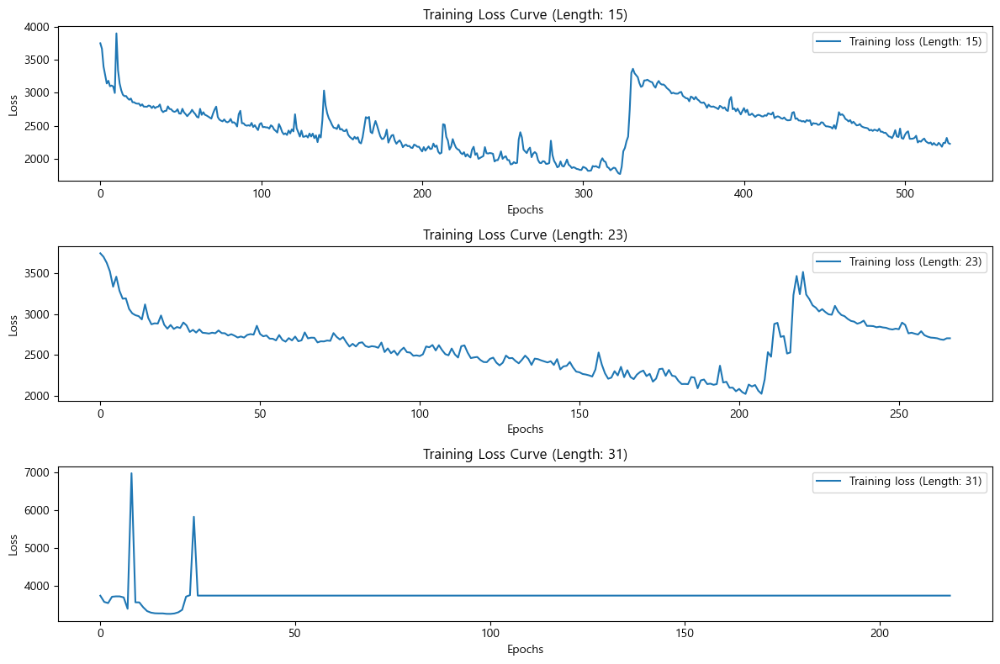

In [429]:
plt.figure(figsize=(12, 8))
seed_everything_tf(config.seed)
for idx, past_length in enumerate(past_lengths_m, 1):
    # model 정의
    
    model_name = f"model_hk2_L_multi_{past_length}"
    input_shape_var = f"trainX_hk2_{past_length}_m"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(8, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_hk2_L_multi_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_hk2_{past_length}_m"],
                                                        globals()[f"trainY_hk2_{past_length}_m"],
                                                        validation_data=(globals()[f"validX_hk2_{past_length}_m"],
                                                                        globals()[f"validY_hk2_{past_length}_m"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


In [462]:
prediction_hk2_15_m = model_hk2_L_multi_15.predict(testX_hk2_15_m) 
testY_hk2_15_m_re = testY_hk2_15_m.reshape(testY_hk2_15_m.shape[0]*8,1,1)
prediction_hk2_15_m_re = prediction_hk2_15_m.reshape(testY_hk2_15_m.shape[0]*8,1)

for _ in zip(prediction_hk2_15_m_re,testY_hk2_15_m_re):
    print(_)

12/12 [==============================] - 0s 4ms/step
(array([901.4757], dtype=float32), array([[2560.768]]))
(array([1171.8732], dtype=float32), array([[2443.977]]))
(array([1340.869], dtype=float32), array([[3146.777333]]))
(array([1297.5507], dtype=float32), array([[4039.077333]]))
(array([1400.4374], dtype=float32), array([[4202.152667]]))
(array([1402.571], dtype=float32), array([[2595.485667]]))
(array([1462.7477], dtype=float32), array([[1598.398667]]))
(array([1396.8422], dtype=float32), array([[815.8056667]]))
(array([813.7221], dtype=float32), array([[614.3186667]]))
(array([1207.9093], dtype=float32), array([[422.0606667]]))
(array([1497.0723], dtype=float32), array([[1092.855667]]))
(array([1564.8098], dtype=float32), array([[1295.659667]]))
(array([1541.7747], dtype=float32), array([[1305.494]]))
(array([1781.0349], dtype=float32), array([[2220.099]]))
(array([1664.0118], dtype=float32), array([[1574.221333]]))
(array([1873.6028], dtype=float32), array([[1022.135667]]))
(ar

(array([379.77905], dtype=float32), array([[4.02066667]]))
(array([404.571], dtype=float32), array([[39.30933333]]))
(array([398.60486], dtype=float32), array([[47.10866667]]))
(array([374.19214], dtype=float32), array([[31.234]]))
(array([349.49252], dtype=float32), array([[0.]]))
(array([351.32083], dtype=float32), array([[0.]]))
(array([328.3058], dtype=float32), array([[0.]]))
(array([172.5442], dtype=float32), array([[0.]]))
(array([205.46512], dtype=float32), array([[0.]]))
(array([224.49823], dtype=float32), array([[252.039]]))
(array([217.4059], dtype=float32), array([[355.2996667]]))
(array([211.46004], dtype=float32), array([[58.18133333]]))
(array([201.04013], dtype=float32), array([[8.42966667]]))
(array([202.7335], dtype=float32), array([[15.396]]))
(array([200.3811], dtype=float32), array([[0.]]))
(array([482.40292], dtype=float32), array([[17.32933333]]))
(array([570.7468], dtype=float32), array([[0.]]))
(array([625.9625], dtype=float32), array([[212.133]]))
(array([621.

(array([693.76807], dtype=float32), array([[438.344]]))
(array([630.3015], dtype=float32), array([[160.5066667]]))
(array([416.5859], dtype=float32), array([[18.23633333]]))
(array([486.0828], dtype=float32), array([[0.]]))
(array([540.75586], dtype=float32), array([[1.309]]))
(array([528.70435], dtype=float32), array([[24.586]]))
(array([507.39905], dtype=float32), array([[143.2803333]]))
(array([473.0919], dtype=float32), array([[349.7563333]]))
(array([488.9205], dtype=float32), array([[147.599]]))
(array([472.76755], dtype=float32), array([[37.153]]))
(array([502.967], dtype=float32), array([[0.]]))
(array([582.1119], dtype=float32), array([[46.93133333]]))
(array([637.6852], dtype=float32), array([[121.7323333]]))
(array([624.9616], dtype=float32), array([[46.56266667]]))
(array([599.90436], dtype=float32), array([[131.637]]))
(array([551.64026], dtype=float32), array([[122.0863333]]))
(array([574.2487], dtype=float32), array([[90.95166667]]))
(array([553.13837], dtype=float32), a

In [463]:
print(model_score_test(validY_hk2_15_m.reshape(-1,1),model_hk2_L_multi_15.predict(validX_hk2_15_m).reshape(validY_hk2_15_m.shape[0]*8,1)))

12/12 [==============================] - 0s 5ms/step
R2 score: 0.17289750275287685
MAE Loss:  2558.6353319662785
(0.17289750275287685, 2558.6353319662785)


R2 score: 0.08458196324509726
MAE Loss:  2140.5477468429676
(0.08458196324509726, 2140.5477468429676)


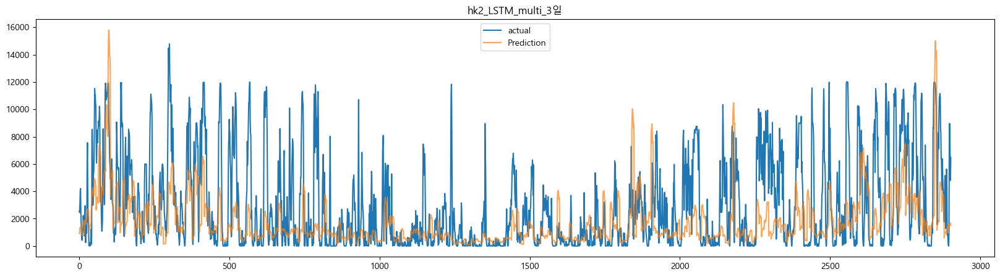

In [464]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_multi_3일')

plt.plot(testY_hk2_15_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk2_15_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk2_15_m_re.reshape(-1,1),prediction_hk2_15_m_re))

In [465]:
prediction_hk2_23_m = model_hk2_L_multi_23.predict(testX_hk2_23_m) 
testY_hk2_23_m_re = testY_hk2_23_m.reshape(testY_hk2_23_m.shape[0]*8,1,1)
prediction_hk2_23_m_re = prediction_hk2_23_m.reshape(testY_hk2_23_m.shape[0]*8,1)

for _ in zip(prediction_hk2_23_m_re,testY_hk2_23_m_re):
    print(_)

12/12 [==============================] - 0s 6ms/step
(array([1400.4515], dtype=float32), array([[614.3186667]]))
(array([1366.0223], dtype=float32), array([[422.0606667]]))
(array([1500.9596], dtype=float32), array([[1092.855667]]))
(array([1459.513], dtype=float32), array([[1295.659667]]))
(array([1404.8657], dtype=float32), array([[1305.494]]))
(array([1392.1886], dtype=float32), array([[2220.099]]))
(array([1408.6028], dtype=float32), array([[1574.221333]]))
(array([1213.4778], dtype=float32), array([[1022.135667]]))
(array([3879.6638], dtype=float32), array([[746.5416667]]))
(array([3829.806], dtype=float32), array([[2212.598]]))
(array([4247.452], dtype=float32), array([[2452.279]]))
(array([4152.179], dtype=float32), array([[2941.931667]]))
(array([3904.538], dtype=float32), array([[875.1216667]]))
(array([3857.2437], dtype=float32), array([[250.0353333]]))
(array([4002.0088], dtype=float32), array([[1479.893]]))
(array([3411.382], dtype=float32), array([[1217.027333]]))
(array([

(array([627.99646], dtype=float32), array([[1738.505667]]))
(array([607.86426], dtype=float32), array([[2023.282]]))
(array([600.3964], dtype=float32), array([[1148.323333]]))
(array([595.1513], dtype=float32), array([[1991.858]]))
(array([520.5278], dtype=float32), array([[2757.741667]]))
(array([1545.7886], dtype=float32), array([[2653.612667]]))
(array([1581.3401], dtype=float32), array([[1454.21]]))
(array([1667.5114], dtype=float32), array([[718.3926667]]))
(array([1618.4049], dtype=float32), array([[73.822]]))
(array([1586.4105], dtype=float32), array([[112.6576667]]))
(array([1577.7827], dtype=float32), array([[149.831]]))
(array([1536.0485], dtype=float32), array([[536.913]]))
(array([1360.0641], dtype=float32), array([[943.5696667]]))
(array([817.73694], dtype=float32), array([[2633.827]]))
(array([835.48096], dtype=float32), array([[1010.313333]]))
(array([883.094], dtype=float32), array([[743.]]))
(array([857.8069], dtype=float32), array([[459.8303333]]))
(array([835.9325], 

(array([1639.3334], dtype=float32), array([[214.858]]))
(array([1595.0417], dtype=float32), array([[64.395]]))
(array([1555.5652], dtype=float32), array([[655.1143333]]))
(array([1542.3851], dtype=float32), array([[2133.314]]))
(array([1512.9109], dtype=float32), array([[1842.661333]]))
(array([1332.2664], dtype=float32), array([[1679.801667]]))
(array([2557.9204], dtype=float32), array([[561.8813333]]))
(array([2603.812], dtype=float32), array([[1209.295333]]))
(array([2767.9526], dtype=float32), array([[789.8283333]]))
(array([2688.1787], dtype=float32), array([[437.5083333]]))
(array([2630.2844], dtype=float32), array([[1251.194333]]))
(array([2617.1287], dtype=float32), array([[1206.244667]]))
(array([2565.0342], dtype=float32), array([[620.0616667]]))
(array([2264.4294], dtype=float32), array([[678.564]]))
(array([2092.211], dtype=float32), array([[1430.856667]]))
(array([2141.1448], dtype=float32), array([[3901.729333]]))
(array([2263.3223], dtype=float32), array([[2026.379333]])

In [466]:
print(model_score_test(validY_hk2_23_m.reshape(-1,1),model_hk2_L_multi_23.predict(validX_hk2_23_m).reshape(validY_hk2_23_m.shape[0]*8,1)))

12/12 [==============================] - 0s 6ms/step
R2 score: -0.006235855254041578
MAE Loss:  2788.58821657017
(-0.006235855254041578, 2788.58821657017)


R2 score: -0.040234705716517105
MAE Loss:  2350.602890437888
(-0.040234705716517105, 2350.602890437888)


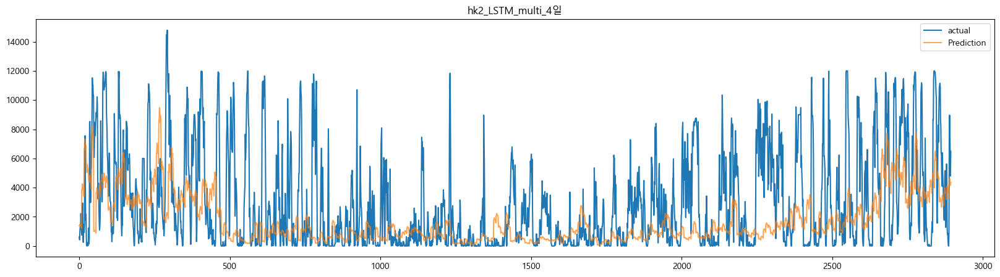

In [467]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_multi_4일')

plt.plot(testY_hk2_23_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk2_23_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk2_23_m_re.reshape(-1,1),prediction_hk2_23_m_re))

In [468]:
prediction_hk2_31_m = model_hk2_L_multi_31.predict(testX_hk2_31_m) 
testY_hk2_31_m_re = testY_hk2_31_m.reshape(testY_hk2_31_m.shape[0]*8,1,1)
prediction_hk2_31_m_re = prediction_hk2_31_m.reshape(testY_hk2_31_m.shape[0]*8,1)

for _ in zip(prediction_hk2_31_m_re,testY_hk2_31_m_re):
    print(_)

12/12 [==============================] - 0s 9ms/step
(array([1149.0404], dtype=float32), array([[746.5416667]]))
(array([1230.4072], dtype=float32), array([[2212.598]]))
(array([1183.313], dtype=float32), array([[2452.279]]))
(array([1209.424], dtype=float32), array([[2941.931667]]))
(array([1082.1333], dtype=float32), array([[875.1216667]]))
(array([1149.2075], dtype=float32), array([[250.0353333]]))
(array([1042.7413], dtype=float32), array([[1479.893]]))
(array([957.59485], dtype=float32), array([[1217.027333]]))
(array([1224.645], dtype=float32), array([[927.0866667]]))
(array([1320.5938], dtype=float32), array([[1577.488333]]))
(array([1261.711], dtype=float32), array([[6235.204333]]))
(array([1285.4795], dtype=float32), array([[7556.409333]]))
(array([1158.4689], dtype=float32), array([[4068.469667]]))
(array([1228.4047], dtype=float32), array([[1769.049333]]))
(array([1114.0891], dtype=float32), array([[2132.917667]]))
(array([1020.05615], dtype=float32), array([[827.5123333]]))

(array([1204.6211], dtype=float32), array([[8.73733333]]))
(array([1230.3569], dtype=float32), array([[21.392]]))
(array([1095.0349], dtype=float32), array([[11.105]]))
(array([1164.2444], dtype=float32), array([[0.]]))
(array([1055.2706], dtype=float32), array([[0.]]))
(array([973.77155], dtype=float32), array([[0.]]))
(array([1619.5482], dtype=float32), array([[0.]]))
(array([1776.8699], dtype=float32), array([[158.0053333]]))
(array([1663.7865], dtype=float32), array([[273.1176667]]))
(array([1690.2882], dtype=float32), array([[1199.363]]))
(array([1550.9229], dtype=float32), array([[1735.548667]]))
(array([1640.0149], dtype=float32), array([[2719.178667]]))
(array([1478.1772], dtype=float32), array([[2446.181333]]))
(array([1354.7582], dtype=float32), array([[1340.707667]]))
(array([1756.8472], dtype=float32), array([[1754.267]]))
(array([1978.3286], dtype=float32), array([[2460.598333]]))
(array([1804.6418], dtype=float32), array([[2384.490333]]))
(array([1815.3529], dtype=float32

(array([1920.7101], dtype=float32), array([[224.9673333]]))
(array([1778.8606], dtype=float32), array([[182.948]]))
(array([1799.1057], dtype=float32), array([[358.194]]))
(array([1674.9783], dtype=float32), array([[157.5043333]]))
(array([1767.9773], dtype=float32), array([[35.63666667]]))
(array([1581.8779], dtype=float32), array([[0.]]))
(array([1446.6555], dtype=float32), array([[0.]]))
(array([1983.2617], dtype=float32), array([[31.96166667]]))
(array([2216.2605], dtype=float32), array([[0.]]))
(array([2039.4388], dtype=float32), array([[89.24766667]]))
(array([2054.273], dtype=float32), array([[0.]]))
(array([1929.1534], dtype=float32), array([[250.728]]))
(array([2035.4116], dtype=float32), array([[413.4053333]]))
(array([1813.7942], dtype=float32), array([[966.2206667]]))
(array([1657.3319], dtype=float32), array([[2111.827]]))
(array([2080.291], dtype=float32), array([[2186.263667]]))
(array([2336.784], dtype=float32), array([[5093.109]]))
(array([2136.4624], dtype=float32), a

In [469]:
print(model_score_test(validY_hk2_31_m.reshape(-1,1),model_hk2_L_multi_31.predict(validX_hk2_31_m).reshape(validY_hk2_31_m.shape[0]*8,1)))

12/12 [==============================] - 0s 9ms/step
R2 score: -0.20066625381061787
MAE Loss:  3107.125185189096
(-0.20066625381061787, 3107.125185189096)


R2 score: -0.17621978952568096
MAE Loss:  2515.852257099402
(-0.17621978952568096, 2515.852257099402)


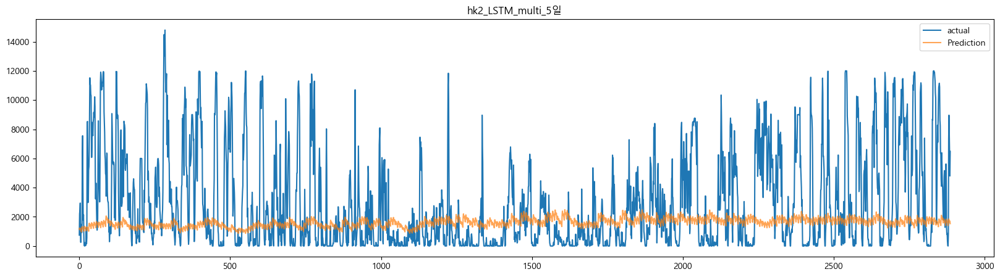

In [470]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_multi_5일')

plt.plot(testY_hk2_31_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk2_31_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,2500)
plt.legend()
print(model_score_test(testY_hk2_31_m_re.reshape(-1,1),prediction_hk2_31_m_re))

In [1636]:
seed_everything_tf(3)
model_hk2_L_multi = Sequential()
model_hk2_L_multi.add(LSTM(64, activation='relu', input_shape=(trainX_hk2_m.shape[1], trainX_hk2_m.shape[2]),return_sequences=True))
                             #return_sequences=True))
model_hk2_L_multi.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_hk2_L_multi.add(Dropout(0.2))
model_hk2_L_multi.add(Flatten())
model_hk2_L_multi.add(Dense(trainY_hk2_m.shape[1], activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))

model_hk2_L_multi.compile(optimizer='adam', loss='mae')

In [1637]:
history_hk2_L_multi = model_hk2_L_multi.fit(trainX_hk2_m, trainY_hk2_m,validation_data = (validX_hk2_m,validY_hk2_m) ,epochs=1000, batch_size=100,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_hk2_L_multi.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

Epoch 1/1000
4/8 [==============>...............] - ETA: 0s - loss: 3728.2024 

KeyboardInterrupt: 

In [1296]:
prediction_hk2_m = model_hk2_L_multi.predict(testX_hk2_m) 
testY_hk2_m_re = testY_hk2_m.reshape(testY_hk2_m.shape[0]*8,1,1)
prediction_hk2_m_re = prediction_hk2_m.reshape(testY_hk2_m.shape[0]*8,1)

for _ in zip(prediction_hk2_m_re,testY_hk2_m_re):
    print(_)

12/12 [==============================] - 0s 4ms/step
(array([7476.3374], dtype=float32), array([[2560.768]]))
(array([7681.7666], dtype=float32), array([[2443.977]]))
(array([8127.565], dtype=float32), array([[3146.777333]]))
(array([7785.397], dtype=float32), array([[4039.077333]]))
(array([7609.4956], dtype=float32), array([[4202.152667]]))
(array([7312.319], dtype=float32), array([[2595.485667]]))
(array([7092.4717], dtype=float32), array([[1598.398667]]))
(array([6220.0205], dtype=float32), array([[815.8056667]]))
(array([3037.62], dtype=float32), array([[614.3186667]]))
(array([3259.41], dtype=float32), array([[422.0606667]]))
(array([3707.3499], dtype=float32), array([[1092.855667]]))
(array([3725.0156], dtype=float32), array([[1295.659667]]))
(array([3949.1162], dtype=float32), array([[1305.494]]))
(array([3897.925], dtype=float32), array([[2220.099]]))
(array([3885.0046], dtype=float32), array([[1574.221333]]))
(array([3534.7974], dtype=float32), array([[1022.135667]]))
(array(

(array([349.66766], dtype=float32), array([[0.]]))
(array([314.01715], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.21733333]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[189.3943333]]))
(array([198.92699], dtype=float32), array([[53.49166667]]))
(array([285.56985], dtype=float32), array([[577.436]]))
(array([363.3977], dtype=float32), array([[69.24866667]]))
(array([445.56912], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[4.02066667]]))
(array([0.], dtype=float32), array([[39.30933333]]))
(array([0.], dtype=float32), array([[47.10866667]]))
(array([62.33904], dtype=float32), array([[31.234]]))
(array([142.54784], dtype=float32), array([[0.]]))
(array([185.3599], dtype=float32), array([[0.]]))
(array([232.059], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), array([[0.]]))
(array([0.], dtype=float32), 

(array([287.49026], dtype=float32), array([[872.518]]))
(array([445.76703], dtype=float32), array([[21.07233333]]))
(array([526.89954], dtype=float32), array([[4.43266667]]))
(array([581.2104], dtype=float32), array([[1246.980333]]))
(array([3660.675], dtype=float32), array([[1930.376333]]))
(array([3871.6606], dtype=float32), array([[6422.758667]]))
(array([4259.981], dtype=float32), array([[5653.511333]]))
(array([4217.3745], dtype=float32), array([[4343.345333]]))
(array([4315.3467], dtype=float32), array([[3485.843]]))
(array([4225.9585], dtype=float32), array([[8182.547333]]))
(array([4169.148], dtype=float32), array([[8765.327]]))
(array([3727.2144], dtype=float32), array([[8213.65]]))
(array([4903.973], dtype=float32), array([[7489.26]]))
(array([5172.859], dtype=float32), array([[8360.533667]]))
(array([5699.8213], dtype=float32), array([[7905.944667]]))
(array([5651.302], dtype=float32), array([[4060.432]]))
(array([5816.191], dtype=float32), array([[1060.592333]]))
(array([57

In [1297]:
print(model_score_test(validY_hk2_m.reshape(-1,1),model_hk2_L_multi.predict(validX_hk2_m).reshape(validY_hk2_m.shape[0]*8,1)))

12/12 [==============================] - 0s 4ms/step
R2 score: 0.4676473819032958
MAE Loss:  1975.4050458697895
(0.4676473819032958, 1975.4050458697895)


R2 score: 0.3688038283705275
MAE Loss:  1673.3979343108624
(0.3688038283705275, 1673.3979343108624)


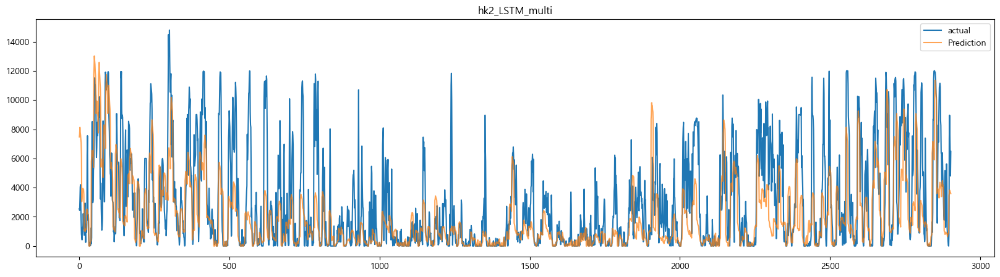

In [1298]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('hk2_LSTM_multi')

plt.plot(testY_hk2_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_hk2_m_re[n:m],alpha=0.7, label = 'Prediction')
# plt.ylim(0,4500)
plt.legend()
print(model_score_test(testY_hk2_m_re.reshape(-1,1),prediction_hk2_m_re))

# SS

현재  38 학습중
Epoch 1/1000
90/90 [==============================] - 5s 32ms/step - loss: 4778.2666 - val_loss: 4942.6382
Epoch 2/1000
90/90 [==============================] - 3s 28ms/step - loss: 5533.9199 - val_loss: 4948.6333
Epoch 3/1000
90/90 [==============================] - 3s 29ms/step - loss: 7153.5830 - val_loss: 5199.3179
Epoch 4/1000
90/90 [==============================] - 3s 35ms/step - loss: 4895.3857 - val_loss: 5195.9609
Epoch 5/1000
90/90 [==============================] - 3s 29ms/step - loss: 4891.7847 - val_loss: 5192.1221
Epoch 6/1000
90/90 [==============================] - 3s 29ms/step - loss: 4887.7290 - val_loss: 5187.8125
Epoch 7/1000
90/90 [==============================] - 3s 29ms/step - loss: 4883.2886 - val_loss: 5183.0039
Epoch 8/1000
90/90 [==============================] - 3s 29ms/step - loss: 4574.0190 - val_loss: 4311.9868
Epoch 9/1000
90/90 [==============================] - 3s 30ms/step - loss: 4119.7236 - val_loss: 4186.2368
Epoch 10/1000
90/90 [=====

Epoch 77/1000
90/90 [==============================] - 3s 34ms/step - loss: 4928.8765 - val_loss: 5231.5190
Epoch 78/1000
90/90 [==============================] - 3s 37ms/step - loss: 4928.8779 - val_loss: 5231.5190
Epoch 79/1000
90/90 [==============================] - 3s 33ms/step - loss: 4928.8789 - val_loss: 5231.5190
Epoch 80/1000
90/90 [==============================] - 3s 34ms/step - loss: 4928.8760 - val_loss: 5231.5190
Epoch 81/1000
90/90 [==============================] - 3s 33ms/step - loss: 4928.8750 - val_loss: 5231.5190
Epoch 82/1000
90/90 [==============================] - 3s 36ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 83/1000
90/90 [==============================] - 4s 39ms/step - loss: 4928.8765 - val_loss: 5231.5190
Epoch 84/1000
90/90 [==============================] - 3s 33ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 85/1000
90/90 [==============================] - 3s 33ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 86/1000
90/90 [=======

90/90 [==============================] - 3s 34ms/step - loss: 4928.8760 - val_loss: 5231.5190
Epoch 153/1000
90/90 [==============================] - 4s 41ms/step - loss: 4928.8774 - val_loss: 5231.5190
Epoch 154/1000
90/90 [==============================] - 3s 35ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 155/1000
90/90 [==============================] - 3s 34ms/step - loss: 4928.8760 - val_loss: 5231.5190
Epoch 156/1000
90/90 [==============================] - 3s 34ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 157/1000
90/90 [==============================] - 3s 34ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 158/1000
90/90 [==============================] - 3s 38ms/step - loss: 4928.8779 - val_loss: 5231.5190
Epoch 159/1000
90/90 [==============================] - 3s 35ms/step - loss: 4928.8774 - val_loss: 5231.5190
Epoch 160/1000
90/90 [==============================] - 3s 35ms/step - loss: 4928.8774 - val_loss: 5231.5190
Epoch 161/1000
90/90 [============

90/90 [==============================] - 3s 37ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 228/1000
90/90 [==============================] - 3s 36ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 229/1000
90/90 [==============================] - 4s 42ms/step - loss: 4928.8774 - val_loss: 5231.5190
Epoch 230/1000
90/90 [==============================] - 4s 42ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 231/1000
90/90 [==============================] - 3s 36ms/step - loss: 4928.8760 - val_loss: 5231.5190
Epoch 232/1000
90/90 [==============================] - 3s 36ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 233/1000
90/90 [==============================] - 3s 36ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 234/1000
90/90 [==============================] - 4s 41ms/step - loss: 4928.8755 - val_loss: 5231.5190
Epoch 235/1000
90/90 [==============================] - 3s 37ms/step - loss: 4928.8770 - val_loss: 5231.5190
Epoch 236/1000
90/90 [============

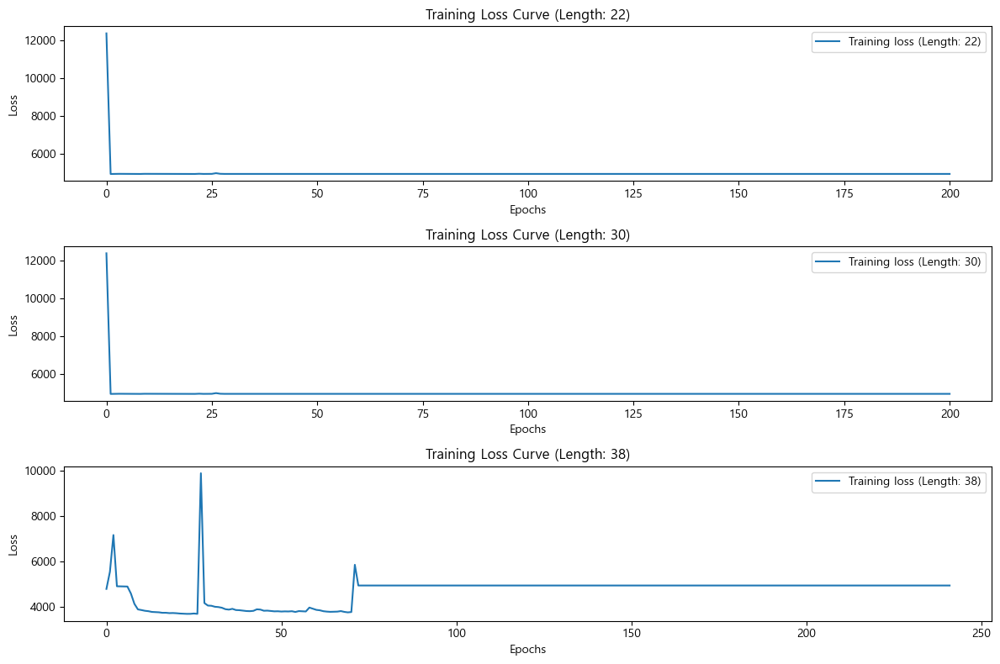

In [525]:
plt.figure(figsize=(12, 8))
seed_everything_tf(config.seed)

for idx, past_length in enumerate(past_lengths, 1):
    # model 정의
    model_name = f"model_ss_lstm_{past_length}"
    input_shape_var = f"trainX_ss_{past_length}"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(1, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_ss_lstm_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_ss_{past_length}"],
                                                        globals()[f"trainY_ss_{past_length}"],
                                                        validation_data=(globals()[f"validX_ss_{past_length}"],
                                                                        globals()[f"validY_ss_{past_length}"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


In [546]:
prediction_ss_22 = model_ss_lstm_22.predict(testX_ss_22) 
for _ in zip(prediction_ss_22, testY_ss_22):
    print(_)


91/91 [==============================] - 0s 4ms/step
(array([9381.21], dtype=float32), array([[6992.309]]))
(array([7819.3115], dtype=float32), array([[7158.044333]]))
(array([5564.491], dtype=float32), array([[9287.556667]]))
(array([3250.5225], dtype=float32), array([[13307.53233]]))
(array([2903.3674], dtype=float32), array([[15576.27133]]))
(array([2868.8857], dtype=float32), array([[5865.019]]))
(array([2800.8574], dtype=float32), array([[5443.822]]))
(array([2779.7244], dtype=float32), array([[2711.306333]]))
(array([3406.7705], dtype=float32), array([[5682.105]]))
(array([4005.2573], dtype=float32), array([[7950.789667]]))
(array([4030.7058], dtype=float32), array([[7799.546667]]))
(array([3511.5706], dtype=float32), array([[2257.879667]]))
(array([3425.9722], dtype=float32), array([[840.6073333]]))
(array([4635.1934], dtype=float32), array([[1142.664]]))
(array([5118.3887], dtype=float32), array([[1716.327]]))
(array([5272.068], dtype=float32), array([[5125.679]]))
(array([6045

(array([5521.079], dtype=float32), array([[8777.931]]))
(array([9259.792], dtype=float32), array([[7491.770333]]))
(array([11537.257], dtype=float32), array([[4102.433]]))
(array([12742.597], dtype=float32), array([[3475.115667]]))
(array([11588.039], dtype=float32), array([[4569.581333]]))
(array([11878.544], dtype=float32), array([[3513.165667]]))
(array([10548.294], dtype=float32), array([[8925.227333]]))
(array([10053.403], dtype=float32), array([[12805.348]]))
(array([10719.427], dtype=float32), array([[16673.52533]]))
(array([10809.425], dtype=float32), array([[11074.35]]))
(array([10466.669], dtype=float32), array([[14094.21867]]))
(array([11034.437], dtype=float32), array([[12275.05967]]))
(array([10737.838], dtype=float32), array([[13930.58833]]))
(array([11170.163], dtype=float32), array([[9861.593667]]))
(array([12537.233], dtype=float32), array([[3922.558667]]))
(array([11150.923], dtype=float32), array([[1398.508333]]))
(array([9448.723], dtype=float32), array([[157.923333

(array([1152.0199], dtype=float32), array([[702.852]]))
(array([1381.5168], dtype=float32), array([[1321.473667]]))
(array([1810.0817], dtype=float32), array([[76.49333333]]))
(array([2417.742], dtype=float32), array([[2846.953667]]))
(array([2992.0232], dtype=float32), array([[6463.529]]))
(array([2981.7183], dtype=float32), array([[8713.934667]]))
(array([2905.999], dtype=float32), array([[3638.565667]]))
(array([2846.4976], dtype=float32), array([[4346.825]]))
(array([3010.8708], dtype=float32), array([[2113.064]]))
(array([3091.3418], dtype=float32), array([[879.0566667]]))
(array([2722.2039], dtype=float32), array([[295.5136667]]))
(array([1743.7494], dtype=float32), array([[1043.384333]]))
(array([1160.024], dtype=float32), array([[1244.869]]))
(array([1000.63153], dtype=float32), array([[588.8706667]]))
(array([732.9025], dtype=float32), array([[161.1216667]]))
(array([585.1394], dtype=float32), array([[173.8253333]]))
(array([433.85602], dtype=float32), array([[428.7426667]]))


(array([1721.5668], dtype=float32), array([[1898.270333]]))
(array([2029.9136], dtype=float32), array([[1743.104333]]))
(array([2027.523], dtype=float32), array([[2194.641667]]))
(array([1688.8179], dtype=float32), array([[3214.526667]]))
(array([1329.7811], dtype=float32), array([[1608.324]]))
(array([1176.5673], dtype=float32), array([[640.892]]))
(array([1041.0377], dtype=float32), array([[434.1773333]]))
(array([850.28735], dtype=float32), array([[0.]]))
(array([633.76605], dtype=float32), array([[0.]]))
(array([779.4375], dtype=float32), array([[0.]]))
(array([749.8302], dtype=float32), array([[172.5096667]]))
(array([820.7481], dtype=float32), array([[643.463]]))
(array([873.79047], dtype=float32), array([[578.2916667]]))
(array([967.9202], dtype=float32), array([[2149.591]]))
(array([1346.7201], dtype=float32), array([[2030.959333]]))
(array([1849.1044], dtype=float32), array([[1273.972667]]))
(array([2397.2917], dtype=float32), array([[1561.318]]))
(array([2609.1426], dtype=flo

In [547]:
print(model_score_test(validY_ss_22.reshape(-1,1), model_ss_lstm_22.predict(validX_ss_22)))


91/91 [==============================] - 1s 8ms/step
R2 score: 0.38055299696991407
MAE Loss:  3121.0624924869685
(0.38055299696991407, 3121.0624924869685)


R2 score: 0.30388954008243607
MAE Loss:  3354.668112359585
(0.30388954008243607, 3354.668112359585)


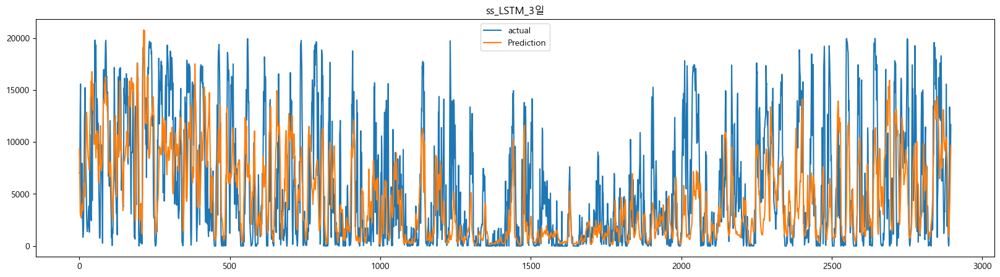

In [548]:
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_3일')

plt.plot(testY_ss_22[n:m].reshape(-1, 1), label='actual')
plt.plot(prediction_ss_22[n:m], label='Prediction')
# plt.ylim(0, 4500)
plt.legend()
print(model_score_test(testY_ss_22.reshape(-1, 1), prediction_ss_22))


In [549]:
prediction_ss_30 = model_ss_lstm_30.predict(testX_ss_30) 
for _ in zip(prediction_ss_30, testY_ss_30):
    print(_)


91/91 [==============================] - 1s 5ms/step
(array([9426.211], dtype=float32), array([[5682.105]]))
(array([7283.9404], dtype=float32), array([[7950.789667]]))
(array([4267.0967], dtype=float32), array([[7799.546667]]))
(array([1140.0509], dtype=float32), array([[2257.879667]]))
(array([302.2665], dtype=float32), array([[840.6073333]]))
(array([588.7438], dtype=float32), array([[1142.664]]))
(array([1513.1561], dtype=float32), array([[1716.327]]))
(array([2458.4097], dtype=float32), array([[5125.679]]))
(array([4074.2666], dtype=float32), array([[6663.873667]]))
(array([6188.0796], dtype=float32), array([[12179.894]]))
(array([8184.0186], dtype=float32), array([[13057.93867]]))
(array([10021.367], dtype=float32), array([[15228.91133]]))
(array([10103.403], dtype=float32), array([[12109.994]]))
(array([10092.167], dtype=float32), array([[9457.282]]))
(array([9951.002], dtype=float32), array([[6682.244667]]))
(array([9772.609], dtype=float32), array([[5684.779]]))
(array([9673.6

(array([3112.1536], dtype=float32), array([[4102.433]]))
(array([2930.4944], dtype=float32), array([[3475.115667]]))
(array([2937.0664], dtype=float32), array([[4569.581333]]))
(array([3054.878], dtype=float32), array([[3513.165667]]))
(array([3194.781], dtype=float32), array([[8925.227333]]))
(array([3509.1387], dtype=float32), array([[12805.348]]))
(array([3623.8623], dtype=float32), array([[16673.52533]]))
(array([3524.0498], dtype=float32), array([[11074.35]]))
(array([3373.4146], dtype=float32), array([[14094.21867]]))
(array([3194.9722], dtype=float32), array([[12275.05967]]))
(array([3182.058], dtype=float32), array([[13930.58833]]))
(array([3331.7192], dtype=float32), array([[9861.593667]]))
(array([3192.4233], dtype=float32), array([[3922.558667]]))
(array([3095.4348], dtype=float32), array([[1398.508333]]))
(array([3061.5845], dtype=float32), array([[157.9233333]]))
(array([3031.6528], dtype=float32), array([[1572.967667]]))
(array([2792.2563], dtype=float32), array([[4745.29

(array([2521.3088], dtype=float32), array([[48.50166667]]))
(array([2630.1133], dtype=float32), array([[204.042]]))
(array([2579.737], dtype=float32), array([[0.]]))
(array([2416.4556], dtype=float32), array([[320.7606667]]))
(array([2283.1184], dtype=float32), array([[3941.805]]))
(array([2131.6104], dtype=float32), array([[4682.944667]]))
(array([2061.5627], dtype=float32), array([[4108.539]]))
(array([1906.9591], dtype=float32), array([[5569.126333]]))
(array([1769.4474], dtype=float32), array([[3617.692]]))
(array([1635.0863], dtype=float32), array([[3572.899667]]))
(array([1493.6232], dtype=float32), array([[3445.926333]]))
(array([1377.6587], dtype=float32), array([[370.738]]))
(array([1325.402], dtype=float32), array([[1004.657667]]))
(array([1298.0139], dtype=float32), array([[339.6673333]]))
(array([1274.9447], dtype=float32), array([[14.25166667]]))
(array([1245.8981], dtype=float32), array([[169.7606667]]))
(array([1215.3018], dtype=float32), array([[433.959]]))
(array([1207

(array([1558.9398], dtype=float32), array([[9681.570667]]))
(array([1603.1198], dtype=float32), array([[8894.808]]))
(array([1747.589], dtype=float32), array([[11335.824]]))
(array([1885.1656], dtype=float32), array([[11388.966]]))
(array([1892.4907], dtype=float32), array([[11853.87433]]))
(array([1860.1715], dtype=float32), array([[12356.783]]))
(array([1833.579], dtype=float32), array([[12558.414]]))
(array([1915.9502], dtype=float32), array([[17345.80733]]))
(array([2025.0963], dtype=float32), array([[15490.01]]))
(array([2044.3838], dtype=float32), array([[15672.60167]]))
(array([2088.1758], dtype=float32), array([[12992.758]]))
(array([2123.7722], dtype=float32), array([[12681.67167]]))
(array([2153.4438], dtype=float32), array([[11631.244]]))
(array([2171.1367], dtype=float32), array([[12956.514]]))
(array([2228.016], dtype=float32), array([[9585.037667]]))
(array([2426.1255], dtype=float32), array([[9476.247333]]))
(array([2651.342], dtype=float32), array([[6328.779333]]))
(arr

(array([2457.], dtype=float32), array([[7350.656]]))
(array([2652.542], dtype=float32), array([[2929.303]]))
(array([2819.6016], dtype=float32), array([[9665.919333]]))
(array([2940.1462], dtype=float32), array([[2691.713333]]))
(array([3003.3892], dtype=float32), array([[6926.256667]]))
(array([3000.7632], dtype=float32), array([[7411.232333]]))
(array([2965.291], dtype=float32), array([[1804.152]]))
(array([2986.2751], dtype=float32), array([[452.2073333]]))
(array([2815.519], dtype=float32), array([[0.]]))
(array([2739.4434], dtype=float32), array([[105.0153333]]))
(array([2508.5447], dtype=float32), array([[1892.229333]]))
(array([2082.5044], dtype=float32), array([[1182.172]]))
(array([1739.0199], dtype=float32), array([[707.8063333]]))
(array([1565.6212], dtype=float32), array([[60.12466667]]))
(array([1526.1113], dtype=float32), array([[143.226]]))
(array([1584.8911], dtype=float32), array([[591.6033333]]))
(array([1630.7687], dtype=float32), array([[0.]]))
(array([1661.8707], d

In [550]:
print(model_score_test(validY_ss_30.reshape(-1,1), model_ss_lstm_30.predict(validX_ss_30)))


91/91 [==============================] - 0s 5ms/step
R2 score: 0.014690801997507053
MAE Loss:  4004.8651777884334
(0.014690801997507053, 4004.8651777884334)


R2 score: 0.0017640515264161216
MAE Loss:  4104.958002555435
(0.0017640515264161216, 4104.958002555435)


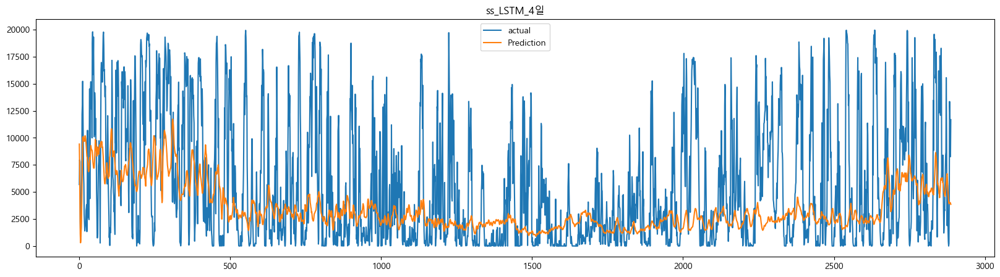

In [551]:
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_4일')

plt.plot(testY_ss_30[n:m].reshape(-1, 1), label='actual')
plt.plot(prediction_ss_30[n:m], label='Prediction')
# plt.ylim(0, 4500)
plt.legend()
print(model_score_test(testY_ss_30.reshape(-1, 1), prediction_ss_30))


In [552]:
prediction_ss_38 = model_ss_lstm_38.predict(testX_ss_38) 
for _ in zip(prediction_ss_38, testY_ss_38):
    print(_)


91/91 [==============================] - 1s 6ms/step
(array([4826.5264], dtype=float32), array([[6663.873667]]))
(array([4893.6763], dtype=float32), array([[12179.894]]))
(array([5117.086], dtype=float32), array([[13057.93867]]))
(array([5146.2095], dtype=float32), array([[15228.91133]]))
(array([5460.6396], dtype=float32), array([[12109.994]]))
(array([5745.0137], dtype=float32), array([[9457.282]]))
(array([6113.826], dtype=float32), array([[6682.244667]]))
(array([6470.6035], dtype=float32), array([[5684.779]]))
(array([6836.777], dtype=float32), array([[2934.833]]))
(array([7616.576], dtype=float32), array([[2168.529]]))
(array([8279.894], dtype=float32), array([[1395.414333]]))
(array([8685.444], dtype=float32), array([[1676.171333]]))
(array([8502.476], dtype=float32), array([[1931.482333]]))
(array([8369.968], dtype=float32), array([[1932.579]]))
(array([8375.822], dtype=float32), array([[3306.09]]))
(array([8353.775], dtype=float32), array([[3523.084333]]))
(array([8179.838], d

(array([3392.7478], dtype=float32), array([[0.]]))
(array([3437.037], dtype=float32), array([[485.2736667]]))
(array([3364.2444], dtype=float32), array([[381.42]]))
(array([3306.1963], dtype=float32), array([[416.465]]))
(array([3331.4211], dtype=float32), array([[0.]]))
(array([3306.5645], dtype=float32), array([[287.1726667]]))
(array([3625.6064], dtype=float32), array([[696.25]]))
(array([3868.2605], dtype=float32), array([[0.]]))
(array([3851.992], dtype=float32), array([[0.]]))
(array([3732.2153], dtype=float32), array([[171.8263333]]))
(array([3867.31], dtype=float32), array([[955.8486667]]))
(array([3652.0386], dtype=float32), array([[1798.98]]))
(array([3757.1074], dtype=float32), array([[1129.282]]))
(array([4212.307], dtype=float32), array([[203.867]]))
(array([4767.8125], dtype=float32), array([[44.125]]))
(array([4903.6484], dtype=float32), array([[515.6713333]]))
(array([4309.39], dtype=float32), array([[91.16033333]]))
(array([3631.7354], dtype=float32), array([[301.66233

(array([1593.3799], dtype=float32), array([[1574.757667]]))
(array([1634.405], dtype=float32), array([[2527.676]]))
(array([1677.2284], dtype=float32), array([[1842.321333]]))
(array([1710.2402], dtype=float32), array([[1096.971333]]))
(array([1693.8733], dtype=float32), array([[2167.795333]]))
(array([1698.4863], dtype=float32), array([[3163.705667]]))
(array([1790.324], dtype=float32), array([[3278.397667]]))
(array([1884.7472], dtype=float32), array([[4338.764]]))
(array([1995.7623], dtype=float32), array([[2845.759333]]))
(array([2147.81], dtype=float32), array([[1894.223]]))
(array([2285.7866], dtype=float32), array([[3210.456667]]))
(array([2369.6174], dtype=float32), array([[2989.898333]]))
(array([2405.378], dtype=float32), array([[2264.014333]]))
(array([2366.8413], dtype=float32), array([[3312.336333]]))
(array([2282.9827], dtype=float32), array([[3666.053667]]))
(array([2270.0686], dtype=float32), array([[2550.814333]]))
(array([2247.], dtype=float32), array([[1610.908]]))
(

(array([2632.6187], dtype=float32), array([[11635.768]]))
(array([2573.6946], dtype=float32), array([[1691.858]]))
(array([2533.2192], dtype=float32), array([[5057.035]]))
(array([2425.0178], dtype=float32), array([[5358.049333]]))
(array([2288.4268], dtype=float32), array([[4961.213]]))
(array([2208.4272], dtype=float32), array([[7853.822667]]))
(array([2169.9834], dtype=float32), array([[11793.968]]))
(array([2141.0156], dtype=float32), array([[5287.469]]))
(array([2176.3794], dtype=float32), array([[3728.216333]]))
(array([2241.7583], dtype=float32), array([[3137.864667]]))
(array([2267.6982], dtype=float32), array([[2787.908]]))
(array([2243.859], dtype=float32), array([[3948.789]]))
(array([2243.4966], dtype=float32), array([[4248.364667]]))
(array([2267.1902], dtype=float32), array([[7195.712667]]))
(array([2309.0771], dtype=float32), array([[8667.944667]]))
(array([2335.1045], dtype=float32), array([[12946.17133]]))
(array([2354.3696], dtype=float32), array([[14687.526]]))
(arra

In [553]:
print(model_score_test(validY_ss_38.reshape(-1,1), model_ss_lstm_38.predict(validX_ss_38)))


91/91 [==============================] - 1s 7ms/step
R2 score: -0.051606488403648454
MAE Loss:  4082.8948225688646
(-0.051606488403648454, 4082.8948225688646)


R2 score: -0.05772698845836377
MAE Loss:  4209.275994042917
(-0.05772698845836377, 4209.275994042917)


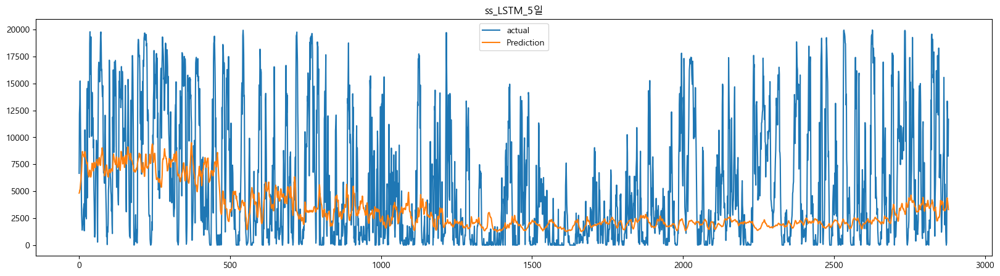

In [554]:
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_5일')

plt.plot(testY_ss_38[n:m].reshape(-1, 1), label='actual')
plt.plot(prediction_ss_38[n:m], label='Prediction')
# plt.ylim(0, 4500)
plt.legend()
print(model_score_test(testY_ss_38.reshape(-1, 1), prediction_ss_38))


In [509]:
seed_everything_tf(config.seed)
model_ss_lstm = Sequential()
model_ss_lstm.add(LSTM(64, activation='relu', input_shape=(trainX_ss.shape[1], trainX_ss.shape[2]),return_sequences=True))
                             #return_sequences=True))
model_ss_lstm.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_ss_lstm.add(Dropout(0.2))
model_ss_lstm.add(Flatten())
model_ss_lstm.add(Dense(1, activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))

model_ss_lstm.compile(optimizer='adam', loss='mae')

NameError: name 'trainX_ss' is not defined

In [508]:
history_ss_lstm = model_ss_lstm.fit(trainX_ss, trainY_ss,validation_data = (validX_ss,validY_ss) ,epochs=1000, batch_size=200,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_ss_lstm.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

Epoch 1/1000
90/90 [==============================] - 5s 29ms/step - loss: 12387.5635 - val_loss: 5231.5190
Epoch 2/1000
90/90 [==============================] - 2s 26ms/step - loss: 4925.0366 - val_loss: 5231.5190
Epoch 3/1000
90/90 [==============================] - 2s 26ms/step - loss: 4930.7695 - val_loss: 5231.5190
Epoch 4/1000
90/90 [==============================] - 3s 30ms/step - loss: 4932.9287 - val_loss: 5231.5190
Epoch 5/1000
90/90 [==============================] - 3s 36ms/step - loss: 4930.7979 - val_loss: 5231.5190
Epoch 6/1000
90/90 [==============================] - 2s 27ms/step - loss: 4930.1738 - val_loss: 5231.5190
Epoch 7/1000
89/90 [============================>.] - ETA: 0s - loss: 4923.3818

KeyboardInterrupt: 

In [ ]:
prediction_ss = model_ss_lstm.predict(testX_ss) 
for _ in zip(prediction_ss,testY_ss):
    print(_)

In [1529]:
print(model_score_test(validY_ss.reshape(-1,1),model_ss_lstm.predict(validX_ss)))

91/91 [==============================] - 0s 4ms/step
R2 score: 0.4104014572320246
MAE Loss:  2964.532239414358
(0.4104014572320246, 2964.532239414358)


R2 score: 0.3812777412965218
MAE Loss:  3080.4979085989535
None


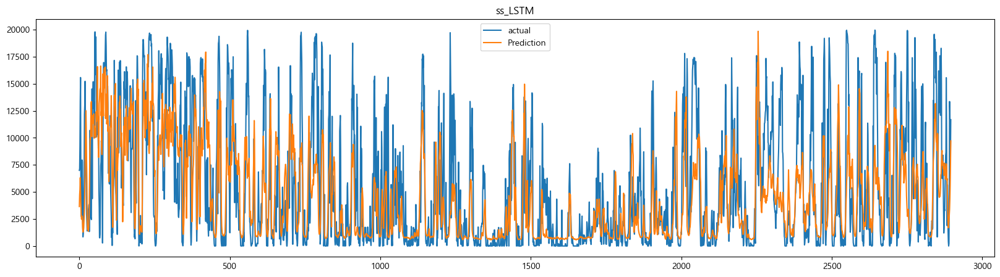

In [1530]:
# LSTM
n=0
m=-1
plt.figure(figsize = (20,5))
plt.title('ss_LSTM')

plt.plot(testY_ss[n:m].reshape(-1,1),label = 'actual')
plt.plot(prediction_ss[n:m], label = 'Prediction')
# plt.ylim(0,3500)
plt.legend()
print(model_score(testY_ss.reshape(-1,1),prediction_ss,'s'))

# SS - multi

현재  15 학습중
Epoch 1/1000
12/12 [==============================] - 3s 50ms/step - loss: 4943.0151 - val_loss: 5224.4385
Epoch 2/1000
12/12 [==============================] - 0s 27ms/step - loss: 4748.7271 - val_loss: 4540.4146
Epoch 3/1000
12/12 [==============================] - 0s 25ms/step - loss: 4278.7676 - val_loss: 4416.9248
Epoch 4/1000
12/12 [==============================] - 0s 25ms/step - loss: 4164.0215 - val_loss: 4307.2490
Epoch 5/1000
12/12 [==============================] - 0s 25ms/step - loss: 4018.8730 - val_loss: 4207.2192
Epoch 6/1000
12/12 [==============================] - 0s 25ms/step - loss: 3958.2332 - val_loss: 4189.4727
Epoch 7/1000
12/12 [==============================] - 0s 24ms/step - loss: 3959.1946 - val_loss: 4480.0498
Epoch 8/1000
12/12 [==============================] - 0s 25ms/step - loss: 3975.4417 - val_loss: 4235.9727
Epoch 9/1000
12/12 [==============================] - 0s 26ms/step - loss: 3985.4521 - val_loss: 4284.5469
Epoch 10/1000
12/12 [=====

Epoch 77/1000
12/12 [==============================] - 0s 19ms/step - loss: 3567.4802 - val_loss: 3909.8396
Epoch 78/1000
12/12 [==============================] - 0s 19ms/step - loss: 3569.8508 - val_loss: 3885.1750
Epoch 79/1000
12/12 [==============================] - 0s 19ms/step - loss: 3594.6865 - val_loss: 3907.6418
Epoch 80/1000
12/12 [==============================] - 0s 19ms/step - loss: 3651.9709 - val_loss: 3977.7158
Epoch 81/1000
12/12 [==============================] - 0s 19ms/step - loss: 3594.6580 - val_loss: 3896.5540
Epoch 82/1000
12/12 [==============================] - 0s 19ms/step - loss: 3569.5796 - val_loss: 3883.2434
Epoch 83/1000
12/12 [==============================] - 0s 19ms/step - loss: 3686.1594 - val_loss: 3980.6157
Epoch 84/1000
12/12 [==============================] - 0s 19ms/step - loss: 3668.5222 - val_loss: 3888.6729
Epoch 85/1000
12/12 [==============================] - 0s 19ms/step - loss: 3597.7393 - val_loss: 3901.1135
Epoch 86/1000
12/12 [=======

12/12 [==============================] - 0s 19ms/step - loss: 3504.1326 - val_loss: 3999.4805
Epoch 153/1000
12/12 [==============================] - 0s 19ms/step - loss: 3467.1069 - val_loss: 3837.5396
Epoch 154/1000
12/12 [==============================] - 0s 19ms/step - loss: 3477.8193 - val_loss: 4083.0010
Epoch 155/1000
12/12 [==============================] - 0s 19ms/step - loss: 3408.1631 - val_loss: 3898.6360
Epoch 156/1000
12/12 [==============================] - 0s 20ms/step - loss: 3390.2234 - val_loss: 3896.8977
Epoch 157/1000
12/12 [==============================] - 0s 19ms/step - loss: 3360.1245 - val_loss: 3869.2351
Epoch 158/1000
12/12 [==============================] - 0s 19ms/step - loss: 3388.6143 - val_loss: 3791.3250
Epoch 159/1000
12/12 [==============================] - 0s 19ms/step - loss: 3424.2883 - val_loss: 3970.7283
Epoch 160/1000
12/12 [==============================] - 0s 19ms/step - loss: 3393.6401 - val_loss: 3860.9817
Epoch 161/1000
12/12 [============

12/12 [==============================] - 0s 19ms/step - loss: 3202.2791 - val_loss: 3774.6819
Epoch 228/1000
12/12 [==============================] - 0s 19ms/step - loss: 3122.4937 - val_loss: 3822.0161
Epoch 229/1000
12/12 [==============================] - 0s 20ms/step - loss: 3030.5317 - val_loss: 3722.7024
Epoch 230/1000
12/12 [==============================] - 0s 19ms/step - loss: 3031.8665 - val_loss: 3917.6528
Epoch 231/1000
12/12 [==============================] - 0s 19ms/step - loss: 2978.2100 - val_loss: 3615.6619
Epoch 232/1000
12/12 [==============================] - 0s 19ms/step - loss: 2968.7908 - val_loss: 3830.8892
Epoch 233/1000
12/12 [==============================] - 0s 19ms/step - loss: 2999.7131 - val_loss: 3376.6863
Epoch 234/1000
12/12 [==============================] - 0s 19ms/step - loss: 3074.0051 - val_loss: 4073.6235
Epoch 235/1000
12/12 [==============================] - 0s 19ms/step - loss: 2972.2932 - val_loss: 4167.9438
Epoch 236/1000
12/12 [============

12/12 [==============================] - 0s 19ms/step - loss: 3362.4844 - val_loss: 3950.2004
Epoch 303/1000
12/12 [==============================] - 0s 21ms/step - loss: 3273.0530 - val_loss: 3928.3694
Epoch 304/1000
12/12 [==============================] - 0s 20ms/step - loss: 3234.7280 - val_loss: 4021.7859
Epoch 305/1000
12/12 [==============================] - 0s 20ms/step - loss: 3215.2222 - val_loss: 4004.7783
Epoch 306/1000
12/12 [==============================] - 0s 20ms/step - loss: 3245.5056 - val_loss: 3956.8145
Epoch 307/1000
12/12 [==============================] - 0s 20ms/step - loss: 3214.2319 - val_loss: 3965.9553
Epoch 308/1000
12/12 [==============================] - 0s 20ms/step - loss: 3127.2246 - val_loss: 4434.9556
Epoch 309/1000
12/12 [==============================] - 0s 19ms/step - loss: 3143.9114 - val_loss: 3825.7820
Epoch 310/1000
12/12 [==============================] - 0s 19ms/step - loss: 3131.9966 - val_loss: 4039.3296
Epoch 311/1000
12/12 [============

12/12 [==============================] - 0s 20ms/step - loss: 3641.3386 - val_loss: 4182.4697
Epoch 378/1000
12/12 [==============================] - 0s 19ms/step - loss: 3589.9111 - val_loss: 4286.0747
Epoch 379/1000
12/12 [==============================] - 0s 19ms/step - loss: 3586.0862 - val_loss: 4146.2041
Epoch 380/1000
12/12 [==============================] - 0s 20ms/step - loss: 3581.0095 - val_loss: 4110.9048
Epoch 381/1000
12/12 [==============================] - 0s 20ms/step - loss: 3534.5457 - val_loss: 4165.6943
Epoch 382/1000
12/12 [==============================] - 0s 20ms/step - loss: 3484.0422 - val_loss: 4087.9792
Epoch 383/1000
12/12 [==============================] - 0s 19ms/step - loss: 3496.9363 - val_loss: 4101.7163
Epoch 384/1000
12/12 [==============================] - 0s 20ms/step - loss: 3475.8958 - val_loss: 4083.7673
Epoch 385/1000
12/12 [==============================] - 0s 19ms/step - loss: 3458.7590 - val_loss: 4068.3691
Epoch 386/1000
12/12 [============

12/12 [==============================] - 0s 24ms/step - loss: 4326.7153 - val_loss: 4490.5400
Epoch 10/1000
12/12 [==============================] - 0s 26ms/step - loss: 4207.3403 - val_loss: 4403.6880
Epoch 11/1000
12/12 [==============================] - 0s 30ms/step - loss: 4127.9458 - val_loss: 4266.1885
Epoch 12/1000
12/12 [==============================] - 0s 29ms/step - loss: 4032.2454 - val_loss: 4214.6318
Epoch 13/1000
12/12 [==============================] - 0s 33ms/step - loss: 3987.9255 - val_loss: 4312.0659
Epoch 14/1000
12/12 [==============================] - 0s 29ms/step - loss: 3956.2883 - val_loss: 4166.8101
Epoch 15/1000
12/12 [==============================] - 0s 29ms/step - loss: 3943.3181 - val_loss: 4133.7031
Epoch 16/1000
12/12 [==============================] - 0s 28ms/step - loss: 3865.5625 - val_loss: 4103.7847
Epoch 17/1000
12/12 [==============================] - 0s 26ms/step - loss: 3881.2224 - val_loss: 4117.7153
Epoch 18/1000
12/12 [=====================

Epoch 85/1000
12/12 [==============================] - 0s 24ms/step - loss: 3675.7444 - val_loss: 3954.1064
Epoch 86/1000
12/12 [==============================] - 0s 23ms/step - loss: 3675.3328 - val_loss: 4041.7310
Epoch 87/1000
12/12 [==============================] - 0s 24ms/step - loss: 3695.7329 - val_loss: 3973.6533
Epoch 88/1000
12/12 [==============================] - 0s 24ms/step - loss: 3715.3716 - val_loss: 3977.1375
Epoch 89/1000
12/12 [==============================] - 0s 24ms/step - loss: 3677.8589 - val_loss: 4044.8433
Epoch 90/1000
12/12 [==============================] - 0s 24ms/step - loss: 3719.1775 - val_loss: 3978.2300
Epoch 91/1000
12/12 [==============================] - 0s 24ms/step - loss: 3687.1372 - val_loss: 4101.4351
Epoch 92/1000
12/12 [==============================] - 0s 24ms/step - loss: 3673.4568 - val_loss: 3948.4556
Epoch 93/1000
12/12 [==============================] - 0s 24ms/step - loss: 3675.6536 - val_loss: 4008.3425
Epoch 94/1000
12/12 [=======

12/12 [==============================] - 0s 24ms/step - loss: 3629.2256 - val_loss: 3957.8040
Epoch 161/1000
12/12 [==============================] - 0s 24ms/step - loss: 3607.2141 - val_loss: 4126.6064
Epoch 162/1000
12/12 [==============================] - 0s 24ms/step - loss: 3612.0195 - val_loss: 4001.7197
Epoch 163/1000
12/12 [==============================] - 0s 24ms/step - loss: 3593.1421 - val_loss: 4046.5007
Epoch 164/1000
12/12 [==============================] - 0s 24ms/step - loss: 3596.3992 - val_loss: 3988.0090
Epoch 165/1000
12/12 [==============================] - 0s 24ms/step - loss: 3597.9524 - val_loss: 4005.2327
Epoch 166/1000
12/12 [==============================] - 0s 23ms/step - loss: 3601.6738 - val_loss: 4012.1165
Epoch 167/1000
12/12 [==============================] - 0s 24ms/step - loss: 3617.5732 - val_loss: 4095.7756
Epoch 168/1000
12/12 [==============================] - 0s 24ms/step - loss: 3606.8391 - val_loss: 3999.6548
Epoch 169/1000
12/12 [============

12/12 [==============================] - 0s 28ms/step - loss: 3363.7883 - val_loss: 4312.6030
Epoch 236/1000
12/12 [==============================] - 0s 25ms/step - loss: 3430.2014 - val_loss: 4684.7847
Epoch 237/1000
12/12 [==============================] - 0s 24ms/step - loss: 3400.9829 - val_loss: 4265.8564
Epoch 238/1000
12/12 [==============================] - 0s 24ms/step - loss: 3310.8821 - val_loss: 4239.9595
Epoch 239/1000
12/12 [==============================] - 0s 24ms/step - loss: 3354.5073 - val_loss: 3987.2632
Epoch 240/1000
12/12 [==============================] - 0s 24ms/step - loss: 3466.4397 - val_loss: 4149.6328
Epoch 241/1000
12/12 [==============================] - 0s 24ms/step - loss: 3371.6345 - val_loss: 4929.1714
Epoch 242/1000
12/12 [==============================] - 0s 24ms/step - loss: 3502.7363 - val_loss: 4763.3604
Epoch 243/1000
12/12 [==============================] - 0s 24ms/step - loss: 3400.4666 - val_loss: 4580.3066
Epoch 244/1000
12/12 [============

12/12 [==============================] - 0s 27ms/step - loss: 4383.2676 - val_loss: 4308.6821
Epoch 12/1000
12/12 [==============================] - 0s 29ms/step - loss: 4085.7134 - val_loss: 4356.3745
Epoch 13/1000
12/12 [==============================] - 0s 27ms/step - loss: 3895.0095 - val_loss: 4259.1187
Epoch 14/1000
12/12 [==============================] - 0s 28ms/step - loss: 3890.5776 - val_loss: 4206.0293
Epoch 15/1000
12/12 [==============================] - 0s 28ms/step - loss: 3813.7896 - val_loss: 4185.4697
Epoch 16/1000
12/12 [==============================] - 0s 37ms/step - loss: 3810.3198 - val_loss: 4189.7363
Epoch 17/1000
12/12 [==============================] - 0s 27ms/step - loss: 3779.7749 - val_loss: 4158.1665
Epoch 18/1000
12/12 [==============================] - 0s 33ms/step - loss: 3808.5410 - val_loss: 4144.4067
Epoch 19/1000
12/12 [==============================] - 0s 29ms/step - loss: 3758.3745 - val_loss: 4130.8511
Epoch 20/1000
12/12 [=====================

Epoch 87/1000
12/12 [==============================] - 0s 27ms/step - loss: 3570.3472 - val_loss: 4291.2529
Epoch 88/1000
12/12 [==============================] - 0s 28ms/step - loss: 3523.9871 - val_loss: 4115.2437
Epoch 89/1000
12/12 [==============================] - 0s 28ms/step - loss: 3454.1917 - val_loss: 4129.2383
Epoch 90/1000
12/12 [==============================] - 0s 29ms/step - loss: 3433.0439 - val_loss: 4109.2222
Epoch 91/1000
12/12 [==============================] - 0s 28ms/step - loss: 3458.8765 - val_loss: 4165.8315
Epoch 92/1000
12/12 [==============================] - 0s 28ms/step - loss: 3430.3147 - val_loss: 4144.7676
Epoch 93/1000
12/12 [==============================] - 0s 28ms/step - loss: 3394.9636 - val_loss: 4154.2729
Epoch 94/1000
12/12 [==============================] - 0s 27ms/step - loss: 3388.4480 - val_loss: 4147.6802
Epoch 95/1000
12/12 [==============================] - 0s 29ms/step - loss: 3382.6599 - val_loss: 4318.2637
Epoch 96/1000
12/12 [=======

12/12 [==============================] - 0s 39ms/step - loss: 3753.5002 - val_loss: 4123.6958
Epoch 163/1000
12/12 [==============================] - 0s 38ms/step - loss: 3798.8494 - val_loss: 4115.8198
Epoch 164/1000
12/12 [==============================] - 0s 34ms/step - loss: 3740.2881 - val_loss: 4111.4634
Epoch 165/1000
12/12 [==============================] - 0s 28ms/step - loss: 3838.9221 - val_loss: 4216.3257
Epoch 166/1000
12/12 [==============================] - 0s 29ms/step - loss: 3802.7007 - val_loss: 4183.5293
Epoch 167/1000
12/12 [==============================] - 0s 28ms/step - loss: 3800.2646 - val_loss: 4163.2222
Epoch 168/1000
12/12 [==============================] - 0s 28ms/step - loss: 3768.3779 - val_loss: 4187.2651
Epoch 169/1000
12/12 [==============================] - 0s 30ms/step - loss: 3755.3025 - val_loss: 4152.5488
Epoch 170/1000
12/12 [==============================] - 0s 28ms/step - loss: 3781.8123 - val_loss: 4132.2256
Epoch 171/1000
12/12 [============

12/12 [==============================] - 0s 28ms/step - loss: 4924.3955 - val_loss: 5232.5415
Epoch 238/1000
12/12 [==============================] - 0s 29ms/step - loss: 4927.0493 - val_loss: 5232.5415
Epoch 239/1000
12/12 [==============================] - 0s 28ms/step - loss: 4924.1646 - val_loss: 5232.5415
Epoch 240/1000
12/12 [==============================] - 0s 29ms/step - loss: 4923.7393 - val_loss: 5232.5415
Epoch 241/1000
12/12 [==============================] - 0s 28ms/step - loss: 4925.4087 - val_loss: 5232.5415
Epoch 242/1000
12/12 [==============================] - 0s 29ms/step - loss: 4923.8779 - val_loss: 5232.5415
Epoch 243/1000
12/12 [==============================] - 0s 28ms/step - loss: 4925.8843 - val_loss: 5232.5415
Epoch 244/1000
12/12 [==============================] - 0s 28ms/step - loss: 4925.1318 - val_loss: 5232.5415
Epoch 245/1000
12/12 [==============================] - 0s 30ms/step - loss: 4924.9985 - val_loss: 5232.5415


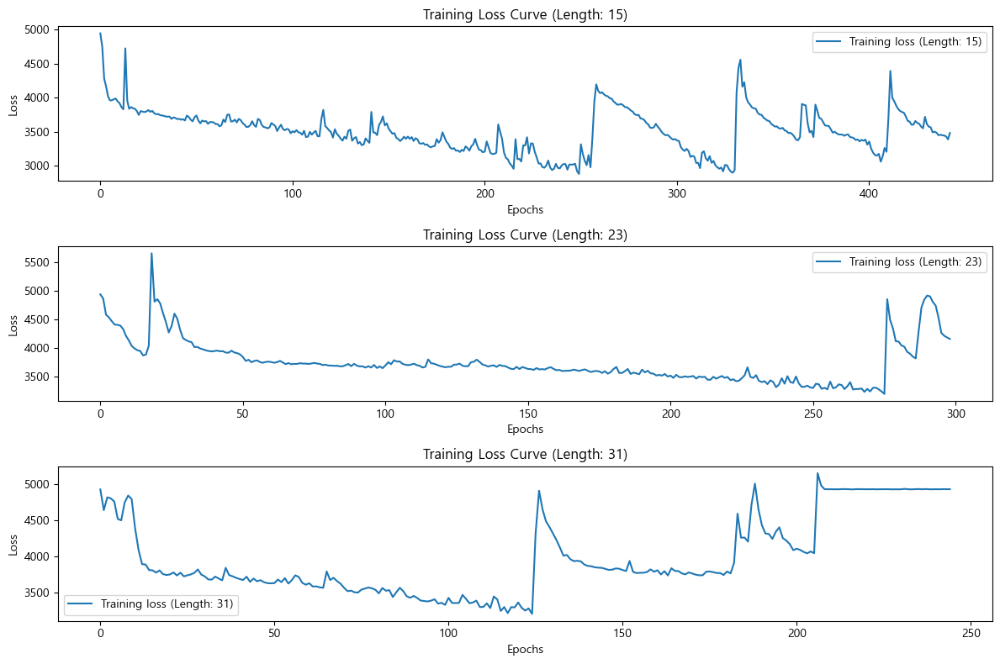

In [431]:
plt.figure(figsize=(12, 8))
seed_everything_tf(config.seed)

for idx, past_length in enumerate(past_lengths_m, 1):
    # model 정의
    model_name = f"model_ss_L_multi_{past_length}"
    input_shape_var = f"trainX_ss_{past_length}_m"
    
    input_shape_value = globals()[input_shape_var].shape
    input_shape = (input_shape_value[1], input_shape_value[2])
    
    globals()[model_name] = Sequential()
    globals()[model_name].add(LSTM(64, activation='relu', input_shape=input_shape, return_sequences=True))
    globals()[model_name].add(LSTM(32, activation='relu', return_sequences=True))
    globals()[model_name].add(Dropout(0.2))
    globals()[model_name].add(Flatten())
    globals()[model_name].add(Dense(8, activation='relu'))
    globals()[model_name].compile(optimizer='adam', loss='mae')
    
    # model 학습
    print("현재 ",past_length,"학습중")
    history_name = f"history_ss_L_multi_{past_length}"
    globals()[history_name] = globals()[model_name].fit(globals()[f"trainX_ss_{past_length}_m"],
                                                        globals()[f"trainY_ss_{past_length}_m"],
                                                        validation_data=(globals()[f"validX_ss_{past_length}_m"],
                                                                        globals()[f"validY_ss_{past_length}_m"]),
                                                        epochs=1000, batch_size=64,
                                                        verbose=1, callbacks=callbacks)
    
    # 서브플롯으로 Loss 곡선 표시
    plt.subplot(len(past_lengths), 1, idx)
    plt.plot(globals()[history_name].history['loss'], label=f'Training loss (Length: {past_length})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Training Loss Curve (Length: {past_length})')
    plt.legend()

plt.tight_layout()
plt.show()


In [480]:
prediction_ss_15_m = model_ss_L_multi_15.predict(testX_ss_15_m) 
testY_ss_15_m_re = testY_ss_15_m.reshape(testY_ss_15_m.shape[0]*8, 1, 1)
prediction_ss_15_m_re = prediction_ss_15_m.reshape(testY_ss_15_m.shape[0]*8, 1)

for _ in zip(prediction_ss_15_m_re, testY_ss_15_m_re):
    print(_)


12/12 [==============================] - 0s 4ms/step
(array([10593.381], dtype=float32), array([[1610.262]]))
(array([11132.758], dtype=float32), array([[8492.419333]]))
(array([10962.295], dtype=float32), array([[13345.77133]]))
(array([10416.111], dtype=float32), array([[11781.71333]]))
(array([10948.536], dtype=float32), array([[11699.203]]))
(array([11043.368], dtype=float32), array([[10247.519]]))
(array([10123.535], dtype=float32), array([[8715.345]]))
(array([9832.837], dtype=float32), array([[6992.309]]))
(array([6119.0146], dtype=float32), array([[7158.044333]]))
(array([6427.551], dtype=float32), array([[9287.556667]]))
(array([6310.7773], dtype=float32), array([[13307.53233]]))
(array([5999.0396], dtype=float32), array([[15576.27133]]))
(array([6294.6396], dtype=float32), array([[5865.019]]))
(array([6354.9443], dtype=float32), array([[5443.822]]))
(array([5819.2275], dtype=float32), array([[2711.306333]]))
(array([5612.2666], dtype=float32), array([[5682.105]]))
(array([598

(array([480.32205], dtype=float32), array([[1143.461]]))
(array([515.9511], dtype=float32), array([[2138.115]]))
(array([520.1893], dtype=float32), array([[2135.087]]))
(array([472.44086], dtype=float32), array([[1804.037]]))
(array([448.17194], dtype=float32), array([[3360.692]]))
(array([1113.0475], dtype=float32), array([[1204.845]]))
(array([1171.8379], dtype=float32), array([[939.9983333]]))
(array([1146.3239], dtype=float32), array([[1099.649333]]))
(array([1090.6895], dtype=float32), array([[1452.235333]]))
(array([1156.2714], dtype=float32), array([[2524.809333]]))
(array([1172.869], dtype=float32), array([[2564.601333]]))
(array([1065.159], dtype=float32), array([[733.3913333]]))
(array([1020.4327], dtype=float32), array([[46.243]]))
(array([2041.4211], dtype=float32), array([[21.478]]))
(array([2222.0732], dtype=float32), array([[211.5426667]]))
(array([2190.201], dtype=float32), array([[189.6423333]]))
(array([2123.9927], dtype=float32), array([[53.603]]))
(array([2245.3513]

(array([684.0453], dtype=float32), array([[451.7383333]]))
(array([733.9284], dtype=float32), array([[197.8536667]]))
(array([741.3439], dtype=float32), array([[738.5686667]]))
(array([672.3676], dtype=float32), array([[262.4696667]]))
(array([647.3324], dtype=float32), array([[181.0536667]]))
(array([2441.497], dtype=float32), array([[3042.705333]]))
(array([2650.8064], dtype=float32), array([[2143.353667]]))
(array([2592.776], dtype=float32), array([[4.27366667]]))
(array([2513.2678], dtype=float32), array([[4031.747]]))
(array([2676.5845], dtype=float32), array([[11705.25533]]))
(array([2726.4978], dtype=float32), array([[14328.72]]))
(array([2449.9302], dtype=float32), array([[13656.97433]]))
(array([2217.7334], dtype=float32), array([[7492.549333]]))
(array([3130.7256], dtype=float32), array([[13912.87133]]))
(array([3286.6663], dtype=float32), array([[15266.129]]))
(array([3233.8994], dtype=float32), array([[12796.85167]]))
(array([3090.634], dtype=float32), array([[8218.254667]]

(array([9278.004], dtype=float32), array([[5571.715333]]))
(array([9714.664], dtype=float32), array([[12933.591]]))
(array([9465.145], dtype=float32), array([[13211.05267]]))
(array([9166.442], dtype=float32), array([[13316.741]]))
(array([9621.545], dtype=float32), array([[11568.93667]]))
(array([9749.4795], dtype=float32), array([[9383.226333]]))
(array([8839.722], dtype=float32), array([[8126.073]]))
(array([8167.5605], dtype=float32), array([[4178.211667]]))
(array([4136.4336], dtype=float32), array([[4949.090333]]))
(array([4351.2407], dtype=float32), array([[4281.325333]]))
(array([4270.4272], dtype=float32), array([[5921.303333]]))
(array([4106.721], dtype=float32), array([[7286.009333]]))
(array([4316.199], dtype=float32), array([[4895.703667]]))
(array([4377.1714], dtype=float32), array([[5397.335667]]))
(array([3993.0256], dtype=float32), array([[4575.752667]]))
(array([3631.619], dtype=float32), array([[6757.821333]]))
(array([5722.283], dtype=float32), array([[10413.539]]))

In [481]:
print(model_score_test(validY_ss_15_m.reshape(-1, 1), model_ss_L_multi_15.predict(validX_ss_15_m).reshape(validY_ss_15_m.shape[0]*8, 1)))


12/12 [==============================] - 0s 4ms/step
R2 score: 0.2779680080406599
MAE Loss:  3313.2819244695156
(0.2779680080406599, 3313.2819244695156)


R2 score: 0.2188013743094419
MAE Loss:  3519.651632683063
(0.2188013743094419, 3519.651632683063)


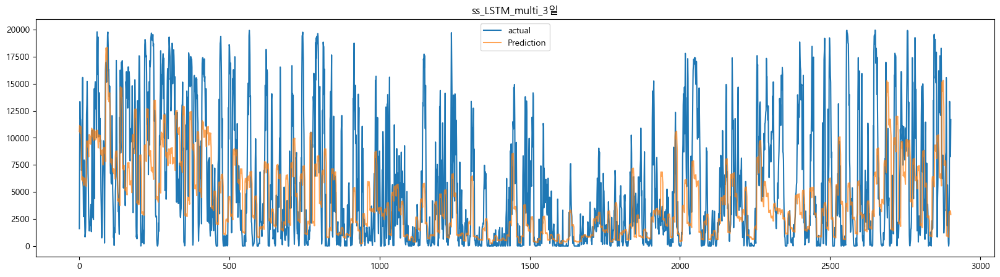

In [482]:
# LSTM
n = 0
m = -1
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_multi_3일')

plt.plot(testY_ss_15_m_re[n:m].reshape(-1, 1), alpha=1.0, label='actual')
plt.plot(prediction_ss_15_m_re[n:m], alpha=0.7, label='Prediction')
# plt.ylim(0, 2500)
plt.legend()
print(model_score_test(testY_ss_15_m_re.reshape(-1, 1), prediction_ss_15_m_re))


In [483]:
prediction_ss_23_m = model_ss_L_multi_23.predict(testX_ss_23_m) 
testY_ss_23_m_re = testY_ss_23_m.reshape(testY_ss_23_m.shape[0]*8, 1, 1)
prediction_ss_23_m_re = prediction_ss_23_m.reshape(testY_ss_23_m.shape[0]*8, 1)

for _ in zip(prediction_ss_23_m_re, testY_ss_23_m_re):
    print(_)


12/12 [==============================] - 0s 12ms/step
(array([10818.893], dtype=float32), array([[7158.044333]]))
(array([11650.232], dtype=float32), array([[9287.556667]]))
(array([11805.735], dtype=float32), array([[13307.53233]]))
(array([10745.786], dtype=float32), array([[15576.27133]]))
(array([11281.394], dtype=float32), array([[5865.019]]))
(array([12160.026], dtype=float32), array([[5443.822]]))
(array([10694.987], dtype=float32), array([[2711.306333]]))
(array([10860.872], dtype=float32), array([[5682.105]]))
(array([8227.37], dtype=float32), array([[7950.789667]]))
(array([8690.054], dtype=float32), array([[7799.546667]]))
(array([8807.335], dtype=float32), array([[2257.879667]]))
(array([7710.1714], dtype=float32), array([[840.6073333]]))
(array([8311.044], dtype=float32), array([[1142.664]]))
(array([8718.43], dtype=float32), array([[1716.327]]))
(array([7521.1606], dtype=float32), array([[5125.679]]))
(array([7947.6094], dtype=float32), array([[6663.873667]]))
(array([955

(array([3263.7947], dtype=float32), array([[9917.212]]))
(array([3607.3818], dtype=float32), array([[8082.394667]]))
(array([3680.1445], dtype=float32), array([[2586.343333]]))
(array([3094.6838], dtype=float32), array([[1871.132667]]))
(array([3436.2942], dtype=float32), array([[673.7006667]]))
(array([2360.0115], dtype=float32), array([[0.]]))
(array([2340.5295], dtype=float32), array([[0.]]))
(array([2315.905], dtype=float32), array([[77.14233333]]))
(array([1707.0089], dtype=float32), array([[22.37033333]]))
(array([2054.4072], dtype=float32), array([[0.]]))
(array([1877.7808], dtype=float32), array([[225.2613333]]))
(array([1437.9585], dtype=float32), array([[262.4283333]]))
(array([1939.5431], dtype=float32), array([[233.9603333]]))
(array([1385.4026], dtype=float32), array([[205.109]]))
(array([1362.1042], dtype=float32), array([[4305.701]]))
(array([1286.7407], dtype=float32), array([[6847.150667]]))
(array([822.4656], dtype=float32), array([[4351.782333]]))
(array([1061.2762],

(array([1185.7427], dtype=float32), array([[1044.675667]]))
(array([1376.1506], dtype=float32), array([[1111.480333]]))
(array([1307.1016], dtype=float32), array([[2968.988667]]))
(array([1055.6364], dtype=float32), array([[1613.98]]))
(array([1305.9213], dtype=float32), array([[608.2436667]]))
(array([1157.5094], dtype=float32), array([[128.7606667]]))
(array([1177.6104], dtype=float32), array([[985.7096667]]))
(array([1155.9529], dtype=float32), array([[803.4296667]]))
(array([901.07263], dtype=float32), array([[1329.952667]]))
(array([1059.1204], dtype=float32), array([[2014.725667]]))
(array([994.8959], dtype=float32), array([[2766.325667]]))
(array([790.118], dtype=float32), array([[823.6803333]]))
(array([1002.36566], dtype=float32), array([[165.293]]))
(array([1526.0312], dtype=float32), array([[862.566]]))
(array([1546.1127], dtype=float32), array([[1002.581333]]))
(array([1520.8115], dtype=float32), array([[219.9476667]]))
(array([1175.8593], dtype=float32), array([[889.813666

(array([2331.1077], dtype=float32), array([[4.27366667]]))
(array([1925.2506], dtype=float32), array([[4031.747]]))
(array([2165.196], dtype=float32), array([[11705.25533]]))
(array([2166.1475], dtype=float32), array([[14328.72]]))
(array([1797.1455], dtype=float32), array([[13656.97433]]))
(array([2051.0017], dtype=float32), array([[7492.549333]]))
(array([1466.0966], dtype=float32), array([[13912.87133]]))
(array([1487.0723], dtype=float32), array([[15266.129]]))
(array([1464.1755], dtype=float32), array([[12796.85167]]))
(array([1137.9547], dtype=float32), array([[8218.254667]]))
(array([1337.7257], dtype=float32), array([[6580.097333]]))
(array([1254.5696], dtype=float32), array([[2789.214667]]))
(array([995.15985], dtype=float32), array([[2663.610333]]))
(array([1266.362], dtype=float32), array([[1656.314667]]))
(array([1401.623], dtype=float32), array([[5305.009]]))
(array([1396.1542], dtype=float32), array([[3595.880333]]))
(array([1357.027], dtype=float32), array([[6721.077667]

(array([2223.7854], dtype=float32), array([[6813.612]]))
(array([1677.4507], dtype=float32), array([[5571.715333]]))
(array([1731.3965], dtype=float32), array([[12933.591]]))
(array([1705.4752], dtype=float32), array([[13211.05267]]))
(array([1385.3615], dtype=float32), array([[13316.741]]))
(array([1588.5469], dtype=float32), array([[11568.93667]]))
(array([1525.6302], dtype=float32), array([[9383.226333]]))
(array([1246.79], dtype=float32), array([[8126.073]]))
(array([1511.7411], dtype=float32), array([[4178.211667]]))
(array([1465.0935], dtype=float32), array([[4949.090333]]))
(array([1463.2239], dtype=float32), array([[4281.325333]]))
(array([1434.0443], dtype=float32), array([[5921.303333]]))
(array([1030.3008], dtype=float32), array([[7286.009333]]))
(array([1248.5039], dtype=float32), array([[4895.703667]]))
(array([1131.2792], dtype=float32), array([[5397.335667]]))
(array([842.12396], dtype=float32), array([[4575.752667]]))
(array([1173.8898], dtype=float32), array([[6757.821

In [484]:
print(model_score_test(validY_ss_23_m.reshape(-1, 1), model_ss_L_multi_23.predict(validX_ss_23_m).reshape(validY_ss_23_m.shape[0]*8, 1)))


12/12 [==============================] - 0s 5ms/step
R2 score: 0.020350303447789875
MAE Loss:  3937.682779108013
(0.020350303447789875, 3937.682779108013)


R2 score: -0.10678004459132051
MAE Loss:  4159.495828394588
(-0.10678004459132051, 4159.495828394588)


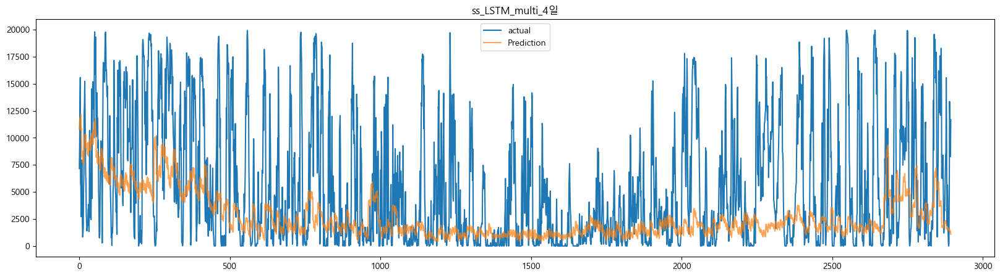

In [485]:
# LSTM
n = 0
m = -1
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_multi_4일')

plt.plot(testY_ss_23_m_re[n:m].reshape(-1, 1), alpha=1.0, label='actual')
plt.plot(prediction_ss_23_m_re[n:m], alpha=0.7, label='Prediction')
# plt.ylim(0, 2500)
plt.legend()
print(model_score_test(testY_ss_23_m_re.reshape(-1, 1), prediction_ss_23_m_re))


In [486]:
prediction_ss_31_m = model_ss_L_multi_31.predict(testX_ss_31_m) 
testY_ss_31_m_re = testY_ss_31_m.reshape(testY_ss_31_m.shape[0]*8, 1, 1)
prediction_ss_31_m_re = prediction_ss_31_m.reshape(testY_ss_31_m.shape[0]*8, 1)

for _ in zip(prediction_ss_31_m_re, testY_ss_31_m_re):
    print(_)


12/12 [==============================] - 0s 13ms/step
(array([6033.331], dtype=float32), array([[7950.789667]]))
(array([6220.7505], dtype=float32), array([[7799.546667]]))
(array([6160.883], dtype=float32), array([[2257.879667]]))
(array([5552.367], dtype=float32), array([[840.6073333]]))
(array([6131.9976], dtype=float32), array([[1142.664]]))
(array([6292.9614], dtype=float32), array([[1716.327]]))
(array([5877.839], dtype=float32), array([[5125.679]]))
(array([6204.196], dtype=float32), array([[6663.873667]]))
(array([8640.875], dtype=float32), array([[12179.894]]))
(array([8909.626], dtype=float32), array([[13057.93867]]))
(array([8815.558], dtype=float32), array([[15228.91133]]))
(array([7947.528], dtype=float32), array([[12109.994]]))
(array([8806.313], dtype=float32), array([[9457.282]]))
(array([9055.343], dtype=float32), array([[6682.244667]]))
(array([8470.009], dtype=float32), array([[5684.779]]))
(array([8922.936], dtype=float32), array([[2934.833]]))
(array([11885.868], d

(array([1548.2114], dtype=float32), array([[884.4676667]]))
(array([1600.8992], dtype=float32), array([[1805.083]]))
(array([1569.403], dtype=float32), array([[2386.564]]))
(array([1408.8295], dtype=float32), array([[3603.072]]))
(array([1561.6335], dtype=float32), array([[3938.234667]]))
(array([1589.6947], dtype=float32), array([[2090.094333]]))
(array([1456.9774], dtype=float32), array([[4106.301]]))
(array([1559.4751], dtype=float32), array([[6983.067333]]))
(array([1663.0901], dtype=float32), array([[6901.021667]]))
(array([1719.2181], dtype=float32), array([[6734.972333]]))
(array([1685.8972], dtype=float32), array([[11294.50633]]))
(array([1513.5383], dtype=float32), array([[14861.81967]]))
(array([1675.4192], dtype=float32), array([[10687.55167]]))
(array([1706.6604], dtype=float32), array([[14766.34733]]))
(array([1565.5592], dtype=float32), array([[18180.005]]))
(array([1674.7407], dtype=float32), array([[17150.74733]]))
(array([2033.7169], dtype=float32), array([[13920.947]]

(array([1427.5658], dtype=float32), array([[0.]]))
(array([1580.5133], dtype=float32), array([[309.5693333]]))
(array([1610.4534], dtype=float32), array([[1034.174333]]))
(array([1477.499], dtype=float32), array([[1070.689]]))
(array([1580.1587], dtype=float32), array([[1241.653333]]))
(array([1484.6631], dtype=float32), array([[1668.690333]]))
(array([1535.1368], dtype=float32), array([[3935.952333]]))
(array([1504.5934], dtype=float32), array([[6846.404]]))
(array([1349.725], dtype=float32), array([[5897.72]]))
(array([1497.9131], dtype=float32), array([[612.0066667]]))
(array([1524.1207], dtype=float32), array([[4766.104]]))
(array([1396.0582], dtype=float32), array([[10249.41067]]))
(array([1494.6592], dtype=float32), array([[8545.040333]]))
(array([1310.9753], dtype=float32), array([[3819.883667]]))
(array([1358.355], dtype=float32), array([[2870.963333]]))
(array([1325.5228], dtype=float32), array([[2459.388667]]))
(array([1190.8315], dtype=float32), array([[1822.991]]))
(array([

(array([2109.9634], dtype=float32), array([[8667.944667]]))
(array([2176.605], dtype=float32), array([[12946.17133]]))
(array([2140.344], dtype=float32), array([[14687.526]]))
(array([1920.7433], dtype=float32), array([[7983.083333]]))
(array([2118.0486], dtype=float32), array([[4908.205]]))
(array([2163.401], dtype=float32), array([[3299.974667]]))
(array([1993.4548], dtype=float32), array([[6536.852667]]))
(array([2126.0925], dtype=float32), array([[5275.607333]]))
(array([2018.8008], dtype=float32), array([[4797.739333]]))
(array([2083.9727], dtype=float32), array([[3612.87]]))
(array([2046.5952], dtype=float32), array([[5131.967667]]))
(array([1837.6251], dtype=float32), array([[7012.648333]]))
(array([2027.7509], dtype=float32), array([[7047.860667]]))
(array([2069.7014], dtype=float32), array([[8125.692]]))
(array([1904.6174], dtype=float32), array([[4320.506]]))
(array([2033.4963], dtype=float32), array([[2946.767]]))
(array([2599.4844], dtype=float32), array([[1578.056667]]))
(

(array([1795.5461], dtype=float32), array([[18692.48133]]))
(array([1760.8474], dtype=float32), array([[16148.66033]]))
(array([1579.4092], dtype=float32), array([[12993.73567]]))
(array([1750.25], dtype=float32), array([[14007.76867]]))
(array([1782.0815], dtype=float32), array([[7961.028]]))
(array([1633.4973], dtype=float32), array([[7176.261333]]))
(array([1748.2046], dtype=float32), array([[2951.523333]]))
(array([1760.9376], dtype=float32), array([[1279.900667]]))
(array([1819.6495], dtype=float32), array([[1531.144]]))
(array([1784.8906], dtype=float32), array([[2647.730333]]))
(array([1601.2264], dtype=float32), array([[4378.529667]]))
(array([1773.331], dtype=float32), array([[2982.968333]]))
(array([1806.3209], dtype=float32), array([[2947.949]]))
(array([1656.5078], dtype=float32), array([[5384.035]]))
(array([1772.3265], dtype=float32), array([[3821.764667]]))
(array([2357.2402], dtype=float32), array([[2134.033]]))
(array([2430.0674], dtype=float32), array([[1511.694333]])

In [487]:
print(model_score_test(validY_ss_31_m.reshape(-1, 1), model_ss_L_multi_31.predict(validX_ss_31_m).reshape(validY_ss_31_m.shape[0]*8, 1)))


12/12 [==============================] - 0s 12ms/step
R2 score: -0.007991732628198411
MAE Loss:  4027.8006658562203
(-0.007991732628198411, 4027.8006658562203)


R2 score: -0.04688415325984119
MAE Loss:  4164.405574298516
(-0.04688415325984119, 4164.405574298516)


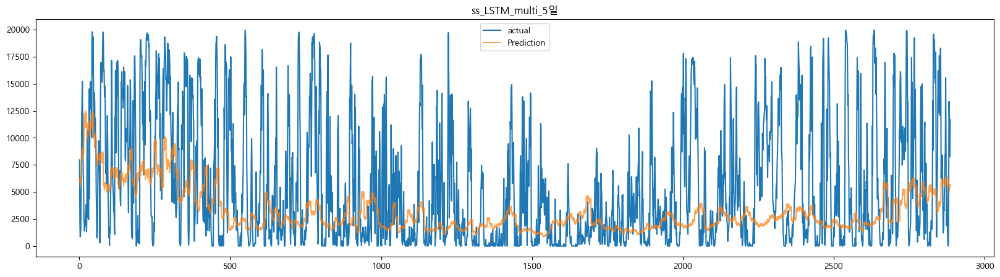

In [488]:
# LSTM
n = 0
m = -1
plt.figure(figsize=(20, 5))
plt.title('ss_LSTM_multi_5일')

plt.plot(testY_ss_31_m_re[n:m].reshape(-1, 1), alpha=1.0, label='actual')
plt.plot(prediction_ss_31_m_re[n:m], alpha=0.7, label='Prediction')
# plt.ylim(0, 2500)
plt.legend()
print(model_score_test(testY_ss_31_m_re.reshape(-1, 1), prediction_ss_31_m_re))


In [1681]:
seed_everything_tf(config.seed)
model_ss_L_multi = Sequential()
model_ss_L_multi.add(LSTM(64, activation='relu', input_shape=(trainX_ss_m.shape[1], trainX_ss_m.shape[2]),return_sequences=True))
                             #return_sequences=True))
model_ss_L_multi.add(LSTM(32, activation='relu', return_sequences=True))
#model.add(LSTM(64, activation='relu', return_sequences=True))
#model.add(Bidirectional(LSTM(24, activation='relu', return_sequences=False)))
model_ss_L_multi.add(Dropout(0.2))
model_ss_L_multi.add(Flatten())
model_ss_L_multi.add(Dense(trainY_ss_m.shape[1], activation='relu'))#, return_sequences=False))
#model.add(Dense(32, activation='relu'))#, return_sequences=False))
#model.add(Dense(8, activation='relu'))#, return_sequences=False))
#model.add(Dense(trainY.shape[1]))

model_ss_L_multi.compile(optimizer='adam', loss='mae')

Epoch 1/1000
45/45 [==============================] - 3s 21ms/step - loss: 4538.9775 - val_loss: 4412.1211
Epoch 2/1000
45/45 [==============================] - 1s 12ms/step - loss: 4204.0786 - val_loss: 4618.2119
Epoch 3/1000
45/45 [==============================] - 1s 12ms/step - loss: 4108.0518 - val_loss: 4294.8765
Epoch 4/1000
45/45 [==============================] - 1s 13ms/step - loss: 4003.9807 - val_loss: 4239.4580
Epoch 5/1000
45/45 [==============================] - 1s 12ms/step - loss: 3930.9592 - val_loss: 4180.5649
Epoch 6/1000
45/45 [==============================] - 1s 12ms/step - loss: 3889.0156 - val_loss: 4153.8770
Epoch 7/1000
45/45 [==============================] - 1s 12ms/step - loss: 3880.4070 - val_loss: 4138.2837
Epoch 8/1000
45/45 [==============================] - 1s 12ms/step - loss: 3833.0886 - val_loss: 4125.3594
Epoch 9/1000
45/45 [==============================] - 1s 12ms/step - loss: 3814.6663 - val_loss: 4145.3345
Epoch 10/1000
45/45 [================

Epoch 77/1000
45/45 [==============================] - 1s 12ms/step - loss: 3613.8228 - val_loss: 4056.5325
Epoch 78/1000
45/45 [==============================] - 1s 12ms/step - loss: 3626.0955 - val_loss: 3991.5872
Epoch 79/1000
45/45 [==============================] - 1s 12ms/step - loss: 3616.1504 - val_loss: 3976.9019
Epoch 80/1000
45/45 [==============================] - 1s 12ms/step - loss: 3635.3809 - val_loss: 4017.9304
Epoch 81/1000
45/45 [==============================] - 1s 12ms/step - loss: 3569.9243 - val_loss: 3962.2019
Epoch 82/1000
45/45 [==============================] - 1s 12ms/step - loss: 3605.2175 - val_loss: 3966.6289
Epoch 83/1000
45/45 [==============================] - 1s 12ms/step - loss: 3587.4414 - val_loss: 3942.4824
Epoch 84/1000
45/45 [==============================] - 1s 12ms/step - loss: 3568.2144 - val_loss: 3972.3667
Epoch 85/1000
45/45 [==============================] - 1s 12ms/step - loss: 3562.6548 - val_loss: 3954.0442
Epoch 86/1000
45/45 [=======

45/45 [==============================] - 1s 12ms/step - loss: 2613.3884 - val_loss: 3401.0293
Epoch 228/1000
45/45 [==============================] - 1s 12ms/step - loss: 2600.8948 - val_loss: 3401.9033
Epoch 229/1000
45/45 [==============================] - 1s 12ms/step - loss: 2604.6521 - val_loss: 4259.7061
Epoch 230/1000
45/45 [==============================] - 1s 13ms/step - loss: 2664.6167 - val_loss: 3686.5227
Epoch 231/1000
45/45 [==============================] - 1s 12ms/step - loss: 2529.7290 - val_loss: 3797.9990
Epoch 232/1000
45/45 [==============================] - 1s 11ms/step - loss: 2481.9175 - val_loss: 3534.2356
Epoch 233/1000
45/45 [==============================] - 1s 12ms/step - loss: 2501.0540 - val_loss: 3509.6970
Epoch 234/1000
45/45 [==============================] - 1s 12ms/step - loss: 2590.5518 - val_loss: 3345.4958
Epoch 235/1000
45/45 [==============================] - 1s 12ms/step - loss: 2529.0916 - val_loss: 3811.7058
Epoch 236/1000
45/45 [============

45/45 [==============================] - 1s 13ms/step - loss: 3673.9651 - val_loss: 3919.9939
Epoch 378/1000
45/45 [==============================] - 1s 13ms/step - loss: 3762.5515 - val_loss: 4121.1934
Epoch 379/1000
45/45 [==============================] - 1s 13ms/step - loss: 3760.7825 - val_loss: 4035.8887
Epoch 380/1000
45/45 [==============================] - 1s 13ms/step - loss: 3888.6887 - val_loss: 4193.1494
Epoch 381/1000
45/45 [==============================] - 1s 13ms/step - loss: 3774.6296 - val_loss: 4083.7046
Epoch 382/1000
45/45 [==============================] - 1s 13ms/step - loss: 3743.5254 - val_loss: 4042.1821
Epoch 383/1000
45/45 [==============================] - 1s 13ms/step - loss: 3713.8884 - val_loss: 4046.8254
Epoch 384/1000
45/45 [==============================] - 1s 12ms/step - loss: 3700.9397 - val_loss: 4022.6685
Epoch 385/1000
45/45 [==============================] - 1s 13ms/step - loss: 3726.5027 - val_loss: 4029.1265
Epoch 386/1000
45/45 [============

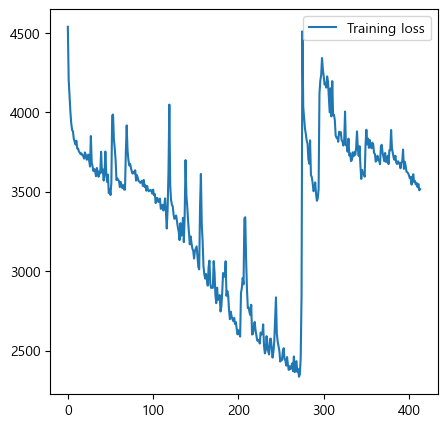

In [1081]:
history_ss_L_multi = model_ss_L_multi.fit(trainX_ss_m, trainY_ss_m,validation_data = (validX_ss_m,validY_ss_m) ,epochs=1000, batch_size=16,verbose=1,callbacks =callbacks)
best_epoch = callbacks[0].best_epoch
best_epoch_score = callbacks[0].best
print("Best epoch:", best_epoch, "Best epoch Score:", best_epoch_score)
#validation_split=0.2,
plt.plot(history_ss_L_multi.history['loss'], label='Training loss')
#plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [1082]:
prediction_ss_m = model_ss_L_multi.predict(testX_ss_m) 
testY_ss_m_re = testY_ss_m.reshape(testY_ss_m.shape[0]*8,1,1)
prediction_ss_m_re = prediction_ss_m.reshape(testY_ss_m.shape[0]*8,1)

for _ in zip(prediction_ss_m_re,testY_ss_m_re):
    print(_)

12/12 [==============================] - 0s 6ms/step
(array([9853.816], dtype=float32), array([[1610.262]]))
(array([10388.608], dtype=float32), array([[8492.419333]]))
(array([10760.119], dtype=float32), array([[13345.77133]]))
(array([10643.323], dtype=float32), array([[11781.71333]]))
(array([11533.761], dtype=float32), array([[11699.203]]))
(array([11792.829], dtype=float32), array([[10247.519]]))
(array([10866.579], dtype=float32), array([[8715.345]]))
(array([10294.779], dtype=float32), array([[6992.309]]))
(array([9511.419], dtype=float32), array([[7158.044333]]))
(array([9777.961], dtype=float32), array([[9287.556667]]))
(array([9885.236], dtype=float32), array([[13307.53233]]))
(array([9489.275], dtype=float32), array([[15576.27133]]))
(array([10086.022], dtype=float32), array([[5865.019]]))
(array([10280.929], dtype=float32), array([[5443.822]]))
(array([9371.661], dtype=float32), array([[2711.306333]]))
(array([9040.719], dtype=float32), array([[5682.105]]))
(array([7288.692

(array([1017.8437], dtype=float32), array([[779.6296667]]))
(array([989.47687], dtype=float32), array([[1060.861]]))
(array([827.29987], dtype=float32), array([[1799.679667]]))
(array([897.79346], dtype=float32), array([[1584.657333]]))
(array([3289.1125], dtype=float32), array([[3183.543333]]))
(array([3124.539], dtype=float32), array([[2227.884]]))
(array([2666.6575], dtype=float32), array([[5165.753667]]))
(array([1969.7974], dtype=float32), array([[5686.874667]]))
(array([1771.288], dtype=float32), array([[352.1436667]]))
(array([1783.7361], dtype=float32), array([[26.163]]))
(array([1449.8184], dtype=float32), array([[469.5776667]]))
(array([1607.7153], dtype=float32), array([[38.98733333]]))
(array([6928.2495], dtype=float32), array([[1085.073667]]))
(array([7442.0127], dtype=float32), array([[11204.71467]]))
(array([7791.7314], dtype=float32), array([[5005.423]]))
(array([7855.768], dtype=float32), array([[2436.556667]]))
(array([8593.903], dtype=float32), array([[1851.334]]))
(

(array([3690.399], dtype=float32), array([[8125.692]]))
(array([3300.2192], dtype=float32), array([[4320.506]]))
(array([3280.972], dtype=float32), array([[2946.767]]))
(array([5680.747], dtype=float32), array([[1578.056667]]))
(array([5300.2686], dtype=float32), array([[776.5406667]]))
(array([4658.2544], dtype=float32), array([[1765.456333]]))
(array([3633.7283], dtype=float32), array([[2293.252667]]))
(array([3320.5647], dtype=float32), array([[1444.814333]]))
(array([3351.1812], dtype=float32), array([[18.388]]))
(array([2806.9194], dtype=float32), array([[93.32033333]]))
(array([3040.674], dtype=float32), array([[843.9266667]]))
(array([6111.1934], dtype=float32), array([[1637.038333]]))
(array([6104.013], dtype=float32), array([[2683.490333]]))
(array([5866.219], dtype=float32), array([[4738.327333]]))
(array([5347.935], dtype=float32), array([[5977.333]]))
(array([5476.4214], dtype=float32), array([[3720.69]]))
(array([5518.4263], dtype=float32), array([[3177.980333]]))
(array([

(array([1483.0006], dtype=float32), array([[2415.731333]]))
(array([3220.3247], dtype=float32), array([[2720.710667]]))
(array([3451.0393], dtype=float32), array([[3529.743]]))
(array([3535.8674], dtype=float32), array([[4808.831333]]))
(array([3470.8083], dtype=float32), array([[4959.188333]]))
(array([3797.3179], dtype=float32), array([[5645.495667]]))
(array([3868.3457], dtype=float32), array([[5883.981333]]))
(array([3528.406], dtype=float32), array([[8781.19]]))
(array([3338.984], dtype=float32), array([[11024.48267]]))
(array([10360.21], dtype=float32), array([[13970.857]]))
(array([10669.561], dtype=float32), array([[13263.97833]]))
(array([10812.274], dtype=float32), array([[9426.185667]]))
(array([10428.527], dtype=float32), array([[11705.383]]))
(array([11093.701], dtype=float32), array([[13103.574]]))
(array([11301.719], dtype=float32), array([[11914.71367]]))
(array([10300.404], dtype=float32), array([[13315.542]]))
(array([9832.193], dtype=float32), array([[18861.54333]]))

(array([6396.377], dtype=float32), array([[7240.882667]]))
(array([6885.122], dtype=float32), array([[12036.234]]))
(array([6972.271], dtype=float32), array([[14179.62633]]))
(array([6354.0166], dtype=float32), array([[14785.47467]]))
(array([5765.0054], dtype=float32), array([[10704.269]]))
(array([7067.1226], dtype=float32), array([[6843.444]]))
(array([7282.159], dtype=float32), array([[14991.01733]]))
(array([7200.289], dtype=float32), array([[13008.98867]]))
(array([6830.629], dtype=float32), array([[5805.757333]]))
(array([7189.951], dtype=float32), array([[3279.409333]]))
(array([7320.0894], dtype=float32), array([[4155.265]]))
(array([6625.9688], dtype=float32), array([[4326.388]]))
(array([6202.741], dtype=float32), array([[893.284]]))
(array([7994.139], dtype=float32), array([[614.7293333]]))
(array([8461.073], dtype=float32), array([[10536.46367]]))
(array([8657.163], dtype=float32), array([[11447.487]]))
(array([8528.914], dtype=float32), array([[4319.224]]))
(array([9125.2

In [1083]:
print(model_score_test(validY_ss_m.reshape(-1,1),model_ss_L_multi.predict(validX_ss_m).reshape(validY_ss_m.shape[0]*8,1)))

12/12 [==============================] - 0s 5ms/step
R2 score: 0.3481747735173404
MAE Loss:  3173.2882416437574
(0.3481747735173404, 3173.2882416437574)


R2 score: 0.3285037649240664
MAE Loss:  3201.1396065492127
(0.3285037649240664, 3201.1396065492127)


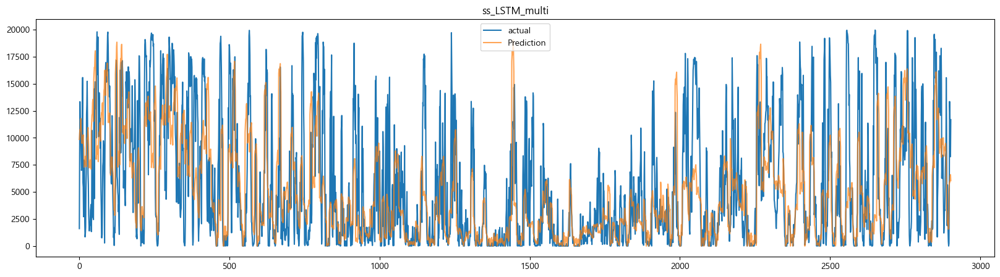

In [1084]:
# LSTM
n= 0
m= -1
plt.figure(figsize = (20,5))
plt.title('ss_LSTM_multi')

plt.plot(testY_ss_m_re[n:m].reshape(-1,1),alpha= 1.0,label = 'actual')
plt.plot(prediction_ss_m_re[n:m],alpha=0.7, label = 'Prediction')
#plt.ylim(0)
plt.legend()
print(model_score_test(testY_ss_m_re.reshape(-1,1),prediction_ss_m_re))

In [148]:
model_hk1_lstm_22.save('best_model/hk1_lstm_22.h5')
model_hk1_lstm_30.save('best_model/hk1_lstm_30.h5')
model_hk1_lstm_38.save('best_model/hk1_lstm_38.h5')

model_hk1_L_multi_15.save('best_model/hk1_m_lstm_15.h5')
model_hk1_L_multi_23.save('best_model/hk1_m_lstm_23.h5')
model_hk1_L_multi_31.save('best_model/hk1_m_lstm_38.h5')

model_hk2_lstm_22.save('best_model/hk2_lstm_22.h5')
model_hk2_lstm_30.save('best_model/hk2_lstm_30.h5')
model_hk2_lstm_38.save('best_model/hk2_lstm_38.h5')

model_hk2_L_multi_15.save('best_model/hk2_m_lstm_15.h5')
model_hk2_L_multi_23.save('best_model/hk2_m_lstm_23.h5')
model_hk2_L_multi_31.save('best_model/hk2_m_lstm_31.h5')

model_ss_lstm_22.save('best_model/ss_lstm_22.h5')
model_ss_lstm_30.save('best_model/ss_lstm_30.h5')
model_ss_lstm_38.save('best_model/ss_lstm_38.h5')

model_ss_L_multi_15.save('best_model/ss_m_lstm_15.h5')
model_ss_L_multi_23.save('best_model/ss_m_lstm_23.h5')
model_ss_L_multi_31.save('best_model/ss_m_lstm_31.h5')

print("모델 저장 완료")

모델 저장 완료


In [79]:
import torch
import torch.nn as nn
import numpy as np

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super(PositionalEncoding, self).__init__()
        pe = torch.zeros(max_len, d_model)
        self.max_len = max_len
        position = torch.arange(max_len-1, -1, -1, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-np.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        #pe.requires_grad = False
        self.register_buffer('pe', pe)

    def forward(self, x):
        #print("iiinput", x.shape)
        return x + self.pe[self.max_len-x.size(0):, :]

class TransformerEncoder(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.src_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.transformerencoderlayer = nn.TransformerEncoderLayer(d_model=self.d_model, nhead=self.nhead, dim_feedforward=self.dim_feedforward, dropout=self.dropout)
        self.norm = nn.LayerNorm(d_model)
        self.transformerencoder = nn.TransformerEncoder(encoder_layer=self.transformerencoderlayer, num_layers=self.num_layers, norm=self.norm)


    def forward(self, src):
        if self.src_mask is None or self.src_mask.size(0) != len(src):
            device = src.device
            mask = self._generate_square_subsequent_mask(len(src)).to(device)
            self.src_mask = mask
        outputs = self.transformerencoder(src=src, mask=self.src_mask)

        return outputs

    def _generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

class TransformerDecoder(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.memory_mask = None
        self.tgt_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.transformerdecoderlayer = nn.TransformerDecoderLayer(d_model=self.d_model, nhead=self.nhead,
                                                                  dim_feedforward=self.dim_feedforward,
                                                                  dropout=self.dropout)
        self.norm = nn.LayerNorm(d_model)
        self.transformerdecoder = nn.TransformerDecoder(decoder_layer=self.transformerdecoderlayer,
                                                        num_layers=self.num_layers, norm=self.norm)

    def forward(self, tgt, memory):
        if self.tgt_mask is None or self.tgt_mask.size(0) != len(tgt):
            device = tgt.device
            mask = self._generate_square_subsequent_mask(len(tgt), len(tgt)).to(device)
            self.tgt_mask = mask

        if self.memory_mask is None or self.memory_mask.size(0) != len(memory):
            device = memory.device
            mask = self._generate_square_subsequent_mask(len(tgt), len(memory)).to(device)
            self.memory_mask = mask

        outputs = self.transformerdecoder(tgt=tgt, memory=memory, tgt_mask=self.tgt_mask, memory_mask=self.memory_mask)
        return outputs

    def _generate_square_subsequent_mask(self, tgt_sz, src_sz):
        mask = (torch.triu(torch.ones(src_sz, tgt_sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask


class Transformer(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.src_mask = None
        self.tgt_mask = None
        self.memory_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.embedding = nn.Linear(self.input_size, self.hidden_size)
        self.positional_encoding = PositionalEncoding(d_model=self.d_model)

        self.transformerEncoder = TransformerEncoder(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=input_size,
                    hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)
        self.transformerDecoder = TransformerDecoder(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=input_size,
                        hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

        self.fc = nn.Linear(self.d_model, 1)

    def expandByNhead(self, vector, Nhead, dim=2):
        return torch.cat([vector for head in range(Nhead)], dim=dim)

In [80]:
class SimpleTransformer(Transformer): #PVTRANS_ED
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__(d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers)

    def forward(self, inputs):
        #print("input은 : ", inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print("input은 : ", inputs.shape)
        src = inputs[:-1]
        tgt = inputs[-1:]
        #print("src = ", src.shape,src, "tgt = ", tgt.shape,tgt)
        
        src = self.embedding(src)
        src = self.expandByNhead(src, self.nhead)
        src = self.positional_encoding(src)
        memory = self.transformerEncoder(src)

        tgt = self.embedding(tgt)
        tgt = self.expandByNhead(tgt, self.nhead)
        tgt = self.positional_encoding(tgt)
        
        outputs = self.transformerDecoder(tgt, memory)
        outputs = outputs.transpose(0, 1)
        outputs = self.fc(outputs)

        return outputs

In [81]:
class SimpleTransformer_multi(Transformer): #PVTRANS_ED
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__(d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers)

    def forward(self, inputs):
        #print("input은 : ", inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print("input은 : ", inputs.shape)
        src = inputs[:-8]
        tgt = inputs[-8:]
        #print("src = ", src.shape,src, "tgt = ", tgt.shape,tgt)
        
        src = self.embedding(src)
        src = self.expandByNhead(src, self.nhead)
        src = self.positional_encoding(src)
        memory = self.transformerEncoder(src)

        tgt = self.embedding(tgt)
        tgt = self.expandByNhead(tgt, self.nhead)
        tgt = self.positional_encoding(tgt)
        
        outputs = self.transformerDecoder(tgt, memory)
        outputs = outputs.transpose(0, 1)
        outputs = self.fc(outputs)

        return outputs

In [82]:
class BaseLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, dropout=self.dropout, num_layers=self.num_layers)

class Encoder(BaseLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs):
        h0 = torch.zeros(self.num_layers, inputs.size(1), self.hidden_size).cuda(0)
        c0 = torch.zeros(self.num_layers, inputs.size(1), self.hidden_size).cuda(0)
        hidden = (h0, c0)

        return self.lstm(inputs, hidden)

class Decoder(BaseLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs, hidden):
        return self.lstm(inputs, hidden)

class SimpleLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.num_layers = num_layers
        self.encoder = Encoder(input_size=self.input_size, hidden_size=self.hidden_size, dropout=self.dropout,
                               num_layers=self.num_layers)
        self.decoder = Decoder(input_size=self.input_size, hidden_size=self.hidden_size, dropout=self.dropout,
                               num_layers=self.num_layers)
        self.fc = nn.Linear(hidden_size, 1)



In [83]:
class windLSTM(SimpleLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs):
        #print(inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print(inputs.shape)
        #print("inputs[:-1]", inputs[:-1])
        #print("inputs[-1:]", inputs[-1:])
        enc_outputs, enc_hidden = self.encoder(inputs[:-1])
        #print("enc_outputs : ", enc_outputs)
        #print("enc_hidden : ", enc_hidden)
        dec_outputs, dec_hidden = self.decoder(inputs[-1:], enc_hidden)
        dec_outputs = dec_outputs.transpose(0, 1)
        #print("dec_outputs : ", dec_outputs)
        output = self.fc(dec_outputs)
        #print("output : ", output)
        return output

In [84]:
def model_score_target(y_label, y_pred, target):
    try:
        print("R2 score:", sklearn.metrics.r2_score(y_label, y_pred))
        print("MAE Loss: ", sklearn.metrics.mean_absolute_error(y_label, y_pred))
    except Exception as e:
        print(e)


In [85]:
def model_score_test(y_label, y_pred):
    print("R2 score:", sklearn.metrics.r2_score(y_label, y_pred))
    print("MAE Loss: ", sklearn.metrics.mean_absolute_error(y_label, y_pred))
    r2 = sklearn.metrics.r2_score(y_label, y_pred)
    mae = sklearn.metrics.mean_absolute_error(y_label, y_pred)
    return r2, mae

In [86]:
def model_score(y_label, y_pred, target):
    try:
        print("R2 score:", sklearn.metrics.r2_score(y_label, y_pred))
        print("MAE Loss: ", sklearn.metrics.mean_absolute_error(y_label, y_pred))
    except Exception as e:
        print(e)

In [305]:
# train 함수
def trainer(train_data, val_data, model, criterion, optimizer, n_epoch, target, PATH, isEDR=False):
    dev = 0
    model = model.cuda(dev)
    criterion = criterion.cuda(dev)
    
    phase = ["train", "val"]

    stop_loss = -1
    stop_step = 0
    max_stop = 200
    best_epoch = 0 
    train_loss = []
    val_loss = []
    best_model_state = None
    best_val_loss = float('inf')
    
    for epoch in range(n_epoch):
        print("Epoch {}/{}".format(epoch, n_epoch))
        for p in phase:
            if p == "train":
                print("TRAIN")
                model.train()
                data = train_data
            else:
                print("Validation")
                model.eval()
                data = val_data

            total_loss = 0
            y_label = []
            y_pred = []

            if isEDR:
                for x, y, w in data:
                    x = x.cuda(dev)
                    y = y.cuda(dev)
                    w = w.cuda(dev)

                    optimizer.zero_grad()

                    _y = model(x, w)

                    loss = criterion(y, _y)

                    if p == 'train':
                        loss.backward()
                        optimizer.step()

                    total_loss += loss.item()
                    y_label.extend(y.reshape(-1).tolist())
                    y_pred.extend(_y.reshape(-1).tolist())
            else:
                for x, y in data:
                    x = x.cuda(dev)
                    y = y.cuda(dev)

                    optimizer.zero_grad()

                    _y = model(x)

                    loss = criterion(_y, y)

                    if p == 'train':
                        loss.backward()
                        optimizer.step()

                    total_loss += loss.item()
                    y_label.extend(y.reshape(-1).tolist())
                    y_pred.extend(_y.reshape(-1).tolist())

            model_score(y_label, y_pred, target)

            if p == "val":
                val_loss.append(total_loss)
                if total_loss < stop_loss or stop_loss == -1:
                    torch.save(model.state_dict(), PATH)
                    stop_loss = total_loss
                    stop_step = 0
                    best_epoch = epoch
                    best_model_state = model.state_dict()
                    print("최신화")
                    #print(best_model_state['embedding.weight'][0])
                    best_val_loss = total_loss

                else:
                    stop_step += 1
                    
                    if stop_step == max_stop:
                        print("Early Stopping!")
                        print("Best_epoch:",best_epoch)
                        if best_model_state is not None:
                            #print(best_model_state['embedding.weight'][0])
                            model.load_state_dict(best_model_state)
                        return train_loss, val_loss
            else:
                train_loss.append(total_loss)
    if best_model_state is not None:
        model.load_state_dict(best_model_state)
    return train_loss, val_loss

In [88]:
def test(data, model,isEDR=False):
    dev = 0
    model.eval()
    model = model.cuda(dev)

    y_label = []
    y_pred = []

    with torch.no_grad():
        if isEDR:
            for x, y, w in data:
                x = x.cuda(dev)
                y = y.cuda(dev)
                w = w.cuda(dev)

                _y = model(x, w)
                _y = torch.where(_y < 0, torch.tensor(0.0).cuda(dev), _y)
                y_label.extend(y.reshape(-1).tolist())
                y_pred.extend(_y.reshape(-1).tolist())
        else:
            for x, y in data:
                x = x.cuda(dev)
                y = y.cuda(dev)

                _y = model(x)
                _y = torch.where(_y < 0, torch.tensor(0.0).cuda(dev), _y)
                y_label.extend(y.reshape(-1).tolist())
                y_pred.extend(_y.reshape(-1).tolist())
    
    for _ in range(len(y_label)):
        y_label_plt.append(y_label[_])
        y_pred_plt.append(y_pred[_])
        print("y_label : ", y_label[_], "y_pred : ", y_pred[_])
    print("y_label-y_pred")
    return model_score_test(y_label, y_pred)

In [89]:
def plot_scatter(y_test_, pred_, alpha=0.5, s=15):
    plt.rcParams['font.family'] = 'Malgun Gothic'
    plt.rcParams['figure.figsize'] = (5,5)
    # mpl.rcParams['axes.unicode_minus'] = False

    fig, ax = plt.subplots()

    plt.scatter(y_test_, pred_, alpha=alpha, s=s)
    plt.xlabel('Actual', fontsize=12)
    plt.ylabel('Predicted', fontsize=12)
    plt.xticks(fontsize = 14, color = 'black')
    plt.yticks(fontsize = 14, color = 'black')

    print('xlim is', ax.get_xlim())
    print('ylim is', ax.get_ylim())

    lims = [0, np.max([ax.get_xlim(), ax.get_ylim()])]

    ax.plot(lims, lims, '--', alpha=1, zorder=0, color='black')
    ax.set_aspect('equal')

    plt.grid(alpha=0.8)
    plt.show()

In [308]:
n_epoch = 1000  # 100, 300, 500
batch_size = 64
hidden_size = 16
num_layers = 1
history_length = 16
nhead = 8  # 2, 4, 8
d_model = hidden_size * nhead
dim_feedforward = d_model * 4

In [150]:
names = ["hk1","hk2","ss"]

In [309]:
for name in names:
    for past_length in past_lengths:

        trainX_name = f"trainX_{name}_{past_length}"
        trainY_name = f"trainY_{name}_{past_length}"
        validX_name = f"validX_{name}_{past_length}"
        validY_name = f"validY_{name}_{past_length}"
        testX_name = f"testX_{name}_{past_length}"
        testY_name = f"testY_{name}_{past_length}"
        train_dataset_name = f"train_dataset_{name}_{past_length}"
        valid_dataset_name = f"valid_dataset_{name}_{past_length}"
        test_dataset_name = f"test_dataset_{name}_{past_length}"
        train_loader_name = f"train_loader_{name}_{past_length}"
        valid_loader_name = f"valid_loader_{name}_{past_length}"
        test_loader_name = f"test_loader_{name}_{past_length}"


        globals()[train_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[trainX_name]).float(),torch.from_numpy(globals()[trainY_name]).float())
        globals()[valid_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[validX_name]).float(),torch.from_numpy(globals()[validY_name]).float())
        globals()[test_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[testX_name]).float(),torch.from_numpy(globals()[testY_name]).float())

        globals()[train_loader_name] =DataLoader(globals()[train_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)
        globals()[valid_loader_name] =DataLoader(globals()[valid_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)
        globals()[test_loader_name] =DataLoader(globals()[test_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)




In [310]:
for name in names:
    for past_length in past_lengths_m:

        trainX_name = f"trainX_{name}_{past_length}_m"
        trainY_name = f"trainY_{name}_{past_length}_m"
        validX_name = f"validX_{name}_{past_length}_m"
        validY_name = f"validY_{name}_{past_length}_m"
        testX_name = f"testX_{name}_{past_length}_m"
        testY_name = f"testY_{name}_{past_length}_m"
        train_dataset_name = f"train_dataset_{name}_{past_length}_m"
        valid_dataset_name = f"valid_dataset_{name}_{past_length}_m"
        test_dataset_name = f"test_dataset_{name}_{past_length}_m"
        train_loader_name = f"train_loader_{name}_{past_length}_m"
        valid_loader_name = f"valid_loader_{name}_{past_length}_m"
        test_loader_name = f"test_loader_{name}_{past_length}_m"


        globals()[train_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[trainX_name]).float(),torch.from_numpy(globals()[trainY_name]).float())
        globals()[valid_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[validX_name]).float(),torch.from_numpy(globals()[validY_name]).float())
        globals()[test_dataset_name] = torch.utils.data.TensorDataset(torch.from_numpy(globals()[testX_name]).float(),torch.from_numpy(globals()[testY_name]).float())

        globals()[train_loader_name] =DataLoader(globals()[train_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)
        globals()[valid_loader_name] =DataLoader(globals()[valid_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)
        globals()[test_loader_name] =DataLoader(globals()[test_dataset_name], batch_size=batch_size, shuffle = False, num_workers=0)




In [1091]:
train_dataset_hk1 = torch.utils.data.TensorDataset(torch.from_numpy(trainX_hk1).float(),torch.from_numpy(trainY_hk1).float())
valid_dataset_hk1 = torch.utils.data.TensorDataset(torch.from_numpy(validX_hk1).float(),torch.from_numpy(validY_hk1).float())
test_dataset_hk1 = torch.utils.data.TensorDataset(torch.from_numpy(testX_hk1).float(),torch.from_numpy(testY_hk1).float())

In [1092]:
train_loader_hk1 = DataLoader(train_dataset_hk1,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_hk1 = DataLoader(valid_dataset_hk1, batch_size = batch_size, shuffle =False, num_workers=0)
test_loader_hk1 = DataLoader(test_dataset_hk1,batch_size= batch_size,shuffle = False, num_workers=0)

In [1093]:
#멀티
train_dataset_hk1_m = torch.utils.data.TensorDataset(torch.from_numpy(trainX_hk1_m).float(),torch.from_numpy(trainY_hk1_m).float())
valid_dataset_hk1_m = torch.utils.data.TensorDataset(torch.from_numpy(validX_hk1_m).float(),torch.from_numpy(validY_hk1_m).float())
test_dataset_hk1_m = torch.utils.data.TensorDataset(torch.from_numpy(testX_hk1_m).float(),torch.from_numpy(testY_hk1_m).float())

In [1094]:
#멀티
train_loader_hk1_m = DataLoader(train_dataset_hk1_m,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_hk1_m = DataLoader(valid_dataset_hk1_m,batch_size= batch_size,shuffle = False, num_workers=0)
test_loader_hk1_m = DataLoader(test_dataset_hk1_m,batch_size= batch_size,shuffle = False, num_workers=0)


In [1095]:
train_dataset_hk2 = torch.utils.data.TensorDataset(torch.from_numpy(trainX_hk2).float(),torch.from_numpy(trainY_hk2).float())
valid_dataset_hk2 = torch.utils.data.TensorDataset(torch.from_numpy(validX_hk2).float(),torch.from_numpy(validY_hk2).float())
test_dataset_hk2 = torch.utils.data.TensorDataset(torch.from_numpy(testX_hk2).float(),torch.from_numpy(testY_hk2).float())

In [1096]:
train_loader_hk2 = DataLoader(train_dataset_hk2,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_hk2 = DataLoader(valid_dataset_hk2, batch_size = batch_size, shuffle =False, num_workers=0)
test_loader_hk2 = DataLoader(test_dataset_hk2,batch_size= batch_size,shuffle = False, num_workers=0)

In [1097]:
#멀티
train_dataset_hk2_m = torch.utils.data.TensorDataset(torch.from_numpy(trainX_hk2_m).float(),torch.from_numpy(trainY_hk2_m).float())
valid_dataset_hk2_m = torch.utils.data.TensorDataset(torch.from_numpy(validX_hk2_m).float(),torch.from_numpy(validY_hk2_m).float())
test_dataset_hk2_m = torch.utils.data.TensorDataset(torch.from_numpy(testX_hk2_m).float(),torch.from_numpy(testY_hk2_m).float())

In [1272]:
#멀티
train_loader_hk2_m = DataLoader(train_dataset_hk2_m,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_hk2_m = DataLoader(valid_dataset_hk2_m,batch_size= batch_size,shuffle = False, num_workers=0)
test_loader_hk2_m = DataLoader(test_dataset_hk2_m,batch_size= batch_size,shuffle = False, num_workers=0)

In [1099]:
train_dataset_ss = torch.utils.data.TensorDataset(torch.from_numpy(trainX_ss).float(),torch.from_numpy(trainY_ss).float())
valid_dataset_ss = torch.utils.data.TensorDataset(torch.from_numpy(validX_ss).float(),torch.from_numpy(validY_ss).float())
test_dataset_ss = torch.utils.data.TensorDataset(torch.from_numpy(testX_ss).float(),torch.from_numpy(testY_ss).float())

In [1100]:
train_loader_ss = DataLoader(train_dataset_ss,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_ss = DataLoader(valid_dataset_ss, batch_size = batch_size, shuffle =False, num_workers=0)
test_loader_ss = DataLoader(test_dataset_ss,batch_size= batch_size,shuffle = False, num_workers=0)

In [1101]:
#멀티
train_dataset_ss_m = torch.utils.data.TensorDataset(torch.from_numpy(trainX_ss_m).float(),torch.from_numpy(trainY_ss_m).float())
valid_dataset_ss_m = torch.utils.data.TensorDataset(torch.from_numpy(validX_ss_m).float(),torch.from_numpy(validY_ss_m).float())
test_dataset_ss_m = torch.utils.data.TensorDataset(torch.from_numpy(testX_ss_m).float(),torch.from_numpy(testY_ss_m).float())

In [1102]:
#멀티
train_loader_ss_m = DataLoader(train_dataset_ss_m,batch_size= batch_size,shuffle = False, num_workers=0)
valid_loader_ss_m = DataLoader(valid_dataset_ss_m,batch_size= batch_size,shuffle = False, num_workers=0)
test_loader_ss_m = DataLoader(test_dataset_ss_m,batch_size= batch_size,shuffle = False, num_workers=0)

In [154]:
n_features = 12

In [330]:
for past_length in past_lengths:
    model_name = f"model_hk1_{past_length}"
    
    globals()[model_name] = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)


In [331]:
for past_length in past_lengths:
    model_name = f"model_hk2_{past_length}"
    
    globals()[model_name] = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)


In [332]:
for past_length in past_lengths:
    model_name = f"model_ss_{past_length}"
    
    globals()[model_name] = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)


In [311]:
for past_length in past_lengths_m:
    model_name = f"model_hk1_{past_length}_m"
    
    globals()[model_name] = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [333]:
for past_length in past_lengths_m:
    model_name = f"model_hk2_{past_length}_m"
    
    globals()[model_name] = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [334]:
for past_length in past_lengths_m:
    model_name = f"model_ss_{past_length}_m"
    
    globals()[model_name] = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [ ]:
torch.save(model_hk1,save_path+'/transformer_hk1.pth')
torch.save(model_hk1_m,save_path+'/transformer_hk1_m.pth')
torch.save(model_hk2,save_path+'/transformer_hk2.pth')
torch.save(model_hk2_m,save_path+'/transformer_hk2_m.pth')
torch.save(model_ss,save_path+'/transformer_ss.pth')
torch.save(model_ss_m,save_path+'/transformer_ss_m.pth')

In [207]:
names

['hk1', 'hk2', 'ss']

In [678]:
past_lengths = [22,30,38]

In [679]:
for name in names:
    for past_length in past_lengths:
        model_name=f"model_{name}_{past_length}"
        torch.save(globals()[model_name],save_path+f'/transformer_{name}_{past_length}')

In [680]:
for name in names:
    for past_length in past_lengths_m:
        model_name=f"model_{name}_{past_length}_m"
        torch.save(globals()[model_name],save_path+f'/transformer_{name}_{past_length}_m')

In [1230]:
model_hk1 = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [1231]:
model_hk1_m = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [1232]:
model_hk2 = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [1367]:
model_hk2_m = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [1234]:
model_ss = SimpleTransformer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [1235]:
model_ss_m = SimpleTransformer_multi(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=n_features,
                            hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

In [163]:
save_path = './best_model'

# torch.save(model_hk1,save_path+'/transformer_hk1.pth')
# torch.save(model_hk1_m,save_path+'/transformer_hk1_m.pth')
# torch.save(model_hk2,save_path+'/transformer_hk2.pth')
# torch.save(model_hk2_m,save_path+'/transformer_hk2_m.pth')
# torch.save(model_ss,save_path+'/transformer_ss.pth')
# torch.save(model_ss_m,save_path+'/transformer_ss_m.pth')

In [166]:
PATH = "./best_model/bestmodel.pth"
isEDR = False

In [312]:
#hk1_multi_15
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_15_m.parameters(), lr=lr)
train_loss_hk1_15_m, val_loss_hk1_15_m = trainer(train_loader_hk1_15_m, valid_loader_hk1_15_m, model_hk1_15_m, criterion, optimizer, target='hk1', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk1_15_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7597754088539992
MAE Loss:  1266.568226957988
Validation
R2 score: -0.6973241738470726
MAE Loss:  1192.7256655400429
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7564476221686838
MAE Loss:  1264.8721000677097
Validation
R2 score: -0.6954708458550152
MAE Loss:  1191.80792484773
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7545597738851406
MAE Loss:  1263.8913533439356
Validation
R2 score: -0.6935380903269683
MAE Loss:  1190.8660487588777
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7525120811462278
MAE Loss:  1262.8427286873211
Validation
R2 score: -0.6914557951312099
MAE Loss:  1189.8709583964153
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7503344594371102
MAE Loss:  1261.7475375054464
Validation
R2 score: -0.6892104311366511
MAE Loss:  1188.8194789870586
최신화
Epoch 5/1000
TRAIN
R2 score: -0.7479926200774671
MAE Loss:  1260.5851413823511
Validation
R2 score: -0.6868119702943429
MAE Loss:  1187.7171624352475
최신화
Epoch 6/1000
TRAIN
R2 score: -0.7454970028842653
MAE Loss:  1259.3657868620262


최신화
Epoch 54/1000
TRAIN
R2 score: -0.4467168678940432
MAE Loss:  1088.3830337347736
Validation
R2 score: -0.3971770800779175
MAE Loss:  1048.6001360671528
최신화
Epoch 55/1000
TRAIN
R2 score: -0.4383798725880994
MAE Loss:  1084.0430879711032
Validation
R2 score: -0.3899788616322446
MAE Loss:  1045.3331580064284
최신화
Epoch 56/1000
TRAIN
R2 score: -0.42997038839052104
MAE Loss:  1080.5330207645827
Validation
R2 score: -0.38088824846432656
MAE Loss:  1042.6110089402723
최신화
Epoch 57/1000
TRAIN
R2 score: -0.4216754666397513
MAE Loss:  1075.2052343934552
Validation
R2 score: -0.371385919846384
MAE Loss:  1039.7074066726925
최신화
Epoch 58/1000
TRAIN
R2 score: -0.4132673109030005
MAE Loss:  1073.016135204123
Validation
R2 score: -0.36481272499968975
MAE Loss:  1035.4636282332442
최신화
Epoch 59/1000
TRAIN
R2 score: -0.4049288816718193
MAE Loss:  1066.528557318684
Validation
R2 score: -0.3554021197638477
MAE Loss:  1033.312263090729
최신화
Epoch 60/1000
TRAIN
R2 score: -0.39586319191500685
MAE Loss:  1062.

R2 score: -0.014305059580127288
MAE Loss:  880.9307378279893
Validation
R2 score: 0.009217911478435648
MAE Loss:  878.6652813709244
최신화
Epoch 108/1000
TRAIN
R2 score: -0.005963984443071224
MAE Loss:  878.3907730759888
Validation
R2 score: 0.004720108576998339
MAE Loss:  879.4842095010745
Epoch 109/1000
TRAIN
R2 score: 0.0003237945037378731
MAE Loss:  875.2048474024858
Validation
R2 score: 0.004186632805088686
MAE Loss:  885.5305993424774
Epoch 110/1000
TRAIN
R2 score: 0.006376892822260505
MAE Loss:  870.9443914438519
Validation
R2 score: 0.02183387031877937
MAE Loss:  877.4514801280783
최신화
Epoch 111/1000
TRAIN
R2 score: 0.014849697557425934
MAE Loss:  864.1404802843274
Validation
R2 score: 0.02987333085783006
MAE Loss:  876.4675778925322
최신화
Epoch 112/1000
TRAIN
R2 score: 0.02130532803640961
MAE Loss:  861.7472220881039
Validation
R2 score: 0.03917011688615102
MAE Loss:  875.5817027463102
최신화
Epoch 113/1000
TRAIN
R2 score: 0.028129483707812097
MAE Loss:  857.4959454996191
Validation
R2

R2 score: 0.3177390254933965
MAE Loss:  721.2629930219816
Validation
R2 score: 0.3074458600723924
MAE Loss:  758.9963975625732
최신화
Epoch 162/1000
TRAIN
R2 score: 0.31842753516751154
MAE Loss:  719.7475876184898
Validation
R2 score: 0.30998621197672194
MAE Loss:  765.27586289387
Epoch 163/1000
TRAIN
R2 score: 0.32432476314925196
MAE Loss:  717.2998007965582
Validation
R2 score: 0.31320106432043193
MAE Loss:  763.7354912592103
Epoch 164/1000
TRAIN
R2 score: 0.3275226068369852
MAE Loss:  715.3845633235891
Validation
R2 score: 0.32350332618667166
MAE Loss:  766.5630977938162
Epoch 165/1000
TRAIN
R2 score: 0.33384300883529794
MAE Loss:  715.0047204886584
Validation
R2 score: 0.32609503089214176
MAE Loss:  752.741666967277
최신화
Epoch 166/1000
TRAIN
R2 score: 0.3422017347877413
MAE Loss:  709.3819746606337
Validation
R2 score: 0.3244633222727764
MAE Loss:  746.9060872886561
최신화
Epoch 167/1000
TRAIN
R2 score: 0.3443465036283164
MAE Loss:  708.1038159432649
Validation
R2 score: 0.325606877591554

R2 score: 0.5014983595269382
MAE Loss:  673.7365988122458
Epoch 217/1000
TRAIN
R2 score: 0.5389089094372151
MAE Loss:  607.2155700963322
Validation
R2 score: 0.5019083933276224
MAE Loss:  665.6264461021394
최신화
Epoch 218/1000
TRAIN
R2 score: 0.5396089126799817
MAE Loss:  604.4764871148311
Validation
R2 score: 0.5054025635477521
MAE Loss:  675.1851004087802
Epoch 219/1000
TRAIN
R2 score: 0.5469285851298787
MAE Loss:  601.3102108778064
Validation
R2 score: 0.5083273402128503
MAE Loss:  669.5360910609585
Epoch 220/1000
TRAIN
R2 score: 0.5370990581844193
MAE Loss:  606.6682598923636
Validation
R2 score: 0.5098326672752793
MAE Loss:  668.6158333712252
Epoch 221/1000
TRAIN
R2 score: 0.5497046809867356
MAE Loss:  600.1077940620949
Validation
R2 score: 0.510651795347701
MAE Loss:  655.7555897273917
최신화
Epoch 222/1000
TRAIN
R2 score: 0.5588696710032783
MAE Loss:  595.8871989953071
Validation
R2 score: 0.48803802614403635
MAE Loss:  668.0479903277087
Epoch 223/1000
TRAIN
R2 score: 0.5522704318739

R2 score: 0.6692214128570141
MAE Loss:  515.7561667470839
Validation
R2 score: 0.5866712165268512
MAE Loss:  613.7449023842704
Epoch 273/1000
TRAIN
R2 score: 0.6693869653166804
MAE Loss:  520.0923973468748
Validation
R2 score: 0.5904534591604631
MAE Loss:  613.3802408225563
Epoch 274/1000
TRAIN
R2 score: 0.6649412831095327
MAE Loss:  526.6962180886123
Validation
R2 score: 0.5967105392486577
MAE Loss:  599.5482426588244
최신화
Epoch 275/1000
TRAIN
R2 score: 0.6723196273345553
MAE Loss:  520.8113536446497
Validation
R2 score: 0.5998121941925599
MAE Loss:  598.233271421422
최신화
Epoch 276/1000
TRAIN
R2 score: 0.6678406732832838
MAE Loss:  521.1174139384225
Validation
R2 score: 0.5932253548037784
MAE Loss:  606.9884850545709
Epoch 277/1000
TRAIN
R2 score: 0.6726900999416559
MAE Loss:  516.4021084013875
Validation
R2 score: 0.5943585512627654
MAE Loss:  624.4448149752378
Epoch 278/1000
TRAIN
R2 score: 0.6690984507773265
MAE Loss:  524.3100559552571
Validation
R2 score: 0.5787087349166973
MAE Los

R2 score: 0.7430177631113959
MAE Loss:  457.4261615051424
Validation
R2 score: 0.622857378030909
MAE Loss:  578.7063063608232
최신화
Epoch 330/1000
TRAIN
R2 score: 0.7486211983315283
MAE Loss:  448.97011414805627
Validation
R2 score: 0.6217722081474786
MAE Loss:  581.8683837377389
Epoch 331/1000
TRAIN
R2 score: 0.7533350987412321
MAE Loss:  448.3384762989078
Validation
R2 score: 0.6262285754713203
MAE Loss:  578.7990172087793
최신화
Epoch 332/1000
TRAIN
R2 score: 0.7478087825307296
MAE Loss:  452.8828941832625
Validation
R2 score: 0.6376705128354081
MAE Loss:  572.2066321480933
최신화
Epoch 333/1000
TRAIN
R2 score: 0.7382473944295298
MAE Loss:  453.9554805868039
Validation
R2 score: 0.5917953171721799
MAE Loss:  625.4622676299634
Epoch 334/1000
TRAIN
R2 score: 0.7308559632813892
MAE Loss:  479.90331338200303
Validation
R2 score: 0.5808944864132843
MAE Loss:  600.2296382475639
Epoch 335/1000
TRAIN
R2 score: 0.7394938734104348
MAE Loss:  468.11898479078627
Validation
R2 score: 0.6181986441622107


R2 score: 0.7913197190109028
MAE Loss:  406.97237455051953
Validation
R2 score: 0.6364734368904473
MAE Loss:  572.2473330175949
Epoch 387/1000
TRAIN
R2 score: 0.7951202544584547
MAE Loss:  409.4423350276522
Validation
R2 score: 0.6199030321797576
MAE Loss:  575.4791124580444
Epoch 388/1000
TRAIN
R2 score: 0.7923992652165406
MAE Loss:  414.2979945664983
Validation
R2 score: 0.657231766588382
MAE Loss:  548.4909480426148
최신화
Epoch 389/1000
TRAIN
R2 score: 0.7897172425178077
MAE Loss:  403.54359429687423
Validation
R2 score: 0.6379169494030525
MAE Loss:  568.4381507207604
Epoch 390/1000
TRAIN
R2 score: 0.8024749573428978
MAE Loss:  395.5040508410033
Validation
R2 score: 0.637817134230606
MAE Loss:  571.5179825174996
Epoch 391/1000
TRAIN
R2 score: 0.8034912062509895
MAE Loss:  395.53528650684535
Validation
R2 score: 0.6207288281091174
MAE Loss:  571.992631082707
Epoch 392/1000
TRAIN
R2 score: 0.8120961990990696
MAE Loss:  385.9744837932244
Validation
R2 score: 0.6350094041051886
MAE Loss: 

R2 score: 0.8453804200664936
MAE Loss:  336.65137695913864
Validation
R2 score: 0.6268942192775828
MAE Loss:  556.9493338640876
Epoch 444/1000
TRAIN
R2 score: 0.8390666317052292
MAE Loss:  348.1431871756836
Validation
R2 score: 0.6476959152707973
MAE Loss:  550.6065566450495
Epoch 445/1000
TRAIN
R2 score: 0.8312384477165249
MAE Loss:  351.4405758321006
Validation
R2 score: 0.6034475720007673
MAE Loss:  583.9329498290663
Epoch 446/1000
TRAIN
R2 score: 0.8213574552403571
MAE Loss:  366.18362989467477
Validation
R2 score: 0.6234320468751955
MAE Loss:  570.3833712103577
Epoch 447/1000
TRAIN
R2 score: 0.8209315634946264
MAE Loss:  367.426535939426
Validation
R2 score: 0.6226006578030092
MAE Loss:  562.2546099939736
Epoch 448/1000
TRAIN
R2 score: 0.8194384220927784
MAE Loss:  367.57142657389164
Validation
R2 score: 0.6497218576120366
MAE Loss:  547.7016879871953
최신화
Epoch 449/1000
TRAIN
R2 score: 0.8408274612829174
MAE Loss:  341.8981572619577
Validation
R2 score: 0.6414475351486414
MAE Loss

R2 score: 0.8737952658898372
MAE Loss:  303.3211439990788
Validation
R2 score: 0.6263563370836646
MAE Loss:  560.9052746286078
Epoch 501/1000
TRAIN
R2 score: 0.8790435372474233
MAE Loss:  293.8210208375328
Validation
R2 score: 0.6189931043672161
MAE Loss:  561.8497766397131
Epoch 502/1000
TRAIN
R2 score: 0.8764839648273454
MAE Loss:  296.87485518548453
Validation
R2 score: 0.6213466069760194
MAE Loss:  562.3780429854472
Epoch 503/1000
TRAIN
R2 score: 0.868816466204006
MAE Loss:  303.18774420497107
Validation
R2 score: 0.6074017431115712
MAE Loss:  569.7201854913255
Epoch 504/1000
TRAIN
R2 score: 0.882303305013018
MAE Loss:  291.897504558655
Validation
R2 score: 0.6228162080365965
MAE Loss:  563.9567087436898
Epoch 505/1000
TRAIN
R2 score: 0.8674598217390317
MAE Loss:  303.93503329760057
Validation
R2 score: 0.6200895588419829
MAE Loss:  558.741869833154
Epoch 506/1000
TRAIN
R2 score: 0.86842194071505
MAE Loss:  312.5294048957102
Validation
R2 score: 0.6405935025788927
MAE Loss:  551.39

R2 score: 0.8644786964788287
MAE Loss:  300.33269706338314
Validation
R2 score: 0.5558172784337475
MAE Loss:  606.1655667080304
Epoch 557/1000
TRAIN
R2 score: 0.8644053443076902
MAE Loss:  313.2916444548646
Validation
R2 score: 0.5965992557566211
MAE Loss:  574.0680571329847
Epoch 558/1000
TRAIN
R2 score: 0.8770079129456763
MAE Loss:  293.2320784384643
Validation
R2 score: 0.6350791702739103
MAE Loss:  544.9280190540319
Epoch 559/1000
TRAIN
R2 score: 0.8827155014691632
MAE Loss:  283.57612154564066
Validation
R2 score: 0.625802268228857
MAE Loss:  558.8554443255205
Epoch 560/1000
TRAIN
R2 score: 0.885407834722551
MAE Loss:  284.6651374174436
Validation
R2 score: 0.6064620579077531
MAE Loss:  570.810857545234
Epoch 561/1000
TRAIN
R2 score: 0.8822235206297949
MAE Loss:  288.4604216141493
Validation
R2 score: 0.6113600794416847
MAE Loss:  563.6798472268952
Epoch 562/1000
TRAIN
R2 score: 0.8784046490796348
MAE Loss:  288.5185053475783
Validation
R2 score: 0.6376297693007873
MAE Loss:  546.

R2 score: 0.8932707706719104
MAE Loss:  270.77956154135495
Validation
R2 score: 0.5996190853528187
MAE Loss:  581.1650539439524
Epoch 614/1000
TRAIN
R2 score: 0.8940242921884995
MAE Loss:  270.67621990884015
Validation
R2 score: 0.6010525214726623
MAE Loss:  565.3542896789565
Epoch 615/1000
TRAIN
R2 score: 0.8958727307858615
MAE Loss:  271.315761316222
Validation
R2 score: 0.6216219454573764
MAE Loss:  562.9387843658262
Epoch 616/1000
TRAIN
R2 score: 0.8772203021302623
MAE Loss:  291.7810360121212
Validation
R2 score: 0.5546613124783619
MAE Loss:  605.399538633585
Epoch 617/1000
TRAIN
R2 score: 0.8865024804278054
MAE Loss:  284.278050642788
Validation
R2 score: 0.5890702981920656
MAE Loss:  574.5863149912777
Epoch 618/1000
TRAIN
R2 score: 0.8982781312604322
MAE Loss:  259.96757254066176
Validation
R2 score: 0.5932347609914186
MAE Loss:  575.8302454925475
Epoch 619/1000
TRAIN
R2 score: 0.9123592340398372
MAE Loss:  249.58990485378325
Validation
R2 score: 0.6055212465798738
MAE Loss:  57

R2 score: 0.9207093502991615
MAE Loss:  234.79224454374534
Validation
R2 score: 0.6073486669528892
MAE Loss:  571.8498053826612
Epoch 671/1000
TRAIN
R2 score: 0.9244581219322989
MAE Loss:  225.84770752140648
Validation
R2 score: 0.5868733951479379
MAE Loss:  575.8396276429393
Epoch 672/1000
TRAIN
R2 score: 0.9236108730258169
MAE Loss:  231.08405973232047
Validation
R2 score: 0.5933673063940936
MAE Loss:  578.2416897818093
Epoch 673/1000
TRAIN
R2 score: 0.9252962969604542
MAE Loss:  227.2729389134505
Validation
R2 score: 0.5959619347012699
MAE Loss:  573.8644416170006
Epoch 674/1000
TRAIN
R2 score: 0.91541065926881
MAE Loss:  242.62357365763523
Validation
R2 score: 0.5973590997345539
MAE Loss:  577.0930285449882
Early Stopping!
Best_epoch: 474


<All keys matched successfully>

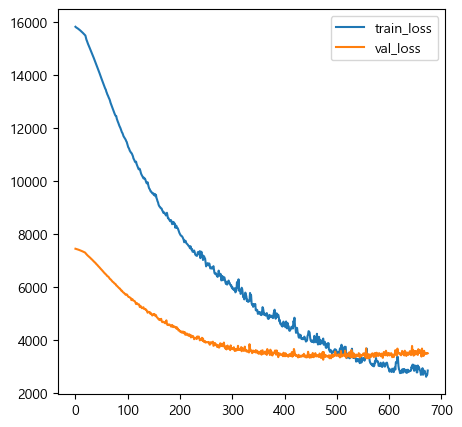

In [313]:
plt.plot(train_loss_hk1_15_m, label = 'train_loss')
plt.plot(val_loss_hk1_15_m, label = 'val_loss')
plt.legend()
plt.show()

In [314]:
val_r2_hk1_15_m, val_mae_hk1_15_m = test(valid_loader_hk1_15_m, model_hk1_15_m,isEDR=isEDR)


y_label :  0.10000000149011612 y_pred :  0.0
y_label :  8.627778053283691 y_pred :  228.47462463378906
y_label :  156.79444885253906 y_pred :  470.8946838378906
y_label :  100.19444274902344 y_pred :  56.499107360839844
y_label :  21.733333587646484 y_pred :  0.0
y_label :  0.5611110925674438 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.644444465637207 y_pred :  0.0
y_label :  0.0 y_pred :  1197.0902099609375
y_label :  66.19444274902344 y_pred :  1250.898193359375
y_label :  603.1777954101562 y_pred :  1398.1016845703125
y_label :  1650.4610595703125 y_pred :  1948.5482177734375
y_label :  1889.9111328125 y_pred :  2314.138671875
y_label :  2012.8721923828125 y_pred :  1998.31201171875
y_label :  2372.111083984375 y_pred :  1828.610107421875
y_label :  1686.494384765625 y_pred :  1885.69091796875
y_label :  1970.388916015625 y_pred :  1430.783203125
y_label :  1248.572265625 y_pred :  1006.1178588867188
y_label :  1660.594482421875 y_pred :  2448.2236328125
y_label :  1807.

In [315]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_15_m, test_mae_hk1_15_m = test(test_loader_hk1_15_m, model_hk1_15_m, isEDR=isEDR)
y_label_hk1_15_m = y_label_plt
y_pred_hk1_15_m = y_pred_plt

y_label :  1393.0333251953125 y_pred :  2348.148193359375
y_label :  1355.5555419921875 y_pred :  2193.0400390625
y_label :  1758.755615234375 y_pred :  1734.589599609375
y_label :  2251.755615234375 y_pred :  1563.560791015625
y_label :  2202.522216796875 y_pred :  1082.2333984375
y_label :  1494.5888671875 y_pred :  1347.710205078125
y_label :  1038.177734375 y_pred :  1473.552978515625
y_label :  489.1555480957031 y_pred :  1169.2803955078125
y_label :  307.5888977050781 y_pred :  699.4614868164062
y_label :  279.3888854980469 y_pred :  1808.3388671875
y_label :  1166.844482421875 y_pred :  1644.9752197265625
y_label :  741.9055786132812 y_pred :  1677.8572998046875
y_label :  662.1166381835938 y_pred :  1712.8914794921875
y_label :  1486.611083984375 y_pred :  2196.62451171875
y_label :  1089.4888916015625 y_pred :  2013.256103515625
y_label :  651.7666625976562 y_pred :  1437.269287109375
y_label :  320.98333740234375 y_pred :  1236.503662109375
y_label :  1276.2667236328125 y_pre

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-207.02543945312502, 4347.534228515625)


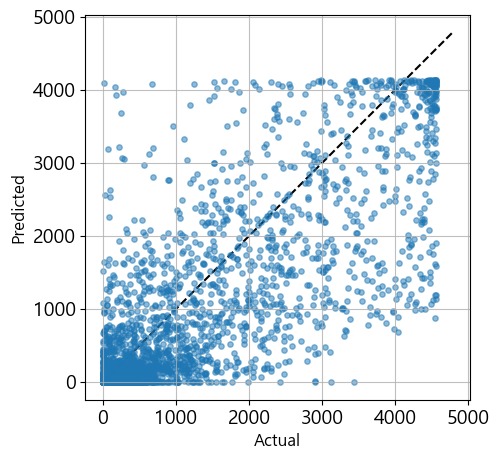

In [316]:
plot_scatter(y_label_hk1_15_m,y_pred_hk1_15_m)

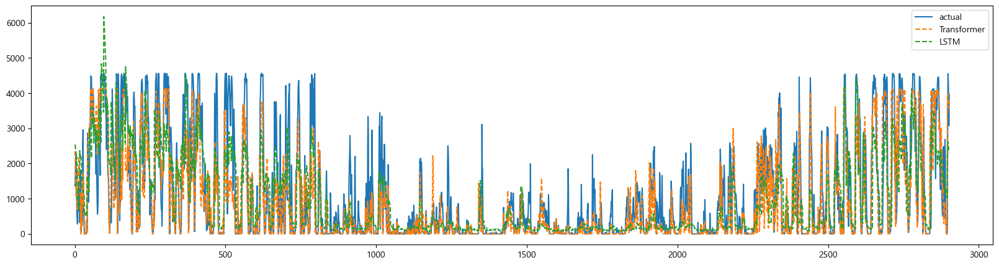

In [317]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_15_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_15_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_15_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

In [318]:
#hk1_multi_23
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_23_m.parameters(), lr=lr)
train_loss_hk1_23_m, val_loss_hk1_23_m = trainer(train_loader_hk1_23_m, valid_loader_hk1_23_m, model_hk1_23_m, criterion, optimizer, target='hk1', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk1_23_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7583400493495411
MAE Loss:  1266.1302633588841
Validation
R2 score: -0.7002603818825128
MAE Loss:  1195.8242907687898
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7549842829930984
MAE Loss:  1264.425286045887
Validation
R2 score: -0.69844080142178
MAE Loss:  1194.9231683585188
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7531307812797372
MAE Loss:  1263.4624419722818
Validation
R2 score: -0.6965310873545643
MAE Loss:  1193.9915185363413
최신화
Epoch 3/1000
TRAIN
R2 score: -0.751126286790659
MAE Loss:  1262.43680516455
Validation
R2 score: -0.6944786396821709
MAE Loss:  1193.0094856192504
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7489858264209057
MAE Loss:  1261.359267229004
Validation
R2 score: -0.69226585244648
MAE Loss:  1191.9716016699049
최신화
Epoch 5/1000
TRAIN
R2 score: -0.7466874123948224
MAE Loss:  1260.2196361654637
Validation
R2 score: -0.6899024182058131
MAE Loss:  1190.88311323659
최신화
Epoch 6/1000
TRAIN
R2 score: -0.7442334044349741
MAE Loss:  1259.020085082034
Validatio

R2 score: -0.43875012176868466
MAE Loss:  1084.0055399709597
Validation
R2 score: -0.39183344109418683
MAE Loss:  1049.3488149426662
최신화
Epoch 56/1000
TRAIN
R2 score: -0.4300943597790692
MAE Loss:  1079.494261429964
Validation
R2 score: -0.38449556088107895
MAE Loss:  1045.786052571271
최신화
Epoch 57/1000
TRAIN
R2 score: -0.42149937921394653
MAE Loss:  1074.953070101511
Validation
R2 score: -0.375668609436387
MAE Loss:  1042.4105442777204
최신화
Epoch 58/1000
TRAIN
R2 score: -0.41307346953129254
MAE Loss:  1070.7758997867595
Validation
R2 score: -0.3692218706235957
MAE Loss:  1038.9746904728509
최신화
Epoch 59/1000
TRAIN
R2 score: -0.404667797612037
MAE Loss:  1066.2719759111649
Validation
R2 score: -0.3599063049713862
MAE Loss:  1036.3188973466197
최신화
Epoch 60/1000
TRAIN
R2 score: -0.3957709272020966
MAE Loss:  1061.9013713262284
Validation
R2 score: -0.35129776970779525
MAE Loss:  1032.5702672153352
최신화
Epoch 61/1000
TRAIN
R2 score: -0.3873523582473124
MAE Loss:  1057.472881279349
Validation

R2 score: -0.0018582748075210986
MAE Loss:  872.2872296452854
Validation
R2 score: 0.020312674791910457
MAE Loss:  887.0833168608283
Epoch 109/1000
TRAIN
R2 score: 0.004670216865364618
MAE Loss:  871.4088916669118
Validation
R2 score: 0.022544868221521908
MAE Loss:  878.393787944828
최신화
Epoch 110/1000
TRAIN
R2 score: 0.011240784646197155
MAE Loss:  866.7155296115079
Validation
R2 score: 0.036983922465930075
MAE Loss:  874.6306237402031
최신화
Epoch 111/1000
TRAIN
R2 score: 0.020856597276864286
MAE Loss:  866.0108406846706
Validation
R2 score: 0.028189445883864517
MAE Loss:  869.1209308935212
최신화
Epoch 112/1000
TRAIN
R2 score: 0.026087513921764782
MAE Loss:  864.4682235607569
Validation
R2 score: 0.01910737737857504
MAE Loss:  876.0237221292248
Epoch 113/1000
TRAIN
R2 score: 0.031581310996710577
MAE Loss:  859.3933805136251
Validation
R2 score: 0.03244265486027176
MAE Loss:  876.1182167457914
Epoch 114/1000
TRAIN
R2 score: 0.03957461991288369
MAE Loss:  854.9594380894969
Validation
R2 scor

R2 score: 0.3251492813174224
MAE Loss:  725.6238599748352
Validation
R2 score: 0.2945458542401015
MAE Loss:  764.2662989727168
최신화
Epoch 164/1000
TRAIN
R2 score: 0.32315681721157763
MAE Loss:  733.3545161761007
Validation
R2 score: 0.3087658170761787
MAE Loss:  764.8089914097818
Epoch 165/1000
TRAIN
R2 score: 0.32421879036619183
MAE Loss:  728.3462119900972
Validation
R2 score: 0.3255173867308797
MAE Loss:  767.4929900912481
Epoch 166/1000
TRAIN
R2 score: 0.324051936813179
MAE Loss:  725.7076477557459
Validation
R2 score: 0.3308462242661011
MAE Loss:  764.9417192902949
Epoch 167/1000
TRAIN
R2 score: 0.3300186655828289
MAE Loss:  725.3580273883365
Validation
R2 score: 0.32709172113854046
MAE Loss:  754.7947892869461
최신화
Epoch 168/1000
TRAIN
R2 score: 0.3444699618772491
MAE Loss:  715.437004992596
Validation
R2 score: 0.29386219374358746
MAE Loss:  758.0595792323946
Epoch 169/1000
TRAIN
R2 score: 0.3471491525779915
MAE Loss:  722.3978527267523
Validation
R2 score: 0.3286915361828253
MAE 

R2 score: 0.5293216748158565
MAE Loss:  611.8841381291904
Validation
R2 score: 0.4918272637680109
MAE Loss:  668.7365527111657
최신화
Epoch 219/1000
TRAIN
R2 score: 0.5314598031014146
MAE Loss:  613.7080620568295
Validation
R2 score: 0.4880513133340161
MAE Loss:  664.8057852270127
최신화
Epoch 220/1000
TRAIN
R2 score: 0.5336835923276628
MAE Loss:  617.0465250235759
Validation
R2 score: 0.47439579779227714
MAE Loss:  674.3487488920172
Epoch 221/1000
TRAIN
R2 score: 0.52853350843145
MAE Loss:  620.8518715833665
Validation
R2 score: 0.5103831194247168
MAE Loss:  658.9829031671179
최신화
Epoch 222/1000
TRAIN
R2 score: 0.5361843502043909
MAE Loss:  615.7045830594543
Validation
R2 score: 0.5050288576099782
MAE Loss:  680.2126108350556
Epoch 223/1000
TRAIN
R2 score: 0.5229277113000149
MAE Loss:  617.9179905207441
Validation
R2 score: 0.5101324729234477
MAE Loss:  681.6138648165097
Epoch 224/1000
TRAIN
R2 score: 0.5317925982660189
MAE Loss:  623.2155698811018
Validation
R2 score: 0.5027708665201878
MAE

R2 score: 0.6584984805733358
MAE Loss:  534.1237747194167
Validation
R2 score: 0.5860474604769982
MAE Loss:  615.8363147562744
Epoch 275/1000
TRAIN
R2 score: 0.6658465120029489
MAE Loss:  524.3810218278238
Validation
R2 score: 0.5826718747871573
MAE Loss:  616.9008765777743
Epoch 276/1000
TRAIN
R2 score: 0.6719525540050065
MAE Loss:  521.2352909600299
Validation
R2 score: 0.5793835538089067
MAE Loss:  615.8501298494955
Epoch 277/1000
TRAIN
R2 score: 0.6675771495033699
MAE Loss:  523.5023854011984
Validation
R2 score: 0.5905760706948826
MAE Loss:  619.3260700463397
Epoch 278/1000
TRAIN
R2 score: 0.6729460370001841
MAE Loss:  523.742603647891
Validation
R2 score: 0.584190981710915
MAE Loss:  609.595718163725
최신화
Epoch 279/1000
TRAIN
R2 score: 0.6685556496672196
MAE Loss:  523.948639908812
Validation
R2 score: 0.5891481871512728
MAE Loss:  618.4380870640493
Epoch 280/1000
TRAIN
R2 score: 0.6707248436415442
MAE Loss:  527.911709383121
Validation
R2 score: 0.5802238299034537
MAE Loss:  613.

R2 score: 0.7242376482926657
MAE Loss:  481.31539660544485
Validation
R2 score: 0.6158305851113186
MAE Loss:  581.153304480124
Epoch 331/1000
TRAIN
R2 score: 0.7264233679536917
MAE Loss:  472.50524465149454
Validation
R2 score: 0.6154177735335109
MAE Loss:  586.3014986807373
Epoch 332/1000
TRAIN
R2 score: 0.729748364857343
MAE Loss:  469.6771013863805
Validation
R2 score: 0.6304186244869712
MAE Loss:  576.4157364053226
Epoch 333/1000
TRAIN
R2 score: 0.7340224500451564
MAE Loss:  464.02117960152526
Validation
R2 score: 0.6238318728956962
MAE Loss:  588.8524762184383
Epoch 334/1000
TRAIN
R2 score: 0.7316419237474521
MAE Loss:  463.48294671569124
Validation
R2 score: 0.6119650199080467
MAE Loss:  595.6824357059345
Epoch 335/1000
TRAIN
R2 score: 0.736329540942446
MAE Loss:  458.4609167433343
Validation
R2 score: 0.6144378339311224
MAE Loss:  592.6203129741494
Epoch 336/1000
TRAIN
R2 score: 0.7378351886633985
MAE Loss:  457.85645183983166
Validation
R2 score: 0.6298150953236592
MAE Loss:  5

R2 score: 0.7217585873845564
MAE Loss:  472.3271299773216
Validation
R2 score: 0.6167519185270638
MAE Loss:  567.5508923627508
Epoch 387/1000
TRAIN
R2 score: 0.717930618017323
MAE Loss:  462.6043411711503
Validation
R2 score: 0.6244439793811198
MAE Loss:  592.8194805469939
Epoch 388/1000
TRAIN
R2 score: 0.7595887210036308
MAE Loss:  445.5375595717961
Validation
R2 score: 0.6306024515836395
MAE Loss:  569.1399436487095
Epoch 389/1000
TRAIN
R2 score: 0.7526098207693063
MAE Loss:  437.55042230654874
Validation
R2 score: 0.6159476020266216
MAE Loss:  578.3855413567973
Epoch 390/1000
TRAIN
R2 score: 0.7598267119709299
MAE Loss:  431.0017180867365
Validation
R2 score: 0.6274631779370443
MAE Loss:  578.3966355332874
Epoch 391/1000
TRAIN
R2 score: 0.7753375039163954
MAE Loss:  422.98861949564696
Validation
R2 score: 0.6362827828517524
MAE Loss:  565.1854329188881
Epoch 392/1000
TRAIN
R2 score: 0.7724143434710533
MAE Loss:  420.21588715836066
Validation
R2 score: 0.6411407489612413
MAE Loss:  5

R2 score: 0.7977453370108318
MAE Loss:  390.64516827698566
Validation
R2 score: 0.6015862384020254
MAE Loss:  580.6982997657151
Epoch 444/1000
TRAIN
R2 score: 0.8004976590997743
MAE Loss:  386.4449605629081
Validation
R2 score: 0.6269319452884631
MAE Loss:  574.6852916159793
Epoch 445/1000
TRAIN
R2 score: 0.7996029888388235
MAE Loss:  385.6397357141824
Validation
R2 score: 0.6306980335311888
MAE Loss:  571.3427497188794
Epoch 446/1000
TRAIN
R2 score: 0.8107899328102601
MAE Loss:  380.4328987728713
Validation
R2 score: 0.6138707301621968
MAE Loss:  572.0350998623692
Epoch 447/1000
TRAIN
R2 score: 0.809558992157575
MAE Loss:  376.26639429761326
Validation
R2 score: 0.6408085403942214
MAE Loss:  557.2067081450482
Epoch 448/1000
TRAIN
R2 score: 0.8100964378618762
MAE Loss:  373.6669613038494
Validation
R2 score: 0.6054952627909769
MAE Loss:  588.5570528820906
Epoch 449/1000
TRAIN
R2 score: 0.8118722647426677
MAE Loss:  374.4048957849564
Validation
R2 score: 0.6177218257296941
MAE Loss:  57

R2 score: 0.834171967767132
MAE Loss:  343.9385856244763
Validation
R2 score: 0.5955309472219901
MAE Loss:  589.0088664749817
Epoch 501/1000
TRAIN
R2 score: 0.8326076038815434
MAE Loss:  347.9284316199318
Validation
R2 score: 0.6056536350427018
MAE Loss:  574.4021243902986
Epoch 502/1000
TRAIN
R2 score: 0.839902617840043
MAE Loss:  342.0151766195389
Validation
R2 score: 0.6314689625288821
MAE Loss:  563.8558157787559
Epoch 503/1000
TRAIN
R2 score: 0.8354678381083049
MAE Loss:  344.03351573872175
Validation
R2 score: 0.5973306547537205
MAE Loss:  590.1071661494046
Epoch 504/1000
TRAIN
R2 score: 0.832848659510919
MAE Loss:  349.3218979170039
Validation
R2 score: 0.5954951707657421
MAE Loss:  591.5970551629471
Epoch 505/1000
TRAIN
R2 score: 0.8458856134454918
MAE Loss:  334.4845935851035
Validation
R2 score: 0.6088408223692995
MAE Loss:  577.4932662603335
Epoch 506/1000
TRAIN
R2 score: 0.8322528691909731
MAE Loss:  346.98971993421947
Validation
R2 score: 0.5888818288651071
MAE Loss:  592.

R2 score: 0.87680837927574
MAE Loss:  294.1388804569467
Validation
R2 score: 0.6231240543688292
MAE Loss:  563.6482428146101
Epoch 558/1000
TRAIN
R2 score: 0.8747689193286595
MAE Loss:  296.0257396413233
Validation
R2 score: 0.5869337497211631
MAE Loss:  594.0121653596858
Epoch 559/1000
TRAIN
R2 score: 0.8729757114185615
MAE Loss:  296.6619539547667
Validation
R2 score: 0.5918372302451047
MAE Loss:  593.7357110631224
Epoch 560/1000
TRAIN
R2 score: 0.8780517224472
MAE Loss:  293.7683235477293
Validation
R2 score: 0.6056752350475165
MAE Loss:  568.1750542228841
Epoch 561/1000
TRAIN
R2 score: 0.8661854193408409
MAE Loss:  308.9504094939812
Validation
R2 score: 0.6166118509172329
MAE Loss:  579.5987528738189
Epoch 562/1000
TRAIN
R2 score: 0.8677067005025599
MAE Loss:  306.7948795115408
Validation
R2 score: 0.6022635646685568
MAE Loss:  580.5095133608099
Epoch 563/1000
TRAIN
R2 score: 0.8659503215247665
MAE Loss:  310.76823193291114
Validation
R2 score: 0.5652097918167065
MAE Loss:  606.354

R2 score: 0.8825269755681688
MAE Loss:  284.5056242940315
Validation
R2 score: 0.5956032307490676
MAE Loss:  579.4152356533914
Epoch 615/1000
TRAIN
R2 score: 0.8787948158291276
MAE Loss:  287.58713428310523
Validation
R2 score: 0.5987137076512188
MAE Loss:  584.760918505382
Epoch 616/1000
TRAIN
R2 score: 0.8812210234460472
MAE Loss:  286.6642771120135
Validation
R2 score: 0.5361195794085951
MAE Loss:  638.5372088803056
Epoch 617/1000
TRAIN
R2 score: 0.8719697359556822
MAE Loss:  310.67335453179766
Validation
R2 score: 0.5778875928026992
MAE Loss:  588.8752693778093
Epoch 618/1000
TRAIN
R2 score: 0.8657144576110065
MAE Loss:  304.20662723035326
Validation
R2 score: 0.6162961059993285
MAE Loss:  566.5840461053334
Epoch 619/1000
TRAIN
R2 score: 0.8643547945149728
MAE Loss:  307.62090433342837
Validation
R2 score: 0.5836522146183707
MAE Loss:  600.5768142473414
Epoch 620/1000
TRAIN
R2 score: 0.8798610911047315
MAE Loss:  294.09547788647836
Validation
R2 score: 0.5935200968950958
MAE Loss: 

<All keys matched successfully>

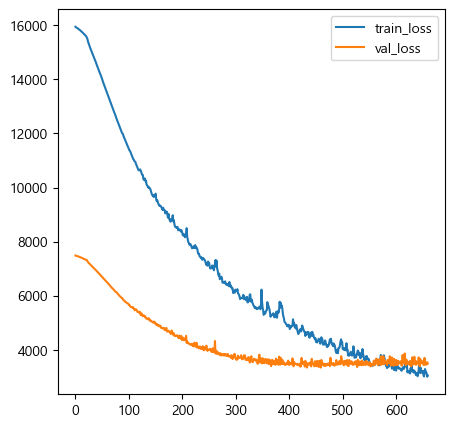

In [319]:
plt.plot(train_loss_hk1_23_m, label = 'train_loss')
plt.plot(val_loss_hk1_23_m, label = 'val_loss')
plt.legend()
plt.show()

In [320]:
val_r2_hk1_23_m, val_mae_hk1_23_m = test(valid_loader_hk1_23_m, model_hk1_23_m,isEDR=isEDR)


y_label :  0.0 y_pred :  1351.5616455078125
y_label :  66.19444274902344 y_pred :  1603.8812255859375
y_label :  603.1777954101562 y_pred :  1470.170654296875
y_label :  1650.4610595703125 y_pred :  1884.58837890625
y_label :  1889.9111328125 y_pred :  1461.7816162109375
y_label :  2012.8721923828125 y_pred :  1181.254638671875
y_label :  2372.111083984375 y_pred :  1573.198974609375
y_label :  1686.494384765625 y_pred :  1474.5316162109375
y_label :  1970.388916015625 y_pred :  2263.400390625
y_label :  1248.572265625 y_pred :  1419.5440673828125
y_label :  1660.594482421875 y_pred :  2206.00341796875
y_label :  1807.6722412109375 y_pred :  3446.5419921875
y_label :  3366.227783203125 y_pred :  2860.21728515625
y_label :  2980.583251953125 y_pred :  2223.12255859375
y_label :  3522.783447265625 y_pred :  2013.8927001953125
y_label :  3735.01123046875 y_pred :  1882.0413818359375
y_label :  3637.050048828125 y_pred :  2690.5
y_label :  2547.43896484375 y_pred :  2711.572998046875
y_lab

In [321]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_23_m, test_mae_hk1_23_m = test(test_loader_hk1_23_m, model_hk1_23_m, isEDR=isEDR)
y_label_hk1_23_m = y_label_plt
y_pred_hk1_23_m = y_pred_plt

y_label :  307.5888977050781 y_pred :  798.3694458007812
y_label :  279.3888854980469 y_pred :  1899.394287109375
y_label :  1166.844482421875 y_pred :  1947.5001220703125
y_label :  741.9055786132812 y_pred :  1491.9864501953125
y_label :  662.1166381835938 y_pred :  1698.7652587890625
y_label :  1486.611083984375 y_pred :  1884.8890380859375
y_label :  1089.4888916015625 y_pred :  1778.7052001953125
y_label :  651.7666625976562 y_pred :  1407.1236572265625
y_label :  320.98333740234375 y_pred :  853.9457397460938
y_label :  1276.2667236328125 y_pred :  776.2957153320312
y_label :  1380.3499755859375 y_pred :  663.8983154296875
y_label :  1811.63330078125 y_pred :  67.72543334960938
y_label :  525.20556640625 y_pred :  0.0
y_label :  61.07777786254883 y_pred :  725.2607421875
y_label :  424.3833312988281 y_pred :  196.9999237060547
y_label :  285.8166809082031 y_pred :  48.6856689453125
y_label :  241.9499969482422 y_pred :  1879.1563720703125
y_label :  396.9055480957031 y_pred :  22

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-197.7264404296875, 4152.2552490234375)


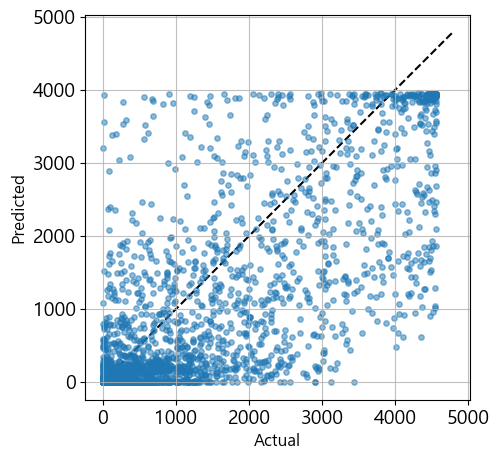

In [322]:
plot_scatter(y_label_hk1_23_m,y_pred_hk1_23_m)

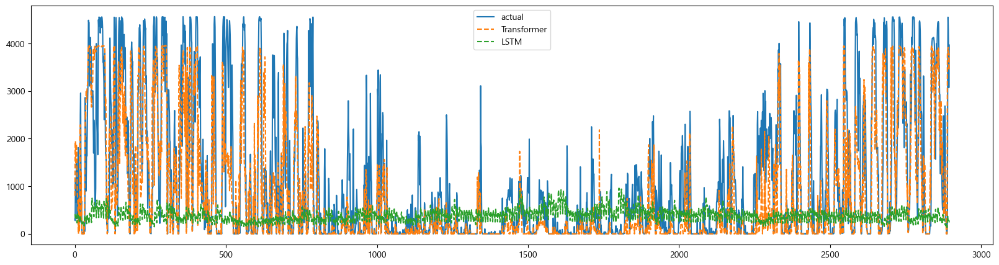

In [323]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_23_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_23_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_23_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

In [324]:
#hk1_multi_31
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_31_m.parameters(), lr=lr)
train_loss_hk1_31_m, val_loss_hk1_31_m = trainer(train_loader_hk1_31_m, valid_loader_hk1_31_m, model_hk1_31_m, criterion, optimizer, target='hk1', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk1_31_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7574005191367308
MAE Loss:  1265.944785873455
Validation
R2 score: -0.6992708470263977
MAE Loss:  1195.8436106871093
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7540759428764692
MAE Loss:  1264.242138138785
Validation
R2 score: -0.6974566120665815
MAE Loss:  1194.939800351817
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7522229761159973
MAE Loss:  1263.2758696034584
Validation
R2 score: -0.6955438269625409
MAE Loss:  1194.0018094100922
최신화
Epoch 3/1000
TRAIN
R2 score: -0.750202225364589
MAE Loss:  1262.2381479755747
Validation
R2 score: -0.6934739197896673
MAE Loss:  1193.0060477353509
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7480421805833717
MAE Loss:  1261.1469415602592
Validation
R2 score: -0.6912430887437682
MAE Loss:  1191.9538500109347
최신화
Epoch 5/1000
TRAIN
R2 score: -0.7457290316972476
MAE Loss:  1259.9939804441005
Validation
R2 score: -0.6888610213801816
MAE Loss:  1190.8527410295046
최신화
Epoch 6/1000
TRAIN
R2 score: -0.7432556836135118
MAE Loss:  1258.7823263281718
V

최신화
Epoch 54/1000
TRAIN
R2 score: -0.4554584976326359
MAE Loss:  1092.9911782192366
Validation
R2 score: -0.40688796227242285
MAE Loss:  1056.0867764590698
최신화
Epoch 55/1000
TRAIN
R2 score: -0.44673772754949836
MAE Loss:  1088.2682024376961
Validation
R2 score: -0.3998094387814324
MAE Loss:  1052.9133304387835
최신화
Epoch 56/1000
TRAIN
R2 score: -0.4379360607438094
MAE Loss:  1083.4308484749924
Validation
R2 score: -0.390010285643104
MAE Loss:  1049.0633629919878
최신화
Epoch 57/1000
TRAIN
R2 score: -0.4291006959178403
MAE Loss:  1079.2633868714368
Validation
R2 score: -0.3845508749396691
MAE Loss:  1046.3057173845198
최신화
Epoch 58/1000
TRAIN
R2 score: -0.42065264555752213
MAE Loss:  1074.4793452540887
Validation
R2 score: -0.3736320140577032
MAE Loss:  1043.256726160239
최신화
Epoch 59/1000
TRAIN
R2 score: -0.4115522432730041
MAE Loss:  1070.1620449698307
Validation
R2 score: -0.36611617412250075
MAE Loss:  1039.630961535411
최신화
Epoch 60/1000
TRAIN
R2 score: -0.40250875818074916
MAE Loss:  106

R2 score: -0.010082698337750884
MAE Loss:  877.6084372866231
Validation
R2 score: 0.013881836112785595
MAE Loss:  884.1349878862901
최신화
Epoch 108/1000
TRAIN
R2 score: -0.005236835108687998
MAE Loss:  874.2948799517222
Validation
R2 score: 0.02272925948416349
MAE Loss:  884.2823505093348
최신화
Epoch 109/1000
TRAIN
R2 score: 0.0016576970907072885
MAE Loss:  874.649570127333
Validation
R2 score: 0.030888109203448533
MAE Loss:  878.6953101544718
최신화
Epoch 110/1000
TRAIN
R2 score: 0.010209457902450758
MAE Loss:  873.785822367221
Validation
R2 score: 0.035616152529899026
MAE Loss:  872.6466089505548
최신화
Epoch 111/1000
TRAIN
R2 score: 0.016261578135556842
MAE Loss:  868.2477565154373
Validation
R2 score: 0.041649697102515204
MAE Loss:  873.6668568340269
Epoch 112/1000
TRAIN
R2 score: 0.023638905219414696
MAE Loss:  864.8206919979114
Validation
R2 score: 0.016403597421907445
MAE Loss:  875.29928449795
Epoch 113/1000
TRAIN
R2 score: 0.029939550598847786
MAE Loss:  863.7905273434034
Validation
R2 

R2 score: 0.3112637461409733
MAE Loss:  728.5570721667001
Validation
R2 score: 0.31304531791844803
MAE Loss:  779.7791876186055
Epoch 163/1000
TRAIN
R2 score: 0.3107921764657835
MAE Loss:  735.8556256582189
Validation
R2 score: 0.31157426422830226
MAE Loss:  769.6693882940501
최신화
Epoch 164/1000
TRAIN
R2 score: 0.324140783785168
MAE Loss:  727.5801674165264
Validation
R2 score: 0.31402099676366024
MAE Loss:  763.2948809277565
최신화
Epoch 165/1000
TRAIN
R2 score: 0.33065137455319915
MAE Loss:  721.0559135233589
Validation
R2 score: 0.31683747877902246
MAE Loss:  761.3896427981617
최신화
Epoch 166/1000
TRAIN
R2 score: 0.3353055826519392
MAE Loss:  715.5815838004496
Validation
R2 score: 0.31809673424434337
MAE Loss:  758.1522950520276
최신화
Epoch 167/1000
TRAIN
R2 score: 0.3442497999404224
MAE Loss:  713.3035864463649
Validation
R2 score: 0.31626874569991237
MAE Loss:  761.1062281373065
Epoch 168/1000
TRAIN
R2 score: 0.34676252211880587
MAE Loss:  713.6161492491295
Validation
R2 score: 0.31208971

R2 score: 0.5273108329418255
MAE Loss:  617.7231875628775
Validation
R2 score: 0.499730191705109
MAE Loss:  675.6000966192506
최신화
Epoch 219/1000
TRAIN
R2 score: 0.5272986660758996
MAE Loss:  617.7664437742179
Validation
R2 score: 0.503132541822376
MAE Loss:  677.5445761438099
Epoch 220/1000
TRAIN
R2 score: 0.5277141153732026
MAE Loss:  619.0994739437651
Validation
R2 score: 0.5066234735566039
MAE Loss:  674.0521140433539
최신화
Epoch 221/1000
TRAIN
R2 score: 0.5212994060692704
MAE Loss:  620.3242405331602
Validation
R2 score: 0.5030775353230584
MAE Loss:  685.7162860196537
Epoch 222/1000
TRAIN
R2 score: 0.5191346149676764
MAE Loss:  626.9004419528803
Validation
R2 score: 0.504261849472892
MAE Loss:  665.9254976016321
최신화
Epoch 223/1000
TRAIN
R2 score: 0.5386678526131907
MAE Loss:  614.2832104967099
Validation
R2 score: 0.46213318596472697
MAE Loss:  682.3606323136366
Epoch 224/1000
TRAIN
R2 score: 0.535932500335055
MAE Loss:  626.0829814627853
Validation
R2 score: 0.47992409326260344
MAE 

R2 score: 0.6017173292186953
MAE Loss:  576.2788294276544
Validation
R2 score: 0.6032860675767051
MAE Loss:  621.297116096183
Epoch 274/1000
TRAIN
R2 score: 0.6425308358943634
MAE Loss:  550.9279462922942
Validation
R2 score: 0.6063585210660042
MAE Loss:  612.8342942171962
최신화
Epoch 275/1000
TRAIN
R2 score: 0.6508420791951204
MAE Loss:  539.1682875943619
Validation
R2 score: 0.5908701416803843
MAE Loss:  619.0029333007486
Epoch 276/1000
TRAIN
R2 score: 0.6566574662020974
MAE Loss:  533.8575001262047
Validation
R2 score: 0.5874811401109896
MAE Loss:  610.6173619666698
최신화
Epoch 277/1000
TRAIN
R2 score: 0.6493741088863065
MAE Loss:  546.2052961897505
Validation
R2 score: 0.5808277307775142
MAE Loss:  614.4953863435162
Epoch 278/1000
TRAIN
R2 score: 0.6497898023528815
MAE Loss:  541.9699930613612
Validation
R2 score: 0.6082634033495383
MAE Loss:  605.5811425945593
최신화
Epoch 279/1000
TRAIN
R2 score: 0.6519137385182947
MAE Loss:  531.8069107799118
Validation
R2 score: 0.5912383509159163
MAE

R2 score: 0.6939038716671804
MAE Loss:  514.9569653589946
Validation
R2 score: 0.5902228187363264
MAE Loss:  608.8686372139723
Epoch 330/1000
TRAIN
R2 score: 0.6869616323682124
MAE Loss:  512.570115826557
Validation
R2 score: 0.6240743764778199
MAE Loss:  570.6065347649991
Epoch 331/1000
TRAIN
R2 score: 0.7019100020492806
MAE Loss:  492.6599001867731
Validation
R2 score: 0.6287892929045698
MAE Loss:  600.883054790087
Epoch 332/1000
TRAIN
R2 score: 0.7080776397679287
MAE Loss:  491.18598319912263
Validation
R2 score: 0.6133779429451248
MAE Loss:  599.1006227856893
Epoch 333/1000
TRAIN
R2 score: 0.7134618280635875
MAE Loss:  490.3600830317362
Validation
R2 score: 0.6169959108469388
MAE Loss:  585.1107322514747
Epoch 334/1000
TRAIN
R2 score: 0.699871057269526
MAE Loss:  498.43031046110116
Validation
R2 score: 0.638883427916764
MAE Loss:  569.2100208270009
Epoch 335/1000
TRAIN
R2 score: 0.7061514005267009
MAE Loss:  485.41350436067927
Validation
R2 score: 0.632655055039516
MAE Loss:  588.7

R2 score: 0.7595637079351372
MAE Loss:  442.8613030437937
Validation
R2 score: 0.6110297442726453
MAE Loss:  589.9209292802332
Epoch 386/1000
TRAIN
R2 score: 0.7483197970499685
MAE Loss:  453.4238121699963
Validation
R2 score: 0.6395207114783793
MAE Loss:  558.2000824863461
최신화
Epoch 387/1000
TRAIN
R2 score: 0.7474401327561686
MAE Loss:  443.2202527218674
Validation
R2 score: 0.6095232261247935
MAE Loss:  601.6611245994286
Epoch 388/1000
TRAIN
R2 score: 0.7474172718132013
MAE Loss:  463.7189352046999
Validation
R2 score: 0.6053304900160297
MAE Loss:  593.7966701185372
Epoch 389/1000
TRAIN
R2 score: 0.7471036012220174
MAE Loss:  449.7345778373308
Validation
R2 score: 0.6063900503441716
MAE Loss:  590.1498410535503
Epoch 390/1000
TRAIN
R2 score: 0.7433086528360913
MAE Loss:  446.0866162541566
Validation
R2 score: 0.6366918366723691
MAE Loss:  575.9775248634274
Epoch 391/1000
TRAIN
R2 score: 0.7702448339731902
MAE Loss:  424.42202479286993
Validation
R2 score: 0.6236866610236328
MAE Loss:

R2 score: 0.8058533038119908
MAE Loss:  384.46617378517226
Validation
R2 score: 0.6265005074165306
MAE Loss:  566.0220455654963
Epoch 442/1000
TRAIN
R2 score: 0.796676166265562
MAE Loss:  398.76382416379874
Validation
R2 score: 0.6082417217193193
MAE Loss:  581.6109833693831
Epoch 443/1000
TRAIN
R2 score: 0.7846735414618968
MAE Loss:  405.7656623156796
Validation
R2 score: 0.6399743743346236
MAE Loss:  552.5969174121152
Epoch 444/1000
TRAIN
R2 score: 0.8099658413726771
MAE Loss:  383.9284626236512
Validation
R2 score: 0.6139280421987862
MAE Loss:  588.2517791626337
Epoch 445/1000
TRAIN
R2 score: 0.8060769833831853
MAE Loss:  383.80292574318486
Validation
R2 score: 0.6282780222058619
MAE Loss:  563.2114495388927
Epoch 446/1000
TRAIN
R2 score: 0.8086689918841339
MAE Loss:  381.36924967539545
Validation
R2 score: 0.6392967960322857
MAE Loss:  557.2596699225855
Epoch 447/1000
TRAIN
R2 score: 0.812072348173547
MAE Loss:  374.9477233658244
Validation
R2 score: 0.640286335812903
MAE Loss:  56

R2 score: 0.6421595864013007
MAE Loss:  548.8345074184825
최신화
Epoch 498/1000
TRAIN
R2 score: 0.8431042442991066
MAE Loss:  334.98573352787724
Validation
R2 score: 0.6326976155235584
MAE Loss:  557.2516293621658
Epoch 499/1000
TRAIN
R2 score: 0.8396384500650504
MAE Loss:  337.32567771637076
Validation
R2 score: 0.648441718337361
MAE Loss:  547.0458807766294
최신화
Epoch 500/1000
TRAIN
R2 score: 0.8509381409821429
MAE Loss:  332.8163230562768
Validation
R2 score: 0.6022585253308794
MAE Loss:  579.6940402663904
Epoch 501/1000
TRAIN
R2 score: 0.8345476148806436
MAE Loss:  345.50914111982354
Validation
R2 score: 0.6236083166298705
MAE Loss:  570.2161955650155
Epoch 502/1000
TRAIN
R2 score: 0.8397880236702464
MAE Loss:  348.15183211129886
Validation
R2 score: 0.5906882203428291
MAE Loss:  587.9062514835865
Epoch 503/1000
TRAIN
R2 score: 0.8328552378310823
MAE Loss:  347.02548988211214
Validation
R2 score: 0.6485411440953606
MAE Loss:  543.4567567538625
최신화
Epoch 504/1000
TRAIN
R2 score: 0.85577

R2 score: 0.8712300175238565
MAE Loss:  296.14245011707834
Validation
R2 score: 0.6294004695227713
MAE Loss:  557.5100411535678
Epoch 554/1000
TRAIN
R2 score: 0.8778842191272686
MAE Loss:  291.8805428639596
Validation
R2 score: 0.6268336669615353
MAE Loss:  565.0731552209119
Epoch 555/1000
TRAIN
R2 score: 0.8745050940277714
MAE Loss:  292.725560869879
Validation
R2 score: 0.631665562200004
MAE Loss:  553.9229690473763
Epoch 556/1000
TRAIN
R2 score: 0.8759164438022049
MAE Loss:  291.9439522733747
Validation
R2 score: 0.6384749947405552
MAE Loss:  556.7474522261587
Epoch 557/1000
TRAIN
R2 score: 0.8843627009407679
MAE Loss:  285.0895136075913
Validation
R2 score: 0.6077691123148173
MAE Loss:  574.6594597880899
Epoch 558/1000
TRAIN
R2 score: 0.8807653039728456
MAE Loss:  286.01740738891687
Validation
R2 score: 0.6277234976590116
MAE Loss:  562.9296159903616
Epoch 559/1000
TRAIN
R2 score: 0.8801243634722856
MAE Loss:  285.3769325043658
Validation
R2 score: 0.633476792595077
MAE Loss:  553.

R2 score: 0.8934624818331011
MAE Loss:  272.95725858674956
Validation
R2 score: 0.6033162768276126
MAE Loss:  579.5703863593395
Epoch 610/1000
TRAIN
R2 score: 0.8967590031802046
MAE Loss:  264.66645243234035
Validation
R2 score: 0.6219603784863412
MAE Loss:  561.882417956362
Epoch 611/1000
TRAIN
R2 score: 0.8971927835400156
MAE Loss:  263.50513013230056
Validation
R2 score: 0.6061572363687633
MAE Loss:  577.5218740149313
Epoch 612/1000
TRAIN
R2 score: 0.8971220810588544
MAE Loss:  262.93964046166474
Validation
R2 score: 0.60711999122116
MAE Loss:  578.276008620637
Epoch 613/1000
TRAIN
R2 score: 0.8942251029649745
MAE Loss:  265.9967230250941
Validation
R2 score: 0.6092694125040248
MAE Loss:  576.4105526888126
Epoch 614/1000
TRAIN
R2 score: 0.9017444312654423
MAE Loss:  258.0197450811988
Validation
R2 score: 0.6199145458869721
MAE Loss:  559.0420043934497
Epoch 615/1000
TRAIN
R2 score: 0.8969619336008451
MAE Loss:  262.60673522212664
Validation
R2 score: 0.6309051298992441
MAE Loss:  56

R2 score: 0.9024927401249708
MAE Loss:  256.13875502597386
Validation
R2 score: 0.5945691664191641
MAE Loss:  578.9899913042074
Epoch 666/1000
TRAIN
R2 score: 0.8970556760570328
MAE Loss:  265.60439598295454
Validation
R2 score: 0.6245943302229704
MAE Loss:  561.2033834672322
Epoch 667/1000
TRAIN
R2 score: 0.8933818337937851
MAE Loss:  264.75530508569875
Validation
R2 score: 0.5789657481371214
MAE Loss:  601.5831656730811
Epoch 668/1000
TRAIN
R2 score: 0.90353411069232
MAE Loss:  262.58802393869513
Validation
R2 score: 0.5740446529757143
MAE Loss:  595.98441115439
Epoch 669/1000
TRAIN
R2 score: 0.8952513985454938
MAE Loss:  265.8429436571334
Validation
R2 score: 0.6128449779525894
MAE Loss:  565.4651903470628
Epoch 670/1000
TRAIN
R2 score: 0.9032254898437789
MAE Loss:  255.7599544255233
Validation
R2 score: 0.5746518123816422
MAE Loss:  606.8695143545252
Epoch 671/1000
TRAIN
R2 score: 0.9085799416290601
MAE Loss:  250.91465762418073
Validation
R2 score: 0.6102419197759283
MAE Loss:  57

R2 score: 0.9264580281474062
MAE Loss:  218.13948243748254
Validation
R2 score: 0.610385783120175
MAE Loss:  574.0011117266162
Epoch 722/1000
TRAIN
R2 score: 0.9304037738455999
MAE Loss:  217.5955855389102
Validation
R2 score: 0.6077917760522359
MAE Loss:  571.9829238584903
Epoch 723/1000
TRAIN
R2 score: 0.9259100449569
MAE Loss:  221.88714761111828
Validation
R2 score: 0.6178167977101579
MAE Loss:  569.5198294032643
Epoch 724/1000
TRAIN
R2 score: 0.9293319147887564
MAE Loss:  216.6546145589601
Validation
R2 score: 0.6033065620019268
MAE Loss:  573.0463801585395
Epoch 725/1000
TRAIN
R2 score: 0.9274850747805556
MAE Loss:  217.8414627805266
Validation
R2 score: 0.6208197454355636
MAE Loss:  561.9493358448528
Epoch 726/1000
TRAIN
R2 score: 0.9262701181575119
MAE Loss:  219.94447354683678
Validation
R2 score: 0.6034123624503533
MAE Loss:  581.936574142843
Epoch 727/1000
TRAIN
R2 score: 0.9243384239372578
MAE Loss:  231.11591793850374
Validation
R2 score: 0.5656251949804922
MAE Loss:  606.

R2 score: 0.9355452463264233
MAE Loss:  206.86503680146777
Validation
R2 score: 0.6174169427935858
MAE Loss:  569.0470929707745
Epoch 778/1000
TRAIN
R2 score: 0.9378686494013333
MAE Loss:  206.85697500385066
Validation
R2 score: 0.6245286721065957
MAE Loss:  560.1938068745761
Epoch 779/1000
TRAIN
R2 score: 0.937539147323812
MAE Loss:  206.1126659879045
Validation
R2 score: 0.6006078757657134
MAE Loss:  580.0837736345097
Epoch 780/1000
TRAIN
R2 score: 0.9384811105475153
MAE Loss:  203.9887712872391
Validation
R2 score: 0.598653712487258
MAE Loss:  584.0194051066126
Epoch 781/1000
TRAIN
R2 score: 0.9370255459039349
MAE Loss:  207.56401349844415
Validation
R2 score: 0.5992977002056554
MAE Loss:  577.370973105388
Epoch 782/1000
TRAIN
R2 score: 0.9361105966393262
MAE Loss:  211.47392373487975
Validation
R2 score: 0.616634780011913
MAE Loss:  569.1617136244914
Epoch 783/1000
TRAIN
R2 score: 0.9424605686619169
MAE Loss:  199.84944781523035
Validation
R2 score: 0.5835970417407543
MAE Loss:  59

R2 score: 0.9332445262299539
MAE Loss:  213.85242949069212
Validation
R2 score: 0.6136329894112429
MAE Loss:  568.2951665490671
Epoch 834/1000
TRAIN
R2 score: 0.9386876284714749
MAE Loss:  208.46400251261645
Validation
R2 score: 0.5332452251013571
MAE Loss:  636.7322929157871
Epoch 835/1000
TRAIN
R2 score: 0.9211299019702912
MAE Loss:  228.7912427715243
Validation
R2 score: 0.5878457656820721
MAE Loss:  588.2166334258969
Epoch 836/1000
TRAIN
R2 score: 0.9405789011000759
MAE Loss:  204.3062695517516
Validation
R2 score: 0.6202278652920613
MAE Loss:  562.3905496716716
Early Stopping!
Best_epoch: 636


<All keys matched successfully>

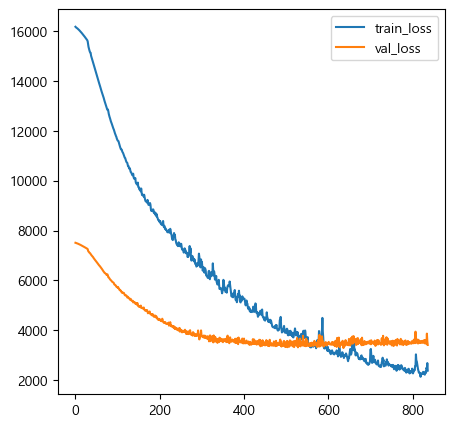

In [325]:
plt.plot(train_loss_hk1_31_m, label = 'train_loss')
plt.plot(val_loss_hk1_31_m, label = 'val_loss')
plt.legend()
plt.show()

In [326]:
val_r2_hk1_31_m, val_mae_hk1_31_m = test(valid_loader_hk1_31_m, model_hk1_31_m,isEDR=isEDR)


y_label :  1970.388916015625 y_pred :  2640.018798828125
y_label :  1248.572265625 y_pred :  1664.0411376953125
y_label :  1660.594482421875 y_pred :  1967.698974609375
y_label :  1807.6722412109375 y_pred :  3058.125244140625
y_label :  3366.227783203125 y_pred :  3794.447021484375
y_label :  2980.583251953125 y_pred :  3409.12841796875
y_label :  3522.783447265625 y_pred :  3281.761474609375
y_label :  3735.01123046875 y_pred :  3421.68603515625
y_label :  3637.050048828125 y_pred :  2349.430419921875
y_label :  2547.43896484375 y_pred :  2894.867431640625
y_label :  3618.666748046875 y_pred :  2590.3603515625
y_label :  4366.888671875 y_pred :  2561.379638671875
y_label :  4526.6611328125 y_pred :  2307.268310546875
y_label :  4327.34423828125 y_pred :  2163.025146484375
y_label :  4339.0 y_pred :  2377.183349609375
y_label :  4380.43896484375 y_pred :  2462.603515625
y_label :  4410.06103515625 y_pred :  3547.135986328125
y_label :  4301.39453125 y_pred :  3971.260986328125
y_label

In [327]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_31_m, test_mae_hk1_31_m = test(test_loader_hk1_31_m, model_hk1_31_m, isEDR=isEDR)
y_label_hk1_31_m = y_label_plt
y_pred_hk1_31_m = y_pred_plt

y_label :  320.98333740234375 y_pred :  1201.5267333984375
y_label :  1276.2667236328125 y_pred :  916.0096435546875
y_label :  1380.3499755859375 y_pred :  1097.2200927734375
y_label :  1811.63330078125 y_pred :  27.082721710205078
y_label :  525.20556640625 y_pred :  0.0
y_label :  61.07777786254883 y_pred :  1738.08837890625
y_label :  424.3833312988281 y_pred :  612.8897094726562
y_label :  285.8166809082031 y_pred :  184.57952880859375
y_label :  241.9499969482422 y_pred :  1290.7344970703125
y_label :  396.9055480957031 y_pred :  2668.270751953125
y_label :  2501.316650390625 y_pred :  1926.8265380859375
y_label :  2956.3388671875 y_pred :  1200.0537109375
y_label :  1561.2388916015625 y_pred :  513.216064453125
y_label :  522.9055786132812 y_pred :  824.8593139648438
y_label :  687.0166625976562 y_pred :  419.02642822265625
y_label :  131.51666259765625 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  18.472221374511

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-227.3504638671875, 4774.3597412109375)


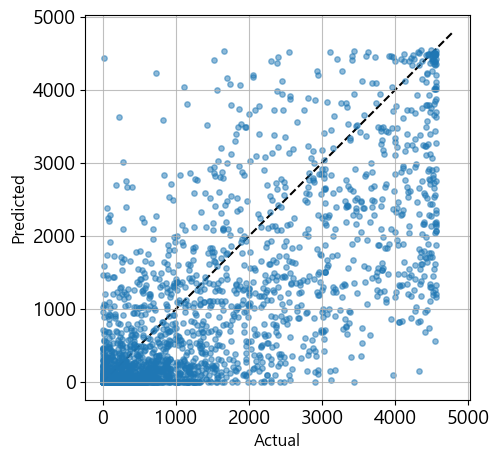

In [328]:
plot_scatter(y_label_hk1_31_m,y_pred_hk1_31_m)

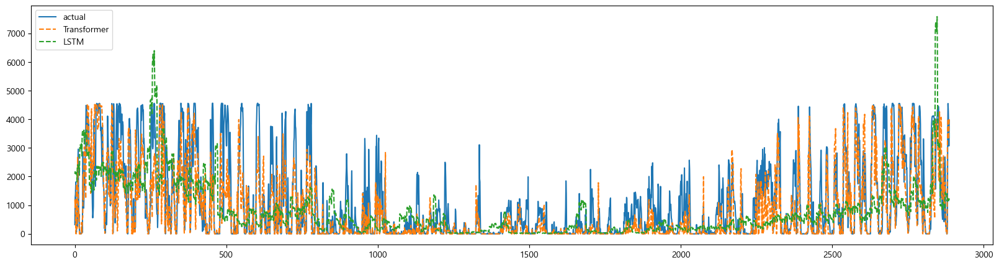

In [329]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_31_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_31_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_31_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

R2 score: 0.6332574206359596
MAE Loss:  523.9386661251373
R2 score: 0.6032900116874166
MAE Loss:  547.4947233912908
R2 score: 0.5514143701447582
MAE Loss:  582.4891236729685


[523.9386661251373, 547.4947233912908, 582.4891236729685]

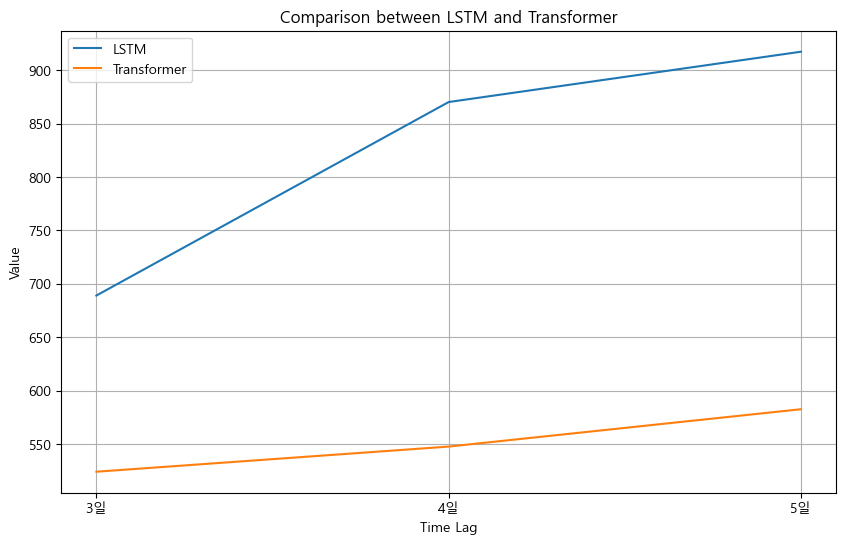

In [1236]:
#hk1_multi
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_m.parameters(), lr=lr)
train_loss_hk1_m, val_loss_hk1_m = trainer(train_loader_hk1_m, valid_loader_hk1_m, model_hk1_m, criterion, optimizer, target='hk1', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk1_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7571069039253344
MAE Loss:  1265.126818817739
Validation
R2 score: -0.6929943220433388
MAE Loss:  1190.6041213369463
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7489272310816102
MAE Loss:  1260.9746243575241
Validation
R2 score: -0.6844024289223849
MAE Loss:  1186.6278761222954
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7392378604831944
MAE Loss:  1256.2697957013368
Validation
R2 score: -0.6737891729766323
MAE Loss:  1181.9958253224959
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7276790037995193
MAE Loss:  1250.9051921465016
Validation
R2 score: -0.6616141415839873
MAE Loss:  1176.9364588008964
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7149236011290085
MAE Loss:  1244.2843315101265
Validation
R2 score: -0.6484399133337491
MAE Loss:  1166.8624132852158
최신화
Epoch 5/1000
TRAIN
R2 score: -0.698446858020876
MAE Loss:  1229.3164023242446
Validation
R2 score: -0.6288725476982491
MAE Loss:  1157.8904426978506
최신화
Epoch 6/1000
TRAIN
R2 score: -0.6774581209027641
MAE Loss:  1216.971855108158


R2 score: 0.4117375752181346
MAE Loss:  694.4554610643002
Validation
R2 score: 0.39873218497475316
MAE Loss:  715.8975796668028
최신화
Epoch 55/1000
TRAIN
R2 score: 0.4166012761545508
MAE Loss:  689.7054243062086
Validation
R2 score: 0.421874957817146
MAE Loss:  717.1440425516429
Epoch 56/1000
TRAIN
R2 score: 0.433051551419805
MAE Loss:  679.3084724181259
Validation
R2 score: 0.43190661906847405
MAE Loss:  713.3725907875936
최신화
Epoch 57/1000
TRAIN
R2 score: 0.44203971514410734
MAE Loss:  676.069980125873
Validation
R2 score: 0.4478589968795976
MAE Loss:  700.2698502673506
최신화
Epoch 58/1000
TRAIN
R2 score: 0.4535939631330138
MAE Loss:  673.5389182336239
Validation
R2 score: 0.44701580835715327
MAE Loss:  708.478599741817
Epoch 59/1000
TRAIN
R2 score: 0.4549842748163886
MAE Loss:  675.4348155942495
Validation
R2 score: 0.46586328774262165
MAE Loss:  686.4680117149044
최신화
Epoch 60/1000
TRAIN
R2 score: 0.4591971056460492
MAE Loss:  680.9262254120957
Validation
R2 score: 0.46051798777588016
MA

R2 score: 0.6851938354510239
MAE Loss:  517.1365617151654
Validation
R2 score: 0.5974570234906209
MAE Loss:  604.2937138972287
Epoch 111/1000
TRAIN
R2 score: 0.6852888793091413
MAE Loss:  515.2052016302837
Validation
R2 score: 0.5900219086528181
MAE Loss:  592.1814827105455
Epoch 112/1000
TRAIN
R2 score: 0.6683917003901173
MAE Loss:  527.8422286419175
Validation
R2 score: 0.590084586335177
MAE Loss:  617.3422440424341
Epoch 113/1000
TRAIN
R2 score: 0.6844946213904051
MAE Loss:  519.3923619436896
Validation
R2 score: 0.6115544472092609
MAE Loss:  589.4118679164279
Epoch 114/1000
TRAIN
R2 score: 0.6994873574031479
MAE Loss:  504.7819747930244
Validation
R2 score: 0.6140113669731978
MAE Loss:  586.7614546389406
Epoch 115/1000
TRAIN
R2 score: 0.6934670846900883
MAE Loss:  506.85847280122186
Validation
R2 score: 0.5751904948732411
MAE Loss:  634.5341104004139
Epoch 116/1000
TRAIN
R2 score: 0.7088360237600402
MAE Loss:  495.4012237619543
Validation
R2 score: 0.6062653081827489
MAE Loss:  593

R2 score: 0.7673790603235093
MAE Loss:  424.42406654219775
Validation
R2 score: 0.5921784360194731
MAE Loss:  595.277575800991
Epoch 167/1000
TRAIN
R2 score: 0.7798417771557893
MAE Loss:  409.8116864828609
Validation
R2 score: 0.523158314169859
MAE Loss:  643.3904372584664
Epoch 168/1000
TRAIN
R2 score: 0.7753543750013359
MAE Loss:  407.8671965447009
Validation
R2 score: 0.576249063745692
MAE Loss:  598.8903785514118
Epoch 169/1000
TRAIN
R2 score: 0.7798793357147711
MAE Loss:  407.44311145920153
Validation
R2 score: 0.5775580636822926
MAE Loss:  599.6304466628577
Epoch 170/1000
TRAIN
R2 score: 0.7895212132277393
MAE Loss:  396.30625423816286
Validation
R2 score: 0.5361242129298098
MAE Loss:  630.64013309666
Epoch 171/1000
TRAIN
R2 score: 0.779466304658791
MAE Loss:  405.40133116643807
Validation
R2 score: 0.5273581511085862
MAE Loss:  626.0624105401189
Epoch 172/1000
TRAIN
R2 score: 0.7749029658795
MAE Loss:  414.6184273553681
Validation
R2 score: 0.5530293093070031
MAE Loss:  624.5514

R2 score: 0.8129303733054573
MAE Loss:  364.0003530614649
Validation
R2 score: 0.5140930896116073
MAE Loss:  625.3911813033545
Epoch 223/1000
TRAIN
R2 score: 0.8117226454286463
MAE Loss:  363.88250863427004
Validation
R2 score: 0.5047708768172826
MAE Loss:  638.6634458487644
Epoch 224/1000
TRAIN
R2 score: 0.8082348398676309
MAE Loss:  367.3715167096294
Validation
R2 score: 0.5693679726664947
MAE Loss:  595.5662196777981
Epoch 225/1000
TRAIN
R2 score: 0.8128396945563274
MAE Loss:  363.0381047519991
Validation
R2 score: 0.5340436350884492
MAE Loss:  622.0749026643352
Epoch 226/1000
TRAIN
R2 score: 0.8037656822215773
MAE Loss:  370.7452744422937
Validation
R2 score: 0.5061568270555731
MAE Loss:  625.3525981739148
Epoch 227/1000
TRAIN
R2 score: 0.8068007711240437
MAE Loss:  368.84758049525783
Validation
R2 score: 0.53414267333233
MAE Loss:  614.4019699709075
Epoch 228/1000
TRAIN
R2 score: 0.8049276902886242
MAE Loss:  370.2366587567138
Validation
R2 score: 0.5185976366417224
MAE Loss:  638

R2 score: 0.8220337417240704
MAE Loss:  357.81663533729954
Validation
R2 score: 0.5892575626801424
MAE Loss:  571.4751456654451
Epoch 279/1000
TRAIN
R2 score: 0.8303962325542389
MAE Loss:  344.1888028989071
Validation
R2 score: 0.5314948779278018
MAE Loss:  611.7023356687047
Epoch 280/1000
TRAIN
R2 score: 0.8253867915828186
MAE Loss:  345.0992098330332
Validation
R2 score: 0.5601730693395601
MAE Loss:  588.2958276277526
Epoch 281/1000
TRAIN
R2 score: 0.8281730877734244
MAE Loss:  348.5152229169209
Validation
R2 score: 0.5679773805235728
MAE Loss:  579.4202438288363
Epoch 282/1000
TRAIN
R2 score: 0.8286252545282626
MAE Loss:  348.68532991702654
Validation
R2 score: 0.5779957938493818
MAE Loss:  587.8959177066392
Epoch 283/1000
TRAIN
R2 score: 0.8393570164316669
MAE Loss:  330.6518223852021
Validation
R2 score: 0.6214993593142919
MAE Loss:  552.2181860242873
Epoch 284/1000
TRAIN
R2 score: 0.8374456872814156
MAE Loss:  337.2533589452257
Validation
R2 score: 0.5275227107766094
MAE Loss:  6

R2 score: 0.8666183354813415
MAE Loss:  301.9888322031691
Validation
R2 score: 0.5382506151762461
MAE Loss:  613.0218268564498
Epoch 335/1000
TRAIN
R2 score: 0.8668769252281411
MAE Loss:  299.3620796473449
Validation
R2 score: 0.5766320376483164
MAE Loss:  587.0429478216031
Epoch 336/1000
TRAIN
R2 score: 0.8728643194015357
MAE Loss:  295.6771188243475
Validation
R2 score: 0.5507727512789784
MAE Loss:  604.9942951542965
Epoch 337/1000
TRAIN
R2 score: 0.8597711087346354
MAE Loss:  310.27594404850356
Validation
R2 score: 0.5414115588869297
MAE Loss:  609.9813654993809
Epoch 338/1000
TRAIN
R2 score: 0.8641125334745962
MAE Loss:  301.80811186403906
Validation
R2 score: 0.45182186429233895
MAE Loss:  670.0064758977285
Epoch 339/1000
TRAIN
R2 score: 0.8666466811575931
MAE Loss:  303.1340763344435
Validation
R2 score: 0.5508156777099015
MAE Loss:  598.8078163946943
Epoch 340/1000
TRAIN
R2 score: 0.8659275461643916
MAE Loss:  302.3772956684417
Validation
R2 score: 0.5483889968661078
MAE Loss:  

R2 score: 0.8970193603002827
MAE Loss:  265.07738137485836
Validation
R2 score: 0.6019916483792072
MAE Loss:  571.7525659880043
Epoch 391/1000
TRAIN
R2 score: 0.8935874277273866
MAE Loss:  272.13834119760963
Validation
R2 score: 0.6137434937913816
MAE Loss:  558.1428521345907
Epoch 392/1000
TRAIN
R2 score: 0.8930797550184293
MAE Loss:  269.40853370737193
Validation
R2 score: 0.5995120221877086
MAE Loss:  567.1442820209176
Epoch 393/1000
TRAIN
R2 score: 0.9027447371077933
MAE Loss:  259.6413850418934
Validation
R2 score: 0.6101546757803209
MAE Loss:  560.5238392330108
Epoch 394/1000
TRAIN
R2 score: 0.8996096767008047
MAE Loss:  262.3491956420564
Validation
R2 score: 0.6201221549599658
MAE Loss:  551.1471534336196
Epoch 395/1000
TRAIN
R2 score: 0.8985863411980105
MAE Loss:  260.98471200812986
Validation
R2 score: 0.6141117495746813
MAE Loss:  560.8483768969309
Epoch 396/1000
TRAIN
R2 score: 0.8988947228117399
MAE Loss:  262.8159641804583
Validation
R2 score: 0.6209270001648095
MAE Loss: 

<All keys matched successfully>

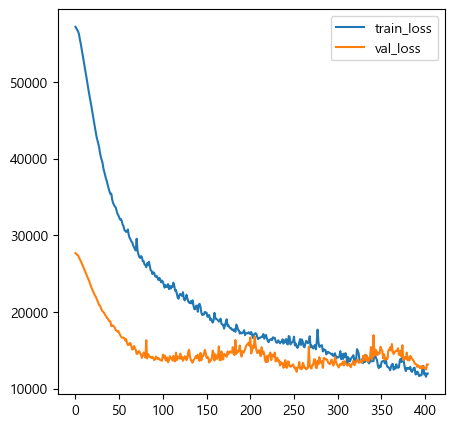

In [1375]:
plt.plot(train_loss_hk1_m, label = 'train_loss')
plt.plot(val_loss_hk1_m, label = 'val_loss')
plt.legend()
plt.show()

In [1376]:
val_r2_hk1_m, val_mae_hk1_m = test(valid_loader_hk1_m, model_hk1_m,isEDR=isEDR)


y_label :  0.10000000149011612 y_pred :  0.0
y_label :  8.627778053283691 y_pred :  467.690185546875
y_label :  156.79444885253906 y_pred :  412.9876708984375
y_label :  100.19444274902344 y_pred :  152.26292419433594
y_label :  21.733333587646484 y_pred :  0.0
y_label :  0.5611110925674438 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.644444465637207 y_pred :  0.0
y_label :  0.0 y_pred :  1384.79833984375
y_label :  66.19444274902344 y_pred :  1635.03271484375
y_label :  603.1777954101562 y_pred :  1261.1552734375
y_label :  1650.4610595703125 y_pred :  1337.7005615234375
y_label :  1889.9111328125 y_pred :  1151.3404541015625
y_label :  2012.8721923828125 y_pred :  965.941650390625
y_label :  2372.111083984375 y_pred :  1188.4420166015625
y_label :  1686.494384765625 y_pred :  1456.2176513671875
y_label :  1970.388916015625 y_pred :  1887.5457763671875
y_label :  1248.572265625 y_pred :  1600.4075927734375
y_label :  1660.594482421875 y_pred :  1674.2156982421875
y_label : 

In [1378]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_m, test_mae_hk1_m = test(test_loader_hk1_m, model_hk1_m, isEDR=isEDR)
y_label_hk1_m = y_label_plt
y_pred_hk1_m = y_pred_plt

y_label :  1393.0333251953125 y_pred :  2178.7412109375
y_label :  1355.5555419921875 y_pred :  2130.31787109375
y_label :  1758.755615234375 y_pred :  1956.14404296875
y_label :  2251.755615234375 y_pred :  2076.90576171875
y_label :  2202.522216796875 y_pred :  2255.464599609375
y_label :  1494.5888671875 y_pred :  2270.191650390625
y_label :  1038.177734375 y_pred :  1478.436767578125
y_label :  489.1555480957031 y_pred :  1109.3544921875
y_label :  307.5888977050781 y_pred :  1233.8975830078125
y_label :  279.3888854980469 y_pred :  1769.8599853515625
y_label :  1166.844482421875 y_pred :  2206.6708984375
y_label :  741.9055786132812 y_pred :  2552.62890625
y_label :  662.1166381835938 y_pred :  2936.3056640625
y_label :  1486.611083984375 y_pred :  2653.0419921875
y_label :  1089.4888916015625 y_pred :  2230.60693359375
y_label :  651.7666625976562 y_pred :  1485.7618408203125
y_label :  320.98333740234375 y_pred :  1142.4398193359375
y_label :  1276.2667236328125 y_pred :  1064.3

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-227.0686767578125, 4768.442211914063)


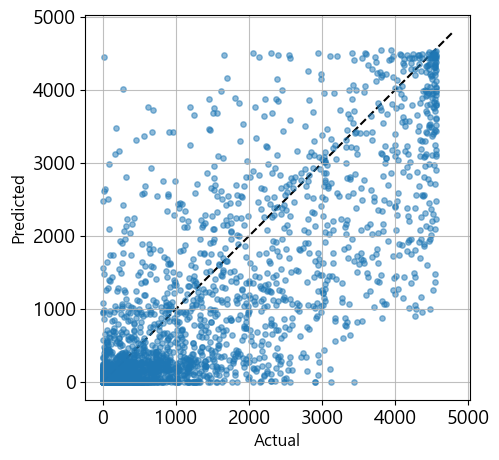

In [1379]:
plot_scatter(y_label_hk1_m,y_pred_hk1_m)

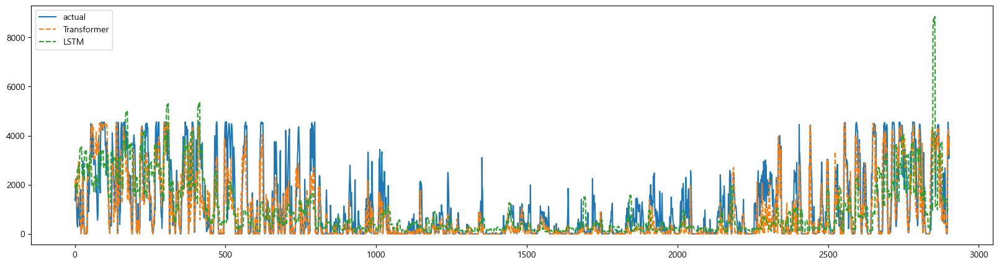

In [1380]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

In [335]:
#hk1_3일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_22.parameters(), lr=lr)
train_loss_hk1_22, val_loss_hk1_22 = trainer(train_loader_hk1_22, valid_loader_hk1_22, model_hk1_22, criterion, optimizer, target='hk1', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk1_22.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7533487189790768
MAE Loss:  1264.2182331261995
Validation
R2 score: -0.6878644731962091
MAE Loss:  1189.7414318194283
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7353175853065737
MAE Loss:  1255.4068774562802
Validation
R2 score: -0.6665764724713488
MAE Loss:  1180.607633035031
최신화
Epoch 2/1000
TRAIN
R2 score: -0.711039253561313
MAE Loss:  1244.5890767129247
Validation
R2 score: -0.6401376515314554
MAE Loss:  1170.293712658439
최신화
Epoch 3/1000
TRAIN
R2 score: -0.6831118377340586
MAE Loss:  1230.4726559563212
Validation
R2 score: -0.6075870064774092
MAE Loss:  1154.4206259251976
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6450497751893214
MAE Loss:  1209.248772841262
Validation
R2 score: -0.5659801408763907
MAE Loss:  1138.4153516537556
최신화
Epoch 5/1000
TRAIN
R2 score: -0.5997029564337641
MAE Loss:  1185.5735094148824
Validation
R2 score: -0.5203245987556633
MAE Loss:  1108.6595794624798
최신화
Epoch 6/1000
TRAIN
R2 score: -0.5499552421724108
MAE Loss:  1161.743427203879
Va

R2 score: 0.47937240284508387
MAE Loss:  708.4013098656419
Validation
R2 score: 0.5493880939437021
MAE Loss:  636.0764734372984
최신화
Epoch 55/1000
TRAIN
R2 score: 0.4790418561182541
MAE Loss:  706.5243121872505
Validation
R2 score: 0.560192941972887
MAE Loss:  636.7632995195161
Epoch 56/1000
TRAIN
R2 score: 0.4836823100616512
MAE Loss:  705.9879036773787
Validation
R2 score: 0.5575920902545795
MAE Loss:  631.7715877426009
최신화
Epoch 57/1000
TRAIN
R2 score: 0.4884256974203316
MAE Loss:  701.6776843655559
Validation
R2 score: 0.5613517312649535
MAE Loss:  637.8626394762896
Epoch 58/1000
TRAIN
R2 score: 0.4872742323317554
MAE Loss:  701.4183778447555
Validation
R2 score: 0.5641493329667423
MAE Loss:  636.4503822286599
Epoch 59/1000
TRAIN
R2 score: 0.490294858370834
MAE Loss:  699.1548352744969
Validation
R2 score: 0.5747551792080847
MAE Loss:  629.7400980411883
최신화
Epoch 60/1000
TRAIN
R2 score: 0.4843598316252199
MAE Loss:  700.6384077061299
Validation
R2 score: 0.5680413980464418
MAE Loss:

R2 score: 0.5332590729419051
MAE Loss:  650.226374558444
Validation
R2 score: 0.5948422487508422
MAE Loss:  607.1632892466863
Epoch 111/1000
TRAIN
R2 score: 0.546312559790464
MAE Loss:  639.1550040404912
Validation
R2 score: 0.5860206152675143
MAE Loss:  611.9781383890755
Epoch 112/1000
TRAIN
R2 score: 0.5380311870577837
MAE Loss:  646.148313938727
Validation
R2 score: 0.5805578354712814
MAE Loss:  605.6526691067035
Epoch 113/1000
TRAIN
R2 score: 0.5344729788065045
MAE Loss:  646.4370269709445
Validation
R2 score: 0.5900800797229467
MAE Loss:  606.3695609250495
Epoch 114/1000
TRAIN
R2 score: 0.541014733692921
MAE Loss:  641.5679740930022
Validation
R2 score: 0.5910136777675891
MAE Loss:  596.0107893106859
최신화
Epoch 115/1000
TRAIN
R2 score: 0.5506208705355291
MAE Loss:  633.8566033468146
Validation
R2 score: 0.5833346141308274
MAE Loss:  609.111779146371
Epoch 116/1000
TRAIN
R2 score: 0.5487745757087915
MAE Loss:  638.9955318263227
Validation
R2 score: 0.5757264546105854
MAE Loss:  609.

R2 score: 0.5625895104433923
MAE Loss:  610.375232553842
Validation
R2 score: 0.57375045765062
MAE Loss:  593.0001938497959
최신화
Epoch 167/1000
TRAIN
R2 score: 0.5673124105042987
MAE Loss:  607.3689216460689
Validation
R2 score: 0.5813368383134119
MAE Loss:  601.6546783569758
Epoch 168/1000
TRAIN
R2 score: 0.5686746727638627
MAE Loss:  605.5757414548636
Validation
R2 score: 0.5683336739128262
MAE Loss:  605.5175721513425
Epoch 169/1000
TRAIN
R2 score: 0.574219496036209
MAE Loss:  599.5841263743471
Validation
R2 score: 0.5776002121666779
MAE Loss:  602.028789693153
Epoch 170/1000
TRAIN
R2 score: 0.5747009187896708
MAE Loss:  601.8680428786291
Validation
R2 score: 0.5690943958969881
MAE Loss:  606.8195706550974
Epoch 171/1000
TRAIN
R2 score: 0.5627346783123277
MAE Loss:  608.326434897517
Validation
R2 score: 0.5817443017409862
MAE Loss:  598.9946803695825
Epoch 172/1000
TRAIN
R2 score: 0.5604921436561697
MAE Loss:  612.7419356221369
Validation
R2 score: 0.5577333066836809
MAE Loss:  610.2

R2 score: 0.597955945196744
MAE Loss:  578.3827888523779
Validation
R2 score: 0.5186088659463812
MAE Loss:  626.9498303816415
Epoch 223/1000
TRAIN
R2 score: 0.5962762291428485
MAE Loss:  574.9508387989661
Validation
R2 score: 0.5345606000687575
MAE Loss:  632.0053342261228
Epoch 224/1000
TRAIN
R2 score: 0.5985475805976981
MAE Loss:  579.679561371123
Validation
R2 score: 0.5504591037281514
MAE Loss:  614.6029849371124
Epoch 225/1000
TRAIN
R2 score: 0.5913987501730019
MAE Loss:  582.9489942047818
Validation
R2 score: 0.542777000477993
MAE Loss:  625.6197533718741
Epoch 226/1000
TRAIN
R2 score: 0.5810342073630664
MAE Loss:  588.4642715781606
Validation
R2 score: 0.5722202827899417
MAE Loss:  603.8167603123927
Epoch 227/1000
TRAIN
R2 score: 0.6033769807646335
MAE Loss:  571.6006278203587
Validation
R2 score: 0.54438184458094
MAE Loss:  614.035392664514
Epoch 228/1000
TRAIN
R2 score: 0.5962564778963209
MAE Loss:  576.1701556194184
Validation
R2 score: 0.5450790421471653
MAE Loss:  624.08498

R2 score: 0.6083295475780105
MAE Loss:  560.7546947234438
Validation
R2 score: 0.5188699070299356
MAE Loss:  620.3277271262596
Epoch 279/1000
TRAIN
R2 score: 0.6217427055350448
MAE Loss:  548.27898912839
Validation
R2 score: 0.5530036501938046
MAE Loss:  615.4707133053399
Epoch 280/1000
TRAIN
R2 score: 0.6260567928190267
MAE Loss:  547.819248031263
Validation
R2 score: 0.5363754829995052
MAE Loss:  613.359163443362
Epoch 281/1000
TRAIN
R2 score: 0.6215140706593001
MAE Loss:  545.2814565882959
Validation
R2 score: 0.5586112453068415
MAE Loss:  608.3868877051517
Epoch 282/1000
TRAIN
R2 score: 0.6231374262823909
MAE Loss:  545.6256014447177
Validation
R2 score: 0.5237954994940728
MAE Loss:  627.3052405847791
Epoch 283/1000
TRAIN
R2 score: 0.622044105664582
MAE Loss:  544.1838188028313
Validation
R2 score: 0.5513013477211063
MAE Loss:  613.273634792082
Epoch 284/1000
TRAIN
R2 score: 0.6183467291739129
MAE Loss:  558.3346340460535
Validation
R2 score: 0.5094950569821082
MAE Loss:  633.28774

R2 score: 0.658506479464469
MAE Loss:  510.83568280834146
Validation
R2 score: 0.5130354667541153
MAE Loss:  626.4132767182517
Epoch 335/1000
TRAIN
R2 score: 0.6629874088872838
MAE Loss:  512.1582962952934
Validation
R2 score: 0.5200301119673694
MAE Loss:  628.1102659411459
Epoch 336/1000
TRAIN
R2 score: 0.6555649985173158
MAE Loss:  517.42390906215
Validation
R2 score: 0.5226464991957092
MAE Loss:  629.0054470535451
Epoch 337/1000
TRAIN
R2 score: 0.6643162878413735
MAE Loss:  509.34436537596184
Validation
R2 score: 0.528473834725524
MAE Loss:  619.8454408678972
Epoch 338/1000
TRAIN
R2 score: 0.6693474401097628
MAE Loss:  507.3772554309583
Validation
R2 score: 0.5274746017762584
MAE Loss:  623.2752616153219
Epoch 339/1000
TRAIN
R2 score: 0.6738241761029728
MAE Loss:  501.8413898141265
Validation
R2 score: 0.5126298224406831
MAE Loss:  626.0335960951555
Epoch 340/1000
TRAIN
R2 score: 0.6579209608038287
MAE Loss:  515.2338317342338
Validation
R2 score: 0.5131140512770295
MAE Loss:  627.6

<All keys matched successfully>

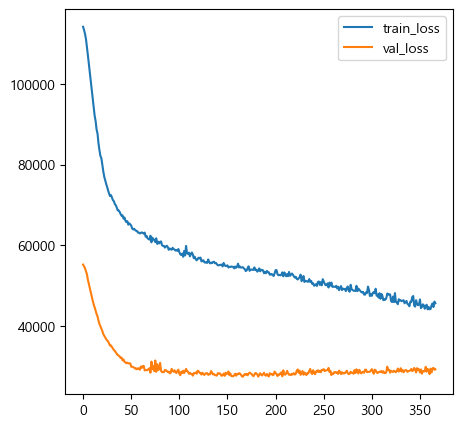

In [336]:
plt.plot(train_loss_hk1_22, label = 'train_loss')
plt.plot(val_loss_hk1_22, label = 'val_loss')
plt.legend()
plt.show()

In [337]:
val_r2_hk1_22, val_mae_hk1_22 = test(valid_loader_hk1_22, model_hk1_22,isEDR=isEDR)


y_label :  0.644444465637207 y_pred :  0.0
y_label :  0.0 y_pred :  393.9764099121094
y_label :  66.19444274902344 y_pred :  1380.0274658203125
y_label :  603.1777954101562 y_pred :  1130.4810791015625
y_label :  1650.4610595703125 y_pred :  1458.8924560546875
y_label :  1889.9111328125 y_pred :  1248.875732421875
y_label :  2012.8721923828125 y_pred :  750.3855590820312
y_label :  2372.111083984375 y_pred :  1275.2796630859375
y_label :  1686.494384765625 y_pred :  1604.1173095703125
y_label :  1970.388916015625 y_pred :  1360.0897216796875
y_label :  1248.572265625 y_pred :  356.491943359375
y_label :  1660.594482421875 y_pred :  1303.83056640625
y_label :  1807.6722412109375 y_pred :  1906.3096923828125
y_label :  3366.227783203125 y_pred :  2504.91845703125
y_label :  2980.583251953125 y_pred :  2213.97705078125
y_label :  3522.783447265625 y_pred :  2201.79443359375
y_label :  3735.01123046875 y_pred :  2809.787353515625
y_label :  3637.050048828125 y_pred :  2413.541015625
y_labe

In [338]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_22, test_mae_hk1_22 = test(test_loader_hk1_22, model_hk1_22, isEDR=isEDR)
y_label_hk1_22 = y_label_plt
y_pred_hk1_22 = y_pred_plt

y_label :  489.1555480957031 y_pred :  1329.0706787109375
y_label :  307.5888977050781 y_pred :  672.1990356445312
y_label :  279.3888854980469 y_pred :  1853.3209228515625
y_label :  1166.844482421875 y_pred :  1549.6116943359375
y_label :  741.9055786132812 y_pred :  1641.6129150390625
y_label :  662.1166381835938 y_pred :  1817.2938232421875
y_label :  1486.611083984375 y_pred :  1760.6239013671875
y_label :  1089.4888916015625 y_pred :  1972.3656005859375
y_label :  651.7666625976562 y_pred :  1178.570556640625
y_label :  320.98333740234375 y_pred :  1210.1102294921875
y_label :  1276.2667236328125 y_pred :  1036.217529296875
y_label :  1380.3499755859375 y_pred :  915.1734008789062
y_label :  1811.63330078125 y_pred :  0.0
y_label :  525.20556640625 y_pred :  0.0
y_label :  61.07777786254883 y_pred :  1205.2017822265625
y_label :  424.3833312988281 y_pred :  308.32745361328125
y_label :  285.8166809082031 y_pred :  168.7212371826172
y_label :  241.9499969482422 y_pred :  1288.1185

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-203.38961181640627, 4271.181848144532)


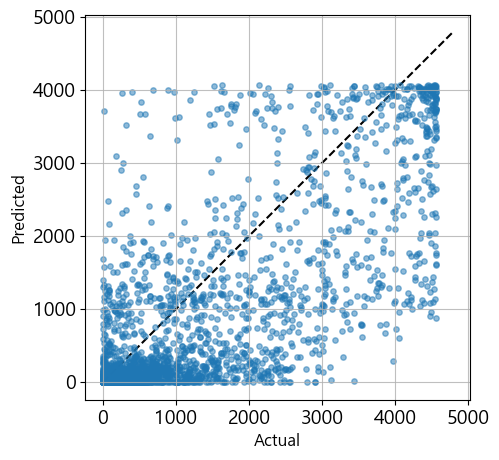

In [339]:
plot_scatter(y_label_hk1_22,y_pred_hk1_22)

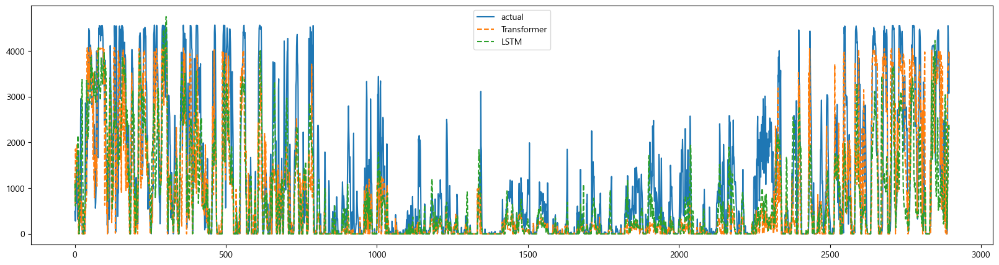

In [340]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_22[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_22[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_22[_start:_end], '--',label = 'LSTM')

plt.legend()

In [341]:
#hk1_4일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_30.parameters(), lr=lr)
train_loss_hk1_30, val_loss_hk1_30 = trainer(train_loader_hk1_30, valid_loader_hk1_30, model_hk1_30, criterion, optimizer, target='hk1', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk1_30.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7519816092384382
MAE Loss:  1263.8173936308071
Validation
R2 score: -0.6869780608897487
MAE Loss:  1189.9775374745927
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7337057401801803
MAE Loss:  1254.8949663543835
Validation
R2 score: -0.6657436681546576
MAE Loss:  1180.8640865416703
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7096769165153916
MAE Loss:  1244.1895367596649
Validation
R2 score: -0.6396888540198513
MAE Loss:  1170.673114503504
최신화
Epoch 3/1000
TRAIN
R2 score: -0.6812387653322132
MAE Loss:  1228.4711967251137
Validation
R2 score: -0.6065042664998026
MAE Loss:  1150.4591895555027
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6413110572945739
MAE Loss:  1205.6656216113486
Validation
R2 score: -0.5666696341056301
MAE Loss:  1129.6907260396747
최신화
Epoch 5/1000
TRAIN
R2 score: -0.59552257762071
MAE Loss:  1184.152293859633
Validation
R2 score: -0.5168946816459141
MAE Loss:  1108.2133695622085
최신화
Epoch 6/1000
TRAIN
R2 score: -0.5472132768461968
MAE Loss:  1161.9058384042278
V

R2 score: 0.4803191109688172
MAE Loss:  705.1446116896008
Validation
R2 score: 0.5473210024334008
MAE Loss:  650.8602214453135
Epoch 55/1000
TRAIN
R2 score: 0.4873347616667272
MAE Loss:  706.7407303763152
Validation
R2 score: 0.5410652571204095
MAE Loss:  645.3333713036592
최신화
Epoch 56/1000
TRAIN
R2 score: 0.48400173645427025
MAE Loss:  700.4908418670385
Validation
R2 score: 0.5636414966273064
MAE Loss:  644.3340537519313
최신화
Epoch 57/1000
TRAIN
R2 score: 0.4829366103051437
MAE Loss:  701.8281961425882
Validation
R2 score: 0.5604445114925958
MAE Loss:  647.3192761041067
Epoch 58/1000
TRAIN
R2 score: 0.4903390041716654
MAE Loss:  703.2698386299234
Validation
R2 score: 0.5264689334179116
MAE Loss:  654.1936855213752
Epoch 59/1000
TRAIN
R2 score: 0.4926639022782737
MAE Loss:  696.8078583502282
Validation
R2 score: 0.5630591988314992
MAE Loss:  635.5950513617115
최신화
Epoch 60/1000
TRAIN
R2 score: 0.4969280541480744
MAE Loss:  693.2315411104042
Validation
R2 score: 0.5624157877781857
MAE Los

R2 score: 0.5307595008889403
MAE Loss:  648.0031129669302
Validation
R2 score: 0.5779401740567012
MAE Loss:  624.7803135311651
Epoch 111/1000
TRAIN
R2 score: 0.5261384761638915
MAE Loss:  651.8311091477274
Validation
R2 score: 0.5546992841504292
MAE Loss:  631.8064614669913
Epoch 112/1000
TRAIN
R2 score: 0.5183921885609573
MAE Loss:  656.4942148059719
Validation
R2 score: 0.5805097303917679
MAE Loss:  613.1904661183239
Epoch 113/1000
TRAIN
R2 score: 0.5334686490645965
MAE Loss:  646.5354921925193
Validation
R2 score: 0.5752175683026173
MAE Loss:  616.3820049868274
Epoch 114/1000
TRAIN
R2 score: 0.5281106851098027
MAE Loss:  647.2250014070949
Validation
R2 score: 0.5755340180554006
MAE Loss:  619.2044176914834
Epoch 115/1000
TRAIN
R2 score: 0.5244651156689939
MAE Loss:  647.827907475694
Validation
R2 score: 0.5576463557386047
MAE Loss:  629.9321346575324
Epoch 116/1000
TRAIN
R2 score: 0.5303452031052672
MAE Loss:  646.9182304100477
Validation
R2 score: 0.5709926836997061
MAE Loss:  625.

R2 score: 0.5377179958250154
MAE Loss:  629.4575966913067
Validation
R2 score: 0.5720926176409418
MAE Loss:  619.4368390627552
Epoch 167/1000
TRAIN
R2 score: 0.5394796183972721
MAE Loss:  633.8176649695484
Validation
R2 score: 0.5678444553179861
MAE Loss:  608.858523155235
Epoch 168/1000
TRAIN
R2 score: 0.540667847319681
MAE Loss:  631.3654948986389
Validation
R2 score: 0.5781736918672318
MAE Loss:  615.0626964313401
Epoch 169/1000
TRAIN
R2 score: 0.544369236999199
MAE Loss:  628.851964555354
Validation
R2 score: 0.5667964039060158
MAE Loss:  614.4340761276177
Epoch 170/1000
TRAIN
R2 score: 0.5441478960108035
MAE Loss:  628.401241320741
Validation
R2 score: 0.5849531275879218
MAE Loss:  602.9405811469813
Epoch 171/1000
TRAIN
R2 score: 0.5500667270564897
MAE Loss:  626.463484788257
Validation
R2 score: 0.550232468870631
MAE Loss:  618.4234040066996
Epoch 172/1000
TRAIN
R2 score: 0.5418598630905829
MAE Loss:  628.3725078749321
Validation
R2 score: 0.5847912158736124
MAE Loss:  608.411935

R2 score: 0.5522649328465667
MAE Loss:  617.8929151508659
Validation
R2 score: 0.5699808323823476
MAE Loss:  608.8317788203431
Epoch 223/1000
TRAIN
R2 score: 0.5476979998386668
MAE Loss:  624.1664730371224
Validation
R2 score: 0.5909056857125353
MAE Loss:  602.3256093794605
Epoch 224/1000
TRAIN
R2 score: 0.5444178309436993
MAE Loss:  634.2462430600233
Validation
R2 score: 0.5256393305951952
MAE Loss:  628.4181656132063
Epoch 225/1000
TRAIN
R2 score: 0.550775524684562
MAE Loss:  617.1326968185388
Validation
R2 score: 0.5648969287082714
MAE Loss:  605.0468338495407
Epoch 226/1000
TRAIN
R2 score: 0.5526349623031797
MAE Loss:  617.2642587104405
Validation
R2 score: 0.5743157817271805
MAE Loss:  605.6575973086422
Epoch 227/1000
TRAIN
R2 score: 0.5445399696949511
MAE Loss:  625.9134800771355
Validation
R2 score: 0.48619148867274264
MAE Loss:  646.0263075853962
Epoch 228/1000
TRAIN
R2 score: 0.529155391032703
MAE Loss:  626.9552253020322
Validation
R2 score: 0.5805437976067713
MAE Loss:  605.

R2 score: 0.5704233647158982
MAE Loss:  602.1428590219032
Validation
R2 score: 0.5177819269772213
MAE Loss:  625.6486105426379
Epoch 279/1000
TRAIN
R2 score: 0.5518123463032303
MAE Loss:  611.698728162221
Validation
R2 score: 0.5676395525836458
MAE Loss:  601.421355761621
Epoch 280/1000
TRAIN
R2 score: 0.582118175329602
MAE Loss:  594.3313914322381
Validation
R2 score: 0.5428631116509856
MAE Loss:  607.3833365794715
Epoch 281/1000
TRAIN
R2 score: 0.5664904330280462
MAE Loss:  598.0144229560523
Validation
R2 score: 0.5427148339333099
MAE Loss:  609.8181532260351
Epoch 282/1000
TRAIN
R2 score: 0.5689009692596926
MAE Loss:  600.4908116644523
Validation
R2 score: 0.5531313587912923
MAE Loss:  604.4545668908489
Epoch 283/1000
TRAIN
R2 score: 0.5724215109368762
MAE Loss:  593.4404838507888
Validation
R2 score: 0.5643362057650317
MAE Loss:  602.3878028411617
Epoch 284/1000
TRAIN
R2 score: 0.578064177084571
MAE Loss:  589.9129543213393
Validation
R2 score: 0.5303971323977791
MAE Loss:  617.309

R2 score: 0.5962497937475666
MAE Loss:  566.6771303391265
Validation
R2 score: 0.4905329779559029
MAE Loss:  629.357426350456
Epoch 335/1000
TRAIN
R2 score: 0.6066105907866217
MAE Loss:  561.6158666198877
Validation
R2 score: 0.49565186854026855
MAE Loss:  629.7330784238708
Epoch 336/1000
TRAIN
R2 score: 0.5999812034974329
MAE Loss:  564.3261133985582
Validation
R2 score: 0.5031136909079211
MAE Loss:  636.8210880201532
Epoch 337/1000
TRAIN
R2 score: 0.5948997515426853
MAE Loss:  572.8343095020939
Validation
R2 score: 0.50057589600383
MAE Loss:  630.8299769271251
Epoch 338/1000
TRAIN
R2 score: 0.6048150224150302
MAE Loss:  563.0417609221905
Validation
R2 score: 0.5072828823376893
MAE Loss:  628.7615411085047
Epoch 339/1000
TRAIN
R2 score: 0.6082553122125197
MAE Loss:  561.7635876708317
Validation
R2 score: 0.5181165058019976
MAE Loss:  624.0809714842201
Epoch 340/1000
TRAIN
R2 score: 0.60603982177845
MAE Loss:  563.294044608497
Validation
R2 score: 0.5099194980948957
MAE Loss:  622.6851

R2 score: 0.6191924532610624
MAE Loss:  543.8171278474517
Validation
R2 score: 0.4909565486065518
MAE Loss:  629.6241072894717
Epoch 391/1000
TRAIN
R2 score: 0.6120809332907398
MAE Loss:  551.35995748312
Validation
R2 score: 0.48758453492133447
MAE Loss:  656.8247897175518
Epoch 392/1000
TRAIN
R2 score: 0.6179886657304319
MAE Loss:  551.8565646498582
Validation
R2 score: 0.49703220507000057
MAE Loss:  625.8959610519644
Epoch 393/1000
TRAIN
R2 score: 0.6086904303447838
MAE Loss:  557.6244993074145
Validation
R2 score: 0.5029708622404585
MAE Loss:  624.9291620103808
Epoch 394/1000
TRAIN
R2 score: 0.6110287648391887
MAE Loss:  558.123392380531
Validation
R2 score: 0.503778386569678
MAE Loss:  636.7686751920178
Epoch 395/1000
TRAIN
R2 score: 0.6277503623574763
MAE Loss:  542.7936666181171
Validation
R2 score: 0.5018808040454326
MAE Loss:  628.0128585366666
Epoch 396/1000
TRAIN
R2 score: 0.6218622142505026
MAE Loss:  540.4706186797497
Validation
R2 score: 0.50040438945362
MAE Loss:  639.073

R2 score: 0.642670810567016
MAE Loss:  524.725211150479
Validation
R2 score: 0.48198962304732273
MAE Loss:  650.0240871235857
Epoch 447/1000
TRAIN
R2 score: 0.6383339529300187
MAE Loss:  533.8804592135389
Validation
R2 score: 0.5081545503078753
MAE Loss:  629.703182134097
Epoch 448/1000
TRAIN
R2 score: 0.6468123485457931
MAE Loss:  520.6085052501069
Validation
R2 score: 0.4966691182074827
MAE Loss:  636.4346708722019
Epoch 449/1000
TRAIN
R2 score: 0.647889156248703
MAE Loss:  524.0861806195007
Validation
R2 score: 0.48584503674838453
MAE Loss:  641.7547865268286
Epoch 450/1000
TRAIN
R2 score: 0.6408981819480108
MAE Loss:  529.915125423944
Validation
R2 score: 0.49560086564255634
MAE Loss:  637.4309979534104
Epoch 451/1000
TRAIN
R2 score: 0.6068364336680984
MAE Loss:  556.867749536539
Validation
R2 score: 0.5042878390884689
MAE Loss:  622.9279561050347
Epoch 452/1000
TRAIN
R2 score: 0.637504002690214
MAE Loss:  535.2542000850214
Validation
R2 score: 0.4944387152060423
MAE Loss:  633.214

<All keys matched successfully>

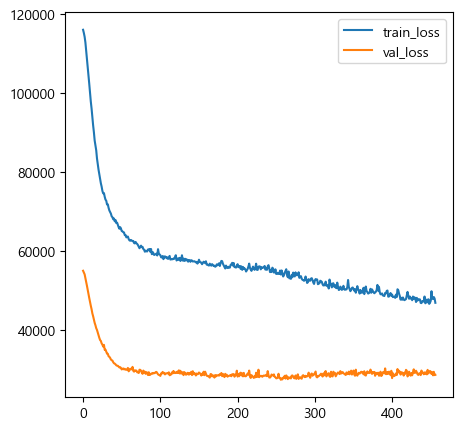

In [342]:
plt.plot(train_loss_hk1_30, label = 'train_loss')
plt.plot(val_loss_hk1_30, label = 'val_loss')
plt.legend()
plt.show()

In [343]:
val_r2_hk1_30, val_mae_hk1_30 = test(valid_loader_hk1_30, model_hk1_30,isEDR=isEDR)


y_label :  1686.494384765625 y_pred :  1306.489990234375
y_label :  1970.388916015625 y_pred :  1360.5517578125
y_label :  1248.572265625 y_pred :  721.135498046875
y_label :  1660.594482421875 y_pred :  1330.168701171875
y_label :  1807.6722412109375 y_pred :  1651.378173828125
y_label :  3366.227783203125 y_pred :  1692.4603271484375
y_label :  2980.583251953125 y_pred :  1549.775634765625
y_label :  3522.783447265625 y_pred :  1565.9168701171875
y_label :  3735.01123046875 y_pred :  2008.057373046875
y_label :  3637.050048828125 y_pred :  1577.39990234375
y_label :  2547.43896484375 y_pred :  1612.3026123046875
y_label :  3618.666748046875 y_pred :  1360.731201171875
y_label :  4366.888671875 y_pred :  1325.37890625
y_label :  4526.6611328125 y_pred :  3186.696533203125
y_label :  4327.34423828125 y_pred :  1915.102783203125
y_label :  4339.0 y_pred :  2890.869384765625
y_label :  4380.43896484375 y_pred :  3094.529052734375
y_label :  4410.06103515625 y_pred :  4077.179931640625
y_

In [344]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_30, test_mae_hk1_30 = test(test_loader_hk1_30, model_hk1_30, isEDR=isEDR)
y_label_hk1_30 = y_label_plt
y_pred_hk1_30 = y_pred_plt

y_label :  651.7666625976562 y_pred :  1079.4998779296875
y_label :  320.98333740234375 y_pred :  1322.621826171875
y_label :  1276.2667236328125 y_pred :  1256.3541259765625
y_label :  1380.3499755859375 y_pred :  1257.65771484375
y_label :  1811.63330078125 y_pred :  64.6915283203125
y_label :  525.20556640625 y_pred :  78.27981567382812
y_label :  61.07777786254883 y_pred :  1565.856201171875
y_label :  424.3833312988281 y_pred :  465.3946838378906
y_label :  285.8166809082031 y_pred :  219.99163818359375
y_label :  241.9499969482422 y_pred :  1285.382568359375
y_label :  396.9055480957031 y_pred :  1360.897216796875
y_label :  2501.316650390625 y_pred :  1177.6868896484375
y_label :  2956.3388671875 y_pred :  947.8082885742188
y_label :  1561.2388916015625 y_pred :  275.2420654296875
y_label :  522.9055786132812 y_pred :  1110.7052001953125
y_label :  687.0166625976562 y_pred :  433.05450439453125
y_label :  131.51666259765625 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0

y_label :  4460.2333984375 y_pred :  3658.5830078125
y_label :  4292.61669921875 y_pred :  3617.58935546875
y_label :  2790.5 y_pred :  2170.624267578125
y_label :  561.4111328125 y_pred :  0.0
y_label :  117.60555267333984 y_pred :  0.0
y_label :  5.511111259460449 y_pred :  0.0
y_label :  30.244443893432617 y_pred :  93.27090454101562
y_label :  145.4499969482422 y_pred :  113.59527587890625
y_label :  26.649999618530273 y_pred :  0.0
y_label :  5.433333396911621 y_pred :  0.0
y_label :  91.88333129882812 y_pred :  1834.9820556640625
y_label :  673.4722290039062 y_pred :  145.4794158935547
y_label :  59.92222213745117 y_pred :  845.1787719726562
y_label :  261.272216796875 y_pred :  4063.427490234375
y_label :  682.8721923828125 y_pred :  4077.413330078125
y_label :  1250.6611328125 y_pred :  4070.677490234375
y_label :  1522.36669921875 y_pred :  3873.064697265625
y_label :  2980.60546875 y_pred :  4025.666259765625
y_label :  4426.8056640625 y_pred :  4055.199951171875
y_label :  4

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-204.84621582031252, 4301.770532226563)


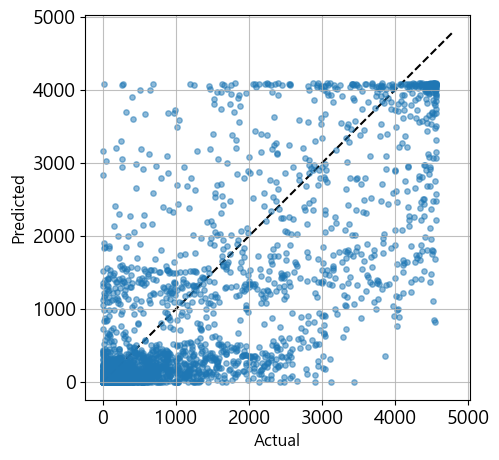

In [345]:
plot_scatter(y_label_hk1_30,y_pred_hk1_30)

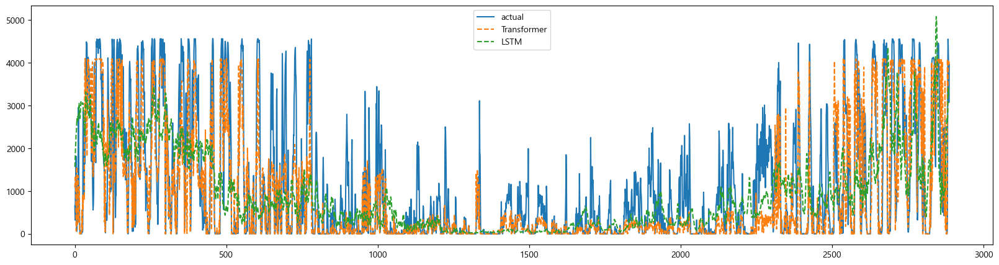

In [346]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_30[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_30[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_30[_start:_end], '--',label = 'LSTM')

plt.legend()

In [347]:
#hk1_5일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1_38.parameters(), lr=lr)
train_loss_hk1_38, val_loss_hk1_38 = trainer(train_loader_hk1_38, valid_loader_hk1_38, model_hk1_38, criterion, optimizer, target='hk1', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk1_38.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.752100683350085
MAE Loss:  1264.4474027311821
Validation
R2 score: -0.6837386635760601
MAE Loss:  1187.1966759143877
최신화
Epoch 1/1000
TRAIN
R2 score: -0.734297909336703
MAE Loss:  1255.7551217433997
Validation
R2 score: -0.6629335223720825
MAE Loss:  1178.2446776952822
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7105848180095398
MAE Loss:  1245.1746413614878
Validation
R2 score: -0.6372424959926952
MAE Loss:  1168.1937292337252
최신화
Epoch 3/1000
TRAIN
R2 score: -0.6823976865336483
MAE Loss:  1233.6505271289664
Validation
R2 score: -0.6081541580991605
MAE Loss:  1157.7295584113758
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6498914487991048
MAE Loss:  1212.2218223981286
Validation
R2 score: -0.5683398258447268
MAE Loss:  1131.2935172465484
최신화
Epoch 5/1000
TRAIN
R2 score: -0.605749259117532
MAE Loss:  1190.1590163512458
Validation
R2 score: -0.5230296471715759
MAE Loss:  1110.85305820014
최신화
Epoch 6/1000
TRAIN
R2 score: -0.5574234359176251
MAE Loss:  1167.4423993856
Valid

R2 score: 0.47229913568524484
MAE Loss:  715.11585028599
Validation
R2 score: 0.5636423634637928
MAE Loss:  639.4481122914731
최신화
Epoch 55/1000
TRAIN
R2 score: 0.4817494186187474
MAE Loss:  712.8052137854969
Validation
R2 score: 0.5544003864317824
MAE Loss:  639.1595975806213
Epoch 56/1000
TRAIN
R2 score: 0.48045109135365005
MAE Loss:  707.0702662772982
Validation
R2 score: 0.5537497401788337
MAE Loss:  642.9785316042439
Epoch 57/1000
TRAIN
R2 score: 0.4857175405158711
MAE Loss:  703.4855492156389
Validation
R2 score: 0.5331490529579627
MAE Loss:  654.1685127732445
Epoch 58/1000
TRAIN
R2 score: 0.481984985338871
MAE Loss:  704.3222849930663
Validation
R2 score: 0.529421066852406
MAE Loss:  665.0653582333993
Epoch 59/1000
TRAIN
R2 score: 0.49201979950107455
MAE Loss:  701.4627110281003
Validation
R2 score: 0.5693518171799281
MAE Loss:  630.9185237903245
최신화
Epoch 60/1000
TRAIN
R2 score: 0.4868361191498317
MAE Loss:  699.8729211478868
Validation
R2 score: 0.5669064273309362
MAE Loss:  63

R2 score: 0.5418005095155285
MAE Loss:  637.0749430320496
Validation
R2 score: 0.5743282413459989
MAE Loss:  613.1558345401161
Epoch 111/1000
TRAIN
R2 score: 0.5334614350668749
MAE Loss:  640.016964773492
Validation
R2 score: 0.5934911853299145
MAE Loss:  612.1473401808933
Epoch 112/1000
TRAIN
R2 score: 0.5419237643649069
MAE Loss:  640.9809006077545
Validation
R2 score: 0.5739467867698069
MAE Loss:  606.6053668337943
최신화
Epoch 113/1000
TRAIN
R2 score: 0.5369066802211581
MAE Loss:  636.2718335990862
Validation
R2 score: 0.5992090103724184
MAE Loss:  609.8110236237106
Epoch 114/1000
TRAIN
R2 score: 0.5424785013933486
MAE Loss:  635.6452390119726
Validation
R2 score: 0.5891385950847225
MAE Loss:  610.0083410750266
Epoch 115/1000
TRAIN
R2 score: 0.5380606749513541
MAE Loss:  636.2741159376391
Validation
R2 score: 0.5967940311256605
MAE Loss:  607.8262011150911
Epoch 116/1000
TRAIN
R2 score: 0.5403864271772332
MAE Loss:  633.2607290668863
Validation
R2 score: 0.5984807437446815
MAE Loss:  

R2 score: 0.5552399824195359
MAE Loss:  617.1570558360341
Validation
R2 score: 0.5556800595020956
MAE Loss:  619.0847183659121
Epoch 167/1000
TRAIN
R2 score: 0.547470339275884
MAE Loss:  619.0654814021029
Validation
R2 score: 0.5465752830670705
MAE Loss:  616.5047114063409
Epoch 168/1000
TRAIN
R2 score: 0.5505524413296606
MAE Loss:  614.9543842519435
Validation
R2 score: 0.575412819811524
MAE Loss:  596.6638957919826
최신화
Epoch 169/1000
TRAIN
R2 score: 0.5542730111393741
MAE Loss:  618.0089393991623
Validation
R2 score: 0.5438911740844266
MAE Loss:  619.110273123164
Epoch 170/1000
TRAIN
R2 score: 0.5496241653511669
MAE Loss:  615.5072152956342
Validation
R2 score: 0.5692646764815621
MAE Loss:  609.9583487719627
Epoch 171/1000
TRAIN
R2 score: 0.5537486836778684
MAE Loss:  619.3434244602141
Validation
R2 score: 0.5549313441258469
MAE Loss:  610.7769277768848
Epoch 172/1000
TRAIN
R2 score: 0.5599529320521767
MAE Loss:  612.7391806487135
Validation
R2 score: 0.5331651219922786
MAE Loss:  63

R2 score: 0.5658332409271976
MAE Loss:  599.8873766131088
Validation
R2 score: 0.5259687945780019
MAE Loss:  620.1690773796039
Epoch 223/1000
TRAIN
R2 score: 0.569951648821564
MAE Loss:  597.3038499360904
Validation
R2 score: 0.5238286617369006
MAE Loss:  615.1668822698143
Epoch 224/1000
TRAIN
R2 score: 0.5751443669845804
MAE Loss:  592.2528772046196
Validation
R2 score: 0.5185643000929168
MAE Loss:  612.5849808065504
Epoch 225/1000
TRAIN
R2 score: 0.5833542371571925
MAE Loss:  587.1378865806969
Validation
R2 score: 0.5153234856230309
MAE Loss:  620.9695651641443
Epoch 226/1000
TRAIN
R2 score: 0.5859351148936731
MAE Loss:  584.1867953806411
Validation
R2 score: 0.5362787677532173
MAE Loss:  618.5352100242882
Epoch 227/1000
TRAIN
R2 score: 0.5466602641209024
MAE Loss:  609.0951021276486
Validation
R2 score: 0.5456144237438684
MAE Loss:  612.3131646390046
Epoch 228/1000
TRAIN
R2 score: 0.5676145405608093
MAE Loss:  606.5968398960337
Validation
R2 score: 0.508680349871511
MAE Loss:  627.4

R2 score: 0.6108541497584907
MAE Loss:  562.0799765437488
Validation
R2 score: 0.5151321864144198
MAE Loss:  618.9455716954554
Epoch 279/1000
TRAIN
R2 score: 0.6129447210112415
MAE Loss:  560.2022964447467
Validation
R2 score: 0.5152214988161947
MAE Loss:  617.5292157761703
Epoch 280/1000
TRAIN
R2 score: 0.6015318077705181
MAE Loss:  565.2173075538927
Validation
R2 score: 0.5330266648153603
MAE Loss:  621.1149311054223
Epoch 281/1000
TRAIN
R2 score: 0.6053109977827933
MAE Loss:  566.784675559952
Validation
R2 score: 0.5081031870692552
MAE Loss:  618.166193096855
Epoch 282/1000
TRAIN
R2 score: 0.5972775919325247
MAE Loss:  566.9049669950873
Validation
R2 score: 0.5258646495458339
MAE Loss:  612.4488384161247
Epoch 283/1000
TRAIN
R2 score: 0.611004981332302
MAE Loss:  562.6891855218606
Validation
R2 score: 0.520059876984664
MAE Loss:  617.6993326733592
Epoch 284/1000
TRAIN
R2 score: 0.596020732379698
MAE Loss:  572.9317135688656
Validation
R2 score: 0.5200914746951777
MAE Loss:  610.5760

R2 score: 0.6343724453837473
MAE Loss:  541.6649113550426
Validation
R2 score: 0.48041637604897947
MAE Loss:  643.2650983402652
Epoch 335/1000
TRAIN
R2 score: 0.6316647998050682
MAE Loss:  542.3542514047259
Validation
R2 score: 0.5235556831377447
MAE Loss:  628.3391685717894
Epoch 336/1000
TRAIN
R2 score: 0.6379776677752458
MAE Loss:  536.1023243537505
Validation
R2 score: 0.5088414796447787
MAE Loss:  625.9637721233165
Epoch 337/1000
TRAIN
R2 score: 0.6408113473191189
MAE Loss:  540.1479550610404
Validation
R2 score: 0.520939220923045
MAE Loss:  636.4565086893791
Epoch 338/1000
TRAIN
R2 score: 0.64012813335265
MAE Loss:  532.8654357228364
Validation
R2 score: 0.509018556844628
MAE Loss:  625.3545153048283
Epoch 339/1000
TRAIN
R2 score: 0.630767655989249
MAE Loss:  540.1238591715709
Validation
R2 score: 0.5526536600608329
MAE Loss:  607.6483947463815
Epoch 340/1000
TRAIN
R2 score: 0.629702417508148
MAE Loss:  542.2636727994596
Validation
R2 score: 0.5307944038416408
MAE Loss:  614.6012

R2 score: 0.6633645428131858
MAE Loss:  510.82127494061615
Validation
R2 score: 0.512664565733352
MAE Loss:  625.1750318547946
Epoch 391/1000
TRAIN
R2 score: 0.6717419001924476
MAE Loss:  503.0234539464467
Validation
R2 score: 0.5304699810154865
MAE Loss:  623.2863532522324
Epoch 392/1000
TRAIN
R2 score: 0.6671317940051938
MAE Loss:  509.52270502386386
Validation
R2 score: 0.5236448462537027
MAE Loss:  625.8720753970764
Epoch 393/1000
TRAIN
R2 score: 0.6715086320321236
MAE Loss:  505.0475123612782
Validation
R2 score: 0.5150712737332297
MAE Loss:  622.8638078987949
Epoch 394/1000
TRAIN
R2 score: 0.6754815718641944
MAE Loss:  502.8015466865938
Validation
R2 score: 0.5141050772154079
MAE Loss:  626.9959924938038
Epoch 395/1000
TRAIN
R2 score: 0.656085579486005
MAE Loss:  513.7055356585414
Validation
R2 score: 0.4938436297228225
MAE Loss:  638.2396103442953
Epoch 396/1000
TRAIN
R2 score: 0.6639750933159794
MAE Loss:  511.5479773998394
Validation
R2 score: 0.5351758504223716
MAE Loss:  622

R2 score: 0.6757584167990149
MAE Loss:  498.16685868748516
Validation
R2 score: 0.4759751673458894
MAE Loss:  638.3956054157505
Epoch 447/1000
TRAIN
R2 score: 0.6805181405673579
MAE Loss:  494.6922121544413
Validation
R2 score: 0.5003183177167303
MAE Loss:  624.8958830325021
Epoch 448/1000
TRAIN
R2 score: 0.6827970897140647
MAE Loss:  487.3120786384292
Validation
R2 score: 0.4868680142569636
MAE Loss:  627.8966348371102
Epoch 449/1000
TRAIN
R2 score: 0.6860170399469177
MAE Loss:  488.59498072919973
Validation
R2 score: 0.5002327400558251
MAE Loss:  628.7521445031457
Epoch 450/1000
TRAIN
R2 score: 0.6751989605731841
MAE Loss:  502.30124808578176
Validation
R2 score: 0.5150049904500897
MAE Loss:  611.8488561184699
Epoch 451/1000
TRAIN
R2 score: 0.6949316092256879
MAE Loss:  482.0857429653786
Validation
R2 score: 0.4756306075990331
MAE Loss:  640.4456200530038
Epoch 452/1000
TRAIN
R2 score: 0.6826249745626285
MAE Loss:  489.36707871875797
Validation
R2 score: 0.5311990384437129
MAE Loss: 

R2 score: 0.7145850610567777
MAE Loss:  464.3519754293824
Validation
R2 score: 0.46502707484316297
MAE Loss:  643.2139211076844
Epoch 503/1000
TRAIN
R2 score: 0.7147411804727797
MAE Loss:  460.7897933693182
Validation
R2 score: 0.47743986868350674
MAE Loss:  636.6362496196099
Epoch 504/1000
TRAIN
R2 score: 0.722631548941733
MAE Loss:  453.9614159597842
Validation
R2 score: 0.47296820568304143
MAE Loss:  641.6672189313468
Epoch 505/1000
TRAIN
R2 score: 0.7094985889017003
MAE Loss:  465.5524885314403
Validation
R2 score: 0.4907241470184547
MAE Loss:  624.2623152232688
Epoch 506/1000
TRAIN
R2 score: 0.7170544152622159
MAE Loss:  455.7901981348836
Validation
R2 score: 0.4949212841539925
MAE Loss:  636.3408074938548
Epoch 507/1000
TRAIN
R2 score: 0.7121110415431653
MAE Loss:  465.85038127667184
Validation
R2 score: 0.4590707764757036
MAE Loss:  641.5564078339845
Epoch 508/1000
TRAIN
R2 score: 0.7223309487073248
MAE Loss:  455.2311568327265
Validation
R2 score: 0.49482680419179514
MAE Loss: 

<All keys matched successfully>

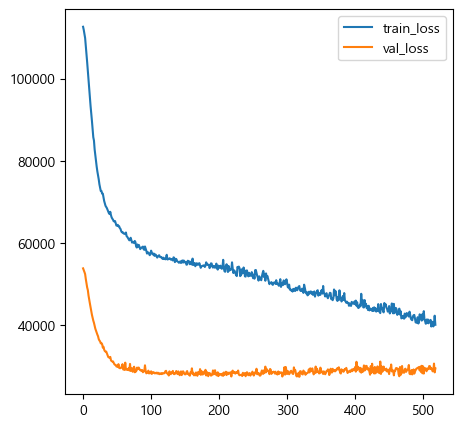

In [348]:
plt.plot(train_loss_hk1_38, label = 'train_loss')
plt.plot(val_loss_hk1_38, label = 'val_loss')
plt.legend()
plt.show()

In [349]:
val_r2_hk1_38, val_mae_hk1_38 = test(valid_loader_hk1_38, model_hk1_38,isEDR=isEDR)


y_label :  3735.01123046875 y_pred :  2392.9013671875
y_label :  3637.050048828125 y_pred :  2034.4188232421875
y_label :  2547.43896484375 y_pred :  1988.6402587890625
y_label :  3618.666748046875 y_pred :  1228.7830810546875
y_label :  4366.888671875 y_pred :  1607.938720703125
y_label :  4526.6611328125 y_pred :  2237.79736328125
y_label :  4327.34423828125 y_pred :  2339.662841796875
y_label :  4339.0 y_pred :  2123.54296875
y_label :  4380.43896484375 y_pred :  2177.406982421875
y_label :  4410.06103515625 y_pred :  3073.39892578125
y_label :  4301.39453125 y_pred :  2141.43359375
y_label :  4300.99462890625 y_pred :  2050.096923828125
y_label :  4265.95556640625 y_pred :  2424.971435546875
y_label :  4054.4111328125 y_pred :  3170.32275390625
y_label :  3564.655517578125 y_pred :  1822.0772705078125
y_label :  3505.477783203125 y_pred :  1951.3890380859375
y_label :  2734.88330078125 y_pred :  3444.8935546875
y_label :  2780.36669921875 y_pred :  3723.521484375
y_label :  2196.34

In [350]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1_38, test_mae_hk1_38 = test(test_loader_hk1_38, model_hk1_38, isEDR=isEDR)
y_label_hk1_38 = y_label_plt
y_pred_hk1_38 = y_pred_plt

y_label :  285.8166809082031 y_pred :  77.56144714355469
y_label :  241.9499969482422 y_pred :  1477.67236328125
y_label :  396.9055480957031 y_pred :  1424.280517578125
y_label :  2501.316650390625 y_pred :  1283.9202880859375
y_label :  2956.3388671875 y_pred :  699.4678955078125
y_label :  1561.2388916015625 y_pred :  176.09165954589844
y_label :  522.9055786132812 y_pred :  910.1505737304688
y_label :  687.0166625976562 y_pred :  198.86204528808594
y_label :  131.51666259765625 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  18.47222137451172 y_pred :  0.0
y_label :  9.177778244018555 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  85.06666564941406 y_pred :  40.14126205444336
y_label :  261.79443359375 y_pred :  0.0
y_label :  40.238887786865234 y_pred :  0.0
y_label :  84.12222290039062 y_pred :  0.0
y_label :  2860.75 y_pred :  75.73046875
y_label :  2802.23876953125 y_pred :  676.6718139648438
y_label :  2200

y_label :  2870.716552734375 y_pred :  3278.510498046875
y_label :  1350.994384765625 y_pred :  1776.4739990234375
y_label :  369.3722229003906 y_pred :  91.02649688720703
y_label :  74.0111083984375 y_pred :  0.0
y_label :  0.2611111104488373 y_pred :  0.0
y_label :  0.0 y_pred :  2564.116943359375
y_label :  268.3333435058594 y_pred :  2625.7822265625
y_label :  790.0277709960938 y_pred :  1102.0142822265625
y_label :  1021.2166748046875 y_pred :  1475.6680908203125
y_label :  2281.961181640625 y_pred :  1944.6656494140625
y_label :  2695.4443359375 y_pred :  457.6748046875
y_label :  2680.822265625 y_pred :  3089.96875
y_label :  2903.288818359375 y_pred :  4297.701171875
y_label :  1855.25 y_pred :  4116.90966796875
y_label :  1149.5888671875 y_pred :  3640.60693359375
y_label :  1114.8277587890625 y_pred :  4274.91796875
y_label :  2058.18896484375 y_pred :  4240.056640625
y_label :  2811.933349609375 y_pred :  1143.383544921875
y_label :  2550.8388671875 y_pred :  114.21622467041

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-224.2058837890625, 4708.323559570313)


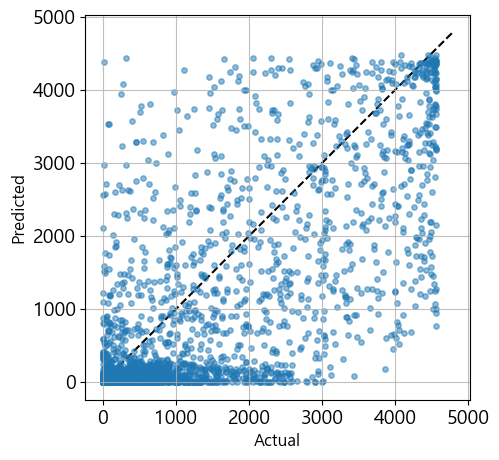

In [351]:
plot_scatter(y_label_hk1_38,y_pred_hk1_38)

In [694]:
model_score_test(y_label_hk1_38,y_pred_hk1_38)

R2 score: 0.6300508562546829
MAE Loss:  1141.8150166188889


(0.6300508562546829, 1141.8150166188889)

NameError: name 'y_label_hk1_15' is not defined

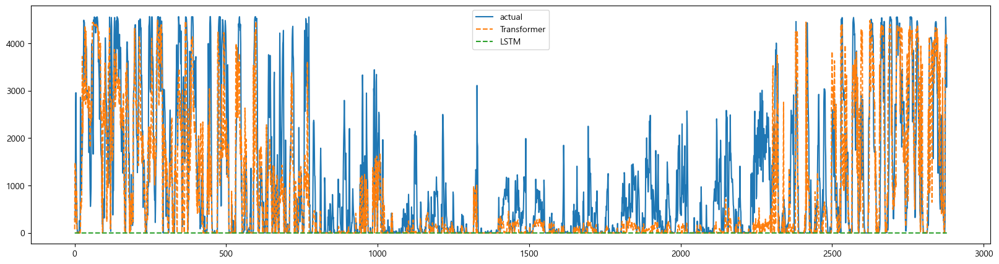

In [352]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1_38[_start:_end],label = 'actual')
plt.plot(y_pred_hk1_38[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1_38[_start:_end], '--',label = 'LSTM')

plt.legend()

In [1242]:
#hk1
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk1.parameters(), lr=lr)
train_loss_hk1, val_loss_hk1 = trainer(train_loader_hk1, valid_loader_hk1, model_hk1, criterion, optimizer, target='hk1', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk1.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7292876338991539
MAE Loss:  1251.8174961010836
Validation
R2 score: -0.6240726100695686
MAE Loss:  1162.8070419395194
최신화
Epoch 1/1000
TRAIN
R2 score: -0.6348146092734777
MAE Loss:  1214.806999570044
Validation
R2 score: -0.523956244961618
MAE Loss:  1133.0397727342583
최신화
Epoch 2/1000
TRAIN
R2 score: -0.5332588275468577
MAE Loss:  1174.2173723357464
Validation
R2 score: -0.4127878906797382
MAE Loss:  1059.51340552324
최신화
Epoch 3/1000
TRAIN
R2 score: -0.38783826340915706
MAE Loss:  1090.598594241723
Validation
R2 score: -0.25328296175895937
MAE Loss:  994.5660630782713
최신화
Epoch 4/1000
TRAIN
R2 score: -0.2248548937124426
MAE Loss:  1020.3173257647315
Validation
R2 score: -0.10061757485709966
MAE Loss:  942.1347924140615
최신화
Epoch 5/1000
TRAIN
R2 score: -0.08828520818186325
MAE Loss:  963.4746348203623
Validation
R2 score: 0.016444456548601383
MAE Loss:  897.0052812120309
최신화
Epoch 6/1000
TRAIN
R2 score: 0.02109977140162944
MAE Loss:  916.6392836561836
Va

R2 score: 0.5310588921627577
MAE Loss:  654.4846164365283
Validation
R2 score: 0.6038595881793808
MAE Loss:  588.4494710940903
Epoch 56/1000
TRAIN
R2 score: 0.5324518353091411
MAE Loss:  649.6932043301687
Validation
R2 score: 0.5954172568641841
MAE Loss:  587.6015002855719
Epoch 57/1000
TRAIN
R2 score: 0.5330334253579896
MAE Loss:  647.8327962323059
Validation
R2 score: 0.6026322300436674
MAE Loss:  587.1916139451147
Epoch 58/1000
TRAIN
R2 score: 0.5325968576927883
MAE Loss:  653.0910760662465
Validation
R2 score: 0.5942593233674154
MAE Loss:  592.6943484762003
Epoch 59/1000
TRAIN
R2 score: 0.5319894129435481
MAE Loss:  649.2772036751672
Validation
R2 score: 0.5960455082372876
MAE Loss:  585.099707869667
최신화
Epoch 60/1000
TRAIN
R2 score: 0.5305017643355654
MAE Loss:  650.0357203930238
Validation
R2 score: 0.6170725611435485
MAE Loss:  583.9977061430754
최신화
Epoch 61/1000
TRAIN
R2 score: 0.5355123630709812
MAE Loss:  648.1091319139274
Validation
R2 score: 0.5911155049886585
MAE Loss:  59

R2 score: 0.5532889463003354
MAE Loss:  621.1092828614858
Validation
R2 score: 0.5858093957030976
MAE Loss:  589.2581633960516
Epoch 112/1000
TRAIN
R2 score: 0.557504250194937
MAE Loss:  619.5314978253589
Validation
R2 score: 0.5933351318771818
MAE Loss:  596.5052049098572
Epoch 113/1000
TRAIN
R2 score: 0.55960993775986
MAE Loss:  614.0354244853164
Validation
R2 score: 0.5981980347461038
MAE Loss:  586.3459318881359
Epoch 114/1000
TRAIN
R2 score: 0.5572215982348865
MAE Loss:  616.3713635828043
Validation
R2 score: 0.5809070650952499
MAE Loss:  591.9041173891497
Epoch 115/1000
TRAIN
R2 score: 0.5662818091584005
MAE Loss:  614.5965565801384
Validation
R2 score: 0.590160265179842
MAE Loss:  594.8561353385371
Epoch 116/1000
TRAIN
R2 score: 0.5541772378939728
MAE Loss:  616.674030300525
Validation
R2 score: 0.5938426160843804
MAE Loss:  589.4237004208946
Epoch 117/1000
TRAIN
R2 score: 0.5557519694512199
MAE Loss:  623.4422238348128
Validation
R2 score: 0.6016924539008337
MAE Loss:  598.4606

R2 score: 0.5829031649856733
MAE Loss:  590.7900899443505
Validation
R2 score: 0.5930728688571587
MAE Loss:  580.7942893290457
Epoch 168/1000
TRAIN
R2 score: 0.5804737119109913
MAE Loss:  588.5486290033447
Validation
R2 score: 0.5713198326234239
MAE Loss:  601.2333635197886
Epoch 169/1000
TRAIN
R2 score: 0.5848745706006391
MAE Loss:  586.8315846015084
Validation
R2 score: 0.5690126771780044
MAE Loss:  594.2295357900861
Epoch 170/1000
TRAIN
R2 score: 0.5826449725962861
MAE Loss:  586.6857026131564
Validation
R2 score: 0.5833460517543785
MAE Loss:  582.5541720826992
Epoch 171/1000
TRAIN
R2 score: 0.5853016796474859
MAE Loss:  588.253680133109
Validation
R2 score: 0.5884231778334457
MAE Loss:  577.4309734945559
최신화
Epoch 172/1000
TRAIN
R2 score: 0.5932092775494279
MAE Loss:  580.3590359634628
Validation
R2 score: 0.552359828465552
MAE Loss:  599.6510927679074
Epoch 173/1000
TRAIN
R2 score: 0.5766597412716936
MAE Loss:  591.7788885485612
Validation
R2 score: 0.5706794306134249
MAE Loss:  5

R2 score: 0.6097610877758948
MAE Loss:  563.940565759628
Validation
R2 score: 0.5579671239363733
MAE Loss:  601.0001077216687
Epoch 224/1000
TRAIN
R2 score: 0.6080012339309177
MAE Loss:  562.8727472615302
Validation
R2 score: 0.5529179645427722
MAE Loss:  601.4626664881579
Epoch 225/1000
TRAIN
R2 score: 0.594049157891743
MAE Loss:  574.4680468774413
Validation
R2 score: 0.5597043862888018
MAE Loss:  590.6672219171746
Epoch 226/1000
TRAIN
R2 score: 0.6021556686468891
MAE Loss:  571.1579873861878
Validation
R2 score: 0.5667785342598762
MAE Loss:  601.4267859385518
Epoch 227/1000
TRAIN
R2 score: 0.5962326017902233
MAE Loss:  576.8563560463925
Validation
R2 score: 0.5661929005116977
MAE Loss:  602.6129333345235
Epoch 228/1000
TRAIN
R2 score: 0.6053746606560537
MAE Loss:  567.1290063783996
Validation
R2 score: 0.5612580543121723
MAE Loss:  596.3418793361711
Epoch 229/1000
TRAIN
R2 score: 0.6029529638491384
MAE Loss:  564.9240784204942
Validation
R2 score: 0.5686511589761443
MAE Loss:  594.2

R2 score: 0.6216434704640665
MAE Loss:  551.7180799614948
Validation
R2 score: 0.4946190598935073
MAE Loss:  624.7263465799407
Epoch 280/1000
TRAIN
R2 score: 0.6221450599436549
MAE Loss:  549.2910669133458
Validation
R2 score: 0.5105342041605605
MAE Loss:  628.1340226135037
Epoch 281/1000
TRAIN
R2 score: 0.6135804954283026
MAE Loss:  557.7927009883658
Validation
R2 score: 0.5273111832873523
MAE Loss:  615.0120863701898
Epoch 282/1000
TRAIN
R2 score: 0.6018690125370738
MAE Loss:  568.5905374063711
Validation
R2 score: 0.5226676571286136
MAE Loss:  623.433431576679
Epoch 283/1000
TRAIN
R2 score: 0.6204267815113526
MAE Loss:  550.9076984966847
Validation
R2 score: 0.5128588889317507
MAE Loss:  631.6786268468368
Epoch 284/1000
TRAIN
R2 score: 0.6149827463767474
MAE Loss:  557.6175767859593
Validation
R2 score: 0.5042493681803053
MAE Loss:  627.2475249145339
Epoch 285/1000
TRAIN
R2 score: 0.6177673911985668
MAE Loss:  551.7932587393221
Validation
R2 score: 0.46216104824286663
MAE Loss:  652

<All keys matched successfully>

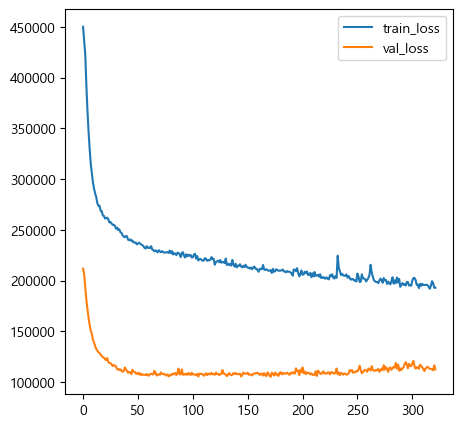

In [1243]:
plt.plot(train_loss_hk1, label = 'train_loss')
plt.plot(val_loss_hk1, label = 'val_loss')
plt.legend()
plt.show()

In [1374]:
y_label_plt = []
y_pred_plt = []
test_r2_hk1, test_mae_hk1 = test(test_loader_hk1, model_hk1, isEDR=isEDR)
y_label_hk1 = y_label_plt
y_pred_hk1 = y_pred_plt

y_label :  1393.0333251953125 y_pred :  1575.7044677734375
y_label :  1355.5555419921875 y_pred :  1582.189208984375
y_label :  1758.755615234375 y_pred :  1496.3294677734375
y_label :  2251.755615234375 y_pred :  3038.637939453125
y_label :  2202.522216796875 y_pred :  1517.115478515625
y_label :  1494.5888671875 y_pred :  1478.6541748046875
y_label :  1038.177734375 y_pred :  1461.1558837890625
y_label :  489.1555480957031 y_pred :  1563.5050048828125
y_label :  307.5888977050781 y_pred :  1031.8265380859375
y_label :  279.3888854980469 y_pred :  1935.405517578125
y_label :  1166.844482421875 y_pred :  1475.571533203125
y_label :  741.9055786132812 y_pred :  1505.4222412109375
y_label :  662.1166381835938 y_pred :  1959.829833984375
y_label :  1486.611083984375 y_pred :  1858.53369140625
y_label :  1089.4888916015625 y_pred :  1695.9366455078125
y_label :  651.7666625976562 y_pred :  1199.77880859375
y_label :  320.98333740234375 y_pred :  1261.239501953125
y_label :  1276.2667236328

xlim is (-228.106396484375, 4790.234326171875)
ylim is (-226.8041624069214, 4319.352979087829)


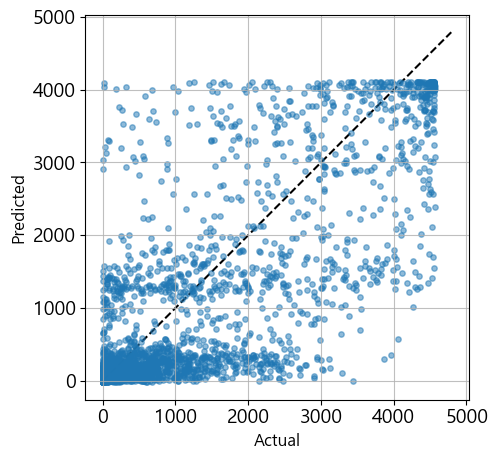

In [1245]:
plot_scatter(y_label_hk1,y_pred_hk1)

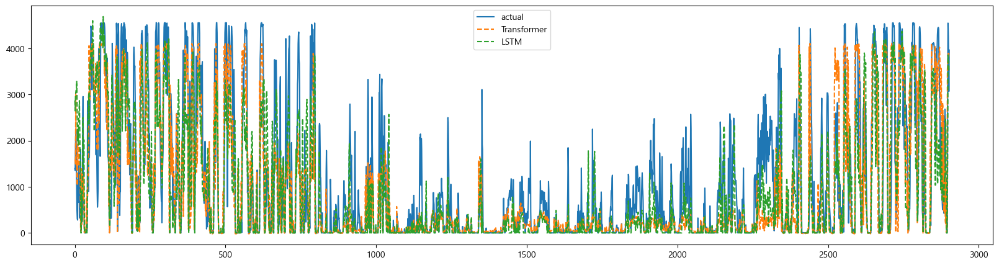

In [1246]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk1[_start:_end],label = 'actual')
plt.plot(y_pred_hk1[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk1[_start:_end], '--',label = 'LSTM')

plt.legend()

In [353]:
#hk2_multi_15
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_15_m.parameters(), lr=lr)
train_loss_hk2_15_m, val_loss_hk2_15_m = trainer(train_loader_hk2_15_m, valid_loader_hk2_15_m, model_hk2_15_m, criterion, optimizer, target='hk2', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk2_15_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.746044360242961
MAE Loss:  3743.640446410175
Validation
R2 score: -0.7091791463880999
MAE Loss:  3476.6722979492424
최신화
Epoch 1/1000
TRAIN
R2 score: -0.744867792781895
MAE Loss:  3741.428752643216
Validation
R2 score: -0.7085383249777433
MAE Loss:  3475.480219229324
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7442403579669288
MAE Loss:  3740.155678937494
Validation
R2 score: -0.7078550241424333
MAE Loss:  3474.2209830586285
최신화
Epoch 3/1000
TRAIN
R2 score: -0.743548498049204
MAE Loss:  3738.760520492694
Validation
R2 score: -0.7071065569923158
MAE Loss:  3472.850654347672
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7427976423763314
MAE Loss:  3737.2624632603433
Validation
R2 score: -0.7062894141860716
MAE Loss:  3471.360231179217
최신화
Epoch 5/1000
TRAIN
R2 score: -0.741981234800597
MAE Loss:  3735.642194120068
Validation
R2 score: -0.7054051823505505
MAE Loss:  3469.755948251835
최신화
Epoch 6/1000
TRAIN
R2 score: -0.741098575629541
MAE Loss:  3733.901911237406
Validation
R

R2 score: -0.6392526963680802
MAE Loss:  3568.222928047593
Validation
R2 score: -0.5990233043013433
MAE Loss:  3313.7580994044247
최신화
Epoch 56/1000
TRAIN
R2 score: -0.6364177171534273
MAE Loss:  3564.2685659743947
Validation
R2 score: -0.5961225967740427
MAE Loss:  3310.157656214154
최신화
Epoch 57/1000
TRAIN
R2 score: -0.6335555630568348
MAE Loss:  3560.285572781695
Validation
R2 score: -0.5931928687662678
MAE Loss:  3306.5660459658816
최신화
Epoch 58/1000
TRAIN
R2 score: -0.6306659891074158
MAE Loss:  3556.291851949704
Validation
R2 score: -0.5902401868333826
MAE Loss:  3302.9794365970856
최신화
Epoch 59/1000
TRAIN
R2 score: -0.6277606107406153
MAE Loss:  3552.2962289194556
Validation
R2 score: -0.5872662103228279
MAE Loss:  3299.3956707497437
최신화
Epoch 60/1000
TRAIN
R2 score: -0.6248311772148496
MAE Loss:  3548.3066996543803
Validation
R2 score: -0.5842786674496134
MAE Loss:  3295.8137891322917
최신화
Epoch 61/1000
TRAIN
R2 score: -0.6218873512677896
MAE Loss:  3544.307184414782
Validation
R2 s

R2 score: -0.4204006860983891
MAE Loss:  3159.8441290880496
Validation
R2 score: -0.38340471717499836
MAE Loss:  2984.5090762610384
최신화
Epoch 110/1000
TRAIN
R2 score: -0.41565745657057573
MAE Loss:  3144.421273785448
Validation
R2 score: -0.3828066408523849
MAE Loss:  2986.128600756745
Epoch 111/1000
TRAIN
R2 score: -0.4119519836468002
MAE Loss:  3134.8282421060326
Validation
R2 score: -0.3725721951754035
MAE Loss:  2973.5119690987854
최신화
Epoch 112/1000
TRAIN
R2 score: -0.40721590552123255
MAE Loss:  3130.2914834076896
Validation
R2 score: -0.3674599335675246
MAE Loss:  2964.96030311115
최신화
Epoch 113/1000
TRAIN
R2 score: -0.40174069534489965
MAE Loss:  3125.58187867606
Validation
R2 score: -0.37422953451524155
MAE Loss:  2976.7399303090024
Epoch 114/1000
TRAIN
R2 score: -0.3976236927294603
MAE Loss:  3115.280432304411
Validation
R2 score: -0.36350821880286777
MAE Loss:  2960.229486492058
최신화
Epoch 115/1000
TRAIN
R2 score: -0.39389183097573466
MAE Loss:  3106.181435998573
Validation
R2 

R2 score: -0.192292359261389
MAE Loss:  2811.7697502781634
Validation
R2 score: -0.15494274753033754
MAE Loss:  2709.8134286982868
최신화
Epoch 165/1000
TRAIN
R2 score: -0.18698943325050066
MAE Loss:  2813.8419704234066
Validation
R2 score: -0.16137426688990164
MAE Loss:  2706.92380153289
최신화
Epoch 166/1000
TRAIN
R2 score: -0.1796117717558836
MAE Loss:  2809.4591535455684
Validation
R2 score: -0.19428541380741593
MAE Loss:  2763.737309268435
Epoch 167/1000
TRAIN
R2 score: -0.18089533517583933
MAE Loss:  2804.546575726686
Validation
R2 score: -0.145908237598684
MAE Loss:  2691.8088102537963
최신화
Epoch 168/1000
TRAIN
R2 score: -0.17630787574622264
MAE Loss:  2796.9851027117497
Validation
R2 score: -0.14839108837795
MAE Loss:  2691.348010948547
최신화
Epoch 169/1000
TRAIN
R2 score: -0.1705680094897366
MAE Loss:  2789.5627976302467
Validation
R2 score: -0.15472352453465343
MAE Loss:  2704.673080352058
Epoch 170/1000
TRAIN
R2 score: -0.16733729581686574
MAE Loss:  2779.5136635810277
Validation
R2 

R2 score: 0.006584880805456272
MAE Loss:  2546.581062206848
Validation
R2 score: 0.007281565898050735
MAE Loss:  2532.5501310587247
Epoch 219/1000
TRAIN
R2 score: 0.008501138471566194
MAE Loss:  2544.082395418874
Validation
R2 score: 0.020501826124741496
MAE Loss:  2497.458146061866
Epoch 220/1000
TRAIN
R2 score: 0.013074659857546411
MAE Loss:  2531.5081574480923
Validation
R2 score: 0.03019665094292201
MAE Loss:  2500.7179976150874
Epoch 221/1000
TRAIN
R2 score: 0.01151068898413421
MAE Loss:  2536.2273484821585
Validation
R2 score: 0.04633849606320617
MAE Loss:  2497.42026333101
최신화
Epoch 222/1000
TRAIN
R2 score: 0.013001624238095588
MAE Loss:  2551.833229423885
Validation
R2 score: 0.04038171975824356
MAE Loss:  2493.216389932245
최신화
Epoch 223/1000
TRAIN
R2 score: 0.020195257714590076
MAE Loss:  2532.803104191538
Validation
R2 score: 0.007160893446395256
MAE Loss:  2526.4788969669153
Epoch 224/1000
TRAIN
R2 score: 0.023093809968309675
MAE Loss:  2538.131734742014
Validation
R2 score:

R2 score: 0.16869258527868447
MAE Loss:  2321.6393529780016
Validation
R2 score: 0.18996863965004507
MAE Loss:  2327.1532215663683
최신화
Epoch 273/1000
TRAIN
R2 score: 0.16861486887509436
MAE Loss:  2323.043348716969
Validation
R2 score: 0.185191354539606
MAE Loss:  2334.718313053102
Epoch 274/1000
TRAIN
R2 score: 0.1707154195697752
MAE Loss:  2321.116976313077
Validation
R2 score: 0.17718407484335597
MAE Loss:  2333.675127844413
Epoch 275/1000
TRAIN
R2 score: 0.17671129477911207
MAE Loss:  2313.903544588032
Validation
R2 score: 0.18693308302894196
MAE Loss:  2315.662597445541
최신화
Epoch 276/1000
TRAIN
R2 score: 0.17954920391401352
MAE Loss:  2309.3673966274555
Validation
R2 score: 0.18597311953634854
MAE Loss:  2346.6937719826833
Epoch 277/1000
TRAIN
R2 score: 0.1838131805766584
MAE Loss:  2303.6877917093807
Validation
R2 score: 0.18852553183312626
MAE Loss:  2323.008786186837
Epoch 278/1000
TRAIN
R2 score: 0.18482435867308156
MAE Loss:  2297.223491783561
Validation
R2 score: 0.204241556

R2 score: 0.29117305170609853
MAE Loss:  2154.0232530373237
Validation
R2 score: 0.3052276522312021
MAE Loss:  2180.7295307463987
Epoch 328/1000
TRAIN
R2 score: 0.3064216552465605
MAE Loss:  2163.855401380159
Validation
R2 score: 0.2690341643808779
MAE Loss:  2230.8109343270876
Epoch 329/1000
TRAIN
R2 score: 0.29454625817104396
MAE Loss:  2191.237353643356
Validation
R2 score: 0.32656948013573717
MAE Loss:  2167.0349632466346
최신화
Epoch 330/1000
TRAIN
R2 score: 0.2938943530681082
MAE Loss:  2168.2985942359937
Validation
R2 score: 0.3197436676755383
MAE Loss:  2201.805264424589
Epoch 331/1000
TRAIN
R2 score: 0.30049521021949466
MAE Loss:  2150.5398231248787
Validation
R2 score: 0.3077705673051999
MAE Loss:  2179.2991893940894
Epoch 332/1000
TRAIN
R2 score: 0.3184083373031006
MAE Loss:  2123.5786767367917
Validation
R2 score: 0.2966939658740211
MAE Loss:  2199.457002649365
Epoch 333/1000
TRAIN
R2 score: 0.31541174825682383
MAE Loss:  2122.809595924915
Validation
R2 score: 0.32158214418414

R2 score: 0.41558069904079753
MAE Loss:  1984.2742247120575
Validation
R2 score: 0.41577725959591527
MAE Loss:  2038.9599138089088
최신화
Epoch 384/1000
TRAIN
R2 score: 0.42013291445604584
MAE Loss:  1956.2824275169257
Validation
R2 score: 0.4002842031802928
MAE Loss:  2067.5729585566028
Epoch 385/1000
TRAIN
R2 score: 0.42682449879594486
MAE Loss:  1956.29778319335
Validation
R2 score: 0.4143507859300518
MAE Loss:  2032.4234392032345
최신화
Epoch 386/1000
TRAIN
R2 score: 0.4238167065305283
MAE Loss:  1948.9405777565412
Validation
R2 score: 0.40081339842266717
MAE Loss:  2084.3837133420193
Epoch 387/1000
TRAIN
R2 score: 0.41993416156402386
MAE Loss:  1959.0497484077036
Validation
R2 score: 0.40753134678132696
MAE Loss:  2057.9170052351196
Epoch 388/1000
TRAIN
R2 score: 0.4296535126569372
MAE Loss:  1956.9414165283154
Validation
R2 score: 0.39292106383014935
MAE Loss:  2080.3947121695164
Epoch 389/1000
TRAIN
R2 score: 0.42714207096843804
MAE Loss:  1951.3389399227203
Validation
R2 score: 0.418

R2 score: 0.5135361622776418
MAE Loss:  1811.9183995306385
Validation
R2 score: 0.4731077315692176
MAE Loss:  1971.229806934509
Epoch 439/1000
TRAIN
R2 score: 0.5153808312149288
MAE Loss:  1804.5312738601028
Validation
R2 score: 0.4759376388384069
MAE Loss:  1994.1999365395232
Epoch 440/1000
TRAIN
R2 score: 0.5229551837031576
MAE Loss:  1805.0911964324298
Validation
R2 score: 0.4771094946375366
MAE Loss:  1949.8751063984614
Epoch 441/1000
TRAIN
R2 score: 0.5298645125244169
MAE Loss:  1785.984829542533
Validation
R2 score: 0.4571451952381417
MAE Loss:  1997.7885302803172
Epoch 442/1000
TRAIN
R2 score: 0.5171746507474578
MAE Loss:  1799.8804200287896
Validation
R2 score: 0.4915216929273455
MAE Loss:  1962.0215271614072
Epoch 443/1000
TRAIN
R2 score: 0.5215520644802225
MAE Loss:  1831.01983825443
Validation
R2 score: 0.492629320991821
MAE Loss:  1918.9243213199643
최신화
Epoch 444/1000
TRAIN
R2 score: 0.5282751473557847
MAE Loss:  1793.3562797949817
Validation
R2 score: 0.4736095917214125
MA

R2 score: 0.6075390923066253
MAE Loss:  1634.5891278964273
Validation
R2 score: 0.5286780450755509
MAE Loss:  1887.7194773739172
Epoch 495/1000
TRAIN
R2 score: 0.6100165297712995
MAE Loss:  1626.3429568115216
Validation
R2 score: 0.5216488916380371
MAE Loss:  1917.9403856321503
Epoch 496/1000
TRAIN
R2 score: 0.6045949975012734
MAE Loss:  1639.8115056240742
Validation
R2 score: 0.5321256550259587
MAE Loss:  1869.1222670408386
Epoch 497/1000
TRAIN
R2 score: 0.6076489908287609
MAE Loss:  1642.2023539082388
Validation
R2 score: 0.513962147089956
MAE Loss:  1903.9255508406466
Epoch 498/1000
TRAIN
R2 score: 0.6091985398954131
MAE Loss:  1625.4287241648103
Validation
R2 score: 0.5210734093937173
MAE Loss:  1928.0202787218993
Epoch 499/1000
TRAIN
R2 score: 0.6104163796581852
MAE Loss:  1615.780371875246
Validation
R2 score: 0.5381030639006509
MAE Loss:  1891.8469258845826
Epoch 500/1000
TRAIN
R2 score: 0.6113537384497454
MAE Loss:  1637.0294723068776
Validation
R2 score: 0.5359773166536956
MAE

R2 score: 0.6769194261589346
MAE Loss:  1489.1945243928815
Validation
R2 score: 0.5437507178382324
MAE Loss:  1861.3518559048618
Epoch 551/1000
TRAIN
R2 score: 0.6642192387559316
MAE Loss:  1508.8920426723978
Validation
R2 score: 0.5730334552802123
MAE Loss:  1837.5110231850776
Epoch 552/1000
TRAIN
R2 score: 0.666487381339804
MAE Loss:  1539.0050986877282
Validation
R2 score: 0.5630971964300427
MAE Loss:  1822.6439390465935
Epoch 553/1000
TRAIN
R2 score: 0.6663243631882705
MAE Loss:  1503.2496201015013
Validation
R2 score: 0.5508707445448879
MAE Loss:  1865.1871974668773
Epoch 554/1000
TRAIN
R2 score: 0.6705597864625696
MAE Loss:  1507.8985842561892
Validation
R2 score: 0.5739221631122963
MAE Loss:  1808.4387068562773
Epoch 555/1000
TRAIN
R2 score: 0.6735934598009378
MAE Loss:  1496.8665663044585
Validation
R2 score: 0.5241693936667715
MAE Loss:  1872.0978780550893
Epoch 556/1000
TRAIN
R2 score: 0.6745692806237843
MAE Loss:  1515.3048580587308
Validation
R2 score: 0.5233704084126363
MA

R2 score: 0.7323535316481796
MAE Loss:  1344.066809675606
Validation
R2 score: 0.575640184575624
MAE Loss:  1811.4108333749093
Epoch 607/1000
TRAIN
R2 score: 0.7267416064577754
MAE Loss:  1361.5439356557824
Validation
R2 score: 0.5916912343792349
MAE Loss:  1755.1055831356475
Epoch 608/1000
TRAIN
R2 score: 0.7382352189284287
MAE Loss:  1334.0458184349466
Validation
R2 score: 0.557973202210488
MAE Loss:  1826.9659573685653
Epoch 609/1000
TRAIN
R2 score: 0.7354895430197466
MAE Loss:  1337.412312580748
Validation
R2 score: 0.5740268038120954
MAE Loss:  1789.135398822596
Epoch 610/1000
TRAIN
R2 score: 0.7389229670273958
MAE Loss:  1328.4671032434292
Validation
R2 score: 0.5597070455955933
MAE Loss:  1849.0944065354345
Epoch 611/1000
TRAIN
R2 score: 0.7337988336600714
MAE Loss:  1350.4248633749871
Validation
R2 score: 0.5743447519547055
MAE Loss:  1805.3709338907674
Epoch 612/1000
TRAIN
R2 score: 0.7241768950689373
MAE Loss:  1359.2699564853012
Validation
R2 score: 0.5577349089623479
MAE Lo

R2 score: 0.7863119647666396
MAE Loss:  1191.4634771435437
Validation
R2 score: 0.5757604716582483
MAE Loss:  1780.6979501354201
Epoch 663/1000
TRAIN
R2 score: 0.7841715245684258
MAE Loss:  1198.9346956246557
Validation
R2 score: 0.5824757807099021
MAE Loss:  1770.6488338542827
Epoch 664/1000
TRAIN
R2 score: 0.7847780035373557
MAE Loss:  1203.213188020405
Validation
R2 score: 0.5755962268233332
MAE Loss:  1790.4726911837613
Epoch 665/1000
TRAIN
R2 score: 0.7859121611468415
MAE Loss:  1189.4295018935447
Validation
R2 score: 0.5708839172552305
MAE Loss:  1774.1632461134539
Epoch 666/1000
TRAIN
R2 score: 0.7881464104048753
MAE Loss:  1194.443491973688
Validation
R2 score: 0.5484180438272849
MAE Loss:  1826.3381137001677
Epoch 667/1000
TRAIN
R2 score: 0.7874146640891176
MAE Loss:  1192.0014694508286
Validation
R2 score: 0.5661911162604675
MAE Loss:  1799.4403880726863
Epoch 668/1000
TRAIN
R2 score: 0.7891579414135959
MAE Loss:  1191.2033989904078
Validation
R2 score: 0.5723871320388454
MAE

R2 score: 0.8146557412115423
MAE Loss:  1098.4093629656854
Validation
R2 score: 0.5898751292030084
MAE Loss:  1756.656599697089
Epoch 718/1000
TRAIN
R2 score: 0.8155558720442934
MAE Loss:  1121.168974099084
Validation
R2 score: 0.5649339834151721
MAE Loss:  1806.4013872628386
Epoch 719/1000
TRAIN
R2 score: 0.8192505826943869
MAE Loss:  1103.3982673426458
Validation
R2 score: 0.526943555544069
MAE Loss:  1841.3292942062214
Epoch 720/1000
TRAIN
R2 score: 0.8124807316086466
MAE Loss:  1125.2260023267015
Validation
R2 score: 0.5534116311523847
MAE Loss:  1794.6745634105537
Epoch 721/1000
TRAIN
R2 score: 0.8232502968697095
MAE Loss:  1075.3507371204207
Validation
R2 score: 0.5586640178908053
MAE Loss:  1828.4638875241617
Epoch 722/1000
TRAIN
R2 score: 0.8212780377558162
MAE Loss:  1099.3712106436558
Validation
R2 score: 0.5761465372646082
MAE Loss:  1760.1426397123332
Epoch 723/1000
TRAIN
R2 score: 0.8233362557975848
MAE Loss:  1083.5279464165462
Validation
R2 score: 0.5229706759570667
MAE 

R2 score: 0.8552576675964536
MAE Loss:  979.1682712234907
Validation
R2 score: 0.5679085787767273
MAE Loss:  1769.771970540321
Epoch 774/1000
TRAIN
R2 score: 0.8592862108483379
MAE Loss:  965.8375030779313
Validation
R2 score: 0.5690342227591667
MAE Loss:  1771.6962279297852
Epoch 775/1000
TRAIN
R2 score: 0.8632519621188615
MAE Loss:  950.9166410978269
Validation
R2 score: 0.5825835106604738
MAE Loss:  1747.8661246668537
Epoch 776/1000
TRAIN
R2 score: 0.8615188735814624
MAE Loss:  958.8237552841994
Validation
R2 score: 0.5348835243589707
MAE Loss:  1818.6897485091167
Epoch 777/1000
TRAIN
R2 score: 0.8597911244979655
MAE Loss:  960.5115347060665
Validation
R2 score: 0.5778173953779211
MAE Loss:  1730.1378284920734
Epoch 778/1000
TRAIN
R2 score: 0.8625726743728219
MAE Loss:  950.2135091855533
Validation
R2 score: 0.5680581238883968
MAE Loss:  1770.5396832481877
Epoch 779/1000
TRAIN
R2 score: 0.8646025345884367
MAE Loss:  940.8660067902866
Validation
R2 score: 0.5867729639722409
MAE Loss:

R2 score: 0.8882457017399497
MAE Loss:  864.8568345564332
Validation
R2 score: 0.5190680014767284
MAE Loss:  1838.3365635292573
Epoch 830/1000
TRAIN
R2 score: 0.8828970554544845
MAE Loss:  887.3760996486174
Validation
R2 score: 0.541203691693132
MAE Loss:  1798.1400109624624
Epoch 831/1000
TRAIN
R2 score: 0.8873743475569977
MAE Loss:  866.7620373768987
Validation
R2 score: 0.5687143035689138
MAE Loss:  1753.3873306573573
Epoch 832/1000
TRAIN
R2 score: 0.8861885823563228
MAE Loss:  863.1643022535328
Validation
R2 score: 0.563355641051096
MAE Loss:  1767.4897527169426
Epoch 833/1000
TRAIN
R2 score: 0.8926033903068304
MAE Loss:  848.9887059335786
Validation
R2 score: 0.5360430758164417
MAE Loss:  1796.0500560872983
Epoch 834/1000
TRAIN
R2 score: 0.8897144359089284
MAE Loss:  861.7531898752819
Validation
R2 score: 0.5392322652942259
MAE Loss:  1810.7952299968258
Epoch 835/1000
TRAIN
R2 score: 0.8903831897907689
MAE Loss:  861.0434643781388
Validation
R2 score: 0.5536511633427571
MAE Loss: 

R2 score: 0.8976667978976898
MAE Loss:  812.3445230001284
Validation
R2 score: 0.5611873722293242
MAE Loss:  1754.6475086973744
Epoch 886/1000
TRAIN
R2 score: 0.9005054942228139
MAE Loss:  829.5192969039543
Validation
R2 score: 0.560471957904189
MAE Loss:  1755.0094232431838
Epoch 887/1000
TRAIN
R2 score: 0.8998957908378943
MAE Loss:  828.3996269577124
Validation
R2 score: 0.5242485688308373
MAE Loss:  1814.7035783469053
Epoch 888/1000
TRAIN
R2 score: 0.8913518911058458
MAE Loss:  844.6828747381389
Validation
R2 score: 0.5543734052799258
MAE Loss:  1739.010607333337
Epoch 889/1000
TRAIN
R2 score: 0.9054446570002941
MAE Loss:  791.8856370453351
Validation
R2 score: 0.544287028170504
MAE Loss:  1801.9247177585826
Epoch 890/1000
TRAIN
R2 score: 0.8985705284207547
MAE Loss:  820.4902155884516
Validation
R2 score: 0.5707123004791022
MAE Loss:  1742.8570046403731
Epoch 891/1000
TRAIN
R2 score: 0.9008518430338718
MAE Loss:  827.3141625985309
Validation
R2 score: 0.5482563516796948
MAE Loss:  

R2 score: 0.9186934325414716
MAE Loss:  733.8452098594596
Validation
R2 score: 0.5606619306902163
MAE Loss:  1732.8733396779203
Epoch 942/1000
TRAIN
R2 score: 0.9241393602081206
MAE Loss:  719.2137057036964
Validation
R2 score: 0.5477194270259107
MAE Loss:  1770.5277448323104
Epoch 943/1000
TRAIN
R2 score: 0.9145062089762942
MAE Loss:  753.434749796575
Validation
R2 score: 0.5768411236639835
MAE Loss:  1713.2340811243905
Epoch 944/1000
TRAIN
R2 score: 0.917189081705839
MAE Loss:  738.5041400147738
Validation
R2 score: 0.5506468913697284
MAE Loss:  1765.0066073949674
Epoch 945/1000
TRAIN
R2 score: 0.9075412908213498
MAE Loss:  771.6438620293986
Validation
R2 score: 0.5670429131140752
MAE Loss:  1723.703805086556
Epoch 946/1000
TRAIN
R2 score: 0.9192268862833566
MAE Loss:  731.412665638785
Validation
R2 score: 0.5485258623181348
MAE Loss:  1759.0510307816062
Epoch 947/1000
TRAIN
R2 score: 0.9169470091442831
MAE Loss:  732.0788589353257
Validation
R2 score: 0.5707881330795952
MAE Loss:  1

R2 score: 0.93188966409884
MAE Loss:  658.8612153575338
Validation
R2 score: 0.5772503901615358
MAE Loss:  1710.21595090533
Epoch 998/1000
TRAIN
R2 score: 0.9264910815266921
MAE Loss:  691.2717978763387
Validation
R2 score: 0.5740316102851057
MAE Loss:  1699.7852566825318
Epoch 999/1000
TRAIN
R2 score: 0.9341247609627702
MAE Loss:  660.1562927289591
Validation
R2 score: 0.5578644918039513
MAE Loss:  1731.3653482501804


<All keys matched successfully>

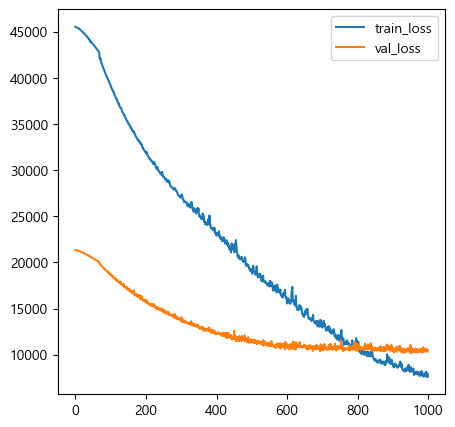

In [354]:
plt.plot(train_loss_hk2_15_m, label = 'train_loss')
plt.plot(val_loss_hk2_15_m, label = 'val_loss')
plt.legend()
plt.show()

In [355]:
val_r2_hk2_15_m, val_mae_hk2_15_m = test(valid_loader_hk2_15_m, model_hk2_15_m,isEDR=isEDR)

y_label :  78.68499755859375 y_pred :  0.0
y_label :  97.16200256347656 y_pred :  1214.2589111328125
y_label :  576.7506713867188 y_pred :  1557.787353515625
y_label :  626.6963500976562 y_pred :  1018.91357421875
y_label :  202.98033142089844 y_pred :  0.0
y_label :  38.042999267578125 y_pred :  0.0
y_label :  0.8703333139419556 y_pred :  0.0
y_label :  48.599666595458984 y_pred :  0.0
y_label :  2.6453332901000977 y_pred :  1927.081298828125
y_label :  299.00299072265625 y_pred :  4879.77294921875
y_label :  1468.411376953125 y_pred :  5644.14794921875
y_label :  3172.561279296875 y_pred :  4208.65234375
y_label :  3313.206298828125 y_pred :  4001.481689453125
y_label :  4542.36083984375 y_pred :  2514.02099609375
y_label :  6785.12890625 y_pred :  2423.456298828125
y_label :  4274.16552734375 y_pred :  3328.318359375
y_label :  5513.5419921875 y_pred :  10553.984375
y_label :  4897.48291015625 y_pred :  3434.54638671875
y_label :  8662.6064453125 y_pred :  2585.169921875
y_label :  

In [356]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_15_m, test_mae_hk2_15_m = test(test_loader_hk2_15_m, model_hk2_15_m, isEDR=isEDR)
y_label_hk2_15_m = y_label_plt
y_pred_hk2_15_m = y_pred_plt

y_label :  2560.76806640625 y_pred :  3154.425048828125
y_label :  2443.97705078125 y_pred :  3646.255859375
y_label :  3146.77734375 y_pred :  4305.5205078125
y_label :  4039.077392578125 y_pred :  2523.506103515625
y_label :  4202.15283203125 y_pred :  4603.2548828125
y_label :  2595.485595703125 y_pred :  1086.4105224609375
y_label :  1598.398681640625 y_pred :  346.01483154296875
y_label :  815.8056640625 y_pred :  445.0718994140625
y_label :  614.3186645507812 y_pred :  285.0082092285156
y_label :  422.0606689453125 y_pred :  149.2886505126953
y_label :  1092.855712890625 y_pred :  407.0445251464844
y_label :  1295.65966796875 y_pred :  846.0350341796875
y_label :  1305.4940185546875 y_pred :  842.805908203125
y_label :  2220.09912109375 y_pred :  800.6668701171875
y_label :  1574.2213134765625 y_pred :  1183.298095703125
y_label :  1022.1356811523438 y_pred :  607.2308349609375
y_label :  746.5416870117188 y_pred :  221.99090576171875
y_label :  2212.597900390625 y_pred :  315.24

xlim is (-739.682421875, 15533.330859375)
ylim is (-642.70537109375, 13496.81279296875)


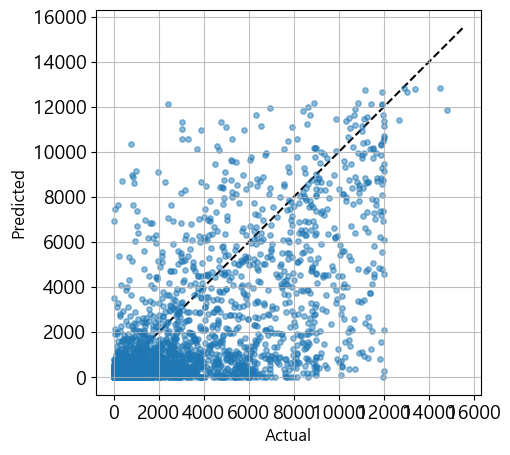

In [357]:
plot_scatter(y_label_hk2_15_m,y_pred_hk2_15_m)

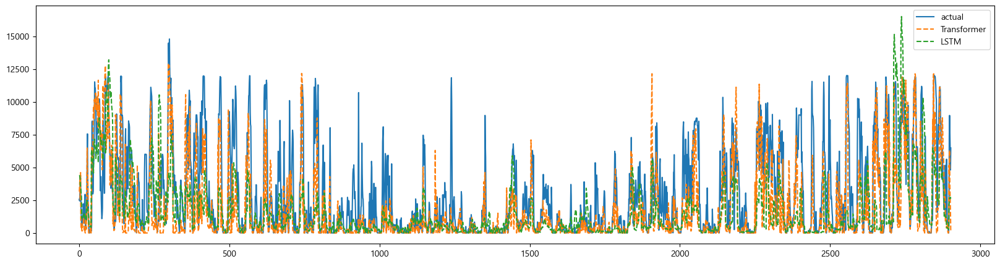

In [358]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_15_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_15_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_15_m_re[_start:_end], '--',label = 'LSTM')
plt.legend()

In [359]:
#hk2_multi_23
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_23_m.parameters(), lr=lr)
train_loss_hk2_23_m, val_loss_hk2_23_m = trainer(train_loader_hk2_23_m, valid_loader_hk2_23_m, model_hk2_23_m, criterion, optimizer, target='hk2', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk2_23_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7436052026157347
MAE Loss:  3735.713695498594
Validation
R2 score: -0.7118881334695455
MAE Loss:  3485.2079450586252
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7424684763017015
MAE Loss:  3733.578856398476
Validation
R2 score: -0.711232102853822
MAE Loss:  3483.993546558113
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7418241624761606
MAE Loss:  3732.2740373445044
Validation
R2 score: -0.7105344494615484
MAE Loss:  3482.714158328404
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7411183700929509
MAE Loss:  3730.8574079531727
Validation
R2 score: -0.7097757948942685
MAE Loss:  3481.329999119418
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7403617813093419
MAE Loss:  3729.34888808247
Validation
R2 score: -0.7089500266706807
MAE Loss:  3479.828825511844
최신화
Epoch 5/1000
TRAIN
R2 score: -0.7395402662503152
MAE Loss:  3727.722986059716
Validation
R2 score: -0.7080603210523058
MAE Loss:  3478.220875139043
최신화
Epoch 6/1000
TRAIN
R2 score: -0.7386546792782109
MAE Loss:  3725.980103847267
Validatio

R2 score: -0.6288869089285598
MAE Loss:  3505.094927137261
Validation
R2 score: -0.5938181734063674
MAE Loss:  3286.531279233969
최신화
Epoch 55/1000
TRAIN
R2 score: -0.6254354460389593
MAE Loss:  3500.2174016384006
Validation
R2 score: -0.5903157462553354
MAE Loss:  3282.143170388795
최신화
Epoch 56/1000
TRAIN
R2 score: -0.6219095680323656
MAE Loss:  3494.1901377709787
Validation
R2 score: -0.5870085652909407
MAE Loss:  3277.7344074649764
최신화
Epoch 57/1000
TRAIN
R2 score: -0.6182908232253095
MAE Loss:  3484.95585362008
Validation
R2 score: -0.5836936768520844
MAE Loss:  3273.223200297127
최신화
Epoch 58/1000
TRAIN
R2 score: -0.6146611564674649
MAE Loss:  3477.705357501887
Validation
R2 score: -0.5799106268564507
MAE Loss:  3267.92734504235
최신화
Epoch 59/1000
TRAIN
R2 score: -0.6110750407619618
MAE Loss:  3471.5354541883853
Validation
R2 score: -0.5758470923413817
MAE Loss:  3260.1135286396784
최신화
Epoch 60/1000
TRAIN
R2 score: -0.6075940656853596
MAE Loss:  3465.4993660521177
Validation
R2 score

R2 score: -0.4121080156565706
MAE Loss:  3132.1830871989955
Validation
R2 score: -0.38793922364701494
MAE Loss:  2997.6815101234884
Epoch 109/1000
TRAIN
R2 score: -0.4080401979309862
MAE Loss:  3125.0459334405073
Validation
R2 score: -0.38131691147229585
MAE Loss:  2991.0708061570235
최신화
Epoch 110/1000
TRAIN
R2 score: -0.40493030333396796
MAE Loss:  3119.148305475978
Validation
R2 score: -0.3683338574798576
MAE Loss:  2974.1335642471468
최신화
Epoch 111/1000
TRAIN
R2 score: -0.39901026819835406
MAE Loss:  3114.7531594234483
Validation
R2 score: -0.3739240530265153
MAE Loss:  2980.388865789624
Epoch 112/1000
TRAIN
R2 score: -0.39553442740666545
MAE Loss:  3104.1772666770794
Validation
R2 score: -0.3674593284767036
MAE Loss:  2974.531124922552
최신화
Epoch 113/1000
TRAIN
R2 score: -0.3919510696578472
MAE Loss:  3097.7420241143927
Validation
R2 score: -0.36236614017789104
MAE Loss:  2965.8755626221428
최신화
Epoch 114/1000
TRAIN
R2 score: -0.3862515437115397
MAE Loss:  3091.9280193905856
Validatio

R2 score: -0.1865106391272957
MAE Loss:  2803.1346955857275
Validation
R2 score: -0.17669643917592448
MAE Loss:  2730.8920986844028
Epoch 164/1000
TRAIN
R2 score: -0.18646454844200266
MAE Loss:  2802.4613645753852
Validation
R2 score: -0.16687052711033812
MAE Loss:  2726.2426492297154
최신화
Epoch 165/1000
TRAIN
R2 score: -0.1813798907726356
MAE Loss:  2795.3705283565046
Validation
R2 score: -0.15952636159335554
MAE Loss:  2719.4044143390424
최신화
Epoch 166/1000
TRAIN
R2 score: -0.1753297367215625
MAE Loss:  2785.3240449722957
Validation
R2 score: -0.16936381469085937
MAE Loss:  2730.7459056601083
Epoch 167/1000
TRAIN
R2 score: -0.17237871751178613
MAE Loss:  2777.391547255997
Validation
R2 score: -0.16551911754078596
MAE Loss:  2730.7491454924134
Epoch 168/1000
TRAIN
R2 score: -0.16907778418320984
MAE Loss:  2773.910045453229
Validation
R2 score: -0.1573853808552741
MAE Loss:  2718.12649586004
최신화
Epoch 169/1000
TRAIN
R2 score: -0.1637385255806243
MAE Loss:  2771.733079524116
Validation
R2

R2 score: -0.0030891535001047465
MAE Loss:  2563.325635805937
Validation
R2 score: 0.002602443987925862
MAE Loss:  2527.727929585549
최신화
Epoch 217/1000
TRAIN
R2 score: 0.0017971578062213611
MAE Loss:  2555.4581011485857
Validation
R2 score: -0.0009103992724528442
MAE Loss:  2547.739375585095
Epoch 218/1000
TRAIN
R2 score: -0.000964331915103811
MAE Loss:  2550.9024734849345
Validation
R2 score: 0.01136590394075776
MAE Loss:  2521.897555533309
최신화
Epoch 219/1000
TRAIN
R2 score: 0.006593852506933229
MAE Loss:  2537.5900968355754
Validation
R2 score: -0.01930234565858191
MAE Loss:  2565.2938756783833
Epoch 220/1000
TRAIN
R2 score: 0.013369302623233104
MAE Loss:  2527.9586849207117
Validation
R2 score: 0.0047717546048196
MAE Loss:  2535.2119539335276
Epoch 221/1000
TRAIN
R2 score: 0.013884722348571965
MAE Loss:  2525.955589314282
Validation
R2 score: 0.02669916548038176
MAE Loss:  2512.9492913489858
최신화
Epoch 222/1000
TRAIN
R2 score: 0.01763771502155942
MAE Loss:  2526.873335415229
Validati

R2 score: 0.16600913476983992
MAE Loss:  2323.2020467250636
Validation
R2 score: 0.15451477592128038
MAE Loss:  2372.5401380246367
Epoch 272/1000
TRAIN
R2 score: 0.17233730830215876
MAE Loss:  2310.3956967217446
Validation
R2 score: 0.1469847829364921
MAE Loss:  2377.797096175632
Epoch 273/1000
TRAIN
R2 score: 0.1743543408029834
MAE Loss:  2306.9458819086663
Validation
R2 score: 0.1709997044881928
MAE Loss:  2362.9434543582393
최신화
Epoch 274/1000
TRAIN
R2 score: 0.1728843992767024
MAE Loss:  2306.240854922189
Validation
R2 score: 0.15830713929643603
MAE Loss:  2368.411449705802
Epoch 275/1000
TRAIN
R2 score: 0.17999862189702243
MAE Loss:  2302.1087126654916
Validation
R2 score: 0.14255417335736875
MAE Loss:  2395.1130973465547
Epoch 276/1000
TRAIN
R2 score: 0.18056014407196075
MAE Loss:  2299.374179023607
Validation
R2 score: 0.17912329600714072
MAE Loss:  2346.5918075683226
최신화
Epoch 277/1000
TRAIN
R2 score: 0.1827911371425005
MAE Loss:  2294.1488589780834
Validation
R2 score: 0.164748

R2 score: 0.3098160637942564
MAE Loss:  2125.420721865073
Validation
R2 score: 0.2744554983610642
MAE Loss:  2236.7718125455667
Epoch 327/1000
TRAIN
R2 score: 0.30891101019213507
MAE Loss:  2121.691956358692
Validation
R2 score: 0.2757768848161847
MAE Loss:  2224.961390794386
Epoch 328/1000
TRAIN
R2 score: 0.3160468726343858
MAE Loss:  2103.0716997720388
Validation
R2 score: 0.28745140662446533
MAE Loss:  2244.790636853959
Epoch 329/1000
TRAIN
R2 score: 0.3142572512484645
MAE Loss:  2104.92303417923
Validation
R2 score: 0.292793263029705
MAE Loss:  2217.505174010207
Epoch 330/1000
TRAIN
R2 score: 0.3199782650052684
MAE Loss:  2089.857169907666
Validation
R2 score: 0.2848457552399485
MAE Loss:  2227.9138118903365
Epoch 331/1000
TRAIN
R2 score: 0.3216602430870922
MAE Loss:  2090.2232935232746
Validation
R2 score: 0.29368382066206034
MAE Loss:  2214.868059144979
최신화
Epoch 332/1000
TRAIN
R2 score: 0.3229929447164339
MAE Loss:  2095.348989543251
Validation
R2 score: 0.27838273663482827
MAE 

R2 score: 0.42840059075265635
MAE Loss:  1948.8849588945243
Validation
R2 score: 0.3834229496576771
MAE Loss:  2092.3172886590564
Epoch 383/1000
TRAIN
R2 score: 0.4268133706534143
MAE Loss:  1951.151409630569
Validation
R2 score: 0.35653089033493035
MAE Loss:  2127.9997083687945
Epoch 384/1000
TRAIN
R2 score: 0.4279151021492633
MAE Loss:  1955.8249661867496
Validation
R2 score: 0.3957263050311265
MAE Loss:  2072.242508384104
최신화
Epoch 385/1000
TRAIN
R2 score: 0.4348025322673741
MAE Loss:  1934.515331149567
Validation
R2 score: 0.3985564857437418
MAE Loss:  2070.222104873739
최신화
Epoch 386/1000
TRAIN
R2 score: 0.4387818050224782
MAE Loss:  1925.8662112389566
Validation
R2 score: 0.3968664834677996
MAE Loss:  2094.055776637402
Epoch 387/1000
TRAIN
R2 score: 0.4389137142087739
MAE Loss:  1915.3717781708074
Validation
R2 score: 0.40242935937510416
MAE Loss:  2063.71632101766
최신화
Epoch 388/1000
TRAIN
R2 score: 0.44593780760537927
MAE Loss:  1910.2371144915728
Validation
R2 score: 0.403509833

R2 score: 0.5282617260791291
MAE Loss:  1748.4567639229913
Validation
R2 score: 0.47790425007926196
MAE Loss:  1983.5475449508247
Epoch 438/1000
TRAIN
R2 score: 0.5295441977083508
MAE Loss:  1781.4969995464264
Validation
R2 score: 0.4630650396506306
MAE Loss:  1978.052178331679
Epoch 439/1000
TRAIN
R2 score: 0.533622302162654
MAE Loss:  1773.0105159418915
Validation
R2 score: 0.43538099652815065
MAE Loss:  2014.4590354682032
Epoch 440/1000
TRAIN
R2 score: 0.5294501557723054
MAE Loss:  1773.7441277498212
Validation
R2 score: 0.4657451079084691
MAE Loss:  1977.647458540871
Epoch 441/1000
TRAIN
R2 score: 0.537721770353152
MAE Loss:  1752.7327778482238
Validation
R2 score: 0.49392482264054316
MAE Loss:  1951.1041906816479
최신화
Epoch 442/1000
TRAIN
R2 score: 0.5257458761898164
MAE Loss:  1770.8841602226353
Validation
R2 score: 0.4874219063588139
MAE Loss:  1967.8064510949089
Epoch 443/1000
TRAIN
R2 score: 0.5331764702696684
MAE Loss:  1790.442146164175
Validation
R2 score: 0.4754937708993113

R2 score: 0.6105939305172987
MAE Loss:  1628.3878500462813
Validation
R2 score: 0.535523998037845
MAE Loss:  1857.3976643095896
최신화
Epoch 493/1000
TRAIN
R2 score: 0.6168484261499098
MAE Loss:  1587.5898600692906
Validation
R2 score: 0.4982170764793069
MAE Loss:  1937.2049357452413
Epoch 494/1000
TRAIN
R2 score: 0.621977705859635
MAE Loss:  1595.6535409479245
Validation
R2 score: 0.5233350471739053
MAE Loss:  1880.8916577564362
Epoch 495/1000
TRAIN
R2 score: 0.6108658421499575
MAE Loss:  1594.8443558650517
Validation
R2 score: 0.5449417905320202
MAE Loss:  1880.0948061355577
Epoch 496/1000
TRAIN
R2 score: 0.6158837905262721
MAE Loss:  1605.6239915408128
Validation
R2 score: 0.5403208574039942
MAE Loss:  1883.3055405101736
Epoch 497/1000
TRAIN
R2 score: 0.62123761025014
MAE Loss:  1584.4091157729601
Validation
R2 score: 0.5297013055881508
MAE Loss:  1864.4788113304314
Epoch 498/1000
TRAIN
R2 score: 0.6096124717469533
MAE Loss:  1651.4179871607053
Validation
R2 score: 0.4821630731129969
M

R2 score: 0.6898068044846237
MAE Loss:  1429.8449912328138
Validation
R2 score: 0.5522313508365617
MAE Loss:  1854.9560464459007
Epoch 549/1000
TRAIN
R2 score: 0.6818272783651183
MAE Loss:  1469.1298402462862
Validation
R2 score: 0.5545856488961063
MAE Loss:  1827.6380615978767
Epoch 550/1000
TRAIN
R2 score: 0.6828581325961465
MAE Loss:  1448.778179577559
Validation
R2 score: 0.5477699109931394
MAE Loss:  1843.6023949680814
Epoch 551/1000
TRAIN
R2 score: 0.691807650330168
MAE Loss:  1431.9151332487422
Validation
R2 score: 0.5539182792863067
MAE Loss:  1852.8855436901117
Epoch 552/1000
TRAIN
R2 score: 0.687490211428881
MAE Loss:  1425.2753719347595
Validation
R2 score: 0.5693274458512956
MAE Loss:  1842.3515146421244
Epoch 553/1000
TRAIN
R2 score: 0.6986720753609832
MAE Loss:  1428.2990879499077
Validation
R2 score: 0.5570271197538055
MAE Loss:  1838.7575319840755
Epoch 554/1000
TRAIN
R2 score: 0.7013871699223645
MAE Loss:  1408.3366869702356
Validation
R2 score: 0.529141038489612
MAE L

R2 score: 0.7335054617655634
MAE Loss:  1346.4451729093996
Validation
R2 score: 0.5332199936598897
MAE Loss:  1838.8078661609604
Epoch 605/1000
TRAIN
R2 score: 0.7313841347849284
MAE Loss:  1331.8387959497722
Validation
R2 score: 0.5564092708504218
MAE Loss:  1817.2258268717226
Epoch 606/1000
TRAIN
R2 score: 0.7485166245260138
MAE Loss:  1281.1613783953317
Validation
R2 score: 0.5943439300419822
MAE Loss:  1754.7995333501776
최신화
Epoch 607/1000
TRAIN
R2 score: 0.7564083771574434
MAE Loss:  1261.5999796764231
Validation
R2 score: 0.5705387550470752
MAE Loss:  1802.1929557977946
Epoch 608/1000
TRAIN
R2 score: 0.7560978735516374
MAE Loss:  1256.8523123101004
Validation
R2 score: 0.5912805612127661
MAE Loss:  1766.031217648363
Epoch 609/1000
TRAIN
R2 score: 0.7527512763835923
MAE Loss:  1270.1702734941355
Validation
R2 score: 0.5530252972334766
MAE Loss:  1822.0939614019478
Epoch 610/1000
TRAIN
R2 score: 0.754267948436673
MAE Loss:  1274.745351314058
Validation
R2 score: 0.5452282619068555


R2 score: 0.7919932804796668
MAE Loss:  1172.2732500422892
Validation
R2 score: 0.5283986873764981
MAE Loss:  1842.1495189060183
Epoch 661/1000
TRAIN
R2 score: 0.7847481022252516
MAE Loss:  1177.1717135725225
Validation
R2 score: 0.5819605266045963
MAE Loss:  1787.262043813141
Epoch 662/1000
TRAIN
R2 score: 0.7973287575700666
MAE Loss:  1145.6866177347185
Validation
R2 score: 0.5935223785000808
MAE Loss:  1764.397318583931
Epoch 663/1000
TRAIN
R2 score: 0.8042415278720857
MAE Loss:  1131.3226848212294
Validation
R2 score: 0.5660709315370049
MAE Loss:  1799.4359833654323
Epoch 664/1000
TRAIN
R2 score: 0.7994522836142852
MAE Loss:  1146.461208304127
Validation
R2 score: 0.5388339716737305
MAE Loss:  1835.6394667380102
Epoch 665/1000
TRAIN
R2 score: 0.8030459051341883
MAE Loss:  1134.8582627505584
Validation
R2 score: 0.5605227728080062
MAE Loss:  1805.084565419401
Epoch 666/1000
TRAIN
R2 score: 0.7990634350307966
MAE Loss:  1143.4589313615609
Validation
R2 score: 0.5606071239771135
MAE L

R2 score: 0.8360887442886478
MAE Loss:  1018.527029131899
Validation
R2 score: 0.5604417703870943
MAE Loss:  1790.2056228939814
Epoch 717/1000
TRAIN
R2 score: 0.8372885030448801
MAE Loss:  1027.649678495977
Validation
R2 score: 0.530857633497131
MAE Loss:  1844.8529295877966
Epoch 718/1000
TRAIN
R2 score: 0.8296724262231407
MAE Loss:  1045.6026927740693
Validation
R2 score: 0.5676658718390118
MAE Loss:  1793.6541172823208
Epoch 719/1000
TRAIN
R2 score: 0.838759705489434
MAE Loss:  1016.1371332142368
Validation
R2 score: 0.5438945837957067
MAE Loss:  1856.3424024068322
Epoch 720/1000
TRAIN
R2 score: 0.8312926404341444
MAE Loss:  1045.5331640429683
Validation
R2 score: 0.5717350381154394
MAE Loss:  1786.1831753029546
Epoch 721/1000
TRAIN
R2 score: 0.8336261063124601
MAE Loss:  1024.2694197756311
Validation
R2 score: 0.561357550775643
MAE Loss:  1788.6132013784984
Epoch 722/1000
TRAIN
R2 score: 0.8375620947712957
MAE Loss:  1026.025729141554
Validation
R2 score: 0.5374859736190094
MAE Los

R2 score: 0.8638388955551315
MAE Loss:  931.1389773990456
Validation
R2 score: 0.5564340023921768
MAE Loss:  1800.463016507439
Epoch 773/1000
TRAIN
R2 score: 0.8746478942386998
MAE Loss:  900.9530076990224
Validation
R2 score: 0.5351460997740101
MAE Loss:  1834.7345310353696
Epoch 774/1000
TRAIN
R2 score: 0.8713207885200399
MAE Loss:  904.244677125328
Validation
R2 score: 0.5041300232717423
MAE Loss:  1865.2216246396292
Epoch 775/1000
TRAIN
R2 score: 0.8659614398454345
MAE Loss:  917.4917197772563
Validation
R2 score: 0.565410028753088
MAE Loss:  1786.5973712093153
Epoch 776/1000
TRAIN
R2 score: 0.8662959858913866
MAE Loss:  939.0083613224481
Validation
R2 score: 0.5216663619537891
MAE Loss:  1868.6264484827213
Epoch 777/1000
TRAIN
R2 score: 0.8643277974805244
MAE Loss:  929.1091356692766
Validation
R2 score: 0.5565325172386888
MAE Loss:  1781.0329928559613
Epoch 778/1000
TRAIN
R2 score: 0.8663828210428994
MAE Loss:  939.6016777955306
Validation
R2 score: 0.5279799436921218
MAE Loss:  

<All keys matched successfully>

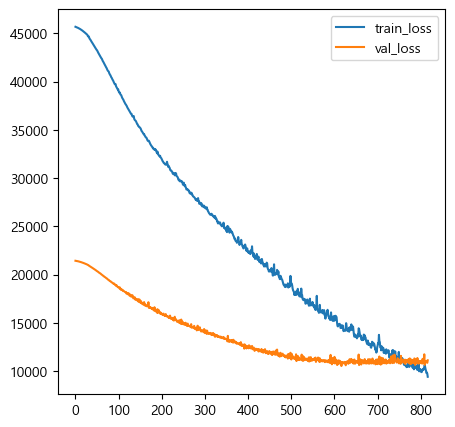

In [360]:
plt.plot(train_loss_hk2_23_m, label = 'train_loss')
plt.plot(val_loss_hk2_23_m, label = 'val_loss')
plt.legend()
plt.show()

In [361]:
val_r2_hk2_23_m, val_mae_hk2_23_m = test(valid_loader_hk2_23_m, model_hk2_23_m,isEDR=isEDR)

y_label :  2.6453332901000977 y_pred :  5676.9677734375
y_label :  299.00299072265625 y_pred :  7735.52685546875
y_label :  1468.411376953125 y_pred :  7298.3515625
y_label :  3172.561279296875 y_pred :  6384.859375
y_label :  3313.206298828125 y_pred :  4361.14453125
y_label :  4542.36083984375 y_pred :  3696.828369140625
y_label :  6785.12890625 y_pred :  3273.432861328125
y_label :  4274.16552734375 y_pred :  3669.394775390625
y_label :  5513.5419921875 y_pred :  7966.80615234375
y_label :  4897.48291015625 y_pred :  4804.2373046875
y_label :  8662.6064453125 y_pred :  5688.5361328125
y_label :  6527.38720703125 y_pred :  7574.73095703125
y_label :  9667.23046875 y_pred :  8560.9658203125
y_label :  9102.384765625 y_pred :  8508.0078125
y_label :  11106.7431640625 y_pred :  7984.64794921875
y_label :  11067.302734375 y_pred :  6269.5244140625
y_label :  9860.869140625 y_pred :  5891.8896484375
y_label :  7192.80419921875 y_pred :  8309.3828125
y_label :  9593.9287109375 y_pred :  75

In [362]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_23_m, test_mae_hk2_23_m = test(test_loader_hk2_23_m, model_hk2_23_m, isEDR=isEDR)
y_label_hk2_23_m = y_label_plt
y_pred_hk2_23_m = y_pred_plt

y_label :  614.3186645507812 y_pred :  357.7021179199219
y_label :  422.0606689453125 y_pred :  350.763427734375
y_label :  1092.855712890625 y_pred :  1010.608642578125
y_label :  1295.65966796875 y_pred :  1461.1951904296875
y_label :  1305.4940185546875 y_pred :  2085.685791015625
y_label :  2220.09912109375 y_pred :  1388.609375
y_label :  1574.2213134765625 y_pred :  1145.9808349609375
y_label :  1022.1356811523438 y_pred :  265.9914245605469
y_label :  746.5416870117188 y_pred :  243.14227294921875
y_label :  2212.597900390625 y_pred :  429.91412353515625
y_label :  2452.279052734375 y_pred :  650.3267822265625
y_label :  2941.931640625 y_pred :  0.0
y_label :  875.1216430664062 y_pred :  6.22063684463501
y_label :  250.03533935546875 y_pred :  1194.220458984375
y_label :  1479.8929443359375 y_pred :  995.187744140625
y_label :  1217.02734375 y_pred :  987.3619384765625
y_label :  927.086669921875 y_pred :  3427.818115234375
y_label :  1577.48828125 y_pred :  5052.23291015625
y_l

xlim is (-739.682421875, 15533.330859375)
ylim is (-453.268505859375, 9518.638623046874)


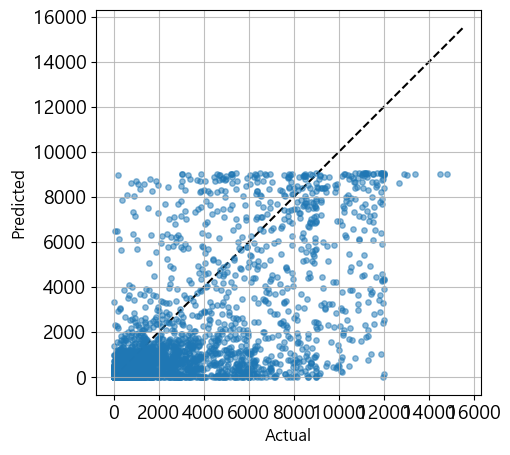

In [363]:
plot_scatter(y_label_hk2_23_m,y_pred_hk2_23_m)

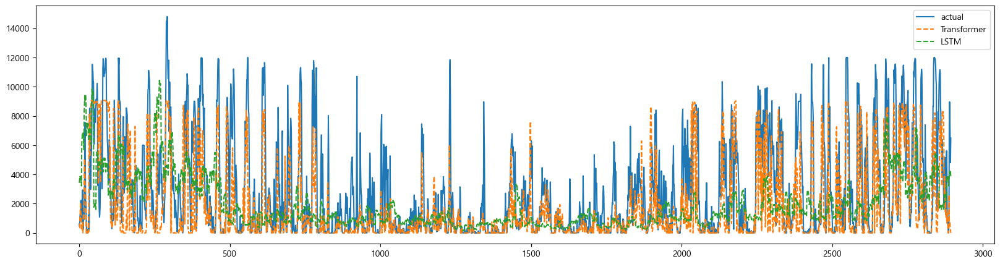

In [364]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_23_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_23_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_23_m_re[_start:_end], '--',label = 'LSTM')
plt.legend()

In [365]:
#hk2_multi_31
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_31_m.parameters(), lr=lr)
train_loss_hk2_31_m, val_loss_hk2_31_m = trainer(train_loader_hk2_31_m, valid_loader_hk2_31_m, model_hk2_31_m, criterion, optimizer, target='hk2', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_hk2_31_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7412298714007379
MAE Loss:  3729.1483901117967
Validation
R2 score: -0.711123036511105
MAE Loss:  3486.727882488785
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7400982836161298
MAE Loss:  3727.0112541824365
Validation
R2 score: -0.7104630532877256
MAE Loss:  3485.502814763123
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7394497387838717
MAE Loss:  3725.6962896525984
Validation
R2 score: -0.7097599530792533
MAE Loss:  3484.2107690190383
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7387393887594398
MAE Loss:  3724.266009871791
Validation
R2 score: -0.7089975865518579
MAE Loss:  3482.8171119317462
최신화
Epoch 4/1000
TRAIN
R2 score: -0.7379776859102445
MAE Loss:  3722.7452629524123
Validation
R2 score: -0.7081685953469994
MAE Loss:  3481.307108119012
최신화
Epoch 5/1000
TRAIN
R2 score: -0.737153347697822
MAE Loss:  3721.111798121767
Validation
R2 score: -0.7072758626023079
MAE Loss:  3479.6907547188366
최신화
Epoch 6/1000
TRAIN
R2 score: -0.736264908902688
MAE Loss:  3719.361255142205
Valida

R2 score: -0.6297255123999543
MAE Loss:  3505.4979847175105
Validation
R2 score: -0.5964918836130384
MAE Loss:  3293.795953938691
최신화
Epoch 55/1000
TRAIN
R2 score: -0.6262007080048584
MAE Loss:  3498.954531469357
Validation
R2 score: -0.5928829559826099
MAE Loss:  3289.2062742428207
최신화
Epoch 56/1000
TRAIN
R2 score: -0.6225727815733377
MAE Loss:  3492.9381808498397
Validation
R2 score: -0.5896550495448161
MAE Loss:  3284.306250119268
최신화
Epoch 57/1000
TRAIN
R2 score: -0.6190167173194867
MAE Loss:  3484.364857467844
Validation
R2 score: -0.5859414848671078
MAE Loss:  3280.1122646799663
최신화
Epoch 58/1000
TRAIN
R2 score: -0.6153082265153955
MAE Loss:  3477.251881442724
Validation
R2 score: -0.582194754276756
MAE Loss:  3273.2157867647843
최신화
Epoch 59/1000
TRAIN
R2 score: -0.6117454288426041
MAE Loss:  3470.234489136222
Validation
R2 score: -0.5781358798113214
MAE Loss:  3267.412373053728
최신화
Epoch 60/1000
TRAIN
R2 score: -0.6080035629661562
MAE Loss:  3464.4634074151454
Validation
R2 scor

R2 score: -0.413565215776065
MAE Loss:  3129.5093639580505
Validation
R2 score: -0.37927715388614125
MAE Loss:  2985.234961805119
최신화
Epoch 109/1000
TRAIN
R2 score: -0.40752578898643677
MAE Loss:  3126.8692133321024
Validation
R2 score: -0.3840657900307982
MAE Loss:  2993.935890467647
Epoch 110/1000
TRAIN
R2 score: -0.40414854006144796
MAE Loss:  3114.9627221430073
Validation
R2 score: -0.3808885808540612
MAE Loss:  2990.148515453063
Epoch 111/1000
TRAIN
R2 score: -0.40018590874500215
MAE Loss:  3108.256469830853
Validation
R2 score: -0.3674089246085297
MAE Loss:  2970.665784570337
최신화
Epoch 112/1000
TRAIN
R2 score: -0.3951965879362993
MAE Loss:  3102.878234490401
Validation
R2 score: -0.3692119349454004
MAE Loss:  2972.02573037076
Epoch 113/1000
TRAIN
R2 score: -0.39147571854854335
MAE Loss:  3094.575282519176
Validation
R2 score: -0.36342141366263303
MAE Loss:  2967.4841029998274
최신화
Epoch 114/1000
TRAIN
R2 score: -0.3864256908596173
MAE Loss:  3088.5441132768487
Validation
R2 score:

R2 score: -0.1630620141799599
MAE Loss:  2724.4425439672773
최신화
Epoch 163/1000
TRAIN
R2 score: -0.18834900157400947
MAE Loss:  2809.7784724340445
Validation
R2 score: -0.17872657769457412
MAE Loss:  2741.332098445217
Epoch 164/1000
TRAIN
R2 score: -0.18417386498789012
MAE Loss:  2796.768484930106
Validation
R2 score: -0.1695622946138573
MAE Loss:  2737.560076271503
Epoch 165/1000
TRAIN
R2 score: -0.18120280265616184
MAE Loss:  2789.744544840888
Validation
R2 score: -0.1539371233185638
MAE Loss:  2709.055426120794
최신화
Epoch 166/1000
TRAIN
R2 score: -0.17774530804556
MAE Loss:  2787.835551248092
Validation
R2 score: -0.16247877259970656
MAE Loss:  2717.4083244530793
Epoch 167/1000
TRAIN
R2 score: -0.17176549323377066
MAE Loss:  2777.7155938039155
Validation
R2 score: -0.1579541147646626
MAE Loss:  2721.905521146989
Epoch 168/1000
TRAIN
R2 score: -0.16808327970756332
MAE Loss:  2769.080031559301
Validation
R2 score: -0.15369581717406833
MAE Loss:  2708.7051036665216
최신화
Epoch 169/1000
TRA

R2 score: 0.0029488843112560614
MAE Loss:  2550.1687181239895
Validation
R2 score: 0.0258911569563125
MAE Loss:  2503.81261005213
최신화
Epoch 218/1000
TRAIN
R2 score: 0.0008702062573655578
MAE Loss:  2548.343342525822
Validation
R2 score: 0.028116143188330223
MAE Loss:  2486.6721840023283
최신화
Epoch 219/1000
TRAIN
R2 score: 0.009851666705609108
MAE Loss:  2549.5846495101014
Validation
R2 score: 0.0030086848919159692
MAE Loss:  2538.371301372546
Epoch 220/1000
TRAIN
R2 score: 0.010825621034015076
MAE Loss:  2543.945957908477
Validation
R2 score: 0.036491804488188895
MAE Loss:  2485.876138896877
최신화
Epoch 221/1000
TRAIN
R2 score: 0.014089699454790772
MAE Loss:  2527.7632798945715
Validation
R2 score: 0.03557277136183956
MAE Loss:  2485.3939696350058
최신화
Epoch 222/1000
TRAIN
R2 score: 0.020150406019778466
MAE Loss:  2518.7340383972546
Validation
R2 score: 0.029974104643213817
MAE Loss:  2498.2557946040724
Epoch 223/1000
TRAIN
R2 score: 0.023251040755133068
MAE Loss:  2516.19295272329
Validat

R2 score: 0.1655066447179131
MAE Loss:  2323.770962267543
Validation
R2 score: 0.18334708138194444
MAE Loss:  2334.419442002672
Epoch 272/1000
TRAIN
R2 score: 0.1644977246031385
MAE Loss:  2323.132653882479
Validation
R2 score: 0.1784697437676792
MAE Loss:  2329.247284142244
Epoch 273/1000
TRAIN
R2 score: 0.17279729262553167
MAE Loss:  2307.802623015463
Validation
R2 score: 0.18396720466952832
MAE Loss:  2322.5228595197436
최신화
Epoch 274/1000
TRAIN
R2 score: 0.1722997035645527
MAE Loss:  2311.3407542093537
Validation
R2 score: 0.18882427680259906
MAE Loss:  2323.310664260477
Epoch 275/1000
TRAIN
R2 score: 0.17719761902872588
MAE Loss:  2307.2618243036973
Validation
R2 score: 0.18070936317978525
MAE Loss:  2327.798590218386
Epoch 276/1000
TRAIN
R2 score: 0.17825221487699416
MAE Loss:  2317.632965509474
Validation
R2 score: 0.1949564708990551
MAE Loss:  2301.947963451519
최신화
Epoch 277/1000
TRAIN
R2 score: 0.18199111934089296
MAE Loss:  2300.3150642848086
Validation
R2 score: 0.19748219914

R2 score: 0.30130669039828173
MAE Loss:  2134.02297334025
Validation
R2 score: 0.30897338407415076
MAE Loss:  2187.210315285194
Epoch 327/1000
TRAIN
R2 score: 0.3072810756716061
MAE Loss:  2124.9094420325755
Validation
R2 score: 0.30611689362554406
MAE Loss:  2179.427605031084
Epoch 328/1000
TRAIN
R2 score: 0.30808383463240585
MAE Loss:  2119.218730562074
Validation
R2 score: 0.30320288104599313
MAE Loss:  2180.833771532633
Epoch 329/1000
TRAIN
R2 score: 0.3094104889000514
MAE Loss:  2124.4852992282936
Validation
R2 score: 0.30768186849000534
MAE Loss:  2173.0212632299695
최신화
Epoch 330/1000
TRAIN
R2 score: 0.3122002496921812
MAE Loss:  2117.0951333383246
Validation
R2 score: 0.30548878434117666
MAE Loss:  2174.054856901479
Epoch 331/1000
TRAIN
R2 score: 0.3156251452496476
MAE Loss:  2112.0892241309034
Validation
R2 score: 0.3114328799096052
MAE Loss:  2171.115130796262
최신화
Epoch 332/1000
TRAIN
R2 score: 0.3157586386708483
MAE Loss:  2113.279525068962
Validation
R2 score: 0.321452684191

R2 score: 0.4139921297141437
MAE Loss:  1954.2663087552862
Validation
R2 score: 0.41163694422149255
MAE Loss:  2072.041576997737
Epoch 383/1000
TRAIN
R2 score: 0.41528387805237166
MAE Loss:  1992.5057087116293
Validation
R2 score: 0.4139390410195244
MAE Loss:  2041.1517728384924
최신화
Epoch 384/1000
TRAIN
R2 score: 0.4092683396598017
MAE Loss:  1983.4576544114761
Validation
R2 score: 0.41449331731923944
MAE Loss:  2049.594647820622
Epoch 385/1000
TRAIN
R2 score: 0.41616632044917834
MAE Loss:  2000.0203369394098
Validation
R2 score: 0.4185921028780287
MAE Loss:  2033.1835686981585
최신화
Epoch 386/1000
TRAIN
R2 score: 0.4252119686292415
MAE Loss:  1957.932747390912
Validation
R2 score: 0.412906907702036
MAE Loss:  2047.5613832011643
Epoch 387/1000
TRAIN
R2 score: 0.4219934298810627
MAE Loss:  1938.7256807432664
Validation
R2 score: 0.41564345915664314
MAE Loss:  2053.118222059193
Epoch 388/1000
TRAIN
R2 score: 0.42970567565280315
MAE Loss:  1935.8443853945198
Validation
R2 score: 0.417792475

R2 score: 0.503561879965061
MAE Loss:  1844.6143412909782
Validation
R2 score: 0.4825495648712165
MAE Loss:  1927.7671152941666
Epoch 438/1000
TRAIN
R2 score: 0.5095622644845368
MAE Loss:  1801.3901505863269
Validation
R2 score: 0.4692351223900234
MAE Loss:  1997.8428504796884
Epoch 439/1000
TRAIN
R2 score: 0.5073610426058185
MAE Loss:  1803.358013601676
Validation
R2 score: 0.4822422369669329
MAE Loss:  1967.81510895875
Epoch 440/1000
TRAIN
R2 score: 0.5097098071862003
MAE Loss:  1813.564629387068
Validation
R2 score: 0.4802709291037134
MAE Loss:  1956.9106898286961
Epoch 441/1000
TRAIN
R2 score: 0.509200073481711
MAE Loss:  1802.0613497756062
Validation
R2 score: 0.4794019153224127
MAE Loss:  1944.3559503792965
Epoch 442/1000
TRAIN
R2 score: 0.5168219479304508
MAE Loss:  1809.1316676120073
Validation
R2 score: 0.4914772406829212
MAE Loss:  1923.2783089428883
최신화
Epoch 443/1000
TRAIN
R2 score: 0.5134678124709783
MAE Loss:  1784.7525102967884
Validation
R2 score: 0.47879925538244195
MA

R2 score: 0.5958466637626737
MAE Loss:  1667.2438731639277
Validation
R2 score: 0.5048478809120086
MAE Loss:  1898.162254220765
Epoch 494/1000
TRAIN
R2 score: 0.6002534634756956
MAE Loss:  1650.1987106159513
Validation
R2 score: 0.5396471370095409
MAE Loss:  1860.6887499980412
Epoch 495/1000
TRAIN
R2 score: 0.5964078719417096
MAE Loss:  1638.0298699610873
Validation
R2 score: 0.5371302609446864
MAE Loss:  1902.793392526485
Epoch 496/1000
TRAIN
R2 score: 0.5934655800909556
MAE Loss:  1674.1168038431572
Validation
R2 score: 0.5398344803281394
MAE Loss:  1841.855456453964
최신화
Epoch 497/1000
TRAIN
R2 score: 0.5982721587564536
MAE Loss:  1648.80346032238
Validation
R2 score: 0.5265791620316158
MAE Loss:  1892.4402346670863
Epoch 498/1000
TRAIN
R2 score: 0.5988651373903786
MAE Loss:  1660.2469412220983
Validation
R2 score: 0.556643625247278
MAE Loss:  1819.267320545066
최신화
Epoch 499/1000
TRAIN
R2 score: 0.6031053506619191
MAE Loss:  1623.364997406126
Validation
R2 score: 0.5265712936620546
M

R2 score: 0.6716181641986229
MAE Loss:  1506.5784597396464
Validation
R2 score: 0.5670094375076911
MAE Loss:  1802.1929718213341
Epoch 549/1000
TRAIN
R2 score: 0.679863236791
MAE Loss:  1477.3960360552537
Validation
R2 score: 0.5725049265355491
MAE Loss:  1793.8547288543848
Epoch 550/1000
TRAIN
R2 score: 0.6775958187870271
MAE Loss:  1472.4349089942727
Validation
R2 score: 0.5924054549033189
MAE Loss:  1807.7123136863431
Epoch 551/1000
TRAIN
R2 score: 0.6791048022338676
MAE Loss:  1479.6529685092607
Validation
R2 score: 0.5792749555482836
MAE Loss:  1806.692065915983
Epoch 552/1000
TRAIN
R2 score: 0.6862047762188641
MAE Loss:  1468.7817022364875
Validation
R2 score: 0.5588639939956068
MAE Loss:  1804.8764585793913
Epoch 553/1000
TRAIN
R2 score: 0.6712846769851003
MAE Loss:  1504.0736941876696
Validation
R2 score: 0.5842935129722515
MAE Loss:  1796.1368462818505
Epoch 554/1000
TRAIN
R2 score: 0.682693692468094
MAE Loss:  1468.1612245524386
Validation
R2 score: 0.5982851601963723
MAE Los

R2 score: 0.738676819026578
MAE Loss:  1324.5626945830313
Validation
R2 score: 0.5925685877214186
MAE Loss:  1744.7977158539768
Epoch 604/1000
TRAIN
R2 score: 0.7329503790346104
MAE Loss:  1360.6206053407907
Validation
R2 score: 0.5784677363018675
MAE Loss:  1770.0383621270394
Epoch 605/1000
TRAIN
R2 score: 0.7193347584709054
MAE Loss:  1362.4561060502756
Validation
R2 score: 0.6096921065476248
MAE Loss:  1769.870237655624
Epoch 606/1000
TRAIN
R2 score: 0.7216272602274927
MAE Loss:  1395.542558617829
Validation
R2 score: 0.6140304363265416
MAE Loss:  1725.2028020502362
최신화
Epoch 607/1000
TRAIN
R2 score: 0.7395995433834812
MAE Loss:  1316.758877594001
Validation
R2 score: 0.5950757395909135
MAE Loss:  1761.0431078075283
Epoch 608/1000
TRAIN
R2 score: 0.7430761894073101
MAE Loss:  1313.1348353116282
Validation
R2 score: 0.5929805830331984
MAE Loss:  1760.8099906332534
Epoch 609/1000
TRAIN
R2 score: 0.7437227523080204
MAE Loss:  1308.2076795287476
Validation
R2 score: 0.6159444502866134
M

R2 score: 0.7863613733059737
MAE Loss:  1182.0083376260984
Validation
R2 score: 0.6080021964068226
MAE Loss:  1729.50305793156
Epoch 660/1000
TRAIN
R2 score: 0.7871977902659929
MAE Loss:  1188.1408427668418
Validation
R2 score: 0.5970613749705702
MAE Loss:  1730.6441914028132
Epoch 661/1000
TRAIN
R2 score: 0.7895194573709426
MAE Loss:  1180.0313913570592
Validation
R2 score: 0.6059965823570534
MAE Loss:  1709.624647428045
Epoch 662/1000
TRAIN
R2 score: 0.787193205220207
MAE Loss:  1189.177942598162
Validation
R2 score: 0.6114958183341722
MAE Loss:  1713.299021489769
Epoch 663/1000
TRAIN
R2 score: 0.7859968437238232
MAE Loss:  1184.9349969632333
Validation
R2 score: 0.6171143046248917
MAE Loss:  1723.2433619759925
Epoch 664/1000
TRAIN
R2 score: 0.7845437610572692
MAE Loss:  1198.3414419453502
Validation
R2 score: 0.6190815735681703
MAE Loss:  1709.857769319196
Epoch 665/1000
TRAIN
R2 score: 0.7903333629893237
MAE Loss:  1189.7146024661567
Validation
R2 score: 0.5840871418750628
MAE Loss

R2 score: 0.8131715247630384
MAE Loss:  1117.974999868097
Validation
R2 score: 0.617279767479383
MAE Loss:  1687.8566028905457
Epoch 715/1000
TRAIN
R2 score: 0.8211666744462697
MAE Loss:  1086.1777054976399
Validation
R2 score: 0.5797032374372618
MAE Loss:  1731.3170931363704
Epoch 716/1000
TRAIN
R2 score: 0.8179484757995675
MAE Loss:  1096.5403808045621
Validation
R2 score: 0.6095930316703062
MAE Loss:  1703.1676436678881
Epoch 717/1000
TRAIN
R2 score: 0.8275507418378848
MAE Loss:  1064.9038464226007
Validation
R2 score: 0.6104029432543765
MAE Loss:  1691.0656633446795
Epoch 718/1000
TRAIN
R2 score: 0.8269287718963017
MAE Loss:  1067.0722501490302
Validation
R2 score: 0.5942850882944594
MAE Loss:  1712.4853982169602
Epoch 719/1000
TRAIN
R2 score: 0.8260377503758589
MAE Loss:  1065.0722271454686
Validation
R2 score: 0.6104537955926449
MAE Loss:  1694.1536851814017
Epoch 720/1000
TRAIN
R2 score: 0.8248289681929977
MAE Loss:  1071.8894062209934
Validation
R2 score: 0.6007334047188612
MAE

R2 score: 0.8449470469940551
MAE Loss:  1010.1534579157302
Validation
R2 score: 0.6074398677647839
MAE Loss:  1680.717005619908
Epoch 771/1000
TRAIN
R2 score: 0.8526380738429077
MAE Loss:  977.4698838430903
Validation
R2 score: 0.6036302049953197
MAE Loss:  1705.4482166227622
Epoch 772/1000
TRAIN
R2 score: 0.8473684614598933
MAE Loss:  991.8639674461584
Validation
R2 score: 0.6049381572221333
MAE Loss:  1667.3185862629362
Epoch 773/1000
TRAIN
R2 score: 0.8510375635664885
MAE Loss:  992.9754149581919
Validation
R2 score: 0.599422306371467
MAE Loss:  1680.7337886299783
Epoch 774/1000
TRAIN
R2 score: 0.8442040776442254
MAE Loss:  1009.5980178434997
Validation
R2 score: 0.6143879417518547
MAE Loss:  1671.296489214756
Epoch 775/1000
TRAIN
R2 score: 0.8533746923672584
MAE Loss:  983.1874284547174
Validation
R2 score: 0.60038681280029
MAE Loss:  1697.2498133290117
Epoch 776/1000
TRAIN
R2 score: 0.8510877950426525
MAE Loss:  976.8624548190763
Validation
R2 score: 0.6105093354968385
MAE Loss:  

R2 score: 0.8562943398227156
MAE Loss:  987.2516060472117
Validation
R2 score: 0.5968886914452975
MAE Loss:  1677.8629998575166
Epoch 827/1000
TRAIN
R2 score: 0.8643415855729568
MAE Loss:  941.1022227070081
Validation
R2 score: 0.5748747325084563
MAE Loss:  1713.9635686428744
Epoch 828/1000
TRAIN
R2 score: 0.8704290280120344
MAE Loss:  915.8478790310262
Validation
R2 score: 0.589235111931389
MAE Loss:  1699.5025816422049
Epoch 829/1000
TRAIN
R2 score: 0.8744928067402342
MAE Loss:  890.508796878318
Validation
R2 score: 0.6028922736382865
MAE Loss:  1673.9442383876399
Epoch 830/1000
TRAIN
R2 score: 0.8802948709570316
MAE Loss:  885.7671753787338
Validation
R2 score: 0.6018419819931311
MAE Loss:  1667.5583161908196
Epoch 831/1000
TRAIN
R2 score: 0.8802852525848848
MAE Loss:  868.9160064015115
Validation
R2 score: 0.5941358164009806
MAE Loss:  1677.62446605391
Epoch 832/1000
TRAIN
R2 score: 0.8841075821423567
MAE Loss:  869.8946657352669
Validation
R2 score: 0.5890903513788233
MAE Loss:  1

R2 score: 0.897519429046784
MAE Loss:  818.0145521576502
Validation
R2 score: 0.5518065825699427
MAE Loss:  1750.7948036978166
Epoch 883/1000
TRAIN
R2 score: 0.8863004629352269
MAE Loss:  861.5270480286308
Validation
R2 score: 0.5778414214053507
MAE Loss:  1714.2259667336848
Epoch 884/1000
TRAIN
R2 score: 0.8856861763180905
MAE Loss:  853.9112546373678
Validation
R2 score: 0.5722713390490082
MAE Loss:  1729.862986112389
Epoch 885/1000
TRAIN
R2 score: 0.878959388313553
MAE Loss:  888.7690440172524
Validation
R2 score: 0.5776167445354974
MAE Loss:  1716.7030161756416
Epoch 886/1000
TRAIN
R2 score: 0.8941001217762681
MAE Loss:  825.3521880219132
Validation
R2 score: 0.5456568902282443
MAE Loss:  1741.7340278559986
Epoch 887/1000
TRAIN
R2 score: 0.8772067021629449
MAE Loss:  886.312775395636
Validation
R2 score: 0.573182394251555
MAE Loss:  1730.5573566439639
Epoch 888/1000
TRAIN
R2 score: 0.8966257437980334
MAE Loss:  816.6509282945601
Validation
R2 score: 0.5815694407893239
MAE Loss:  17

R2 score: 0.9029997492454337
MAE Loss:  796.9496509056424
Validation
R2 score: 0.566871363182242
MAE Loss:  1725.972956614821
Epoch 939/1000
TRAIN
R2 score: 0.9051758027128376
MAE Loss:  786.3521577408649
Validation
R2 score: 0.57102686162057
MAE Loss:  1700.882887316873
Epoch 940/1000
TRAIN
R2 score: 0.9061789957994097
MAE Loss:  780.2888133454973
Validation
R2 score: 0.5793615590915782
MAE Loss:  1697.1026751748363
Epoch 941/1000
TRAIN
R2 score: 0.912020626043212
MAE Loss:  748.8317356587648
Validation
R2 score: 0.5733493894163602
MAE Loss:  1713.7891099664296
Epoch 942/1000
TRAIN
R2 score: 0.9155892519101358
MAE Loss:  739.547146559929
Validation
R2 score: 0.5704108433506246
MAE Loss:  1713.786794615287
Epoch 943/1000
TRAIN
R2 score: 0.9088896743122777
MAE Loss:  769.1219840850007
Validation
R2 score: 0.564251057298278
MAE Loss:  1720.939942491354
Epoch 944/1000
TRAIN
R2 score: 0.9080431554336663
MAE Loss:  768.8605683417121
Validation
R2 score: 0.5782833465911228
MAE Loss:  1696.11

<All keys matched successfully>

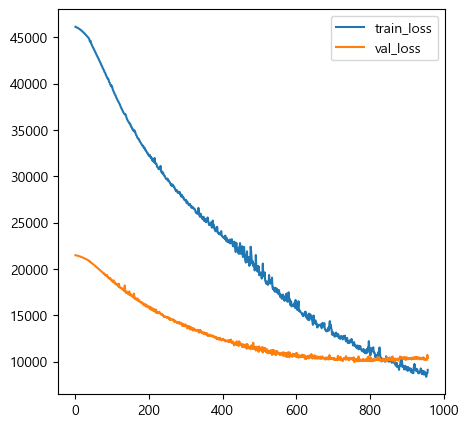

In [366]:
plt.plot(train_loss_hk2_31_m, label = 'train_loss')
plt.plot(val_loss_hk2_31_m, label = 'val_loss')
plt.legend()
plt.show()

In [367]:
val_r2_hk2_31_m, val_mae_hk2_31_m = test(valid_loader_hk2_31_m, model_hk2_31_m,isEDR=isEDR)

y_label :  5513.5419921875 y_pred :  7090.916015625
y_label :  4897.48291015625 y_pred :  2777.927001953125
y_label :  8662.6064453125 y_pred :  6178.5615234375
y_label :  6527.38720703125 y_pred :  6934.2138671875
y_label :  9667.23046875 y_pred :  6404.279296875
y_label :  9102.384765625 y_pred :  9370.3623046875
y_label :  11106.7431640625 y_pred :  8754.8623046875
y_label :  11067.302734375 y_pred :  7193.6845703125
y_label :  9860.869140625 y_pred :  6767.65625
y_label :  7192.80419921875 y_pred :  7643.14599609375
y_label :  9593.9287109375 y_pred :  2668.14599609375
y_label :  13455.287109375 y_pred :  2662.1708984375
y_label :  14513.291015625 y_pred :  2891.0771484375
y_label :  12563.978515625 y_pred :  9229.8876953125
y_label :  13127.2109375 y_pred :  10097.2294921875
y_label :  13069.3876953125 y_pred :  8963.3212890625
y_label :  12867.294921875 y_pred :  10545.7431640625
y_label :  11915.947265625 y_pred :  10569.0087890625
y_label :  11613.2373046875 y_pred :  10589.916

y_label :  0.0 y_pred :  234.53781127929688
y_label :  1173.2366943359375 y_pred :  984.5841674804688
y_label :  1065.112060546875 y_pred :  282.6028747558594
y_label :  1198.6263427734375 y_pred :  0.0
y_label :  0.987666666507721 y_pred :  0.0
y_label :  58.641666412353516 y_pred :  0.0
y_label :  7.164333343505859 y_pred :  0.0
y_label :  13.960000038146973 y_pred :  0.0
y_label :  414.9223327636719 y_pred :  894.504638671875
y_label :  1061.3126220703125 y_pred :  133.51773071289062
y_label :  566.0349731445312 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  0.0 y_pred :  206.5205078125
y_label :  224.27932739257812 y_pred :  0.0
y_label :  7.960000038146973 y_pred :  0.0
y_label :  106.9540023803711 y_pred :  477.26409912109375
y_label :  336.2669982910156 y_pred :  105.9229507446289
y_label :  448.22467041015625 y_pred :  2401.6142578125
y_label :  5074.23486328125 y_pred :  10228.8564453125
y_label :  8411.5595703125 y_pred :  10727.1396484375
y_label :  1310.083984375 y_p

In [368]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_31_m, test_mae_hk2_31_m = test(test_loader_hk2_31_m, model_hk2_31_m, isEDR=isEDR)
y_label_hk2_31_m = y_label_plt
y_pred_hk2_31_m = y_pred_plt

y_label :  746.5416870117188 y_pred :  283.63446044921875
y_label :  2212.597900390625 y_pred :  333.89617919921875
y_label :  2452.279052734375 y_pred :  503.4664306640625
y_label :  2941.931640625 y_pred :  44.33537673950195
y_label :  875.1216430664062 y_pred :  33.88786315917969
y_label :  250.03533935546875 y_pred :  886.0366821289062
y_label :  1479.8929443359375 y_pred :  815.9280395507812
y_label :  1217.02734375 y_pred :  691.1343383789062
y_label :  927.086669921875 y_pred :  1883.116943359375
y_label :  1577.48828125 y_pred :  6491.14306640625
y_label :  6235.2041015625 y_pred :  7248.87109375
y_label :  7556.4091796875 y_pred :  5679.1962890625
y_label :  4068.4697265625 y_pred :  1028.1358642578125
y_label :  1769.04931640625 y_pred :  1899.1483154296875
y_label :  2132.917724609375 y_pred :  1007.5499267578125
y_label :  827.5123291015625 y_pred :  0.0
y_label :  34.78066635131836 y_pred :  0.0
y_label :  10.529666900634766 y_pred :  0.0
y_label :  0.0 y_pred :  131.38098

xlim is (-739.682421875, 15533.330859375)
ylim is (-550.0564453125, 11551.1853515625)


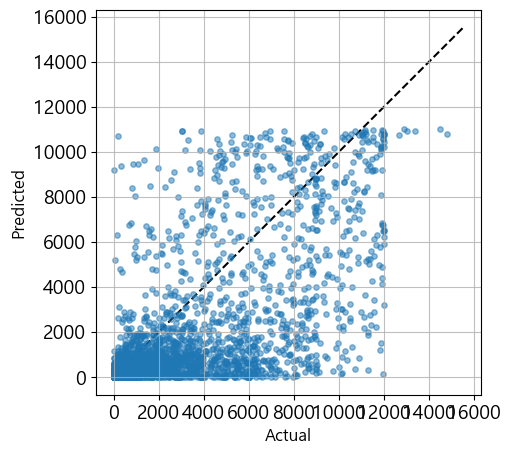

In [369]:
plot_scatter(y_label_hk2_31_m,y_pred_hk2_31_m)

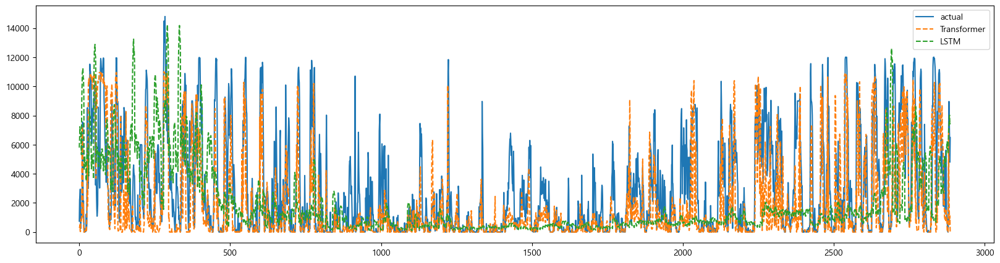

In [370]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_31_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_31_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_31_m_re[_start:_end], '--',label = 'LSTM')
plt.legend()

In [1369]:
#hk2_multi
seed_everything_torch(3)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_m.parameters(), lr=lr)
train_loss_hk2_m, val_loss_hk2_m = trainer(train_loader_hk2_m, valid_loader_hk2_m, model_hk2_m, criterion, optimizer, target='hk2', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk2_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7344268715170053
MAE Loss:  3720.872834144599
Validation
R2 score: -0.6959213551665553
MAE Loss:  3453.1635403047767
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7302986660081934
MAE Loss:  3713.114199059763
Validation
R2 score: -0.6913827156629251
MAE Loss:  3445.5237692546275
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7255936061547932
MAE Loss:  3704.4353387226365
Validation
R2 score: -0.6862545970396283
MAE Loss:  3437.0861385750463
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7203185334439148
MAE Loss:  3694.917045534237
Validation
R2 score: -0.6805496088942851
MAE Loss:  3427.880445844939
최신화
Epoch 4/1000
TRAIN
R2 score: -0.714488226876483
MAE Loss:  3684.6258622942973
Validation
R2 score: -0.674288302878312
MAE Loss:  3417.9983512547205
최신화
Epoch 5/1000
TRAIN
R2 score: -0.7081370579448292
MAE Loss:  3673.7008778244963
Validation
R2 score: -0.6675102694406116
MAE Loss:  3407.5271816441204
최신화
Epoch 6/1000
TRAIN
R2 score: -0.7013896025572277
MAE Loss:  3662.000004924224
Vali

R2 score: -0.08715757690470483
MAE Loss:  2685.906044267729
Validation
R2 score: -0.048803874139044634
MAE Loss:  2627.090595933102
Epoch 54/1000
TRAIN
R2 score: -0.07629414903001264
MAE Loss:  2678.503459201615
Validation
R2 score: -0.04352912000087117
MAE Loss:  2596.4408668698793
최신화
Epoch 55/1000
TRAIN
R2 score: -0.06711664468659095
MAE Loss:  2668.7783669053692
Validation
R2 score: -0.047191586474469416
MAE Loss:  2578.2651988217394
최신화
Epoch 56/1000
TRAIN
R2 score: -0.05692102500420182
MAE Loss:  2653.2444801808624
Validation
R2 score: -0.015004929930127364
MAE Loss:  2565.636738237766
최신화
Epoch 57/1000
TRAIN
R2 score: -0.045362283492836886
MAE Loss:  2640.935884303641
Validation
R2 score: -0.010110544567075275
MAE Loss:  2559.353919748826
최신화
Epoch 58/1000
TRAIN
R2 score: -0.03304283227536975
MAE Loss:  2623.291474438053
Validation
R2 score: -0.005770489580294802
MAE Loss:  2553.3556658804855
최신화
Epoch 59/1000
TRAIN
R2 score: -0.022097024531353426
MAE Loss:  2601.1068361336465
V

R2 score: 0.35541928477293283
MAE Loss:  2137.561294156486
Validation
R2 score: 0.3876788479736236
MAE Loss:  2094.941094283552
최신화
Epoch 108/1000
TRAIN
R2 score: 0.3545251517718915
MAE Loss:  2126.816055250742
Validation
R2 score: 0.3666546115629029
MAE Loss:  2204.1308399324184
Epoch 109/1000
TRAIN
R2 score: 0.35811529598745273
MAE Loss:  2126.6859926723096
Validation
R2 score: 0.38664228733919137
MAE Loss:  2124.9896989250506
Epoch 110/1000
TRAIN
R2 score: 0.3689316233767167
MAE Loss:  2111.386805879331
Validation
R2 score: 0.4006366708794148
MAE Loss:  2084.745829366992
최신화
Epoch 111/1000
TRAIN
R2 score: 0.3743582082861747
MAE Loss:  2107.1502896808656
Validation
R2 score: 0.398562457740259
MAE Loss:  2147.578868926888
Epoch 112/1000
TRAIN
R2 score: 0.37677536412609747
MAE Loss:  2107.959249991975
Validation
R2 score: 0.39659767044340877
MAE Loss:  2169.2307875287247
Epoch 113/1000
TRAIN
R2 score: 0.37833633206570527
MAE Loss:  2095.4797140624687
Validation
R2 score: 0.402307037694

R2 score: 0.5572745311456584
MAE Loss:  1808.5711402785294
Validation
R2 score: 0.504304951699081
MAE Loss:  1873.2522703624884
Epoch 163/1000
TRAIN
R2 score: 0.5558313674808717
MAE Loss:  1820.8689252333918
Validation
R2 score: 0.47419549346813317
MAE Loss:  1921.5179648442695
Epoch 164/1000
TRAIN
R2 score: 0.5581347793136033
MAE Loss:  1804.1565169790251
Validation
R2 score: 0.5231503291726205
MAE Loss:  1852.098028435725
Epoch 165/1000
TRAIN
R2 score: 0.5784923666826417
MAE Loss:  1774.8354508300222
Validation
R2 score: 0.5174428817723888
MAE Loss:  1860.963134107267
Epoch 166/1000
TRAIN
R2 score: 0.5684808872155094
MAE Loss:  1784.2023880694626
Validation
R2 score: 0.42883571718697755
MAE Loss:  2000.022144758864
Epoch 167/1000
TRAIN
R2 score: 0.5708833668351367
MAE Loss:  1789.7186061866269
Validation
R2 score: 0.4520694989746328
MAE Loss:  1956.7882007559567
Epoch 168/1000
TRAIN
R2 score: 0.5459168575948425
MAE Loss:  1850.9045797230615
Validation
R2 score: 0.3103741886010345
MAE

R2 score: 0.6821006715426833
MAE Loss:  1502.5803807075
Validation
R2 score: 0.6400190955501804
MAE Loss:  1634.9884729757853
최신화
Epoch 218/1000
TRAIN
R2 score: 0.6751484598959897
MAE Loss:  1555.1866151332636
Validation
R2 score: 0.6210711228682968
MAE Loss:  1664.1220777956103
Epoch 219/1000
TRAIN
R2 score: 0.6811259375194476
MAE Loss:  1520.9389096109558
Validation
R2 score: 0.6504387289290587
MAE Loss:  1611.7532712910888
최신화
Epoch 220/1000
TRAIN
R2 score: 0.6910122107782143
MAE Loss:  1490.4605867966407
Validation
R2 score: 0.6256940846330865
MAE Loss:  1670.9573849988947
Epoch 221/1000
TRAIN
R2 score: 0.6934436046446881
MAE Loss:  1494.4423787296437
Validation
R2 score: 0.6333610981231456
MAE Loss:  1661.5184428741347
Epoch 222/1000
TRAIN
R2 score: 0.6669607750093495
MAE Loss:  1544.9422019087554
Validation
R2 score: 0.5386736918614641
MAE Loss:  1803.2077125420967
Epoch 223/1000
TRAIN
R2 score: 0.6731760502354918
MAE Loss:  1555.9496598869246
Validation
R2 score: 0.6245904238850

R2 score: 0.7383185489852444
MAE Loss:  1377.1848315967954
Validation
R2 score: 0.6362415486326912
MAE Loss:  1647.8829812181878
Epoch 273/1000
TRAIN
R2 score: 0.7373373346274721
MAE Loss:  1345.2366589028134
Validation
R2 score: 0.6504879817748626
MAE Loss:  1615.7116815832976
Epoch 274/1000
TRAIN
R2 score: 0.7525285213226045
MAE Loss:  1334.7001617242386
Validation
R2 score: 0.6374497768979401
MAE Loss:  1645.6197324183074
Epoch 275/1000
TRAIN
R2 score: 0.7475595686024559
MAE Loss:  1316.5100140822367
Validation
R2 score: 0.6617668232545745
MAE Loss:  1596.8971924220907
Epoch 276/1000
TRAIN
R2 score: 0.7608460913995772
MAE Loss:  1289.5100276074731
Validation
R2 score: 0.6589421689051878
MAE Loss:  1584.2013094896133
최신화
Epoch 277/1000
TRAIN
R2 score: 0.7588661757746883
MAE Loss:  1296.6028144534798
Validation
R2 score: 0.6427507649338335
MAE Loss:  1589.1442238592624
Epoch 278/1000
TRAIN
R2 score: 0.7481834125307388
MAE Loss:  1316.8146763790369
Validation
R2 score: 0.64086326832123

R2 score: 0.7890192962943665
MAE Loss:  1201.7155966968817
Validation
R2 score: 0.6163166910274867
MAE Loss:  1662.3883755575855
Epoch 328/1000
TRAIN
R2 score: 0.7506971596742807
MAE Loss:  1295.333610837321
Validation
R2 score: 0.6151441748260001
MAE Loss:  1657.5914694714504
Epoch 329/1000
TRAIN
R2 score: 0.7701455880109037
MAE Loss:  1268.0150903084711
Validation
R2 score: 0.6391324021927077
MAE Loss:  1622.716582718638
Epoch 330/1000
TRAIN
R2 score: 0.7912409686967466
MAE Loss:  1190.660922132454
Validation
R2 score: 0.6245449554833916
MAE Loss:  1653.3075197775397
Epoch 331/1000
TRAIN
R2 score: 0.8044138260314436
MAE Loss:  1154.5199375364646
Validation
R2 score: 0.6067174568271276
MAE Loss:  1673.7604826391512
Epoch 332/1000
TRAIN
R2 score: 0.7992643435965354
MAE Loss:  1163.8682096947946
Validation
R2 score: 0.6170871129364536
MAE Loss:  1675.2172458091761
Epoch 333/1000
TRAIN
R2 score: 0.7976644820987591
MAE Loss:  1162.5876481307348
Validation
R2 score: 0.614053721538693
MAE L

R2 score: 0.814445684761349
MAE Loss:  1126.2650021654626
Validation
R2 score: 0.6318409102867357
MAE Loss:  1612.1254606048965
Epoch 383/1000
TRAIN
R2 score: 0.8204890160230471
MAE Loss:  1080.0625913502897
Validation
R2 score: 0.6102943899530687
MAE Loss:  1655.2067970413214
Epoch 384/1000
TRAIN
R2 score: 0.8305240676580322
MAE Loss:  1055.6335099603875
Validation
R2 score: 0.6270610921585762
MAE Loss:  1621.537482308403
Epoch 385/1000
TRAIN
R2 score: 0.8201064704169023
MAE Loss:  1096.2782391341584
Validation
R2 score: 0.6148411580830635
MAE Loss:  1638.3620359737292
Epoch 386/1000
TRAIN
R2 score: 0.8238638275578156
MAE Loss:  1070.6041244925984
Validation
R2 score: 0.6055187978474676
MAE Loss:  1653.1830871372872
Epoch 387/1000
TRAIN
R2 score: 0.8239759443583292
MAE Loss:  1077.9690294175177
Validation
R2 score: 0.5927394073688386
MAE Loss:  1679.8373856903872
Epoch 388/1000
TRAIN
R2 score: 0.8133900114185626
MAE Loss:  1112.1695539023647
Validation
R2 score: 0.6016347892487535
MAE

<All keys matched successfully>

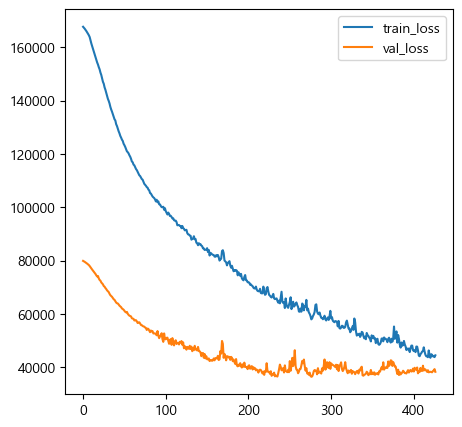

In [1370]:
plt.plot(train_loss_hk2_m, label = 'train_loss')
plt.plot(val_loss_hk2_m, label = 'val_loss')
plt.legend()
plt.show()

In [1381]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_m, test_mae_hk2_m = test(test_loader_hk2_m, model_hk2_m, isEDR=isEDR)
y_label_hk2_m = y_label_plt
y_pred_hk2_m = y_pred_plt

y_label :  2560.76806640625 y_pred :  3464.07080078125
y_label :  2443.97705078125 y_pred :  3505.6103515625
y_label :  3146.77734375 y_pred :  3361.712890625
y_label :  4039.077392578125 y_pred :  2388.523681640625
y_label :  4202.15283203125 y_pred :  2913.9912109375
y_label :  2595.485595703125 y_pred :  544.4164428710938
y_label :  1598.398681640625 y_pred :  229.55844116210938
y_label :  815.8056640625 y_pred :  277.29486083984375
y_label :  614.3186645507812 y_pred :  284.8224182128906
y_label :  422.0606689453125 y_pred :  318.1444396972656
y_label :  1092.855712890625 y_pred :  837.3980712890625
y_label :  1295.65966796875 y_pred :  977.6729736328125
y_label :  1305.4940185546875 y_pred :  846.0381469726562
y_label :  2220.09912109375 y_pred :  1078.957275390625
y_label :  1574.2213134765625 y_pred :  2290.79345703125
y_label :  1022.1356811523438 y_pred :  732.90869140625
y_label :  746.5416870117188 y_pred :  306.4833068847656
y_label :  2212.597900390625 y_pred :  556.142944

xlim is (-739.682421875, 15533.330859375)
ylim is (-560.68486328125, 11774.38212890625)


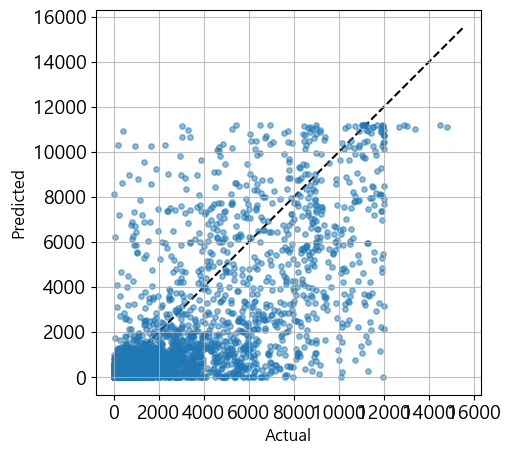

In [1382]:
plot_scatter(y_label_hk2_m,y_pred_hk2_m)

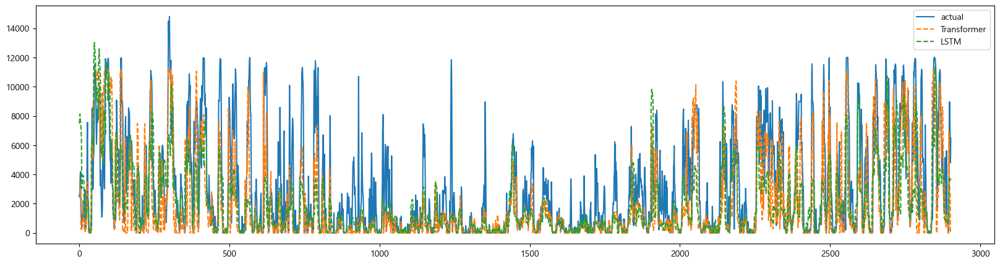

In [1383]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))

plt.plot(y_label_hk2_m[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

In [371]:
#hk2_3일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_22.parameters(), lr=lr)
train_loss_hk2_22, val_loss_hk2_22 = trainer(train_loader_hk2_22, valid_loader_hk2_22, model_hk2_22, criterion, optimizer, target='hk2', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk2_22.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7425700755209488
MAE Loss:  3736.0241469923476
Validation
R2 score: -0.7064069763744636
MAE Loss:  3474.8062037213176
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7355089704342501
MAE Loss:  3722.1170358910867
Validation
R2 score: -0.6974324824597846
MAE Loss:  3459.2519326214588
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7254438232776603
MAE Loss:  3703.2198052128965
Validation
R2 score: -0.6855657311744665
MAE Loss:  3439.695363446198
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7127672383728629
MAE Loss:  3680.571368029619
Validation
R2 score: -0.6713004534789904
MAE Loss:  3417.26566150944
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6979354990831623
MAE Loss:  3655.4062832468794
Validation
R2 score: -0.6549799688547973
MAE Loss:  3392.846708021276
최신화
Epoch 5/1000
TRAIN
R2 score: -0.6812206339016869
MAE Loss:  3628.4936116594045
Validation
R2 score: -0.6370681468065311
MAE Loss:  3367.6177035582505
최신화
Epoch 6/1000
TRAIN
R2 score: -0.6633577022466648
MAE Loss:  3600.5681331596556
Va

R2 score: 0.1801627127562191
MAE Loss:  2490.302418115773
Validation
R2 score: 0.21268117418088794
MAE Loss:  2342.205906104308
최신화
Epoch 54/1000
TRAIN
R2 score: 0.18958548886188376
MAE Loss:  2488.2330063747218
Validation
R2 score: 0.23750969622377394
MAE Loss:  2313.7146408273975
최신화
Epoch 55/1000
TRAIN
R2 score: 0.18993104115336346
MAE Loss:  2492.5339012978525
Validation
R2 score: 0.2251860600930391
MAE Loss:  2323.9392372931393
Epoch 56/1000
TRAIN
R2 score: 0.197530506068622
MAE Loss:  2472.5790770145013
Validation
R2 score: 0.22894156802250598
MAE Loss:  2329.7400999026177
Epoch 57/1000
TRAIN
R2 score: 0.2100787633330201
MAE Loss:  2472.1640804175245
Validation
R2 score: 0.24819724599761572
MAE Loss:  2305.385535957035
최신화
Epoch 58/1000
TRAIN
R2 score: 0.21571767512704842
MAE Loss:  2461.219995908744
Validation
R2 score: 0.22739998824539842
MAE Loss:  2331.842030414867
Epoch 59/1000
TRAIN
R2 score: 0.22924368653901162
MAE Loss:  2447.9995353353934
Validation
R2 score: 0.256914269

R2 score: 0.40626178429699733
MAE Loss:  2202.0480154271536
Validation
R2 score: 0.4135122326798274
MAE Loss:  2045.4102867883641
Epoch 109/1000
TRAIN
R2 score: 0.40780512433632643
MAE Loss:  2209.602378351513
Validation
R2 score: 0.4036641890716264
MAE Loss:  2066.4101046041706
Epoch 110/1000
TRAIN
R2 score: 0.41331820330042346
MAE Loss:  2186.9179569979983
Validation
R2 score: 0.41036177581763067
MAE Loss:  2066.4623816989015
Epoch 111/1000
TRAIN
R2 score: 0.4144381021588991
MAE Loss:  2191.4399720186334
Validation
R2 score: 0.41273061882930506
MAE Loss:  2067.9737199108963
Epoch 112/1000
TRAIN
R2 score: 0.4166548957205103
MAE Loss:  2189.1599486684104
Validation
R2 score: 0.4060394235179532
MAE Loss:  2056.0819357457613
Epoch 113/1000
TRAIN
R2 score: 0.4266408623537308
MAE Loss:  2186.892164046538
Validation
R2 score: 0.4333385965801514
MAE Loss:  2023.3320654644049
최신화
Epoch 114/1000
TRAIN
R2 score: 0.4181901725696471
MAE Loss:  2187.411244118866
Validation
R2 score: 0.401948947555

R2 score: 0.4710609226827519
MAE Loss:  2082.6793053522647
Validation
R2 score: 0.4754419978751415
MAE Loss:  1915.5871303595948
Epoch 164/1000
TRAIN
R2 score: 0.4713776378444091
MAE Loss:  2077.7420738090686
Validation
R2 score: 0.4956716001391478
MAE Loss:  1902.7446270446424
Epoch 165/1000
TRAIN
R2 score: 0.46815521889070655
MAE Loss:  2083.180365666146
Validation
R2 score: 0.4739897898776172
MAE Loss:  1904.5699377418039
Epoch 166/1000
TRAIN
R2 score: 0.4768650587514466
MAE Loss:  2074.559275359032
Validation
R2 score: 0.49827617412470915
MAE Loss:  1879.459178130748
최신화
Epoch 167/1000
TRAIN
R2 score: 0.46910611705609473
MAE Loss:  2076.718226801043
Validation
R2 score: 0.4788442956344493
MAE Loss:  1904.5034271716097
Epoch 168/1000
TRAIN
R2 score: 0.47904816932309446
MAE Loss:  2068.1049059473307
Validation
R2 score: 0.4907891659204243
MAE Loss:  1889.8570441526565
Epoch 169/1000
TRAIN
R2 score: 0.4786983765989158
MAE Loss:  2057.0459220827606
Validation
R2 score: 0.48602475882474

R2 score: 0.5012185318868342
MAE Loss:  1997.841341142444
Validation
R2 score: 0.4675293904039426
MAE Loss:  1927.0542065306754
Epoch 219/1000
TRAIN
R2 score: 0.5110550230218647
MAE Loss:  1989.1138402325714
Validation
R2 score: 0.4696724824858639
MAE Loss:  1921.2629024864937
Epoch 220/1000
TRAIN
R2 score: 0.48825461705379436
MAE Loss:  2012.770406915916
Validation
R2 score: 0.4657280908753312
MAE Loss:  1927.4903773286308
Epoch 221/1000
TRAIN
R2 score: 0.5039674963895053
MAE Loss:  2003.3790944187217
Validation
R2 score: 0.48290121732564806
MAE Loss:  1903.0712431697395
Epoch 222/1000
TRAIN
R2 score: 0.4890729457471038
MAE Loss:  2008.7868972467368
Validation
R2 score: 0.4526932303467288
MAE Loss:  1930.3538878608128
Epoch 223/1000
TRAIN
R2 score: 0.504363310599599
MAE Loss:  2005.7682959124945
Validation
R2 score: 0.46892269758918914
MAE Loss:  1922.1080909581121
Epoch 224/1000
TRAIN
R2 score: 0.5075371359944529
MAE Loss:  1982.3930907078704
Validation
R2 score: 0.49478428824323695


R2 score: 0.5179674224036668
MAE Loss:  1941.6065668490714
Validation
R2 score: 0.42921931091142373
MAE Loss:  1958.7223408933608
Epoch 274/1000
TRAIN
R2 score: 0.5311908926448253
MAE Loss:  1918.7065226209802
Validation
R2 score: 0.4316103515872326
MAE Loss:  1953.9160926262248
Epoch 275/1000
TRAIN
R2 score: 0.5224015893006982
MAE Loss:  1918.9581980256953
Validation
R2 score: 0.44833847775949576
MAE Loss:  1933.4009312232317
Epoch 276/1000
TRAIN
R2 score: 0.521704222330037
MAE Loss:  1927.2984302302427
Validation
R2 score: 0.4134645088345913
MAE Loss:  1999.6564431654863
Epoch 277/1000
TRAIN
R2 score: 0.526081076047652
MAE Loss:  1918.858308199917
Validation
R2 score: 0.38722927993365686
MAE Loss:  2013.77941524271
Epoch 278/1000
TRAIN
R2 score: 0.5182097299238098
MAE Loss:  1938.7573401890852
Validation
R2 score: 0.4183833812616723
MAE Loss:  1978.3361804430178
Epoch 279/1000
TRAIN
R2 score: 0.525928036023667
MAE Loss:  1922.8401456990503
Validation
R2 score: 0.4150994027789453
MAE 

R2 score: 0.5466274618546978
MAE Loss:  1863.3066786596664
Validation
R2 score: 0.4113145447733966
MAE Loss:  1989.2192690463412
Epoch 329/1000
TRAIN
R2 score: 0.537690535931078
MAE Loss:  1899.1833473552258
Validation
R2 score: 0.4108669618079056
MAE Loss:  1985.4647217189229
Epoch 330/1000
TRAIN
R2 score: 0.538042239091159
MAE Loss:  1892.3457472450134
Validation
R2 score: 0.46384700034003545
MAE Loss:  1902.0531001634165
Epoch 331/1000
TRAIN
R2 score: 0.5408942597083422
MAE Loss:  1876.6925037708627
Validation
R2 score: 0.37643305180854414
MAE Loss:  2041.503833564408
Epoch 332/1000
TRAIN
R2 score: 0.5400032981565461
MAE Loss:  1875.1258016435038
Validation
R2 score: 0.43014672235251994
MAE Loss:  1990.9445937957544
Epoch 333/1000
TRAIN
R2 score: 0.5416356423701019
MAE Loss:  1880.6800121583585
Validation
R2 score: 0.44030318413991587
MAE Loss:  1948.5002007499056
Epoch 334/1000
TRAIN
R2 score: 0.5453961483636749
MAE Loss:  1859.9559045078038
Validation
R2 score: 0.4394876698760456


R2 score: 0.556916076858281
MAE Loss:  1827.0908984156385
Validation
R2 score: 0.4558561228118323
MAE Loss:  1913.489060063437
Epoch 384/1000
TRAIN
R2 score: 0.5555316037095179
MAE Loss:  1832.1645495299133
Validation
R2 score: 0.48396488673917615
MAE Loss:  1859.6940982299345
Epoch 385/1000
TRAIN
R2 score: 0.5541583126336008
MAE Loss:  1833.817699804818
Validation
R2 score: 0.4704604413685486
MAE Loss:  1881.4587082937796
Epoch 386/1000
TRAIN
R2 score: 0.544123072064604
MAE Loss:  1845.1809628766894
Validation
R2 score: 0.43675469868660055
MAE Loss:  1932.661896680098
Epoch 387/1000
TRAIN
R2 score: 0.5641982914612503
MAE Loss:  1807.959272788911
Validation
R2 score: 0.49466529265841697
MAE Loss:  1849.216109309452
Epoch 388/1000
TRAIN
R2 score: 0.561906173880385
MAE Loss:  1816.8833197981562
Validation
R2 score: 0.460325425765414
MAE Loss:  1888.3394236370382
Epoch 389/1000
TRAIN
R2 score: 0.5678418724987895
MAE Loss:  1801.8804278438104
Validation
R2 score: 0.4713374687925862
MAE Los

R2 score: 0.5893978441081502
MAE Loss:  1751.1883646473948
Validation
R2 score: 0.39021101759960863
MAE Loss:  2017.8205081198846
Epoch 439/1000
TRAIN
R2 score: 0.5905289738257221
MAE Loss:  1745.764392894906
Validation
R2 score: 0.43373134055665785
MAE Loss:  1940.171168478123
Epoch 440/1000
TRAIN
R2 score: 0.5770788808133558
MAE Loss:  1778.3140188382256
Validation
R2 score: 0.42135353703344514
MAE Loss:  1968.007059614327
Epoch 441/1000
TRAIN
R2 score: 0.5724876704690838
MAE Loss:  1785.2554641229046
Validation
R2 score: 0.38891330890538334
MAE Loss:  2006.8661394755575
Epoch 442/1000
TRAIN
R2 score: 0.5765333716273684
MAE Loss:  1783.9408411567022
Validation
R2 score: 0.43191762010460844
MAE Loss:  1949.0422783919282
Epoch 443/1000
TRAIN
R2 score: 0.5965471808464777
MAE Loss:  1737.8820581574096
Validation
R2 score: 0.4029813688026376
MAE Loss:  1991.1350687600197
Epoch 444/1000
TRAIN
R2 score: 0.5865987193950353
MAE Loss:  1746.4251798735936
Validation
R2 score: 0.4123780672392779

R2 score: 0.60960845825068
MAE Loss:  1683.1651276839268
Validation
R2 score: 0.4108281246306891
MAE Loss:  1976.6340312835541
Epoch 494/1000
TRAIN
R2 score: 0.6102225879761622
MAE Loss:  1688.861493797981
Validation
R2 score: 0.36215700784092786
MAE Loss:  2056.6455415345563
Epoch 495/1000
TRAIN
R2 score: 0.6116925474313576
MAE Loss:  1691.057358594186
Validation
R2 score: 0.36829778479390074
MAE Loss:  2046.605399092324
Epoch 496/1000
TRAIN
R2 score: 0.597379394425547
MAE Loss:  1738.8963266157207
Validation
R2 score: 0.3980663672296946
MAE Loss:  2001.7557150882064
Epoch 497/1000
TRAIN
R2 score: 0.610994335577326
MAE Loss:  1694.9851094681621
Validation
R2 score: 0.36166893914031284
MAE Loss:  2063.922863785889
Epoch 498/1000
TRAIN
R2 score: 0.6194671876634597
MAE Loss:  1656.8238097192075
Validation
R2 score: 0.4327301563456094
MAE Loss:  1945.8514532602028
Epoch 499/1000
TRAIN
R2 score: 0.6137615452418368
MAE Loss:  1679.744791776882
Validation
R2 score: 0.4052324210968128
MAE Los

R2 score: 0.6474747427013636
MAE Loss:  1584.7579420884958
Validation
R2 score: 0.37519084395086244
MAE Loss:  2040.6679848036595
Epoch 549/1000
TRAIN
R2 score: 0.6290215189944743
MAE Loss:  1635.5510493585418
Validation
R2 score: 0.40992044194709865
MAE Loss:  1974.43375202026
Epoch 550/1000
TRAIN
R2 score: 0.6220701296778952
MAE Loss:  1651.1364423617647
Validation
R2 score: 0.2936947266642783
MAE Loss:  2165.5803892123668
Epoch 551/1000
TRAIN
R2 score: 0.6297816275762587
MAE Loss:  1644.2459427129636
Validation
R2 score: 0.400390295474951
MAE Loss:  2008.4498595867478
Epoch 552/1000
TRAIN
R2 score: 0.6386423844601024
MAE Loss:  1620.9204465844034
Validation
R2 score: 0.3277906535333722
MAE Loss:  2097.9429509551564
Epoch 553/1000
TRAIN
R2 score: 0.6320631929069476
MAE Loss:  1624.2080238513024
Validation
R2 score: 0.38732541668072307
MAE Loss:  2015.2989430592772
Epoch 554/1000
TRAIN
R2 score: 0.6404007414593405
MAE Loss:  1608.3821589685533
Validation
R2 score: 0.3759949734389254
M

<All keys matched successfully>

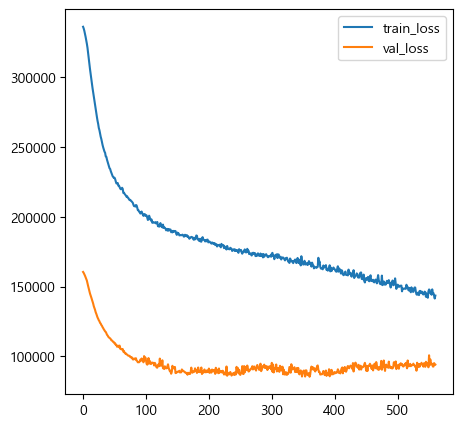

In [372]:
plt.plot(train_loss_hk2_22, label = 'train_loss')
plt.plot(val_loss_hk2_22, label = 'val_loss')
plt.legend()
plt.show()


In [373]:
val_r2_hk2_22, val_mae_hk2_22 = test(valid_loader_hk2_22, model_hk2_22,isEDR=isEDR)

y_label :  48.599666595458984 y_pred :  0.0
y_label :  2.6453332901000977 y_pred :  2789.1962890625
y_label :  299.00299072265625 y_pred :  459.6343688964844
y_label :  1468.411376953125 y_pred :  231.565185546875
y_label :  3172.561279296875 y_pred :  163.11512756347656
y_label :  3313.206298828125 y_pred :  738.3477783203125
y_label :  4542.36083984375 y_pred :  3292.2431640625
y_label :  6785.12890625 y_pred :  3797.28564453125
y_label :  4274.16552734375 y_pred :  4229.9052734375
y_label :  5513.5419921875 y_pred :  5161.71728515625
y_label :  4897.48291015625 y_pred :  4242.693359375
y_label :  8662.6064453125 y_pred :  3623.07568359375
y_label :  6527.38720703125 y_pred :  5055.798828125
y_label :  9667.23046875 y_pred :  5854.42333984375
y_label :  9102.384765625 y_pred :  5136.8955078125
y_label :  11106.7431640625 y_pred :  5746.6259765625
y_label :  11067.302734375 y_pred :  6958.810546875
y_label :  9860.869140625 y_pred :  6611.0185546875
y_label :  7192.80419921875 y_pred 

In [374]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_22, test_mae_hk2_22 = test(test_loader_hk2_22, model_hk2_22, isEDR=isEDR)
y_label_hk2_22 = y_label_plt
y_pred_hk2_22 = y_pred_plt

y_label :  815.8056640625 y_pred :  1639.996337890625
y_label :  614.3186645507812 y_pred :  306.81866455078125
y_label :  422.0606689453125 y_pred :  263.3205261230469
y_label :  1092.855712890625 y_pred :  493.53424072265625
y_label :  1295.65966796875 y_pred :  364.56732177734375
y_label :  1305.4940185546875 y_pred :  237.54747009277344
y_label :  2220.09912109375 y_pred :  556.476318359375
y_label :  1574.2213134765625 y_pred :  530.1069946289062
y_label :  1022.1356811523438 y_pred :  712.94140625
y_label :  746.5416870117188 y_pred :  493.2618103027344
y_label :  2212.597900390625 y_pred :  133.2609100341797
y_label :  2452.279052734375 y_pred :  219.43307495117188
y_label :  2941.931640625 y_pred :  0.0
y_label :  875.1216430664062 y_pred :  0.0
y_label :  250.03533935546875 y_pred :  563.5765991210938
y_label :  1479.8929443359375 y_pred :  341.34808349609375
y_label :  1217.02734375 y_pred :  306.09710693359375
y_label :  927.086669921875 y_pred :  1017.9129028320312
y_label 

y_label :  1060.59228515625 y_pred :  703.3638916015625
y_label :  254.8693389892578 y_pred :  2385.369873046875
y_label :  2619.51904296875 y_pred :  2669.998291015625
y_label :  5046.78857421875 y_pred :  2406.35888671875
y_label :  6229.44921875 y_pred :  3279.46484375
y_label :  4738.990234375 y_pred :  1377.8670654296875
y_label :  4700.6328125 y_pred :  1457.9674072265625
y_label :  7902.7412109375 y_pred :  1605.0181884765625
y_label :  5257.14208984375 y_pred :  1944.70654296875
y_label :  5203.23583984375 y_pred :  2069.47314453125
y_label :  4878.978515625 y_pred :  1025.5089111328125
y_label :  6341.26220703125 y_pred :  747.9324951171875
y_label :  5039.00830078125 y_pred :  717.8369750976562
y_label :  4771.3818359375 y_pred :  695.3970947265625
y_label :  5476.89599609375 y_pred :  537.2718505859375
y_label :  5422.99755859375 y_pred :  507.27069091796875
y_label :  4454.98681640625 y_pred :  492.7908935546875
y_label :  3612.319091796875 y_pred :  481.6710510253906
y_lab

xlim is (-739.682421875, 15533.330859375)
ylim is (-604.7037109375, 12698.7779296875)


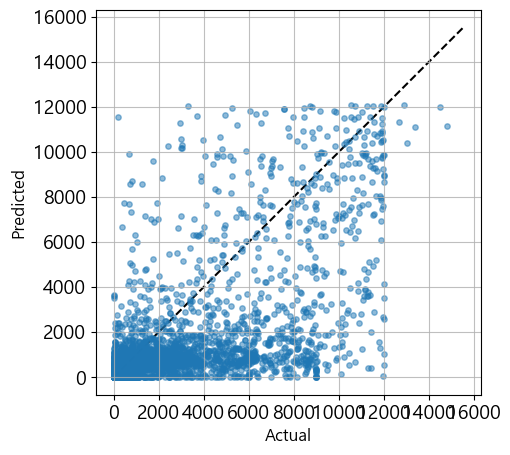

In [375]:
plot_scatter(y_label_hk2_22,y_pred_hk2_22)

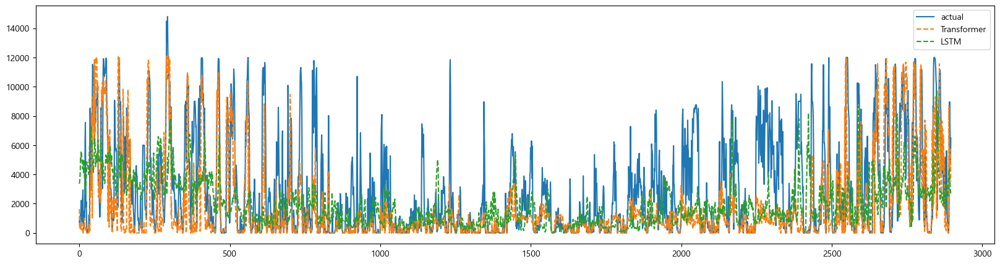

In [376]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_22[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_22[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_22[_start:_end], '--',label = 'LSTM')

plt.legend()


In [377]:
#hk2_4일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_30.parameters(), lr=lr)
train_loss_hk2_30, val_loss_hk2_30 = trainer(train_loader_hk2_30, valid_loader_hk2_30, model_hk2_30, criterion, optimizer, target='hk2', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk2_30.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7404658799927182
MAE Loss:  3728.5781808803044
Validation
R2 score: -0.7065568745820712
MAE Loss:  3478.053229452419
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7334148906463283
MAE Loss:  3714.6768134696213
Validation
R2 score: -0.6975758721235368
MAE Loss:  3462.456074185281
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7233202917990134
MAE Loss:  3695.696248175194
Validation
R2 score: -0.6856494169877376
MAE Loss:  3442.7614780912213
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7105788400362607
MAE Loss:  3672.9161040653657
Validation
R2 score: -0.6713332569174373
MAE Loss:  3420.2104942264136
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6956798915354068
MAE Loss:  3647.6227804568493
Validation
R2 score: -0.6549304242074667
MAE Loss:  3395.6348873453435
최신화
Epoch 5/1000
TRAIN
R2 score: -0.6788537115026716
MAE Loss:  3620.5386555235373
Validation
R2 score: -0.63692172175286
MAE Loss:  3370.259463628207
최신화
Epoch 6/1000
TRAIN
R2 score: -0.660913174547384
MAE Loss:  3592.9735163820096
Vali

R2 score: 0.18388665136643312
MAE Loss:  2489.416507982122
Validation
R2 score: 0.25224973426922315
MAE Loss:  2313.773073520209
최신화
Epoch 54/1000
TRAIN
R2 score: 0.19441045097508147
MAE Loss:  2477.1320323448945
Validation
R2 score: 0.231330233260292
MAE Loss:  2308.7579155628155
최신화
Epoch 55/1000
TRAIN
R2 score: 0.20418312476377054
MAE Loss:  2475.990628876999
Validation
R2 score: 0.2539260054464758
MAE Loss:  2310.7840664364167
Epoch 56/1000
TRAIN
R2 score: 0.19858544517330223
MAE Loss:  2473.676149487475
Validation
R2 score: 0.2670654029006041
MAE Loss:  2269.7475955298723
최신화
Epoch 57/1000
TRAIN
R2 score: 0.225640009899563
MAE Loss:  2449.436186382933
Validation
R2 score: 0.2647514114121836
MAE Loss:  2269.714224523977
Epoch 58/1000
TRAIN
R2 score: 0.231739284604075
MAE Loss:  2447.849220296774
Validation
R2 score: 0.2726523216077852
MAE Loss:  2277.5581386177023
Epoch 59/1000
TRAIN
R2 score: 0.2357007723308473
MAE Loss:  2442.0007796710347
Validation
R2 score: 0.2966145875851415


R2 score: 0.40597294710536713
MAE Loss:  2241.04186006587
Validation
R2 score: 0.4458563440278135
MAE Loss:  2032.267082477088
Epoch 109/1000
TRAIN
R2 score: 0.4177361347125519
MAE Loss:  2196.7440689788273
Validation
R2 score: 0.4336858622539158
MAE Loss:  2016.191844009951
최신화
Epoch 110/1000
TRAIN
R2 score: 0.4165109325856925
MAE Loss:  2194.1332878167805
Validation
R2 score: 0.4366602932473872
MAE Loss:  2027.0252996798995
Epoch 111/1000
TRAIN
R2 score: 0.41939564396365003
MAE Loss:  2190.9828773231925
Validation
R2 score: 0.4435413839246215
MAE Loss:  2007.4870131458788
최신화
Epoch 112/1000
TRAIN
R2 score: 0.4226628549641308
MAE Loss:  2189.512711278563
Validation
R2 score: 0.4475942776385383
MAE Loss:  2006.438130325481
최신화
Epoch 113/1000
TRAIN
R2 score: 0.42625947351192517
MAE Loss:  2179.732463908131
Validation
R2 score: 0.44207468030401
MAE Loss:  2018.045510437603
Epoch 114/1000
TRAIN
R2 score: 0.43237501199434647
MAE Loss:  2167.9869930505447
Validation
R2 score: 0.447486037805

R2 score: 0.4633407970741774
MAE Loss:  2094.626455851484
Validation
R2 score: 0.4732418228788433
MAE Loss:  1932.368894867257
Epoch 164/1000
TRAIN
R2 score: 0.4774528326336137
MAE Loss:  2068.2571464190205
Validation
R2 score: 0.4737589307290577
MAE Loss:  1925.925184320967
Epoch 165/1000
TRAIN
R2 score: 0.470884224686702
MAE Loss:  2090.095819708774
Validation
R2 score: 0.47292787558347016
MAE Loss:  1927.3849072919122
Epoch 166/1000
TRAIN
R2 score: 0.46999725735014664
MAE Loss:  2084.9847538278973
Validation
R2 score: 0.4761701643025057
MAE Loss:  1926.2035428249633
Epoch 167/1000
TRAIN
R2 score: 0.4802851338568692
MAE Loss:  2065.787007483359
Validation
R2 score: 0.4699475069694353
MAE Loss:  1920.6384031687678
Epoch 168/1000
TRAIN
R2 score: 0.4754950994288596
MAE Loss:  2076.0631791848127
Validation
R2 score: 0.4855168721835884
MAE Loss:  1910.513214438818
Epoch 169/1000
TRAIN
R2 score: 0.4776410549508239
MAE Loss:  2062.7954312945294
Validation
R2 score: 0.47335214072740794
MAE L

R2 score: 0.49309838658289185
MAE Loss:  2019.35640158816
Validation
R2 score: 0.48732983597349144
MAE Loss:  1890.3538633092253
Epoch 219/1000
TRAIN
R2 score: 0.4960918637828673
MAE Loss:  2017.6636445676372
Validation
R2 score: 0.4933324496786795
MAE Loss:  1882.6331050199105
Epoch 220/1000
TRAIN
R2 score: 0.4941387332950129
MAE Loss:  2012.0805993131742
Validation
R2 score: 0.477787822296456
MAE Loss:  1904.2070354630268
Epoch 221/1000
TRAIN
R2 score: 0.4905379309344329
MAE Loss:  2012.1062779219726
Validation
R2 score: 0.4833396951653104
MAE Loss:  1896.5063669539225
Epoch 222/1000
TRAIN
R2 score: 0.48936442784932244
MAE Loss:  2027.5729726571424
Validation
R2 score: 0.4827726642865442
MAE Loss:  1910.2025765768442
Epoch 223/1000
TRAIN
R2 score: 0.5003115210052127
MAE Loss:  2007.415483538733
Validation
R2 score: 0.4772098324486268
MAE Loss:  1906.2322129423096
Epoch 224/1000
TRAIN
R2 score: 0.4900999482069901
MAE Loss:  2017.101867588445
Validation
R2 score: 0.4798215084124471
MAE

R2 score: 0.5089823455433593
MAE Loss:  1992.4592176305482
Validation
R2 score: 0.47558834532752947
MAE Loss:  1894.0067503425619
Epoch 274/1000
TRAIN
R2 score: 0.5051021447419204
MAE Loss:  1979.8180002396134
Validation
R2 score: 0.4833001897155246
MAE Loss:  1887.574127516815
Epoch 275/1000
TRAIN
R2 score: 0.5040905234044746
MAE Loss:  1982.7499515661561
Validation
R2 score: 0.4559358846572138
MAE Loss:  1945.6207819576364
Epoch 276/1000
TRAIN
R2 score: 0.5012946929710203
MAE Loss:  2001.9150269400036
Validation
R2 score: 0.4677112349938919
MAE Loss:  1919.401505611712
Epoch 277/1000
TRAIN
R2 score: 0.5017547574892102
MAE Loss:  1985.9953074816087
Validation
R2 score: 0.48590195700899874
MAE Loss:  1890.04817505008
Epoch 278/1000
TRAIN
R2 score: 0.5055779715668857
MAE Loss:  1979.3763809331556
Validation
R2 score: 0.48075709179359216
MAE Loss:  1886.7753028658997
Epoch 279/1000
TRAIN
R2 score: 0.5094096226010772
MAE Loss:  1967.0274641726228
Validation
R2 score: 0.46437411581004395
M

R2 score: 0.517638677974767
MAE Loss:  1947.1454666631257
Validation
R2 score: 0.4704463600264559
MAE Loss:  1902.1875377682197
Epoch 329/1000
TRAIN
R2 score: 0.5201830297488446
MAE Loss:  1923.0514153983856
Validation
R2 score: 0.4743195866046406
MAE Loss:  1892.5545353536058
Epoch 330/1000
TRAIN
R2 score: 0.5239044716869521
MAE Loss:  1928.3605871638324
Validation
R2 score: 0.46870273258687944
MAE Loss:  1899.3776302779436
Epoch 331/1000
TRAIN
R2 score: 0.5265883931571551
MAE Loss:  1925.3617703274115
Validation
R2 score: 0.4862364508035676
MAE Loss:  1887.2116464813519
Epoch 332/1000
TRAIN
R2 score: 0.5182772370897373
MAE Loss:  1951.5787323723882
Validation
R2 score: 0.47047846849607433
MAE Loss:  1901.554116948112
Epoch 333/1000
TRAIN
R2 score: 0.5228476097597083
MAE Loss:  1934.4413936583862
Validation
R2 score: 0.47508781799154975
MAE Loss:  1882.386539781886
Epoch 334/1000
TRAIN
R2 score: 0.5248023625946074
MAE Loss:  1926.475701283205
Validation
R2 score: 0.48546819887979353
M

R2 score: 0.5191272006835652
MAE Loss:  1930.2298831012702
Validation
R2 score: 0.47081574541225313
MAE Loss:  1898.7818248819071
Epoch 384/1000
TRAIN
R2 score: 0.5231130043038601
MAE Loss:  1915.0304789606464
Validation
R2 score: 0.4652510183292269
MAE Loss:  1886.6110718403825
Epoch 385/1000
TRAIN
R2 score: 0.5245375664799103
MAE Loss:  1932.6703030685042
Validation
R2 score: 0.4521960767324277
MAE Loss:  1925.3083534238922
Epoch 386/1000
TRAIN
R2 score: 0.5317918683161401
MAE Loss:  1900.6978960382414
Validation
R2 score: 0.46912393137539254
MAE Loss:  1887.0963587349909
Epoch 387/1000
TRAIN
R2 score: 0.5286398709784431
MAE Loss:  1909.3384336382182
Validation
R2 score: 0.4575245224768708
MAE Loss:  1891.132645581365
Epoch 388/1000
TRAIN
R2 score: 0.526055325455825
MAE Loss:  1930.2815929407257
Validation
R2 score: 0.45170215991387896
MAE Loss:  1930.538122600597
Epoch 389/1000
TRAIN
R2 score: 0.5166780397357706
MAE Loss:  1927.3586913031297
Validation
R2 score: 0.4582280333115746
M

R2 score: 0.5414880675161609
MAE Loss:  1865.7666397611113
Validation
R2 score: 0.4677887935395231
MAE Loss:  1889.833642365283
Epoch 439/1000
TRAIN
R2 score: 0.5405586641032747
MAE Loss:  1868.1648970037272
Validation
R2 score: 0.4490385115982026
MAE Loss:  1916.6885129839277
Epoch 440/1000
TRAIN
R2 score: 0.5447609357082859
MAE Loss:  1869.9155051101884
Validation
R2 score: 0.4235267172060522
MAE Loss:  1961.5939180383887
Epoch 441/1000
TRAIN
R2 score: 0.5306115651172911
MAE Loss:  1895.3226339683386
Validation
R2 score: 0.49029388480547087
MAE Loss:  1875.057117579728
Epoch 442/1000
TRAIN
R2 score: 0.5279476117296662
MAE Loss:  1914.9651622947936
Validation
R2 score: 0.4353506595098604
MAE Loss:  1940.6525682948381
Epoch 443/1000
TRAIN
R2 score: 0.535089028161359
MAE Loss:  1889.3029851694057
Validation
R2 score: 0.4452579571129761
MAE Loss:  1938.8821679410564
Epoch 444/1000
TRAIN
R2 score: 0.5384473080871024
MAE Loss:  1880.4063197831972
Validation
R2 score: 0.4693859938258531
MAE

R2 score: 0.5378259602511108
MAE Loss:  1870.0690201948803
Validation
R2 score: 0.4824281598441389
MAE Loss:  1874.7432399298577
Epoch 494/1000
TRAIN
R2 score: 0.5496205014397683
MAE Loss:  1863.9958752774924
Validation
R2 score: 0.47155480647687387
MAE Loss:  1879.8230472279763
Epoch 495/1000
TRAIN
R2 score: 0.5533440902767028
MAE Loss:  1846.9826429926807
Validation
R2 score: 0.47253994115650444
MAE Loss:  1887.294128502619
Epoch 496/1000
TRAIN
R2 score: 0.5434473885465944
MAE Loss:  1855.7475228172414
Validation
R2 score: 0.4946498998122649
MAE Loss:  1851.743057441298
Epoch 497/1000
TRAIN
R2 score: 0.5466389458868848
MAE Loss:  1865.7435188570264
Validation
R2 score: 0.4529589457772243
MAE Loss:  1900.9007242541975
Epoch 498/1000
TRAIN
R2 score: 0.5488262676871345
MAE Loss:  1855.9595756800145
Validation
R2 score: 0.46584127079825877
MAE Loss:  1893.8590285117666
Epoch 499/1000
TRAIN
R2 score: 0.5447406474126657
MAE Loss:  1848.6047809335507
Validation
R2 score: 0.47812762973210066

R2 score: 0.5524131117988093
MAE Loss:  1840.3350818880958
Validation
R2 score: 0.47460328024131093
MAE Loss:  1857.1797451201478
Epoch 549/1000
TRAIN
R2 score: 0.5541696600840444
MAE Loss:  1838.5629160873125
Validation
R2 score: 0.45915169212497475
MAE Loss:  1886.6245398281587
Epoch 550/1000
TRAIN
R2 score: 0.54524745907647
MAE Loss:  1851.1067175293547
Validation
R2 score: 0.4856634680958216
MAE Loss:  1848.9681903188305
Epoch 551/1000
TRAIN
R2 score: 0.5535851791564081
MAE Loss:  1833.7670331027373
Validation
R2 score: 0.4916481136251025
MAE Loss:  1846.315261449292
Epoch 552/1000
TRAIN
R2 score: 0.5603814949777512
MAE Loss:  1825.1415485714465
Validation
R2 score: 0.48566611031260354
MAE Loss:  1868.522690299019
Epoch 553/1000
TRAIN
R2 score: 0.5463909178896145
MAE Loss:  1852.5671226379595
Validation
R2 score: 0.4459491045650613
MAE Loss:  1895.5788002107838
Epoch 554/1000
TRAIN
R2 score: 0.5536115629926872
MAE Loss:  1837.3574725022252
Validation
R2 score: 0.4556024750447316
MA

R2 score: 0.5595321762346581
MAE Loss:  1827.69363591155
Validation
R2 score: 0.4600139632693554
MAE Loss:  1882.818327692143
Epoch 604/1000
TRAIN
R2 score: 0.5594150213995472
MAE Loss:  1806.3362929390428
Validation
R2 score: 0.4935414741841766
MAE Loss:  1837.9879265662616
Epoch 605/1000
TRAIN
R2 score: 0.5682449712410023
MAE Loss:  1792.8529992934975
Validation
R2 score: 0.4800378021603019
MAE Loss:  1863.4297224026511
Epoch 606/1000
TRAIN
R2 score: 0.5614150702641081
MAE Loss:  1802.3186012136014
Validation
R2 score: 0.4626102845026442
MAE Loss:  1878.3532291529034
Epoch 607/1000
TRAIN
R2 score: 0.5605524570395932
MAE Loss:  1809.4143133887058
Validation
R2 score: 0.4719422620063798
MAE Loss:  1857.197548272269
Epoch 608/1000
TRAIN
R2 score: 0.5573087723096608
MAE Loss:  1826.4405107620971
Validation
R2 score: 0.4704703004766876
MAE Loss:  1884.6582333474405
Epoch 609/1000
TRAIN
R2 score: 0.5661922482823522
MAE Loss:  1797.0357559868867
Validation
R2 score: 0.48424454545093554
MAE 

R2 score: 0.5706427339946778
MAE Loss:  1792.54986682137
Validation
R2 score: 0.4751190317452618
MAE Loss:  1864.574048062899
Epoch 659/1000
TRAIN
R2 score: 0.5758095049928031
MAE Loss:  1777.712997903089
Validation
R2 score: 0.46332244925594757
MAE Loss:  1872.3818847078085
Epoch 660/1000
TRAIN
R2 score: 0.5674760016064009
MAE Loss:  1802.5559736634693
Validation
R2 score: 0.45624566954429924
MAE Loss:  1887.5291808201118
Epoch 661/1000
TRAIN
R2 score: 0.5765702132733443
MAE Loss:  1773.717500149279
Validation
R2 score: 0.47696172063531495
MAE Loss:  1857.7877997906264
Epoch 662/1000
TRAIN
R2 score: 0.5614327615102468
MAE Loss:  1806.3675513682658
Validation
R2 score: 0.4980132220919289
MAE Loss:  1844.9185139999645
Epoch 663/1000
TRAIN
R2 score: 0.5632666952689178
MAE Loss:  1824.6402989498763
Validation
R2 score: 0.4596202739805665
MAE Loss:  1884.2008650941382
Epoch 664/1000
TRAIN
R2 score: 0.569932673191366
MAE Loss:  1797.6431154556562
Validation
R2 score: 0.46213149847448787
MAE

R2 score: 0.576400380426384
MAE Loss:  1772.2498423943578
Validation
R2 score: 0.45918794570050314
MAE Loss:  1875.115364564348
Epoch 714/1000
TRAIN
R2 score: 0.5682131407928692
MAE Loss:  1793.2258466943606
Validation
R2 score: 0.4397407644783269
MAE Loss:  1903.3715337842489
Epoch 715/1000
TRAIN
R2 score: 0.551199789611938
MAE Loss:  1824.7712580505656
Validation
R2 score: 0.4971897709893093
MAE Loss:  1836.4736443112856
Epoch 716/1000
TRAIN
R2 score: 0.5782805201554286
MAE Loss:  1770.583655784082
Validation
R2 score: 0.45198795186934515
MAE Loss:  1900.8228470360552
Epoch 717/1000
TRAIN
R2 score: 0.5849613876722406
MAE Loss:  1752.1711933903011
Validation
R2 score: 0.4537536914674648
MAE Loss:  1886.267666785897
Epoch 718/1000
TRAIN
R2 score: 0.5763829253887299
MAE Loss:  1762.8011933115733
Validation
R2 score: 0.45360187627346205
MAE Loss:  1892.7178584983546
Epoch 719/1000
TRAIN
R2 score: 0.5732501843841342
MAE Loss:  1759.1755553153691
Validation
R2 score: 0.47901324235762244
MA

R2 score: 0.5855045504519834
MAE Loss:  1743.0623338257221
Validation
R2 score: 0.4986414712336431
MAE Loss:  1845.171210903961
Epoch 769/1000
TRAIN
R2 score: 0.5855461496019161
MAE Loss:  1740.3533954219374
Validation
R2 score: 0.4661787977151052
MAE Loss:  1881.5776762689572
Epoch 770/1000
TRAIN
R2 score: 0.558761419968354
MAE Loss:  1816.0443502904047
Validation
R2 score: 0.4535405193848421
MAE Loss:  1901.3265178426252
Epoch 771/1000
TRAIN
R2 score: 0.5847816176350553
MAE Loss:  1749.2431430010306
Validation
R2 score: 0.45608154171800197
MAE Loss:  1880.903694658192
Epoch 772/1000
TRAIN
R2 score: 0.5820787625007016
MAE Loss:  1758.0395780368676
Validation
R2 score: 0.4559290075194766
MAE Loss:  1898.7840822547544
Epoch 773/1000
TRAIN
R2 score: 0.580204489342352
MAE Loss:  1755.7780813289007
Validation
R2 score: 0.49105051510441444
MAE Loss:  1856.018891298473
Epoch 774/1000
TRAIN
R2 score: 0.5741497000437196
MAE Loss:  1769.1578150595303
Validation
R2 score: 0.4815137361237163
MAE 

R2 score: 0.5926458022249583
MAE Loss:  1724.9270853971661
Validation
R2 score: 0.4908048446656694
MAE Loss:  1849.5130779303156
Epoch 824/1000
TRAIN
R2 score: 0.5878889551255643
MAE Loss:  1733.8125412702002
Validation
R2 score: 0.45337434703340485
MAE Loss:  1896.5914624002182
Epoch 825/1000
TRAIN
R2 score: 0.5776890894432336
MAE Loss:  1751.4094670165525
Validation
R2 score: 0.45527294002045227
MAE Loss:  1882.7419408790092
Epoch 826/1000
TRAIN
R2 score: 0.5825067689582247
MAE Loss:  1740.748452530726
Validation
R2 score: 0.4890791421709113
MAE Loss:  1833.2328906779428
Epoch 827/1000
TRAIN
R2 score: 0.5820958919042736
MAE Loss:  1742.8190197733663
Validation
R2 score: 0.4735533741331196
MAE Loss:  1866.5427499920088
Epoch 828/1000
TRAIN
R2 score: 0.5848885744566008
MAE Loss:  1745.8751434220383
Validation
R2 score: 0.48437876879673736
MAE Loss:  1855.9509911244033
Epoch 829/1000
TRAIN
R2 score: 0.5869194131270803
MAE Loss:  1729.067533697571
Validation
R2 score: 0.495310733642373
M

R2 score: 0.6040317039580578
MAE Loss:  1694.4422780135933
Validation
R2 score: 0.4862895744027863
MAE Loss:  1871.6120918856527
Epoch 879/1000
TRAIN
R2 score: 0.571722929294602
MAE Loss:  1766.1547326962761
Validation
R2 score: 0.47752139061030996
MAE Loss:  1864.6600165148263
Epoch 880/1000
TRAIN
R2 score: 0.5793813638267437
MAE Loss:  1757.1721350132818
Validation
R2 score: 0.48536472998740177
MAE Loss:  1860.3995225145452
Epoch 881/1000
TRAIN
R2 score: 0.5962647660508391
MAE Loss:  1717.1679362210612
Validation
R2 score: 0.4604469405974514
MAE Loss:  1877.0614365498577
Epoch 882/1000
TRAIN
R2 score: 0.5958471871255879
MAE Loss:  1702.4252291703333
Validation
R2 score: 0.4917111470396399
MAE Loss:  1850.539063948108
Epoch 883/1000
TRAIN
R2 score: 0.5947008369187265
MAE Loss:  1718.3724278314112
Validation
R2 score: 0.4777106717377444
MAE Loss:  1867.5415739473913
Epoch 884/1000
TRAIN
R2 score: 0.6018507750347484
MAE Loss:  1701.2605944245176
Validation
R2 score: 0.4562797550793687
M

R2 score: 0.5981470245659728
MAE Loss:  1714.0457135715203
Validation
R2 score: 0.4742393603584618
MAE Loss:  1882.0096397734703
Epoch 934/1000
TRAIN
R2 score: 0.5994623524114571
MAE Loss:  1707.1263733439348
Validation
R2 score: 0.46253866536155663
MAE Loss:  1908.8864449554212
Epoch 935/1000
TRAIN
R2 score: 0.5981881151340792
MAE Loss:  1717.7822389671096
Validation
R2 score: 0.46500260268790705
MAE Loss:  1886.2629197378806
Epoch 936/1000
TRAIN
R2 score: 0.5888289939411739
MAE Loss:  1732.213100544385
Validation
R2 score: 0.4548105774270691
MAE Loss:  1889.9784872535233
Epoch 937/1000
TRAIN
R2 score: 0.6022628899046347
MAE Loss:  1695.7093256827352
Validation
R2 score: 0.4647285831466128
MAE Loss:  1904.9452680439313
Epoch 938/1000
TRAIN
R2 score: 0.5885738933276008
MAE Loss:  1723.5798499920702
Validation
R2 score: 0.5045906404904397
MAE Loss:  1848.889646828118
Epoch 939/1000
TRAIN
R2 score: 0.5964393494358717
MAE Loss:  1717.2881847997237
Validation
R2 score: 0.4576083388837753
M

R2 score: 0.6050961321983778
MAE Loss:  1685.9506844481903
Validation
R2 score: 0.44633231696277975
MAE Loss:  1905.173467021303
Epoch 989/1000
TRAIN
R2 score: 0.5953656127042732
MAE Loss:  1708.8686149210996
Validation
R2 score: 0.4926236768554635
MAE Loss:  1858.360789678371
Epoch 990/1000
TRAIN
R2 score: 0.6029403746247157
MAE Loss:  1689.0204467453111
Validation
R2 score: 0.45465147481803714
MAE Loss:  1909.5340424604126
Epoch 991/1000
TRAIN
R2 score: 0.5903175886138035
MAE Loss:  1722.5402952875936
Validation
R2 score: 0.43563746061889763
MAE Loss:  1905.9164747745415
Epoch 992/1000
TRAIN
R2 score: 0.604681163117457
MAE Loss:  1696.296837692684
Validation
R2 score: 0.4330075319579514
MAE Loss:  1918.6013725905746
Epoch 993/1000
TRAIN
R2 score: 0.6068503559914338
MAE Loss:  1673.3914702978934
Validation
R2 score: 0.48274934565242167
MAE Loss:  1871.790972205912
Epoch 994/1000
TRAIN
R2 score: 0.6126959011588011
MAE Loss:  1658.82275930573
Validation
R2 score: 0.4696297922975964
MAE 

<All keys matched successfully>

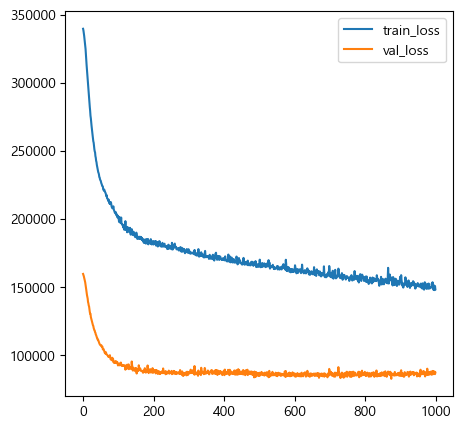

In [378]:
plt.plot(train_loss_hk2_30, label = 'train_loss')
plt.plot(val_loss_hk2_30, label = 'val_loss')
plt.legend()
plt.show()


In [379]:
val_r2_hk2_30, val_mae_hk2_30 = test(valid_loader_hk2_30, model_hk2_30,isEDR=isEDR)

y_label :  4274.16552734375 y_pred :  4218.478515625
y_label :  5513.5419921875 y_pred :  3799.5126953125
y_label :  4897.48291015625 y_pred :  3018.9091796875
y_label :  8662.6064453125 y_pred :  2543.396484375
y_label :  6527.38720703125 y_pred :  3622.944580078125
y_label :  9667.23046875 y_pred :  4607.36474609375
y_label :  9102.384765625 y_pred :  5590.3564453125
y_label :  11106.7431640625 y_pred :  6100.45703125
y_label :  11067.302734375 y_pred :  6678.8525390625
y_label :  9860.869140625 y_pred :  4987.96875
y_label :  7192.80419921875 y_pred :  5257.5986328125
y_label :  9593.9287109375 y_pred :  6313.62353515625
y_label :  13455.287109375 y_pred :  10465.8408203125
y_label :  14513.291015625 y_pred :  6173.43017578125
y_label :  12563.978515625 y_pred :  9390.7783203125
y_label :  13127.2109375 y_pred :  10757.3115234375
y_label :  13069.3876953125 y_pred :  9238.0009765625
y_label :  12867.294921875 y_pred :  9610.4501953125
y_label :  11915.947265625 y_pred :  9451.909179

In [380]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_30, test_mae_hk2_30 = test(test_loader_hk2_30, model_hk2_30, isEDR=isEDR)
y_label_hk2_30 = y_label_plt
y_pred_hk2_30 = y_pred_plt

y_label :  1022.1356811523438 y_pred :  740.029052734375
y_label :  746.5416870117188 y_pred :  240.04652404785156
y_label :  2212.597900390625 y_pred :  334.3470458984375
y_label :  2452.279052734375 y_pred :  356.7243957519531
y_label :  2941.931640625 y_pred :  98.37239837646484
y_label :  875.1216430664062 y_pred :  92.36327362060547
y_label :  250.03533935546875 y_pred :  417.9200134277344
y_label :  1479.8929443359375 y_pred :  515.7200317382812
y_label :  1217.02734375 y_pred :  547.6119384765625
y_label :  927.086669921875 y_pred :  3434.64794921875
y_label :  1577.48828125 y_pred :  663.9880981445312
y_label :  6235.2041015625 y_pred :  590.2828369140625
y_label :  7556.4091796875 y_pred :  885.6072387695312
y_label :  4068.4697265625 y_pred :  614.4954223632812
y_label :  1769.04931640625 y_pred :  775.914306640625
y_label :  2132.917724609375 y_pred :  841.2066650390625
y_label :  827.5123291015625 y_pred :  84.1344223022461
y_label :  34.78066635131836 y_pred :  43.79996109

y_label :  349.75634765625 y_pred :  641.759521484375
y_label :  147.5989990234375 y_pred :  427.9441223144531
y_label :  37.15299987792969 y_pred :  183.5459747314453
y_label :  0.0 y_pred :  393.4665222167969
y_label :  46.931331634521484 y_pred :  558.157470703125
y_label :  121.73233032226562 y_pred :  570.1698608398438
y_label :  46.56266784667969 y_pred :  588.5274658203125
y_label :  131.63699340820312 y_pred :  530.0009765625
y_label :  122.08633422851562 y_pred :  286.3282165527344
y_label :  90.95166778564453 y_pred :  729.447021484375
y_label :  470.30865478515625 y_pred :  841.3118286132812
y_label :  567.9796752929688 y_pred :  684.4832153320312
y_label :  352.9216613769531 y_pred :  616.4720458984375
y_label :  305.1636657714844 y_pred :  556.2265625
y_label :  720.7523193359375 y_pred :  637.0252685546875
y_label :  2099.025634765625 y_pred :  732.2476806640625
y_label :  3699.1240234375 y_pred :  725.60791015625
y_label :  2877.6005859375 y_pred :  617.0294189453125
y_l

xlim is (-739.682421875, 15533.330859375)
ylim is (-646.318603515625, 13572.690673828125)


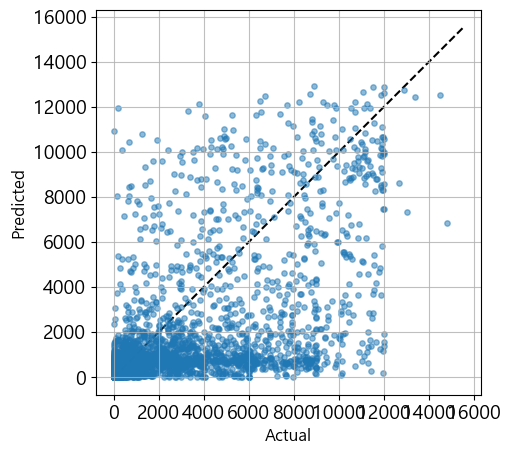

In [381]:
plot_scatter(y_label_hk2_30,y_pred_hk2_30)

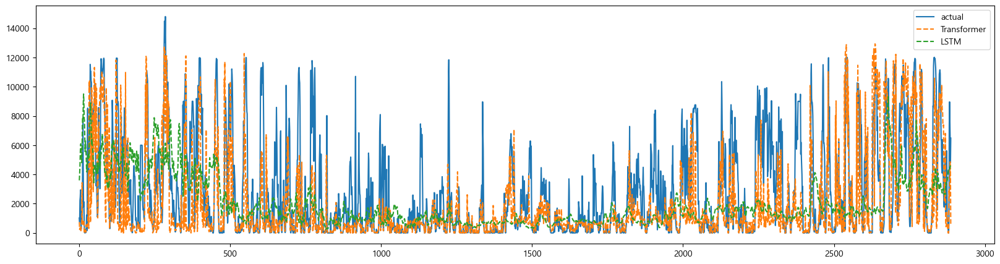

In [382]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_30[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_30[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_30[_start:_end], '--',label = 'LSTM')

plt.legend()


In [383]:
#hk2_5일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2_38.parameters(), lr=lr)
train_loss_hk2_38, val_loss_hk2_38 = trainer(train_loader_hk2_38, valid_loader_hk2_38, model_hk2_38, criterion, optimizer, target='hk2', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk2_38.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7395730066537387
MAE Loss:  3727.8861102986684
Validation
R2 score: -0.7024316137013118
MAE Loss:  3466.812906338176
최신화
Epoch 1/1000
TRAIN
R2 score: -0.7326174289085141
MAE Loss:  3714.1969381444087
Validation
R2 score: -0.6936263705405328
MAE Loss:  3451.5078995464305
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7227014781244294
MAE Loss:  3695.5480982008826
Validation
R2 score: -0.6819528925172775
MAE Loss:  3432.200155018816
최신화
Epoch 3/1000
TRAIN
R2 score: -0.7101989560317159
MAE Loss:  3673.164699656038
Validation
R2 score: -0.6679114333686349
MAE Loss:  3410.03421565079
최신화
Epoch 4/1000
TRAIN
R2 score: -0.6955833514772267
MAE Loss:  3648.3132545385542
Validation
R2 score: -0.65186259740781
MAE Loss:  3385.922659692368
최신화
Epoch 5/1000
TRAIN
R2 score: -0.679172023574713
MAE Loss:  3621.8003000075587
Validation
R2 score: -0.6342804245278026
MAE Loss:  3361.0333295450746
최신화
Epoch 6/1000
TRAIN
R2 score: -0.6615602594554904
MAE Loss:  3594.5888242646965
Valida

R2 score: 0.19028967681797848
MAE Loss:  2482.6399303811754
Validation
R2 score: 0.24198743141214618
MAE Loss:  2303.7258562730613
최신화
Epoch 55/1000
TRAIN
R2 score: 0.19996277432593235
MAE Loss:  2478.0767590700225
Validation
R2 score: 0.2422885651948451
MAE Loss:  2307.623988327295
Epoch 56/1000
TRAIN
R2 score: 0.20285593465089358
MAE Loss:  2473.8494631372623
Validation
R2 score: 0.2499352238548166
MAE Loss:  2288.8479005607787
최신화
Epoch 57/1000
TRAIN
R2 score: 0.2175297674647273
MAE Loss:  2447.8288843002883
Validation
R2 score: 0.2738825791985712
MAE Loss:  2274.20721242277
최신화
Epoch 58/1000
TRAIN
R2 score: 0.21952154856707562
MAE Loss:  2445.468896339974
Validation
R2 score: 0.25076202574921513
MAE Loss:  2280.115670499015
최신화
Epoch 59/1000
TRAIN
R2 score: 0.2248871834847478
MAE Loss:  2443.5992635100088
Validation
R2 score: 0.2427894219407103
MAE Loss:  2296.0352853775366
Epoch 60/1000
TRAIN
R2 score: 0.2342102302482818
MAE Loss:  2428.0288414019524
Validation
R2 score: 0.2791299

R2 score: 0.42498501079250495
MAE Loss:  2182.3499049060897
Validation
R2 score: 0.43127262447380876
MAE Loss:  2026.1249705483797
Epoch 110/1000
TRAIN
R2 score: 0.4198737729262312
MAE Loss:  2179.1865111388574
Validation
R2 score: 0.38211261343760605
MAE Loss:  2093.432233483008
Epoch 111/1000
TRAIN
R2 score: 0.41636039118811075
MAE Loss:  2186.3238875455486
Validation
R2 score: 0.3706845400334964
MAE Loss:  2110.9945483301626
Epoch 112/1000
TRAIN
R2 score: 0.42613831097031196
MAE Loss:  2183.303917973041
Validation
R2 score: 0.4218042780846293
MAE Loss:  2027.5796687442341
Epoch 113/1000
TRAIN
R2 score: 0.43496768951360465
MAE Loss:  2166.0093079474273
Validation
R2 score: 0.4449926918924336
MAE Loss:  2004.0708700180035
최신화
Epoch 114/1000
TRAIN
R2 score: 0.4292904083787834
MAE Loss:  2167.05706522785
Validation
R2 score: 0.41529326795382937
MAE Loss:  2043.2731923968356
Epoch 115/1000
TRAIN
R2 score: 0.43024181444271536
MAE Loss:  2172.842074058193
Validation
R2 score: 0.40783747574

R2 score: 0.4809695712804648
MAE Loss:  2052.557384050654
Validation
R2 score: 0.4164724948997873
MAE Loss:  2020.2406218583858
Epoch 165/1000
TRAIN
R2 score: 0.4770048223686164
MAE Loss:  2064.05502432043
Validation
R2 score: 0.446510562056302
MAE Loss:  1973.5616851140003
Epoch 166/1000
TRAIN
R2 score: 0.46788811882272774
MAE Loss:  2077.616278492686
Validation
R2 score: 0.47326698181703497
MAE Loss:  1911.314406036326
Epoch 167/1000
TRAIN
R2 score: 0.48868030135415985
MAE Loss:  2053.6067398254895
Validation
R2 score: 0.48091367614796576
MAE Loss:  1911.688121493078
Epoch 168/1000
TRAIN
R2 score: 0.4758960320014156
MAE Loss:  2066.6300477934565
Validation
R2 score: 0.4784920957485752
MAE Loss:  1918.1571639190358
Epoch 169/1000
TRAIN
R2 score: 0.4864764582638852
MAE Loss:  2045.8916650052688
Validation
R2 score: 0.47490249893686587
MAE Loss:  1927.7053941032784
Epoch 170/1000
TRAIN
R2 score: 0.48077817532410305
MAE Loss:  2051.9856985803763
Validation
R2 score: 0.48170707735927853
M

R2 score: 0.4962639295458987
MAE Loss:  1995.2074265137423
Validation
R2 score: 0.4590731947834755
MAE Loss:  1911.4573886842463
Epoch 220/1000
TRAIN
R2 score: 0.5097916940349759
MAE Loss:  1972.5031997567166
Validation
R2 score: 0.5059519165318505
MAE Loss:  1831.2378307564506
최신화
Epoch 221/1000
TRAIN
R2 score: 0.5112269238956086
MAE Loss:  1954.8239914034527
Validation
R2 score: 0.4854175757557755
MAE Loss:  1856.5300463208882
Epoch 222/1000
TRAIN
R2 score: 0.5096429929217426
MAE Loss:  1973.4894010841842
Validation
R2 score: 0.4303617151045759
MAE Loss:  1957.3515421606267
Epoch 223/1000
TRAIN
R2 score: 0.49838081387614264
MAE Loss:  1985.6190295120082
Validation
R2 score: 0.506162946864503
MAE Loss:  1830.8734703102405
최신화
Epoch 224/1000
TRAIN
R2 score: 0.5102920429074953
MAE Loss:  1964.2353746122335
Validation
R2 score: 0.4697389839222097
MAE Loss:  1875.4132900774935
Epoch 225/1000
TRAIN
R2 score: 0.511410931105455
MAE Loss:  1961.6333141141542
Validation
R2 score: 0.47591749829

R2 score: 0.5195882690571597
MAE Loss:  1934.635444941629
Validation
R2 score: 0.503450665144124
MAE Loss:  1824.2592503588419
Epoch 275/1000
TRAIN
R2 score: 0.5167268270470449
MAE Loss:  1928.1728449233358
Validation
R2 score: 0.46598361925179943
MAE Loss:  1881.5588554116737
Epoch 276/1000
TRAIN
R2 score: 0.5098125375290613
MAE Loss:  1947.4150363686806
Validation
R2 score: 0.4977605842652537
MAE Loss:  1824.4190567266473
Epoch 277/1000
TRAIN
R2 score: 0.48423813902056745
MAE Loss:  1995.1208235823435
Validation
R2 score: 0.47199344978028723
MAE Loss:  1859.3664159900698
Epoch 278/1000
TRAIN
R2 score: 0.5199368619776332
MAE Loss:  1935.675842039802
Validation
R2 score: 0.49825792917282274
MAE Loss:  1831.4312462256921
Epoch 279/1000
TRAIN
R2 score: 0.5142272772993339
MAE Loss:  1943.9761114934988
Validation
R2 score: 0.48523771168814944
MAE Loss:  1839.1465684985346
Epoch 280/1000
TRAIN
R2 score: 0.5188068998970154
MAE Loss:  1927.9620642925959
Validation
R2 score: 0.4946451015907132

R2 score: 0.5320592996381297
MAE Loss:  1895.4585470275895
Validation
R2 score: 0.5037142700230656
MAE Loss:  1815.9868000288836
Epoch 330/1000
TRAIN
R2 score: 0.529559574760752
MAE Loss:  1886.663961590804
Validation
R2 score: 0.4985428156086925
MAE Loss:  1829.4145834294582
Epoch 331/1000
TRAIN
R2 score: 0.5240140998986305
MAE Loss:  1909.5822015011777
Validation
R2 score: 0.4880488187114379
MAE Loss:  1837.4788863405201
Epoch 332/1000
TRAIN
R2 score: 0.5093523305524172
MAE Loss:  1933.6638253556343
Validation
R2 score: 0.5033766771508599
MAE Loss:  1805.4424793788394
Epoch 333/1000
TRAIN
R2 score: 0.5232246842344532
MAE Loss:  1903.188200288821
Validation
R2 score: 0.5008002268610452
MAE Loss:  1810.5098024459242
Epoch 334/1000
TRAIN
R2 score: 0.5195063060977076
MAE Loss:  1914.1925043231126
Validation
R2 score: 0.5093787606070161
MAE Loss:  1805.982851535697
Epoch 335/1000
TRAIN
R2 score: 0.5230854121790673
MAE Loss:  1912.1129640688514
Validation
R2 score: 0.4841165001601492
MAE L

R2 score: 0.5313152889400568
MAE Loss:  1886.4442259141947
Validation
R2 score: 0.4544206735755648
MAE Loss:  1908.4090584027815
Epoch 385/1000
TRAIN
R2 score: 0.5365220236262
MAE Loss:  1878.8027186334696
Validation
R2 score: 0.4508513623757203
MAE Loss:  1928.6896092677382
Epoch 386/1000
TRAIN
R2 score: 0.5275183794161509
MAE Loss:  1887.2005268048947
Validation
R2 score: 0.4302734240243915
MAE Loss:  1949.3526540879777
Epoch 387/1000
TRAIN
R2 score: 0.5317220522048839
MAE Loss:  1880.914627047786
Validation
R2 score: 0.43714354834971036
MAE Loss:  1952.0555944483444
Epoch 388/1000
TRAIN
R2 score: 0.5276484091076725
MAE Loss:  1894.5779921552612
Validation
R2 score: 0.4165686765475659
MAE Loss:  1970.182647775664
Epoch 389/1000
TRAIN
R2 score: 0.5204736784494415
MAE Loss:  1910.3942188007095
Validation
R2 score: 0.4572188212215803
MAE Loss:  1909.1100971784847
Epoch 390/1000
TRAIN
R2 score: 0.5348382712223472
MAE Loss:  1869.4965821204012
Validation
R2 score: 0.4367651975702054
MAE L

R2 score: 0.5586021390742743
MAE Loss:  1812.5774911383319
Validation
R2 score: 0.4662814321892955
MAE Loss:  1894.5878820408118
Epoch 440/1000
TRAIN
R2 score: 0.5548503617282046
MAE Loss:  1831.7621327585184
Validation
R2 score: 0.4315016564644766
MAE Loss:  1938.0982680548873
Epoch 441/1000
TRAIN
R2 score: 0.5474764898079832
MAE Loss:  1833.1803552512445
Validation
R2 score: 0.46332803848584436
MAE Loss:  1887.892335286812
Epoch 442/1000
TRAIN
R2 score: 0.5550691891037247
MAE Loss:  1823.915735825528
Validation
R2 score: 0.4663161309068826
MAE Loss:  1891.9875243842027
Epoch 443/1000
TRAIN
R2 score: 0.5651831125918572
MAE Loss:  1807.6356502879066
Validation
R2 score: 0.4411248665819335
MAE Loss:  1932.225588638035
Epoch 444/1000
TRAIN
R2 score: 0.553883933105932
MAE Loss:  1827.0935938405637
Validation
R2 score: 0.46922656840111976
MAE Loss:  1872.583153672292
Epoch 445/1000
TRAIN
R2 score: 0.5497541696389063
MAE Loss:  1829.7610047439402
Validation
R2 score: 0.47328457331169127
MAE

<All keys matched successfully>

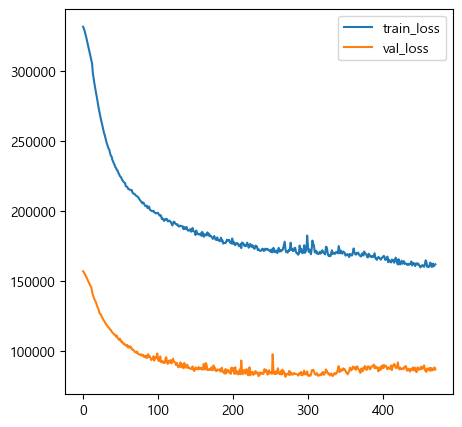

In [384]:
plt.plot(train_loss_hk2_38, label = 'train_loss')
plt.plot(val_loss_hk2_38, label = 'val_loss')
plt.legend()
plt.show()


In [385]:
val_r2_hk2_38, val_mae_hk2_38 = test(valid_loader_hk2_38, model_hk2_38,isEDR=isEDR)

y_label :  11067.302734375 y_pred :  7968.767578125
y_label :  9860.869140625 y_pred :  6288.140625
y_label :  7192.80419921875 y_pred :  6796.3427734375
y_label :  9593.9287109375 y_pred :  4121.9716796875
y_label :  13455.287109375 y_pred :  3972.68701171875
y_label :  14513.291015625 y_pred :  6328.89794921875
y_label :  12563.978515625 y_pred :  6647.224609375
y_label :  13127.2109375 y_pred :  6635.5078125
y_label :  13069.3876953125 y_pred :  8029.98095703125
y_label :  12867.294921875 y_pred :  10736.7900390625
y_label :  11915.947265625 y_pred :  10304.5029296875
y_label :  11613.2373046875 y_pred :  10691.53125
y_label :  11317.296875 y_pred :  10579.7138671875
y_label :  10057.072265625 y_pred :  10631.6337890625
y_label :  8617.1962890625 y_pred :  5262.21484375
y_label :  8725.79296875 y_pred :  5512.08740234375
y_label :  5776.146484375 y_pred :  4811.89111328125
y_label :  5528.36376953125 y_pred :  8513.11328125
y_label :  4155.654296875 y_pred :  4271.1611328125
y_label

In [386]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2_38, test_mae_hk2_38 = test(test_loader_hk2_38, model_hk2_38, isEDR=isEDR)
y_label_hk2_38 = y_label_plt
y_pred_hk2_38 = y_pred_plt

y_label :  1217.02734375 y_pred :  563.9625244140625
y_label :  927.086669921875 y_pred :  1446.3853759765625
y_label :  1577.48828125 y_pred :  774.986572265625
y_label :  6235.2041015625 y_pred :  676.7574462890625
y_label :  7556.4091796875 y_pred :  656.0012817382812
y_label :  4068.4697265625 y_pred :  1116.172607421875
y_label :  1769.04931640625 y_pred :  553.3429565429688
y_label :  2132.917724609375 y_pred :  550.6282958984375
y_label :  827.5123291015625 y_pred :  0.0
y_label :  34.78066635131836 y_pred :  0.0
y_label :  10.529666900634766 y_pred :  0.0
y_label :  0.0 y_pred :  155.45497131347656
y_label :  228.36566162109375 y_pred :  17.69381332397461
y_label :  108.92333221435547 y_pred :  0.0
y_label :  27.59433364868164 y_pred :  111.74374389648438
y_label :  368.4503479003906 y_pred :  836.776611328125
y_label :  1231.113037109375 y_pred :  97.84150695800781
y_label :  150.68466186523438 y_pred :  479.40521240234375
y_label :  582.080322265625 y_pred :  719.325073242187

y_label :  952.4840087890625 y_pred :  651.0313720703125
y_label :  5354.92822265625 y_pred :  672.96533203125
y_label :  3752.353271484375 y_pred :  710.4609985351562
y_label :  2444.538330078125 y_pred :  630.515380859375
y_label :  1171.43701171875 y_pred :  530.2328491210938
y_label :  3174.374755859375 y_pred :  535.8043823242188
y_label :  4416.83642578125 y_pred :  578.6248168945312
y_label :  3179.811279296875 y_pred :  637.6688232421875
y_label :  3157.589111328125 y_pred :  625.92578125
y_label :  3400.0810546875 y_pred :  626.9319458007812
y_label :  1825.4599609375 y_pred :  573.8366088867188
y_label :  623.5230102539062 y_pred :  542.487060546875
y_label :  626.8993530273438 y_pred :  514.2186279296875
y_label :  1083.5972900390625 y_pred :  489.3619689941406
y_label :  1403.3326416015625 y_pred :  534.65625
y_label :  723.9373168945312 y_pred :  531.7376708984375
y_label :  384.8349914550781 y_pred :  587.3885498046875
y_label :  444.3153381347656 y_pred :  442.8255310058

xlim is (-739.682421875, 15533.330859375)
ylim is (-586.719091796875, 12321.100927734375)


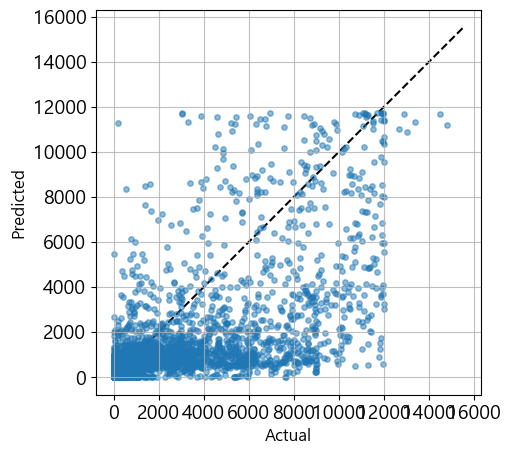

In [387]:
plot_scatter(y_label_hk2_38,y_pred_hk2_38)

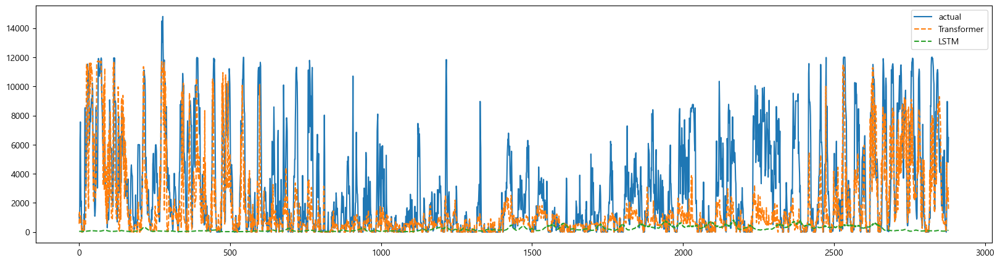

In [388]:
#지민형 Transformer(E-D)
_start = 0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2_38[_start:_end],label = 'actual')
plt.plot(y_pred_hk2_38[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2_38[_start:_end], '--',label = 'LSTM')

plt.legend()


In [1252]:
#hk2
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_hk2.parameters(), lr=lr)
train_loss_hk2, val_loss_hk2= trainer(train_loader_hk2, valid_loader_hk2, model_hk2, criterion, optimizer, target='hk2', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_hk2.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.7329331772962486
MAE Loss:  3716.567915962456
Validation
R2 score: -0.6727373342509004
MAE Loss:  3415.5795559415665
최신화
Epoch 1/1000
TRAIN
R2 score: -0.6828140852309281
MAE Loss:  3630.3437476081335
Validation
R2 score: -0.6091089720971723
MAE Loss:  3326.4988475793225
최신화
Epoch 2/1000
TRAIN
R2 score: -0.6155879483341005
MAE Loss:  3532.5193436962263
Validation
R2 score: -0.536650534535771
MAE Loss:  3242.523902060326
최신화
Epoch 3/1000
TRAIN
R2 score: -0.5434668570765189
MAE Loss:  3433.019618713486
Validation
R2 score: -0.4638889265509254
MAE Loss:  3174.4574266008185
최신화
Epoch 4/1000
TRAIN
R2 score: -0.4798805257837262
MAE Loss:  3382.269021355882
Validation
R2 score: -0.40853297534523425
MAE Loss:  3131.2242268629343
최신화
Epoch 5/1000
TRAIN
R2 score: -0.4282074095994637
MAE Loss:  3310.953307393254
Validation
R2 score: -0.34686443117560106
MAE Loss:  2982.500782170553
최신화
Epoch 6/1000
TRAIN
R2 score: -0.35991210103498195
MAE Loss:  3152.2417853898532
V

R2 score: 0.4299063651219862
MAE Loss:  2176.9734786890162
Validation
R2 score: 0.4689485940794905
MAE Loss:  2084.0035835093163
Epoch 55/1000
TRAIN
R2 score: 0.4324036810528501
MAE Loss:  2167.920629466729
Validation
R2 score: 0.44956841516515866
MAE Loss:  2055.2392234862473
Epoch 56/1000
TRAIN
R2 score: 0.4345490270320359
MAE Loss:  2163.6969384674503
Validation
R2 score: 0.4627812531123777
MAE Loss:  2057.0049736137134
Epoch 57/1000
TRAIN
R2 score: 0.44119694504296214
MAE Loss:  2153.572140841072
Validation
R2 score: 0.4410908247293056
MAE Loss:  2082.3327326230183
Epoch 58/1000
TRAIN
R2 score: 0.44201488857276616
MAE Loss:  2147.3564444055505
Validation
R2 score: 0.5156988907531539
MAE Loss:  1939.7610643890503
최신화
Epoch 59/1000
TRAIN
R2 score: 0.4435419403938522
MAE Loss:  2131.907042206122
Validation
R2 score: 0.4916339508606742
MAE Loss:  1961.3918563046923
Epoch 60/1000
TRAIN
R2 score: 0.44197829572420766
MAE Loss:  2139.509749941642
Validation
R2 score: 0.4757682935383297
MAE

R2 score: 0.49475737769357553
MAE Loss:  2013.544072376801
Validation
R2 score: 0.46371920900040187
MAE Loss:  1944.2119918062842
Epoch 110/1000
TRAIN
R2 score: 0.492416138197286
MAE Loss:  2024.165781804427
Validation
R2 score: 0.5157062368619504
MAE Loss:  1837.7289445932884
최신화
Epoch 111/1000
TRAIN
R2 score: 0.5007986192507572
MAE Loss:  2001.3475710508972
Validation
R2 score: 0.47623595068032276
MAE Loss:  1931.156996471751
Epoch 112/1000
TRAIN
R2 score: 0.49530824699183285
MAE Loss:  2017.6110991937185
Validation
R2 score: 0.48079129592638437
MAE Loss:  1909.963933799462
Epoch 113/1000
TRAIN
R2 score: 0.48829731216723404
MAE Loss:  2023.653580289956
Validation
R2 score: 0.48366385811564316
MAE Loss:  1896.5626966657353
Epoch 114/1000
TRAIN
R2 score: 0.5016818378450816
MAE Loss:  2000.7999076360695
Validation
R2 score: 0.5210769980711398
MAE Loss:  1829.2322768105635
최신화
Epoch 115/1000
TRAIN
R2 score: 0.4900825631709754
MAE Loss:  2023.4711688332677
Validation
R2 score: 0.540564267

R2 score: 0.5372867526492184
MAE Loss:  1903.5322377430284
Validation
R2 score: 0.3995764573259897
MAE Loss:  2005.8437462252216
Epoch 165/1000
TRAIN
R2 score: 0.5249819759342248
MAE Loss:  1922.4124091882843
Validation
R2 score: 0.4623741463663873
MAE Loss:  1958.9736416589656
Epoch 166/1000
TRAIN
R2 score: 0.5283031087908858
MAE Loss:  1928.013125332823
Validation
R2 score: 0.4091792771353261
MAE Loss:  1980.388386134781
Epoch 167/1000
TRAIN
R2 score: 0.5342694134324081
MAE Loss:  1913.8297720777935
Validation
R2 score: 0.39121730087040196
MAE Loss:  2000.8464072205913
Epoch 168/1000
TRAIN
R2 score: 0.5349754106653863
MAE Loss:  1911.1669718151024
Validation
R2 score: 0.40756913745733236
MAE Loss:  1972.7136637682138
Epoch 169/1000
TRAIN
R2 score: 0.5337173955894434
MAE Loss:  1903.894871904731
Validation
R2 score: 0.40050142346549944
MAE Loss:  1980.8754549790237
Epoch 170/1000
TRAIN
R2 score: 0.537013184340869
MAE Loss:  1901.3855944640738
Validation
R2 score: 0.40616974728300226
M

R2 score: 0.5524152931144743
MAE Loss:  1847.4672423274035
Validation
R2 score: 0.41176675560502396
MAE Loss:  1968.2873877282677
Epoch 220/1000
TRAIN
R2 score: 0.5358892922408697
MAE Loss:  1877.4025334157975
Validation
R2 score: 0.4390793445756631
MAE Loss:  1963.542939434754
Epoch 221/1000
TRAIN
R2 score: 0.5526048926425665
MAE Loss:  1857.2511970134342
Validation
R2 score: 0.43178713471947006
MAE Loss:  1908.1589153095283
Epoch 222/1000
TRAIN
R2 score: 0.5524912545301788
MAE Loss:  1850.1385971572097
Validation
R2 score: 0.4409838136516899
MAE Loss:  1894.068502329419
Epoch 223/1000
TRAIN
R2 score: 0.550264366866853
MAE Loss:  1861.3886600301757
Validation
R2 score: 0.42968755278344095
MAE Loss:  1927.608269836494
Epoch 224/1000
TRAIN
R2 score: 0.5417672041355844
MAE Loss:  1873.7208915639692
Validation
R2 score: 0.45608149599858916
MAE Loss:  1867.7140743186208
Epoch 225/1000
TRAIN
R2 score: 0.5514784646670416
MAE Loss:  1854.6879814057859
Validation
R2 score: 0.3980819978270471
M

R2 score: 0.5717235195547683
MAE Loss:  1801.3850399096136
Validation
R2 score: 0.3805841986786652
MAE Loss:  2013.7804227882004
Epoch 275/1000
TRAIN
R2 score: 0.580010582624707
MAE Loss:  1784.52269232852
Validation
R2 score: 0.39036621230747537
MAE Loss:  1994.2082025037712
Epoch 276/1000
TRAIN
R2 score: 0.5711776555194303
MAE Loss:  1799.7844998004928
Validation
R2 score: 0.4013870858923869
MAE Loss:  1974.3459689996914
Epoch 277/1000
TRAIN
R2 score: 0.5711324848114785
MAE Loss:  1796.3922412354027
Validation
R2 score: 0.36724776889519617
MAE Loss:  2023.4698581972152
Epoch 278/1000
TRAIN
R2 score: 0.5664222758078448
MAE Loss:  1813.0698319228675
Validation
R2 score: 0.3788625157943246
MAE Loss:  1997.4951033290786
Epoch 279/1000
TRAIN
R2 score: 0.5746793467093918
MAE Loss:  1794.024962987117
Validation
R2 score: 0.43318077425355905
MAE Loss:  1923.3940626589613
Epoch 280/1000
TRAIN
R2 score: 0.5824855804662983
MAE Loss:  1777.5196554524541
Validation
R2 score: 0.3825910984921068
MA

<All keys matched successfully>

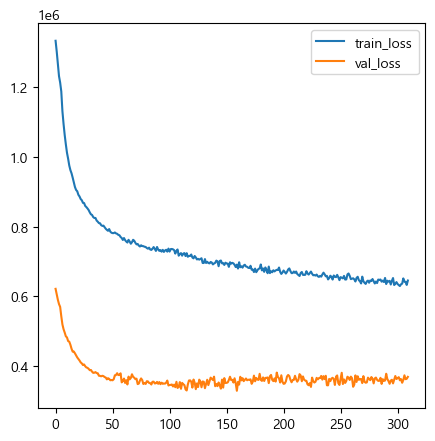

In [1384]:
plt.plot(train_loss_hk2, label = 'train_loss')
plt.plot(val_loss_hk2, label = 'val_loss')
plt.legend()
plt.show()

In [1385]:
y_label_plt = []
y_pred_plt = []
test_r2_hk2, test_mae_hk2 = test(test_loader_hk2, model_hk2, isEDR=isEDR)
y_label_hk2 = y_label_plt
y_pred_hk2 = y_pred_plt

y_label :  2560.76806640625 y_pred :  4530.52099609375
y_label :  2443.97705078125 y_pred :  2417.717529296875
y_label :  3146.77734375 y_pred :  2235.988525390625
y_label :  4039.077392578125 y_pred :  5085.89599609375
y_label :  4202.15283203125 y_pred :  1431.0517578125
y_label :  2595.485595703125 y_pred :  1091.8931884765625
y_label :  1598.398681640625 y_pred :  1383.6082763671875
y_label :  815.8056640625 y_pred :  1277.68017578125
y_label :  614.3186645507812 y_pred :  1306.9439697265625
y_label :  422.0606689453125 y_pred :  539.0225830078125
y_label :  1092.855712890625 y_pred :  838.4744873046875
y_label :  1295.65966796875 y_pred :  1383.53173828125
y_label :  1305.4940185546875 y_pred :  1546.6441650390625
y_label :  2220.09912109375 y_pred :  1069.3289794921875
y_label :  1574.2213134765625 y_pred :  1519.4503173828125
y_label :  1022.1356811523438 y_pred :  960.8848876953125
y_label :  746.5416870117188 y_pred :  608.7431030273438
y_label :  2212.597900390625 y_pred :  4

xlim is (-739.682421875, 15533.330859375)
ylim is (-864.9150405883789, 11435.364350891114)


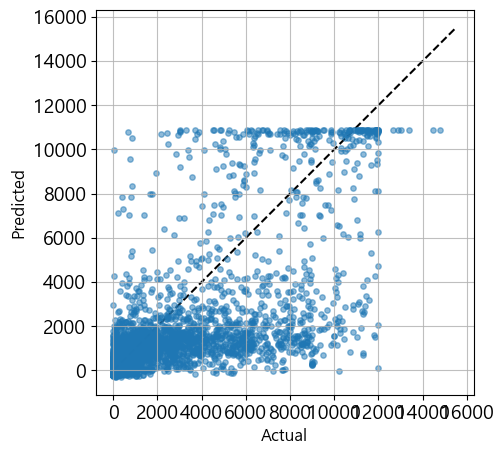

In [1255]:
plot_scatter(y_label_hk2,y_pred_hk2)

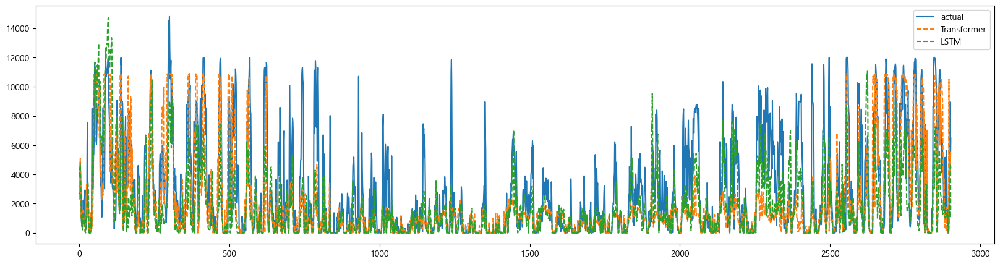

In [1386]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('hk2_transformer')
plt.figure(figsize = (20,5))
plt.plot(y_label_hk2[_start:_end],label = 'actual')
plt.plot(y_pred_hk2[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_hk2[_start:_end], '--',label = 'LSTM')

plt.legend()

In [389]:
# ss_multi_15
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_15_m.parameters(), lr=lr)
train_loss_ss_15_m, val_loss_ss_15_m = trainer(train_loader_ss_15_m, valid_loader_ss_15_m, model_ss_15_m, criterion, optimizer, target='ss', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_ss_15_m.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.8880403853006367
MAE Loss:  4938.50015533909
Validation
R2 score: -0.8556688126108489
MAE Loss:  5220.177386158877
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8870044039697498
MAE Loss:  4936.248611381181
Validation
R2 score: -0.8551413158046715
MAE Loss:  5218.773486854247
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8864179042009968
MAE Loss:  4934.837349999135
Validation
R2 score: -0.8545740976652103
MAE Loss:  5217.2667597656655
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8857712700433726
MAE Loss:  4933.287973742838
Validation
R2 score: -0.853951467586699
MAE Loss:  5215.616590884065
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8850701889489989
MAE Loss:  4931.614910157224
Validation
R2 score: -0.8532705774098421
MAE Loss:  5213.818424236307
최신화
Epoch 5/1000
TRAIN
R2 score: -0.884306213519092
MAE Loss:  4929.799423596916
Validation
R2 score: -0.8525346681830921
MAE Loss:  5211.88087483046
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8834821025642747
MAE Loss:  4927.856737703859
Validation
R2

R2 score: -0.7785811239250038
MAE Loss:  4675.886581949365
Validation
R2 score: -0.7551127134990911
MAE Loss:  4977.332461171878
최신화
Epoch 56/1000
TRAIN
R2 score: -0.7750573196672634
MAE Loss:  4667.362733555872
Validation
R2 score: -0.7519540530104498
MAE Loss:  4969.122050785739
최신화
Epoch 57/1000
TRAIN
R2 score: -0.7714971798550101
MAE Loss:  4659.334384842681
Validation
R2 score: -0.74869050312771
MAE Loss:  4961.775517572528
최신화
Epoch 58/1000
TRAIN
R2 score: -0.7679050244225738
MAE Loss:  4651.26420691367
Validation
R2 score: -0.7454304941750356
MAE Loss:  4954.264230033624
최신화
Epoch 59/1000
TRAIN
R2 score: -0.7642549164248365
MAE Loss:  4642.495310109859
Validation
R2 score: -0.7422765899985488
MAE Loss:  4946.211488853021
최신화
Epoch 60/1000
TRAIN
R2 score: -0.760602353949976
MAE Loss:  4634.005416830534
Validation
R2 score: -0.7391558402750922
MAE Loss:  4940.016500575565
최신화
Epoch 61/1000
TRAIN
R2 score: -0.7568841277900165
MAE Loss:  4624.525119448148
Validation
R2 score: -0.735

R2 score: -0.5554770041338473
MAE Loss:  4189.101548450743
Validation
R2 score: -0.5548688781970534
MAE Loss:  4542.240670688676
최신화
Epoch 110/1000
TRAIN
R2 score: -0.5511983765074742
MAE Loss:  4180.006696730476
Validation
R2 score: -0.5512989792433525
MAE Loss:  4535.023621510499
최신화
Epoch 111/1000
TRAIN
R2 score: -0.5463675884781016
MAE Loss:  4170.96517291025
Validation
R2 score: -0.547695470063051
MAE Loss:  4527.160032453944
최신화
Epoch 112/1000
TRAIN
R2 score: -0.5417327702067645
MAE Loss:  4161.196840364307
Validation
R2 score: -0.5437204081571754
MAE Loss:  4518.822986443796
최신화
Epoch 113/1000
TRAIN
R2 score: -0.5373529756140092
MAE Loss:  4152.693965445651
Validation
R2 score: -0.5395433602529816
MAE Loss:  4509.968309750775
최신화
Epoch 114/1000
TRAIN
R2 score: -0.5326317801742348
MAE Loss:  4143.458950349315
Validation
R2 score: -0.5360206324746672
MAE Loss:  4501.023799981419
최신화
Epoch 115/1000
TRAIN
R2 score: -0.5282277060931566
MAE Loss:  4136.218816107955
Validation
R2 score

최신화
Epoch 163/1000
TRAIN
R2 score: -0.3148056899936744
MAE Loss:  3733.114697391669
Validation
R2 score: -0.34108302530131196
MAE Loss:  4158.49144244428
최신화
Epoch 164/1000
TRAIN
R2 score: -0.31298304067066374
MAE Loss:  3734.027057656688
Validation
R2 score: -0.33632626716109204
MAE Loss:  4156.465085305623
최신화
Epoch 165/1000
TRAIN
R2 score: -0.30857286164489617
MAE Loss:  3722.235610333192
Validation
R2 score: -0.3330661861860016
MAE Loss:  4152.050500584166
최신화
Epoch 166/1000
TRAIN
R2 score: -0.30455882254990163
MAE Loss:  3712.0794787538525
Validation
R2 score: -0.32964317141568156
MAE Loss:  4140.099550318742
최신화
Epoch 167/1000
TRAIN
R2 score: -0.29794165091995417
MAE Loss:  3702.402213215919
Validation
R2 score: -0.32653702120225137
MAE Loss:  4124.334052185997
최신화
Epoch 168/1000
TRAIN
R2 score: -0.2927207510977696
MAE Loss:  3694.713505524438
Validation
R2 score: -0.32409378036362235
MAE Loss:  4121.393293706387
최신화
Epoch 169/1000
TRAIN
R2 score: -0.2898914079564763
MAE Loss:  3

최신화
Epoch 217/1000
TRAIN
R2 score: -0.09987714229219358
MAE Loss:  3346.996577838176
Validation
R2 score: -0.14629394956595987
MAE Loss:  3861.649355978143
Epoch 218/1000
TRAIN
R2 score: -0.0992793417423179
MAE Loss:  3345.8177141167685
Validation
R2 score: -0.1440876749811213
MAE Loss:  3862.4866464674556
Epoch 219/1000
TRAIN
R2 score: -0.09470593101578006
MAE Loss:  3339.840334966683
Validation
R2 score: -0.13920311293841503
MAE Loss:  3850.25574204182
최신화
Epoch 220/1000
TRAIN
R2 score: -0.09138087972807196
MAE Loss:  3331.81983763318
Validation
R2 score: -0.1376959854979536
MAE Loss:  3838.3427661509963
최신화
Epoch 221/1000
TRAIN
R2 score: -0.08593145956506132
MAE Loss:  3326.5310146391907
Validation
R2 score: -0.13541983061590468
MAE Loss:  3821.112685311883
최신화
Epoch 222/1000
TRAIN
R2 score: -0.08186944605527713
MAE Loss:  3312.1434274241824
Validation
R2 score: -0.132096161073618
MAE Loss:  3808.8219347782124
최신화
Epoch 223/1000
TRAIN
R2 score: -0.07785752181279038
MAE Loss:  3308.0

R2 score: 0.07748662338794488
MAE Loss:  3050.4151859777608
Validation
R2 score: 0.005320653707472034
MAE Loss:  3598.079720665149
최신화
Epoch 271/1000
TRAIN
R2 score: 0.08027702457946329
MAE Loss:  3044.418601992687
Validation
R2 score: 0.008610251484445386
MAE Loss:  3586.387971696405
최신화
Epoch 272/1000
TRAIN
R2 score: 0.08211779672711261
MAE Loss:  3043.659321811302
Validation
R2 score: 0.012304930828777816
MAE Loss:  3636.316196856461
Epoch 273/1000
TRAIN
R2 score: 0.0796201410338061
MAE Loss:  3039.85805420816
Validation
R2 score: 0.017332114938117038
MAE Loss:  3645.33418049378
Epoch 274/1000
TRAIN
R2 score: 0.08322593279090906
MAE Loss:  3032.913917381119
Validation
R2 score: 0.020668974860079348
MAE Loss:  3630.4530206841955
Epoch 275/1000
TRAIN
R2 score: 0.08907498674168657
MAE Loss:  3036.79146802753
Validation
R2 score: 0.022548540043014986
MAE Loss:  3614.116026796216
Epoch 276/1000
TRAIN
R2 score: 0.09520537528757456
MAE Loss:  3013.6845018573345
Validation
R2 score: 0.02344

R2 score: 0.21682001355107594
MAE Loss:  2824.21909036552
Validation
R2 score: 0.1367666475022037
MAE Loss:  3419.931449147829
Epoch 326/1000
TRAIN
R2 score: 0.2182987901532396
MAE Loss:  2815.2685709501307
Validation
R2 score: 0.14322616034133262
MAE Loss:  3415.925850969578
Epoch 327/1000
TRAIN
R2 score: 0.21671415202212252
MAE Loss:  2804.534409577534
Validation
R2 score: 0.1455043761611612
MAE Loss:  3433.0354817805623
Epoch 328/1000
TRAIN
R2 score: 0.22154154279012617
MAE Loss:  2801.552186433984
Validation
R2 score: 0.14155209876792185
MAE Loss:  3483.495451445627
Epoch 329/1000
TRAIN
R2 score: 0.22084214069914654
MAE Loss:  2811.925427891873
Validation
R2 score: 0.14613647404984587
MAE Loss:  3437.2610642745394
Epoch 330/1000
TRAIN
R2 score: 0.22660858583914734
MAE Loss:  2798.101295771225
Validation
R2 score: 0.1460555683768736
MAE Loss:  3403.6053876327173
Epoch 331/1000
TRAIN
R2 score: 0.22502455774138452
MAE Loss:  2811.365337354888
Validation
R2 score: 0.152241856943501
MAE

R2 score: 0.3246988720204603
MAE Loss:  2620.7427851310526
Validation
R2 score: 0.23813249239155954
MAE Loss:  3265.425506157118
Epoch 382/1000
TRAIN
R2 score: 0.33063106971424006
MAE Loss:  2615.783986336387
Validation
R2 score: 0.24090927094164805
MAE Loss:  3288.215218780003
Epoch 383/1000
TRAIN
R2 score: 0.3290427908002075
MAE Loss:  2617.955915361874
Validation
R2 score: 0.24238316310603192
MAE Loss:  3312.6876380185367
Epoch 384/1000
TRAIN
R2 score: 0.32325161479232156
MAE Loss:  2627.3225620326116
Validation
R2 score: 0.24302586271078863
MAE Loss:  3330.6293204062654
Epoch 385/1000
TRAIN
R2 score: 0.32705587119113977
MAE Loss:  2648.128186763811
Validation
R2 score: 0.2423532909745929
MAE Loss:  3334.8954515570863
Epoch 386/1000
TRAIN
R2 score: 0.3308610241500102
MAE Loss:  2639.126064926196
Validation
R2 score: 0.24839447094342137
MAE Loss:  3249.84687005944
Epoch 387/1000
TRAIN
R2 score: 0.33641508937346565
MAE Loss:  2620.7260900520005
Validation
R2 score: 0.24548286817208442

R2 score: 0.4244256343277708
MAE Loss:  2435.3815016739823
Validation
R2 score: 0.3030365421793537
MAE Loss:  3208.010631541288
Epoch 437/1000
TRAIN
R2 score: 0.41437831100024536
MAE Loss:  2465.7244414787097
Validation
R2 score: 0.3107268188553892
MAE Loss:  3177.827110215529
Epoch 438/1000
TRAIN
R2 score: 0.419529843383733
MAE Loss:  2434.6101157142693
Validation
R2 score: 0.31054850638241704
MAE Loss:  3181.5562479136815
Epoch 439/1000
TRAIN
R2 score: 0.41944500697175446
MAE Loss:  2452.0668753485347
Validation
R2 score: 0.30404593983213823
MAE Loss:  3178.37590147793
Epoch 440/1000
TRAIN
R2 score: 0.41471059141739286
MAE Loss:  2452.8149116514787
Validation
R2 score: 0.30915433428037564
MAE Loss:  3182.810085915296
Epoch 441/1000
TRAIN
R2 score: 0.42992772664076284
MAE Loss:  2410.9004050095277
Validation
R2 score: 0.3070891163243594
MAE Loss:  3149.911693933048
최신화
Epoch 442/1000
TRAIN
R2 score: 0.4268053083801112
MAE Loss:  2419.4206777950117
Validation
R2 score: 0.30497147107528

R2 score: 0.485933059366603
MAE Loss:  2298.311802634221
Validation
R2 score: 0.3503802726775871
MAE Loss:  3195.5429555493365
Epoch 493/1000
TRAIN
R2 score: 0.48537261444334634
MAE Loss:  2307.9372798160416
Validation
R2 score: 0.3506011392322902
MAE Loss:  3187.0686942723582
Epoch 494/1000
TRAIN
R2 score: 0.4970159920472973
MAE Loss:  2297.400530569473
Validation
R2 score: 0.3449817826217846
MAE Loss:  3149.696087845306
Epoch 495/1000
TRAIN
R2 score: 0.502083603183058
MAE Loss:  2257.4196777781513
Validation
R2 score: 0.3400161784152892
MAE Loss:  3136.0786491421054
최신화
Epoch 496/1000
TRAIN
R2 score: 0.5030059022920285
MAE Loss:  2259.333036364917
Validation
R2 score: 0.3433956006649248
MAE Loss:  3137.125456172778
최신화
Epoch 497/1000
TRAIN
R2 score: 0.5045687006943415
MAE Loss:  2261.3383579083475
Validation
R2 score: 0.3470286909086425
MAE Loss:  3152.5196436138276
Epoch 498/1000
TRAIN
R2 score: 0.49927952648868523
MAE Loss:  2274.01001438393
Validation
R2 score: 0.35179648515558704

R2 score: 0.5539062857586448
MAE Loss:  2142.373184527235
Validation
R2 score: 0.3925843359872958
MAE Loss:  3060.8397142275057
최신화
Epoch 548/1000
TRAIN
R2 score: 0.5524156820054895
MAE Loss:  2145.210789615088
Validation
R2 score: 0.3787842198583955
MAE Loss:  3139.8609006025986
Epoch 549/1000
TRAIN
R2 score: 0.555871009706924
MAE Loss:  2121.8350922833406
Validation
R2 score: 0.37830274347288484
MAE Loss:  3150.9140601390077
Epoch 550/1000
TRAIN
R2 score: 0.5526770640314347
MAE Loss:  2160.1466141889287
Validation
R2 score: 0.38395492838919687
MAE Loss:  3099.2594518031383
Epoch 551/1000
TRAIN
R2 score: 0.5564641360783437
MAE Loss:  2134.1689400953637
Validation
R2 score: 0.36375652897869537
MAE Loss:  3147.965743088484
Epoch 552/1000
TRAIN
R2 score: 0.5704098500783372
MAE Loss:  2096.2586793045703
Validation
R2 score: 0.3546682693080836
MAE Loss:  3133.1964475135255
Epoch 553/1000
TRAIN
R2 score: 0.5701345296513457
MAE Loss:  2082.2506913579427
Validation
R2 score: 0.377737113553721

R2 score: 0.6359856281201426
MAE Loss:  1918.2136692529393
Validation
R2 score: 0.39124230004803184
MAE Loss:  3112.151517082057
Epoch 604/1000
TRAIN
R2 score: 0.6289306975466331
MAE Loss:  1925.32926820065
Validation
R2 score: 0.39106971095255805
MAE Loss:  3121.0158982525268
Epoch 605/1000
TRAIN
R2 score: 0.6390540920737662
MAE Loss:  1907.7276884241564
Validation
R2 score: 0.3697825515649974
MAE Loss:  3131.8906399186076
Epoch 606/1000
TRAIN
R2 score: 0.6393629964584013
MAE Loss:  1911.052470027592
Validation
R2 score: 0.3888469424356821
MAE Loss:  3111.0983572418777
Epoch 607/1000
TRAIN
R2 score: 0.6390176350592525
MAE Loss:  1920.6554831887809
Validation
R2 score: 0.4012820562122985
MAE Loss:  3082.941985981072
Epoch 608/1000
TRAIN
R2 score: 0.6353935780004376
MAE Loss:  1904.1148554229726
Validation
R2 score: 0.37530521998496424
MAE Loss:  3132.1209128410774
Epoch 609/1000
TRAIN
R2 score: 0.6403610924602401
MAE Loss:  1906.9270303391463
Validation
R2 score: 0.3886324663280426
MAE

R2 score: 0.6744680415264548
MAE Loss:  1822.5703693224793
Validation
R2 score: 0.38530129089845555
MAE Loss:  3093.3500616064825
Epoch 660/1000
TRAIN
R2 score: 0.6870971820637354
MAE Loss:  1772.0700751408187
Validation
R2 score: 0.40897576317342155
MAE Loss:  3075.0992099940368
Epoch 661/1000
TRAIN
R2 score: 0.690588694432623
MAE Loss:  1758.9252124625896
Validation
R2 score: 0.38605191182401777
MAE Loss:  3057.874451876877
Epoch 662/1000
TRAIN
R2 score: 0.6949715588282092
MAE Loss:  1746.9862592152656
Validation
R2 score: 0.4048086983265897
MAE Loss:  3054.742813973921
Epoch 663/1000
TRAIN
R2 score: 0.6976416210572811
MAE Loss:  1742.0152982022464
Validation
R2 score: 0.40893350473179857
MAE Loss:  3091.002952104963
Epoch 664/1000
TRAIN
R2 score: 0.6850005740464222
MAE Loss:  1760.3972199950215
Validation
R2 score: 0.4128319194364314
MAE Loss:  3145.321289019192
Epoch 665/1000
TRAIN
R2 score: 0.6861376918898087
MAE Loss:  1762.6080789607167
Validation
R2 score: 0.41206200643624813
M

R2 score: 0.7471261102251381
MAE Loss:  1570.296384986932
Validation
R2 score: 0.4081250185681101
MAE Loss:  3071.1276115704914
Epoch 716/1000
TRAIN
R2 score: 0.7449947400685583
MAE Loss:  1571.5355251232597
Validation
R2 score: 0.413728223022672
MAE Loss:  3062.9730674033735
Epoch 717/1000
TRAIN
R2 score: 0.7459010747725532
MAE Loss:  1572.8267727139034
Validation
R2 score: 0.395176334614869
MAE Loss:  3100.11527240264
Epoch 718/1000
TRAIN
R2 score: 0.7466921053199268
MAE Loss:  1576.4076114177105
Validation
R2 score: 0.392163483289946
MAE Loss:  3056.229252039442
Epoch 719/1000
TRAIN
R2 score: 0.743132055882462
MAE Loss:  1597.3051609214804
Validation
R2 score: 0.3770004451158848
MAE Loss:  3081.867890370327
Epoch 720/1000
TRAIN
R2 score: 0.743854148923596
MAE Loss:  1596.5549309071043
Validation
R2 score: 0.3863876550438795
MAE Loss:  3102.3055322031096
Epoch 721/1000
TRAIN
R2 score: 0.7506757830091312
MAE Loss:  1562.3080714987418
Validation
R2 score: 0.3908639643638693
MAE Loss:  

R2 score: 0.7746516737886
MAE Loss:  1485.6889510355566
Validation
R2 score: 0.36982639735926504
MAE Loss:  3115.4783500032113
Epoch 772/1000
TRAIN
R2 score: 0.7871688253580378
MAE Loss:  1444.9747768755242
Validation
R2 score: 0.3970976122397868
MAE Loss:  3038.934100897064
Epoch 773/1000
TRAIN
R2 score: 0.7779301102946428
MAE Loss:  1471.382336495312
Validation
R2 score: 0.407311375154209
MAE Loss:  3037.5593886659904
Epoch 774/1000
TRAIN
R2 score: 0.7887807783000871
MAE Loss:  1431.7358681901103
Validation
R2 score: 0.39223263274830866
MAE Loss:  3091.974497535874
Epoch 775/1000
TRAIN
R2 score: 0.7866290357941683
MAE Loss:  1423.0997796774984
Validation
R2 score: 0.3817245872016296
MAE Loss:  3106.0072246061295
Epoch 776/1000
TRAIN
R2 score: 0.7858862581703208
MAE Loss:  1439.6684643545912
Validation
R2 score: 0.37040637844206226
MAE Loss:  3117.6426116064313
Epoch 777/1000
TRAIN
R2 score: 0.7872766567343079
MAE Loss:  1449.989059594557
Validation
R2 score: 0.3934272415421133
MAE Lo

R2 score: 0.8118060484867489
MAE Loss:  1359.0687763300698
Validation
R2 score: 0.3645338126842983
MAE Loss:  3046.4971763961653
Epoch 828/1000
TRAIN
R2 score: 0.8188484804800295
MAE Loss:  1332.7946894994293
Validation
R2 score: 0.39915033930762245
MAE Loss:  3003.423195776245
Epoch 829/1000
TRAIN
R2 score: 0.817981707140499
MAE Loss:  1316.9698196178613
Validation
R2 score: 0.37120684962605566
MAE Loss:  3137.6353901905873
Epoch 830/1000
TRAIN
R2 score: 0.8150985902341198
MAE Loss:  1336.6969339899888
Validation
R2 score: 0.3919835576731472
MAE Loss:  3037.0604929055803
Epoch 831/1000
TRAIN
R2 score: 0.8225922045530913
MAE Loss:  1304.7514482403724
Validation
R2 score: 0.35142943841400964
MAE Loss:  3090.5711598817065
Epoch 832/1000
TRAIN
R2 score: 0.8226641476556671
MAE Loss:  1331.1533329723202
Validation
R2 score: 0.4055500706712152
MAE Loss:  3001.9312328581723
Epoch 833/1000
TRAIN
R2 score: 0.8136212683437698
MAE Loss:  1340.2865546260064
Validation
R2 score: 0.37729971244112037

R2 score: 0.8336773617163573
MAE Loss:  1269.4013490680852
Validation
R2 score: 0.35967809311592247
MAE Loss:  3035.665488201273
Epoch 883/1000
TRAIN
R2 score: 0.83540717825564
MAE Loss:  1258.1971084638249
Validation
R2 score: 0.3449685303270945
MAE Loss:  3098.4845816629113
Epoch 884/1000
TRAIN
R2 score: 0.8354457668311348
MAE Loss:  1262.8483757516508
Validation
R2 score: 0.3960484427903638
MAE Loss:  3035.1276800450623
Epoch 885/1000
TRAIN
R2 score: 0.8432990860095072
MAE Loss:  1221.7866488652726
Validation
R2 score: 0.3481267086392331
MAE Loss:  3154.864166758154
Epoch 886/1000
TRAIN
R2 score: 0.8323924216532832
MAE Loss:  1274.1794536193256
Validation
R2 score: 0.3250787635029724
MAE Loss:  3114.8869011574952
Epoch 887/1000
TRAIN
R2 score: 0.8359445037261255
MAE Loss:  1261.2360851668536
Validation
R2 score: 0.36907310870499
MAE Loss:  3033.8835688346467
Epoch 888/1000
TRAIN
R2 score: 0.8307254779148739
MAE Loss:  1268.1887804194996
Validation
R2 score: 0.38407871675796423
MAE L

R2 score: 0.8594564424132629
MAE Loss:  1153.6457154646575
Validation
R2 score: 0.39274962461817486
MAE Loss:  2999.992124984949
Epoch 939/1000
TRAIN
R2 score: 0.8683146917821772
MAE Loss:  1127.2369235589626
Validation
R2 score: 0.3870644033641516
MAE Loss:  2993.667791480573
Epoch 940/1000
TRAIN
R2 score: 0.8689971693321092
MAE Loss:  1117.5648495853886
Validation
R2 score: 0.3690938483678865
MAE Loss:  3032.938408613739
Epoch 941/1000
TRAIN
R2 score: 0.8687799769977127
MAE Loss:  1119.7368867992345
Validation
R2 score: 0.36482978224839213
MAE Loss:  3041.195862082944
Epoch 942/1000
TRAIN
R2 score: 0.8713892309218807
MAE Loss:  1117.2524113283291
Validation
R2 score: 0.3633907319242219
MAE Loss:  3102.7979004876097
Epoch 943/1000
TRAIN
R2 score: 0.8670784882857303
MAE Loss:  1122.5518691461125
Validation
R2 score: 0.32802860480730733
MAE Loss:  3145.5797660689464
Epoch 944/1000
TRAIN
R2 score: 0.8659696911165351
MAE Loss:  1137.3501514582176
Validation
R2 score: 0.3719775834336685
MA

R2 score: 0.8801046010947113
MAE Loss:  1056.592342896977
Validation
R2 score: 0.3514032542643968
MAE Loss:  3104.9271163528697
Epoch 995/1000
TRAIN
R2 score: 0.8825398503904148
MAE Loss:  1070.3488001610535
Validation
R2 score: 0.37122334693014036
MAE Loss:  3025.776414478326
Epoch 996/1000
TRAIN
R2 score: 0.8866796326381099
MAE Loss:  1046.107975982898
Validation
R2 score: 0.35386777983608175
MAE Loss:  3081.2613489419714
Epoch 997/1000
TRAIN
R2 score: 0.8881436712551408
MAE Loss:  1053.6619459039332
Validation
R2 score: 0.36115096690688187
MAE Loss:  3049.5392823411826
Epoch 998/1000
TRAIN
R2 score: 0.8799930559813495
MAE Loss:  1078.5700822475142
Validation
R2 score: 0.3121433425219726
MAE Loss:  3201.0247605505806
Epoch 999/1000
TRAIN
R2 score: 0.8730367899483684
MAE Loss:  1089.202106715057
Validation
R2 score: 0.3666293850086284
MAE Loss:  3093.835453762701


<All keys matched successfully>

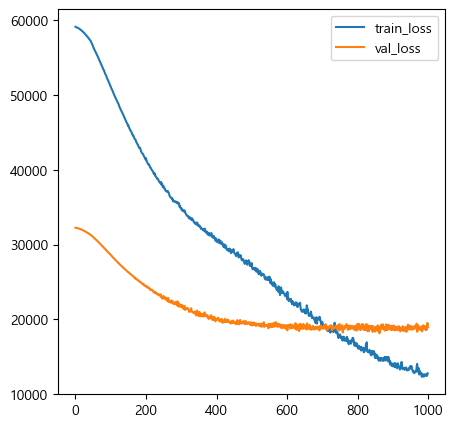

In [390]:
plt.plot(train_loss_ss_15_m, label = 'train_loss')
plt.plot(val_loss_ss_15_m, label = 'val_loss')
plt.legend()
plt.show()

In [391]:
val_r2_ss_15_m, val_mae_ss_15_m = test(valid_loader_ss_15_m, model_ss_15_m,isEDR=isEDR)

y_label :  117.81800079345703 y_pred :  2335.600830078125
y_label :  1571.0140380859375 y_pred :  1722.45458984375
y_label :  1206.7373046875 y_pred :  112.66343688964844
y_label :  314.888671875 y_pred :  274.2428283691406
y_label :  828.5133056640625 y_pred :  439.2938232421875
y_label :  3153.21044921875 y_pred :  586.2781982421875
y_label :  1501.958984375 y_pred :  469.13714599609375
y_label :  1166.79296875 y_pred :  6266.16552734375
y_label :  6971.689453125 y_pred :  6590.4462890625
y_label :  6345.48046875 y_pred :  7564.513671875
y_label :  6253.83935546875 y_pred :  6827.875
y_label :  7224.60400390625 y_pred :  6433.0595703125
y_label :  10023.947265625 y_pred :  7943.49853515625
y_label :  7701.9111328125 y_pred :  6418.1806640625
y_label :  8976.8876953125 y_pred :  6548.4228515625
y_label :  4314.79296875 y_pred :  9503.517578125
y_label :  4994.40869140625 y_pred :  8419.365234375
y_label :  4565.1748046875 y_pred :  1862.573974609375
y_label :  5115.21826171875 y_pred 

In [392]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_15_m, test_mae_ss_15_m = test(test_loader_ss_15_m, model_ss_15_m, isEDR=isEDR)
y_label_ss_15_m = y_label_plt
y_pred_ss_15_m = y_pred_plt

y_label :  1610.261962890625 y_pred :  4412.822265625
y_label :  8492.4189453125 y_pred :  3984.0673828125
y_label :  13345.771484375 y_pred :  5615.82958984375
y_label :  11781.712890625 y_pred :  5331.1728515625
y_label :  11699.203125 y_pred :  5050.69140625
y_label :  10247.5185546875 y_pred :  4987.1298828125
y_label :  8715.3447265625 y_pred :  5463.162109375
y_label :  6992.30908203125 y_pred :  6308.8212890625
y_label :  7158.04443359375 y_pred :  12480.7900390625
y_label :  9287.556640625 y_pred :  8913.314453125
y_label :  13307.5322265625 y_pred :  6986.58984375
y_label :  15576.271484375 y_pred :  10725.291015625
y_label :  5865.01904296875 y_pred :  9526.587890625
y_label :  5443.82177734375 y_pred :  8666.681640625
y_label :  2711.306396484375 y_pred :  10025.1953125
y_label :  5682.10498046875 y_pred :  6093.0
y_label :  7950.78955078125 y_pred :  4399.93359375
y_label :  7799.546875 y_pred :  5374.50927734375
y_label :  2257.879638671875 y_pred :  1282.444580078125
y_la

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-699.5167968750001, 14689.852734375)


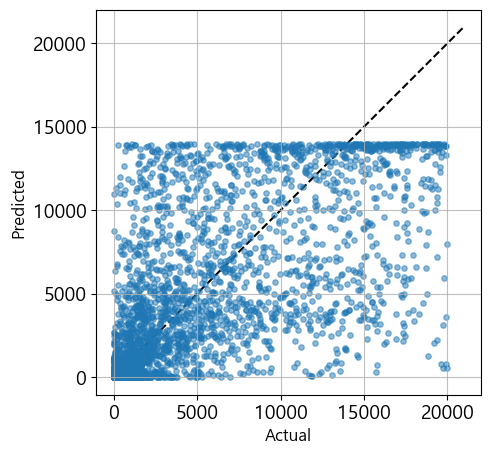

In [393]:
plot_scatter(y_label_ss_15_m,y_pred_ss_15_m)

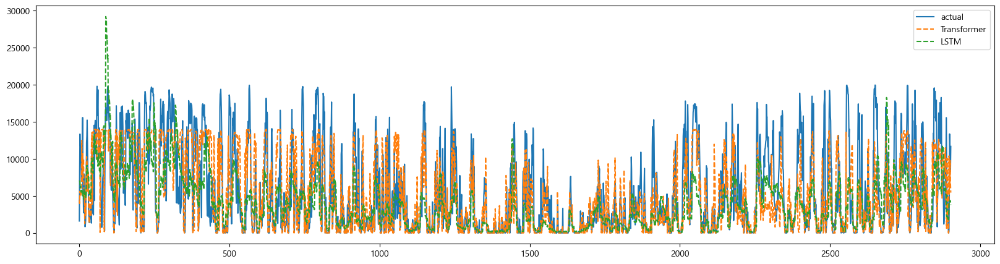

In [394]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_ss_15_m[_start:_end],label = 'actual')
plt.plot(y_pred_ss_15_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_ss_15_m_re[_start:_end], '--',label = 'LSTM')
plt.legend()

In [395]:
# ss_multi_23
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_23_m.parameters(), lr=lr)
train_loss_ss_23_m, val_loss_ss_23_m = trainer(train_loader_ss_23_m, valid_loader_ss_23_m, model_ss_23_m, criterion, optimizer, target='ss', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_ss_23_m.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.886771753731233
MAE Loss:  4928.476218822415
Validation
R2 score: -0.8582674880838703
MAE Loss:  5231.479182458837
최신화
Epoch 1/1000
TRAIN
R2 score: -0.885708069336006
MAE Loss:  4926.151468040375
Validation
R2 score: -0.8577378043895247
MAE Loss:  5230.06921800687
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8851226128852805
MAE Loss:  4924.743585063493
Validation
R2 score: -0.8571764835492877
MAE Loss:  5228.579537243762
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8844880014790728
MAE Loss:  4923.222207696978
Validation
R2 score: -0.8565648909901664
MAE Loss:  5226.959752285966
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8838017238779381
MAE Loss:  4921.5846892243
Validation
R2 score: -0.8558999711414299
MAE Loss:  5225.204768428445
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8830574178485959
MAE Loss:  4919.816347007546
Validation
R2 score: -0.855183283860933
MAE Loss:  5223.318891239718
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8822550733744474
MAE Loss:  4917.925103490979
Validation
R2 sc

최신화
Epoch 55/1000
TRAIN
R2 score: -0.7789676464560111
MAE Loss:  4669.082434896182
Validation
R2 score: -0.7596053937983
MAE Loss:  4993.668553267929
최신화
Epoch 56/1000
TRAIN
R2 score: -0.7754576851991288
MAE Loss:  4661.334406535498
Validation
R2 score: -0.7565096221082344
MAE Loss:  4986.6471871152235
최신화
Epoch 57/1000
TRAIN
R2 score: -0.7719058525340599
MAE Loss:  4654.116956800891
Validation
R2 score: -0.7532494857155605
MAE Loss:  4979.813706897116
최신화
Epoch 58/1000
TRAIN
R2 score: -0.7682959431463865
MAE Loss:  4646.77345805334
Validation
R2 score: -0.7496593019528683
MAE Loss:  4968.97037452307
최신화
Epoch 59/1000
TRAIN
R2 score: -0.7646314916740684
MAE Loss:  4636.40500194504
Validation
R2 score: -0.7464011475802808
MAE Loss:  4961.644973543591
최신화
Epoch 60/1000
TRAIN
R2 score: -0.7609715362471836
MAE Loss:  4626.964741266333
Validation
R2 score: -0.743197470396149
MAE Loss:  4953.959680402477
최신화
Epoch 61/1000
TRAIN
R2 score: -0.7572318249264094
MAE Loss:  4618.543089651154
Valid

R2 score: -0.5557794816685919
MAE Loss:  4183.172707755394
Validation
R2 score: -0.5585064761610681
MAE Loss:  4552.525975828218
최신화
Epoch 110/1000
TRAIN
R2 score: -0.5512856638180008
MAE Loss:  4173.642118048899
Validation
R2 score: -0.5544841805325047
MAE Loss:  4543.748792611804
최신화
Epoch 111/1000
TRAIN
R2 score: -0.5470481261842799
MAE Loss:  4167.090661710482
Validation
R2 score: -0.5499968932921049
MAE Loss:  4533.592777134347
최신화
Epoch 112/1000
TRAIN
R2 score: -0.5414913038389344
MAE Loss:  4159.976471689753
Validation
R2 score: -0.5484544544710928
MAE Loss:  4529.282508920528
최신화
Epoch 113/1000
TRAIN
R2 score: -0.5380752480870572
MAE Loss:  4149.217201577684
Validation
R2 score: -0.5435425771505666
MAE Loss:  4524.485941597975
최신화
Epoch 114/1000
TRAIN
R2 score: -0.5333607733147252
MAE Loss:  4138.779474576342
Validation
R2 score: -0.5398410524098651
MAE Loss:  4512.734577870336
최신화
Epoch 115/1000
TRAIN
R2 score: -0.5289300765636913
MAE Loss:  4128.806835683328
Validation
R2 sco

R2 score: -0.31509011850478763
MAE Loss:  3724.1374861942813
Validation
R2 score: -0.3450072610816277
MAE Loss:  4159.485628292952
최신화
Epoch 164/1000
TRAIN
R2 score: -0.3115695109489143
MAE Loss:  3716.9844368397644
Validation
R2 score: -0.3418152541397006
MAE Loss:  4152.345241751954
최신화
Epoch 165/1000
TRAIN
R2 score: -0.30966054040339985
MAE Loss:  3721.4575479736827
Validation
R2 score: -0.33546948083659456
MAE Loss:  4157.226751061764
Epoch 166/1000
TRAIN
R2 score: -0.3044782328405735
MAE Loss:  3707.5207083217783
Validation
R2 score: -0.33239546036687306
MAE Loss:  4134.925694763043
최신화
Epoch 167/1000
TRAIN
R2 score: -0.30035012262395844
MAE Loss:  3696.8229786016973
Validation
R2 score: -0.3284147430682349
MAE Loss:  4133.836363572442
최신화
Epoch 168/1000
TRAIN
R2 score: -0.29597035161970364
MAE Loss:  3686.4840146552915
Validation
R2 score: -0.3257891393377965
MAE Loss:  4126.705955205907
최신화
Epoch 169/1000
TRAIN
R2 score: -0.2916005376542763
MAE Loss:  3679.130560012196
Validatio

R2 score: -0.10480205199471992
MAE Loss:  3352.0317785496586
Validation
R2 score: -0.1529531582089083
MAE Loss:  3860.287759655047
최신화
Epoch 217/1000
TRAIN
R2 score: -0.10090382192472913
MAE Loss:  3343.0617047927585
Validation
R2 score: -0.15284294487229122
MAE Loss:  3845.5453069505193
최신화
Epoch 218/1000
TRAIN
R2 score: -0.09629429593644434
MAE Loss:  3334.134080017048
Validation
R2 score: -0.14875228833061205
MAE Loss:  3844.5139902843707
최신화
Epoch 219/1000
TRAIN
R2 score: -0.09195137956849964
MAE Loss:  3327.629617112356
Validation
R2 score: -0.14494052785918532
MAE Loss:  3845.127248661994
Epoch 220/1000
TRAIN
R2 score: -0.08978613834019167
MAE Loss:  3321.0372671905734
Validation
R2 score: -0.14128867928214262
MAE Loss:  3833.114902527334
최신화
Epoch 221/1000
TRAIN
R2 score: -0.08434004369504478
MAE Loss:  3318.762450978308
Validation
R2 score: -0.14025905669745353
MAE Loss:  3828.365564029561
최신화
Epoch 222/1000
TRAIN
R2 score: -0.08290530287985232
MAE Loss:  3319.3549102038983
Val

R2 score: 0.07446785246559906
MAE Loss:  3043.989869522776
Validation
R2 score: 0.003170079213212995
MAE Loss:  3613.6862330106987
최신화
Epoch 271/1000
TRAIN
R2 score: 0.07880335093123192
MAE Loss:  3035.8311926339643
Validation
R2 score: 0.006956869931748599
MAE Loss:  3634.0965611565425
Epoch 272/1000
TRAIN
R2 score: 0.08293117207962453
MAE Loss:  3020.594582802624
Validation
R2 score: 0.01003231600472243
MAE Loss:  3612.706789881197
최신화
Epoch 273/1000
TRAIN
R2 score: 0.08705762687426799
MAE Loss:  3013.0833850575264
Validation
R2 score: 0.010708167553907133
MAE Loss:  3612.460546128534
최신화
Epoch 274/1000
TRAIN
R2 score: 0.09236503728856382
MAE Loss:  3012.135089345677
Validation
R2 score: 0.011492848011392498
MAE Loss:  3580.818771769864
최신화
Epoch 275/1000
TRAIN
R2 score: 0.09336803692165874
MAE Loss:  3013.3108119705
Validation
R2 score: 0.012688352000880365
MAE Loss:  3597.732465647984
Epoch 276/1000
TRAIN
R2 score: 0.09153473298167691
MAE Loss:  3018.9504034516854
Validation
R2 sco

R2 score: 0.22165139197099382
MAE Loss:  2795.7619969137354
Validation
R2 score: 0.12874566998534298
MAE Loss:  3405.341265190907
최신화
Epoch 326/1000
TRAIN
R2 score: 0.23328537088543577
MAE Loss:  2769.20360173747
Validation
R2 score: 0.12236595275592932
MAE Loss:  3404.723759405809
Epoch 327/1000
TRAIN
R2 score: 0.2308879989617062
MAE Loss:  2785.5215538670045
Validation
R2 score: 0.1288196200959817
MAE Loss:  3421.7915775555684
Epoch 328/1000
TRAIN
R2 score: 0.2284094247366074
MAE Loss:  2774.5946424808894
Validation
R2 score: 0.13599214169473484
MAE Loss:  3465.0511631035756
Epoch 329/1000
TRAIN
R2 score: 0.23355278596872198
MAE Loss:  2769.415696224307
Validation
R2 score: 0.13867579380334993
MAE Loss:  3470.5335451333644
Epoch 330/1000
TRAIN
R2 score: 0.2348034674130891
MAE Loss:  2771.691140744872
Validation
R2 score: 0.13799522112920903
MAE Loss:  3445.5588954270956
Epoch 331/1000
TRAIN
R2 score: 0.2401398214627255
MAE Loss:  2755.3887531965
Validation
R2 score: 0.142766713127294

R2 score: 0.2219888658375303
MAE Loss:  3322.2502980072936
Epoch 380/1000
TRAIN
R2 score: 0.3425338537734446
MAE Loss:  2556.6525752131965
Validation
R2 score: 0.22086810917539534
MAE Loss:  3337.6989325899526
Epoch 381/1000
TRAIN
R2 score: 0.3451301730188294
MAE Loss:  2561.37496846111
Validation
R2 score: 0.22471722072292266
MAE Loss:  3356.061905508254
Epoch 382/1000
TRAIN
R2 score: 0.3493357738876841
MAE Loss:  2558.8303663278593
Validation
R2 score: 0.22653361213718703
MAE Loss:  3314.5916565964976
Epoch 383/1000
TRAIN
R2 score: 0.35127966673159916
MAE Loss:  2546.880467996623
Validation
R2 score: 0.22131049968375693
MAE Loss:  3276.2021898989105
최신화
Epoch 384/1000
TRAIN
R2 score: 0.35275634032347036
MAE Loss:  2542.4139888311256
Validation
R2 score: 0.2228391829148344
MAE Loss:  3297.8676391772883
Epoch 385/1000
TRAIN
R2 score: 0.35587895220903987
MAE Loss:  2540.084030532041
Validation
R2 score: 0.2252097544722893
MAE Loss:  3305.932826074818
Epoch 386/1000
TRAIN
R2 score: 0.361

R2 score: 0.4372801619332821
MAE Loss:  2388.8866380783993
Validation
R2 score: 0.2852131440900769
MAE Loss:  3210.437684935965
최신화
Epoch 436/1000
TRAIN
R2 score: 0.44227481821475256
MAE Loss:  2365.2991927439452
Validation
R2 score: 0.24386363359432128
MAE Loss:  3245.557416947795
Epoch 437/1000
TRAIN
R2 score: 0.4363741050866071
MAE Loss:  2387.0162057880284
Validation
R2 score: 0.2782268826923111
MAE Loss:  3222.605357665013
Epoch 438/1000
TRAIN
R2 score: 0.44637035453543206
MAE Loss:  2356.052216454105
Validation
R2 score: 0.26830701407420565
MAE Loss:  3212.1698377233265
Epoch 439/1000
TRAIN
R2 score: 0.44507321304403724
MAE Loss:  2359.8308180850518
Validation
R2 score: 0.2765853440086212
MAE Loss:  3201.9673467354633
최신화
Epoch 440/1000
TRAIN
R2 score: 0.4436879961681305
MAE Loss:  2372.354067501406
Validation
R2 score: 0.2859058115751245
MAE Loss:  3228.6309376617082
Epoch 441/1000
TRAIN
R2 score: 0.44050458355704614
MAE Loss:  2370.189337811025
Validation
R2 score: 0.2851714731

R2 score: 0.5249209804376043
MAE Loss:  2185.124650839558
Validation
R2 score: 0.3124460825298614
MAE Loss:  3179.8666394705683
Epoch 491/1000
TRAIN
R2 score: 0.5282100704888306
MAE Loss:  2176.195004934926
Validation
R2 score: 0.3205708433680243
MAE Loss:  3185.055413576327
Epoch 492/1000
TRAIN
R2 score: 0.5282804362431839
MAE Loss:  2172.223673762626
Validation
R2 score: 0.324047290407502
MAE Loss:  3185.30356537987
Epoch 493/1000
TRAIN
R2 score: 0.5293622025795731
MAE Loss:  2171.0455922219444
Validation
R2 score: 0.30251646148110234
MAE Loss:  3217.184274264009
Epoch 494/1000
TRAIN
R2 score: 0.5309593247377902
MAE Loss:  2184.322093321398
Validation
R2 score: 0.32881555353390257
MAE Loss:  3118.271798202552
최신화
Epoch 495/1000
TRAIN
R2 score: 0.5358721340650651
MAE Loss:  2146.7031713433166
Validation
R2 score: 0.3123796699880852
MAE Loss:  3166.9891412064267
Epoch 496/1000
TRAIN
R2 score: 0.5357638980492887
MAE Loss:  2141.276014766112
Validation
R2 score: 0.31707635418647817
MAE L

R2 score: 0.6025857297744375
MAE Loss:  1989.6173069643319
Validation
R2 score: 0.3561292330101219
MAE Loss:  3111.6203813070833
Epoch 547/1000
TRAIN
R2 score: 0.6087427148100925
MAE Loss:  1981.6539966429812
Validation
R2 score: 0.36995658554260424
MAE Loss:  3093.360662278755
최신화
Epoch 548/1000
TRAIN
R2 score: 0.6056187068793244
MAE Loss:  1971.5363500433505
Validation
R2 score: 0.35558400351031594
MAE Loss:  3089.7306343911227
Epoch 549/1000
TRAIN
R2 score: 0.6141436570686569
MAE Loss:  1977.2388713688836
Validation
R2 score: 0.3285009600310883
MAE Loss:  3110.036699120058
Epoch 550/1000
TRAIN
R2 score: 0.6090442952043712
MAE Loss:  1980.2024984608308
Validation
R2 score: 0.37136917980567075
MAE Loss:  3040.8001380780743
최신화
Epoch 551/1000
TRAIN
R2 score: 0.6085138104299661
MAE Loss:  1964.3289653581055
Validation
R2 score: 0.33958159178503255
MAE Loss:  3126.800142559516
Epoch 552/1000
TRAIN
R2 score: 0.6107499884765557
MAE Loss:  1965.210939105951
Validation
R2 score: 0.3501154882

R2 score: 0.6898929716245703
MAE Loss:  1753.9140180654297
Validation
R2 score: 0.3355799295096006
MAE Loss:  3072.981296389163
Epoch 602/1000
TRAIN
R2 score: 0.6790813698500267
MAE Loss:  1780.9272725533062
Validation
R2 score: 0.3769992620213187
MAE Loss:  3059.5941602772523
Epoch 603/1000
TRAIN
R2 score: 0.6891758725570512
MAE Loss:  1744.520164935387
Validation
R2 score: 0.3761167555850574
MAE Loss:  3085.4305953157664
Epoch 604/1000
TRAIN
R2 score: 0.6937811642770726
MAE Loss:  1731.7248065447407
Validation
R2 score: 0.3851102764662825
MAE Loss:  3065.0478013253755
Epoch 605/1000
TRAIN
R2 score: 0.690421301347883
MAE Loss:  1752.00715975901
Validation
R2 score: 0.3731067009090112
MAE Loss:  3063.815158258465
Epoch 606/1000
TRAIN
R2 score: 0.6849027742534695
MAE Loss:  1764.0185008917922
Validation
R2 score: 0.3514991010922667
MAE Loss:  3074.8091128441965
Epoch 607/1000
TRAIN
R2 score: 0.6922990646147809
MAE Loss:  1742.1610760456579
Validation
R2 score: 0.35763156175599076
MAE Lo

R2 score: 0.745664161176463
MAE Loss:  1574.1718073140712
Validation
R2 score: 0.36041684004279195
MAE Loss:  3102.2158314577864
Epoch 658/1000
TRAIN
R2 score: 0.7513149460268853
MAE Loss:  1552.3608068166898
Validation
R2 score: 0.3921322501359994
MAE Loss:  3022.3811674535027
Epoch 659/1000
TRAIN
R2 score: 0.7487313303539987
MAE Loss:  1561.343532046582
Validation
R2 score: 0.37081298462398504
MAE Loss:  3052.3822390047308
Epoch 660/1000
TRAIN
R2 score: 0.7432433746563893
MAE Loss:  1589.247760809001
Validation
R2 score: 0.3713655594369404
MAE Loss:  3097.2594852220495
Epoch 661/1000
TRAIN
R2 score: 0.7476528999651273
MAE Loss:  1577.8020070504795
Validation
R2 score: 0.3800209095966489
MAE Loss:  3072.1640636280836
Epoch 662/1000
TRAIN
R2 score: 0.7541943264621993
MAE Loss:  1541.5758564226435
Validation
R2 score: 0.38072772631489804
MAE Loss:  3077.9183309839327
Epoch 663/1000
TRAIN
R2 score: 0.7483736159534067
MAE Loss:  1562.0882908128303
Validation
R2 score: 0.3554293342961804
M

R2 score: 0.7704796652972404
MAE Loss:  1507.6065649421514
Validation
R2 score: 0.3553554722847012
MAE Loss:  3060.939855967314
Epoch 714/1000
TRAIN
R2 score: 0.7872269908098453
MAE Loss:  1460.5895405333965
Validation
R2 score: 0.3250439583001301
MAE Loss:  3085.133947401292
Epoch 715/1000
TRAIN
R2 score: 0.7886643815900826
MAE Loss:  1426.3129586461862
Validation
R2 score: 0.3515757457509767
MAE Loss:  3103.0364864401477
Epoch 716/1000
TRAIN
R2 score: 0.7858514349745769
MAE Loss:  1432.467594009697
Validation
R2 score: 0.3464279675280143
MAE Loss:  3172.928624248019
Epoch 717/1000
TRAIN
R2 score: 0.7858788998704859
MAE Loss:  1436.131276635854
Validation
R2 score: 0.33491168153339557
MAE Loss:  3118.5344893091374
Epoch 718/1000
TRAIN
R2 score: 0.7848246379473871
MAE Loss:  1449.855754513392
Validation
R2 score: 0.34386776644644745
MAE Loss:  3079.192861151506
Epoch 719/1000
TRAIN
R2 score: 0.7942561306026237
MAE Loss:  1427.19708362645
Validation
R2 score: 0.3539061373141198
MAE Loss

R2 score: 0.8230075366022929
MAE Loss:  1307.3622720828694
Validation
R2 score: 0.3426793196825577
MAE Loss:  3107.5425786460382
Epoch 770/1000
TRAIN
R2 score: 0.8340576742142334
MAE Loss:  1266.4624072592032
Validation
R2 score: 0.34864407538163145
MAE Loss:  3071.7212498418944
Epoch 771/1000
TRAIN
R2 score: 0.8378215615802612
MAE Loss:  1251.3812106216203
Validation
R2 score: 0.31237271488982254
MAE Loss:  3136.638899027519
Epoch 772/1000
TRAIN
R2 score: 0.8353684821654301
MAE Loss:  1265.342518556494
Validation
R2 score: 0.356734324999911
MAE Loss:  3077.281100546334
Epoch 773/1000
TRAIN
R2 score: 0.8302871108763094
MAE Loss:  1284.087031279462
Validation
R2 score: 0.33129113214064165
MAE Loss:  3171.8625953196242
Epoch 774/1000
TRAIN
R2 score: 0.8257141893749844
MAE Loss:  1292.82851360653
Validation
R2 score: 0.3610473398360742
MAE Loss:  3079.2811955125044
Epoch 775/1000
TRAIN
R2 score: 0.8312291091869529
MAE Loss:  1286.6565667674697
Validation
R2 score: 0.32261519549864914
MAE 

R2 score: 0.8594763453778314
MAE Loss:  1176.476412166097
Validation
R2 score: 0.30509511994091
MAE Loss:  3215.0706670775353
Epoch 826/1000
TRAIN
R2 score: 0.8635951175810853
MAE Loss:  1146.996701984565
Validation
R2 score: 0.32372578393306706
MAE Loss:  3186.3447175586175
Epoch 827/1000
TRAIN
R2 score: 0.854319376457921
MAE Loss:  1179.592005061561
Validation
R2 score: 0.31321573703492933
MAE Loss:  3175.1540180184975
Epoch 828/1000
TRAIN
R2 score: 0.8464315722810971
MAE Loss:  1229.6642827177268
Validation
R2 score: 0.29687593337490725
MAE Loss:  3138.0195043683466
Epoch 829/1000
TRAIN
R2 score: 0.8538133015515506
MAE Loss:  1205.5351227085707
Validation
R2 score: 0.3110072762755507
MAE Loss:  3120.611535396077
Epoch 830/1000
TRAIN
R2 score: 0.8522621668427167
MAE Loss:  1192.641419093562
Validation
R2 score: 0.32657863603422577
MAE Loss:  3171.863219296611
Epoch 831/1000
TRAIN
R2 score: 0.8673730939055411
MAE Loss:  1130.6633104310815
Validation
R2 score: 0.3009504414825299
MAE Lo

R2 score: 0.8849313576771489
MAE Loss:  1041.386724407532
Validation
R2 score: 0.31857658260598987
MAE Loss:  3130.918541033665
Epoch 882/1000
TRAIN
R2 score: 0.8904677368719573
MAE Loss:  1024.523675936683
Validation
R2 score: 0.32744854403859047
MAE Loss:  3104.9017858042985
Epoch 883/1000
TRAIN
R2 score: 0.8877808252449936
MAE Loss:  1033.4772221429073
Validation
R2 score: 0.32479320312795534
MAE Loss:  3076.5697668122734
Epoch 884/1000
TRAIN
R2 score: 0.8840766983864694
MAE Loss:  1037.5337241284583
Validation
R2 score: 0.3397613174128298
MAE Loss:  3076.9302802649404
Epoch 885/1000
TRAIN
R2 score: 0.8759773864234033
MAE Loss:  1091.1538281647267
Validation
R2 score: 0.29165330567554104
MAE Loss:  3256.4079732297614
Epoch 886/1000
TRAIN
R2 score: 0.8833860018854501
MAE Loss:  1063.4901510904228
Validation
R2 score: 0.2979161848230809
MAE Loss:  3162.5034060463804
Epoch 887/1000
TRAIN
R2 score: 0.8772092603413856
MAE Loss:  1101.0718157037818
Validation
R2 score: 0.31207050835487193

R2 score: 0.8998555236973214
MAE Loss:  965.1951319043341
Validation
R2 score: 0.29474650884124987
MAE Loss:  3176.42263639142
Epoch 938/1000
TRAIN
R2 score: 0.8998102462806942
MAE Loss:  975.7101180396311
Validation
R2 score: 0.305522914771005
MAE Loss:  3156.2989914824375
Epoch 939/1000
TRAIN
R2 score: 0.8992326737843048
MAE Loss:  967.1029197504596
Validation
R2 score: 0.3010386754533352
MAE Loss:  3135.4908053155846
Early Stopping!
Best_epoch: 739


<All keys matched successfully>

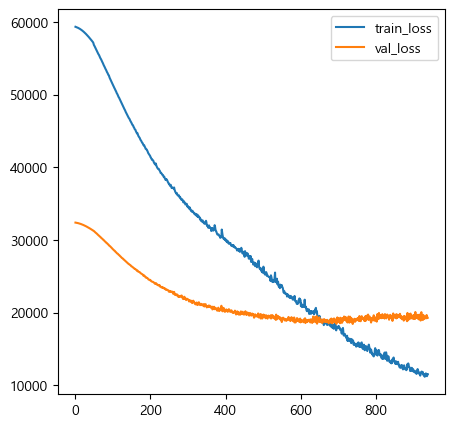

In [396]:
plt.plot(train_loss_ss_23_m, label='train_loss')
plt.plot(val_loss_ss_23_m, label='val_loss')
plt.legend()
plt.show()

In [397]:
val_r2_ss_23_m, val_mae_ss_23_m = test(valid_loader_ss_23_m, model_ss_23_m, isEDR=isEDR)

y_label :  6971.689453125 y_pred :  10940.4228515625
y_label :  6345.48046875 y_pred :  11927.0634765625
y_label :  6253.83935546875 y_pred :  10840.638671875
y_label :  7224.60400390625 y_pred :  7432.99072265625
y_label :  10023.947265625 y_pred :  7261.85205078125
y_label :  7701.9111328125 y_pred :  6657.978515625
y_label :  8976.8876953125 y_pred :  12173.970703125
y_label :  4314.79296875 y_pred :  12125.79296875
y_label :  4994.40869140625 y_pred :  8937.7421875
y_label :  4565.1748046875 y_pred :  11460.677734375
y_label :  5115.21826171875 y_pred :  11529.4912109375
y_label :  7166.88623046875 y_pred :  9675.7314453125
y_label :  4731.9931640625 y_pred :  11235.9580078125
y_label :  4715.27490234375 y_pred :  10843.5595703125
y_label :  5030.861328125 y_pred :  11337.751953125
y_label :  5311.326171875 y_pred :  11590.7158203125
y_label :  5947.44873046875 y_pred :  12147.66015625
y_label :  10201.703125 y_pred :  12147.400390625
y_label :  12010.865234375 y_pred :  12106.9394

In [398]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_23_m, test_mae_ss_23_m = test(test_loader_ss_23_m, model_ss_23_m, isEDR=isEDR)
y_label_ss_23_m = y_label_plt
y_pred_ss_23_m = y_pred_plt

y_label :  7158.04443359375 y_pred :  9872.32421875
y_label :  9287.556640625 y_pred :  8636.005859375
y_label :  13307.5322265625 y_pred :  7336.72216796875
y_label :  15576.271484375 y_pred :  6083.26513671875
y_label :  5865.01904296875 y_pred :  5246.26025390625
y_label :  5443.82177734375 y_pred :  5226.41259765625
y_label :  2711.306396484375 y_pred :  5307.61669921875
y_label :  5682.10498046875 y_pred :  5345.20556640625
y_label :  7950.78955078125 y_pred :  3973.49169921875
y_label :  7799.546875 y_pred :  2442.010009765625
y_label :  2257.879638671875 y_pred :  3153.465087890625
y_label :  840.6073608398438 y_pred :  5169.36474609375
y_label :  1142.6639404296875 y_pred :  2857.085205078125
y_label :  1716.3270263671875 y_pred :  1668.0079345703125
y_label :  5125.67919921875 y_pred :  1434.1624755859375
y_label :  6663.87353515625 y_pred :  2362.430419921875
y_label :  12179.8935546875 y_pred :  11946.9404296875
y_label :  13057.9384765625 y_pred :  12105.265625
y_label :  1

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-609.4237792968751, 12797.899365234374)


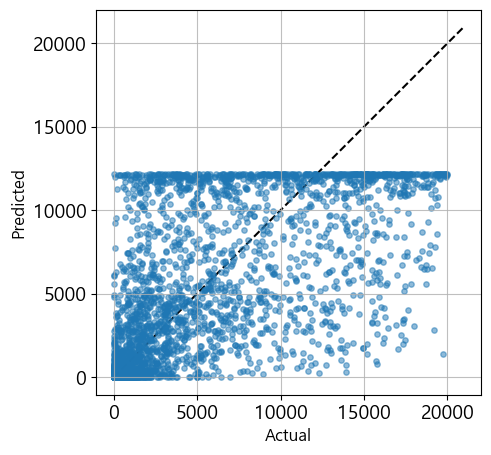

In [399]:
plot_scatter(y_label_ss_23_m, y_pred_ss_23_m)

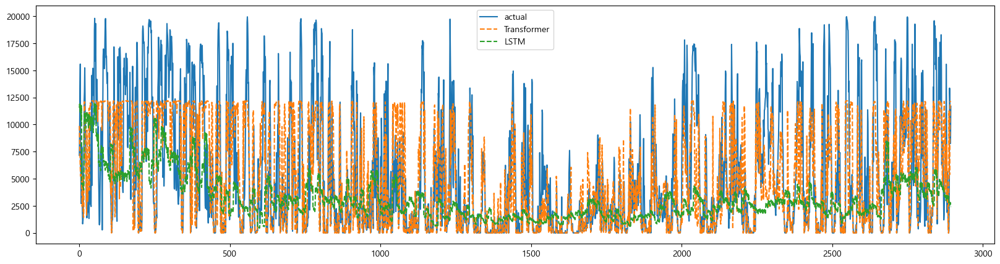

In [400]:
# 지민형 Transformer(E-D)
_start = 0
_end = -1
plt.figure(figsize=(20, 5))
plt.plot(y_label_ss_23_m[_start:_end], label='actual')
plt.plot(y_pred_ss_23_m[_start:_end], '--', label='Transformer')
plt.plot(prediction_ss_23_m_re[_start:_end], '--', label='LSTM')
plt.legend()

In [401]:
# ss_multi_31
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_31_m.parameters(), lr=lr)
train_loss_ss_31_m, val_loss_ss_31_m = trainer(train_loader_ss_31_m, valid_loader_ss_31_m, model_ss_31_m, criterion, optimizer, target='ss', n_epoch=1000, PATH=PATH, isEDR=isEDR)
model_ss_31_m.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.8847363276117064
MAE Loss:  4920.451765883047
Validation
R2 score: -0.8545314322588975
MAE Loss:  5225.825933222584
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8836859250283231
MAE Loss:  4918.156902626579
Validation
R2 score: -0.8540062215356496
MAE Loss:  5224.424298968301
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8830993136366201
MAE Loss:  4916.745853926653
Validation
R2 score: -0.8534452045814294
MAE Loss:  5222.931922542711
최신화
Epoch 3/1000
TRAIN
R2 score: -0.882460507458591
MAE Loss:  4915.217607605942
Validation
R2 score: -0.8528325116948778
MAE Loss:  5221.304455182848
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8817696427227648
MAE Loss:  4913.566463633419
Validation
R2 score: -0.8521627635354436
MAE Loss:  5219.532699697525
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8810182854248263
MAE Loss:  4911.781464763022
Validation
R2 score: -0.8514396250304963
MAE Loss:  5217.624963894734
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8802054442719689
MAE Loss:  4909.8652707057245
Validation

최신화
Epoch 54/1000
TRAIN
R2 score: -0.7806311900352609
MAE Loss:  4674.339254116746
Validation
R2 score: -0.7588543919567978
MAE Loss:  4995.002526492128
최신화
Epoch 55/1000
TRAIN
R2 score: -0.7768998781811831
MAE Loss:  4662.435214451047
Validation
R2 score: -0.7558585007059089
MAE Loss:  4987.691521869492
최신화
Epoch 56/1000
TRAIN
R2 score: -0.7733433080426133
MAE Loss:  4653.724446648385
Validation
R2 score: -0.7527740868058375
MAE Loss:  4981.648119549982
최신화
Epoch 57/1000
TRAIN
R2 score: -0.7698445580495819
MAE Loss:  4645.809212040294
Validation
R2 score: -0.7498925019690528
MAE Loss:  4974.2114467335
최신화
Epoch 58/1000
TRAIN
R2 score: -0.7663446541832117
MAE Loss:  4639.419435471867
Validation
R2 score: -0.746261262912977
MAE Loss:  4965.112097133828
최신화
Epoch 59/1000
TRAIN
R2 score: -0.7626372575373086
MAE Loss:  4629.472935401763
Validation
R2 score: -0.7427686161474221
MAE Loss:  4957.0821538160135
최신화
Epoch 60/1000
TRAIN
R2 score: -0.7588896595446328
MAE Loss:  4619.820344398129
V

최신화
Epoch 109/1000
TRAIN
R2 score: -0.552964769875111
MAE Loss:  4173.455204357668
Validation
R2 score: -0.5558678754031796
MAE Loss:  4552.207841117193
최신화
Epoch 110/1000
TRAIN
R2 score: -0.5484550752845239
MAE Loss:  4164.632736467526
Validation
R2 score: -0.5510708070351253
MAE Loss:  4539.66421300953
최신화
Epoch 111/1000
TRAIN
R2 score: -0.5442668991350383
MAE Loss:  4154.769541550014
Validation
R2 score: -0.5469177002816343
MAE Loss:  4530.554685473855
최신화
Epoch 112/1000
TRAIN
R2 score: -0.5399176626273006
MAE Loss:  4147.346592816781
Validation
R2 score: -0.5423621616990957
MAE Loss:  4521.1148244778615
최신화
Epoch 113/1000
TRAIN
R2 score: -0.5356489720961799
MAE Loss:  4140.7502275195
Validation
R2 score: -0.5383656227380724
MAE Loss:  4514.071166496446
최신화
Epoch 114/1000
TRAIN
R2 score: -0.531225685628028
MAE Loss:  4134.942092493973
Validation
R2 score: -0.5352899763330472
MAE Loss:  4508.933672894607
최신화
Epoch 115/1000
TRAIN
R2 score: -0.5259457155296949
MAE Loss:  4123.566032782

최신화
Epoch 163/1000
TRAIN
R2 score: -0.3140119350809023
MAE Loss:  3718.9500916726756
Validation
R2 score: -0.3415318411967856
MAE Loss:  4158.681414813257
최신화
Epoch 164/1000
TRAIN
R2 score: -0.3102815075536536
MAE Loss:  3711.594493606181
Validation
R2 score: -0.3366573401137183
MAE Loss:  4150.577708837604
최신화
Epoch 165/1000
TRAIN
R2 score: -0.3058688737542328
MAE Loss:  3700.7666529404482
Validation
R2 score: -0.33286865350925376
MAE Loss:  4143.397149351041
최신화
Epoch 166/1000
TRAIN
R2 score: -0.30124585830890416
MAE Loss:  3692.349336784208
Validation
R2 score: -0.328822300440363
MAE Loss:  4140.389255501433
최신화
Epoch 167/1000
TRAIN
R2 score: -0.29751712564722954
MAE Loss:  3686.4224359214645
Validation
R2 score: -0.325916910009046
MAE Loss:  4135.532372782146
최신화
Epoch 168/1000
TRAIN
R2 score: -0.29315593245706695
MAE Loss:  3679.0620238911597
Validation
R2 score: -0.32148874605130473
MAE Loss:  4130.13047669605
최신화
Epoch 169/1000
TRAIN
R2 score: -0.2888415384708738
MAE Loss:  3670

R2 score: -0.10526383266019179
MAE Loss:  3354.713645855637
Validation
R2 score: -0.1506496645110318
MAE Loss:  3854.042369351864
최신화
Epoch 217/1000
TRAIN
R2 score: -0.10170999909772016
MAE Loss:  3347.8360355976033
Validation
R2 score: -0.1476141114509293
MAE Loss:  3846.730022393642
최신화
Epoch 218/1000
TRAIN
R2 score: -0.09740547186842186
MAE Loss:  3343.6293954372954
Validation
R2 score: -0.14427977505108447
MAE Loss:  3844.4317145762434
최신화
Epoch 219/1000
TRAIN
R2 score: -0.09383225692811092
MAE Loss:  3333.7408018910255
Validation
R2 score: -0.14114884666767313
MAE Loss:  3845.267983066945
Epoch 220/1000
TRAIN
R2 score: -0.08993156419050474
MAE Loss:  3329.364093401046
Validation
R2 score: -0.13833761773920616
MAE Loss:  3836.056151489286
최신화
Epoch 221/1000
TRAIN
R2 score: -0.08547719580162916
MAE Loss:  3325.514430091736
Validation
R2 score: -0.13582656647257352
MAE Loss:  3827.5182717425796
최신화
Epoch 222/1000
TRAIN
R2 score: -0.08344709506009451
MAE Loss:  3318.295457682378
Valid

R2 score: 0.06498879676770386
MAE Loss:  3080.5937960144784
Validation
R2 score: -0.005369332085120693
MAE Loss:  3600.137829663722
최신화
Epoch 271/1000
TRAIN
R2 score: 0.06748294939853094
MAE Loss:  3099.97713885151
Validation
R2 score: 0.006057016639812618
MAE Loss:  3666.761169235008
Epoch 272/1000
TRAIN
R2 score: 0.06993410428678404
MAE Loss:  3077.8073323984117
Validation
R2 score: 0.009260698074446405
MAE Loss:  3633.307615090151
Epoch 273/1000
TRAIN
R2 score: 0.0759788696409166
MAE Loss:  3059.1806882720075
Validation
R2 score: 0.010773550283621702
MAE Loss:  3624.887882723579
Epoch 274/1000
TRAIN
R2 score: 0.07857597773594716
MAE Loss:  3059.941064589382
Validation
R2 score: 0.014473401950693354
MAE Loss:  3619.8425724871686
Epoch 275/1000
TRAIN
R2 score: 0.07664667346953014
MAE Loss:  3072.090195182646
Validation
R2 score: 0.016972693582313236
MAE Loss:  3650.907799531755
Epoch 276/1000
TRAIN
R2 score: 0.08045994289777492
MAE Loss:  3049.50737757545
Validation
R2 score: 0.021482

R2 score: 0.2038353571125735
MAE Loss:  2851.627711235985
Validation
R2 score: 0.12524656699836723
MAE Loss:  3479.3517072958216
Epoch 325/1000
TRAIN
R2 score: 0.2054666306366031
MAE Loss:  2842.6852566975895
Validation
R2 score: 0.12831566174771547
MAE Loss:  3472.6598891470157
Epoch 326/1000
TRAIN
R2 score: 0.20753569014490147
MAE Loss:  2841.3120578796265
Validation
R2 score: 0.1294276880698948
MAE Loss:  3492.552254316921
Epoch 327/1000
TRAIN
R2 score: 0.20601833370228406
MAE Loss:  2843.328206459383
Validation
R2 score: 0.13140457463193556
MAE Loss:  3492.5614655779423
Epoch 328/1000
TRAIN
R2 score: 0.21048568898148
MAE Loss:  2836.254850137538
Validation
R2 score: 0.13225766762625613
MAE Loss:  3455.4725086605204
Epoch 329/1000
TRAIN
R2 score: 0.21545765420915586
MAE Loss:  2827.4991917836574
Validation
R2 score: 0.13009494772891161
MAE Loss:  3455.448959760925
최신화
Epoch 330/1000
TRAIN
R2 score: 0.21976827351789485
MAE Loss:  2825.2476938208056
Validation
R2 score: 0.127854574428

R2 score: 0.3104210722902211
MAE Loss:  2652.6019127868326
Validation
R2 score: 0.22312926228094165
MAE Loss:  3329.0277378785727
Epoch 381/1000
TRAIN
R2 score: 0.311620832510202
MAE Loss:  2659.7638865181048
Validation
R2 score: 0.2243572280156353
MAE Loss:  3334.9588521746637
Epoch 382/1000
TRAIN
R2 score: 0.30888015120243495
MAE Loss:  2667.1149672058204
Validation
R2 score: 0.22978387861063265
MAE Loss:  3314.4571365987745
Epoch 383/1000
TRAIN
R2 score: 0.3171592344029137
MAE Loss:  2666.37316303174
Validation
R2 score: 0.22191750437409163
MAE Loss:  3292.3336524021015
최신화
Epoch 384/1000
TRAIN
R2 score: 0.3164521031629822
MAE Loss:  2650.2194867782787
Validation
R2 score: 0.2231396829086768
MAE Loss:  3306.7669112109825
Epoch 385/1000
TRAIN
R2 score: 0.31608162756116553
MAE Loss:  2650.921558055996
Validation
R2 score: 0.23096756112231198
MAE Loss:  3306.0032104218685
Epoch 386/1000
TRAIN
R2 score: 0.3188330141595733
MAE Loss:  2653.760266954686
Validation
R2 score: 0.2349147323933

R2 score: 0.39969103940584405
MAE Loss:  2488.260314328247
Validation
R2 score: 0.2845158855400466
MAE Loss:  3254.5691020380386
Epoch 436/1000
TRAIN
R2 score: 0.4047383396465575
MAE Loss:  2475.984510286415
Validation
R2 score: 0.2771790773794425
MAE Loss:  3265.462997164897
Epoch 437/1000
TRAIN
R2 score: 0.4041065233212703
MAE Loss:  2479.2143878917927
Validation
R2 score: 0.2833879342843676
MAE Loss:  3256.0432546445663
Epoch 438/1000
TRAIN
R2 score: 0.40617991701487555
MAE Loss:  2470.500728654168
Validation
R2 score: 0.28510439340171045
MAE Loss:  3302.5593467838135
Epoch 439/1000
TRAIN
R2 score: 0.4056566266333351
MAE Loss:  2472.4261077995693
Validation
R2 score: 0.28528445552635306
MAE Loss:  3288.1842694344036
Epoch 440/1000
TRAIN
R2 score: 0.40562568169719737
MAE Loss:  2483.3559216430217
Validation
R2 score: 0.28715726606715775
MAE Loss:  3247.6279155549664
Epoch 441/1000
TRAIN
R2 score: 0.41530098995691644
MAE Loss:  2455.1638119733184
Validation
R2 score: 0.289871452102487

R2 score: 0.4769675799330435
MAE Loss:  2329.617132435064
Validation
R2 score: 0.342619961001031
MAE Loss:  3169.9411522062323
Epoch 492/1000
TRAIN
R2 score: 0.47395153881836205
MAE Loss:  2338.1149987678327
Validation
R2 score: 0.34960310272943607
MAE Loss:  3112.6724575123753
최신화
Epoch 493/1000
TRAIN
R2 score: 0.4720864628200132
MAE Loss:  2334.7354274745635
Validation
R2 score: 0.337411592153145
MAE Loss:  3207.983082181013
Epoch 494/1000
TRAIN
R2 score: 0.4771450459714611
MAE Loss:  2331.3641840056293
Validation
R2 score: 0.34536250576482264
MAE Loss:  3159.1108871811275
Epoch 495/1000
TRAIN
R2 score: 0.47550985951992153
MAE Loss:  2330.087641641461
Validation
R2 score: 0.336243712997519
MAE Loss:  3206.7305813557637
Epoch 496/1000
TRAIN
R2 score: 0.48455756676041684
MAE Loss:  2307.809479631747
Validation
R2 score: 0.33534037859534804
MAE Loss:  3176.1245539630672
Epoch 497/1000
TRAIN
R2 score: 0.4718086052350443
MAE Loss:  2338.5473819638905
Validation
R2 score: 0.345797511738119

R2 score: 0.5452547516152324
MAE Loss:  2200.4093774680337
Validation
R2 score: 0.35502297481508205
MAE Loss:  3101.506107111036
Epoch 548/1000
TRAIN
R2 score: 0.545102144087211
MAE Loss:  2180.5237768734983
Validation
R2 score: 0.3526212780401018
MAE Loss:  3189.354915757568
Epoch 549/1000
TRAIN
R2 score: 0.5402672379710138
MAE Loss:  2194.8456863005076
Validation
R2 score: 0.3536376987324511
MAE Loss:  3171.0999041887985
Epoch 550/1000
TRAIN
R2 score: 0.5480907240134254
MAE Loss:  2180.5738031041315
Validation
R2 score: 0.3713956728604437
MAE Loss:  3139.611348424819
Epoch 551/1000
TRAIN
R2 score: 0.5379915380599232
MAE Loss:  2199.0628044839355
Validation
R2 score: 0.3527098917820952
MAE Loss:  3190.8060606591343
Epoch 552/1000
TRAIN
R2 score: 0.547710876087844
MAE Loss:  2178.972894314216
Validation
R2 score: 0.3559668232610729
MAE Loss:  3191.626518888528
Epoch 553/1000
TRAIN
R2 score: 0.5530835041271736
MAE Loss:  2153.4123377412684
Validation
R2 score: 0.36744584510898515
MAE Lo

R2 score: 0.6102428954824035
MAE Loss:  2001.1225316015239
Validation
R2 score: 0.3426401153091553
MAE Loss:  3235.6166981124934
Epoch 604/1000
TRAIN
R2 score: 0.6128983590125138
MAE Loss:  1989.5748799475161
Validation
R2 score: 0.33241149122242264
MAE Loss:  3234.400892464222
Epoch 605/1000
TRAIN
R2 score: 0.6195532471429805
MAE Loss:  1987.731550656632
Validation
R2 score: 0.3408506756506169
MAE Loss:  3166.797492708505
Epoch 606/1000
TRAIN
R2 score: 0.6210656211228791
MAE Loss:  1985.009222600224
Validation
R2 score: 0.33982984097301316
MAE Loss:  3151.0344699832335
Epoch 607/1000
TRAIN
R2 score: 0.6187458547432161
MAE Loss:  1983.8824982097206
Validation
R2 score: 0.33247556651098886
MAE Loss:  3162.991477012283
Epoch 608/1000
TRAIN
R2 score: 0.6214562875103331
MAE Loss:  1994.934362662406
Validation
R2 score: 0.35205728591069785
MAE Loss:  3190.3091068748085
Epoch 609/1000
TRAIN
R2 score: 0.6091558719685897
MAE Loss:  2018.3507912998691
Validation
R2 score: 0.35230750112186393
MA

R2 score: 0.6700031631639398
MAE Loss:  1840.1491524222506
Validation
R2 score: 0.3060953521344407
MAE Loss:  3278.325503775102
Epoch 660/1000
TRAIN
R2 score: 0.6737469006311888
MAE Loss:  1833.8214189952541
Validation
R2 score: 0.3186321123397695
MAE Loss:  3233.294431458034
Epoch 661/1000
TRAIN
R2 score: 0.6796569136777866
MAE Loss:  1800.1570560295522
Validation
R2 score: 0.3172766992195195
MAE Loss:  3206.0372825733634
Epoch 662/1000
TRAIN
R2 score: 0.6797202803348983
MAE Loss:  1817.2511367272928
Validation
R2 score: 0.3278290633457409
MAE Loss:  3192.5566464515396
Epoch 663/1000
TRAIN
R2 score: 0.6811304507458069
MAE Loss:  1805.658903891283
Validation
R2 score: 0.3235383596489356
MAE Loss:  3205.300659851994
Epoch 664/1000
TRAIN
R2 score: 0.6809630229662588
MAE Loss:  1810.9855598942595
Validation
R2 score: 0.3485766678539054
MAE Loss:  3158.198320016946
Epoch 665/1000
TRAIN
R2 score: 0.6841869642278746
MAE Loss:  1774.729728000754
Validation
R2 score: 0.2946074523580734
MAE Los

<All keys matched successfully>

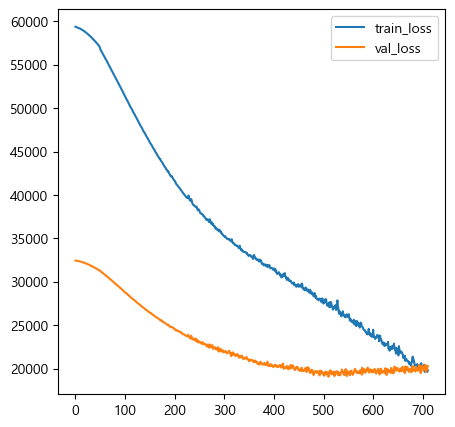

In [402]:
plt.plot(train_loss_ss_31_m, label='train_loss')
plt.plot(val_loss_ss_31_m, label='val_loss')
plt.legend()
plt.show()

In [403]:
val_r2_ss_31_m, val_mae_ss_31_m = test(valid_loader_ss_31_m, model_ss_31_m, isEDR=isEDR)

y_label :  4994.40869140625 y_pred :  7595.18359375
y_label :  4565.1748046875 y_pred :  7670.1083984375
y_label :  5115.21826171875 y_pred :  7648.10595703125
y_label :  7166.88623046875 y_pred :  7658.41552734375
y_label :  4731.9931640625 y_pred :  7668.9423828125
y_label :  4715.27490234375 y_pred :  7646.41943359375
y_label :  5030.861328125 y_pred :  7649.49365234375
y_label :  5311.326171875 y_pred :  7660.84375
y_label :  5947.44873046875 y_pred :  7670.32763671875
y_label :  10201.703125 y_pred :  7665.75244140625
y_label :  12010.865234375 y_pred :  7664.2080078125
y_label :  12519.9326171875 y_pred :  7661.67822265625
y_label :  18139.076171875 y_pred :  7666.01318359375
y_label :  18763.1171875 y_pred :  7667.17578125
y_label :  11709.197265625 y_pred :  7667.65771484375
y_label :  15659.7265625 y_pred :  7667.7236328125
y_label :  10077.876953125 y_pred :  7669.97119140625
y_label :  13525.5322265625 y_pred :  7636.44482421875
y_label :  10316.4599609375 y_pred :  7600.111

In [404]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_31_m, test_mae_ss_31_m = test(test_loader_ss_31_m, model_ss_31_m, isEDR=isEDR)
y_label_ss_31_m = y_label_plt
y_pred_ss_31_m = y_pred_plt

y_label :  7950.78955078125 y_pred :  3495.888427734375
y_label :  7799.546875 y_pred :  3961.977294921875
y_label :  2257.879638671875 y_pred :  4673.65087890625
y_label :  840.6073608398438 y_pred :  4141.01513671875
y_label :  1142.6639404296875 y_pred :  5291.42431640625
y_label :  1716.3270263671875 y_pred :  6136.7978515625
y_label :  5125.67919921875 y_pred :  5841.75732421875
y_label :  6663.87353515625 y_pred :  6608.14013671875
y_label :  12179.8935546875 y_pred :  7622.13916015625
y_label :  13057.9384765625 y_pred :  7602.16748046875
y_label :  15228.9111328125 y_pred :  7614.31591796875
y_label :  12109.994140625 y_pred :  7566.5185546875
y_label :  9457.2822265625 y_pred :  7583.873046875
y_label :  6682.24462890625 y_pred :  7596.23779296875
y_label :  5684.77880859375 y_pred :  7591.859375
y_label :  2934.8330078125 y_pred :  3082.781005859375
y_label :  2168.529052734375 y_pred :  5311.42822265625
y_label :  1395.414306640625 y_pred :  6400.49267578125
y_label :  1676.

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-383.7282958984375, 8058.294213867188)


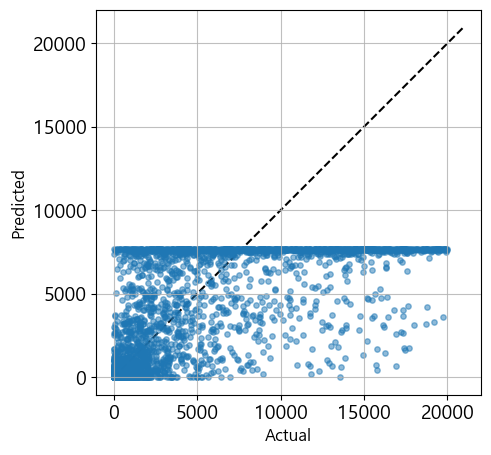

In [405]:
plot_scatter(y_label_ss_31_m, y_pred_ss_31_m)

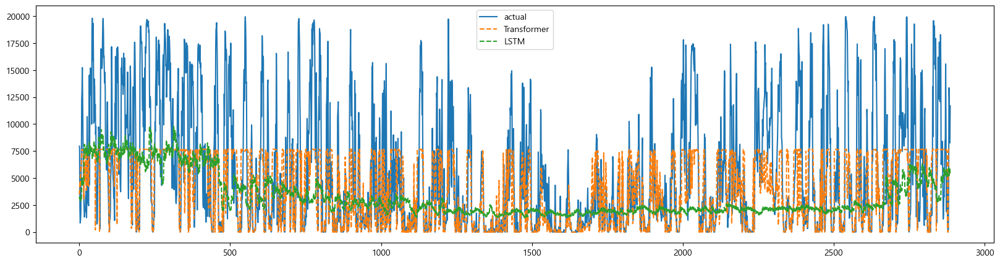

In [406]:
# 지민형 Transformer(E-D)
_start = 0
_end = -1
plt.figure(figsize=(20, 5))
plt.plot(y_label_ss_31_m[_start:_end], label='actual')
plt.plot(y_pred_ss_31_m[_start:_end], '--', label='Transformer')
plt.plot(prediction_ss_31_m_re[_start:_end], '--', label='LSTM')
plt.legend()

In [706]:
time_lag_hk1_m_lstm = []
time_lag_hk1_m_lstm.append(model_score_test(testY_hk1_15_m_re.reshape(-1,1),prediction_hk1_15_m_re)[1])
time_lag_hk1_m_lstm.append(model_score_test(testY_hk1_23_m_re.reshape(-1,1),prediction_hk1_23_m_re)[1])
time_lag_hk1_m_lstm.append(model_score_test(testY_hk1_31_m_re.reshape(-1,1),prediction_hk1_31_m_re)[1])
print(time_lag_hk1_m_lstm)

time_lag_hk1_m_trans = []
time_lag_hk1_m_trans.append(model_score_test(y_label_hk1_15_m,y_pred_hk1_15_m)[1])
time_lag_hk1_m_trans.append(model_score_test(y_label_hk1_23_m,y_pred_hk1_23_m)[1])
time_lag_hk1_m_trans.append(model_score_test(y_label_hk1_31_m,y_pred_hk1_31_m)[1])
time_lag_hk1_m_trans
print(time_lag_hk1_m_trans)

R2 score: 0.4205530149532478
MAE Loss:  689.0196401497896
R2 score: 0.15004705920065775
MAE Loss:  870.2957403756963
R2 score: 0.13401126301503452
MAE Loss:  917.4348458056838
[689.0196401497896, 870.2957403756963, 917.4348458056838]
R2 score: 0.6332574206359596
MAE Loss:  523.9386661251373
R2 score: 0.6032900116874166
MAE Loss:  547.4947233912908
R2 score: 0.5514143701447582
MAE Loss:  582.4891236729685
[523.9386661251373, 547.4947233912908, 582.4891236729685]


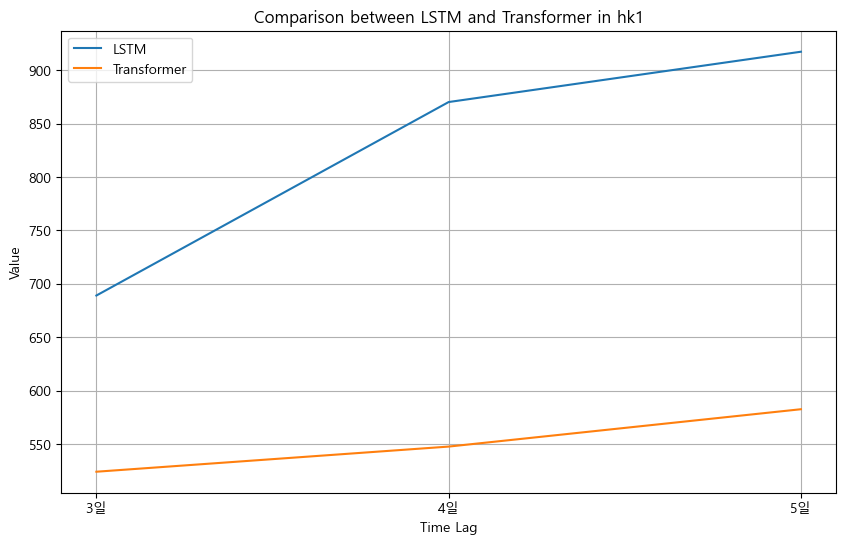

In [714]:
# x 축 데이터 (예: 3, 4, 5)
x_values = [3, 4, 5]

# 그래프 그리기
plt.figure(figsize=(10, 6))
plt.plot(x_values, time_lag_hk1_m_lstm, label='LSTM')
plt.plot(x_values, time_lag_hk1_m_trans, label='Transformer')
plt.xlabel('Time Lag')
plt.ylabel('Value')
plt.title('Comparison between LSTM and Transformer in hk1')
plt.legend()
plt.grid(True)

# x 축 레이블 설정
plt.xticks(x_values, ['3일', '4일', '5일'])

plt.show()

In [713]:
time_lag_hk2_m_lstm = []
time_lag_hk2_m_lstm.append(model_score_test(testY_hk2_15_m_re.reshape(-1,1),prediction_hk2_15_m_re)[1])
time_lag_hk2_m_lstm.append(model_score_test(testY_hk2_23_m_re.reshape(-1,1),prediction_hk2_23_m_re)[1])
time_lag_hk2_m_lstm.append(model_score_test(testY_hk2_31_m_re.reshape(-1,1),prediction_hk2_31_m_re)[1])
print(time_lag_hk2_m_lstm)

time_lag_hk2_m_trans = []
time_lag_hk2_m_trans.append(model_score_test(y_label_hk2_15_m,y_pred_hk2_15_m)[1])
time_lag_hk2_m_trans.append(model_score_test(y_label_hk2_23_m,y_pred_hk2_23_m)[1])
time_lag_hk2_m_trans.append(model_score_test(y_label_hk2_31_m,y_pred_hk2_31_m)[1])
time_lag_hk2_m_trans
print(time_lag_hk2_m_trans)

R2 score: 0.08458196324509726
MAE Loss:  2140.5477468429676
R2 score: -0.040234705716517105
MAE Loss:  2350.602890437888
R2 score: -0.17621978952568096
MAE Loss:  2515.852257099402
[2140.5477468429676, 2350.602890437888, 2515.852257099402]
R2 score: 0.4870027596541129
MAE Loss:  1724.1364939714035
R2 score: 0.4852616756857744
MAE Loss:  1708.6992630655611
R2 score: 0.4187250116907141
MAE Loss:  1794.2100902863149
[1724.1364939714035, 1708.6992630655611, 1794.2100902863149]


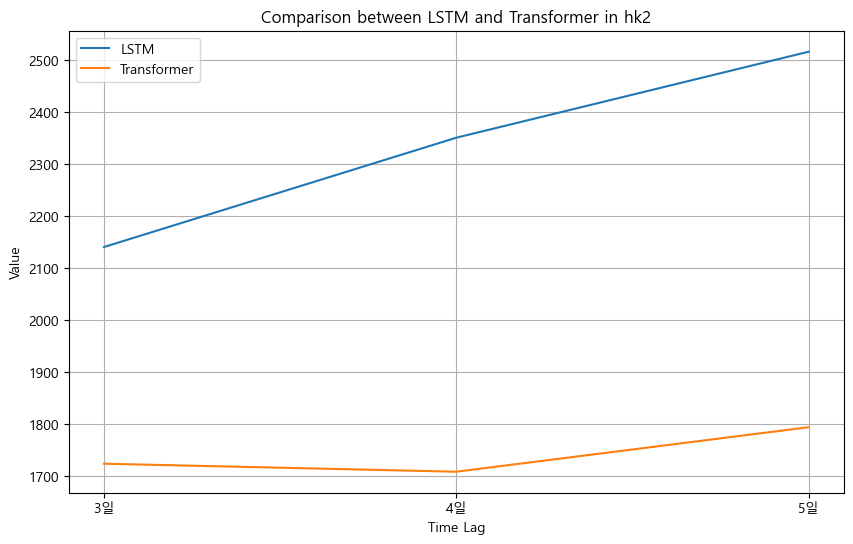

In [715]:
# x 축 데이터 (예: 3, 4, 5)
x_values = [3, 4, 5]

# 그래프 그리기
plt.figure(figsize=(10, 6))
plt.plot(x_values, time_lag_hk2_m_lstm, label='LSTM')
plt.plot(x_values, time_lag_hk2_m_trans, label='Transformer')
plt.xlabel('Time Lag')
plt.ylabel('Value')
plt.title('Comparison between LSTM and Transformer in hk2')
plt.legend()
plt.grid(True)

# x 축 레이블 설정
plt.xticks(x_values, ['3일', '4일', '5일'])

plt.show()

In [710]:
time_lag_ss_m_lstm = []
time_lag_ss_m_lstm.append(model_score_test(testY_ss_15_m_re.reshape(-1,1),prediction_ss_15_m_re)[1])
time_lag_ss_m_lstm.append(model_score_test(testY_ss_23_m_re.reshape(-1,1),prediction_ss_23_m_re)[1])
time_lag_ss_m_lstm.append(model_score_test(testY_ss_31_m_re.reshape(-1,1),prediction_ss_31_m_re)[1])
print(time_lag_ss_m_lstm)

time_lag_ss_m_trans = []
time_lag_ss_m_trans.append(model_score_test(y_label_ss_15_m,y_pred_ss_15_m)[1])
time_lag_ss_m_trans.append(model_score_test(y_label_ss_23_m,y_pred_ss_23_m)[1])
time_lag_ss_m_trans.append(model_score_test(y_label_ss_31_m,y_pred_ss_31_m)[1])
time_lag_ss_m_trans
print(time_lag_ss_m_trans)

R2 score: 0.2188013743094419
MAE Loss:  3519.651632683063
R2 score: -0.10678004459132051
MAE Loss:  4159.495828394588
R2 score: -0.04688415325984119
MAE Loss:  4164.405574298516
[3519.651632683063, 4159.495828394588, 4164.405574298516]
R2 score: 0.36824129003548567
MAE Loss:  3026.884899731699
R2 score: 0.3626549567851167
MAE Loss:  3079.579897045903
R2 score: 0.37226683270509753
MAE Loss:  3025.0102818978194
[3026.884899731699, 3079.579897045903, 3025.0102818978194]


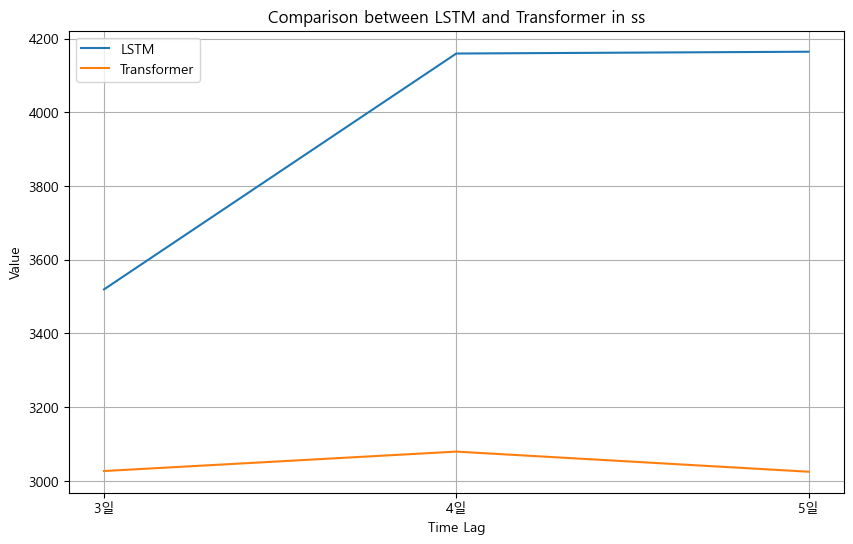

In [716]:
# x 축 데이터 (예: 3, 4, 5)
x_values = [3, 4, 5]

# 그래프 그리기
plt.figure(figsize=(10, 6))
plt.plot(x_values, time_lag_ss_m_lstm, label='LSTM')
plt.plot(x_values, time_lag_ss_m_trans, label='Transformer')
plt.xlabel('Time Lag')
plt.ylabel('Value')
plt.title('Comparison between LSTM and Transformer in ss')
plt.legend()
plt.grid(True)

# x 축 레이블 설정
plt.xticks(x_values, ['3일', '4일', '5일'])

plt.show()

In [1257]:
#ss_multi
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_m.parameters(), lr=lr)
train_loss_ss_m, val_loss_ss_m = trainer(train_loader_ss_m, valid_loader_ss_m, model_ss_m, criterion, optimizer, target='ss', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_ss_m.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.8872460784586154
MAE Loss:  4936.558116328839
Validation
R2 score: -0.8544142791274973
MAE Loss:  5216.842853060726
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8845896047307917
MAE Loss:  4930.241725952456
Validation
R2 score: -0.8516761907209707
MAE Loss:  5209.63338900298
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8812369682054395
MAE Loss:  4922.31286873485
Validation
R2 score: -0.8481813798895887
MAE Loss:  5200.572832538693
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8770590107586274
MAE Loss:  4912.584572276711
Validation
R2 score: -0.843956422167955
MAE Loss:  5189.760144274056
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8721039270558288
MAE Loss:  4901.275922156179
Validation
R2 score: -0.8390738505052839
MAE Loss:  5177.527559944708
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8664310978258594
MAE Loss:  4888.519962508377
Validation
R2 score: -0.8335405335325783
MAE Loss:  5163.9891426605545
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8600476864453885
MAE Loss:  4874.331720813781
Validation
R

R2 score: -0.1715202884118907
MAE Loss:  3493.996638746171
Validation
R2 score: -0.2147731712919576
MAE Loss:  3916.684205402089
최신화
Epoch 55/1000
TRAIN
R2 score: -0.1564213878416314
MAE Loss:  3467.383086290704
Validation
R2 score: -0.19670224088226917
MAE Loss:  3907.4938502020045
최신화
Epoch 56/1000
TRAIN
R2 score: -0.14396789321466263
MAE Loss:  3452.6551105829744
Validation
R2 score: -0.1816331070952646
MAE Loss:  3892.5758877261733
최신화
Epoch 57/1000
TRAIN
R2 score: -0.13035399117429392
MAE Loss:  3423.6012552181282
Validation
R2 score: -0.17204659170493408
MAE Loss:  3869.963341284615
최신화
Epoch 58/1000
TRAIN
R2 score: -0.11402100235345403
MAE Loss:  3393.785289830815
Validation
R2 score: -0.15984917242271512
MAE Loss:  3841.1681634001125
최신화
Epoch 59/1000
TRAIN
R2 score: -0.10653434638079906
MAE Loss:  3379.7835904498907
Validation
R2 score: -0.15995613253300323
MAE Loss:  3834.183497300469
최신화
Epoch 60/1000
TRAIN
R2 score: -0.09136480925191215
MAE Loss:  3365.2847428298433
Validat

R2 score: 0.29635021201888134
MAE Loss:  2765.830392060843
Validation
R2 score: 0.1911955000203278
MAE Loss:  3283.972213973068
최신화
Epoch 109/1000
TRAIN
R2 score: 0.2986415493252298
MAE Loss:  2749.6011753213857
Validation
R2 score: 0.2207291259890014
MAE Loss:  3292.914101323949
Epoch 110/1000
TRAIN
R2 score: 0.30543579535785126
MAE Loss:  2748.121650847639
Validation
R2 score: 0.20685117735569658
MAE Loss:  3259.0745133246724
최신화
Epoch 111/1000
TRAIN
R2 score: 0.3075179499746411
MAE Loss:  2749.4597579069864
Validation
R2 score: 0.23089532016122793
MAE Loss:  3273.2319565731877
Epoch 112/1000
TRAIN
R2 score: 0.3123984228550277
MAE Loss:  2740.4941354628027
Validation
R2 score: 0.20485964310889926
MAE Loss:  3288.0921330405577
Epoch 113/1000
TRAIN
R2 score: 0.31321737845705877
MAE Loss:  2744.4569100728327
Validation
R2 score: 0.2338202985155453
MAE Loss:  3288.1350776726795
Epoch 114/1000
TRAIN
R2 score: 0.3259496979182068
MAE Loss:  2717.039674110731
Validation
R2 score: 0.236278414

R2 score: 0.4952678720044025
MAE Loss:  2384.121144598334
Validation
R2 score: 0.39817057011532153
MAE Loss:  3045.1356844657175
Epoch 164/1000
TRAIN
R2 score: 0.4941676286810448
MAE Loss:  2380.440870678865
Validation
R2 score: 0.3947607279835891
MAE Loss:  3062.746094114011
Epoch 165/1000
TRAIN
R2 score: 0.5003398135699563
MAE Loss:  2371.233937617794
Validation
R2 score: 0.39877161724282884
MAE Loss:  3025.8592689209527
Epoch 166/1000
TRAIN
R2 score: 0.5059721295181411
MAE Loss:  2355.686623225833
Validation
R2 score: 0.3951650782858428
MAE Loss:  3090.401374891503
Epoch 167/1000
TRAIN
R2 score: 0.5035469361192586
MAE Loss:  2361.0586785631963
Validation
R2 score: 0.3834428289548376
MAE Loss:  3132.5458712973336
Epoch 168/1000
TRAIN
R2 score: 0.5045921837255924
MAE Loss:  2370.473148890364
Validation
R2 score: 0.39668487887330417
MAE Loss:  3084.181266577591
Epoch 169/1000
TRAIN
R2 score: 0.5090355183083601
MAE Loss:  2362.1684601623438
Validation
R2 score: 0.40092396936914676
MAE L

R2 score: 0.5781215763059293
MAE Loss:  2196.873949106926
Validation
R2 score: 0.4431554102111811
MAE Loss:  3016.1339805281973
Epoch 219/1000
TRAIN
R2 score: 0.5835993169605542
MAE Loss:  2173.6924734597605
Validation
R2 score: 0.4343478187912916
MAE Loss:  3067.118449527514
Epoch 220/1000
TRAIN
R2 score: 0.5861767011209761
MAE Loss:  2155.711259194739
Validation
R2 score: 0.4402892904722272
MAE Loss:  3070.100824914996
Epoch 221/1000
TRAIN
R2 score: 0.5901479746129691
MAE Loss:  2154.679350275959
Validation
R2 score: 0.43546831545342857
MAE Loss:  3058.4698344887574
Epoch 222/1000
TRAIN
R2 score: 0.5882415658201445
MAE Loss:  2153.250900640226
Validation
R2 score: 0.4296593095995296
MAE Loss:  3097.657127631392
Epoch 223/1000
TRAIN
R2 score: 0.5855969853713002
MAE Loss:  2162.1060274722918
Validation
R2 score: 0.45021078285104243
MAE Loss:  3008.5885083710277
Epoch 224/1000
TRAIN
R2 score: 0.5937046788888798
MAE Loss:  2135.0379517147844
Validation
R2 score: 0.42146159551348994
MAE L

R2 score: 0.6355953066089512
MAE Loss:  1999.7839331491964
Validation
R2 score: 0.43264122998897825
MAE Loss:  3106.3001808568056
Epoch 274/1000
TRAIN
R2 score: 0.62570290796863
MAE Loss:  2027.6803843219518
Validation
R2 score: 0.4354110724571634
MAE Loss:  3053.1319791554542
Epoch 275/1000
TRAIN
R2 score: 0.6367636797649465
MAE Loss:  2000.2299337352329
Validation
R2 score: 0.4407490799225027
MAE Loss:  3042.5096347414305
Epoch 276/1000
TRAIN
R2 score: 0.6403947090339738
MAE Loss:  1990.8256112720192
Validation
R2 score: 0.44261273802367773
MAE Loss:  3024.027070617524
Epoch 277/1000
TRAIN
R2 score: 0.6312974224401433
MAE Loss:  2005.2084687675633
Validation
R2 score: 0.45282369687526036
MAE Loss:  3015.2200024249264
Epoch 278/1000
TRAIN
R2 score: 0.6311358607119149
MAE Loss:  2010.2339530887216
Validation
R2 score: 0.441065317887101
MAE Loss:  3046.9662587281223
Epoch 279/1000
TRAIN
R2 score: 0.6367965521925987
MAE Loss:  1990.0318120029444
Validation
R2 score: 0.44954104542864204
M

R2 score: 0.6893146192245192
MAE Loss:  1813.1740781485264
Validation
R2 score: 0.4224038902776721
MAE Loss:  3014.2644032700086
Epoch 329/1000
TRAIN
R2 score: 0.6906911370483839
MAE Loss:  1796.5787376030773
Validation
R2 score: 0.42535160211456957
MAE Loss:  3025.6905989082475
Epoch 330/1000
TRAIN
R2 score: 0.6955227579694461
MAE Loss:  1794.6351018638784
Validation
R2 score: 0.432352316981346
MAE Loss:  2979.7836513767024
Epoch 331/1000
TRAIN
R2 score: 0.6979083468393323
MAE Loss:  1777.9267324794507
Validation
R2 score: 0.4234340753741761
MAE Loss:  3016.9125766119105
Epoch 332/1000
TRAIN
R2 score: 0.6873184068121257
MAE Loss:  1834.8943365664509
Validation
R2 score: 0.4059803911043065
MAE Loss:  3054.518096600477
Epoch 333/1000
TRAIN
R2 score: 0.6851516169099251
MAE Loss:  1826.099732949886
Validation
R2 score: 0.410048874874021
MAE Loss:  3114.894392157266
Epoch 334/1000
TRAIN
R2 score: 0.6947282461227249
MAE Loss:  1806.7760723123363
Validation
R2 score: 0.42689806666732877
MAE 

R2 score: 0.7453054312576124
MAE Loss:  1594.2854394163483
Validation
R2 score: 0.3738871928566133
MAE Loss:  3108.443354714385
Epoch 384/1000
TRAIN
R2 score: 0.735019117976226
MAE Loss:  1658.0925237437737
Validation
R2 score: 0.3998525066594518
MAE Loss:  3006.467439502868
Epoch 385/1000
TRAIN
R2 score: 0.7455080041632768
MAE Loss:  1604.3506815759222
Validation
R2 score: 0.39050676176339016
MAE Loss:  3020.9836149433672
Epoch 386/1000
TRAIN
R2 score: 0.7488003786589883
MAE Loss:  1602.5235730551208
Validation
R2 score: 0.39146197004972794
MAE Loss:  3032.443567369308
Epoch 387/1000
TRAIN
R2 score: 0.7606002229072274
MAE Loss:  1550.5752854630578
Validation
R2 score: 0.39193759498399594
MAE Loss:  3017.116460596932
Epoch 388/1000
TRAIN
R2 score: 0.7549233356377152
MAE Loss:  1581.6379631817956
Validation
R2 score: 0.38841397993517246
MAE Loss:  3037.518690140143
Epoch 389/1000
TRAIN
R2 score: 0.7450497121233102
MAE Loss:  1616.3740165729118
Validation
R2 score: 0.40738853636548944
MA

R2 score: 0.794181083079096
MAE Loss:  1428.445834753378
Validation
R2 score: 0.3752291228321676
MAE Loss:  3036.9169116353937
Epoch 439/1000
TRAIN
R2 score: 0.8025690474268297
MAE Loss:  1399.6274146544256
Validation
R2 score: 0.3479316756942099
MAE Loss:  3058.6883316309736
Epoch 440/1000
TRAIN
R2 score: 0.7854632283762284
MAE Loss:  1458.3549461288399
Validation
R2 score: 0.3784017211017915
MAE Loss:  2996.593729233816
Epoch 441/1000
TRAIN
R2 score: 0.7934828404132098
MAE Loss:  1430.0976249102182
Validation
R2 score: 0.3690826991581131
MAE Loss:  3038.6037867710033
Epoch 442/1000
TRAIN
R2 score: 0.7930235466741915
MAE Loss:  1429.5229886228915
Validation
R2 score: 0.3579913113553608
MAE Loss:  3050.9133270555085
Epoch 443/1000
TRAIN
R2 score: 0.8002850772556528
MAE Loss:  1391.7431232929596
Validation
R2 score: 0.3403506305544727
MAE Loss:  3111.0777860322028
Epoch 444/1000
TRAIN
R2 score: 0.8043605917720499
MAE Loss:  1375.2068183227846
Validation
R2 score: 0.3641249519472278
MAE 

R2 score: 0.8324853496237795
MAE Loss:  1293.6268602009252
Validation
R2 score: 0.33897389044180526
MAE Loss:  3103.254942898128
Epoch 494/1000
TRAIN
R2 score: 0.8286514216350908
MAE Loss:  1292.3284008144203
Validation
R2 score: 0.34702202839611385
MAE Loss:  3061.8613043704554
Epoch 495/1000
TRAIN
R2 score: 0.8214076367616067
MAE Loss:  1319.4601933256683
Validation
R2 score: 0.3226095573801623
MAE Loss:  3145.01124463647
Epoch 496/1000
TRAIN
R2 score: 0.811434984605924
MAE Loss:  1360.4052416499048
Validation
R2 score: 0.37720638873691703
MAE Loss:  2966.587679079885
Epoch 497/1000
TRAIN
R2 score: 0.8183666071500728
MAE Loss:  1330.2738546639414
Validation
R2 score: 0.32509353145775566
MAE Loss:  3118.9039919903867
Epoch 498/1000
TRAIN
R2 score: 0.8227370908760602
MAE Loss:  1301.0162746881285
Validation
R2 score: 0.3732476438711769
MAE Loss:  3011.2649094502212
Epoch 499/1000
TRAIN
R2 score: 0.8191366424047385
MAE Loss:  1328.3244024291482
Validation
R2 score: 0.3499307765531897
MA

<All keys matched successfully>

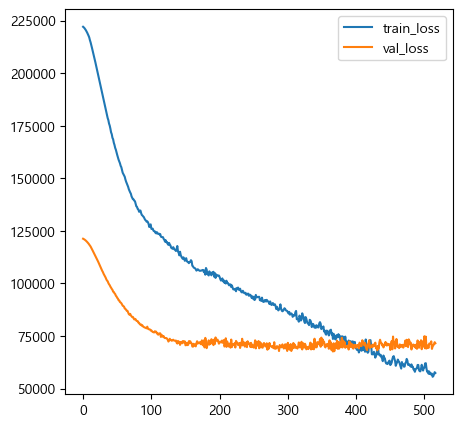

In [1258]:
plt.plot(train_loss_ss_m, label = 'train_loss')
plt.plot(val_loss_ss_m, label = 'val_loss')
plt.legend()
plt.show()

In [1387]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_m, test_mae_ss_m = test(test_loader_ss_m, model_ss_m, isEDR=isEDR)
y_label_ss_m = y_label_plt
y_pred_ss_m = y_pred_plt

y_label :  1610.261962890625 y_pred :  7440.19677734375
y_label :  8492.4189453125 y_pred :  6569.70556640625
y_label :  13345.771484375 y_pred :  6127.9267578125
y_label :  11781.712890625 y_pred :  5614.47900390625
y_label :  11699.203125 y_pred :  5125.29443359375
y_label :  10247.5185546875 y_pred :  6375.73388671875
y_label :  8715.3447265625 y_pred :  6232.44775390625
y_label :  6992.30908203125 y_pred :  6280.97021484375
y_label :  7158.04443359375 y_pred :  11116.5810546875
y_label :  9287.556640625 y_pred :  11027.09765625
y_label :  13307.5322265625 y_pred :  9076.47265625
y_label :  15576.271484375 y_pred :  4555.45458984375
y_label :  5865.01904296875 y_pred :  3723.0751953125
y_label :  5443.82177734375 y_pred :  3363.156494140625
y_label :  2711.306396484375 y_pred :  7227.08740234375
y_label :  5682.10498046875 y_pred :  5866.2138671875
y_label :  7950.78955078125 y_pred :  3541.42724609375
y_label :  7799.546875 y_pred :  4454.50390625
y_label :  2257.879638671875 y_pre

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-700.116943359375, 14702.455810546875)


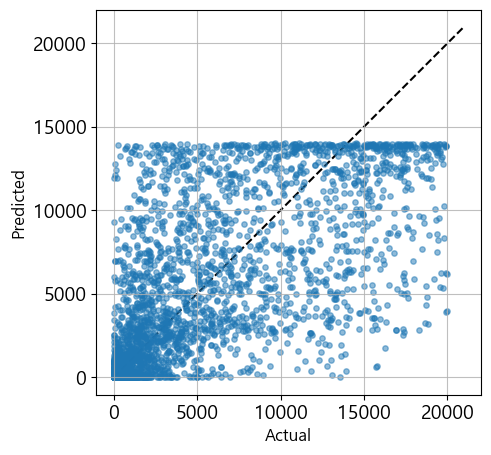

In [1388]:
plot_scatter(y_label_ss_m,y_pred_ss_m)

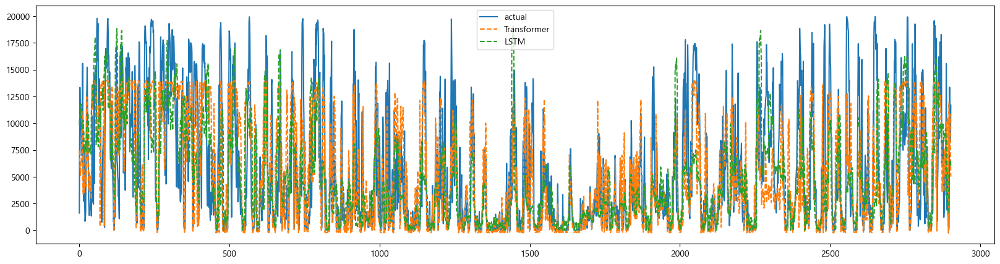

In [1261]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('')
plt.figure(figsize = (20,5))
plt.plot(y_label_ss_m[_start:_end],label = 'actual')
plt.plot(y_pred_ss_m[_start:_end],'--',label = 'Transformer')
plt.plot(prediction_ss_m_re[_start:_end], '--',label = 'LSTM')

plt.legend()

In [407]:
# ss_3일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_22.parameters(), lr=lr)
train_loss_ss_22, val_loss_ss_22 = trainer(train_loader_ss_22, valid_loader_ss_22, model_ss_22, criterion, optimizer, target='ss', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_ss_22.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.8848019453016904
MAE Loss:  4926.0988316535795
Validation
R2 score: -0.8543331216161414
MAE Loss:  5217.646926122618
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8782211708141474
MAE Loss:  4910.469935463512
Validation
R2 score: -0.8467942197669249
MAE Loss:  5198.280731057571
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8686106422009097
MAE Loss:  4888.422327499058
Validation
R2 score: -0.8365762266611714
MAE Loss:  5173.036875687301
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8561637064677097
MAE Loss:  4860.694339434041
Validation
R2 score: -0.8239000482558378
MAE Loss:  5142.621800017899
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8411906510793754
MAE Loss:  4828.217568359975
Validation
R2 score: -0.8090466052934127
MAE Loss:  5107.880099616501
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8239941488945808
MAE Loss:  4792.225918962637
Validation
R2 score: -0.7924323747607958
MAE Loss:  5069.273194585017
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8049369294873465
MAE Loss:  4753.7742392003065
Validati

R2 score: 0.13952763101036258
MAE Loss:  3210.426859968053
Validation
R2 score: 0.12787451743882494
MAE Loss:  3472.8984518757043
최신화
Epoch 55/1000
TRAIN
R2 score: 0.147657127877047
MAE Loss:  3198.2378330502784
Validation
R2 score: 0.1369887236807409
MAE Loss:  3489.893655986528
Epoch 56/1000
TRAIN
R2 score: 0.1507986131515232
MAE Loss:  3206.419761042055
Validation
R2 score: 0.14589743023377766
MAE Loss:  3452.7825328844233
최신화
Epoch 57/1000
TRAIN
R2 score: 0.15997423562727575
MAE Loss:  3185.3604752698443
Validation
R2 score: 0.15137778002114188
MAE Loss:  3432.377088020762
최신화
Epoch 58/1000
TRAIN
R2 score: 0.17121940318192952
MAE Loss:  3174.3072539973477
Validation
R2 score: 0.16111486090032456
MAE Loss:  3429.2665126629627
최신화
Epoch 59/1000
TRAIN
R2 score: 0.1769063884103853
MAE Loss:  3161.8593169467144
Validation
R2 score: 0.16654328381284933
MAE Loss:  3424.394142289799
최신화
Epoch 60/1000
TRAIN
R2 score: 0.18223158742988388
MAE Loss:  3162.8110727663075
Validation
R2 score: 0.1

R2 score: 0.3202162543599594
MAE Loss:  2951.411447140377
Validation
R2 score: 0.3493710189883369
MAE Loss:  3118.032647992634
최신화
Epoch 110/1000
TRAIN
R2 score: 0.31949123115541533
MAE Loss:  2954.343719851258
Validation
R2 score: 0.3522562802555377
MAE Loss:  3106.912196835895
최신화
Epoch 111/1000
TRAIN
R2 score: 0.32024507929992085
MAE Loss:  2947.637473304843
Validation
R2 score: 0.3501718542413278
MAE Loss:  3140.7469654351403
Epoch 112/1000
TRAIN
R2 score: 0.31796844084041187
MAE Loss:  2954.638845859424
Validation
R2 score: 0.3457890800436393
MAE Loss:  3135.483790387419
Epoch 113/1000
TRAIN
R2 score: 0.3210940328593448
MAE Loss:  2951.174261422874
Validation
R2 score: 0.3454102085822012
MAE Loss:  3128.2834475957397
Epoch 114/1000
TRAIN
R2 score: 0.31695052987853634
MAE Loss:  2949.696305079199
Validation
R2 score: 0.3441400281368503
MAE Loss:  3116.9212696122336
Epoch 115/1000
TRAIN
R2 score: 0.3249589098151263
MAE Loss:  2943.1336482764045
Validation
R2 score: 0.293607247613267

R2 score: 0.36778295146910156
MAE Loss:  2861.682054854776
Validation
R2 score: 0.39146787607335043
MAE Loss:  3037.7972765949894
Epoch 165/1000
TRAIN
R2 score: 0.35739954699616994
MAE Loss:  2883.395289431978
Validation
R2 score: 0.3891694347394833
MAE Loss:  3046.1268836198246
Epoch 166/1000
TRAIN
R2 score: 0.36395097011396293
MAE Loss:  2879.6649529724486
Validation
R2 score: 0.3874872346241528
MAE Loss:  3030.381964177663
최신화
Epoch 167/1000
TRAIN
R2 score: 0.36216537562550755
MAE Loss:  2872.8358389717387
Validation
R2 score: 0.3887843116214271
MAE Loss:  3031.6822226723843
Epoch 168/1000
TRAIN
R2 score: 0.36085178534922857
MAE Loss:  2880.0079268531185
Validation
R2 score: 0.39637987829474
MAE Loss:  3043.5061413417634
Epoch 169/1000
TRAIN
R2 score: 0.3597329497903978
MAE Loss:  2894.0515263295147
Validation
R2 score: 0.39315031511063214
MAE Loss:  3036.5914789083454
Epoch 170/1000
TRAIN
R2 score: 0.3618618644898657
MAE Loss:  2867.27209813081
Validation
R2 score: 0.39070081244063

R2 score: 0.3771682442447798
MAE Loss:  2829.54575052879
Validation
R2 score: 0.3849771906543087
MAE Loss:  3014.5433015410667
Epoch 220/1000
TRAIN
R2 score: 0.3866256893393937
MAE Loss:  2821.4030704469947
Validation
R2 score: 0.38995397642078355
MAE Loss:  3002.3702607943687
Epoch 221/1000
TRAIN
R2 score: 0.38035301011911904
MAE Loss:  2828.3389571291254
Validation
R2 score: 0.38912889287712205
MAE Loss:  3034.4042175533523
Epoch 222/1000
TRAIN
R2 score: 0.3720596474450327
MAE Loss:  2858.28946206449
Validation
R2 score: 0.3934492322167956
MAE Loss:  3011.8097468443752
Epoch 223/1000
TRAIN
R2 score: 0.38551732206514033
MAE Loss:  2822.237298837367
Validation
R2 score: 0.3927564176911825
MAE Loss:  2994.1758762889594
Epoch 224/1000
TRAIN
R2 score: 0.3902264472780719
MAE Loss:  2812.6595476632137
Validation
R2 score: 0.3892037893952187
MAE Loss:  3008.364606733491
Epoch 225/1000
TRAIN
R2 score: 0.38342528127252984
MAE Loss:  2809.03105689217
Validation
R2 score: 0.3870308778640823
MAE 

R2 score: 0.3973610684475998
MAE Loss:  2773.4701758403694
Validation
R2 score: 0.3598876429472698
MAE Loss:  3067.3825995861725
Epoch 275/1000
TRAIN
R2 score: 0.39159707425574775
MAE Loss:  2793.612041055704
Validation
R2 score: 0.3478204969901072
MAE Loss:  3074.029869311151
Epoch 276/1000
TRAIN
R2 score: 0.38717681075349597
MAE Loss:  2794.1362279176974
Validation
R2 score: 0.3517550366363469
MAE Loss:  3053.287359412563
Epoch 277/1000
TRAIN
R2 score: 0.3978701893205736
MAE Loss:  2777.7307648370693
Validation
R2 score: 0.33487931786731795
MAE Loss:  3092.2527963282773
Epoch 278/1000
TRAIN
R2 score: 0.39663058355879566
MAE Loss:  2772.236159637134
Validation
R2 score: 0.34990720967008926
MAE Loss:  3025.706270872828
Epoch 279/1000
TRAIN
R2 score: 0.4027690277995555
MAE Loss:  2752.0530547656085
Validation
R2 score: 0.3604068109450631
MAE Loss:  3000.985466604967
Epoch 280/1000
TRAIN
R2 score: 0.409335994191511
MAE Loss:  2738.6368641727936
Validation
R2 score: 0.36329598121904483
MA

R2 score: 0.40926833630318604
MAE Loss:  2727.6138852824483
Validation
R2 score: 0.3388229910529891
MAE Loss:  3060.111682032003
Epoch 330/1000
TRAIN
R2 score: 0.40200426223381636
MAE Loss:  2738.6625912975323
Validation
R2 score: 0.34998274221749437
MAE Loss:  3082.456411702732
Epoch 331/1000
TRAIN
R2 score: 0.41230714161190407
MAE Loss:  2739.0588295301895
Validation
R2 score: 0.3103250611079523
MAE Loss:  3133.316471096281
Epoch 332/1000
TRAIN
R2 score: 0.41129904348180313
MAE Loss:  2703.763656564879
Validation
R2 score: 0.36145937932592054
MAE Loss:  3018.8431633004557
Epoch 333/1000
TRAIN
R2 score: 0.4133727586499554
MAE Loss:  2706.781334221111
Validation
R2 score: 0.34723892536966205
MAE Loss:  3062.717241458428
Epoch 334/1000
TRAIN
R2 score: 0.4158350065144205
MAE Loss:  2706.732801406598
Validation
R2 score: 0.32266895572526033
MAE Loss:  3088.6617257026323
Epoch 335/1000
TRAIN
R2 score: 0.4166875334375273
MAE Loss:  2711.387085677668
Validation
R2 score: 0.3460497058028448
M

R2 score: 0.42406013287925015
MAE Loss:  2682.9517626607035
Validation
R2 score: 0.33118912386539257
MAE Loss:  3068.4576214404096
Epoch 385/1000
TRAIN
R2 score: 0.4256440577286691
MAE Loss:  2657.4675804428175
Validation
R2 score: 0.33745672467695187
MAE Loss:  3081.082678759751
Epoch 386/1000
TRAIN
R2 score: 0.42460082980645775
MAE Loss:  2682.8278473217506
Validation
R2 score: 0.32082041639174075
MAE Loss:  3101.212796437958
Epoch 387/1000
TRAIN
R2 score: 0.4193297105270559
MAE Loss:  2685.1189489342732
Validation
R2 score: 0.3454327860501516
MAE Loss:  3074.7506818625584
Epoch 388/1000
TRAIN
R2 score: 0.4345541502761343
MAE Loss:  2644.218815117716
Validation
R2 score: 0.3289062672148765
MAE Loss:  3117.8416289825336
Epoch 389/1000
TRAIN
R2 score: 0.41254726282309884
MAE Loss:  2707.8893547410717
Validation
R2 score: 0.35926936517324815
MAE Loss:  3063.756515326231
Epoch 390/1000
TRAIN
R2 score: 0.43494286352091593
MAE Loss:  2658.7761160904047
Validation
R2 score: 0.33575921041912

R2 score: 0.4446002752451357
MAE Loss:  2617.045616688685
Validation
R2 score: 0.32059648252942097
MAE Loss:  3136.412561204283
Epoch 440/1000
TRAIN
R2 score: 0.43149905179426773
MAE Loss:  2651.1858487719696
Validation
R2 score: 0.3323846511597799
MAE Loss:  3084.920791487549
Epoch 441/1000
TRAIN
R2 score: 0.4344149466686382
MAE Loss:  2636.747382440477
Validation
R2 score: 0.31863212544495867
MAE Loss:  3136.7430452491103
Epoch 442/1000
TRAIN
R2 score: 0.43041301588738945
MAE Loss:  2647.4964416999446
Validation
R2 score: 0.3281441854914523
MAE Loss:  3119.7657783342524
Epoch 443/1000
TRAIN
R2 score: 0.44262582174364695
MAE Loss:  2626.596584895779
Validation
R2 score: 0.3215870026562725
MAE Loss:  3113.8765264140957
Epoch 444/1000
TRAIN
R2 score: 0.44260146033580694
MAE Loss:  2616.952545909425
Validation
R2 score: 0.30848311095892744
MAE Loss:  3145.9944054013977
Epoch 445/1000
TRAIN
R2 score: 0.43201795586918845
MAE Loss:  2640.0294666323625
Validation
R2 score: 0.348769797285308


<All keys matched successfully>

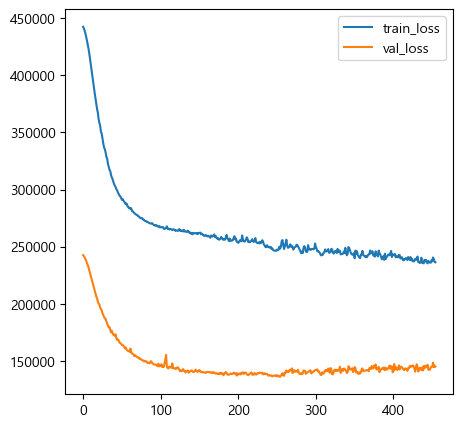

In [408]:
plt.plot(train_loss_ss_22, label='train_loss')
plt.plot(val_loss_ss_22, label='val_loss')
plt.legend()
plt.show()

In [409]:
val_r2_ss_22, val_mae_ss_22 = test(valid_loader_ss_22, model_ss_22, isEDR=isEDR)

y_label :  1166.79296875 y_pred :  5600.8330078125
y_label :  6971.689453125 y_pred :  5867.4677734375
y_label :  6345.48046875 y_pred :  5570.72412109375
y_label :  6253.83935546875 y_pred :  5162.36669921875
y_label :  7224.60400390625 y_pred :  5524.66455078125
y_label :  10023.947265625 y_pred :  1934.65234375
y_label :  7701.9111328125 y_pred :  6280.90478515625
y_label :  8976.8876953125 y_pred :  6847.15625
y_label :  4314.79296875 y_pred :  7333.5849609375
y_label :  4994.40869140625 y_pred :  6014.8115234375
y_label :  4565.1748046875 y_pred :  6915.8125
y_label :  5115.21826171875 y_pred :  5982.7138671875
y_label :  7166.88623046875 y_pred :  6586.24609375
y_label :  4731.9931640625 y_pred :  8606.611328125
y_label :  4715.27490234375 y_pred :  6545.134765625
y_label :  5030.861328125 y_pred :  6548.154296875
y_label :  5311.326171875 y_pred :  6902.44091796875
y_label :  5947.44873046875 y_pred :  8233.16015625
y_label :  10201.703125 y_pred :  11497.7998046875
y_label :  1

In [410]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_22, test_mae_ss_22 = test(test_loader_ss_22, model_ss_22, isEDR=isEDR)
y_label_ss_22 = y_label_plt
y_pred_ss_22 = y_pred_plt

y_label :  6992.30908203125 y_pred :  6085.974609375
y_label :  7158.04443359375 y_pred :  5545.24609375
y_label :  9287.556640625 y_pred :  5951.326171875
y_label :  13307.5322265625 y_pred :  5980.060546875
y_label :  15576.271484375 y_pred :  6283.10986328125
y_label :  5865.01904296875 y_pred :  6014.72265625
y_label :  5443.82177734375 y_pred :  3778.22216796875
y_label :  2711.306396484375 y_pred :  4854.8193359375
y_label :  5682.10498046875 y_pred :  2366.717041015625
y_label :  7950.78955078125 y_pred :  2625.048828125
y_label :  7799.546875 y_pred :  5042.8232421875
y_label :  2257.879638671875 y_pred :  2262.167236328125
y_label :  840.6073608398438 y_pred :  4107.6357421875
y_label :  1142.6639404296875 y_pred :  3197.816650390625
y_label :  1716.3270263671875 y_pred :  3498.956298828125
y_label :  5125.67919921875 y_pred :  4142.5244140625
y_label :  6663.87353515625 y_pred :  5921.8310546875
y_label :  12179.8935546875 y_pred :  8804.2216796875
y_label :  13057.9384765625

y_label :  172.50967407226562 y_pred :  2438.39697265625
y_label :  643.4630126953125 y_pred :  1488.00390625
y_label :  578.2916870117188 y_pred :  1791.122802734375
y_label :  2149.591064453125 y_pred :  2258.261962890625
y_label :  2030.9593505859375 y_pred :  2600.564208984375
y_label :  1273.97265625 y_pred :  2441.174560546875
y_label :  1561.3179931640625 y_pred :  2789.488037109375
y_label :  3002.57568359375 y_pred :  2948.902099609375
y_label :  1922.322998046875 y_pred :  2999.765380859375
y_label :  3266.919677734375 y_pred :  3057.21875
y_label :  5395.87109375 y_pred :  3262.492431640625
y_label :  7233.46484375 y_pred :  3517.819091796875
y_label :  7132.71142578125 y_pred :  3651.730224609375
y_label :  5468.7724609375 y_pred :  3214.584228515625
y_label :  8386.138671875 y_pred :  1980.023681640625
y_label :  8028.43798828125 y_pred :  959.3236694335938
y_label :  2975.07666015625 y_pred :  1769.4854736328125
y_label :  3047.290283203125 y_pred :  4508.73046875
y_label

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-582.4306640625, 12231.0439453125)


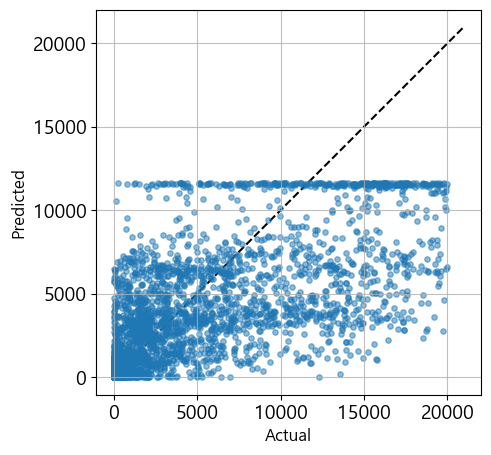

In [411]:
plot_scatter(y_label_ss_22, y_pred_ss_22)

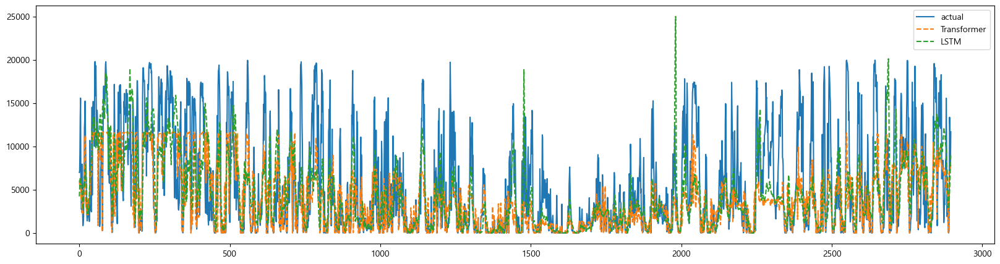

In [412]:
# 지민형 Transformer(E-D)
_start = 0
_end = -1
plt.figure(figsize=(20, 5))
plt.plot(y_label_ss_22[_start:_end], label='actual')
plt.plot(y_pred_ss_22[_start:_end], '--', label='Transformer')
plt.plot(prediction_ss_22[_start:_end], '--', label='LSTM')

plt.legend()

In [413]:
# ss_4일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_30.parameters(), lr=lr)
train_loss_ss_30, val_loss_ss_30 = trainer(train_loader_ss_30, valid_loader_ss_30, model_ss_30, criterion, optimizer, target='ss', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_ss_30.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.8829778908066981
MAE Loss:  4915.267468192676
Validation
R2 score: -0.8513736952483113
MAE Loss:  5213.768246668444
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8763552654438367
MAE Loss:  4899.524915810925
Validation
R2 score: -0.8438002572944934
MAE Loss:  5194.255777437041
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8667448442305983
MAE Loss:  4877.487026436002
Validation
R2 score: -0.833665897230629
MAE Loss:  5169.146054207228
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8543712707610094
MAE Loss:  4849.924344087873
Validation
R2 score: -0.8210874775073935
MAE Loss:  5138.8864466358755
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8394712016316992
MAE Loss:  4817.603555670722
Validation
R2 score: -0.8063561115223108
MAE Loss:  5104.3488580584735
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8223230496479423
MAE Loss:  4781.731206382651
Validation
R2 score: -0.7897182169147969
MAE Loss:  5066.537138755046
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8032171374319472
MAE Loss:  4743.134939431795
Validatio

R2 score: 0.14154780791988408
MAE Loss:  3200.7909791054412
Validation
R2 score: 0.13094416123923547
MAE Loss:  3487.845952006284
최신화
Epoch 55/1000
TRAIN
R2 score: 0.1539201834202817
MAE Loss:  3191.79801329674
Validation
R2 score: 0.13825416019260628
MAE Loss:  3487.1939222215165
최신화
Epoch 56/1000
TRAIN
R2 score: 0.14573646774255433
MAE Loss:  3204.3383300256028
Validation
R2 score: 0.1478053063870961
MAE Loss:  3464.985979475135
최신화
Epoch 57/1000
TRAIN
R2 score: 0.1652688465094153
MAE Loss:  3181.7109300908
Validation
R2 score: 0.150174354999426
MAE Loss:  3454.236246671619
최신화
Epoch 58/1000
TRAIN
R2 score: 0.17193424190689266
MAE Loss:  3170.916580825596
Validation
R2 score: 0.15785895842744813
MAE Loss:  3437.726078889407
최신화
Epoch 59/1000
TRAIN
R2 score: 0.1754713806504069
MAE Loss:  3162.467753120691
Validation
R2 score: 0.15981497101649955
MAE Loss:  3442.0903215542976
Epoch 60/1000
TRAIN
R2 score: 0.17764413330494422
MAE Loss:  3159.822408181331
Validation
R2 score: 0.171315554

R2 score: 0.31032554129388756
MAE Loss:  2953.9806957332894
Validation
R2 score: 0.320376485628054
MAE Loss:  3165.6257675760976
Epoch 110/1000
TRAIN
R2 score: 0.3105496565187533
MAE Loss:  2979.580081588856
Validation
R2 score: 0.3216990464437611
MAE Loss:  3136.6689246979404
최신화
Epoch 111/1000
TRAIN
R2 score: 0.3166270393826237
MAE Loss:  2937.478286899733
Validation
R2 score: 0.2914203961588566
MAE Loss:  3168.7785433309273
Epoch 112/1000
TRAIN
R2 score: 0.30573445195146154
MAE Loss:  2960.9135511357786
Validation
R2 score: 0.32064182963412924
MAE Loss:  3115.0445373674747
최신화
Epoch 113/1000
TRAIN
R2 score: 0.31290243344598123
MAE Loss:  2943.613415123829
Validation
R2 score: 0.29410034015959596
MAE Loss:  3169.975384805322
Epoch 114/1000
TRAIN
R2 score: 0.3077137405741971
MAE Loss:  2967.5933807753663
Validation
R2 score: 0.34304386040373325
MAE Loss:  3119.511390100777
Epoch 115/1000
TRAIN
R2 score: 0.3196023708952137
MAE Loss:  2939.004531022642
Validation
R2 score: 0.32226874267

R2 score: 0.36831142655220506
MAE Loss:  2836.0064802636734
Validation
R2 score: 0.3545494830060324
MAE Loss:  3052.3701857708897
Epoch 165/1000
TRAIN
R2 score: 0.3669743605513651
MAE Loss:  2831.71350684874
Validation
R2 score: 0.37460381475759463
MAE Loss:  3036.689332710564
Epoch 166/1000
TRAIN
R2 score: 0.37208695161406147
MAE Loss:  2836.7250189987863
Validation
R2 score: 0.3634037223901819
MAE Loss:  3040.7329956997246
Epoch 167/1000
TRAIN
R2 score: 0.3680806751901955
MAE Loss:  2842.313929253074
Validation
R2 score: 0.36542448659206683
MAE Loss:  3034.099547266466
최신화
Epoch 168/1000
TRAIN
R2 score: 0.36856217296027627
MAE Loss:  2836.1695628177035
Validation
R2 score: 0.3691805008349708
MAE Loss:  3021.931692681329
최신화
Epoch 169/1000
TRAIN
R2 score: 0.3715939557651299
MAE Loss:  2825.6797385701807
Validation
R2 score: 0.3853474765066648
MAE Loss:  3022.2571674435458
Epoch 170/1000
TRAIN
R2 score: 0.3754336285684464
MAE Loss:  2833.542077435955
Validation
R2 score: 0.371361924746

R2 score: 0.3900330275852921
MAE Loss:  2805.1490078349552
Validation
R2 score: 0.4182050830150572
MAE Loss:  2960.1850396188843
Epoch 220/1000
TRAIN
R2 score: 0.38472738253159466
MAE Loss:  2841.8268016709035
Validation
R2 score: 0.38120666114673785
MAE Loss:  3004.552096614319
Epoch 221/1000
TRAIN
R2 score: 0.39150392974874004
MAE Loss:  2785.3590294901715
Validation
R2 score: 0.3965588606008682
MAE Loss:  2984.610051013151
Epoch 222/1000
TRAIN
R2 score: 0.3709032153360998
MAE Loss:  2830.4247337827805
Validation
R2 score: 0.3895310695612375
MAE Loss:  2983.810623128303
Epoch 223/1000
TRAIN
R2 score: 0.3921848934511033
MAE Loss:  2807.7764876938213
Validation
R2 score: 0.37423389521368977
MAE Loss:  3025.3421388697334
Epoch 224/1000
TRAIN
R2 score: 0.38981176209590396
MAE Loss:  2805.2697031947287
Validation
R2 score: 0.3738598993266333
MAE Loss:  3029.9821561273516
Epoch 225/1000
TRAIN
R2 score: 0.3950031865344402
MAE Loss:  2786.1844034781466
Validation
R2 score: 0.3820907991427147

R2 score: 0.4391850290660759
MAE Loss:  2637.3584633796645
Validation
R2 score: 0.3455945365870734
MAE Loss:  2996.079765956472
Epoch 275/1000
TRAIN
R2 score: 0.4357092415522088
MAE Loss:  2635.1776302180606
Validation
R2 score: 0.3527477863669304
MAE Loss:  3007.5903991480563
Epoch 276/1000
TRAIN
R2 score: 0.4425887288486494
MAE Loss:  2633.007775840128
Validation
R2 score: 0.34012351952574327
MAE Loss:  3018.2532730970975
Epoch 277/1000
TRAIN
R2 score: 0.43750414092664014
MAE Loss:  2624.6456153206386
Validation
R2 score: 0.361095452893218
MAE Loss:  3000.9547540856147
Epoch 278/1000
TRAIN
R2 score: 0.431534244490158
MAE Loss:  2677.868039542395
Validation
R2 score: 0.31929307949338137
MAE Loss:  3049.028529995381
Epoch 279/1000
TRAIN
R2 score: 0.4290266044317982
MAE Loss:  2638.0364412526383
Validation
R2 score: 0.3582673282342015
MAE Loss:  3002.2807103938185
Epoch 280/1000
TRAIN
R2 score: 0.4211412160876554
MAE Loss:  2676.905820210381
Validation
R2 score: 0.366028311920908
MAE Lo

R2 score: 0.4733091193090109
MAE Loss:  2528.881942712497
Validation
R2 score: 0.39195810714647084
MAE Loss:  2970.4394302009505
Epoch 330/1000
TRAIN
R2 score: 0.46124251492723445
MAE Loss:  2561.507799533227
Validation
R2 score: 0.3334788537654756
MAE Loss:  3014.8171195498403
Epoch 331/1000
TRAIN
R2 score: 0.45214040998405436
MAE Loss:  2565.5244198926566
Validation
R2 score: 0.36067762009837345
MAE Loss:  2980.3733451700377
Epoch 332/1000
TRAIN
R2 score: 0.45741331148141495
MAE Loss:  2568.0570487871755
Validation
R2 score: 0.3854347443649192
MAE Loss:  2934.9236095544175
Epoch 333/1000
TRAIN
R2 score: 0.46758312071736086
MAE Loss:  2554.5417875251555
Validation
R2 score: 0.35574946423397824
MAE Loss:  2993.9398208379744
Epoch 334/1000
TRAIN
R2 score: 0.45966729155530706
MAE Loss:  2534.681533687994
Validation
R2 score: 0.385897926744069
MAE Loss:  2973.5641077692644
Epoch 335/1000
TRAIN
R2 score: 0.4664446403939738
MAE Loss:  2566.852889478788
Validation
R2 score: 0.359953105791409

R2 score: 0.4820286827602642
MAE Loss:  2500.1045124097145
Validation
R2 score: 0.3366776836510833
MAE Loss:  3089.3118320309027
Epoch 385/1000
TRAIN
R2 score: 0.4754946715715822
MAE Loss:  2512.6339071714424
Validation
R2 score: 0.3226492157978834
MAE Loss:  3127.9133944627124
Epoch 386/1000
TRAIN
R2 score: 0.48134681772883403
MAE Loss:  2508.4225934384663
Validation
R2 score: 0.30547036372369285
MAE Loss:  3118.6938922403183
Epoch 387/1000
TRAIN
R2 score: 0.4900468811077022
MAE Loss:  2477.921202975313
Validation
R2 score: 0.28378100976567566
MAE Loss:  3180.9821576481245
Epoch 388/1000
TRAIN
R2 score: 0.4749892654066833
MAE Loss:  2518.0595297476175
Validation
R2 score: 0.33568962525835777
MAE Loss:  3104.2969107476747
Epoch 389/1000
TRAIN
R2 score: 0.5036422106010473
MAE Loss:  2449.6911406821696
Validation
R2 score: 0.32690256475322144
MAE Loss:  3104.938753987882
Epoch 390/1000
TRAIN
R2 score: 0.48723917135764994
MAE Loss:  2478.364032716609
Validation
R2 score: 0.334495168569205

<All keys matched successfully>

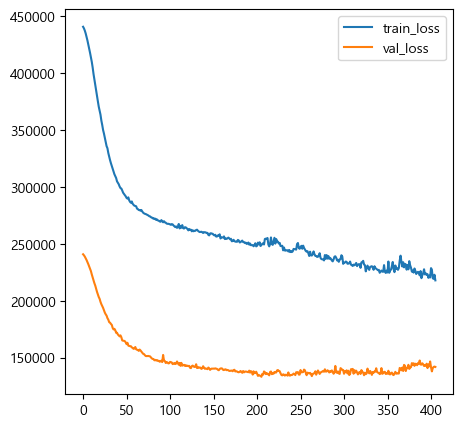

In [414]:
plt.plot(train_loss_ss_30, label='train_loss')
plt.plot(val_loss_ss_30, label='val_loss')
plt.legend()
plt.show()

In [415]:
val_r2_ss_30, val_mae_ss_30 = test(valid_loader_ss_30, model_ss_30, isEDR=isEDR)


y_label :  4314.79296875 y_pred :  8723.4521484375
y_label :  4994.40869140625 y_pred :  6239.4501953125
y_label :  4565.1748046875 y_pred :  8002.90576171875
y_label :  5115.21826171875 y_pred :  7276.21923828125
y_label :  7166.88623046875 y_pred :  7573.55078125
y_label :  4731.9931640625 y_pred :  9031.1982421875
y_label :  4715.27490234375 y_pred :  7666.6416015625
y_label :  5030.861328125 y_pred :  7465.28662109375
y_label :  5311.326171875 y_pred :  7593.853515625
y_label :  5947.44873046875 y_pred :  8723.9130859375
y_label :  10201.703125 y_pred :  10816.287109375
y_label :  12010.865234375 y_pred :  9793.0869140625
y_label :  12519.9326171875 y_pred :  9891.3095703125
y_label :  18139.076171875 y_pred :  10739.408203125
y_label :  18763.1171875 y_pred :  10839.9228515625
y_label :  11709.197265625 y_pred :  10821.9375
y_label :  15659.7265625 y_pred :  10878.30859375
y_label :  10077.876953125 y_pred :  10692.03125
y_label :  13525.5322265625 y_pred :  10810.3388671875
y_lab

In [416]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_30, test_mae_ss_30 = test(test_loader_ss_30, model_ss_30, isEDR=isEDR)
y_label_ss_30 = y_label_plt
y_pred_ss_30 = y_pred_plt

y_label :  5682.10498046875 y_pred :  3367.44287109375
y_label :  7950.78955078125 y_pred :  2860.170166015625
y_label :  7799.546875 y_pred :  7785.4423828125
y_label :  2257.879638671875 y_pred :  3727.964111328125
y_label :  840.6073608398438 y_pred :  5849.77978515625
y_label :  1142.6639404296875 y_pred :  3360.134033203125
y_label :  1716.3270263671875 y_pred :  3864.30078125
y_label :  5125.67919921875 y_pred :  4999.0107421875
y_label :  6663.87353515625 y_pred :  7146.0869140625
y_label :  12179.8935546875 y_pred :  10269.1630859375
y_label :  13057.9384765625 y_pred :  10358.4228515625
y_label :  15228.9111328125 y_pred :  10706.3212890625
y_label :  12109.994140625 y_pred :  3749.231201171875
y_label :  9457.2822265625 y_pred :  3947.775146484375
y_label :  6682.24462890625 y_pred :  3097.262451171875
y_label :  5684.77880859375 y_pred :  3419.207275390625
y_label :  2934.8330078125 y_pred :  3089.4912109375
y_label :  2168.529052734375 y_pred :  2958.020751953125
y_label : 

y_label :  1481.3900146484375 y_pred :  1812.47021484375
y_label :  1804.6427001953125 y_pred :  1956.6650390625
y_label :  1771.253662109375 y_pred :  1312.2100830078125
y_label :  2072.7216796875 y_pred :  2149.328857421875
y_label :  2142.8896484375 y_pred :  2211.16162109375
y_label :  2024.77099609375 y_pred :  2453.8798828125
y_label :  5063.90087890625 y_pred :  2879.938232421875
y_label :  5803.44287109375 y_pred :  3233.7265625
y_label :  7465.50244140625 y_pred :  3561.284912109375
y_label :  5292.60107421875 y_pred :  6152.40478515625
y_label :  6858.0947265625 y_pred :  6073.185546875
y_label :  6862.70751953125 y_pred :  5463.6142578125
y_label :  6204.240234375 y_pred :  5415.833984375
y_label :  6696.9228515625 y_pred :  5335.5771484375
y_label :  4136.59130859375 y_pred :  1968.741455078125
y_label :  1609.1173095703125 y_pred :  539.116455078125
y_label :  657.1913452148438 y_pred :  0.0
y_label :  22.920000076293945 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-544.97734375, 11444.52421875)


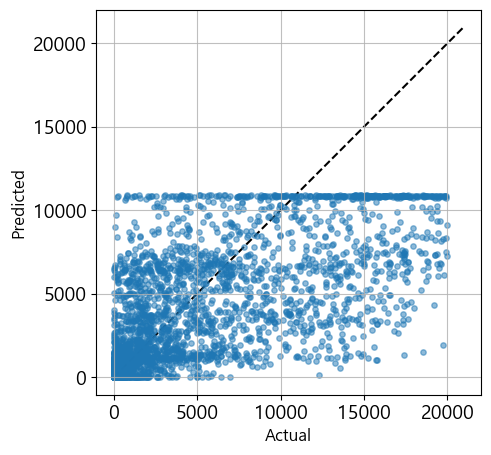

In [417]:
plot_scatter(y_label_ss_30, y_pred_ss_30)

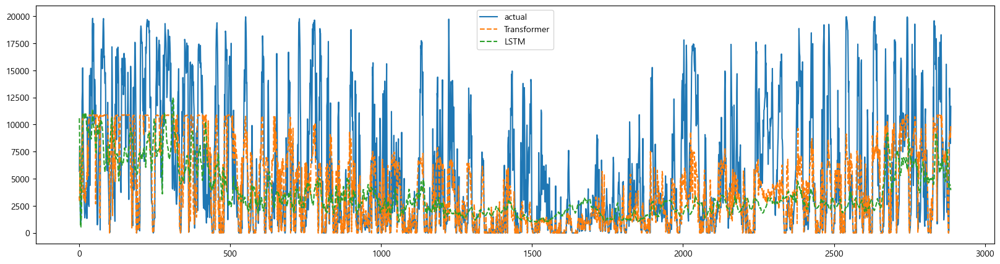

In [418]:
# 지민형 Transformer(E-D)
_start = 0
_end = -1
plt.figure(figsize=(20, 5))
plt.plot(y_label_ss_30[_start:_end], label='actual')
plt.plot(y_pred_ss_30[_start:_end], '--', label='Transformer')
plt.plot(prediction_ss_30[_start:_end], '--', label='LSTM')

plt.legend()

In [419]:
# ss_5일
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss_38.parameters(), lr=lr)
train_loss_ss_38, val_loss_ss_38 = trainer(train_loader_ss_38, valid_loader_ss_38, model_ss_38, criterion, optimizer, target='ss', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_ss_38.load_state_dict(torch.load(PATH))


Epoch 0/1000
TRAIN
R2 score: -0.8834157552411475
MAE Loss:  4918.609134449667
Validation
R2 score: -0.849128303383669
MAE Loss:  5213.982294956994
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8768755469005913
MAE Loss:  4903.086914450781
Validation
R2 score: -0.8416481595327645
MAE Loss:  5194.672642336488
최신화
Epoch 2/1000
TRAIN
R2 score: -0.8672740005885393
MAE Loss:  4881.053896394343
Validation
R2 score: -0.8314665685046023
MAE Loss:  5169.399575789701
최신화
Epoch 3/1000
TRAIN
R2 score: -0.8548128888530961
MAE Loss:  4853.300237695096
Validation
R2 score: -0.8188147357318161
MAE Loss:  5138.916638651768
최신화
Epoch 4/1000
TRAIN
R2 score: -0.8398072027976629
MAE Loss:  4820.769830562938
Validation
R2 score: -0.8040129387855373
MAE Loss:  5104.168913522104
최신화
Epoch 5/1000
TRAIN
R2 score: -0.8225491293187761
MAE Loss:  4784.687046670631
Validation
R2 score: -0.7873219242439016
MAE Loss:  5066.199100295813
최신화
Epoch 6/1000
TRAIN
R2 score: -0.8033401507582334
MAE Loss:  4745.90017683512
Validation
R

R2 score: 0.13462897070492164
MAE Loss:  3234.176186711196
Validation
R2 score: 0.1272695210225656
MAE Loss:  3493.7808204451603
최신화
Epoch 55/1000
TRAIN
R2 score: 0.14411823413707125
MAE Loss:  3210.87814118788
Validation
R2 score: 0.13676710171182438
MAE Loss:  3517.830171218536
Epoch 56/1000
TRAIN
R2 score: 0.15665876153851832
MAE Loss:  3195.607965620531
Validation
R2 score: 0.1450370101624393
MAE Loss:  3478.7330626454946
최신화
Epoch 57/1000
TRAIN
R2 score: 0.16205254702011807
MAE Loss:  3185.888242773031
Validation
R2 score: 0.14934375974361402
MAE Loss:  3474.5793163431613
최신화
Epoch 58/1000
TRAIN
R2 score: 0.16808202175384335
MAE Loss:  3182.5384167415523
Validation
R2 score: 0.15606213927822676
MAE Loss:  3451.551325981329
최신화
Epoch 59/1000
TRAIN
R2 score: 0.17078721311732603
MAE Loss:  3178.2349160144254
Validation
R2 score: 0.15888339302319665
MAE Loss:  3430.999250833617
최신화
Epoch 60/1000
TRAIN
R2 score: 0.17795723505448446
MAE Loss:  3163.156840207592
Validation
R2 score: 0.16

R2 score: 0.31174045129036343
MAE Loss:  2949.041057274186
Validation
R2 score: 0.3243914637892047
MAE Loss:  3204.599336252809
Epoch 110/1000
TRAIN
R2 score: 0.3070363090577978
MAE Loss:  2947.458604297356
Validation
R2 score: 0.31145886912154574
MAE Loss:  3187.7045054209243
Epoch 111/1000
TRAIN
R2 score: 0.3121376713726278
MAE Loss:  2945.791638056512
Validation
R2 score: 0.3247259258554054
MAE Loss:  3193.8072210154733
Epoch 112/1000
TRAIN
R2 score: 0.3181410804309991
MAE Loss:  2946.5805407967687
Validation
R2 score: 0.34447362623633493
MAE Loss:  3134.2692740777393
최신화
Epoch 113/1000
TRAIN
R2 score: 0.31606083797925943
MAE Loss:  2936.157362482897
Validation
R2 score: 0.32486043634370165
MAE Loss:  3172.5531131053076
Epoch 114/1000
TRAIN
R2 score: 0.32048143824394004
MAE Loss:  2938.294198333513
Validation
R2 score: 0.34618639634319437
MAE Loss:  3152.3421280560588
Epoch 115/1000
TRAIN
R2 score: 0.32041725261711607
MAE Loss:  2934.167526811857
Validation
R2 score: 0.3453562095171

R2 score: 0.37110718030442713
MAE Loss:  2832.8749510485904
Validation
R2 score: 0.3705774612624454
MAE Loss:  3049.451999973706
Epoch 165/1000
TRAIN
R2 score: 0.3710992249991194
MAE Loss:  2837.4497757256036
Validation
R2 score: 0.38248754118487505
MAE Loss:  3033.371413999129
Epoch 166/1000
TRAIN
R2 score: 0.3598412577590181
MAE Loss:  2867.553929392138
Validation
R2 score: 0.3965375682796529
MAE Loss:  2990.7249987537903
최신화
Epoch 167/1000
TRAIN
R2 score: 0.37057285951469143
MAE Loss:  2829.921109493333
Validation
R2 score: 0.38201424897559066
MAE Loss:  3022.489806139762
Epoch 168/1000
TRAIN
R2 score: 0.37344840375485744
MAE Loss:  2827.41269962499
Validation
R2 score: 0.40167989462873344
MAE Loss:  2997.1064358701083
Epoch 169/1000
TRAIN
R2 score: 0.37572490048668106
MAE Loss:  2822.1223477563026
Validation
R2 score: 0.39512890906883447
MAE Loss:  3023.0091724723197
Epoch 170/1000
TRAIN
R2 score: 0.36645944787648
MAE Loss:  2860.8434800302907
Validation
R2 score: 0.369736142261954

R2 score: 0.411035041664811
MAE Loss:  2720.93163906646
Validation
R2 score: 0.34921415891921403
MAE Loss:  3035.216487758809
Epoch 220/1000
TRAIN
R2 score: 0.40471651062980596
MAE Loss:  2711.4114385173743
Validation
R2 score: 0.3499108810109449
MAE Loss:  3077.0452252627247
Epoch 221/1000
TRAIN
R2 score: 0.4205509919201669
MAE Loss:  2707.435830971245
Validation
R2 score: 0.3731968483525132
MAE Loss:  3028.635431336787
Epoch 222/1000
TRAIN
R2 score: 0.40855499366227643
MAE Loss:  2723.785167921396
Validation
R2 score: 0.3564947724923224
MAE Loss:  3033.36355432677
Epoch 223/1000
TRAIN
R2 score: 0.4123111164769454
MAE Loss:  2701.5645790263925
Validation
R2 score: 0.3737288989406322
MAE Loss:  3034.551541749978
Epoch 224/1000
TRAIN
R2 score: 0.41234933491010695
MAE Loss:  2722.3451242516426
Validation
R2 score: 0.3489701782586139
MAE Loss:  3058.454783890253
Epoch 225/1000
TRAIN
R2 score: 0.41842714769818656
MAE Loss:  2700.388314281044
Validation
R2 score: 0.3755850349807295
MAE Loss

R2 score: 0.40899663871019265
MAE Loss:  2706.93993851422
Validation
R2 score: 0.36753251412340326
MAE Loss:  3019.7740238815763
Epoch 275/1000
TRAIN
R2 score: 0.4010128794295257
MAE Loss:  2759.255198698159
Validation
R2 score: 0.35064316144639085
MAE Loss:  3074.6450399388314
Epoch 276/1000
TRAIN
R2 score: 0.3725664022125226
MAE Loss:  2824.878936178646
Validation
R2 score: 0.333869396701413
MAE Loss:  3121.1603911655934
Epoch 277/1000
TRAIN
R2 score: 0.3862266698515725
MAE Loss:  2778.868436890489
Validation
R2 score: 0.3616061749916909
MAE Loss:  3028.5540432183852
Epoch 278/1000
TRAIN
R2 score: 0.4220627633100643
MAE Loss:  2697.370806453756
Validation
R2 score: 0.37649457610317405
MAE Loss:  2982.626890291051
Epoch 279/1000
TRAIN
R2 score: 0.416145779743024
MAE Loss:  2690.860381080986
Validation
R2 score: 0.3593355599128276
MAE Loss:  3052.5823608839187
Epoch 280/1000
TRAIN
R2 score: 0.38096835098165915
MAE Loss:  2790.5491000720212
Validation
R2 score: 0.3805529656291652
MAE Lo

R2 score: 0.4184726509973634
MAE Loss:  2698.288462217664
Validation
R2 score: 0.37389864016045504
MAE Loss:  3008.2892492215115
Epoch 330/1000
TRAIN
R2 score: 0.4145775956777571
MAE Loss:  2708.5690249846425
Validation
R2 score: 0.3104245336524408
MAE Loss:  3121.4946731753444
Epoch 331/1000
TRAIN
R2 score: 0.41572539203658776
MAE Loss:  2700.432927696484
Validation
R2 score: 0.3337086164801767
MAE Loss:  3078.506810286279
Epoch 332/1000
TRAIN
R2 score: 0.39932631324370127
MAE Loss:  2739.2334835738634
Validation
R2 score: 0.3646952463238208
MAE Loss:  3027.559106095299
Epoch 333/1000
TRAIN
R2 score: 0.4200840222877623
MAE Loss:  2698.770866247332
Validation
R2 score: 0.33412029411080957
MAE Loss:  3099.075604234181
Epoch 334/1000
TRAIN
R2 score: 0.42624038507838424
MAE Loss:  2668.370533177389
Validation
R2 score: 0.3307341718196506
MAE Loss:  3086.215612482562
Epoch 335/1000
TRAIN
R2 score: 0.40552278541551434
MAE Loss:  2709.2241807501814
Validation
R2 score: 0.29799647292224996
MA

R2 score: 0.4623081787442437
MAE Loss:  2576.2038934250263
Validation
R2 score: 0.30186692446176044
MAE Loss:  3137.004414709745
Epoch 385/1000
TRAIN
R2 score: 0.43248661429662494
MAE Loss:  2642.3378153342783
Validation
R2 score: 0.33950138905166016
MAE Loss:  3122.9599052764243
Epoch 386/1000
TRAIN
R2 score: 0.45160178950014396
MAE Loss:  2610.2817745276966
Validation
R2 score: 0.2948295138234859
MAE Loss:  3166.3861335403662
Epoch 387/1000
TRAIN
R2 score: 0.45930855344002486
MAE Loss:  2584.41098078025
Validation
R2 score: 0.2855060620775475
MAE Loss:  3180.7763583980136
Epoch 388/1000
TRAIN
R2 score: 0.4560555048968845
MAE Loss:  2589.0375652787498
Validation
R2 score: 0.2747854258559588
MAE Loss:  3177.247349111316
Epoch 389/1000
TRAIN
R2 score: 0.43982737763894975
MAE Loss:  2629.5383381554675
Validation
R2 score: 0.35240517986286024
MAE Loss:  3069.6368270633666
Epoch 390/1000
TRAIN
R2 score: 0.4561011213430688
MAE Loss:  2586.3914143677657
Validation
R2 score: 0.300806897482614

R2 score: 0.480738342838826
MAE Loss:  2498.7993443653195
Validation
R2 score: 0.28574182233409295
MAE Loss:  3200.8057517107277
Epoch 440/1000
TRAIN
R2 score: 0.4703915400043105
MAE Loss:  2535.560416022949
Validation
R2 score: 0.2848959203296413
MAE Loss:  3171.916583500769
Epoch 441/1000
TRAIN
R2 score: 0.48939840023032655
MAE Loss:  2480.88830908855
Validation
R2 score: 0.27645597767209684
MAE Loss:  3191.140910360571
Epoch 442/1000
TRAIN
R2 score: 0.47550719029148336
MAE Loss:  2517.845508396704
Validation
R2 score: 0.2843285450317353
MAE Loss:  3189.4676377350042
Epoch 443/1000
TRAIN
R2 score: 0.48150014300905164
MAE Loss:  2502.7020414502035
Validation
R2 score: 0.29821665414921106
MAE Loss:  3149.3733082090566
Epoch 444/1000
TRAIN
R2 score: 0.4732938401472556
MAE Loss:  2522.7530319508446
Validation
R2 score: 0.26466343474376064
MAE Loss:  3232.8107409231548
Epoch 445/1000
TRAIN
R2 score: 0.45941789738056016
MAE Loss:  2578.234047408121
Validation
R2 score: 0.30338016052188554


<All keys matched successfully>

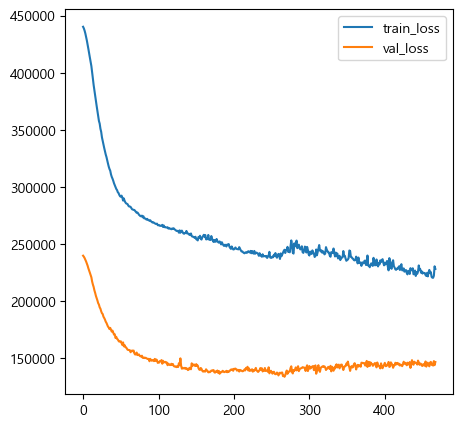

In [420]:
plt.plot(train_loss_ss_38, label='train_loss')
plt.plot(val_loss_ss_38, label='val_loss')
plt.legend()
plt.show()


In [421]:
val_r2_ss_38, val_mae_ss_38 = test(valid_loader_ss_38, model_ss_38, isEDR=isEDR)


y_label :  5311.326171875 y_pred :  6536.3720703125
y_label :  5947.44873046875 y_pred :  7027.8486328125
y_label :  10201.703125 y_pred :  11282.2978515625
y_label :  12010.865234375 y_pred :  9553.859375
y_label :  12519.9326171875 y_pred :  10177.5126953125
y_label :  18139.076171875 y_pred :  12496.5556640625
y_label :  18763.1171875 y_pred :  12619.9541015625
y_label :  11709.197265625 y_pred :  10641.5869140625
y_label :  15659.7265625 y_pred :  12296.8876953125
y_label :  10077.876953125 y_pred :  10763.2705078125
y_label :  13525.5322265625 y_pred :  11519.068359375
y_label :  10316.4599609375 y_pred :  8323.1806640625
y_label :  8258.1298828125 y_pred :  5771.583984375
y_label :  8559.8720703125 y_pred :  7329.4111328125
y_label :  3533.935546875 y_pred :  11625.6953125
y_label :  3087.8466796875 y_pred :  10783.9521484375
y_label :  1995.8349609375 y_pred :  8942.8603515625
y_label :  3090.5400390625 y_pred :  4594.22998046875
y_label :  2824.380615234375 y_pred :  6589.32617

In [422]:
y_label_plt = []
y_pred_plt = []
test_r2_ss_38, test_mae_ss_38 = test(test_loader_ss_38, model_ss_38, isEDR=isEDR)
y_label_ss_38 = y_label_plt
y_pred_ss_38 = y_pred_plt

y_label :  6663.87353515625 y_pred :  9157.9853515625
y_label :  12179.8935546875 y_pred :  6451.4619140625
y_label :  13057.9384765625 y_pred :  8191.08154296875
y_label :  15228.9111328125 y_pred :  10830.921875
y_label :  12109.994140625 y_pred :  2816.162353515625
y_label :  9457.2822265625 y_pred :  2950.974365234375
y_label :  6682.24462890625 y_pred :  2409.76171875
y_label :  5684.77880859375 y_pred :  2742.57958984375
y_label :  2934.8330078125 y_pred :  2279.20263671875
y_label :  2168.529052734375 y_pred :  2522.77490234375
y_label :  1395.414306640625 y_pred :  2843.98974609375
y_label :  1676.17138671875 y_pred :  3017.796875
y_label :  1931.4822998046875 y_pred :  2250.132080078125
y_label :  1932.5789794921875 y_pred :  2491.921875
y_label :  3306.090087890625 y_pred :  4983.7490234375
y_label :  3523.084228515625 y_pred :  6091.81103515625
y_label :  3839.722412109375 y_pred :  7815.89990234375
y_label :  1333.5343017578125 y_pred :  4790.765625
y_label :  3069.94311523

y_label :  3873.50341796875 y_pred :  8820.3076171875
y_label :  4451.1767578125 y_pred :  6782.806640625
y_label :  2003.052978515625 y_pred :  0.0
y_label :  108.58399963378906 y_pred :  0.0
y_label :  0.0 y_pred :  0.0
y_label :  9.15999984741211 y_pred :  0.0
y_label :  215.1963348388672 y_pred :  2169.552490234375
y_label :  1498.67431640625 y_pred :  4149.01025390625
y_label :  1307.967041015625 y_pred :  0.0
y_label :  250.87066650390625 y_pred :  21.754526138305664
y_label :  611.1036376953125 y_pred :  5167.4716796875
y_label :  3099.062744140625 y_pred :  4859.95068359375
y_label :  6540.400390625 y_pred :  5095.259765625
y_label :  2501.375732421875 y_pred :  10760.4111328125
y_label :  3788.735595703125 y_pred :  8338.8017578125
y_label :  6442.7373046875 y_pred :  9614.298828125
y_label :  1128.0023193359375 y_pred :  7711.0166015625
y_label :  4474.9560546875 y_pred :  8582.1328125
y_label :  10781.3583984375 y_pred :  10511.7080078125
y_label :  15800.1748046875 y_pred :

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-637.9185546875001, 13396.2896484375)


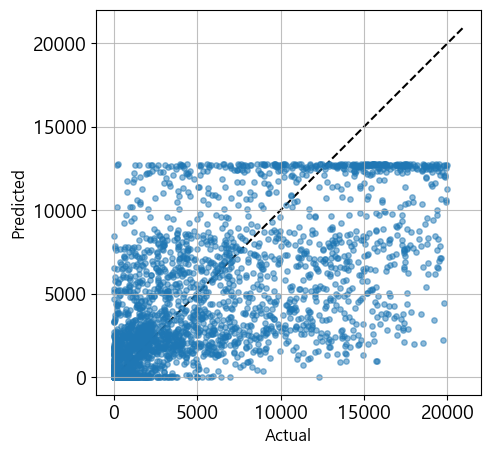

In [423]:
plot_scatter(y_label_ss_38, y_pred_ss_38)

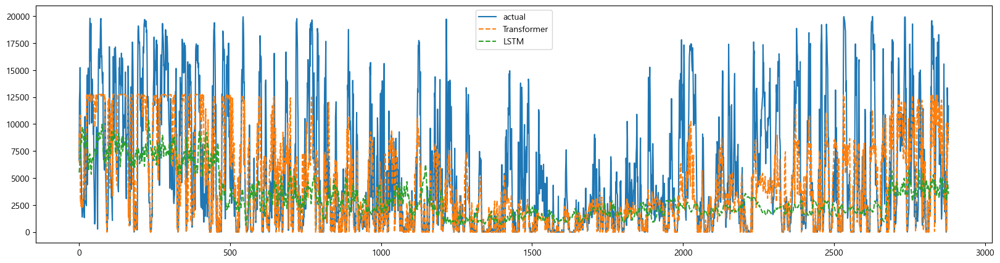

In [424]:
# 지민형 Transformer(E-D)
_start = 0
_end = -1
plt.figure(figsize=(20, 5))
plt.plot(y_label_ss_38[_start:_end], label='actual')
plt.plot(y_pred_ss_38[_start:_end], '--', label='Transformer')
plt.plot(prediction_ss_38[_start:_end], '--', label='LSTM')

plt.legend()

In [1262]:
#ss
seed_everything_torch(config.seed)
lr = 0.001
criterion = nn.L1Loss()
optimizer = optim.AdamW(model_ss.parameters(), lr=lr)
train_loss_ss, val_loss_ss= trainer(train_loader_ss, valid_loader_ss, model_ss, criterion, optimizer, target='ss', n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)
model_ss.load_state_dict(torch.load(PATH))

Epoch 0/1000
TRAIN
R2 score: -0.8747682218733726
MAE Loss:  4904.760689894541
Validation
R2 score: -0.8239543688019242
MAE Loss:  5138.203186681058
최신화
Epoch 1/1000
TRAIN
R2 score: -0.8215376130897061
MAE Loss:  4788.1448395622
Validation
R2 score: -0.7597781031189907
MAE Loss:  4993.628955999314
최신화
Epoch 2/1000
TRAIN
R2 score: -0.7424059609006866
MAE Loss:  4636.03779149295
Validation
R2 score: -0.6805604634797469
MAE Loss:  4833.081536118968
최신화
Epoch 3/1000
TRAIN
R2 score: -0.6545920305653619
MAE Loss:  4490.707317065063
Validation
R2 score: -0.6024460359976385
MAE Loss:  4691.5825834486905
최신화
Epoch 4/1000
TRAIN
R2 score: -0.5744438687949378
MAE Loss:  4371.7832827868
Validation
R2 score: -0.531553593720095
MAE Loss:  4578.3532234830545
최신화
Epoch 5/1000
TRAIN
R2 score: -0.5023047442659792
MAE Loss:  4268.125127235783
Validation
R2 score: -0.6491779414022758
MAE Loss:  4791.901842337171
Epoch 6/1000
TRAIN
R2 score: -0.4279712932755302
MAE Loss:  4058.8193287249483
Validation
R2 sco

R2 score: 0.26202060648685443
MAE Loss:  3208.6240691245216
Epoch 55/1000
TRAIN
R2 score: 0.32613982760812144
MAE Loss:  2935.1909466049788
Validation
R2 score: 0.2945126341144968
MAE Loss:  3202.897121993578
최신화
Epoch 56/1000
TRAIN
R2 score: 0.33421611535064577
MAE Loss:  2933.180502514938
Validation
R2 score: 0.2944062781819914
MAE Loss:  3184.187164030165
최신화
Epoch 57/1000
TRAIN
R2 score: 0.3339960138415694
MAE Loss:  2919.317044951648
Validation
R2 score: 0.2747216765997106
MAE Loss:  3222.9002301807254
Epoch 58/1000
TRAIN
R2 score: 0.3279688667144435
MAE Loss:  2933.7647539031573
Validation
R2 score: 0.28934443593145054
MAE Loss:  3182.544181324895
최신화
Epoch 59/1000
TRAIN
R2 score: 0.3280187509454239
MAE Loss:  2932.525008135952
Validation
R2 score: 0.30397205206190037
MAE Loss:  3168.182388028697
최신화
Epoch 60/1000
TRAIN
R2 score: 0.3368582661639523
MAE Loss:  2927.644793126444
Validation
R2 score: 0.29033591013998383
MAE Loss:  3180.5065094244437
Epoch 61/1000
TRAIN
R2 score: 0.3

R2 score: 0.3313499348059723
MAE Loss:  3110.9382762879236
Epoch 110/1000
TRAIN
R2 score: 0.37486103154174566
MAE Loss:  2847.2990415077425
Validation
R2 score: 0.3423737867031864
MAE Loss:  3086.8164542138984
Epoch 111/1000
TRAIN
R2 score: 0.38383310430674433
MAE Loss:  2815.1110386994606
Validation
R2 score: 0.3538402440684697
MAE Loss:  3088.9317702393146
Epoch 112/1000
TRAIN
R2 score: 0.38294984880234306
MAE Loss:  2827.934738336848
Validation
R2 score: 0.3743744990625336
MAE Loss:  3030.9040318660104
최신화
Epoch 113/1000
TRAIN
R2 score: 0.37927541473358506
MAE Loss:  2837.173088995322
Validation
R2 score: 0.3483385920078409
MAE Loss:  3079.1476510028047
Epoch 114/1000
TRAIN
R2 score: 0.3799044814037045
MAE Loss:  2837.202901465733
Validation
R2 score: 0.38136288624475023
MAE Loss:  3024.622135869887
최신화
Epoch 115/1000
TRAIN
R2 score: 0.38174647130250916
MAE Loss:  2832.2302637428847
Validation
R2 score: 0.3479502990294261
MAE Loss:  3070.3986806833254
Epoch 116/1000
TRAIN
R2 score: 

R2 score: 0.3999591381728165
MAE Loss:  2783.7593473736356
Validation
R2 score: 0.4102626705623992
MAE Loss:  2934.684536882815
Epoch 165/1000
TRAIN
R2 score: 0.40159688152936046
MAE Loss:  2776.983222393291
Validation
R2 score: 0.3997755882580112
MAE Loss:  2981.623148065478
Epoch 166/1000
TRAIN
R2 score: 0.39801531242764865
MAE Loss:  2783.791601644198
Validation
R2 score: 0.4274966674992331
MAE Loss:  2971.465354393643
Epoch 167/1000
TRAIN
R2 score: 0.40331479809096404
MAE Loss:  2779.481132638115
Validation
R2 score: 0.36291491364727335
MAE Loss:  3016.6470779356473
Epoch 168/1000
TRAIN
R2 score: 0.39276762043073266
MAE Loss:  2787.3035264213936
Validation
R2 score: 0.40573915266731386
MAE Loss:  2980.4775666139176
Epoch 169/1000
TRAIN
R2 score: 0.3954781373368542
MAE Loss:  2781.404542961697
Validation
R2 score: 0.3890207465558947
MAE Loss:  2965.000535489173
Epoch 170/1000
TRAIN
R2 score: 0.392152218616611
MAE Loss:  2788.090669776029
Validation
R2 score: 0.40502216659437695
MAE 

R2 score: 0.4026180214109082
MAE Loss:  2761.939296423994
Validation
R2 score: 0.4190253968972818
MAE Loss:  2906.5395700329154
최신화
Epoch 220/1000
TRAIN
R2 score: 0.3997098588239457
MAE Loss:  2773.8890725100077
Validation
R2 score: 0.43220648178791676
MAE Loss:  2928.1680255503793
Epoch 221/1000
TRAIN
R2 score: 0.404590985401872
MAE Loss:  2757.7053548868103
Validation
R2 score: 0.3937619984950399
MAE Loss:  2973.9379834826254
Epoch 222/1000
TRAIN
R2 score: 0.3995041416350057
MAE Loss:  2774.6026383851668
Validation
R2 score: 0.43727998231662624
MAE Loss:  2909.7461063623223
Epoch 223/1000
TRAIN
R2 score: 0.39771273216178094
MAE Loss:  2761.217809256959
Validation
R2 score: 0.41221976791906334
MAE Loss:  2925.5005499688004
Epoch 224/1000
TRAIN
R2 score: 0.4108132480550437
MAE Loss:  2746.616873788498
Validation
R2 score: 0.40279314676083455
MAE Loss:  2999.615361464679
Epoch 225/1000
TRAIN
R2 score: 0.39952855578095525
MAE Loss:  2756.9843661930245
Validation
R2 score: 0.3952830814633

R2 score: 0.4012574174507083
MAE Loss:  2757.413234816067
Validation
R2 score: 0.41340886355159834
MAE Loss:  2974.318873754707
Epoch 275/1000
TRAIN
R2 score: 0.4144622721153087
MAE Loss:  2743.233066146495
Validation
R2 score: 0.41667563042256217
MAE Loss:  2954.221634405298
Epoch 276/1000
TRAIN
R2 score: 0.41510992817665426
MAE Loss:  2730.743005533286
Validation
R2 score: 0.42096873448673544
MAE Loss:  2976.1466012338183
Epoch 277/1000
TRAIN
R2 score: 0.4137171835586263
MAE Loss:  2729.3147871740985
Validation
R2 score: 0.39878345139177096
MAE Loss:  2978.989295797475
Epoch 278/1000
TRAIN
R2 score: 0.4155714048665413
MAE Loss:  2724.95691561667
Validation
R2 score: 0.3987635026426174
MAE Loss:  2999.7730259530526
Epoch 279/1000
TRAIN
R2 score: 0.4116082662952508
MAE Loss:  2718.436579910319
Validation
R2 score: 0.39807460380510173
MAE Loss:  3002.7852913370452
Epoch 280/1000
TRAIN
R2 score: 0.4123927150877049
MAE Loss:  2727.120406302069
Validation
R2 score: 0.39894930025441144
MAE 

R2 score: 0.41735615660178327
MAE Loss:  2715.1922013189183
Validation
R2 score: 0.38338147771199427
MAE Loss:  3028.2581371294877
Epoch 330/1000
TRAIN
R2 score: 0.422636223363546
MAE Loss:  2694.9321062859008
Validation
R2 score: 0.38787263594160326
MAE Loss:  3054.3183975228535
Epoch 331/1000
TRAIN
R2 score: 0.42378423153166045
MAE Loss:  2711.500989094676
Validation
R2 score: 0.3852558128599609
MAE Loss:  3074.3224869780115
Epoch 332/1000
TRAIN
R2 score: 0.42517585842485905
MAE Loss:  2709.462593431399
Validation
R2 score: 0.3752892598105949
MAE Loss:  3044.3365675483374
Epoch 333/1000
TRAIN
R2 score: 0.4183760322397577
MAE Loss:  2706.304467696263
Validation
R2 score: 0.4017745183325512
MAE Loss:  2975.7851662560015
Epoch 334/1000
TRAIN
R2 score: 0.4175781918096242
MAE Loss:  2726.0582715012342
Validation
R2 score: 0.38984276534526463
MAE Loss:  3028.6269288491344
Epoch 335/1000
TRAIN
R2 score: 0.423740177552567
MAE Loss:  2697.940710474149
Validation
R2 score: 0.39853670683597675


R2 score: 0.42302913395268493
MAE Loss:  2696.2338989810187
Validation
R2 score: 0.4024225134032472
MAE Loss:  3057.7375563063983
Epoch 385/1000
TRAIN
R2 score: 0.4279934190039789
MAE Loss:  2680.614454602332
Validation
R2 score: 0.3930343900408063
MAE Loss:  3068.060627177286
Epoch 386/1000
TRAIN
R2 score: 0.42954938085854566
MAE Loss:  2687.5248881114735
Validation
R2 score: 0.3919771667029479
MAE Loss:  3040.3539706406723
Epoch 387/1000
TRAIN
R2 score: 0.40863058855928847
MAE Loss:  2748.0104205074726
Validation
R2 score: 0.39648736661063655
MAE Loss:  3020.4516021560967
Epoch 388/1000
TRAIN
R2 score: 0.4062284954138763
MAE Loss:  2752.531084436217
Validation
R2 score: 0.37837416898317866
MAE Loss:  3019.137884649194
Epoch 389/1000
TRAIN
R2 score: 0.418650088287547
MAE Loss:  2714.527282699158
Validation
R2 score: 0.3891868898249956
MAE Loss:  3024.3390070424252
Epoch 390/1000
TRAIN
R2 score: 0.4301720042516807
MAE Loss:  2680.028356419266
Validation
R2 score: 0.39716171983419046
MA

<All keys matched successfully>

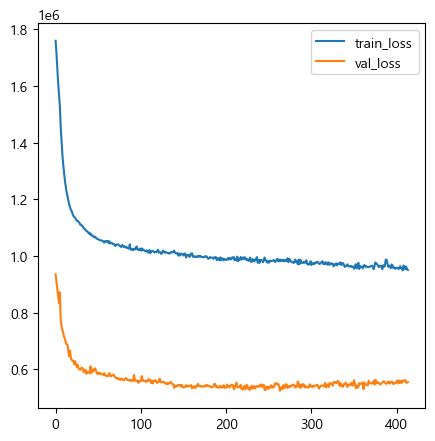

In [1263]:
plt.plot(train_loss_ss, label = 'train_loss')
plt.plot(val_loss_ss, label = 'val_loss')
plt.legend()
plt.show()

In [1389]:
y_label_plt = []
y_pred_plt = []
test_r2_ss, test_mae_ss = test(test_loader_ss, model_ss, isEDR=isEDR)
y_label_ss = y_label_plt
y_pred_ss = y_pred_plt

y_label :  1610.261962890625 y_pred :  4199.1962890625
y_label :  8492.4189453125 y_pred :  4511.373046875
y_label :  13345.771484375 y_pred :  4392.26904296875
y_label :  11781.712890625 y_pred :  3910.739990234375
y_label :  11699.203125 y_pred :  3559.493408203125
y_label :  10247.5185546875 y_pred :  3318.100341796875
y_label :  8715.3447265625 y_pred :  2991.475830078125
y_label :  6992.30908203125 y_pred :  3031.999755859375
y_label :  7158.04443359375 y_pred :  4505.82080078125
y_label :  9287.556640625 y_pred :  4506.31494140625
y_label :  13307.5322265625 y_pred :  4569.927734375
y_label :  15576.271484375 y_pred :  3734.90869140625
y_label :  5865.01904296875 y_pred :  3078.7373046875
y_label :  5443.82177734375 y_pred :  2508.543212890625
y_label :  2711.306396484375 y_pred :  3101.580078125
y_label :  5682.10498046875 y_pred :  2362.831298828125
y_label :  7950.78955078125 y_pred :  2191.533447265625
y_label :  7799.546875 y_pred :  4014.552490234375
y_label :  2257.8796386

xlim is (-998.1119140625001, 20960.3501953125)
ylim is (-597.83486328125, 12554.53212890625)


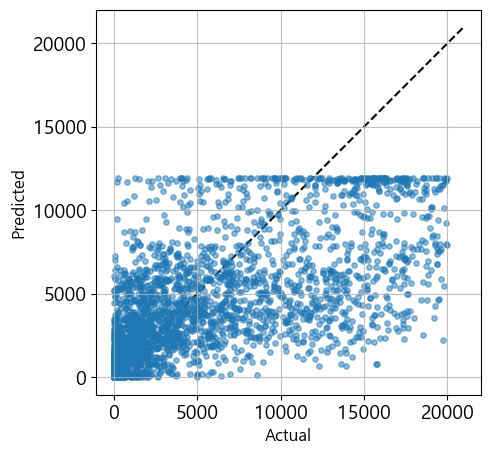

In [1390]:
plot_scatter(y_label_ss,y_pred_ss)

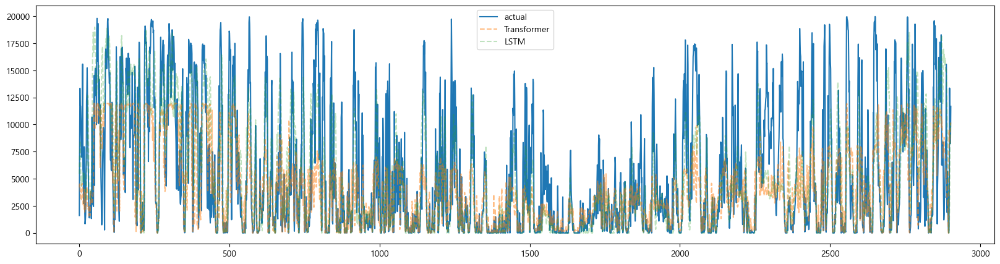

In [1391]:
#지민형 Transformer(E-D)
_start =0
_end = -1
#plt.title('ss_transformer')

plt.figure(figsize = (20,5))
plt.plot(y_label_ss[_start:_end],label = 'actual')
plt.plot(y_pred_ss[_start:_end],'--',alpha = 0.5,label = 'Transformer')
plt.plot(prediction_ss[_start:_end], '--',alpha=0.3,label = 'LSTM')

plt.legend()

# ====================================================================================

In [ ]:
torch.save(model_hk1,'./result/transformer_hk1.pth')
torch.save(model_hk2,'./result/transformer_hk2.pth')
torch.save(model_ss,'./result/transformer_ss.pth')

In [313]:
def model_score_test(y_label, y_pred):
    print("R2 score:", sklearn.metrics.r2_score(y_label, y_pred))
    print("MAE Loss: ", sklearn.metrics.mean_absolute_error(y_label, y_pred))
    r2 = sklearn.metrics.r2_score(y_label, y_pred)
    mae = sklearn.metrics.mean_absolute_error(y_label, y_pred)
    return r2, mae

In [ ]:
# train 함수
def trainer(train_data, val_data, model, criterion, optimizer, n_epoch, target, PATH, isEDR=False):
    dev = 0
    model = model.cuda(dev)
    criterion = criterion.cuda(dev)

    phase = ["train", "val"]

    stop_loss = -1
    stop_step = 0
    max_stop = 50

    train_loss = []
    val_loss = []
    for epoch in range(n_epoch):
        print("Epoch {}/{}".format(epoch, n_epoch))
        for p in phase:
            if p == "train":
                print("TRAIN")
                model.train()
                data = train_data
            else:
                print("Validation")
                model.eval()
                data = val_data

            total_loss = 0
            y_label = []
            y_pred = []

            if isEDR:
                for x, y, w in data:
                    x = x.cuda(dev)
                    y = y.cuda(dev)
                    w = w.cuda(dev)

                    optimizer.zero_grad()

                    _y = model(x, w)

                    loss = criterion(y, _y)

                    if p == 'train':
                        loss.backward()
                        optimizer.step()

                    total_loss += loss.item()
                    y_label.extend(y.reshape(-1).tolist())
                    y_pred.extend(_y.reshape(-1).tolist())
            else:
                for x, y in data:
                    x = x.cuda(dev)
                    y = y.cuda(dev)

                    optimizer.zero_grad()

                    _y = model(x)

                    loss = criterion(_y, y)

                    if p == 'train':
                        loss.backward()
                        optimizer.step()

                    total_loss += loss.item()
                    y_label.extend(y.reshape(-1).tolist())
                    y_pred.extend(_y.reshape(-1).tolist())

            model_score(y_label, y_pred, target)

            if p == "val":
                val_loss.append(total_loss)
                if total_loss < stop_loss or stop_loss == -1:
                   torch.save(model.state_dict(), PATH)
                   stop_loss = total_loss
                   stop_step = 0
                else:
                   stop_step += 1
                   if stop_step == max_stop:
                       print("Early Stopping!")
                       return train_loss, val_loss
            else:
                train_loss.append(total_loss)

    return train_loss, val_loss

In [314]:


def test(data, model, isEDR=False):
    dev = 0
    model.eval()
    model = model.cuda(dev)

    y_label = []
    y_pred = []

    with torch.no_grad():
        if isEDR:
            for x, y, w in data:
                x = x.cuda(dev)
                y = y.cuda(dev)
                w = w.cuda(dev)

                _y = model(x, w)

                y_label.extend(y.reshape(-1).tolist())
                y_pred.extend(_y.reshape(-1).tolist())
        else:
            for x, y in data:
                x = x.cuda(dev)
                y = y.cuda(dev)

                _y = model(x)

                y_label.extend(y.reshape(-1).tolist())
                y_pred.extend(_y.reshape(-1).tolist())
    
    for _ in range(len(y_label)):
        y_label_plt.append(y_label[_])
        y_pred_plt.append(y_pred[_])
        print("y_label : ", y_label[_], "y_pred : ", y_pred[_])
    print("y_label-y_pred")
    return model_score_test(y_label, y_pred)

In [585]:
train_1_pr
train_1_pr_x = train_1_pr['windspeed']
train_1_pr_y = train_1_pr['hk1']

In [589]:
test_1_pr
test_1_pr_x = test_1_pr['windspeed']
test_1_pr_y = test_1_pr['hk1']

In [631]:
train_data = data_window(train_1_pr_x, train_1_pr_y, 14, 1)

C:\Users\iai\AppData\Local\Temp\ipykernel_12212\955761665.py:16: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



In [643]:
test_data = data_window(test_1_pr_x, test_1_pr_y, 14, 1)

C:\Users\iai\AppData\Local\Temp\ipykernel_12212\955761665.py:16: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



In [898]:
train = DataLoader(trainX, batch_size = 200, shuffle =False, num_workers = 0)

In [637]:
train = DataLoader(train_data , batch_size = 200, shuffle = False, num_workers = 0)

In [902]:
train_features, train_labels = next(iter(train))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")

ValueError: too many values to unpack (expected 2)

In [640]:
n_features = 2

In [304]:
import torch
import torch.nn as nn
import numpy as np

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super(PositionalEncoding, self).__init__()
        pe = torch.zeros(max_len, d_model)
        self.max_len = max_len
        position = torch.arange(max_len-1, -1, -1, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-np.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        #pe.requires_grad = False
        self.register_buffer('pe', pe)

    def forward(self, x):
        #print("iiinput", x.shape)
        return x + self.pe[self.max_len-x.size(0):, :]

class TransformerEncoder(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.src_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.transformerencoderlayer = nn.TransformerEncoderLayer(d_model=self.d_model, nhead=self.nhead, dim_feedforward=self.dim_feedforward, dropout=self.dropout)
        self.norm = nn.LayerNorm(d_model)
        self.transformerencoder = nn.TransformerEncoder(encoder_layer=self.transformerencoderlayer, num_layers=self.num_layers, norm=self.norm)


    def forward(self, src):
        if self.src_mask is None or self.src_mask.size(0) != len(src):
            device = src.device
            mask = self._generate_square_subsequent_mask(len(src)).to(device)
            self.src_mask = mask
        outputs = self.transformerencoder(src=src, mask=self.src_mask)

        return outputs

    def _generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

class TransformerDecoder(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.memory_mask = None
        self.tgt_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.transformerdecoderlayer = nn.TransformerDecoderLayer(d_model=self.d_model, nhead=self.nhead,
                                                                  dim_feedforward=self.dim_feedforward,
                                                                  dropout=self.dropout)
        self.norm = nn.LayerNorm(d_model)
        self.transformerdecoder = nn.TransformerDecoder(decoder_layer=self.transformerdecoderlayer,
                                                        num_layers=self.num_layers, norm=self.norm)

    def forward(self, tgt, memory):
        if self.tgt_mask is None or self.tgt_mask.size(0) != len(tgt):
            device = tgt.device
            mask = self._generate_square_subsequent_mask(len(tgt), len(tgt)).to(device)
            self.tgt_mask = mask

        if self.memory_mask is None or self.memory_mask.size(0) != len(memory):
            device = memory.device
            mask = self._generate_square_subsequent_mask(len(tgt), len(memory)).to(device)
            self.memory_mask = mask

        outputs = self.transformerdecoder(tgt=tgt, memory=memory, tgt_mask=self.tgt_mask, memory_mask=self.memory_mask)
        return outputs

    def _generate_square_subsequent_mask(self, tgt_sz, src_sz):
        mask = (torch.triu(torch.ones(src_sz, tgt_sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask


class Transformer(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__()
        self.src_mask = None
        self.tgt_mask = None
        self.memory_mask = None
        self.d_model = d_model
        self.nhead = nhead
        self.dim_feedforward = dim_feedforward
        self.dropout = dropout
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self.embedding = nn.Linear(self.input_size, self.hidden_size)
        self.positional_encoding = PositionalEncoding(d_model=self.d_model)

        self.transformerEncoder = TransformerEncoder(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=input_size,
                    hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)
        self.transformerDecoder = TransformerDecoder(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, input_size=input_size,
                        hidden_size=hidden_size, dropout=0.1, num_layers=num_layers)

        self.fc = nn.Linear(self.d_model, 1)

    def expandByNhead(self, vector, Nhead, dim=2):
        return torch.cat([vector for head in range(Nhead)], dim=dim)

In [305]:
class SimpleTransformer(Transformer): #PVTRANS_ED
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__(d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers)

    def forward(self, inputs):
        #print("input은 : ", inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print("input은 : ", inputs.shape)
        src = inputs[:-1]
        tgt = inputs[-1:]
        #print("src = ", src.shape,src, "tgt = ", tgt.shape,tgt)
        
        src = self.embedding(src)
        src = self.expandByNhead(src, self.nhead)
        src = self.positional_encoding(src)
        memory = self.transformerEncoder(src)

        tgt = self.embedding(tgt)
        tgt = self.expandByNhead(tgt, self.nhead)
        tgt = self.positional_encoding(tgt)
        
        outputs = self.transformerDecoder(tgt, memory)
        outputs = outputs.transpose(0, 1)
        outputs = self.fc(outputs)

        return outputs

In [306]:
class SimpleTransformer_multi(Transformer): #PVTRANS_ED
    def __init__(self, d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers):
        super().__init__(d_model, nhead, dim_feedforward, input_size, hidden_size, dropout, num_layers)

    def forward(self, inputs):
        #print("input은 : ", inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print("input은 : ", inputs.shape)
        src = inputs[:-8]
        tgt = inputs[-8:]
        #print("src = ", src.shape,src, "tgt = ", tgt.shape,tgt)
        
        src = self.embedding(src)
        src = self.expandByNhead(src, self.nhead)
        src = self.positional_encoding(src)
        memory = self.transformerEncoder(src)

        tgt = self.embedding(tgt)
        tgt = self.expandByNhead(tgt, self.nhead)
        tgt = self.positional_encoding(tgt)
        
        outputs = self.transformerDecoder(tgt, memory)
        outputs = outputs.transpose(0, 1)
        outputs = self.fc(outputs)

        return outputs

In [307]:
class BaseLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, dropout=self.dropout, num_layers=self.num_layers)

class Encoder(BaseLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs):
        h0 = torch.zeros(self.num_layers, inputs.size(1), self.hidden_size).cuda(0)
        c0 = torch.zeros(self.num_layers, inputs.size(1), self.hidden_size).cuda(0)
        hidden = (h0, c0)

        return self.lstm(inputs, hidden)

class Decoder(BaseLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs, hidden):
        return self.lstm(inputs, hidden)

class SimpleLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.dropout = dropout
        self.num_layers = num_layers
        self.encoder = Encoder(input_size=self.input_size, hidden_size=self.hidden_size, dropout=self.dropout,
                               num_layers=self.num_layers)
        self.decoder = Decoder(input_size=self.input_size, hidden_size=self.hidden_size, dropout=self.dropout,
                               num_layers=self.num_layers)
        self.fc = nn.Linear(hidden_size, 1)



In [308]:
class windLSTM(SimpleLSTM):
    def __init__(self, input_size, hidden_size, num_layers, dropout):
        super().__init__(input_size, hidden_size, num_layers, dropout)

    def forward(self, inputs):
        #print(inputs.shape)
        inputs = inputs.transpose(0, 1)
        #print(inputs.shape)
        #print("inputs[:-1]", inputs[:-1])
        #print("inputs[-1:]", inputs[-1:])
        enc_outputs, enc_hidden = self.encoder(inputs[:-1])
        #print("enc_outputs : ", enc_outputs)
        #print("enc_hidden : ", enc_hidden)
        dec_outputs, dec_hidden = self.decoder(inputs[-1:], enc_hidden)
        dec_outputs = dec_outputs.transpose(0, 1)
        #print("dec_outputs : ", dec_outputs)
        output = self.fc(dec_outputs)
        #print("output : ", output)
        return output

In [310]:
def model_score_target(y_label, y_pred, target):
    try:
        print("R2 score:", sklearn.metrics.r2_score(y_label, y_pred))
        print("MAE Loss: ", sklearn.metrics.mean_absolute_error(y_label, y_pred))
    except Exception as e:
        print(e)


In [892]:
model = windLSTM(input_size=n_features, hidden_size=hidden_size, num_layers=num_layers , dropout=dropout).cuda(0)

In [199]:
model_name = model_name + "_" + str(k)
PATH = "./result/{}/{}/{}.pth".format(target, name, model_name)
print(PATH)

./result/hk1/LSTM/LSTM_L1_S3_1.pth


In [613]:
hiddensize = 64

In [201]:
hidden_size=64
num_layers = 1
dropout = 0.1
n_epoch = 100
isEDR = False

In [650]:
model = windLSTM(input_size=n_features, hidden_size=hidden_size, num_layers=num_layers , dropout=dropout)

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\rnn.py:67: UserWarning:

dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1



In [657]:
lr = 0.01
criterion = nn.L1Loss()
optimizer = optim.AdamW(model.parameters(), lr=lr)
train_loss, val_loss = trainer(train, test, model, criterion, optimizer, target=target, n_epoch=n_epoch, PATH=PATH, isEDR=isEDR)


Epoch 0/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.5218253038935483
MAE Loss:  1163.2718277878325
Validation
R2 score: -0.4255533037281445
MAE Loss:  1046.119736716005
Epoch 1/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.5067983115263348
MAE Loss:  1159.4056187462177
Validation
R2 score: -0.4118316182946
MAE Loss:  1043.3009594833197
Epoch 2/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4926748250408446
MAE Loss:  1155.9341201889388
Validation
R2 score: -0.3990163821055772
MAE Loss:  1040.8408272703757
Epoch 3/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4793476047003593
MAE Loss:  1152.792263713659
Validation
R2 score: -0.3869116128467478
MAE Loss:  1038.683217389872
Epoch 4/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4668848454447363
MAE Loss:  1149.9800993999638
Validation
R2 score: -0.37575913887421186
MAE Loss:  1036.8334706332623
Epoch 5/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.45534880037030834
MAE Loss:  1147.4936840007572
Validation
R2 score: -0.36537458124960587
MAE Loss:  1035.2431507523352
Epoch 6/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.444612040035143
MAE Loss:  1145.275986031831
Validation
R2 score: -0.3557514622746252
MAE Loss:  1033.86792294166
Epoch 7/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4346182421304594
MAE Loss:  1143.2982247715925
Validation
R2 score: -0.34671997310046887
MAE Loss:  1032.6334274570854
Epoch 8/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.42521575026855474
MAE Loss:  1141.5060912304236
Validation
R2 score: -0.33828207724254855
MAE Loss:  1031.517246407069
Epoch 9/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.41640254942942767
MAE Loss:  1139.876809506985
Validation
R2 score: -0.33035743541699336
MAE Loss:  1030.5586045409507
Epoch 10/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4080993607332748
MAE Loss:  1138.4026552361267
Validation
R2 score: -0.32287909914616986
MAE Loss:  1029.7348785878783
Epoch 11/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.4002394468609085
MAE Loss:  1137.0437237603785
Validation
R2 score: -0.31580580556290383
MAE Loss:  1029.0020570124166
Epoch 12/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.392829319527515
MAE Loss:  1135.8109627988256
Validation
R2 score: -0.3091778360615576
MAE Loss:  1028.3368159101076
Epoch 13/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.38585049034430785
MAE Loss:  1134.6849287425066
Validation
R2 score: -0.3029269890657327
MAE Loss:  1027.7497626702286
Epoch 14/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.37923719848542614
MAE Loss:  1133.6552772682041
Validation
R2 score: -0.2970219728681329
MAE Loss:  1027.229141986796
Epoch 15/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3730126422491242
MAE Loss:  1132.7168144195673
Validation
R2 score: -0.29147516272731133
MAE Loss:  1026.7803750460748
Epoch 16/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3671175000991318
MAE Loss:  1131.8545687990302
Validation
R2 score: -0.28615181534639134
MAE Loss:  1026.3952388309804
Epoch 17/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3614337540352819
MAE Loss:  1131.04343665106
Validation
R2 score: -0.2811150321387872
MAE Loss:  1026.05855707383
Epoch 18/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.35610173993752103
MAE Loss:  1130.3055683795158
Validation
R2 score: -0.27636146303683184
MAE Loss:  1025.7703695650926
Epoch 19/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.35105180080172493
MAE Loss:  1129.6346244866263
Validation
R2 score: -0.2718846750769417
MAE Loss:  1025.5187941607567
Epoch 20/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3463085335604432
MAE Loss:  1129.017776499974
Validation
R2 score: -0.2676608878096036
MAE Loss:  1025.3007585409252
Epoch 21/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.34183229251076375
MAE Loss:  1128.4585130245796
Validation
R2 score: -0.2637073183501122
MAE Loss:  1025.1106825569864
Epoch 22/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.337626224997841
MAE Loss:  1127.9488454529956
Validation
R2 score: -0.2599900439615741
MAE Loss:  1024.9383027252536
Epoch 23/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.33363229685463525
MAE Loss:  1127.4820036269996
Validation
R2 score: -0.25642873159574675
MAE Loss:  1024.7850807074992
Epoch 24/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3298698536059679
MAE Loss:  1127.053595530256
Validation
R2 score: -0.2531357322562331
MAE Loss:  1024.6532963117313
Epoch 25/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3263270930875697
MAE Loss:  1126.6654568839745
Validation
R2 score: -0.2500189765321925
MAE Loss:  1024.5376967444467
Epoch 26/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3229971523591211
MAE Loss:  1126.3125420411668
Validation
R2 score: -0.24707278403164312
MAE Loss:  1024.4408482546237
Epoch 27/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3198316183793213
MAE Loss:  1125.9853213378162
Validation
R2 score: -0.2442522447114881
MAE Loss:  1024.3680516909744
Epoch 28/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3167844472681376
MAE Loss:  1125.6776197790184
Validation
R2 score: -0.24154818123896682
MAE Loss:  1024.3129688486667
Epoch 29/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3138727814701441
MAE Loss:  1125.3897621695794
Validation
R2 score: -0.23896388886177267
MAE Loss:  1024.2823961792772
Epoch 30/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3110864011095744
MAE Loss:  1125.1189859138524
Validation
R2 score: -0.2364921480974631
MAE Loss:  1024.2593547356919
Epoch 31/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3084182730184446
MAE Loss:  1124.8664228852479
Validation
R2 score: -0.23413916366237641
MAE Loss:  1024.2454628631888
Epoch 32/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.30587922926524214
MAE Loss:  1124.6328743677163
Validation
R2 score: -0.23188944317470273
MAE Loss:  1024.235100622687
Epoch 33/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3034298939208113
MAE Loss:  1124.4116197359015
Validation
R2 score: -0.229712789910115
MAE Loss:  1024.229789083371
Epoch 34/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.30106108120578745
MAE Loss:  1124.2000192051862
Validation
R2 score: -0.227606251980349
MAE Loss:  1024.2311314577487
Epoch 35/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.29877546231779406
MAE Loss:  1123.997722006838
Validation
R2 score: -0.22557489384465845
MAE Loss:  1024.2406980043838
Epoch 36/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2965636687370665
MAE Loss:  1123.8059789453475
Validation
R2 score: -0.22363343423954252
MAE Loss:  1024.2534550136393
Epoch 37/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.29447440872346786
MAE Loss:  1123.6293688461087
Validation
R2 score: -0.22182550852007932
MAE Loss:  1024.2697055819845
Epoch 38/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2925026866707885
MAE Loss:  1123.4694742635306
Validation
R2 score: -0.22009556524058294
MAE Loss:  1024.2905069660249
Epoch 39/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.29064976711023216
MAE Loss:  1123.3221039158316
Validation
R2 score: -0.21849591791477097
MAE Loss:  1024.310996274749
Epoch 40/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.28890820105003945
MAE Loss:  1123.188143715748
Validation
R2 score: -0.2169588193295866
MAE Loss:  1024.3329795795964
Epoch 41/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2872182028363226
MAE Loss:  1123.0592516804777
Validation
R2 score: -0.21545830385775444
MAE Loss:  1024.3562232625209
Epoch 42/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2855836164388743
MAE Loss:  1122.9358661845188
Validation
R2 score: -0.21402293712603182
MAE Loss:  1024.3831174190746
Epoch 43/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.28403618535536257
MAE Loss:  1122.8228228354772
Validation
R2 score: -0.2126987484569125
MAE Loss:  1024.4105691672762
Epoch 44/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2826161102360969
MAE Loss:  1122.7226625638727
Validation
R2 score: -0.2114642307999508
MAE Loss:  1024.4392154801815
Epoch 45/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.28127051265426184
MAE Loss:  1122.6297274699784
Validation
R2 score: -0.21028397453480085
MAE Loss:  1024.468749281224
Epoch 46/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.279980332275374
MAE Loss:  1122.5415655341149
Validation
R2 score: -0.20915953802844722
MAE Loss:  1024.4972847710042
Epoch 47/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.27875460583904244
MAE Loss:  1122.4598293543875
Validation
R2 score: -0.20811175528265036
MAE Loss:  1024.5258833227444
Epoch 48/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.27760039441448403
MAE Loss:  1122.3854954192243
Validation
R2 score: -0.20709337315160492
MAE Loss:  1024.5560647559423
Epoch 49/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2764828036220732
MAE Loss:  1122.3135605812092
Validation
R2 score: -0.2061156237865991
MAE Loss:  1024.5873554915534
Epoch 50/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.27540744032300135
MAE Loss:  1122.2461088995794
Validation
R2 score: -0.20516897102132892
MAE Loss:  1024.6188956710848
Epoch 51/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2743679370094767
MAE Loss:  1122.1815054829142
Validation
R2 score: -0.20425036160637822
MAE Loss:  1024.651628472529
Epoch 52/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.27336060080861535
MAE Loss:  1122.1189228117405
Validation
R2 score: -0.20338037176771406
MAE Loss:  1024.6834769783143
Epoch 53/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.272424288087056
MAE Loss:  1122.062276476158
Validation
R2 score: -0.20256821044274176
MAE Loss:  1024.7141851915376
Epoch 54/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2715233909638832
MAE Loss:  1122.0086373706597
Validation
R2 score: -0.20178296724584555
MAE Loss:  1024.7448962086814
Epoch 55/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.27066050199230896
MAE Loss:  1121.9580919158627
Validation
R2 score: -0.20102647648966743
MAE Loss:  1024.7751394226475
Epoch 56/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2698279373096706
MAE Loss:  1121.9094960941102
Validation
R2 score: -0.20029809652337782
MAE Loss:  1024.8049737682768
Epoch 57/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26901736527347087
MAE Loss:  1121.8634095142595
Validation
R2 score: -0.1995813190983089
MAE Loss:  1024.8360384469756
Epoch 58/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26823204662144806
MAE Loss:  1121.8185134903147
Validation
R2 score: -0.19889186181448415
MAE Loss:  1024.8664005387752
Epoch 59/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26746595734436873
MAE Loss:  1121.7751500752277
Validation
R2 score: -0.19821572271551546
MAE Loss:  1024.8970789695306
Epoch 60/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2667253759130308
MAE Loss:  1121.7328665668986
Validation
R2 score: -0.197573098047364
MAE Loss:  1024.9268149679062
Epoch 61/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2660191059004211
MAE Loss:  1121.6936744553723
Validation
R2 score: -0.19695429761027938
MAE Loss:  1024.955545976017
Epoch 62/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26532846921476705
MAE Loss:  1121.6561531847756
Validation
R2 score: -0.19633934382814977
MAE Loss:  1024.9850148983269
Epoch 63/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2646442696312503
MAE Loss:  1121.6186946565135
Validation
R2 score: -0.19573658741971478
MAE Loss:  1025.0143464285256
Epoch 64/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26397875018027817
MAE Loss:  1121.5821960457617
Validation
R2 score: -0.19514756650346565
MAE Loss:  1025.0430619783176
Epoch 65/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2633396180224534
MAE Loss:  1121.5474063558947
Validation
R2 score: -0.19459128306445161
MAE Loss:  1025.0710806015595
Epoch 66/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2627241530383113
MAE Loss:  1121.514596675561
Validation
R2 score: -0.19404841109484328
MAE Loss:  1025.0992868774522
Epoch 67/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26211896907125953
MAE Loss:  1121.4824271483405
Validation
R2 score: -0.19351712433258283
MAE Loss:  1025.1270254551825
Epoch 68/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.26152829884716167
MAE Loss:  1121.4511468318144
Validation
R2 score: -0.19300336963350473
MAE Loss:  1025.153883612336
Epoch 69/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2609587916683007
MAE Loss:  1121.4212107560527
Validation
R2 score: -0.19249887982546965
MAE Loss:  1025.1809553610312
Epoch 70/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2603969767859702
MAE Loss:  1121.391743808692
Validation
R2 score: -0.19200610603948065
MAE Loss:  1025.2078638102294
Epoch 71/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.25986074315491137
MAE Loss:  1121.3632358159082
Validation
R2 score: -0.19155506510700504
MAE Loss:  1025.2325204591211
Epoch 72/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2593656684927117
MAE Loss:  1121.3379728800953
Validation
R2 score: -0.19111847408579496
MAE Loss:  1025.2567369449814
Epoch 73/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2588811559841573
MAE Loss:  1121.3132972454086
Validation
R2 score: -0.1906936121123053
MAE Loss:  1025.2809525277064
Epoch 74/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.28910774049412713
MAE Loss:  1124.3833899461852
Validation
R2 score: -0.22814166848926387
MAE Loss:  1024.391674228733
Epoch 75/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.30889154740041125
MAE Loss:  1125.3504376247442
Validation
R2 score: -0.23986192383824134
MAE Loss:  1025.9340575264057
Epoch 76/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.31132082149617113
MAE Loss:  1125.6704391466726
Validation
R2 score: -0.2367069970577258
MAE Loss:  1025.3197508920816
Epoch 77/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3085814428191689
MAE Loss:  1125.0228658951733
Validation
R2 score: -0.23469528477341406
MAE Loss:  1024.921166223004
Epoch 78/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3061641094356986
MAE Loss:  1124.615523138723
Validation
R2 score: -0.23250406038830906
MAE Loss:  1024.91075743952
Epoch 79/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3037867133930523
MAE Loss:  1124.3001053908902
Validation
R2 score: -0.23025012639007247
MAE Loss:  1024.4105971749777
Epoch 80/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.30144192464340946
MAE Loss:  1123.8958982556294
Validation
R2 score: -0.2282120707101698
MAE Loss:  1024.4570309512872
Epoch 81/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2992361034848696
MAE Loss:  1123.6871216520046
Validation
R2 score: -0.22618087604494685
MAE Loss:  1024.1792421865277
Epoch 82/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.29780952108228953
MAE Loss:  1123.450950298188
Validation
R2 score: -0.22580105475082535
MAE Loss:  1024.2903519942768
Epoch 83/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2967078919151358
MAE Loss:  1123.3759705945643
Validation
R2 score: -0.22396804257069958
MAE Loss:  1024.1675717437747
Epoch 84/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2947158547285924
MAE Loss:  1123.1483936037798
Validation
R2 score: -0.2221449067378234
MAE Loss:  1024.1362205926002
Epoch 85/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2927783095640668
MAE Loss:  1122.9180437566413
Validation
R2 score: -0.2204986579471917
MAE Loss:  1024.088705752614
Epoch 86/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2909640417783732
MAE Loss:  1122.709169582831
Validation
R2 score: -0.21885192185594105
MAE Loss:  1023.863777990851
Epoch 87/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2893313766805383
MAE Loss:  1122.3202573272313
Validation
R2 score: -0.21836829316965867
MAE Loss:  1023.9465236840289
Epoch 88/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2878268401383588
MAE Loss:  1122.4849205953149
Validation
R2 score: -0.2159928499925261
MAE Loss:  1024.031135580667
Epoch 89/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2861130221346404
MAE Loss:  1122.2269173004888
Validation
R2 score: -0.2146254481032277
MAE Loss:  1023.8081076799136
Epoch 90/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2846976623760038
MAE Loss:  1121.8820810553016
Validation
R2 score: -0.2134539672584519
MAE Loss:  1023.5003576264816
Epoch 91/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.2849628098822572
MAE Loss:  1121.3669658879157
Validation
R2 score: -0.22254658105638314
MAE Loss:  1017.6011896526488
Epoch 92/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.29107473651483584
MAE Loss:  1099.8577146199232
Validation
R2 score: -0.2129922852741215
MAE Loss:  987.38067338218
Epoch 93/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.290659137831085
MAE Loss:  1095.1641685550674
Validation
R2 score: -0.2306251821340557
MAE Loss:  985.2251863583887
Epoch 94/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.30959444245167833
MAE Loss:  1096.447874280982
Validation
R2 score: -0.23700463044273357
MAE Loss:  980.6016805802958
Epoch 95/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3194031364943428
MAE Loss:  1098.5793572884402
Validation
R2 score: -0.2400507219805672
MAE Loss:  980.3136376808773
Epoch 96/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3177618490979919
MAE Loss:  1097.9019783169506
Validation
R2 score: -0.2371570733627324
MAE Loss:  978.3002843002815
Epoch 97/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.3207417361079825
MAE Loss:  1098.043420893168
Validation
R2 score: -0.24189535799374706
MAE Loss:  979.250078985556
Epoch 98/100
TRAIN


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules

R2 score: -0.32838348281147334
MAE Loss:  1101.1759555798594
Validation
R2 score: -0.2516089211718062
MAE Loss:  982.1909349083732
Epoch 99/100
TRAIN
R2 score: -0.341173210853585
MAE Loss:  1105.9926960541281
Validation
R2 score: -0.26238164136489295
MAE Loss:  985.9370594594938


C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([52, 1, 1])) that is different to the input size (torch.Size([52, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([200, 1, 1])) that is different to the input size (torch.Size([200, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.

C:\Users\iai\anaconda3\envs\d_pytorch\lib\site-packages\torch\nn\modules\loss.py:101: UserWarning:

Using a target size (torch.Size([106, 1, 1])) that is different to the input size (torch.Size([106, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.



In [1374]:
import gc
gc.collect()
torch.cuda.empty_cache()

In [75]:
#피쳐 추가
x_data["n_winddirection"] = np.abs(x_data["windspeed"])
x_data["n_winddirection"] = -np.sin(x_data["n_winddirection"])

x_data["s_winddirection"] = np.abs(x_data["windspeed"])
x_data["s_winddirection"] = -np.cos(x_data["s_winddirection"])

x_data["windrelationship"] = x_data["windspeed"] ** 3

x_data["tgt_season"] = (x_data.tgt_M%12 + 3)//3